# Assignment answer part 2

### Please note that (row,col) format is used at first

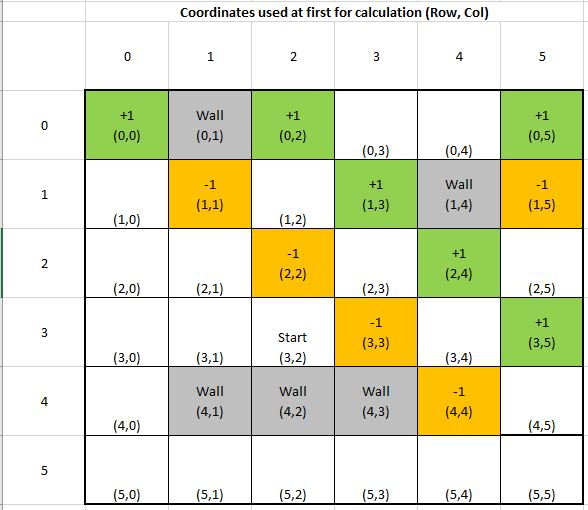

In [1]:
from IPython.display import Image
Image(filename = "coordinates_used_first_row,col.JPG", width = 600, height = 300)

In [22]:
random.randint(0,5)

0

# Defining the grid and helper functions

In [45]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import random

class Grid:
    def __init__(self, width, height, start):  #start is a tuple of 2 integars
        self.width = width
        self.height = height
        self.i = start[0]
        self.j = start[1]
        
    def set(self, rewards, actions):  #set the rewards and actions of the environment
        #rewards in dict of: (i, j): (row, col): reward
        #actions in dict of: (i, j): A (row, col): list of possible actions
        self.rewards = rewards
        self.actions = actions  #enumerate all the possible actions that can take you to new state
    
    def set_state(self, s):
        self.i = s[0]
        self.j = s[1]
        
    def current_state(self):
        return (self.i, self.j)

    def is_terminal(self, s):
        return s not in self.actions
    
    def move(self, action):
        #check if legal move first
        if action in self.actions[(self.i, self.j)]:
            if action == 'U':
                self.i -= 1
            elif action == 'D':
                self.i += 1
            elif action == 'R':
                self.j += 1
            elif action == 'L':
                self.j -= 1
        else:
            pass
        return self.rewards.get((self.i, self.j), 0)
    
    def undo_move(self, action):
        if action == 'U':
            self.i += 1
        elif action == 'D':
            self.i -= 1
        elif action == 'R':
            self.j -= 1
        elif action == 'L':
            self.j += 1
            
        #raise an exception if we arrive somewhere we should not be in
        assert(self.current_state() in self.all_states())
    
    def game_over(self):
        #returns true if game is over, else false
        return (self.i, self.j) not in self.actions
    
    def all_states(self):
        return set(list(self.actions.keys()) + list(self.rewards.keys()))
    
def standard_grid():
    #define a grid that describes the reward for arriving at each state
    g = Grid(6, 6, (3, 2))
    rewards = {(0,0):random.randint(0,1), (0,2):1, (0,5):1, (1,3):1, (2,4):1, (3,5):1, (1,1):-1, (1,5):-1, (2,2):-1, (3,3):-1, (4,4):-1}
    actions = {
        (0,0): ('D'),
        (0,2): ('R', 'D'),
        (0,3): ('R', 'D', 'L'),
        (0,4): ('R', 'L'),
        (0,5): ('D', 'L'),
        (1,0): ('U', 'R', 'D'),
        (1,1): ('R', 'D', 'L'),
        (1,2): ('U', 'R', 'D', 'L'),
        (1,3): ('U', 'D', 'L'),
        (1,5): ('U', 'D'),
        (2,0): ('U', 'R', 'D'),
        (2,1): ('U', 'R', 'D', 'L'),
        (2,2): ('U', 'R', 'D', 'L'),
        (2,3): ('U', 'R', 'D', 'L'),
        (2,4): ('R', 'D', 'L'),
        (2,5): ('U', 'D', 'L'),
        (3,0): ('U', 'R', 'D'),
        (3,1): ('U', 'R', 'L'),
        (3,2): ('U', 'R', 'L'),
        (3,3): ('U', 'R', 'L'),
        (3,4): ('U', 'R', 'D', 'L'),
        (3,5): ('U', 'D', 'L'),
        (4,0): ('U', 'D'),
        (4,4): ('U', 'R', 'D'),
        (4,5): ('U', 'D', 'L'),
        (5,0): ('U', 'R'),
        (5,1): ('R', 'L'),
        (5,2): ('R', 'L'),
        (5,3): ('R', 'L'),
        (5,4): ('U', 'R', 'L'),
        (5,5): ('U', 'L')           
    }
    g.set(rewards, actions)
    return g

def negative_grid(step_cost=-0.04):
    g = standard_grid()
    g.rewards.update({
        (0,3): step_cost,
        (0,4): step_cost,
        (1,0): step_cost,
        (1,2): step_cost,
        (2,0): step_cost,
        (2,1): step_cost,
        (2,3): step_cost,
        (2,5): step_cost,
        (3,0): step_cost,
        (3,1): step_cost,
        (3,2): step_cost,
        (3,4): step_cost,
        (4,0): step_cost,
        (4,5): step_cost,
        (5,0): step_cost,
        (5,1): step_cost,
        (5,2): step_cost,
        (5,3): step_cost,
        (5,4): step_cost,
        (5,5): step_cost,     
    })
    return g

def play_game(agent, env):
    pass

In [46]:
#iterative policy evaluation

SMALL_ENOUGH = 10e-4 #threshold for convergence

hist = []

def print_values(V, g):
    for i in range(g.width):
        print("--------------------------")
        for j in range(g.height):
            v = V.get((i,j), 0)
            if v >= 0:
                print(' {:.5f}|'.format(v), end = ' ')
                #print("%.2f|") % v,
            else:
                print('{:.5f}|'.format(v), end = ' ') # -ve sign takes up an extra space
                
            hist.append(v)
                
        print ("")

def print_policy(P,g):
    for i in range(g.width):
        print("--------------------------")
        for j in range(g.height):
            a = P.get((i,j), ' ')
            print('    {}   |'.format(a), end = ' ')
            #print(" %s | ") % a,
        print ("")

# Section 2: Policy Iteration

In [47]:
SMALL_ENOUGH = 10e-4
GAMMA = 0.99
ALL_POSSIBLE_ACTIONS = ('U', 'D', 'L', 'R')

if __name__ == '__main__':
    
    
    grid = negative_grid()
    
    #print rewards
    print("rewards:")
    print_values(grid.rewards, grid)
    
    #we'll randomly choose an action and update as we learn
    policy = {}
    for s in grid.actions.keys():
        policy[s] = np.random.choice(ALL_POSSIBLE_ACTIONS)
        
    #initial policy
    print('initial policy:')
    print_policy(policy, grid)
    
    
    hist = []
    
    
    #initilize V(s)
    V = {}
    states = grid.all_states()
    for s in states: 
        V[s] = 0
        if s in grid.actions:
            #V[s] = np.random.random()
            V[s] = 0
        else:
            #terminal state
            V[s] = 0
            
    print_values(V, grid)
    
    #repeat until convergence 
    while True:
        
        grid = negative_grid()
        print("rewards:")
        print_values(grid.rewards, grid)
        
        #policy evaluation step 
        while True:
            biggest_change = 0
            for s in states:
                old_v = V[s]
                
                if s in policy:
                    a = policy[s]
                    grid.set_state(s)
                    try:
                        r = grid.move(a)
                    except KeyError:
                        continue
                    
                    
                    grid.set_state(s)
                    #r = grid.move(a) #move only when legal / possible. Returns reward. 
                    r = grid.rewards.get(grid.current_state(), 0)
                    
                    
                    _ = grid.move(a)
                    v_correct = V[grid.current_state()]
                    
                    grid.set_state(s)
                    if a == 'U':
                        r_clockwise = grid.move('R')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('L')
                    elif a == 'R':
                        r_clockwise = grid.move('D')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('U')
                    elif a == 'D':
                        r_clockwise = grid.move('L')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('R')
                    elif a == 'L':
                        r_clockwise = grid.move('U')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('D')
                        
                    v_anticlockwise = V[grid.current_state()]
                        
                        
                    v = r + GAMMA * (0.8*v_correct + 0.1*v_clockwise + 0.1*v_anticlockwise)
                    V[s] = v
                    
                    biggest_change = max(biggest_change, np.abs(old_v - V[s]))
                    

                    
            if biggest_change < SMALL_ENOUGH:
                break
        
            
            print('values:')
            print_values(V, grid)
            print('policy:')
            print_policy(policy, grid)
        
        
        #policy improvement step
        is_policy_converged = True
        for s in states:
            if s in policy:
                old_a = policy[s]
                new_a = None
                best_value = float('-inf')
                # loop through all possible actions to find the best current action
                for a in ALL_POSSIBLE_ACTIONS:
                    grid.set_state(s)
                    try:
                        r = grid.move(a)
                    except KeyError:
                        continue
                    
                    grid.set_state(s)
                    #r = grid.move(a) #move only when legal / possible. Returns reward. 
                    r = grid.rewards.get(grid.current_state(), 0)
                    
                    
                    _ = grid.move(a)
                    v_correct = V[grid.current_state()]
                    
                    grid.set_state(s)
                    if a == 'U':
                        r_clockwise = grid.move('R')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('L')
                    elif a == 'R':
                        r_clockwise = grid.move('D')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('U')
                    elif a == 'D':
                        r_clockwise = grid.move('L')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('R')
                    elif a == 'L':
                        r_clockwise = grid.move('U')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('D')
                        
                    v_anticlockwise = V[grid.current_state()]
                        
                        
                    v = r + GAMMA * (0.8*v_correct + 0.1*v_clockwise + 0.1*v_anticlockwise)
                    
                    
                    
                    if v > best_value:
                        best_value = v
                        new_a = a
            policy[s] = new_a
            if new_a != old_a:
                is_policy_converged = False
        
        if is_policy_converged:
            break
    print('values:')
    print_values(V, grid)
    print('policy:')
    print_policy(policy, grid)

rewards:
--------------------------
 1.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
initial policy:
--------------------------
    R   |         |     D   |     R   |     U   |     L   | 
--------------------------
    R   |     R   |     D   |     U   |         |     L   | 
--------------------------
    U   |     U   |     L   |     U   |     D   |     R   | 
--------------------------
    R   |     R   |     L   |     U   |     U   |     L   | 
--------------------------
    U   |         |         |         |     U   |     R   | 
-------

-7.18489| -7.13092| -7.32293| -1.58752|  2.35087|  2.98735| 
--------------------------
-6.73769|  0.00000|  0.00000|  0.00000|  1.18140|  2.00070| 
--------------------------
-0.60709| -0.37842|  0.28363|  1.64316|  1.72401|  1.89967| 
policy:
--------------------------
    R   |         |     D   |     R   |     U   |     L   | 
--------------------------
    R   |     R   |     D   |     U   |         |     L   | 
--------------------------
    U   |     U   |     L   |     U   |     D   |     R   | 
--------------------------
    R   |     R   |     L   |     U   |     U   |     L   | 
--------------------------
    U   |         |         |         |     U   |     R   | 
--------------------------
    D   |     D   |     U   |     R   |     R   |     U   | 
values:
--------------------------
-5.65864|  0.00000| -6.22853|  0.46871|  0.50953|  1.05424| 
--------------------------
-8.95119| -9.74330| -8.67824|  0.59585|  0.00000| -4.56332| 
--------------------------
-8.91607| -9.390

--------------------------
-10.08097|  0.00000| -9.10939|  0.42892|  0.51198|  1.02180| 
--------------------------
-12.33246| -12.84390| -11.77736|  0.20764|  0.00000| -4.93978| 
--------------------------
-12.26546| -12.65988| -13.25129| -0.99978|  1.89541| -1.40797| 
--------------------------
-11.49739| -11.53714| -11.62955| -2.77232|  1.42864|  2.16536| 
--------------------------
-11.26416|  0.00000|  0.00000|  0.00000|  0.34131|  1.75017| 
--------------------------
-0.64042| -0.30111|  0.38023|  1.41760|  1.47975|  1.65940| 
policy:
--------------------------
    R   |         |     D   |     R   |     U   |     L   | 
--------------------------
    R   |     R   |     D   |     U   |         |     L   | 
--------------------------
    U   |     U   |     L   |     U   |     D   |     R   | 
--------------------------
    R   |     R   |     L   |     U   |     U   |     L   | 
--------------------------
    U   |         |         |         |     U   |     R   | 
-------------

-0.65886| -0.35178|  0.25344|  1.18087|  1.24079|  1.42151| 
policy:
--------------------------
    R   |         |     D   |     R   |     U   |     L   | 
--------------------------
    R   |     R   |     D   |     U   |         |     L   | 
--------------------------
    U   |     U   |     L   |     U   |     D   |     R   | 
--------------------------
    R   |     R   |     L   |     U   |     U   |     L   | 
--------------------------
    U   |         |         |         |     U   |     R   | 
--------------------------
    D   |     D   |     U   |     R   |     R   |     U   | 
values:
--------------------------
-11.25060|  0.00000| -9.79481|  0.37600|  0.46797|  0.96953| 
--------------------------
-13.14607| -13.57822| -12.51173|  0.07710|  0.00000| -5.07395| 
--------------------------
-13.06979| -13.43315| -14.06605| -1.20814|  1.64984| -1.61801| 
--------------------------
-12.43465| -12.49246| -12.56382| -3.06544|  1.17178|  1.91518| 
--------------------------
-12.24

--------------------------
    D   |     D   |     U   |     R   |     R   |     U   | 
values:
--------------------------
-11.96695|  0.00000| -10.21309|  0.31715|  0.41386|  0.91014| 
--------------------------
-13.63975| -14.02386| -12.95764| -0.02586|  0.00000| -5.18421| 
--------------------------
-13.55764| -13.90136| -14.55796| -1.35543|  1.47763| -1.77449| 
--------------------------
-12.99583| -13.06387| -13.12304| -3.26128|  0.99287|  1.73742| 
--------------------------
-12.83358|  0.00000|  0.00000|  0.00000| -0.09491|  1.28024| 
--------------------------
-0.72104| -0.44761|  0.09624|  0.95402|  1.01249|  1.19402| 
policy:
--------------------------
    R   |         |     D   |     R   |     U   |     L   | 
--------------------------
    R   |     R   |     D   |     U   |         |     L   | 
--------------------------
    U   |     U   |     L   |     U   |     D   |     R   | 
--------------------------
    R   |     R   |     L   |     U   |     U   |     L   | 
----

--------------------------
-12.49364|  0.00000| -10.52861|  0.24248|  0.34198|  0.83428| 
--------------------------
-14.00688| -14.35711| -13.29138| -0.13012|  0.00000| -5.29706| 
--------------------------
-13.92040| -14.25014| -14.92289| -1.48924|  1.32506| -1.92001| 
--------------------------
-13.40705| -13.48216| -13.53282| -3.42792|  0.83558|  1.57971| 
--------------------------
-13.26251|  0.00000|  0.00000|  0.00000| -0.25446|  1.09108| 
--------------------------
-0.82296| -0.57131| -0.06078|  0.76700|  0.82442|  1.00650| 
policy:
--------------------------
    R   |         |     D   |     R   |     U   |     L   | 
--------------------------
    R   |     R   |     D   |     U   |         |     L   | 
--------------------------
    U   |     U   |     L   |     U   |     D   |     R   | 
--------------------------
    R   |     R   |     L   |     U   |     U   |     L   | 
--------------------------
    U   |         |         |         |     U   |     R   | 
------------

--------------------------
    U   |         |         |         |     U   |     R   | 
--------------------------
    D   |     D   |     U   |     R   |     R   |     U   | 
values:
--------------------------
-12.82664|  0.00000| -10.74099|  0.15952|  0.26004|  0.74990| 
--------------------------
-14.24748| -14.57825| -13.51317| -0.22906|  0.00000| -5.40295| 
--------------------------
-14.15818| -14.48005| -15.16186| -1.60367|  1.19972| -2.04429| 
--------------------------
-13.67084| -13.75012| -13.79580| -3.56023|  0.70745|  1.45095| 
--------------------------
-13.53636|  0.00000|  0.00000|  0.00000| -0.38406|  0.93975| 
--------------------------
-0.95157| -0.70872| -0.20741|  0.61752|  0.67405|  0.85651| 
policy:
--------------------------
    R   |         |     D   |     R   |     U   |     L   | 
--------------------------
    R   |     R   |     D   |     U   |         |     L   | 
--------------------------
    U   |     U   |     L   |     U   |     D   |     R   | 
----

    R   |     R   |     L   |     U   |     U   |     L   | 
--------------------------
    U   |         |         |         |     U   |     R   | 
--------------------------
    D   |     D   |     U   |     R   |     R   |     U   | 
values:
--------------------------
-12.94958|  0.00000| -10.82604|  0.11201|  0.21257|  0.70162| 
--------------------------
-14.34086| -14.66541| -13.60072| -0.28124|  0.00000| -5.45791| 
--------------------------
-14.25048| -14.56997| -15.25464| -1.66008|  1.14006| -2.10477| 
--------------------------
-13.77080| -13.85151| -13.89551| -3.62193|  0.64686|  1.39015| 
--------------------------
-13.63953|  0.00000|  0.00000|  0.00000| -0.44505|  0.87076| 
--------------------------
-1.02656| -0.78423| -0.28085|  0.54948|  0.60555|  0.78817| 
policy:
--------------------------
    R   |         |     D   |     R   |     U   |     L   | 
--------------------------
    R   |     R   |     D   |     U   |         |     L   | 
--------------------------
    

values:
--------------------------
-13.03298|  0.00000| -10.88784|  0.06957|  0.16996|  0.65851| 
--------------------------
-14.40705| -14.72797| -13.66365| -0.32613|  0.00000| -5.50465| 
--------------------------
-14.31593| -14.63414| -15.32044| -1.70695|  1.09156| -2.15445| 
--------------------------
-13.84030| -13.92191| -13.96487| -3.67160|  0.59779|  1.34099| 
--------------------------
-13.71091|  0.00000|  0.00000|  0.00000| -0.49425|  0.81649| 
--------------------------
-1.09229| -0.84881| -0.34115|  0.49600|  0.55167|  0.73442| 
policy:
--------------------------
    R   |         |     D   |     R   |     U   |     L   | 
--------------------------
    R   |     R   |     D   |     U   |         |     L   | 
--------------------------
    U   |     U   |     L   |     U   |     D   |     R   | 
--------------------------
    R   |     R   |     L   |     U   |     U   |     L   | 
--------------------------
    U   |         |         |         |     U   |     R   | 
----

-13.76644|  0.00000|  0.00000|  0.00000| -0.53814|  0.76913| 
--------------------------
-1.15333| -0.90791| -0.39501|  0.44939|  0.50469|  0.68753| 
policy:
--------------------------
    R   |         |     D   |     R   |     U   |     L   | 
--------------------------
    R   |     R   |     D   |     U   |         |     L   | 
--------------------------
    U   |     U   |     L   |     U   |     D   |     R   | 
--------------------------
    R   |     R   |     L   |     U   |     U   |     L   | 
--------------------------
    U   |         |         |         |     U   |     R   | 
--------------------------
    D   |     D   |     U   |     R   |     R   |     U   | 
values:
--------------------------
-13.10085|  0.00000| -10.94195|  0.02564|  0.12570|  0.61391| 
--------------------------
-14.46356| -14.78209| -13.71815| -0.37139|  0.00000| -5.55133| 
--------------------------
-14.37182| -14.68930| -15.37666| -1.75300|  1.04476| -2.20273| 
--------------------------
-13.898

    U   |         |         |         |     U   |     R   | 
--------------------------
    D   |     D   |     U   |     R   |     R   |     U   | 
values:
--------------------------
-13.16346|  0.00000| -10.99605| -0.02518|  0.07437|  0.56235| 
--------------------------
-14.51860| -14.83552| -13.77204| -0.42271|  0.00000| -5.60382| 
--------------------------
-14.42628| -14.74341| -15.43146| -1.80414|  0.99357| -2.25583| 
--------------------------
-13.95387| -14.03672| -14.07830| -3.77097|  0.49906|  1.24237| 
--------------------------
-13.82660|  0.00000|  0.00000|  0.00000| -0.59274|  0.71151| 
--------------------------
-1.22978| -0.98130| -0.46104|  0.39272|  0.44754|  0.63050| 
policy:
--------------------------
    R   |         |     D   |     R   |     U   |     L   | 
--------------------------
    R   |     R   |     D   |     U   |         |     L   | 
--------------------------
    U   |     U   |     L   |     U   |     D   |     R   | 
--------------------------
    

    R   |         |     D   |     R   |     U   |     L   | 
--------------------------
    R   |     R   |     D   |     U   |         |     L   | 
--------------------------
    U   |     U   |     L   |     U   |     D   |     R   | 
--------------------------
    R   |     R   |     L   |     U   |     U   |     L   | 
--------------------------
    U   |         |         |         |     U   |     R   | 
--------------------------
    D   |     D   |     U   |     R   |     R   |     U   | 
values:
--------------------------
-13.19761|  0.00000| -11.02755| -0.05777|  0.04142|  0.52930| 
--------------------------
-14.55001| -14.86634| -13.80314| -0.45522|  0.00000| -5.63689| 
--------------------------
-14.45737| -14.77447| -15.46276| -1.83612|  0.96187| -2.28882| 
--------------------------
-13.98494| -14.06807| -14.10936| -3.80293|  0.46721|  1.21062| 
--------------------------
-13.85800|  0.00000|  0.00000|  0.00000| -0.62439|  0.67863| 
--------------------------
-1.27317| -1

    R   |         |     D   |     R   |     U   |     L   | 
--------------------------
    R   |     R   |     D   |     U   |         |     L   | 
--------------------------
    U   |     U   |     L   |     U   |     D   |     R   | 
--------------------------
    R   |     R   |     L   |     U   |     U   |     L   | 
--------------------------
    U   |         |         |         |     U   |     R   | 
--------------------------
    D   |     D   |     U   |     R   |     R   |     U   | 
values:
--------------------------
-13.22231|  0.00000| -11.05117| -0.08341|  0.01547|  0.50330| 
--------------------------
-14.57332| -14.88933| -13.82637| -0.48067|  0.00000| -5.66270| 
--------------------------
-14.48043| -14.79759| -15.48599| -1.86101|  0.93734| -2.31439| 
--------------------------
-14.00776| -14.09109| -14.13218| -3.82763|  0.44258|  1.18609| 
--------------------------
-13.88101|  0.00000|  0.00000|  0.00000| -0.64885|  0.65342| 
--------------------------
-1.30575| -1

-1.33054| -1.07797| -0.54845|  0.31635|  0.37047|  0.55359| 
policy:
--------------------------
    R   |         |     D   |     R   |     U   |     L   | 
--------------------------
    R   |     R   |     D   |     U   |         |     L   | 
--------------------------
    U   |     U   |     L   |     U   |     D   |     R   | 
--------------------------
    R   |     R   |     L   |     U   |     U   |     L   | 
--------------------------
    U   |         |         |         |     U   |     R   | 
--------------------------
    D   |     D   |     U   |     R   |     R   |     U   | 
values:
--------------------------
-13.24228|  0.00000| -11.07073| -0.10525| -0.00664|  0.48116| 
--------------------------
-14.59247| -14.90830| -13.84554| -0.50227|  0.00000| -5.68458| 
--------------------------
-14.49939| -14.81662| -15.50508| -1.88205|  0.91665| -2.33597| 
--------------------------
-14.02641| -14.10988| -14.15083| -3.84844|  0.42182|  1.16542| 
--------------------------
-13.8

-13.26099|  0.00000| -11.08934| -0.12643| -0.02809|  0.45969| 
--------------------------
-14.61062| -14.92632| -13.86375| -0.52318|  0.00000| -5.70573| 
--------------------------
-14.51736| -14.83469| -15.52318| -1.90238|  0.89670| -2.35678| 
--------------------------
-14.04400| -14.12761| -14.16843| -3.86849|  0.40181|  1.14550| 
--------------------------
-13.91745|  0.00000|  0.00000|  0.00000| -0.68930|  0.61198| 
--------------------------
-1.35733| -1.10385| -0.57223|  0.29494|  0.34886|  0.53202| 
policy:
--------------------------
    R   |         |     D   |     R   |     U   |     L   | 
--------------------------
    R   |     R   |     D   |     U   |         |     L   | 
--------------------------
    U   |     U   |     L   |     U   |     D   |     R   | 
--------------------------
    R   |     R   |     L   |     U   |     U   |     L   | 
--------------------------
    U   |         |         |         |     U   |     R   | 
--------------------------
    D   |   

--------------------------
    U   |     U   |     L   |     U   |     D   |     R   | 
--------------------------
    R   |     R   |     L   |     U   |     U   |     L   | 
--------------------------
    U   |         |         |         |     U   |     R   | 
--------------------------
    D   |     D   |     U   |     R   |     R   |     U   | 
values:
--------------------------
-13.27524|  0.00000| -11.10367| -0.14293| -0.04480|  0.44296| 
--------------------------
-14.62455| -14.94018| -13.87775| -0.53945|  0.00000| -5.72217| 
--------------------------
-14.53115| -14.84857| -15.53707| -1.91817|  0.88123| -2.37294| 
--------------------------
-14.05747| -14.14117| -14.18190| -3.88405|  0.38629|  1.13005| 
--------------------------
-13.93098|  0.00000|  0.00000|  0.00000| -0.70469|  0.59627| 
--------------------------
-1.37613| -1.12208| -0.58914|  0.27951|  0.33329|  0.51648| 
policy:
--------------------------
    R   |         |     D   |     R   |     U   |     L   | 
----

-14.06644| -14.15021| -14.19087| -3.89448|  0.37589|  1.11970| 
--------------------------
-13.93998|  0.00000|  0.00000|  0.00000| -0.71501|  0.58575| 
--------------------------
-1.38847| -1.13408| -0.60034|  0.26918|  0.32286|  0.50607| 
policy:
--------------------------
    R   |         |     D   |     R   |     U   |     L   | 
--------------------------
    R   |     R   |     D   |     U   |         |     L   | 
--------------------------
    U   |     U   |     L   |     U   |     D   |     R   | 
--------------------------
    R   |     R   |     L   |     U   |     U   |     L   | 
--------------------------
    U   |         |         |         |     U   |     R   | 
--------------------------
    D   |     D   |     U   |     R   |     R   |     U   | 
values:
--------------------------
-13.28550|  0.00000| -11.11404| -0.15495| -0.05698|  0.43077| 
--------------------------
-14.63462| -14.95020| -13.88789| -0.55129|  0.00000| -5.73414| 
--------------------------
-14.541

--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-12.26127|  0.00000|  7.30199|  7.25907|  7.48223|  7.84878| 
--------------------------
-10.51881|  4.88700|  7.15572|  7.49431|  0.00000|  6.28521| 
--------------------------
-0.91326| -1.74927|  5.42762|  7.63845|  8.04872|  7.12486| 
--------------------------
-0.71646| -2.66913|  5.44819|  5.67600|  6.98122|  8.22044| 
--------------------------
-0.38557|  0.00000|  0.00000|  0.00000|  5.66001|  6.86736| 
--------------------------
 0.07463|  3.58741|  4.71322|  5.02981|  5.35281|  6.48759| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------

 4.82798|  6.30616|  14.32486|  16.49500|  16.98709|  15.91101| 
--------------------------
 4.82715|  5.69119|  14.09482|  14.38678|  15.75444|  16.96511| 
--------------------------
 4.90299|  0.00000|  0.00000|  0.00000|  14.31948|  15.61998| 
--------------------------
 5.75609|  12.10720|  13.22187|  13.62149|  14.02792|  15.14585| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-10.86820|  0.00000|  17.15071|  17.08022|  17.38944|  17.85363| 
-----------------------

 11.95432|  13.80335|  22.65708|  24.80035|  25.36776|  24.25219| 
--------------------------
 11.99817|  13.22609|  22.28029|  22.64469|  24.08487|  25.28007| 
--------------------------
 12.12087|  0.00000|  0.00000|  0.00000|  22.55399|  23.94419| 
--------------------------
 13.07658|  20.22331|  21.31831|  21.79574|  22.28071|  23.38075| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-9.63341|  0.00000|  25.71346|  25.65223|  26.06877|  26.61848| 
------------------

-4.42132|  29.86388|  32.65806|  33.33592|  0.00000|  32.47537| 
--------------------------
 19.20718|  21.18618|  30.39903|  32.51573|  33.14689|  32.02222| 
--------------------------
 19.31876|  20.66589|  29.90082|  30.33467|  31.84529|  33.02920| 
--------------------------
 19.51136|  0.00000|  0.00000|  0.00000|  30.22831|  31.70241| 
--------------------------
 20.48000|  27.78908|  28.86507|  29.41489|  29.97294|  31.05585| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
------------------

policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-7.49307|  0.00000|  40.25057|  40.22736|  40.84995|  41.54532| 
--------------------------
-2.74590|  36.56501|  39.46628|  40.22280|  0.00000|  39.65294| 
--------------------------
 25.56520|  27.62986|  37.02028|  39.11115|  39.79204|  38.66290| 
--------------------------
 25.73748|  27.17057|  36.41431|  36.90704|  38.47783|  39.65252| 
--------------------------
 25.99143|  0.00000|  0.00000|  0.00000|  36.78770|  38.3

 32.03646|  33.55297|  42.76504|  43.31411|  44.94279|  46.10828| 
--------------------------
 32.35013|  0.00000|  0.00000|  0.00000|  43.18114|  44.79689| 
--------------------------
 33.29503|  40.55920|  41.60288|  42.27484|  42.95621|  44.01007| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-6.38003|  0.00000|  47.64133|  47.64549|  48.38190|  49.15149| 
--------------------------
-0.97971|  43.54474|  46.55866|  47.39702|  0.00000|  47.18489| 
--------------------

    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-5.48720|  0.00000|  53.47186|  53.50181|  54.33282|  55.16106| 
--------------------------
 0.42265|  49.01413|  52.12033|  53.02290|  0.00000|  53.13581| 
--------------------------
 37.33515|  39.55236|  49.21697|  51.25001|  52.00918|  50.86368| 
--------------------------
 37.61932|  39.21075|  48.38680|  48.98455|  50.66356|  51.82055| 
--------------------------
 37.98568|  0.00000|  0.00000|  0.00000|  48.83826|  50.51584| 
--------------------------
 38.91665|  46.13633|  47.16596|  47.89128|  48.62651|  49.66774| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------

values:
--------------------------
-4.91290|  0.00000|  57.17003|  57.21853|  58.11204|  58.97752| 
--------------------------
 1.31706|  52.46362|  55.63052|  56.57364|  0.00000|  56.91503| 
--------------------------
 40.56429|  42.82459|  52.56931|  54.58350|  55.36048|  54.20730| 
--------------------------
 40.87896|  42.51478|  51.66957|  52.29510|  54.00302|  55.15485| 
--------------------------
 41.27599|  0.00000|  0.00000|  0.00000|  52.14035|  53.85400| 
--------------------------
 42.19872|  49.39164|  50.41310|  51.16957|  51.93625|  52.97014| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   

--------------------------
-4.26806|  0.00000|  61.26759|  61.33891|  62.30425|  63.21104| 
--------------------------
 2.31336|  56.26532|  59.50180|  60.48968|  0.00000|  61.10724| 
--------------------------
 44.10095|  46.40949|  56.24726|  58.23892|  59.03310|  57.86942| 
--------------------------
 44.44889|  46.13399|  55.26614|  55.92147|  57.66057|  58.80654| 
--------------------------
 44.87941|  0.00000|  0.00000|  0.00000|  55.75677|  57.50989| 
--------------------------
 45.79312|  52.95673|  53.96927|  54.75986|  55.56098|  56.58685| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U 

 48.22115|  55.36507|  56.37161|  57.18525|  58.00965|  59.03011| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-3.78315|  0.00000|  64.30632|  64.39629|  65.41687|  66.35434| 
--------------------------
 3.05644|  59.06907|  62.35895|  63.37989|  0.00000|  64.21987| 
--------------------------
 46.69203|  49.03675|  58.94693|  60.92061|  61.72563|  60.55264| 
--------------------------
 47.06423|  48.78596|  57.90218|  58.57886|  60.34042|  61.48193| 
-----------------

    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-3.18898|  0.00000|  67.97310|  68.08782|  69.17764|  70.15216| 
--------------------------
 3.95887|  62.43202|  65.78867|  66.84934|  0.00000|  67.98063| 
--------------------------
 49.77726|  52.16618|  62.16824|  64.11860|  64.93418|  63.74797| 
--------------------------
 50.17822|  51.94427|  61.04243|  61.74388|  63.53170|  64.66770| 
--------------------------
 50.66229|  0.00000|  0.00000|  0.00000|  61.56129|  63.37772| 
--------------------------
 51.56157|  58.67862|  59.67693|  60.52229|  61.37873|  62.39178| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------

--------------------------
 52.15756|  54.58156|  64.65959|  66.59022|  67.41186|  66.21354| 
--------------------------
 52.58059|  54.38144|  63.46650|  64.18649|  65.99413|  67.12569| 
--------------------------
 53.08701|  0.00000|  0.00000|  0.00000|  63.99551|  65.83847| 
--------------------------
 53.98028|  61.07807|  62.07045|  62.93879|  63.81843|  64.82614| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-2.68813|  0.00000|  71.00860|  71.14597|  72.29557|  73

    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-2.38272|  0.00000|  72.83108|  72.98314|  74.16988|  75.19359| 
--------------------------
 5.16684|  66.84649|  70.29635|  71.40931|  0.00000|  72.97287| 
--------------------------
 53.78121|  56.22975|  66.36267|  68.27880|  69.10331|  67.89557| 
--------------------------
 54.21922|  56.04419|  65.12082|  65.85311|  67.67400|  68.80241| 
--------------------------
 54.74084|  0.00000|  0.00000|  0.00000|  65.65602|  67.51706| 
--------------------------
 55.63002|  62.71481|  63.70316|  64.58718|  65.48265|  66.48673| 
policy:
--------------

    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-2.06997|  0.00000|  74.67185|  74.83971|  76.06505|  77.10744| 
--------------------------
 5.62934|  68.50438|  71.99127|  73.12391|  0.00000|  74.86804| 
--------------------------
 55.26812|  57.73964|  67.92545|  69.82741|  70.65347|  69.43611| 
--------------------------
 55.71978|  57.56716|  66.63650|  67.37976|  69.21256|  70.33799| 
--------------------------
 56.25528|  0.00000|  0.00000|  0.00000|  67.17675|  69.05434| 
--------------------------
 57.14074|  64.21372|  65.19840|  66.09678|  67.00674|  68.00751| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------

--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-1.78030|  0.00000|  76.35094|  76.53417|  77.79581|  78.85526| 
--------------------------
 6.05417|  70.00802|  73.52969|  74.68022|  0.00000|  76.59881| 
--------------------------
 56.60685|  59.09955|  69.33553|  71.22387|  72.05027|  70.82329| 
--------------------------
 57.07074|  58.93859|  68.00180|  68.75465|  70.59795|  71.72060| 
--------------------------
 57.61869|  0.00000|  0.00000|  0.00000|  68.54598|  70.43846| 
--------------------------
 58.50082|  65.56327|  66.54465|  67.45597|  68.37899|  69.37678| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         

    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-1.53116|  0.00000|  77.77236|  77.96942|  79.26273|  80.33664| 
--------------------------
 6.41646|  71.27350|  74.82547|  75.99107|  0.00000|  78.06572| 
--------------------------
 57.72501|  60.23584|  70.51595|  72.39215|  73.21793|  71.98208| 
--------------------------
 58.19906|  60.08430|  69.14274|  69.90334|  71.75522|  72.87547| 
--------------------------
 58.75739|  0.00000|  0.00000|  0.00000|  69.68967|  71.59458| 
--------------------------
 59.63673|  66.69048|  67.66913|  68.59125|  69.52518|  70.52050| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------

 6.88862|  72.89506|  76.48752|  77.67248|  0.00000|  79.96206| 
--------------------------
 59.14400|  61.67855|  72.01827|  73.87784|  74.70134|  73.45287| 
--------------------------
 59.63087|  61.53860|  70.59160|  71.36163|  73.22408|  74.34115| 
--------------------------
 60.20230|  0.00000|  0.00000|  0.00000|  71.14116|  73.06183| 
--------------------------
 61.07815|  68.12100|  69.09618|  70.03202|  70.97980|  71.97200| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
------------------

 7.06803|  73.50150|  77.10968|  78.30190|  0.00000|  80.67704| 
--------------------------
 59.66992|  62.21351|  72.57658|  74.42956|  75.25170|  73.99807| 
--------------------------
 60.16151|  62.07772|  71.12891|  71.90230|  73.76856|  74.88440| 
--------------------------
 60.73777|  0.00000|  0.00000|  0.00000|  71.67914|  73.60566| 
--------------------------
 61.61233|  68.65119|  69.62510|  70.56602|  71.51894|  72.50999| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
------------------

    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.96436|  0.00000|  80.90935|  81.14030|  82.50736|  83.61324| 
--------------------------
 7.22772|  74.03606|  77.65840|  78.85702|  0.00000|  81.31035| 
--------------------------
 60.13093|  62.68258|  73.06682|  74.91378|  75.73444|  74.47604| 
--------------------------
 60.62664|  62.55039|  71.60010|  72.37635|  74.24589|  75.36063| 
--------------------------
 61.20714|  0.00000|  0.00000|  0.00000|  72.15076|  74.08239| 
--------------------------
 62.08057|  69.11596|  70.08876|  71.03414|  71.99156|  72.98160| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------

 60.73413|  63.29654|  73.70958|  75.54830|  76.36656|  75.10149| 
--------------------------
 61.23520|  63.16893|  72.21690|  72.99676|  74.87050|  75.98375| 
--------------------------
 61.82122|  0.00000|  0.00000|  0.00000|  72.76785|  74.70617| 
--------------------------
 62.69318|  69.72408|  70.69542|  71.64664|  72.60995|  73.59868| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.80477|  0.00000|  81.76200|  82.00318|  83.39146|  84.50605| 
------------------

    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.70620|  0.00000|  82.28007|  82.52775|  83.92925|  85.04914| 
--------------------------
 7.58959|  75.22570|  78.88081|  80.09371|  0.00000|  82.73224| 
--------------------------
 61.14661|  63.71655|  74.15017|  75.98295|  76.79921|  75.52925| 
--------------------------
 61.65133|  63.59200|  72.63892|  73.42115|  75.29768|  76.40989| 
--------------------------
 62.24111|  0.00000|  0.00000|  0.00000|  73.18985|  75.13274| 
--------------------------
 63.11207|  70.13993|  71.11029|  72.06550|  73.03283|  74.02067| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------

    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.63229|  0.00000|  82.66369|  82.91634|  84.32780|  85.45162| 
--------------------------
 7.69205|  75.55607|  79.22065|  80.43752|  0.00000|  83.13079| 
--------------------------
 61.42561|  64.00074|  74.44876|  76.27735|  77.09207|  75.81861| 
--------------------------
 61.93279|  63.87820|  72.92449|  73.70828|  75.58666|  76.69814| 
--------------------------
 62.52511|  0.00000|  0.00000|  0.00000|  73.47531|  75.42129| 
--------------------------
 63.39539|  70.42122|  71.39091|  72.34882|  73.31888|  74.30612| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------

 62.77413|  0.00000|  0.00000|  0.00000|  73.72564|  75.67432| 
--------------------------
 63.64382|  70.66788|  71.63699|  72.59727|  73.56972|  74.55643| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.56045|  0.00000|  83.03209|  83.28966|  84.71085|  85.83844| 
--------------------------
 7.79107|  75.87207|  79.54589|  80.76657|  0.00000|  83.51384| 
--------------------------
 61.69096|  64.27110|  74.73323|  76.55771|  77.37078|  76.09385| 
--------------------

-0.49678|  0.00000|  83.35457|  83.61658|  85.04642|  86.17732| 
--------------------------
 7.87833|  76.14754|  79.82957|  81.05358|  0.00000|  83.84942| 
--------------------------
 61.92090|  64.50546|  74.98020|  76.80097|  77.61246|  76.33238| 
--------------------------
 62.43241|  64.38640|  73.43176|  74.21817|  76.09973|  77.20988| 
--------------------------
 63.02921|  0.00000|  0.00000|  0.00000|  73.98208|  75.93354| 
--------------------------
 63.89831|  70.92057|  71.88909|  72.85179|  73.82669|  74.81287| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
----------------------

    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.41876|  0.00000|  83.74384|  84.01137|  85.45187|  86.58677| 
--------------------------
 7.98450|  76.47843|  80.17057|  81.39857|  0.00000|  84.25487| 
--------------------------
 62.19516|  64.78509|  75.27540|  77.09159|  77.90097|  76.61692| 
--------------------------
 62.70904|  64.66787|  73.71285|  74.50063|  76.38387|  77.49326| 
--------------------------
 63.30832|  0.00000|  0.00000|  0.00000|  74.26271|  76.21721| 
--------------------------
 64.17676|  71.19708|  72.16495|  73.13031|  74.10790|  75.09348| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------

    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.36747|  0.00000|  83.99573|  84.26696|  85.71450|  86.85198| 
--------------------------
 8.05380|  76.69147|  80.39028|  81.62085|  0.00000|  84.51749| 
--------------------------
 62.37042|  64.96387|  75.46450|  77.27762|  78.08551|  76.79878| 
--------------------------
 62.88582|  64.84779|  73.89258|  74.68119|  76.56549|  77.67437| 
--------------------------
 63.48667|  0.00000|  0.00000|  0.00000|  74.44207|  76.39850| 
--------------------------
 64.35470|  71.37379|  72.34125|  73.30831|  74.28761|  75.27282| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------

 63.61744|  0.00000|  0.00000|  0.00000|  74.57358|  76.53143| 
--------------------------
 64.48517|  71.50336|  72.47053|  73.43883|  74.41938|  75.40433| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.32572|  0.00000|  84.19812|  84.47240|  85.92568|  87.06524| 
--------------------------
 8.10988|  76.86193|  80.56619|  81.79883|  0.00000|  84.72867| 
--------------------------
 62.50981|  65.10609|  75.61517|  77.42578|  78.23237|  76.94343| 
--------------------

--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.26910|  0.00000|  84.46827|  84.74674|  86.20783|  87.35018| 
--------------------------
 8.18540|  77.08835|  80.79999|  82.03537|  0.00000|  85.01083| 
--------------------------
 62.69356|  65.29366|  75.81427|  77.62143|  78.42616|  77.13415| 
--------------------------
 63.21173|  65.17960|  74.22420|  75.01424|  76.90039|  78.00830| 
--------------------------
 63.81547|  0.00000|  0.00000|  0.00000|  74.77276|  76.73276| 
--------------------------
 64.68273|  71.69959|  72.66630|  73.63649|  74.61895|  75.603

 63.94324|  0.00000|  0.00000|  0.00000|  74.90129|  76.86268| 
--------------------------
 64.81021|  71.82622|  72.79264|  73.76405|  74.74774|  75.73201| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.22683|  0.00000|  84.66618|  84.94783|  86.41476|  87.55914| 
--------------------------
 8.24132|  77.25326|  80.97043|  82.20782|  0.00000|  85.21775| 
--------------------------
 62.82624|  65.42915|  75.95842|  77.76298|  78.56623|  77.27188| 
--------------------

--------------------------
 63.43712|  65.40920|  74.45383|  75.24474|  77.13209|  78.23930| 
--------------------------
 64.04285|  0.00000|  0.00000|  0.00000|  75.00152|  76.96398| 
--------------------------
 64.90959|  71.92496|  72.89115|  73.86351|  74.84816|  75.83222| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.19509|  0.00000|  84.81238|  85.09644|  86.56776|  87.71365| 
--------------------------
 8.28303|  77.37448|  81.09579|  82.33466|  0.00000|  85.3

    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.17467|  0.00000|  84.90516|  85.19078|  86.66493|  87.81178| 
--------------------------
 8.30970|  77.45109|  81.17507|  82.41487|  0.00000|  85.46792| 
--------------------------
 62.98377|  65.59013|  76.13015|  77.93145|  78.73275|  77.43544| 
--------------------------
 63.50438|  65.47774|  74.52242|  75.31356|  77.20125|  78.30825| 
--------------------------
 64.11070|  0.00000|  0.00000|  0.00000|  75.06979|  77.03299| 
--------------------------
 64.97729|  71.99221|  72.95826|  73.93126|  74.91656|  75.90049| 
policy:
--------------

    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.15639|  0.00000|  84.98728|  85.27432|  86.75100|  87.89870| 
--------------------------
 8.33347|  77.51868|  81.24505|  82.48568|  0.00000|  85.55399| 
--------------------------
 63.03711|  65.64466|  76.18846|  77.98862|  78.78919|  77.49083| 
--------------------------
 63.55817|  65.53255|  74.57728|  75.36861|  77.25656|  78.36338| 
--------------------------
 64.16495|  0.00000|  0.00000|  0.00000|  75.12439|  77.08817| 
--------------------------
 65.03142|  72.04599|  73.01192|  73.98544|  74.97126|  75.95508| 
policy:
--------------

    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.14002|  0.00000|  85.05998|  85.34829|  86.82724|  87.97568| 
--------------------------
 8.35466|  77.57832|  81.30683|  82.54818|  0.00000|  85.63023| 
--------------------------
 63.08393|  65.69254|  76.23972|  78.03885|  78.83877|  77.53945| 
--------------------------
 63.60537|  65.58067|  74.62546|  75.41693|  77.30511|  78.41177| 
--------------------------
 64.21257|  0.00000|  0.00000|  0.00000|  75.17231|  77.13661| 
--------------------------
 

 63.12502|  65.73458|  76.28480|  78.08300|  78.88231|  77.58213| 
--------------------------
 63.64680|  65.62292|  74.66776|  75.45936|  77.34773|  78.45425| 
--------------------------
 64.25436|  0.00000|  0.00000|  0.00000|  75.21437|  77.17912| 
--------------------------
 65.12062|  72.13463|  73.10036|  74.07473|  75.06142|  76.04505| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.12411|  0.00000|  85.12981|  85.41936|  86.90051|  88.04968| 
------------------

 63.16109|  65.77149|  76.32444|  78.12180|  78.92056|  77.61961| 
--------------------------
 63.68317|  65.66001|  74.70491|  75.49662|  77.38515|  78.49154| 
--------------------------
 64.29105|  0.00000|  0.00000|  0.00000|  75.25130|  77.21645| 
--------------------------
 65.15723|  72.17101|  73.13665|  74.11138|  75.09841|  76.08197| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.11112|  0.00000|  85.18615|  85.47673|  86.95967|  88.10942| 
------------------

 63.71510|  65.69257|  74.73754|  75.52933|  77.41800|  78.52428| 
--------------------------
 64.32325|  0.00000|  0.00000|  0.00000|  75.28372|  77.24922| 
--------------------------
 65.18936|  72.20294|  73.16851|  74.14355|  75.13090|  76.11439| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.09949|  0.00000|  85.23603|  85.52753|  87.01207|  88.16234| 
--------------------------
 8.40665|  77.72183|  81.45563|  82.69873|  0.00000|  85.81506| 
--------------------

 63.74785|  65.72598|  74.77102|  75.56289|  77.45170|  78.55786| 
--------------------------
 64.35628|  0.00000|  0.00000|  0.00000|  75.31698|  77.28283| 
--------------------------
 65.22231|  72.23570|  73.20120|  74.17654|  75.16421|  76.14764| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.08731|  0.00000|  85.28766|  85.58011|  87.06634|  88.21714| 
--------------------------
 8.42214|  77.76362|  81.49900|  82.74262|  0.00000|  85.86933| 
--------------------

    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.07817|  0.00000|  85.32589|  85.61907|  87.10655|  88.25775| 
--------------------------
 8.43369|  77.79446|  81.53103|  82.77502|  0.00000|  85.90955| 
--------------------------
 63.25111|  65.86365|  76.42368|  78.21887|  79.01612|  77.71313| 
--------------------------
 63.77392|  65.75258|  74.79768|  75.58961|  77.47853|  78.58460| 
--------------------------
 64.38257|  0.00000|  0.00000|  0.00000|  75.34345|  77.30959| 
--------------------------
 65.24855|  72.26178|  73.22722|  74.20281|  75.19074|  76.17411| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------

 8.44487|  77.82400|  81.56171|  82.80607|  0.00000|  85.94820| 
--------------------------
 63.27355|  65.88664|  76.44852|  78.24313|  79.03998|  77.73645| 
--------------------------
 63.79654|  65.77567|  74.82083|  75.61281|  77.50182|  78.60780| 
--------------------------
 64.40539|  0.00000|  0.00000|  0.00000|  75.36643|  77.33281| 
--------------------------
 65.27132|  72.28441|  73.24980|  74.22561|  75.21375|  76.19708| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
------------------

--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.05841|  0.00000|  85.40696|  85.70172|  87.19191|  88.34395| 
--------------------------
 8.45850|  77.85952|  81.59863|  82.84343|  0.00000|  85.99490| 
--------------------------
 63.30036|  65.91413|  76.47826|  78.27218|  79.06851|  77.76432| 
--------------------------
 63.82357|  65.80326|  74.84851|  75.64054|  77.52965|  78.63553| 
--------------------------
 64.43265|  0.00000|  0.00000|  0.00000|  75.39388|  77.36056| 
-

    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.05023|  0.00000|  85.43972|  85.73514|  87.22644|  88.37882| 
--------------------------
 8.46867|  77.88565|  81.62581|  82.87093|  0.00000|  86.02943| 
--------------------------
 63.31994|  65.93420|  76.50003|  78.29342|  79.08937|  77.78467| 
--------------------------
 63.84331|  65.82342|  74.86873|  75.66079|  77.54997|  78.65577| 
--------------------------
 64.45255|  0.00000|  0.00000|  0.00000|  75.41393|  77.38083| 
--------------------------
 65.31838|  72.33119|  73.29648|  74.27275|  75.26134|  76.24458| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------

    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.04408|  0.00000|  85.46403|  85.75994|  87.25208|  88.40471| 
--------------------------
 8.47629|  77.90497|  81.64592|  82.89128|  0.00000|  86.05507| 
--------------------------
 63.33433|  65.94896|  76.51606|  78.30905|  79.10470|  77.79962| 
--------------------------
 63.85781|  65.83822|  74.88359|  75.67567|  77.56490|  78.67065| 
--------------------------
 64.46717|  0.00000|  0.00000|  0.00000|  75.42866|  77.39571| 
--------------------------
 65.33296|  72.34569|  73.31095|  74.28736|  75.27610|  76.25931| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------

    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.03791|  0.00000|  85.48806|  85.78446|  87.27744|  88.43032| 
--------------------------
 8.48389|  77.92400|  81.66573|  82.91132|  0.00000|  86.08043| 
--------------------------
 63.34840|  65.96340|  76.53178|  78.32438|  79.11972|  77.81426| 
--------------------------
 63.87199|  65.85272|  74.89815|  75.69024|  77.57952|  78.68521| 
--------------------------
 64.48148|  0.00000|  0.00000|  0.00000|  75.44308|  77.41028| 
--------------------------
 65.34724|  72.35989|  73.32512|  74.30166|  75.29054|  76.27372| 
policy:
--------------

 65.36609|  72.37863|  73.34382|  74.32054|  75.30960|  76.29275| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------------------
    D   |     D   |     R   |     R   |     R   |     R   | 
--------------------------
    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.02919|  0.00000|  85.52132|  85.81843|  87.31258|  88.46581| 
--------------------------
 8.49455|  77.95021|  81.69304|  82.93896|  0.00000|  86.11557| 
--------------------------
 63.36762|  65.98314|  76.55330|  78.34534|  79.14025|  77.83425| 
--------------------------
 63.89136|  65.87251|  74.91803|  75.71014|  77.59947|  78.70508| 
-----------------

    D   |         |         |         |     R   |     U   | 
--------------------------
    D   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
-0.02536|  0.00000|  85.53564|  85.83306|  87.32772|  88.48110| 
--------------------------
 8.49921|  77.96143|  81.70475|  82.95081|  0.00000|  86.13071| 
--------------------------
 63.37578|  65.99152|  76.56247|  78.35426|  79.14898|  77.84273| 
--------------------------
 63.89958|  65.88092|  74.92647|  75.71859|  77.60794|  78.71352| 
--------------------------
 64.50930|  0.00000|  0.00000|  0.00000|  75.47112|  77.43862| 
--------------------------
 65.37500|  72.38750|  73.35267|  74.32948|  75.31862|  76.30175| 
policy:
--------------------------
    U   |         |     R   |     R   |     R   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |         |     U   | 
--------------------------
    D   |     D   |     R   |     R   |     U   |     D   | 
--------------

    R   |     R   |     R   |     U   |     U   |     R   | 
--------------------------
    D   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 81.90015|  0.00000|  87.07308|  86.21430|  87.34239|  88.49591| 
--------------------------
 81.68572|  83.20830|  85.69900|  86.30362|  0.00000|  86.14538| 
--------------------------
 78.44310|  81.83469|  83.34849|  85.01275|  85.34120|  85.04269| 
--------------------------
 79.06914|  80.82766|  81.82269|  82.72026|  83.93714|  83.85056| 
--------------------------
 74.09019|  0.00000|  0.00000|  0.00000|  81.71752|  82.44896| 
--------------------------
 75.41192|  76.61244|  77.91682|  79.00680|  80.10949|  81.21079| 
policy:
--------------------------
    D   |         |     U   |     R   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
------------

 78.87799|  82.18869|  83.66882|  85.13145|  85.80598|  85.11543| 
--------------------------
 79.51212|  81.08478|  82.02871|  82.91060|  84.53385|  85.02849| 
--------------------------
 76.01270|  0.00000|  0.00000|  0.00000|  82.39400|  83.71386| 
--------------------------
 77.08598|  78.25007|  79.34217|  80.40488|  81.48081|  82.49081| 
policy:
--------------------------
    D   |         |     U   |     R   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    D   |     U   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     U   |     U   |     R   | 
--------------------------
    D   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 82.28037|  0.00000|  87.41501|  86.23045|  87.35398|  88.50762| 
-----------------

 78.96906|  82.27585|  83.74974|  85.16151|  85.85726|  85.13292| 
--------------------------
 79.60351|  81.13772|  82.07179|  82.94894|  84.61287|  85.28503| 
--------------------------
 76.41076|  0.00000|  0.00000|  0.00000|  82.49452|  83.98324| 
--------------------------
 77.43284|  78.58945|  79.63811|  80.69529|  81.76580|  82.76262| 
policy:
--------------------------
    D   |         |     U   |     R   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    D   |     U   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     U   |     U   |     R   | 
--------------------------
    D   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 82.36205|  0.00000|  87.49193|  86.24341|  87.36616|  88.51992| 
-----------------

 79.62046|  81.15109|  82.08409|  82.96073|  84.62738|  85.31820| 
--------------------------
 76.45703|  0.00000|  0.00000|  0.00000|  82.51117|  84.01753| 
--------------------------
 77.47414|  78.63012|  79.67457|  80.73129|  81.80136|  82.79704| 
policy:
--------------------------
    D   |         |     U   |     R   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    D   |     U   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     U   |     U   |     R   | 
--------------------------
    D   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
rewards:
--------------------------
 0.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------


    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 71.56631|  0.00000|  87.65584|  86.51537|  87.38170|  88.53561| 
--------------------------
 81.56289|  83.80427|  86.24698|  86.54508|  0.00000|  86.18469| 
--------------------------
 81.63434|  82.83902|  83.94507|  85.32059|  85.92247|  85.15391| 
--------------------------
 80.71832|  81.80733|  82.77463|  83.14348|  84.68436|  85.33054| 
--------------------------
 79.65041|  0.00000|  0.00000|  0.00000|  82.56255|  84.03340| 
--------------------------
 77.83958|  78.64686|  79.69241|  80.74954|  81.82003|  82.81298| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
------------

--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 59.12584|  0.00000|  87.83688|  86.69391|  87.38864|  88.54262| 
--------------------------
 80.46460|  83.98045|  86.42529|  86.71959|  0.00000|  86.19163| 
--------------------------
 81.67979|  83.01397|  84.12199|  85.48529|  86.01313|  85.17016| 
--------------------------
 80.87602|  81.98091|  82.94762|  83.30195|  84.77480|  85.35096| 
--------------------------
 79.80854|  0.00000|  0.00000|  0.00000|  82.64511|  84.06046| 
--------------------------
 77.88514|  78.67890|  79.72487|  80.78241|  81.85331|  82.84042| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |       

 81.72277|  83.19836|  84.30846|  85.65705|  86.10836|  85.18737| 
--------------------------
 81.04147|  82.16362|  83.12976|  83.46726|  84.87007|  85.37484| 
--------------------------
 79.97435|  0.00000|  0.00000|  0.00000|  82.73237|  84.09141| 
--------------------------
 77.93589|  78.71584|  79.76177|  80.81967|  81.89094|  82.87180| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 45.07415|  0.00000|  88.03455|  86.88853|  87.39631|  88.55037| 
-----------------

 77.95612|  78.73061|  79.77651|  80.83456|  81.90597|  82.88436| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 39.55352|  0.00000|  88.10978|  86.96259|  87.39926|  88.55335| 
--------------------------
 78.72574|  84.24553|  86.69360|  86.97848|  0.00000|  86.20226| 
--------------------------
 81.73917|  83.27685|  84.38783|  85.73008|  86.14883|  85.19472| 
--------------------------
 81.11167|  82.24138|  83.20728|  83.53756|  84.91057|  85.38510| 
---------------

 80.09644|  0.00000|  0.00000|  0.00000|  82.79681|  84.11446| 
--------------------------
 77.97352|  78.74333|  79.78921|  80.84738|  81.91891|  82.89517| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 34.70904|  0.00000|  88.17447|  87.02626|  87.40182|  88.55593| 
--------------------------
 78.29284|  84.30836|  86.75720|  87.03978|  0.00000|  86.20481| 
--------------------------
 81.75116|  83.33915|  84.45083|  85.78805|  86.18095|  85.20057| 
------------------

 77.80426|  84.37743|  86.82711|  87.10718|  0.00000|  86.20765| 
--------------------------
 81.76307|  83.40764|  84.52009|  85.85178|  86.21628|  85.20703| 
--------------------------
 81.22828|  82.37096|  83.33645|  83.65469|  84.97806|  85.40226| 
--------------------------
 80.16156|  0.00000|  0.00000|  0.00000|  82.83131|  84.12683| 
--------------------------
 77.99366|  78.75807|  79.80392|  80.86224|  81.93392|  82.90771| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 25.67429|  0.00000|  88.29125|  87.14123|  87.40650|  88.56065| 
--------------------------
 77.48213|  84.42178|  86.87200|  87.15045|  0.00000|  86.20949| 
--------------------------
 81.76988|  83.45162|  84.56456|  85.89271|  86.23897|  85.21119| 
--------------------------
 81.26735|  82.41453|  83.37989|  83.69408|  85.00077|  85.40805| 
--------------------------
 80.20071|  0.00000|  0.00000|  0.00000|  82.85212|  84.13430| 
--------------------------
 78.00580|  78.76697|  79.81280|  80.87121|  81.94297|  82.91528| 
policy:
------------

 81.77793|  83.51246|  84.62609|  85.94933|  86.27038|  85.21697| 
--------------------------
 81.32126|  82.47482|  83.43998|  83.74857|  85.03220|  85.41608| 
--------------------------
 80.25474|  0.00000|  0.00000|  0.00000|  82.88092|  84.14466| 
--------------------------
 78.02260|  78.77930|  79.82511|  80.88364|  81.95552|  82.92578| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 20.37549|  0.00000|  88.35693|  87.20589|  87.40917|  88.56335| 
-----------------

 78.03403|  78.78771|  79.83351|  80.89211|  81.96408|  82.93294| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 16.83359|  0.00000|  88.39941|  87.24770|  87.41092|  88.56512| 
--------------------------
 76.68351|  84.52683|  86.97834|  87.25296|  0.00000|  86.21391| 
--------------------------
 81.78244|  83.55579|  84.66991|  85.98964|  86.29276|  85.22111| 
--------------------------
 81.35951|  82.51774|  83.48277|  83.78738|  85.05459|  85.42182| 
---------------

 14.04786|  0.00000|  88.43187|  87.27966|  87.41227|  88.56648| 
--------------------------
 76.43044|  84.55836|  87.01025|  87.28372|  0.00000|  86.21526| 
--------------------------
 81.78487|  83.58705|  84.70152|  86.01874|  86.30891|  85.22411| 
--------------------------
 81.38702|  82.54871|  83.51365|  83.81539|  85.07075|  85.42598| 
--------------------------
 80.32064|  0.00000|  0.00000|  0.00000|  82.91625|  84.15740| 
--------------------------
 78.04319|  78.79447|  79.84025|  80.89892|  81.97095|  82.93869| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

 11.48984|  0.00000|  88.46081|  87.30815|  87.41349|  88.56771| 
--------------------------
 76.19731|  84.58647|  87.03870|  87.31115|  0.00000|  86.21648| 
--------------------------
 81.78629|  83.61492|  84.72971|  86.04468|  86.32332|  85.22680| 
--------------------------
 81.41146|  82.57633|  83.54118|  83.84035|  85.08517|  85.42970| 
--------------------------
 80.34513|  0.00000|  0.00000|  0.00000|  82.92947|  84.16218| 
--------------------------
 78.05089|  78.80015|  79.84592|  80.90465|  81.97674|  82.94353| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

 9.39762|  0.00000|  88.48376|  87.33073|  87.41446|  88.56870| 
--------------------------
 76.00599|  84.60875|  87.06126|  87.33289|  0.00000|  86.21746| 
--------------------------
 81.78676|  83.63702|  84.75205|  86.06524|  86.33475|  85.22894| 
--------------------------
 81.43076|  82.59822|  83.56300|  83.86015|  85.09661|  85.43265| 
--------------------------
 80.36448|  0.00000|  0.00000|  0.00000|  82.93995|  84.16598| 
--------------------------
 78.05699|  78.80466|  79.85043|  80.90919|  81.98133|  82.94738| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
---------------------

 80.37698|  0.00000|  0.00000|  0.00000|  82.94676|  84.16845| 
--------------------------
 78.06095|  78.80759|  79.85335|  80.91215|  81.98432|  82.94989| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 7.92166|  0.00000|  88.49948|  87.34621|  87.41514|  88.56938| 
--------------------------
 75.87062|  84.62402|  87.07672|  87.34779|  0.00000|  86.21813| 
--------------------------
 81.78665|  83.65216|  84.76737|  86.07934|  86.34259|  85.23041| 
-------------------

 80.38431|  0.00000|  0.00000|  0.00000|  82.95075|  84.16991| 
--------------------------
 78.06327|  78.80932|  79.85508|  80.91389|  81.98607|  82.95136| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 7.09257|  0.00000|  88.50812|  87.35472|  87.41552|  88.56976| 
--------------------------
 75.79441|  84.63241|  87.08521|  87.35598|  0.00000|  86.21851| 
--------------------------
 81.78641|  83.66048|  84.77578|  86.08708|  86.34689|  85.23122| 
-------------------

--------------------------
 6.10002|  0.00000|  88.51825|  87.36469|  87.41596|  88.57021| 
--------------------------
 75.70300|  84.64226|  87.09517|  87.36559|  0.00000|  86.21895| 
--------------------------
 81.78593|  83.67024|  84.78565|  86.09617|  86.35195|  85.23218| 
--------------------------
 81.45962|  82.63114|  83.59582|  83.88992|  85.11381|  85.43712| 
--------------------------
 80.39340|  0.00000|  0.00000|  0.00000|  82.95573|  84.17172| 
--------------------------
 78.06616|  78.81147|  79.85722|  80.91606|  81.98826|  82.95319| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U

    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 5.03965|  0.00000|  88.52880|  87.37508|  87.41643|  88.57068| 
--------------------------
 75.60510|  84.65250|  87.10554|  87.37559|  0.00000|  86.21942| 
--------------------------
 81.78515|  83.68040|  84.79593|  86.10563|  86.35721|  85.23318| 
--------------------------
 81.46839|  82.64121|  83.60586|  83.89902|  85.11908|  85.43850| 
--------------------------
 80.40219|  0.00000|  0.00000|  0.00000|  82.96056|  84.17348| 
--------------------------
 78.06897|  78.81356|  79.85931|  80.91816|  81.99039|  82.95498| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
-------------

 81.78460|  83.68576|  84.80134|  86.11061|  86.35999|  85.23371| 
--------------------------
 81.47299|  82.64651|  83.61115|  83.90382|  85.12186|  85.43922| 
--------------------------
 80.40680|  0.00000|  0.00000|  0.00000|  82.96311|  84.17441| 
--------------------------
 78.07045|  78.81466|  79.86041|  80.91927|  81.99151|  82.95592| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 4.42240|  0.00000|  88.53479|  87.38097|  87.41669|  88.57095| 
------------------

 78.07183|  78.81570|  79.86144|  80.92032|  81.99256|  82.95680| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 3.88074|  0.00000|  88.53994|  87.38604|  87.41692|  88.57118| 
--------------------------
 75.49775|  84.66332|  87.11649|  87.38614|  0.00000|  86.21992| 
--------------------------
 81.78393|  83.69113|  84.80677|  86.11561|  86.36277|  85.23424| 
--------------------------
 81.47760|  82.65184|  83.61645|  83.90864|  85.12464|  85.43996| 
----------------

 3.43983|  0.00000|  88.54405|  87.39009|  87.41711|  88.57137| 
--------------------------
 75.45680|  84.66731|  87.12053|  87.39004|  0.00000|  86.22010| 
--------------------------
 81.78335|  83.69509|  84.81078|  86.11930|  86.36483|  85.23464| 
--------------------------
 81.48098|  82.65576|  83.62036|  83.91218|  85.12670|  85.44049| 
--------------------------
 80.41481|  0.00000|  0.00000|  0.00000|  82.96755|  84.17603| 
--------------------------
 78.07302|  78.81659|  79.86233|  80.92121|  81.99347|  82.95756| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
---------------------

 81.78267|  83.69906|  84.81480|  86.12299|  86.36689|  85.23503| 
--------------------------
 81.48437|  82.65969|  83.62429|  83.91574|  85.12876|  85.44104| 
--------------------------
 80.41820|  0.00000|  0.00000|  0.00000|  82.96944|  84.17673| 
--------------------------
 78.07412|  78.81741|  79.86315|  80.92204|  81.99430|  82.95827| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 2.95846|  0.00000|  88.54844|  87.39441|  87.41731|  88.57157| 
------------------

 81.48761|  82.66348|  83.62806|  83.91916|  85.13074|  85.44156| 
--------------------------
 80.42145|  0.00000|  0.00000|  0.00000|  82.97125|  84.17739| 
--------------------------
 78.07517|  78.81820|  79.86394|  80.92284|  81.99511|  82.95894| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 2.51900|  0.00000|  88.55236|  87.39827|  87.41749|  88.57175| 
--------------------------
 75.37104|  84.67538|  87.12870|  87.39792|  0.00000|  86.22048| 
-------------------

--------------------------
 75.32245|  84.67975|  87.13313|  87.40218|  0.00000|  86.22069| 
--------------------------
 81.78086|  83.70742|  84.82325|  86.13078|  86.37123|  85.23587| 
--------------------------
 81.49145|  82.66798|  83.63255|  83.92324|  85.13311|  85.44219| 
--------------------------
 80.42530|  0.00000|  0.00000|  0.00000|  82.97342|  84.17819| 
--------------------------
 78.07643|  78.81914|  79.86488|  80.92379|  81.99607|  82.95975| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   |

 80.42820|  0.00000|  0.00000|  0.00000|  82.97506|  84.17880| 
--------------------------
 78.07738|  78.81986|  79.86560|  80.92451|  81.99680|  82.96036| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.55495|  0.00000|  88.56056|  87.40634|  87.41787|  88.57214| 
--------------------------
 75.28081|  84.68334|  87.13676|  87.40569|  0.00000|  86.22087| 
--------------------------
 81.77985|  83.71099|  84.82686|  86.13410|  86.37308|  85.23624| 
-------------------

    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.32398|  0.00000|  88.56242|  87.40817|  87.41796|  88.57223| 
--------------------------
 75.25911|  84.68515|  87.13860|  87.40746|  0.00000|  86.22096| 
--------------------------
 81.77928|  83.71278|  84.82867|  86.13577|  86.37401|  85.23642| 
--------------------------
 81.49595|  82.67329|  83.63784|  83.92804|  85.13589|  85.44293| 
--------------------------
 80.42981|  0.00000|  0.00000|  0.00000|  82.97598|  84.17914| 
--------------------------


    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.06134|  0.00000|  88.56448|  87.41020|  87.41806|  88.57233| 
--------------------------
 75.23438|  84.68715|  87.14062|  87.40941|  0.00000|  86.22105| 
--------------------------
 81.77856|  83.71477|  84.83068|  86.13762|  86.37505|  85.23662| 
--------------------------
 81.49760|  82.67525|  83.63980|  83.92982|  85.13692|  85.44320| 
--------------------------
 80.43146|  0.00000|  0.00000|  0.00000|  82.97693|  84.17949| 
--------------------------
 78.07845|  78.82067|  79.86641|  80.92533|  81.99763|  82.96106| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
-------------

 81.77815|  83.71579|  84.83171|  86.13857|  86.37558|  85.23673| 
--------------------------
 81.49844|  82.67627|  83.64081|  83.93074|  85.13746|  85.44334| 
--------------------------
 80.43231|  0.00000|  0.00000|  0.00000|  82.97741|  84.17967| 
--------------------------
 78.07873|  78.82089|  79.86662|  80.92555|  81.99784|  82.96125| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.91282|  0.00000|  88.56561|  87.41131|  87.41812|  88.57239| 
------------------

--------------------------
 0.79300|  0.00000|  88.56650|  87.41219|  87.41816|  88.57243| 
--------------------------
 75.20903|  84.68912|  87.14261|  87.41132|  0.00000|  86.22115| 
--------------------------
 81.77775|  83.71671|  84.83265|  86.13943|  86.37606|  85.23682| 
--------------------------
 81.49920|  82.67718|  83.64172|  83.93157|  85.13794|  85.44347| 
--------------------------
 80.43307|  0.00000|  0.00000|  0.00000|  82.97786|  84.17983| 
--------------------------
 78.07899|  78.82108|  79.86682|  80.92574|  81.99804|  82.96141| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U

    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.67521|  0.00000|  88.56736|  87.41303|  87.41820|  88.57247| 
--------------------------
 75.19788|  84.68995|  87.14345|  87.41213|  0.00000|  86.22120| 
--------------------------
 81.77737|  83.71754|  84.83348|  86.14020|  86.37649|  85.23691| 
--------------------------
 81.49988|  82.67800|  83.64254|  83.93231|  85.13837|  85.44359| 
--------------------------
 80.43375|  0.00000|  0.00000|  0.00000|  82.97825|  84.17998| 
--------------------------
 78.07921|  78.82125|  79.86699|  80.92592|  81.99822|  82.96156| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
-------------

    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.54674|  0.00000|  88.56826|  87.41393|  87.41825|  88.57252| 
--------------------------
 75.18570|  84.69083|  87.14434|  87.41299|  0.00000|  86.22124| 
--------------------------
 81.77692|  83.71841|  84.83436|  86.14101|  86.37694|  85.23700| 
--------------------------
 81.50059|  82.67887|  83.64340|  83.93309|  85.13882|  85.44371| 
--------------------------
 80.43446|  0.00000|  0.00000|  0.00000|  82.97867|  84.18014| 
--------------------------


    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.46087|  0.00000|  88.56885|  87.41451|  87.41828|  88.57255| 
--------------------------
 75.17754|  84.69140|  87.14492|  87.41355|  0.00000|  86.22127| 
--------------------------
 81.77661|  83.71898|  84.83494|  86.14154|  86.37724|  85.23706| 
--------------------------
 81.50105|  82.67943|  83.64396|  83.93360|  85.13912|  85.44379| 
--------------------------
 80.43492|  0.00000|  0.00000|  0.00000|  82.97894|  84.18024| 
--------------------------
 78.07961|  78.82156|  79.86729|  80.92622|  81.99853|  82.96182| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
-------------

 80.43526|  0.00000|  0.00000|  0.00000|  82.97914|  84.18031| 
--------------------------
 78.07973|  78.82164|  79.86738|  80.92631|  81.99862|  82.96190| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.39241|  0.00000|  88.56931|  87.41496|  87.41830|  88.57257| 
--------------------------
 75.17102|  84.69184|  87.14537|  87.41399|  0.00000|  86.22130| 
--------------------------
 81.77635|  83.71942|  84.83538|  86.14195|  86.37747|  85.23711| 
-------------------

 80.43552|  0.00000|  0.00000|  0.00000|  82.97930|  84.18037| 
--------------------------
 78.07982|  78.82171|  79.86745|  80.92638|  81.99869|  82.96196| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.34090|  0.00000|  88.56965|  87.41529|  87.41832|  88.57259| 
--------------------------
 75.16611|  84.69217|  87.14570|  87.41431|  0.00000|  86.22131| 
--------------------------
 81.77615|  83.71974|  84.83571|  86.14225|  86.37764|  85.23714| 
-------------------

    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.29616|  0.00000|  88.56993|  87.41557|  87.41833|  88.57261| 
--------------------------
 75.16184|  84.69245|  87.14598|  87.41458|  0.00000|  86.22133| 
--------------------------
 81.77596|  83.72002|  84.83599|  86.14251|  86.37778|  85.23717| 
--------------------------
 81.50189|  82.68046|  83.64499|  83.93453|  85.13966|  85.44394| 
--------------------------
 80.43576|  0.00000|  0.00000|  0.00000|  82.97944|  84.18042| 
--------------------------
 78.07990|  78.82178|  79.86751|  80.92645|  81.99875|  82.96201| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
-------------

values:
--------------------------
 0.25989|  0.00000|  88.57016|  87.41579|  87.41835|  88.57262| 
--------------------------
 75.15838|  84.69267|  87.14620|  87.41479|  0.00000|  86.22134| 
--------------------------
 81.77581|  83.72024|  84.83621|  86.14271|  86.37790|  85.23719| 
--------------------------
 81.50206|  82.68068|  83.64520|  83.93473|  85.13978|  85.44397| 
--------------------------
 80.43593|  0.00000|  0.00000|  0.00000|  82.97954|  84.18046| 
--------------------------
 78.07996|  78.82182|  79.86756|  80.92649|  81.99880|  82.96205| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U  

 0.22806|  0.00000|  88.57035|  87.41598|  87.41836|  88.57263| 
--------------------------
 75.15533|  84.69286|  87.14640|  87.41498|  0.00000|  86.22135| 
--------------------------
 81.77567|  83.72043|  84.83640|  86.14289|  86.37800|  85.23721| 
--------------------------
 81.50221|  82.68086|  83.64539|  83.93490|  85.13988|  85.44400| 
--------------------------
 80.43608|  0.00000|  0.00000|  0.00000|  82.97963|  84.18050| 
--------------------------
 78.08001|  78.82186|  79.86760|  80.92653|  81.99884|  82.96209| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
---------------------

 75.15247|  84.69303|  87.14657|  87.41515|  0.00000|  86.22136| 
--------------------------
 81.77554|  83.72060|  84.83657|  86.14305|  86.37809|  85.23723| 
--------------------------
 81.50234|  82.68103|  83.64556|  83.93505|  85.13997|  85.44402| 
--------------------------
 80.43622|  0.00000|  0.00000|  0.00000|  82.97972|  84.18053| 
--------------------------
 78.08006|  78.82190|  79.86763|  80.92657|  81.99888|  82.96212| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

 75.14997|  84.69318|  87.14672|  87.41529|  0.00000|  86.22137| 
--------------------------
 81.77542|  83.72075|  84.83672|  86.14319|  86.37816|  85.23725| 
--------------------------
 81.50246|  82.68118|  83.64570|  83.93518|  85.14004|  85.44405| 
--------------------------
 80.43633|  0.00000|  0.00000|  0.00000|  82.97979|  84.18056| 
--------------------------
 78.08010|  78.82193|  79.86767|  80.92660|  81.99891|  82.96214| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

 0.15256|  0.00000|  88.57080|  87.41642|  87.41838|  88.57265| 
--------------------------
 75.14809|  84.69329|  87.14683|  87.41540|  0.00000|  86.22137| 
--------------------------
 81.77533|  83.72085|  84.83683|  86.14329|  86.37822|  85.23726| 
--------------------------
 81.50254|  82.68129|  83.64581|  83.93528|  85.14010|  85.44406| 
--------------------------
 80.43642|  0.00000|  0.00000|  0.00000|  82.97984|  84.18058| 
--------------------------
 78.08013|  78.82195|  79.86769|  80.92662|  81.99893|  82.96216| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
---------------------

 80.43650|  0.00000|  0.00000|  0.00000|  82.97989|  84.18060| 
--------------------------
 78.08016|  78.82198|  79.86771|  80.92665|  81.99895|  82.96218| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.13121|  0.00000|  88.57092|  87.41654|  87.41839|  88.57266| 
--------------------------
 75.14604|  84.69341|  87.14695|  87.41551|  0.00000|  86.22138| 
--------------------------
 81.77523|  83.72097|  84.83695|  86.14339|  86.37828|  85.23727| 
-------------------

 0.10732|  0.00000|  88.57105|  87.41667|  87.41839|  88.57267| 
--------------------------
 75.14374|  84.69354|  87.14708|  87.41564|  0.00000|  86.22139| 
--------------------------
 81.77511|  83.72110|  84.83708|  86.14351|  86.37835|  85.23729| 
--------------------------
 81.50273|  82.68153|  83.64605|  83.93550|  85.14023|  85.44410| 
--------------------------
 80.43661|  0.00000|  0.00000|  0.00000|  82.97996|  84.18062| 
--------------------------
 78.08019|  78.82201|  79.86774|  80.92668|  81.99898|  82.96221| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     R   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
---------------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 81.98335|  0.00000|  88.58570|  87.44451|  87.41840|  88.57267| 
--------------------------
 81.75617|  84.72192|  87.17497|  87.55296|  0.00000|  86.22139| 
--------------------------
 82.46975|  83.75746|  84.87428|  86.27194|  86.53984|  85.50358| 
--------------------------
 81.61598|  82.72407|  83.69155|  84.05495|  85.28888|  85.60032| 
--------------------------
 80.54681|  0.00000|  0.00000|  0.00000|  83.12546|  84.32313| 
--------------------------
 79.43008|  78.92587|  79.98594|  81.04895|  82.12539|  83.10025| 
policy:
--------------------------
    D   |         |     U   |     L   |     R   |     U   | 
--------------------------
    D   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
------------

 82.48198|  83.76976|  84.88667|  86.28718|  86.58528|  85.55114| 
--------------------------
 81.62881|  82.73709|  83.70451|  84.07365|  85.33838|  85.68015| 
--------------------------
 80.55980|  0.00000|  0.00000|  0.00000|  83.17837|  84.40440| 
--------------------------
 79.45123|  79.01363|  80.06866|  81.13150|  82.20774|  83.18127| 
policy:
--------------------------
    D   |         |     U   |     L   |     R   |     U   | 
--------------------------
    D   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 81.99652|  0.00000|  88.59886|  87.45752|  87.41840|  88.57268| 
-----------------

values:
--------------------------
 82.00682|  0.00000|  88.60947|  87.46802|  87.41841|  88.57268| 
--------------------------
 81.77986|  84.74521|  87.19846|  87.57650|  0.00000|  86.22140| 
--------------------------
 82.49338|  83.78127|  84.89830|  86.29965|  86.60743|  85.57419| 
--------------------------
 81.64041|  82.74884|  83.71623|  84.08732|  85.36282|  85.72217| 
--------------------------
 80.57147|  0.00000|  0.00000|  0.00000|  83.20474|  84.44720| 
--------------------------
 79.46670|  79.06056|  80.11247|  81.17512|  82.25119|  83.22398| 
policy:
--------------------------
    D   |         |     U   |     L   |     R   |     U   | 
--------------------------
    D   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U 

policy:
--------------------------
    D   |         |     U   |     L   |     R   |     U   | 
--------------------------
    D   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 82.02032|  0.00000|  88.62351|  87.48190|  87.41841|  88.57268| 
--------------------------
 81.79348|  84.75893|  87.21233|  87.59040|  0.00000|  86.22140| 
--------------------------
 82.50697|  83.79502|  84.91219|  86.31370|  86.62424|  85.59064| 
--------------------------
 81.65408|  82.76267|  83.73003|  84.10176|  85.38072|  85.74781| 
--------------------------
 80.58518|  0.00000|  0.00000|  0.00000|  83.22342|  84

 74.17899|  0.00000|  88.63193|  87.49023|  87.41841|  88.57268| 
--------------------------
 82.69149|  84.76716|  87.22065|  87.59874|  0.00000|  86.22140| 
--------------------------
 82.60425|  83.80324|  84.92051|  86.32194|  86.63242|  85.59821| 
--------------------------
 81.67295|  82.77090|  83.73825|  84.11001|  85.38912|  85.75723| 
--------------------------
 80.60496|  0.00000|  0.00000|  0.00000|  83.23188|  84.48284| 
--------------------------
 79.50043|  79.09847|  80.14853|  81.21118|  82.28724|  83.25947| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

 80.60097|  0.00000|  0.00000|  0.00000|  83.24294|  84.49385| 
--------------------------
 79.49814|  79.10953|  80.15943|  81.22215|  82.29830|  83.27039| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 59.46415|  0.00000|  88.64474|  87.50290|  87.41841|  88.57269| 
--------------------------
 81.21636|  84.77967|  87.23330|  87.61142|  0.00000|  86.22141| 
--------------------------
 82.46768|  83.81573|  84.93313|  86.33437|  86.64397|  85.60862| 
------------------

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 52.70812|  0.00000|  88.65050|  87.50860|  87.41842|  88.57269| 
--------------------------
 80.53899|  84.78530|  87.23899|  87.61713|  0.00000|  86.22141| 
--------------------------
 82.40488|  83.82135|  84.93881|  86.33996|  86.64904|  85.61316| 
--------------------------
 81.66673|  82.78899|  83.75631|  84.12791|  85.40586|  85.77316| 
--------------------------
 80.59877|  0.00000|  0.00000|  0.00000|  83.24839|  84.49897| 
--------------------------
 79.49676|  79.11460|  80.16447|  81.22724|  82.30343|  83.27546| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
------------

 79.98584|  84.78984|  87.24359|  87.62173|  0.00000|  86.22141| 
--------------------------
 82.35353|  83.82588|  84.94340|  86.34446|  86.65312|  85.61679| 
--------------------------
 81.66501|  82.79352|  83.76083|  84.13238|  85.40993|  85.77682| 
--------------------------
 80.59706|  0.00000|  0.00000|  0.00000|  83.25239|  84.50268| 
--------------------------
 79.49566|  79.11826|  80.16812|  81.23093|  82.30715|  83.27913| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

 80.59534|  0.00000|  0.00000|  0.00000|  83.25621|  84.50622| 
--------------------------
 79.49453|  79.12174|  80.17160|  81.23444|  82.31070|  83.28264| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 41.41162|  0.00000|  88.65996|  87.51796|  87.41842|  88.57269| 
--------------------------
 79.40622|  84.79454|  87.24834|  87.62649|  0.00000|  86.22141| 
--------------------------
 82.29968|  83.83057|  84.94814|  86.34912|  86.65732|  85.62053| 
------------------

--------------------------
 80.59315|  0.00000|  0.00000|  0.00000|  83.26082|  84.51046| 
--------------------------
 79.49306|  79.12592|  80.17577|  81.23865|  82.31495|  83.28684| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 34.90764|  0.00000|  88.66528|  87.52322|  87.41842|  88.57269| 
--------------------------
 78.75392|  84.79973|  87.25360|  87.63176|  0.00000|  86.22141| 
--------------------------
 82.23900|  83.83576|  84.95338|  86.35427|  86.66197|  85

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 31.25415|  0.00000|  88.66823|  87.52613|  87.41842|  88.57269| 
--------------------------
 78.38746|  84.80261|  87.25650|  87.63468|  0.00000|  86.22141| 
--------------------------
 82.20486|  83.83863|  84.95628|  86.35713|  86.66454|  85.62696| 
--------------------------
 81.65970|  82.80624|  83.77354|  84.14492|  85.42136|  85.78702| 
--------------------------
 80.59176|  0.00000|  0.00000|  0.00000|  83.26358|  84.51301| 
--------------------------
 79.49212|  79.12843|  80.17827|  81.24118|  82.31750|  83.28936| 
policy:
------------

 25.05428|  0.00000|  88.67314|  87.53099|  87.41842|  88.57269| 
--------------------------
 77.76551|  84.80740|  87.26135|  87.63954|  0.00000|  86.22141| 
--------------------------
 82.14686|  83.84341|  84.96112|  86.36188|  86.66883|  85.63077| 
--------------------------
 81.65747|  82.81102|  83.77831|  84.14963|  85.42565|  85.79084| 
--------------------------
 80.58953|  0.00000|  0.00000|  0.00000|  83.26778|  84.51687| 
--------------------------
 79.49058|  79.13223|  80.18207|  81.24501|  82.32138|  83.29319| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 20.90814|  0.00000|  88.67635|  87.53416|  87.41842|  88.57269| 
--------------------------
 77.34952|  84.81054|  87.26452|  87.64271|  0.00000|  86.22141| 
--------------------------
 82.10800|  83.84654|  84.96429|  86.36499|  86.67163|  85.63327| 
--------------------------
 81.65590|  82.81415|  83.78143|  84.15271|  85.42845|  85.79334| 
--------------------------
 80.58797|  0.00000|  0.00000|  0.00000|  83.27052|  84.51940| 
--------------------------
 79.48948|  79.13472|  80.18456|  81.24752|  82.32391|  83.29569| 
policy:
------------

 77.11116|  84.81230|  87.26631|  87.64451|  0.00000|  86.22141| 
--------------------------
 82.08571|  83.84831|  84.96607|  86.36674|  86.67321|  85.63468| 
--------------------------
 81.65498|  82.81591|  83.78319|  84.15444|  85.43003|  85.79475| 
--------------------------
 80.58705|  0.00000|  0.00000|  0.00000|  83.27207|  84.52083| 
--------------------------
 79.48882|  79.13612|  80.18596|  81.24894|  82.32534|  83.29711| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

 80.58621|  0.00000|  0.00000|  0.00000|  83.27342|  84.52207| 
--------------------------
 79.48822|  79.13735|  80.18718|  81.25017|  82.32659|  83.29834| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 16.26280|  0.00000|  88.67986|  87.53764|  87.41842|  88.57269| 
--------------------------
 76.88338|  84.81397|  87.26799|  87.64619|  0.00000|  86.22141| 
--------------------------
 82.06438|  83.84997|  84.96775|  86.36839|  86.67470|  85.63600| 
------------------

 82.03907|  83.85191|  84.96971|  86.37031|  86.67644|  85.63755| 
--------------------------
 81.65296|  82.81950|  83.78678|  84.15799|  85.43326|  85.79762| 
--------------------------
 80.58504|  0.00000|  0.00000|  0.00000|  83.27523|  84.52373| 
--------------------------
 79.48736|  79.13898|  80.18881|  81.25182|  82.32826|  83.29999| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 13.43582|  0.00000|  88.68195|  87.53970|  87.41842|  88.57269| 
-----------------

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 11.79021|  0.00000|  88.68314|  87.54088|  87.41842|  88.57270| 
--------------------------
 76.43447|  84.81717|  87.27124|  87.64944|  0.00000|  86.22141| 
--------------------------
 82.02229|  83.85317|  84.97098|  86.37156|  86.67757|  85.63855| 
--------------------------
 81.65221|  82.82076|  83.78804|  84.15922|  85.43439|  85.79863| 
--------------------------
 80.58429|  0.00000|  0.00000|  0.00000|  83.27633|  84.52475| 
--------------------------
 79.48681|  79.13998|  80.18981|  81.25283|  82.32928|  83.30099| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
------------

 79.48599|  79.14138|  80.19121|  81.25424|  82.33069|  83.30240| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 9.17068|  0.00000|  88.68500|  87.54272|  87.41842|  88.57270| 
--------------------------
 76.17151|  84.81899|  87.27307|  87.65129|  0.00000|  86.22142| 
--------------------------
 81.99758|  83.85498|  84.97282|  86.37337|  86.67919|  85.64000| 
--------------------------
 81.65106|  82.82257|  83.78985|  84.16101|  85.43601|  85.80007| 
----------------

--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 8.21086|  0.00000|  88.68567|  87.54338|  87.41842|  88.57270| 
--------------------------
 76.07514|  84.81964|  87.27373|  87.65195|  0.00000|  86.22142| 
--------------------------
 81.98851|  83.85563|  84.97348|  86.37401|  86.67978|  85.64052| 
--------------------------
 81.65062|  82.82322|  83.79050|  84.16165|  85.43660|  85.80059| 
--------------------------
 80.58271|  0.00000|  0.00000|  0.00000|  83.27850|  84.52674| 
--------------------------
 79.48564|  79.14195|  80.19177|  81.25481|  82.33127|  83.30297| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |        

--------------------------
 80.58211|  0.00000|  0.00000|  0.00000|  83.27925|  84.52744| 
--------------------------
 79.48519|  79.14263|  80.19246|  81.25550|  82.33197|  83.30366| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 6.85207|  0.00000|  88.68660|  87.54431|  87.41842|  88.57270| 
--------------------------
 75.93871|  84.82055|  87.27465|  87.65287|  0.00000|  86.22142| 
--------------------------
 81.97566|  83.85654|  84.97439|  86.37492|  86.68059|  85.

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 6.01284|  0.00000|  88.68717|  87.54487|  87.41842|  88.57270| 
--------------------------
 75.85443|  84.82111|  87.27521|  87.65343|  0.00000|  86.22142| 
--------------------------
 81.96771|  83.85709|  84.97495|  86.37546|  86.68108|  85.64168| 
--------------------------
 81.64960|  82.82468|  83.79195|  84.16309|  85.43790|  85.80176| 
--------------------------
 80.58168|  0.00000|  0.00000|  0.00000|  83.27978|  84.52792| 
--------------------------
 79.48486|  79.14311|  80.19293|  81.25598|  82.33245|  83.30413| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
-------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 5.27639|  0.00000|  88.68766|  87.54535|  87.41842|  88.57270| 
--------------------------
 75.78047|  84.82158|  87.27570|  87.65391|  0.00000|  86.22142| 
--------------------------
 81.96074|  83.85757|  84.97543|  86.37594|  86.68151|  85.64206| 
--------------------------
 81.64924|  82.82516|  83.79243|  84.16356|  85.43833|  85.80214| 
--------------------------
 80.58133|  0.00000|  0.00000|  0.00000|  83.28020|  84.52831| 
--------------------------
 79.48459|  79.14348|  80.19331|  81.25636|  82.33284|  83.30452| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
-------------

--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 4.27244|  0.00000|  88.68831|  87.54600|  87.41842|  88.57270| 
--------------------------
 75.67963|  84.82222|  87.27634|  87.65456|  0.00000|  86.22142| 
--------------------------
 81.95121|  83.85821|  84.97608|  86.37657|  86.68208|  85.64257| 
--------------------------
 81.64874|  82.82580|  83.79306|  84.16418|  85.43890|  85.80265| 
--------------------------
 80.58083|  0.00000|  0.00000|  0.00000|  83.28076|  84.52882| 


    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 3.63780|  0.00000|  88.68872|  87.54640|  87.41842|  88.57270| 
--------------------------
 75.61588|  84.82262|  87.27674|  87.65496|  0.00000|  86.22142| 
--------------------------
 81.94518|  83.85860|  84.97648|  86.37696|  86.68244|  85.64289| 
--------------------------
 81.64842|  82.82619|  83.79346|  84.16457|  85.43926|  85.80296| 
--------------------------
 80.58051|  0.00000|  0.00000|  0.00000|  83.28110|  84.52914| 
--------------------------
 79.48396|  79.14431|  80.19413|  81.25719|  82.33368|  83.30534| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
-------------

    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 3.25707|  0.00000|  88.68896|  87.54664|  87.41842|  88.57270| 
--------------------------
 75.57764|  84.82285|  87.27698|  87.65520|  0.00000|  86.22142| 
--------------------------
 81.94156|  83.85884|  84.97672|  86.37720|  86.68265|  85.64307| 
--------------------------
 81.64822|  82.82642|  83.79369|  84.16480|  85.43946|  85.80315| 
--------------------------
 80.58031|  0.00000|  0.00000|  0.00000|  83.28131|  84.52933| 
--------------------------


policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 2.88701|  0.00000|  88.68919|  87.54686|  87.41842|  88.57270| 
--------------------------
 75.54046|  84.82308|  87.27721|  87.65543|  0.00000|  86.22142| 
--------------------------
 81.93804|  83.85906|  84.97694|  86.37742|  86.68285|  85.64325| 
--------------------------
 81.64803|  82.82665|  83.79391|  84.16502|  85.43967|  85.80333| 
--------------------------
 80.58012|  0.00000|  0.00000|  0.00000|  83.28150|  84.

    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 2.43359|  0.00000|  88.68947|  87.54714|  87.41842|  88.57270| 
--------------------------
 75.49490|  84.82335|  87.27748|  87.65570|  0.00000|  86.22142| 
--------------------------
 81.93372|  83.85933|  84.97722|  86.37769|  86.68309|  85.64347| 
--------------------------
 81.64779|  82.82692|  83.79418|  84.16529|  85.43991|  85.80355| 
--------------------------
 80.57988|  0.00000|  0.00000|  0.00000|  83.28174|  84.52973| 
--------------------------
 79.48347|  79.14489|  80.19471|  81.25778|  82.33427|  83.30593| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
-------------

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 2.11417|  0.00000|  88.68966|  87.54733|  87.41842|  88.57270| 
--------------------------
 75.46281|  84.82354|  87.27767|  87.65589|  0.00000|  86.22142| 
--------------------------
 81.93067|  83.85952|  84.97741|  86.37787|  86.68326|  85.64362| 
--------------------------
 81.64761|  82.82710|  83.79437|  84.16547|  85.44008|  85.80369| 
--------------------------
 80.57970|  0.00000|  0.00000|  0.00000|  83.28191|  84.52988| 
--------------------------
 79.48333|  79.14503|  80.19486|  81.25793|  82.33442|  83.30608| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
-------------

 79.48324|  79.14514|  80.19496|  81.25803|  82.33452|  83.30618| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.87397|  0.00000|  88.68980|  87.54747|  87.41842|  88.57270| 
--------------------------
 75.43867|  84.82368|  87.27781|  87.65603|  0.00000|  86.22142| 
--------------------------
 81.92838|  83.85966|  84.97755|  86.37801|  86.68338|  85.64373| 
--------------------------
 81.64748|  82.82724|  83.79451|  84.16561|  85.44020|  85.80381| 
----------------

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.59560|  0.00000|  88.68996|  87.54763|  87.41842|  88.57270| 
--------------------------
 75.41069|  84.82384|  87.27797|  87.65620|  0.00000|  86.22142| 
--------------------------
 81.92572|  83.85981|  84.97771|  86.37817|  86.68352|  85.64385| 
--------------------------
 81.64733|  82.82740|  83.79467|  84.16577|  85.44034|  85.80393| 
--------------------------
 80.57941|  0.00000|  0.00000|  0.00000|  83.28217|  84.53012| 
--------------------------
 79.48311|  79.14527|  80.19509|  81.25816|  82.33466|  83.30631| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
-------------

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.38617|  0.00000|  88.69008|  87.54775|  87.41842|  88.57270| 
--------------------------
 75.38964|  84.82395|  87.27809|  87.65631|  0.00000|  86.22142| 
--------------------------
 81.92371|  83.85993|  84.97782|  86.37828|  86.68363|  85.64395| 
--------------------------
 81.64721|  82.82752|  83.79478|  84.16588|  85.44045|  85.80403| 
--------------------------
 80.57930|  0.00000|  0.00000|  0.00000|  83.28227|  84.53022| 
--------------------------
 79.48301|  79.14536|  80.19519|  81.25826|  82.33475|  83.30641| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
-------------

 1.22868|  0.00000|  88.69017|  87.54784|  87.41842|  88.57270| 
--------------------------
 75.37381|  84.82404|  87.27818|  87.65640|  0.00000|  86.22142| 
--------------------------
 81.92221|  83.86002|  84.97791|  86.37837|  86.68371|  85.64401| 
--------------------------
 81.64712|  82.82761|  83.79487|  84.16597|  85.44052|  85.80409| 
--------------------------
 80.57920|  0.00000|  0.00000|  0.00000|  83.28235|  84.53029| 
--------------------------
 79.48294|  79.14543|  80.19526|  81.25833|  82.33482|  83.30648| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
---------------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.05674|  0.00000|  88.69027|  87.54793|  87.41842|  88.57270| 
--------------------------
 75.35653|  84.82413|  87.27827|  87.65650|  0.00000|  86.22142| 
--------------------------
 81.92056|  83.86011|  84.97801|  86.37846|  86.68379|  85.64409| 
--------------------------
 81.64701|  82.82770|  83.79496|  84.16606|  85.44061|  85.80417| 
--------------------------
 80.57910|  0.00000|  0.00000|  0.00000|  83.28243|  84.53036| 
--------------------------
 79.48286|  79.14551|  80.19533|  81.25840|  82.33490|  83.30655| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
-------------

 81.91905|  83.86020|  84.97809|  86.37855|  86.68386|  85.64416| 
--------------------------
 81.64692|  82.82778|  83.79505|  84.16614|  85.44068|  85.80424| 
--------------------------
 80.57901|  0.00000|  0.00000|  0.00000|  83.28250|  84.53043| 
--------------------------
 79.48278|  79.14557|  80.19540|  81.25847|  82.33497|  83.30662| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.89077|  0.00000|  88.69036|  87.54802|  87.41842|  88.57270| 
------------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.79754|  0.00000|  88.69041|  87.54807|  87.41842|  88.57270| 
--------------------------
 75.33047|  84.82427|  87.27841|  87.65664|  0.00000|  86.22142| 
--------------------------
 81.91807|  83.86025|  84.97815|  86.37860|  86.68391|  85.64420| 
--------------------------
 81.64686|  82.82784|  83.79510|  84.16620|  85.44073|  85.80428| 
--------------------------
 80.57895|  0.00000|  0.00000|  0.00000|  83.28255|  84.53048| 
--------------------------
 79.48274|  79.14562|  80.19544|  81.25851|  82.33501|  83.30666| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
-------------

 81.91714|  83.86030|  84.97820|  86.37865|  86.68396|  85.64424| 
--------------------------
 81.64680|  82.82789|  83.79515|  84.16625|  85.44078|  85.80432| 
--------------------------
 80.57889|  0.00000|  0.00000|  0.00000|  83.28259|  84.53052| 
--------------------------
 79.48269|  79.14566|  80.19548|  81.25855|  82.33505|  83.30670| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.69286|  0.00000|  88.69047|  87.54813|  87.41842|  88.57270| 
------------------

--------------------------
 75.31203|  84.82437|  87.27851|  87.65673|  0.00000|  86.22142| 
--------------------------
 81.91631|  83.86034|  84.97824|  86.37869|  86.68400|  85.64427| 
--------------------------
 81.64675|  82.82793|  83.79520|  84.16629|  85.44082|  85.80436| 
--------------------------
 80.57884|  0.00000|  0.00000|  0.00000|  83.28263|  84.53055| 
--------------------------
 79.48264|  79.14569|  80.19551|  81.25859|  82.33509|  83.30674| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   |

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.50231|  0.00000|  88.69056|  87.54822|  87.41842|  88.57270| 
--------------------------
 75.30079|  84.82442|  87.27857|  87.65679|  0.00000|  86.22142| 
--------------------------
 81.91524|  83.86040|  84.97830|  86.37875|  86.68405|  85.64432| 
--------------------------
 81.64668|  82.82799|  83.79525|  84.16634|  85.44087|  85.80440| 
--------------------------
 80.57877|  0.00000|  0.00000|  0.00000|  83.28268|  84.53060| 
--------------------------
 79.48259|  79.14574|  80.19556|  81.25864|  82.33513|  83.30678| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
-------------

 0.44524|  0.00000|  88.69059|  87.54825|  87.41842|  88.57270| 
--------------------------
 75.29505|  84.82445|  87.27860|  87.65682|  0.00000|  86.22142| 
--------------------------
 81.91469|  83.86043|  84.97833|  86.37878|  86.68407|  85.64434| 
--------------------------
 81.64664|  82.82802|  83.79528|  84.16637|  85.44089|  85.80442| 
--------------------------
 80.57873|  0.00000|  0.00000|  0.00000|  83.28271|  84.53062| 
--------------------------
 79.48256|  79.14576|  80.19558|  81.25866|  82.33516|  83.30681| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
---------------------

 81.64661|  82.82804|  83.79530|  84.16640|  85.44091|  85.80444| 
--------------------------
 80.57870|  0.00000|  0.00000|  0.00000|  83.28273|  84.53064| 
--------------------------
 79.48253|  79.14578|  80.19560|  81.25868|  82.33518|  83.30682| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.39071|  0.00000|  88.69062|  87.54828|  87.41842|  88.57270| 
--------------------------
 75.28956|  84.82448|  87.27862|  87.65685|  0.00000|  86.22142| 
-------------------

 0.34632|  0.00000|  88.69064|  87.54830|  87.41842|  88.57270| 
--------------------------
 75.28510|  84.82450|  87.27864|  87.65687|  0.00000|  86.22142| 
--------------------------
 81.91373|  83.86048|  84.97838|  86.37883|  86.68412|  85.64438| 
--------------------------
 81.64658|  82.82806|  83.79533|  84.16642|  85.44094|  85.80446| 
--------------------------
 80.57867|  0.00000|  0.00000|  0.00000|  83.28275|  84.53066| 
--------------------------
 79.48251|  79.14580|  80.19562|  81.25870|  82.33520|  83.30684| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
---------------------

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.29785|  0.00000|  88.69067|  87.54832|  87.41842|  88.57270| 
--------------------------
 75.28022|  84.82452|  87.27867|  87.65689|  0.00000|  86.22142| 
--------------------------
 81.91327|  83.86050|  84.97840|  86.37885|  86.68414|  85.64440| 
--------------------------
 81.64655|  82.82809|  83.79535|  84.16644|  85.44096|  85.80448| 
--------------------------
 80.57864|  0.00000|  0.00000|  0.00000|  83.28277|  84.53068| 
--------------------------
 79.48248|  79.14582|  80.19564|  81.25871|  82.33521|  83.30686| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
-------------

 79.48246|  79.14583|  80.19565|  81.25873|  82.33523|  83.30687| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.26137|  0.00000|  88.69068|  87.54834|  87.41842|  88.57270| 
--------------------------
 75.27655|  84.82454|  87.27868|  87.65691|  0.00000|  86.22142| 
--------------------------
 81.91291|  83.86052|  84.97842|  86.37887|  86.68415|  85.64441| 
--------------------------
 81.64652|  82.82810|  83.79537|  84.16646|  85.44097|  85.80449| 
----------------

    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.22707|  0.00000|  88.69070|  87.54836|  87.41842|  88.57270| 
--------------------------
 75.27310|  84.82455|  87.27870|  87.65693|  0.00000|  86.22142| 
--------------------------
 81.91258|  83.86053|  84.97843|  86.37888|  86.68417|  85.64442| 
--------------------------
 81.64650|  82.82812|  83.79538|  84.16647|  85.44099|  85.80451| 
--------------------------
 80.57859|  0.00000|  0.00000|  0.00000|  83.28280|  84.53070| 
--------------------------
 79.48244|  79.14584|  80.19566|  81.25874|  82.33524|  83.30689| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
-------------

    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.20127|  0.00000|  88.69071|  87.54837|  87.41842|  88.57270| 
--------------------------
 75.27051|  84.82457|  87.27871|  87.65694|  0.00000|  86.22142| 
--------------------------
 81.91233|  83.86054|  84.97844|  86.37889|  86.68418|  85.64443| 
--------------------------
 81.64648|  82.82813|  83.79539|  84.16649|  85.44100|  85.80451| 
--------------------------
 80.57857|  0.00000|  0.00000|  0.00000|  83.28281|  84.53071| 
--------------------------
 79.48243|  79.14585|  80.19567|  81.25875|  82.33525|  83.30690| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
-------------

 81.91203|  83.86056|  84.97846|  86.37891|  86.68419|  85.64445| 
--------------------------
 81.64646|  82.82814|  83.79541|  84.16650|  85.44101|  85.80453| 
--------------------------
 80.57855|  0.00000|  0.00000|  0.00000|  83.28282|  84.53072| 
--------------------------
 79.48241|  79.14586|  80.19568|  81.25876|  82.33526|  83.30691| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.16796|  0.00000|  88.69073|  87.54838|  87.41842|  88.57270| 
------------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.14739|  0.00000|  88.69074|  87.54839|  87.41842|  88.57270| 
--------------------------
 75.26508|  84.82459|  87.27874|  87.65696|  0.00000|  86.22142| 
--------------------------
 81.91181|  83.86057|  84.97847|  86.37892|  86.68420|  85.64445| 
--------------------------
 81.64644|  82.82815|  83.79542|  84.16651|  85.44102|  85.80453| 
--------------------------
 80.57853|  0.00000|  0.00000|  0.00000|  83.28283|  84.53073| 
--------------------------
 79.48240|  79.14587|  80.19569|  81.25877|  82.33527|  83.30692| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
-------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.13064|  0.00000|  88.69074|  87.54840|  87.41842|  88.57270| 
--------------------------
 75.26340|  84.82460|  87.27874|  87.65697|  0.00000|  86.22142| 
--------------------------
 81.91165|  83.86058|  84.97848|  86.37892|  86.68420|  85.64446| 
--------------------------
 81.64643|  82.82816|  83.79543|  84.16652|  85.44102|  85.80454| 
--------------------------
 80.57852|  0.00000|  0.00000|  0.00000|  83.28283|  84.53074| 
--------------------------
 79.48239|  79.14588|  80.19570|  81.25878|  82.33527|  83.30692| 
policy:
-------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.11350|  0.00000|  88.69075|  87.54841|  87.41842|  88.57270| 
--------------------------
 75.26167|  84.82460|  87.27875|  87.65698|  0.00000|  86.22142| 
--------------------------
 81.91148|  83.86058|  84.97848|  86.37893|  86.68421|  85.64446| 
--------------------------
 81.64642|  82.82817|  83.79543|  84.16652|  85.44103|  85.80455| 
--------------------------
 80.57851|  0.00000|  0.00000|  0.00000|  83.28284|  84.53074| 
--------------------------
 79.48238|  79.14588|  80.19570|  81.25878|  82.33528|  83.30693| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
-------------

 81.91136|  83.86059|  84.97849|  86.37894|  86.68422|  85.64447| 
--------------------------
 81.64641|  82.82817|  83.79544|  84.16653|  85.44104|  85.80455| 
--------------------------
 80.57850|  0.00000|  0.00000|  0.00000|  83.28285|  84.53075| 
--------------------------
 79.48237|  79.14589|  80.19571|  81.25879|  82.33529|  83.30693| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.09960|  0.00000|  88.69076|  87.54841|  87.41842|  88.57270| 
------------------

 82.71630|  83.86059|  84.97849|  86.37894|  86.68422|  85.64447| 
--------------------------
 81.71888|  82.82818|  83.79544|  84.16653|  85.44104|  85.80455| 
--------------------------
 80.65006|  0.00000|  0.00000|  0.00000|  83.28285|  84.53075| 
--------------------------
 79.54527|  79.14589|  80.19571|  81.25879|  82.33529|  83.30694| 
policy:
--------------------------
    D   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 83.60163|  0.00000|  88.69076|  87.54842|  87.41842|  88.57270| 
-----------------

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 76.58667|  0.00000|  88.69077|  87.54842|  87.41842|  88.57270| 
--------------------------
 82.98655|  84.82462|  87.27877|  87.65699|  0.00000|  86.22142| 
--------------------------
 82.68632|  83.86060|  84.97850|  86.37895|  86.68422|  85.64448| 
--------------------------
 81.74809|  82.82818|  83.79545|  84.16654|  85.44104|  85.80456| 
--------------------------
 80.68823|  0.00000|  0.00000|  0.00000|  83.28285|  84.53076| 
--------------------------
 79.57955|  79.14589|  80.19572|  81.25879|  82.33529|  83.30694| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
------------

 66.53435|  0.00000|  88.69077|  87.54843|  87.41842|  88.57270| 
--------------------------
 81.97029|  84.82462|  87.27877|  87.65700|  0.00000|  86.22142| 
--------------------------
 82.57601|  83.86060|  84.97850|  86.37895|  86.68423|  85.64448| 
--------------------------
 81.65003|  82.82819|  83.79545|  84.16654|  85.44105|  85.80456| 
--------------------------
 80.59017|  0.00000|  0.00000|  0.00000|  83.28286|  84.53076| 
--------------------------
 79.49326|  79.14590|  80.19572|  81.25880|  82.33530|  83.30694| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 56.08468|  0.00000|  88.69078|  87.54843|  87.41842|  88.57270| 
--------------------------
 80.91386|  84.82463|  87.27878|  87.65700|  0.00000|  86.22142| 
--------------------------
 82.46133|  83.86061|  84.97851|  86.37896|  86.68423|  85.64448| 
--------------------------
 81.54810|  82.82819|  83.79546|  84.16655|  85.44105|  85.80456| 
--------------------------
 80.48824|  0.00000|  0.00000|  0.00000|  83.28286|  84.53076| 
--------------------------
 79.40356|  79.14590|  80.19572|  81.25880|  82.33530|  83.30695| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
------------

 81.47154|  82.82820|  83.79546|  84.16655|  85.44105|  85.80457| 
--------------------------
 80.41168|  0.00000|  0.00000|  0.00000|  83.28286|  84.53077| 
--------------------------
 79.33619|  79.14590|  80.19572|  81.25880|  82.33530|  83.30695| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 47.75373|  0.00000|  88.69078|  87.54844|  87.41842|  88.57270| 
--------------------------
 80.07163|  84.82463|  87.27878|  87.65700|  0.00000|  86.22142| 
------------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 41.90490|  0.00000|  88.69078|  87.54844|  87.41842|  88.57270| 
--------------------------
 79.48033|  84.82463|  87.27878|  87.65701|  0.00000|  86.22142| 
--------------------------
 82.30573|  83.86061|  84.97851|  86.37896|  86.68424|  85.64449| 
--------------------------
 81.40978|  82.82820|  83.79546|  84.16655|  85.44106|  85.80457| 
--------------------------
 80.34992|  0.00000|  0.00000|  0.00000|  83.28287|  84.53077| 
--------------------------
 79.28184|  79.14590|  80.19573|  81.25880|  82.33530|  83.30695| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
------------

values:
--------------------------
 37.14387|  0.00000|  88.69078|  87.54844|  87.41842|  88.57270| 
--------------------------
 78.99900|  84.82464|  87.27878|  87.65701|  0.00000|  86.22142| 
--------------------------
 82.25348|  83.86061|  84.97851|  86.37896|  86.68424|  85.64449| 
--------------------------
 81.36334|  82.82820|  83.79546|  84.16655|  85.44106|  85.80457| 
--------------------------
 80.30348|  0.00000|  0.00000|  0.00000|  83.28287|  84.53077| 
--------------------------
 79.24097|  79.14591|  80.19573|  81.25881|  82.33531|  83.30695| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U 

 79.20475|  79.14591|  80.19573|  81.25881|  82.33531|  83.30695| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 32.59453|  0.00000|  88.69078|  87.54844|  87.41842|  88.57270| 
--------------------------
 78.53908|  84.82464|  87.27878|  87.65701|  0.00000|  86.22142| 
--------------------------
 82.20355|  83.86062|  84.97852|  86.37896|  86.68424|  85.64449| 
--------------------------
 81.31896|  82.82820|  83.79547|  84.16656|  85.44106|  85.80457| 
---------------

policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 28.89130|  0.00000|  88.69079|  87.54844|  87.41842|  88.57270| 
--------------------------
 78.16469|  84.82464|  87.27879|  87.65701|  0.00000|  86.22142| 
--------------------------
 82.16291|  83.86062|  84.97852|  86.37897|  86.68424|  85.64449| 
--------------------------
 81.28284|  82.82820|  83.79547|  84.16656|  85.44106|  85.80457| 
--------------------------
 80.22298|  0.00000|  0.00000|  0.00000|  83.28287|  84

 25.86748|  0.00000|  88.69079|  87.54844|  87.41842|  88.57270| 
--------------------------
 77.85899|  84.82464|  87.27879|  87.65701|  0.00000|  86.22142| 
--------------------------
 82.12973|  83.86062|  84.97852|  86.37897|  86.68424|  85.64449| 
--------------------------
 81.25334|  82.82820|  83.79547|  84.16656|  85.44106|  85.80457| 
--------------------------
 80.19348|  0.00000|  0.00000|  0.00000|  83.28287|  84.53077| 
--------------------------
 79.14418|  79.14591|  80.19573|  81.25881|  82.33531|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

 79.11698|  79.14591|  80.19573|  81.25881|  82.33531|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 22.47227|  0.00000|  88.69079|  87.54844|  87.41842|  88.57270| 
--------------------------
 77.51574|  84.82464|  87.27879|  87.65701|  0.00000|  86.22142| 
--------------------------
 82.09247|  83.86062|  84.97852|  86.37897|  86.68424|  85.64449| 
--------------------------
 81.22022|  82.82820|  83.79547|  84.16656|  85.44106|  85.80457| 
---------------

 77.25762|  84.82464|  87.27879|  87.65701|  0.00000|  86.22142| 
--------------------------
 82.06445|  83.86062|  84.97852|  86.37897|  86.68424|  85.64449| 
--------------------------
 81.19532|  82.82821|  83.79547|  84.16656|  85.44106|  85.80457| 
--------------------------
 80.13546|  0.00000|  0.00000|  0.00000|  83.28287|  84.53077| 
--------------------------
 79.09311|  79.14591|  80.19573|  81.25881|  82.33531|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

--------------------------
 79.07369|  79.14591|  80.19573|  81.25881|  82.33531|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 17.47941|  0.00000|  88.69079|  87.54845|  87.41842|  88.57270| 
--------------------------
 77.01098|  84.82464|  87.27879|  87.65701|  0.00000|  86.22142| 
--------------------------
 82.03768|  83.86062|  84.97852|  86.37897|  86.68424|  85.64449| 
--------------------------
 81.17152|  82.82821|  83.79547|  84.16656|  85.44106| 

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 15.80807|  0.00000|  88.69079|  87.54845|  87.41842|  88.57270| 
--------------------------
 76.84201|  84.82464|  87.27879|  87.65701|  0.00000|  86.22142| 
--------------------------
 82.01934|  83.86062|  84.97852|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.15522|  82.82821|  83.79547|  84.16656|  85.44106|  85.80458| 
--------------------------
 80.09535|  0.00000|  0.00000|  0.00000|  83.28287|  84.53078| 
--------------------------
 79.05783|  79.14591|  80.19573|  81.25881|  82.33531|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
------------

 80.07511|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.04001|  79.14591|  80.19573|  81.25881|  82.33531|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 13.59586|  0.00000|  88.69079|  87.54845|  87.41842|  88.57270| 
--------------------------
 76.61836|  84.82464|  87.27879|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.99506|  83.86062|  84.97852|  86.37897|  86.68425|  85.64450| 
------------------

 80.06109|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.02768|  79.14591|  80.19574|  81.25881|  82.33531|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 12.17289|  0.00000|  88.69079|  87.54845|  87.41842|  88.57270| 
--------------------------
 76.47451|  84.82464|  87.27879|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.97945|  83.86062|  84.97852|  86.37897|  86.68425|  85.64450| 
------------------

 81.95960|  83.86062|  84.97852|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.10212|  82.82821|  83.79547|  84.16656|  85.44107|  85.80458| 
--------------------------
 80.04226|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.01110|  79.14591|  80.19574|  81.25881|  82.33531|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 10.26106|  0.00000|  88.69079|  87.54845|  87.41842|  88.57270| 
-----------------

    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 9.09525|  0.00000|  88.69079|  87.54845|  87.41842|  88.57270| 
--------------------------
 76.16337|  84.82465|  87.27879|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.94567|  83.86062|  84.97852|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.08973|  82.82821|  83.79547|  84.16656|  85.44107|  85.80458| 
--------------------------
 80.02987|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.00020|  79.14591|  80.19574|  81.25881|  82.33531|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
-------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 7.59011|  0.00000|  88.69079|  87.54845|  87.41842|  88.57270| 
--------------------------
 76.01120|  84.82465|  87.27879|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.92915|  83.86062|  84.97852|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.07505|  82.82821|  83.79547|  84.16656|  85.44107|  85.80458| 
--------------------------
 80.01519|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.98728|  79.14591|  80.19574|  81.25881|  82.33531|  83.30696| 
policy:
-------------

 80.00678|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.97988|  79.14591|  80.19574|  81.25881|  82.33531|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 6.66048|  0.00000|  88.69079|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.91722|  84.82465|  87.27879|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.91895|  83.86062|  84.97852|  86.37897|  86.68425|  85.64450| 
-------------------

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 5.84471|  0.00000|  88.69079|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.83475|  84.82465|  87.27879|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.91000|  83.86062|  84.97852|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.05803|  82.82821|  83.79547|  84.16656|  85.44107|  85.80458| 
--------------------------
 79.99816|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.97230|  79.14591|  80.19574|  81.25881|  82.33531|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
-------------

 75.70346|  84.82465|  87.27879|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.89575|  83.86062|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.04536|  82.82821|  83.79547|  84.16656|  85.44107|  85.80458| 
--------------------------
 79.98550|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.96115|  79.14591|  80.19574|  81.25881|  82.33531|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 3.60788|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.60861|  84.82465|  87.27879|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.88545|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.03621|  82.82821|  83.79548|  84.16656|  85.44107|  85.80458| 
--------------------------
 79.97634|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.95310|  79.14592|  80.19574|  81.25881|  82.33531|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
-------------

 79.97023|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.94771|  79.14592|  80.19574|  81.25881|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 2.95091|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.54219|  84.82465|  87.27879|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.87824|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
-------------------

 81.02757|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.96771|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.94550|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 2.69571|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.51639|  84.82465|  87.27879|  87.65702|  0.00000|  86.22142| 
-------------------

    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 2.29528|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.47591|  84.82465|  87.27879|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.87105|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.02340|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.96354|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.94183|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
-------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.95434|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.44144|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.86731|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.02008|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.96021|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.93890|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
-------------

 1.69782|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.41551|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.86449|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.01758|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.95771|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.93670|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
---------------------

 79.95598|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.93518|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.50492|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.39600|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.86237|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
-------------------

--------------------------
 75.38008|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.86065|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.01416|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.95429|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.93369|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   |

    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.18239|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.36340|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.85883|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.01255|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.95268|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------


    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.95741|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.34065|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.85637|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.01035|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.95049|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.93035|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
-------------

 75.33052|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.85527|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00938|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94951|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92949|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.73725|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.31840|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.85395|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00820|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94834|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92846|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
-------------

    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.62773|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.30732|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.85275|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00714|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94727|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92752|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
-------------

    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.55641|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.30011|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.85196|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00644|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94658|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------


 81.00568|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94582|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92624|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.47376|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.29176|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
-------------------

policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.38749|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.28304|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.85011|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00479|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94493|  0.00000|  0.00000|  0.00000|  83.28288|  84.

values:
--------------------------
 0.34694|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.27894|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84967|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00440|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94453|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92511|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U  

 81.84920|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00398|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94412|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92474|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.30140|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
------------------

 75.27114|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84882|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00365|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94378|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92444|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.22520|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.26663|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84833|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00321|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94335|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92406|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
-------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.20163|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.26425|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84807|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00298|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94312|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92386|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
-------------

    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.17872|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.26193|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84782|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00276|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94289|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------


 78.92351|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.16002|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.26004|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84761|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00257|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
----------------

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.13625|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.25764|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84735|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00234|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94248|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92330|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
-------------

--------------------------
 79.94229|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92313|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.11601|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.25559|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84713|  83.86063|  84.97853|  86.37897|  86.68425|  85.

-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
values:
--------------------------
 63.87895|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 80.63055|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.43617|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.57706|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94210|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92297|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    D   |         |     U   |     L   |     R   |     U   | 
--------------------------
    D   |     R   |     U   |     U   |         |     U   | 
------------

policy:
--------------------------
    D   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 83.83584|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 83.63267|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.74935|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.73835|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.66901|  0.00000|  0.00000|  0.00000|  83.28288|  84

    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 75.82083|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 82.90915|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.67795|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.74065|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.68078|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.57300|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
------------

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 63.27353|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 81.64065|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.54025|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.61825|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.55838|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.46529|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
------------

    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 53.33599|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 80.63599|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.43119|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.52131|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.46144|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------

 79.97557|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.35950|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.45758|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.39772|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.32391|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 41.07101|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 79.39604|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.29659|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.40166|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.34180|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.27470|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
------------

    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 35.68027|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 78.85105|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.23743|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.34907|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.28921|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------

 30.38024|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 78.31523|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.17926|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.29737|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.23751|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.18292|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 25.35273|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 77.80696|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.12409|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.24833|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.18847|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 22.02508|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 77.47054|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.08757|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.21587|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.15601|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.11120|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
------------

values:
--------------------------
 18.01446|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 77.06508|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.04356|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.17674|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.11688|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.07677|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U 

    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 15.49349|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 76.81021|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.01589|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.15215|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.09229|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------

 76.64628|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.99809|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.13633|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.07647|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.04121|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

 12.42006|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 76.49950|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.98216|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.12217|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.06231|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.02875|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

 81.10733|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.04747|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.01569|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 10.78987|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 76.33469|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
------------------

 80.03445|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.00423|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 9.46834|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 76.20109|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.94977|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
-------------------

 8.56300|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 76.10956|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.93983|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.08455|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.02468|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.99564|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
---------------------

 81.93000|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.07580|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.01594|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.98794|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 7.59011|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
------------------

 81.06664|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.00678|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.97988|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 6.66048|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.91722|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
-------------------

values:
--------------------------
 5.72840|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.82299|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.90872|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.05689|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.99703|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.97130|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U  

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 4.54614|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.70346|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.89575|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.04536|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.98550|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.96115|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
-------------

 81.88920|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.03954|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.97968|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.95603|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 3.90995|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
------------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 3.50073|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.59778|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.88428|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.03516|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.97530|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.95218|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
-------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 3.13433|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.56073|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.88026|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.03159|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.97173|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.94903|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
-------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 2.77823|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.52473|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.87635|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.02811|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.96825|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.94598|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
-------------

 78.94370|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 2.48745|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.49534|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.87316|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.02528|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
----------------

 79.96202|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.94049|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 2.11796|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.45798|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.86910|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
-------------------

--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.87733|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.43365|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.86646|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.01933|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.95946|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.93824|  79.14592|  80.19574|  81.25882|  82.33532|  83.30

 81.86376|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.01692|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.95706|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.93613|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.61461|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
------------------

 81.01339|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.95353|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.93302|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.25588|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.37083|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
-------------------

    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.06933|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.35197|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.85759|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.01144|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.95158|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.93131|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
-------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.90138|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.33499|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.85575|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00981|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94994|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92987|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
-------------

 78.92885|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.77524|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.32224|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.85437|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00858|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
----------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.67349|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.31195|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.85325|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00758|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94772|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92791|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
-------------

 75.30184|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.85215|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00661|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94674|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92705|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.48827|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.29322|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.85122|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00578|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94591|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92632|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
-------------

 78.92566|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.40746|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.28506|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.85033|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00499|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
----------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.36117|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.28037|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84982|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00454|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94467|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92523|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
-------------

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.31693|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.27590|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84934|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00410|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94424|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92485|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
-------------

 81.00365|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94378|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92444|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.26716|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.27087|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
-------------------

 75.26756|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84843|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00330|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94344|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92414|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.19564|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.26364|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84801|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00292|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94306|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92381|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
-------------

 81.00254|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94268|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.92347|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.15526|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.25956|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
-------------------

policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.12699|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.25670|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84725|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00225|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94239|  0.00000|  0.00000|  0.00000|  83.28288|  84.

    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.10813|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.25479|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84705|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00207|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94221|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------


 81.33968|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 81.81484|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.56641|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.70833|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.56966|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.45570|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    D   |         |     U   |     L   |     R   |     U   | 
--------------------------
    D   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

 69.89159|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 82.31008|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.61707|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.72477|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.65686|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.55133|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 62.57661|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 81.57118|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.54310|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.71656|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.64865|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.54411|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 55.46696|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 80.85303|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.47122|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.70858|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.64067|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.53708|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
------------

values:
--------------------------
 49.16508|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 80.21647|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.40750|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.70151|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.63360|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.53086|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U 

    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 43.57918|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 79.65223|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.35102|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.69524|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.62733|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 37.85923|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 79.07445|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.29318|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.68882|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.62091|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.51970|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
------------

 32.56115|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 78.53929|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.23961|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.68288|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.61497|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.51446|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

 80.61049|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.51053|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 28.28736|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 78.10759|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.19640|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
------------------

 81.67476|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.60685|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.50732|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 25.07349|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 77.78295|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
------------------

 80.60362|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.50448|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 22.22476|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 77.49520|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.13510|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
------------------

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 19.50269|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 77.22024|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.10757|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.66822|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.60031|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.50157|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
------------

 79.49887|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 16.60572|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 76.92761|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.07828|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.66497|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
---------------

 81.66220|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.59429|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.49627|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 13.99768|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 76.66417|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
------------------

 79.49432|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 12.03882|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 76.46630|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.03210|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.65985|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
---------------

 81.65831|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.59040|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.49285|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 10.56432|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 76.31736|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
------------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 9.08593|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 76.16803|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.00225|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.65653|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.58862|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.49128|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
-------------

 81.99019|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.65519|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.58728|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.49010|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 7.81443|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
------------------

 81.65419|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.58628|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48922|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 6.92659|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.94991|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
-------------------

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 6.20164|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.87668|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.97308|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.65330|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.58539|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48843|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
-------------

 79.48763|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 5.33378|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.78902|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.96431|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.65232|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
----------------

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 4.68050|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.72303|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.95770|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.65159|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.58368|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48693|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
-------------

--------------------------
 4.14872|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.66932|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.95233|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.65099|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.58308|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48640|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 3.60419|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.61431|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.94682|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.65038|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.58247|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48587|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
-------------

 81.64978|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.58187|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48534|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 3.03812|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.55713|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
-------------------

--------------------------
 79.48486|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 2.56097|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.50893|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.93627|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64921|  82.82821|  83.79548|  84.16657|  85.44107|  

--------------------------
 2.24730|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.47725|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.93310|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64886|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.58095|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48453|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.91348|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.44353|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.92973|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64848|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.58057|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48420|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
-------------

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.67912|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.41986|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.92736|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64822|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.58031|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48397|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
-------------

 80.58008|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48376|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.45873|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.39760|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.92513|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
-------------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.29300|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.38086|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.92345|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64779|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.57988|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48358|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
-------------

 1.15767|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.36719|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.92208|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64763|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.57973|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48345|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
---------------------

 79.48332|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.01588|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.35286|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.92065|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64748|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
----------------

 81.64736|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.57945|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48321|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.90046|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.34121|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
-------------------

 80.57933|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48310|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.79815|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.33087|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.91845|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
-------------------

 80.57920|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48299|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.68646|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.31959|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.91732|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
-------------------

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.60847|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.31171|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.91653|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64702|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.57911|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48291|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
-------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.54478|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.30528|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.91589|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64695|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.57904|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48285|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
-------------

 79.48273|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.42802|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.29348|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.91471|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64682|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
----------------

 81.91433|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64677|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.57886|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48269|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.38710|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
------------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.34658|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.28526|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.91388|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64672|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.57882|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48265|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
-------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.31031|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.28159|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.91352|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64668|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.57877|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48261|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
-------------

 0.27783|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.27831|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.91319|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64665|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.57874|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48258|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
---------------------

 81.91284|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64661|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.57870|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48255|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.24137|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
------------------

 81.91254|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64658|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.57867|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48252|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.21180|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
------------------

--------------------------
 81.91226|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64654|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.57863|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48249|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.18400|  0.00000|  88.69080|  87.54845|  87.41842|  88

 75.26471|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.91182|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64650|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.57859|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48245|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.12434|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.26281|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.91163|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64648|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.57857|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48243|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
-------------

 81.91143|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.64645|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.57854|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.48241|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.10272|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
------------------

--------------------------
 83.62643|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.74868|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.73786|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.66644|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.55914|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    D   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   |

 80.74339|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.62718|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 85.81677|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 83.81741|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.77538|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
------------------

 79.64650|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 88.04435|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 84.04261|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.79982|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.83828|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
---------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 89.92206|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 84.23244|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.82043|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.85659|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.78484|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.66365|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
------------

 84.35723|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.83398|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.86863|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.79688|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.67425|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 92.39399|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 84.48234|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.84756|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.88071|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.80895|  0.00000|  0.00000|  0.00000|  83.28288|  84

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 93.52380|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 84.59657|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.85996|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.89173|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.81997|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.69457|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
------------

--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 94.37383|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 84.68250|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.86929|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.90002|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.82826|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.70187|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R 

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 95.01305|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 84.74713|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.87630|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.90626|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.83450|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.70735|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
------------

 79.71222|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 95.62384|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 84.80888|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.88300|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.91221|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
---------------

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 96.08186|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 84.85518|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.88803|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.91668|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.84493|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.71653|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
------------

 96.49194|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 84.89664|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.89253|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.92068|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.84893|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.72005|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

 82.89725|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.92487|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.85312|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.72374|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 96.95239|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
-----------------

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 97.24379|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 84.97265|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.90078|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.92802|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.85626|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.72650|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
------------

 85.00431|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.90422|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.93107|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.85931|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.72919|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 97.85616|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 85.03456|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.90750|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.93399|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.86223|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.73176|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
------------

--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 98.17461|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 85.06675|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.91100|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.93710|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.86534|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.73449|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R 

 82.91380|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.93959|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.86783|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.73669|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 98.44576|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
-----------------

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 98.59437|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 85.10919|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.91560|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.94119|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.86943|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.73810|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
------------

 98.79108|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 85.12907|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.91776|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.94311|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.87135|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.73979|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 99.03089|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 85.15332|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.92039|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.94545|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.87369|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.74185|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
------------

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 99.19935|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 85.17035|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.92224|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.94709|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.87534|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.74329|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 99.29032|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 85.17955|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.92324|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.94798|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.87622|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.74407|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
------------

 99.38347|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 85.18896|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.92426|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.94889|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.87713|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.74487|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

 82.92503|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.94957|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.87782|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.74547|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 99.45898|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
-----------------

 79.74601|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 99.52045|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 85.20281|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.92577|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.95023|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
---------------

--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 99.58339|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 85.20918|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.92646|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.95084|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.87908|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.74659|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U 

 79.74706|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 99.64169|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 85.21507|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.92710|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.95141|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
---------------

 85.22076|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.92771|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.95196|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.88020|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.74757|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 99.74795|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 85.22581|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.92826|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.95245|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.88069|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 99.77659|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 85.22871|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.92858|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.95272|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.88097|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.74825|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 99.80785|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 85.23187|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.92892|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.95303|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.88127|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.74851|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
------------

 81.95321|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.88145|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.74867|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 99.82796|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 85.23390|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
------------------

    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 99.85204|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 85.23633|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.92941|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.95346|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.88170|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.74889|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
------------

    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 99.88375|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 85.23954|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.92975|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.95377|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.88201|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.74917|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 99.89380|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 85.24056|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.92986|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.95387|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.88211|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.74925|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
------------

 86.63997|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 92.18313|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 91.21652|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 89.43152|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 88.38034|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
---------------

 77.70514|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 78.34720|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 78.10651|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 78.31370|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 77.96102|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 77.23432|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 66.16265|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 68.08720|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 69.07772|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 70.28810|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 69.93542|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 70.17179|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
------------

 65.12062|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 65.93477|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 58.64557|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 61.40536|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 63.19769|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
------------------

 60.55070|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 49.93423|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 53.66194|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 56.38348|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 59.00434|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
---------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 44.26094|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 48.61902|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 51.94571|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 55.05965|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 54.70698|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 56.77076|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
------------

    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 36.93637|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 42.10829|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 46.21627|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 49.96681|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 49.61414|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------

 31.44976|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 37.23130|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 41.92452|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 46.15193|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 45.79925|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 48.93196|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

 34.05515|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 39.12951|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 43.66747|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 43.31479|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 46.74564|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 21.90203|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 28.74443|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 34.45607|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 39.51331|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 39.16063|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------

    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 19.41362|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 26.53252|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 32.50959|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 37.78310|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 37.43042|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 41.56739|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
------------

 16.86551|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 24.26752|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 30.51639|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 36.01137|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 35.65869|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 40.00827|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 14.79984|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 22.43137|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 28.90058|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 34.57509|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 34.22242|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 38.74434|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
------------

 37.55576|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 12.72872|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 20.59038|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 27.28051|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 33.13503|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
---------------

 25.80152|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 31.82037|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 31.46770|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 36.32019|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 10.72959|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
-----------------

 30.61152|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 35.56676|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 9.51055|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 17.72978|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 24.76318|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
-------------------

    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 7.85731|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 16.26024|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 23.46999|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 29.74790|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 29.39522|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 34.49641|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
-------------

--------------------------
 14.98845|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 22.35081|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 28.75308|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 28.40040|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 33.62097|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   |

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 5.04920|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 13.76414|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 21.27342|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 27.79539|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 27.44272|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 32.77821|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
-------------

    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 4.29918|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 13.09746|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 20.68674|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 27.27390|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 26.92122|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 32.31929|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
-------------

--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 3.44636|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 12.33939|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 20.01964|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 26.68092|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 26.32824|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 31.79747|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U  

 31.48424|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 2.90508|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 11.85826|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 19.59624|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 26.30457|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
----------------

 19.18245|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 25.93675|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 25.58408|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 31.14261|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 2.35233|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
------------------

    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 2.12740|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 11.16698|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 18.98792|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 25.76384|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 25.41116|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 30.99044|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
-------------

--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.81139|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 10.88609|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 18.74073|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 25.54412|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 25.19144|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 30.79708|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U  

--------------------------
 25.31477|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 24.96210|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 30.59526|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.46673|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 10.57972|  84.82465|  87.27880|  87.65702|  0.00000|  86.

 10.42004|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 18.33061|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 25.17956|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 24.82689|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 30.47628|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.07409|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 10.23071|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 18.16400|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 25.03147|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 24.67879|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 30.34595|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
-------------

 24.91417|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 24.56150|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 30.24273|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.89635|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 10.07271|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
-------------------

--------------------------
 9.99653|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 17.95792|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 24.84828|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 24.49561|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 30.18475|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 

 24.38836|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 30.09038|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.64983|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 9.85359|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 17.83214|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------

    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.58182|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 9.79313|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 17.77893|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 24.68918|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 24.33651|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 30.04475|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------

 9.68640|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 17.68501|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 24.60569|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 24.25301|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 29.97127|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
------------------

    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.38533|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 9.61848|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 17.62523|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 24.55256|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 24.19989|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 29.92452|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.33475|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 9.57352|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 17.58567|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 24.51740|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 24.16472|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 29.89357|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.29082|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 9.53446|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 17.55130|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 24.48684|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 24.13417|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 29.86669|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------

    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.25520|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 9.50280|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 17.52344|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 24.46208|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 24.10940|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 29.84489|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------

--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.22620|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 9.47703|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 17.50076|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 24.44192|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 24.08924|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 29.82715|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         

 24.06998|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 29.81020|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.19651|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 9.45064|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 17.47754|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------

--------------------------
 29.79532|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.17244|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 9.42924|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 17.45871|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 24.40454|  82.82821|  83.79548|  84.16657|  85.44107|  8

    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.15440|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 9.41320|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 17.44459|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 24.39199|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 24.03931|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 29.78322|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------

values:
--------------------------
 0.13279|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 9.39400|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 17.42769|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 24.37697|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 24.02429|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 29.77000|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   

--------------------------
 29.75723|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    U   |     R   |     U   |     U   |         |     U   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.11081|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 9.37446|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 17.41050|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 24.36169|  82.82821|  83.79548|  84.16657|  85.44107|  8

--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 83.83294|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 83.62901|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.71226|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.36741|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 76.95914|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 77.98276|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    D   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U 

    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 76.58310|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 82.98622|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.68631|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.74808|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.68821|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.39265|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 64.55520|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 81.77023|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.55431|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.63075|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.57089|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.37975|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
------------

--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 55.52124|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 80.85692|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.45517|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.54262|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.48276|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.37005|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |       

    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 49.71029|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 80.26944|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.39140|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.48594|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.42607|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------

 44.06245|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 79.69846|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.32942|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.43084|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.37098|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.35776|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 38.66573|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 79.15287|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.27019|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.37820|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.31834|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------

    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 32.92223|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 78.57221|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.20716|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.32217|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.26231|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.34580|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
------------

 80.22582|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.34179|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 28.88995|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 78.16456|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.16291|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
------------------

 25.09803|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 77.78121|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.12129|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.24584|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.18598|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.33741|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

 21.80380|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 77.44817|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.08514|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.21371|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.15385|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.33387|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------

 78.33121|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 19.13330|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 77.17819|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.05583|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.18766|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
---------------

--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 16.78987|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 76.94127|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.03012|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.16480|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.10494|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.32849|  79.14592|  80.19574|  81.25882|  82.33532|  83.3

 78.32536|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 13.73255|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 76.63219|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.99656|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.13497|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
---------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 10.89835|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 76.34566|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.96546|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.10733|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.04746|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.32217|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
------------

 81.08973|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.02987|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.32024|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 9.00387|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 76.15413|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
-------------------

 75.98093|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.92587|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.07213|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.01227|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31830|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 5.90347|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.84069|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.91065|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.05860|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.99874|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------


    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 5.02656|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.75203|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.90102|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.05005|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.99018|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------


    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 4.15278|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.66370|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.89143|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.04152|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.98166|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31493|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
-------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 3.57164|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.60494|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.88506|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.03585|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.97599|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31431|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
-------------

--------------------------
 81.87957|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.03098|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.97112|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31377|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 3.04110|  0.00000|  88.69080|  87.54845|  87.41842|  88

    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 2.61552|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.50828|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.87456|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.02653|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.96666|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31328|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
-------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 2.31836|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.47824|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.87130|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.02363|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.96377|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31296|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
-------------

 81.86688|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.01970|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.95983|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31253|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.89620|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
------------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.64732|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.41040|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.86394|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.01708|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.95722|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31224|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
-------------

 81.86141|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.01483|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.95497|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31200|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.40262|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
------------------

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.24326|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.36955|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.85950|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.01314|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.95328|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31181|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
-------------

    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 1.04800|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.34981|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.85736|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.01124|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.95137|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31160|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
-------------

 78.31141|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.85717|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.33052|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.85527|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00937|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
----------------

 75.31333|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.85340|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00772|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94785|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31121|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

 81.00650|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94663|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31108|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.55639|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.30011|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
-------------------

values:
--------------------------
 0.45052|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.28941|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.85080|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00541|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94555|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31096|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U  

 0.35397|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.27965|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84974|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00447|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94460|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31086|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
---------------------

 78.31079|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.28662|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.27284|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84900|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00381|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
----------------

    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.23919|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.26804|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84848|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00335|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94348|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31073|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
-------------

    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.20571|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.26466|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84812|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00302|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94316|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31070|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
-------------

 78.31067|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.18234|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.26230|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84786|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00279|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
----------------

    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.16001|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.26004|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84761|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00257|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94271|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31065|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
-------------

 75.25723|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84731|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00230|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94244|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31062|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
--------------------------
    R   |     R   |     U   |     U   |         |     U   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
-----------------

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    U   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    R   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 0.10704|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 75.25468|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 81.84703|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.00206|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 79.94219|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 78.31059|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    U   |         |     U   |     L   |     R   |     U   | 
-------------

    R   |     R   |     U   |     U   |     U   |     L   | 
--------------------------
    R   |     R   |     U   |     U   |     U   |     R   | 
--------------------------
    U   |         |         |         |     U   |     U   | 
--------------------------
    U   |     R   |     R   |     R   |     R   |     U   | 
values:
--------------------------
 82.32526|  0.00000|  88.69080|  87.54845|  87.41842|  88.57270| 
--------------------------
 83.44747|  84.82465|  87.27880|  87.65702|  0.00000|  86.22142| 
--------------------------
 82.73050|  83.86063|  84.97853|  86.37897|  86.68425|  85.64450| 
--------------------------
 81.73322|  82.82821|  83.79548|  84.16657|  85.44107|  85.80458| 
--------------------------
 80.65009|  0.00000|  0.00000|  0.00000|  83.28288|  84.53078| 
--------------------------
 79.54530|  79.14592|  80.19574|  81.25882|  82.33532|  83.30696| 
policy:
--------------------------
    D   |         |     U   |     L   |     R   |     U   | 
------------

### Please note that for the below, (col,row) format specified in the assignment is used

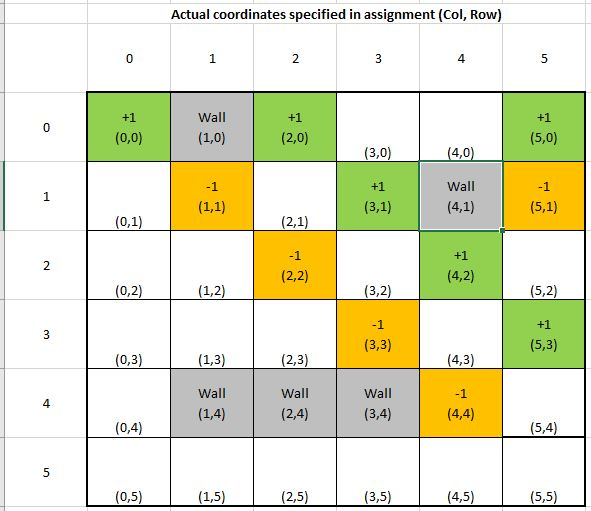

In [48]:
Image(filename = "coordinates_used_second_col,row.JPG", width = 600, height = 300)

In [49]:
iterations = int(len(hist)/36)
print(iterations)

hist_0_0 = []
hist_0_1 = []
hist_0_2 = []
hist_0_3 = [] 
hist_0_4 = [] 
hist_0_5 = [] 

hist_1_0 = []
hist_1_1 = [] 
hist_1_2 = []
hist_1_3 = [] 
hist_1_4 = [] 
hist_1_5 = [] 

hist_2_0 = []
hist_2_1 = []
hist_2_2 = []
hist_2_3 = []
hist_2_4 = []
hist_2_5 = []

hist_3_0 = []
hist_3_1 = []
hist_3_2 = []
hist_3_3 = []
hist_3_4 = []
hist_3_5 = []

hist_4_0 = []
hist_4_1 = []
hist_4_2 = []
hist_4_3 = []
hist_4_4 = []
hist_4_5 = []

hist_5_0 = []
hist_5_1 = []
hist_5_2 = []
hist_5_3 = []
hist_5_4 = []
hist_5_5 = []

#change coordinates
for i in range(iterations):
    hist_0_0.append(hist[0+i*36])
    hist_1_0.append(hist[1+i*36])
    hist_2_0.append(hist[2+i*36])
    hist_3_0.append(hist[3+i*36]) 
    hist_4_0.append(hist[4+i*36])
    hist_5_0.append(hist[5+i*36]) 

    hist_0_1.append(hist[6+i*36])
    hist_1_1.append(hist[7+i*36]) 
    hist_2_1.append(hist[8+i*36]) 
    hist_3_1.append(hist[9+i*36]) 
    hist_4_1.append(hist[10+i*36]) 
    hist_5_1.append(hist[11+i*36]) 
    
    hist_0_2.append(hist[12+i*36])
    hist_1_2.append(hist[13+i*36]) 
    hist_2_2.append(hist[14+i*36])
    hist_3_2.append(hist[15+i*36])
    hist_4_2.append(hist[16+i*36])
    hist_5_2.append(hist[17+i*36])
    
    hist_0_3.append(hist[18+i*36])
    hist_1_3.append(hist[19+i*36]) 
    hist_2_3.append(hist[20+i*36])
    hist_3_3.append(hist[21+i*36])
    hist_4_3.append(hist[22+i*36])
    hist_5_3.append(hist[23+i*36])
    
    hist_0_4.append(hist[24+i*36])
    hist_1_4.append(hist[25+i*36]) 
    hist_2_4.append(hist[26+i*36])
    hist_3_4.append(hist[27+i*36])
    hist_4_4.append(hist[28+i*36])
    hist_5_4.append(hist[29+i*36])
    
    hist_0_5.append(hist[30+i*36])
    hist_1_5.append(hist[31+i*36]) 
    hist_2_5.append(hist[32+i*36])
    hist_3_5.append(hist[33+i*36])
    hist_4_5.append(hist[34+i*36])
    hist_5_5.append(hist[35+i*36])

6290


In [50]:
list_of_tuples = [str((i,j)) for i in range(6) for j in range (6)]
print(list_of_tuples)

['(0, 0)', '(0, 1)', '(0, 2)', '(0, 3)', '(0, 4)', '(0, 5)', '(1, 0)', '(1, 1)', '(1, 2)', '(1, 3)', '(1, 4)', '(1, 5)', '(2, 0)', '(2, 1)', '(2, 2)', '(2, 3)', '(2, 4)', '(2, 5)', '(3, 0)', '(3, 1)', '(3, 2)', '(3, 3)', '(3, 4)', '(3, 5)', '(4, 0)', '(4, 1)', '(4, 2)', '(4, 3)', '(4, 4)', '(4, 5)', '(5, 0)', '(5, 1)', '(5, 2)', '(5, 3)', '(5, 4)', '(5, 5)']


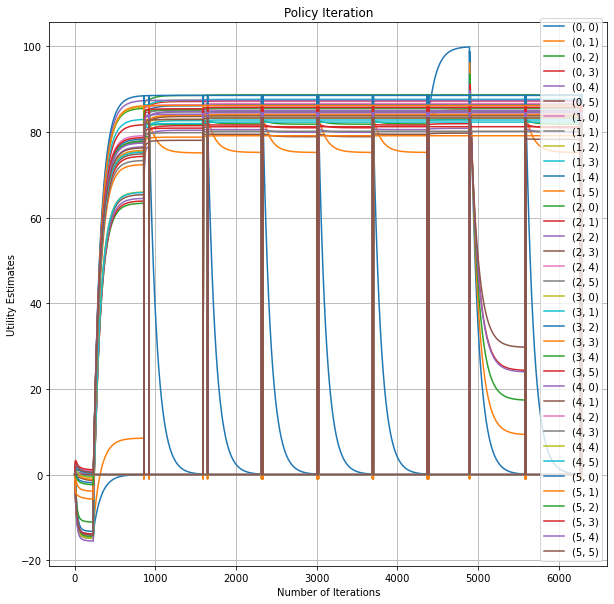

In [51]:
from matplotlib.pyplot import figure
x = [i for i in range(iterations)]

fig, ax = plt.subplots()
ax.plot(x, hist_0_0)
ax.plot(x, hist_0_1)
ax.plot(x, hist_0_2)
ax.plot(x, hist_0_3)
ax.plot(x, hist_0_4)
ax.plot(x, hist_0_5)

ax.plot(x, hist_1_0)
ax.plot(x, hist_1_1)
ax.plot(x, hist_1_2)
ax.plot(x, hist_1_3)
ax.plot(x, hist_1_4)
ax.plot(x, hist_1_5)

ax.plot(x, hist_2_0)
ax.plot(x, hist_2_1)
ax.plot(x, hist_2_2)
ax.plot(x, hist_2_3)
ax.plot(x, hist_2_4)
ax.plot(x, hist_2_5)

ax.plot(x, hist_3_0)
ax.plot(x, hist_3_1)
ax.plot(x, hist_3_2)
ax.plot(x, hist_3_3)
ax.plot(x, hist_3_4)
ax.plot(x, hist_3_5)

ax.plot(x, hist_4_0)
ax.plot(x, hist_4_1)
ax.plot(x, hist_4_2)
ax.plot(x, hist_4_3)
ax.plot(x, hist_4_4)
ax.plot(x, hist_4_5)

ax.plot(x, hist_5_0)
ax.plot(x, hist_5_1)
ax.plot(x, hist_5_2)
ax.plot(x, hist_5_3)
ax.plot(x, hist_5_4)
ax.plot(x, hist_5_5)

plt.legend(list_of_tuples, loc ="lower right")

plt.rcParams["figure.figsize"]=10,10

ax.set(xlabel='Number of Iterations', ylabel='Utility Estimates', title='Policy Iteration')
ax.grid()

fig.savefig("test.png")
plt.show()

# Printing column by column for a better view

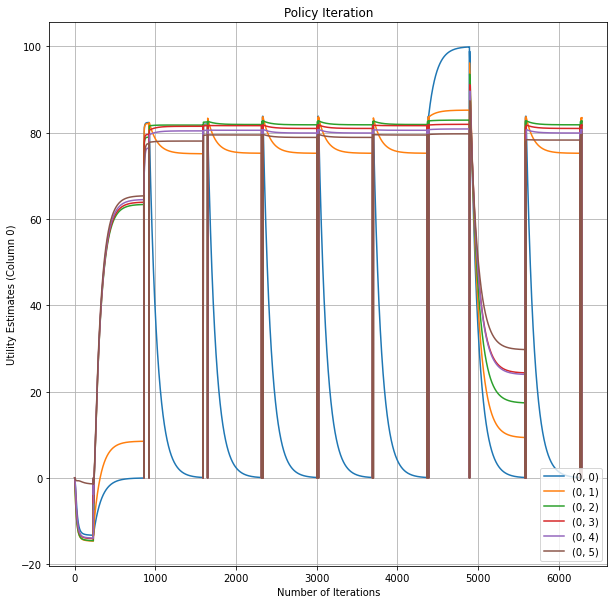

In [52]:
#Column 0

fig, ax = plt.subplots()
ax.plot(x, hist_0_0)
ax.plot(x, hist_0_1)
ax.plot(x, hist_0_2)
ax.plot(x, hist_0_3)
ax.plot(x, hist_0_4)
ax.plot(x, hist_0_5)

plt.legend(list_of_tuples, loc ="lower right")

ax.set(xlabel='Number of Iterations', ylabel='Utility Estimates (Column 0)', title='Policy Iteration')
ax.grid()

fig.savefig("test.png")
plt.show()

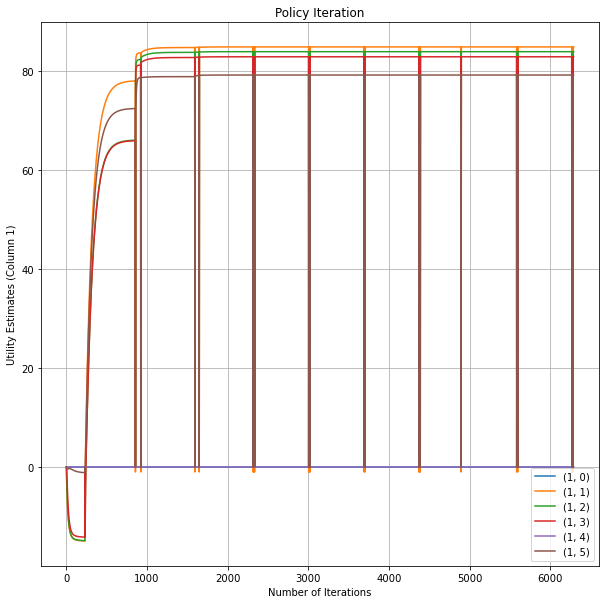

In [53]:
#Column 1

fig, ax = plt.subplots()
ax.plot(x, hist_1_0)
ax.plot(x, hist_1_1)
ax.plot(x, hist_1_2)
ax.plot(x, hist_1_3)
ax.plot(x, hist_1_4)
ax.plot(x, hist_1_5)

plt.legend(list_of_tuples[6:12], loc ="lower right")

ax.set(xlabel='Number of Iterations', ylabel='Utility Estimates (Column 1)', title='Policy Iteration')
ax.grid()

fig.savefig("test.png")
plt.show()

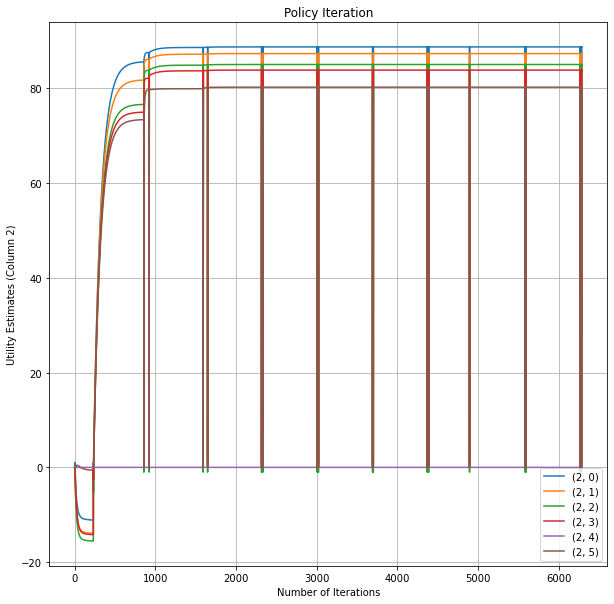

In [54]:
#Column 2

fig, ax = plt.subplots()
ax.plot(x, hist_2_0)
ax.plot(x, hist_2_1)
ax.plot(x, hist_2_2)
ax.plot(x, hist_2_3)
ax.plot(x, hist_2_4)
ax.plot(x, hist_2_5)

plt.legend(list_of_tuples[12:18], loc ="lower right")

ax.set(xlabel='Number of Iterations', ylabel='Utility Estimates (Column 2)', title='Policy Iteration')
ax.grid()

fig.savefig("test.png")
plt.show()

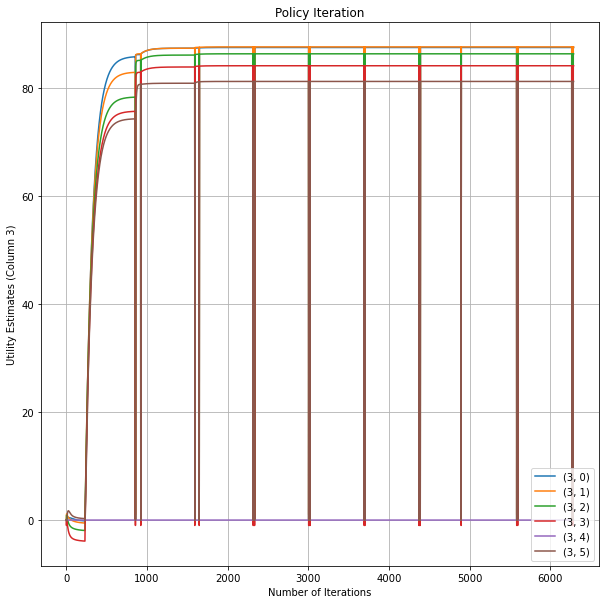

In [55]:
#Column 3

fig, ax = plt.subplots()
ax.plot(x, hist_3_0)
ax.plot(x, hist_3_1)
ax.plot(x, hist_3_2)
ax.plot(x, hist_3_3)
ax.plot(x, hist_3_4)
ax.plot(x, hist_3_5)

plt.legend(list_of_tuples[18:24], loc ="lower right")

ax.set(xlabel='Number of Iterations', ylabel='Utility Estimates (Column 3)', title='Policy Iteration')
ax.grid()

fig.savefig("test.png")
plt.show()

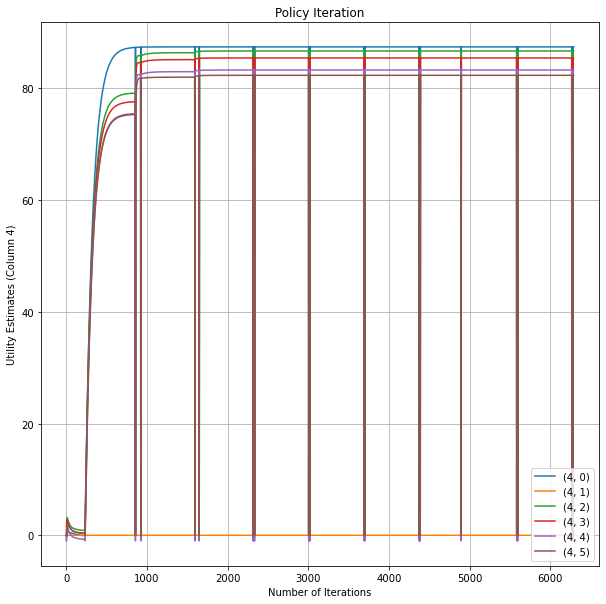

In [56]:
#Column 4

fig, ax = plt.subplots()
ax.plot(x, hist_4_0)
ax.plot(x, hist_4_1)
ax.plot(x, hist_4_2)
ax.plot(x, hist_4_3)
ax.plot(x, hist_4_4)
ax.plot(x, hist_4_5)

plt.legend(list_of_tuples[24:30], loc ="lower right")

ax.set(xlabel='Number of Iterations', ylabel='Utility Estimates (Column 4)', title='Policy Iteration')
ax.grid()

fig.savefig("test.png")
plt.show()

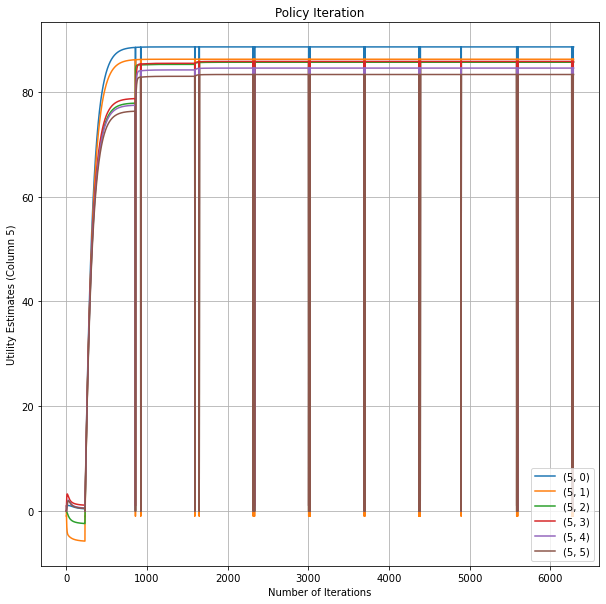

In [57]:
#Column 5

fig, ax = plt.subplots()
ax.plot(x, hist_5_0)
ax.plot(x, hist_5_1)
ax.plot(x, hist_5_2)
ax.plot(x, hist_5_3)
ax.plot(x, hist_5_4)
ax.plot(x, hist_5_5)

plt.legend(list_of_tuples[30:36], loc ="lower right")

ax.set(xlabel='Number of Iterations', ylabel='Utility Estimates (Column 5)', title='Policy Iteration')
ax.grid()

fig.savefig("test.png")
plt.show()

# Section 1: Value Iteration

### Please note that (row,col) format is used at first

In [58]:
#value iteration
import numpy as np
import matplotlib.pyplot as plt

SMALL_ENOUGH = 10e-4
GAMMA = 0.99
ALL_POSSIBLE_ACTIONS = ('U', 'D', 'L', 'R')


if __name__ == '__main__':
    grid = negative_grid()

    
    #print rewards
    print("rewards:")
    print_values(grid.rewards, grid)
    
    
    #we will randomly choose an action and update as we learn
    policy = {}
    for s in grid.actions.keys():
        policy[s] = np.random.choice(ALL_POSSIBLE_ACTIONS)
    
    
    #initial policy
    print("initial policy:")
    print_policy(policy, grid)
    
    hist = []
    
    #initialize V(s)
    V = {}
    states = grid.all_states()
    for s in states:
        #V[s] = 0
        if s in grid.actions:
            V[s] = 0
            #V[s] = np.random.random()
        else:
            #terminal state
            V[s] = 0

    
    #repeat until convergenece
    while True:
        
        grid = negative_grid()
        print("rewards:")
        print_values(grid.rewards, grid)
        
        biggest_change = 0
        for s in states: #states:11
            old_v = V[s]
            
            #V(s) only has value if it's not a terminal state
            if s in policy: #for those positions that can have policy (9 grids), iterate through
                new_v = float('-inf')
                for a in ALL_POSSIBLE_ACTIONS:
                    
                    grid.set_state(s)
                    #r = grid.move(a) #move only when legal / possible. Returns reward. 
                    r = grid.rewards.get(grid.current_state(), 0)
                    
                    
                    _ = grid.move(a)
                    v_correct = V[grid.current_state()]
                    
                    grid.set_state(s)
                    if a == 'U':
                        r_clockwise = grid.move('R')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('L')
                    elif a == 'R':
                        r_clockwise = grid.move('D')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('U')
                    elif a == 'D':
                        r_clockwise = grid.move('L')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('R')
                    elif a == 'L':
                        r_clockwise = grid.move('U')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('D')
                        
                    v_anticlockwise = V[grid.current_state()]
                        
                        
                    #v = r + GAMMA *V[grid.current_state()]) #current state is current position
                    v = r + GAMMA * (0.8*v_correct + 0.1*v_clockwise + 0.1*v_anticlockwise)
                    
                    if v > new_v:
                        new_v = v
                V[s] = new_v #update value if needed to
                biggest_change = max(biggest_change, np.abs(old_v - V[s]))
                
                
                print('Values:')
                print_values(V, grid)

                
        if biggest_change < SMALL_ENOUGH:
            break
            
            
    #find a policy that leads to optimal value function
    for s in policy.keys():
        best_a = None
        best_value = float('-inf')
        #loop through all possible actions to ind the best current action
        for a in ALL_POSSIBLE_ACTIONS:
            
            grid.set_state(s)
            r = grid.rewards.get(grid.current_state(), 0)
                    
                    
            _ = grid.move(a)
            v_correct = V[grid.current_state()]
                    
            grid.set_state(s)
            if a == 'U':
                r_clockwise = grid.move('R')
                v_clockwise = V[grid.current_state()]
                grid.set_state(s)
                r_anticlockwise = grid.move('L')
            elif a == 'R':
                r_clockwise = grid.move('D')
                v_clockwise = V[grid.current_state()]
                grid.set_state(s)
                r_anticlockwise = grid.move('U')
            elif a == 'D':
                r_clockwise = grid.move('L')
                v_clockwise = V[grid.current_state()]
                grid.set_state(s)
                r_anticlockwise = grid.move('R')
            elif a == 'L':
                r_clockwise = grid.move('U')
                v_clockwise = V[grid.current_state()]
                grid.set_state(s)
                r_anticlockwise = grid.move('D')
                        
            v_anticlockwise = V[grid.current_state()] 
                        
            v = r + GAMMA * (0.8*v_correct + 0.1*v_clockwise + 0.1*v_anticlockwise)
            
            
            if v > best_value:
                best_value = v
                best_a = a
        policy[s] = best_a
        
    print('values:')
    print_values(V, grid)
    print('policy:')
    print_policy(policy, grid)

rewards:
--------------------------
 0.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
initial policy:
--------------------------
    U   |         |     R   |     D   |     D   |     R   | 
--------------------------
    R   |     R   |     R   |     R   |         |     L   | 
--------------------------
    D   |     R   |     D   |     R   |     L   |     R   | 
--------------------------
    U   |     L   |     R   |     L   |     L   |     L   | 
--------------------------
    D   |         |         |         |     L   |     R   | 
-------

-0.04831| -0.04396| -1.00000|  0.75161|  0.99604| -0.04000| 
--------------------------
-0.04396| -0.08313| -0.14296| -1.00000|  0.74808|  0.99208| 
--------------------------
-0.08038|  0.00000|  0.00000|  0.00000| -1.00792| -0.04000| 
--------------------------
-0.04396| -0.08078| -0.04792| -0.04000| -0.07999| -0.04396| 
Values:
--------------------------
 1.00000|  0.00000|  1.98262|  0.92545|  0.75200|  1.96545| 
--------------------------
-0.04000| -0.33036|  0.85100|  1.00000|  0.00000| -0.20800| 
--------------------------
-0.04831| -0.04396| -0.25595|  0.75161|  0.99604| -0.04000| 
--------------------------
-0.04396| -0.08313| -0.14296| -1.00000|  0.74808|  0.99208| 
--------------------------
-0.08038|  0.00000|  0.00000|  0.00000| -1.00792| -0.04000| 
--------------------------
-0.04396| -0.08078| -0.04792| -0.04000| -0.07999| -0.04396| 
Values:
--------------------------
 1.00000|  0.00000|  1.98262|  0.92545|  0.75200|  1.96545| 
--------------------------
 0.71533| -0.330

Values:
--------------------------
 0.99000|  0.00000|  2.95183|  1.87193|  2.59933|  2.91610| 
--------------------------
 0.84411|  0.29506|  2.61438|  2.90221|  0.00000|  1.41161| 
--------------------------
 0.50996|  0.38034|  0.49390|  1.67812|  2.88261|  1.76642| 
--------------------------
 0.34246| -0.12889|  0.38582|  0.47890|  1.65878|  1.93248| 
--------------------------
-0.12096|  0.00000|  0.00000|  0.00000| -0.42541|  1.51197| 
--------------------------
-0.12960| -0.12194| -0.09430|  0.15814|  0.27126|  0.45618| 
Values:
--------------------------
 0.99000|  0.00000|  2.95183|  1.87193|  2.59933|  2.91610| 
--------------------------
 0.84411|  0.29506|  2.61438|  2.90221|  0.00000|  1.41161| 
--------------------------
 0.50996|  0.38034|  0.49390|  1.67812|  2.88261|  1.76642| 
--------------------------
 0.34246| -0.12889|  0.38582|  0.47890|  1.65878|  2.85509| 
--------------------------
-0.12096|  0.00000|  0.00000|  0.00000| -0.42541|  1.51197| 
----------------

 0.20728|  0.00000|  0.00000|  0.00000|  0.42133|  2.41262| 
--------------------------
 0.11020| -0.01142|  0.06657|  0.78515|  1.00232|  1.22949| 
Values:
--------------------------
 1.98010|  0.00000|  3.90809|  2.80812|  3.52829|  3.85558| 
--------------------------
 1.72441|  1.13746|  3.54731|  3.83325|  0.00000|  1.41161| 
--------------------------
 0.71667|  1.18664|  1.36494|  2.59283|  3.80519|  2.68148| 
--------------------------
 0.59451|  0.33333|  0.38582|  1.34645|  2.57310|  2.85509| 
--------------------------
 0.20728|  0.00000|  0.00000|  0.00000|  0.42133|  2.41262| 
--------------------------
 0.11020| -0.01142|  0.06657|  0.78515|  1.00232|  1.22949| 
Values:
--------------------------
 1.98010|  0.00000|  3.90809|  2.80812|  3.52829|  3.85558| 
--------------------------
 1.72441|  1.13746|  3.54731|  3.83325|  0.00000|  2.33312| 
--------------------------
 0.71667|  1.18664|  1.36494|  2.59283|  3.80519|  2.68148| 
--------------------------
 0.59451|  0.333

 2.67719|  2.03955|  3.54731|  4.75268|  0.00000|  2.33312| 
--------------------------
 1.51416|  1.18664|  2.27421|  3.50777|  3.80519|  3.58449| 
--------------------------
 0.59451|  1.07820|  1.20733|  1.34645|  3.47980|  3.76554| 
--------------------------
 0.47189|  0.00000|  0.00000|  0.00000|  1.31845|  2.41262| 
--------------------------
 0.11020|  0.42900|  0.59502|  0.78515|  1.84642|  2.09175| 
Values:
--------------------------
 2.96030|  0.00000|  4.85159|  3.73213|  3.52829|  4.78462| 
--------------------------
 2.67719|  2.03955|  3.54731|  4.75268|  0.00000|  2.33312| 
--------------------------
 1.51416|  1.18664|  2.27421|  3.50777|  3.80519|  3.58449| 
--------------------------
 1.32482|  1.07820|  1.20733|  1.34645|  3.47980|  3.76554| 
--------------------------
 0.47189|  0.00000|  0.00000|  0.00000|  1.31845|  2.41262| 
--------------------------
 0.11020|  0.42900|  0.59502|  0.78515|  1.84642|  2.09175| 
Values:
--------------------------
 2.96030|  0.000

 1.10269|  0.00000|  0.00000|  0.00000|  2.21438|  3.31169| 
--------------------------
 0.38712|  0.42900|  1.32745|  1.57783|  1.84642|  2.97274| 
Values:
--------------------------
 3.93070|  0.00000|  4.85159|  4.64479|  4.44802|  4.78462| 
--------------------------
 2.67719|  2.95094|  4.47489|  4.75268|  0.00000|  3.25138| 
--------------------------
 2.43515|  2.06983|  2.27421|  4.41614|  4.71584|  3.58449| 
--------------------------
 1.32482|  1.07820|  2.08989|  2.24218|  4.37876|  4.66503| 
--------------------------
 1.10269|  0.00000|  0.00000|  0.00000|  2.21438|  3.31169| 
--------------------------
 0.38712|  0.42900|  1.32745|  1.57783|  1.84642|  2.97274| 
Values:
--------------------------
 3.93070|  0.00000|  4.85159|  4.64479|  4.44802|  4.78462| 
--------------------------
 2.67719|  2.95094|  4.47489|  4.75268|  0.00000|  3.25138| 
--------------------------
 2.43515|  2.06983|  2.27421|  4.41614|  4.71584|  3.58449| 
--------------------------
 1.32482|  1.937

 3.63030|  2.95094|  5.39242|  5.66116|  0.00000|  4.16091| 
--------------------------
 2.43515|  2.96743|  3.18622|  4.41614|  5.61553|  4.47867| 
--------------------------
 2.21159|  1.93736|  2.98595|  3.13798|  4.37876|  5.55407| 
--------------------------
 1.10269|  0.00000|  0.00000|  0.00000|  3.10318|  4.20179| 
--------------------------
 0.98019|  1.09628|  2.14250|  2.42382|  2.71643|  3.85104| 
Values:
--------------------------
 4.89139|  0.00000|  5.78260|  4.64479|  5.35784|  5.70345| 
--------------------------
 3.63030|  2.95094|  5.39242|  5.66116|  0.00000|  4.16091| 
--------------------------
 2.43515|  2.96743|  3.18622|  4.41614|  5.61553|  4.47867| 
--------------------------
 2.21159|  1.93736|  2.98595|  3.13798|  4.37876|  5.55407| 
--------------------------
 1.10269|  0.00000|  0.00000|  0.00000|  3.10318|  4.20179| 
--------------------------
 0.98019|  1.09628|  2.14250|  2.42382|  2.71643|  3.85104| 
Values:
--------------------------
 4.89139|  0.000

--------------------------
 3.37005|  2.96743|  4.09075|  5.31501|  6.50525|  5.36929| 
--------------------------
 3.12768|  2.82476|  2.98595|  4.02663|  5.26802|  5.55407| 
--------------------------
 1.92992|  0.00000|  0.00000|  0.00000|  3.10318|  5.08202| 
--------------------------
 1.77105|  1.87392|  2.14250|  3.28016|  3.58617|  3.85104| 
Values:
--------------------------
 4.89139|  0.00000|  6.70275|  5.56011|  6.25772|  6.61220| 
--------------------------
 4.57519|  3.85671|  6.29986|  6.56027|  0.00000|  4.16091| 
--------------------------
 3.37005|  3.86134|  4.09075|  5.31501|  6.50525|  5.36929| 
--------------------------
 3.12768|  2.82476|  2.98595|  4.02663|  5.26802|  5.55407| 
--------------------------
 1.92992|  0.00000|  0.00000|  0.00000|  3.10318|  5.08202| 
--------------------------
 1.77105|  1.87392|  2.14250|  3.28016|  3.58617|  3.85104| 
Values:
--------------------------
 4.89139|  0.00000|  6.70275|  5.56011|  6.25772|  6.61220| 
----------------

 5.78405|  0.00000|  7.61253|  7.36709|  7.14773|  7.51099| 
--------------------------
 5.51079|  5.64083|  7.19731|  7.45038|  0.00000|  5.95072| 
--------------------------
 5.22014|  4.74700|  4.98603|  6.20474|  7.38518|  6.25008| 
--------------------------
 4.04228|  3.71176|  4.76216|  4.90672|  6.14771|  7.30341| 
--------------------------
 2.81924|  0.00000|  0.00000|  0.00000|  4.85258|  5.95273| 
--------------------------
 2.63477|  2.69286|  3.82356|  4.13271|  4.44853|  5.58237| 
Values:
--------------------------
 5.78405|  0.00000|  7.61253|  7.36709|  7.14773|  7.51099| 
--------------------------
 5.51079|  5.64083|  7.19731|  7.45038|  0.00000|  5.95072| 
--------------------------
 5.22014|  4.74700|  4.98603|  7.08545|  7.38518|  6.25008| 
--------------------------
 4.04228|  3.71176|  4.76216|  4.90672|  6.14771|  7.30341| 
--------------------------
 2.81924|  0.00000|  0.00000|  0.00000|  4.85258|  5.95273| 
--------------------------
 2.63477|  2.69286|  3.8

 5.64498|  5.64083|  8.08485|  8.33151|  0.00000|  6.83098| 
--------------------------
 5.22014|  5.62335|  5.87169|  7.08545|  8.25553|  7.12123| 
--------------------------
 4.94908|  4.59127|  5.63692|  5.77790|  7.01787|  8.16389| 
--------------------------
 3.71969|  0.00000|  0.00000|  0.00000|  4.85258|  6.81403| 
--------------------------
 3.51546|  3.52145|  3.82356|  4.97750|  5.30205|  5.58237| 
Values:
--------------------------
 5.78405|  0.00000|  8.51210|  7.36709|  8.02798|  8.39991| 
--------------------------
 5.64498|  5.64083|  8.08485|  8.33151|  0.00000|  6.83098| 
--------------------------
 5.22014|  5.62335|  5.87169|  7.08545|  8.25553|  7.12123| 
--------------------------
 4.94908|  4.59127|  5.63692|  5.77790|  7.01787|  8.16389| 
--------------------------
 3.71969|  0.00000|  0.00000|  0.00000|  4.85258|  6.81403| 
--------------------------
 3.51546|  3.52145|  4.65924|  4.97750|  5.30205|  5.58237| 
Values:
--------------------------
 5.78405|  0.000

--------------------------
 4.61617|  0.00000|  0.00000|  0.00000|  5.71315|  7.66599| 
--------------------------
 4.39442|  4.34737|  4.65924|  5.81353|  6.14645|  6.43427| 
Values:
--------------------------
 5.72621|  0.00000|  9.40160|  8.25575|  8.89858|  9.27909| 
--------------------------
 6.23436|  6.51835|  8.96255|  9.20363|  0.00000|  7.70158| 
--------------------------
 5.50433|  6.49018|  6.74767|  7.95715|  9.11644|  7.98287| 
--------------------------
 5.35010|  5.46171|  6.50223|  6.64010|  7.87862|  9.01504| 
--------------------------
 4.61617|  0.00000|  0.00000|  0.00000|  5.71315|  7.66599| 
--------------------------
 4.39442|  4.34737|  4.65924|  5.81353|  6.14645|  6.43427| 
Values:
--------------------------
 5.72621|  0.00000|  9.40160|  8.25575|  8.89858|  9.27909| 
--------------------------
 6.23436|  6.51835|  8.96255|  9.20363|  0.00000|  7.70158| 
--------------------------
 5.50433|  6.49018|  6.74767|  7.95715|  9.11644|  7.98287| 
----------------

 5.77831|  0.00000|  0.00000|  0.00000|  7.40646|  8.50872| 
--------------------------
 4.99282|  5.97710|  6.30575|  6.64060|  7.80796|  8.11052| 
Values:
--------------------------
 7.04582|  0.00000|  11.15086|  10.00360|  9.75964|  11.00864| 
--------------------------
 7.88812|  8.24411|  9.83051|  10.06676|  0.00000|  8.56263| 
--------------------------
 7.08338|  7.34455|  8.47055|  9.67350|  9.96806|  8.83516| 
--------------------------
 6.06854|  7.13540|  7.35515|  7.49330|  9.57238|  9.85696| 
--------------------------
 5.77831|  0.00000|  0.00000|  0.00000|  7.40646|  8.50872| 
--------------------------
 4.99282|  5.97710|  6.30575|  6.64060|  7.80796|  8.11052| 
Values:
--------------------------
 7.04582|  0.00000|  11.15086|  10.00360|  9.75964|  11.00864| 
--------------------------
 7.88812|  8.24411|  9.83051|  10.06676|  0.00000|  8.56263| 
--------------------------
 7.08338|  7.34455|  8.47055|  9.67350|  9.96806|  9.67825| 
--------------------------
 6.06854

 8.80006|  9.09264|  11.53761|  11.76609|  0.00000|  9.41424| 
--------------------------
 7.90996|  8.19125|  9.31778|  10.51818|  11.64395|  10.51223| 
--------------------------
 7.70611|  7.97211|  8.20047|  9.17240|  10.40561|  10.68975| 
--------------------------
 6.55666|  0.00000|  0.00000|  0.00000|  8.23945|  10.16687| 
--------------------------
 6.54852|  6.77923|  7.11586|  8.26803|  8.62525|  8.93504| 
Values:
--------------------------
 8.64247|  0.00000|  12.01085|  10.86301|  11.45352|  11.85921| 
--------------------------
 8.80006|  9.09264|  11.53761|  11.76609|  0.00000|  9.41424| 
--------------------------
 7.90996|  9.02909|  9.31778|  10.51818|  11.64395|  10.51223| 
--------------------------
 7.70611|  7.97211|  8.20047|  9.17240|  10.40561|  10.68975| 
--------------------------
 6.55666|  0.00000|  0.00000|  0.00000|  8.23945|  10.16687| 
--------------------------
 6.54852|  6.77923|  7.11586|  8.26803|  8.62525|  8.93504| 
Values:
-----------------------

 8.80006|  9.93184|  11.53761|  11.76609|  0.00000|  10.25651| 
--------------------------
 8.74515|  9.02909|  9.31778|  11.35396|  11.64395|  10.51223| 
--------------------------
 7.70611|  8.80041|  9.03699|  9.17240|  11.22991|  11.51351| 
--------------------------
 7.36146|  0.00000|  0.00000|  0.00000|  9.06347|  10.16687| 
--------------------------
 6.54852|  7.57272|  7.91722|  8.26803|  9.43368|  9.75063| 
Values:
--------------------------
 9.68086|  0.00000|  12.86125|  11.71288|  11.45352|  12.70045| 
--------------------------
 8.80006|  9.93184|  11.53761|  11.76609|  0.00000|  10.25651| 
--------------------------
 8.74515|  9.02909|  9.31778|  11.35396|  11.64395|  10.51223| 
--------------------------
 7.70611|  8.80041|  9.03699|  9.17240|  11.22991|  11.51351| 
--------------------------
 7.36146|  0.00000|  0.00000|  0.00000|  9.06347|  10.16687| 
--------------------------
 6.54852|  7.57272|  7.91722|  8.26803|  9.43368|  9.75063| 
Values:
---------------------

 8.16896|  0.00000|  0.00000|  0.00000|  9.87864|  10.98250| 
--------------------------
 7.33469|  8.35764|  8.70990|  9.06855|  10.23337|  10.55739| 
Values:
--------------------------
 10.58405|  0.00000|  13.70215|  12.55332|  12.28656|  13.53247| 
--------------------------
 9.65019|  10.76175|  12.37699|  12.60236|  0.00000|  11.08955| 
--------------------------
 9.56668|  9.85781|  10.15571|  12.18086|  12.46844|  11.33724| 
--------------------------
 8.52448|  9.61980|  9.86444|  9.99876|  12.04539|  12.32835| 
--------------------------
 8.16896|  0.00000|  0.00000|  0.00000|  9.87864|  10.98250| 
--------------------------
 7.33469|  8.35764|  8.70990|  9.06855|  10.23337|  10.55739| 
Values:
--------------------------
 10.58405|  0.00000|  13.70215|  12.55332|  12.28656|  13.53247| 
--------------------------
 9.65019|  10.76175|  12.37699|  12.60236|  0.00000|  11.08955| 
--------------------------
 9.56668|  9.85781|  10.98441|  12.18086|  12.46844|  11.33724| 
---------

--------------------------
 9.33471|  10.43022|  10.68283|  10.81632|  12.85212|  13.13438| 
--------------------------
 8.97054|  0.00000|  0.00000|  0.00000|  10.68507|  11.78931| 
--------------------------
 8.11411|  9.13406|  9.49400|  9.86040|  11.02442|  11.35542| 
Values:
--------------------------
 11.47821|  0.00000|  14.53367|  13.38443|  13.11046|  14.35537| 
--------------------------
 11.29708|  11.58247|  13.20706|  13.42976|  0.00000|  11.91345| 
--------------------------
 10.37800|  10.67742|  11.80395|  12.99895|  13.28409|  12.15337| 
--------------------------
 9.33471|  10.43022|  10.68283|  10.81632|  12.85212|  13.13438| 
--------------------------
 8.97054|  0.00000|  0.00000|  0.00000|  10.68507|  11.78931| 
--------------------------
 8.11411|  9.13406|  9.49400|  9.86040|  11.02442|  11.35542| 
Values:
--------------------------
 11.47821|  0.00000|  14.53367|  13.38443|  13.11046|  14.35537| 
--------------------------
 11.29708|  11.58247|  13.20706|  13.4

 12.36343|  0.00000|  15.35593|  14.20631|  13.92532|  15.16924| 
--------------------------
 12.10695|  12.39409|  14.02792|  14.24832|  0.00000|  12.72831| 
--------------------------
 11.18039|  11.48799|  12.61444|  13.80827|  14.09101|  12.96074| 
--------------------------
 10.13624|  11.23173|  11.49221|  11.62513|  13.65020|  13.93170| 
--------------------------
 9.76407|  0.00000|  0.00000|  0.00000|  11.48285|  12.58740| 
--------------------------
 8.88556|  9.90208|  10.26962|  10.64370|  11.80692|  12.14482| 
Values:
--------------------------
 12.36343|  0.00000|  15.35593|  14.20631|  13.92532|  15.16924| 
--------------------------
 12.10695|  12.39409|  14.02792|  14.24832|  0.00000|  12.72831| 
--------------------------
 11.18039|  11.48799|  12.61444|  13.80827|  14.09101|  13.75942| 
--------------------------
 10.13624|  11.23173|  11.49221|  11.62513|  13.65020|  13.93170| 
--------------------------
 9.76407|  0.00000|  0.00000|  0.00000|  11.48285|  12.58740| 

-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 13.23979|  0.00000|  15.35593|  15.01907|  14.73125|  15.16924| 
--------------------------
 12.10695|  13.19670|  14.83966|  15.05811|  0.00000|  13.53424| 
--------------------------
 11.97404|  12.28959|  12.61444|  14.60889|  14.88928|  13.75942| 
--------------------------
 10.93029|  11.23173|  12.29268|  12.42525|  13.65020|  14.72039| 
--------------------------
 10.55008|  0.00000|  0.00000|  0.00000|  12.27207|  13.37686| 
--------------------------
 9.64876|  9.90208|  11.03686|  11.41853|  11.80692|  12.92569| 
Values:
--------------------------
 13.23979|  0.00000|  15.35593|  15.01907|  14.73125|  15.16924| 
---------

 12.76323|  13.08233|  13.41596|  15.40088|  15.67899|  14.54952| 
--------------------------
 11.71596|  12.80835|  13.08432|  13.21675|  15.22078|  15.50058| 
--------------------------
 11.32796|  0.00000|  0.00000|  0.00000|  13.05282|  14.15780| 
--------------------------
 10.40384|  10.66181|  11.79582|  12.18500|  13.34667|  13.69813| 
Values:
--------------------------
 13.10740|  0.00000|  16.16902|  15.82281|  15.52834|  15.97419| 
--------------------------
 12.95098|  13.99040|  15.64240|  15.85919|  0.00000|  14.33134| 
--------------------------
 12.76323|  13.08233|  13.41596|  15.40088|  15.67899|  14.54952| 
--------------------------
 11.71596|  12.80835|  13.08432|  13.21675|  15.22078|  15.50058| 
--------------------------
 11.32796|  0.00000|  0.00000|  0.00000|  13.05282|  14.15780| 
--------------------------
 10.40384|  11.41332|  11.79582|  12.18500|  13.34667|  13.69813| 
Values:
--------------------------
 13.10740|  0.00000|  16.97305|  15.82281|  15.52834

 12.76323|  13.86630|  14.20862|  15.40088|  16.46023|  15.33112| 
--------------------------
 12.49639|  12.80835|  13.86722|  13.99970|  15.22078|  16.27234| 
--------------------------
 11.32796|  0.00000|  0.00000|  0.00000|  13.82519|  14.93031| 
--------------------------
 11.15080|  11.41332|  12.54658|  12.94319|  13.34667|  14.46224| 
Values:
--------------------------
 14.36772|  0.00000|  16.97305|  16.61763|  16.31669|  16.77031| 
--------------------------
 13.60159|  14.77530|  16.43622|  16.65163|  0.00000|  15.11969| 
--------------------------
 12.76323|  13.86630|  14.20862|  15.40088|  16.46023|  15.33112| 
--------------------------
 12.49639|  12.80835|  13.86722|  13.99970|  15.22078|  16.27234| 
--------------------------
 11.32796|  0.00000|  0.00000|  0.00000|  13.82519|  14.93031| 
--------------------------
 11.15080|  11.41332|  12.54658|  12.94319|  13.34667|  14.46224| 
Values:
--------------------------
 14.36772|  0.00000|  16.97305|  16.61763|  16.31669

 14.29633|  14.64159|  14.99250|  16.96032|  17.23308|  16.10431| 
--------------------------
 13.25520|  14.35035|  14.64148|  14.77417|  16.75778|  17.03577| 
--------------------------
 12.85393|  0.00000|  0.00000|  0.00000|  14.58925|  15.69449| 
--------------------------
 11.88997|  12.15673|  13.28924|  13.69320|  14.10411|  15.21810| 
Values:
--------------------------
 15.26822|  0.00000|  17.76814|  17.40376|  17.09640|  17.55770| 
--------------------------
 14.42350|  15.55160|  17.22137|  17.43686|  0.00000|  15.89939| 
--------------------------
 14.29633|  14.64159|  14.99250|  16.96032|  17.23308|  16.10431| 
--------------------------
 13.25520|  14.35035|  14.64148|  14.77417|  16.75778|  17.03577| 
--------------------------
 12.85393|  0.00000|  0.00000|  0.00000|  14.58925|  15.69449| 
--------------------------
 11.88997|  12.15673|  13.28924|  13.69320|  14.85338|  15.21810| 
Values:
--------------------------
 15.26822|  0.00000|  17.76814|  17.40376|  17.09640

--------------------------
 15.05624|  15.40848|  16.53500|  17.72903|  17.99772|  17.62588| 
--------------------------
 14.76786|  15.10882|  15.40744|  15.54110|  17.51407|  17.79097| 
--------------------------
 13.60547|  0.00000|  0.00000|  0.00000|  15.34509|  16.45042| 
--------------------------
 12.62020|  13.61956|  14.02389|  14.43513|  15.59457|  15.96581| 
Values:
--------------------------
 15.11554|  0.00000|  19.33190|  18.18132|  17.86756|  19.10667| 
--------------------------
 15.87199|  16.31943|  17.99796|  18.98468|  0.00000|  16.67055| 
--------------------------
 15.05624|  15.40848|  16.53500|  17.72903|  17.99772|  17.62588| 
--------------------------
 14.76786|  15.10882|  15.40744|  15.54110|  17.51407|  17.79097| 
--------------------------
 13.60547|  0.00000|  0.00000|  0.00000|  15.34509|  17.19821| 
--------------------------
 12.62020|  13.61956|  14.02389|  14.43513|  15.59457|  15.96581| 
Values:
--------------------------
 15.11554|  0.00000|  19.

 14.35003|  0.00000|  0.00000|  0.00000|  16.09293|  17.19821| 
--------------------------
 13.34303|  14.33917|  14.75062|  15.16906|  16.32778|  16.70546| 
Values:
--------------------------
 15.56349|  0.00000|  20.10081|  18.95030|  18.63025|  19.86843| 
--------------------------
 16.59118|  17.07882|  18.76598|  18.98468|  0.00000|  17.43325| 
--------------------------
 15.79770|  16.16711|  17.29366|  18.48951|  18.75433|  18.37458| 
--------------------------
 14.76786|  15.85920|  16.16525|  16.30062|  18.26245|  18.53804| 
--------------------------
 14.35003|  0.00000|  0.00000|  0.00000|  16.09293|  17.19821| 
--------------------------
 13.34303|  14.33917|  14.75062|  15.16906|  16.32778|  16.70546| 
Values:
--------------------------
 15.56349|  0.00000|  20.10081|  18.95030|  18.63025|  19.86843| 
--------------------------
 16.59118|  17.07882|  18.76598|  19.74596|  0.00000|  17.43325| 
--------------------------
 15.79770|  16.16711|  17.29366|  18.48951|  18.75433|

 15.08135|  0.00000|  0.00000|  0.00000|  16.83292|  17.93795| 
--------------------------
 14.06576|  14.33917|  15.46953|  15.89508|  16.32778|  17.43714| 
Values:
--------------------------
 16.22179|  0.00000|  20.10081|  19.71077|  19.38459|  19.86843| 
--------------------------
 16.59118|  17.82982|  19.52549|  19.74596|  0.00000|  18.18758| 
--------------------------
 16.53615|  16.91744|  17.29366|  19.24166|  19.50297|  18.37458| 
--------------------------
 15.50511|  16.60140|  16.91479|  17.05204|  19.00294|  19.27706| 
--------------------------
 15.08135|  0.00000|  0.00000|  0.00000|  16.83292|  17.93795| 
--------------------------
 14.06576|  14.33917|  15.46953|  15.89508|  17.05313|  17.43714| 
Values:
--------------------------
 16.22179|  0.00000|  20.10081|  19.71077|  19.38459|  19.86843| 
--------------------------
 16.59118|  17.82982|  19.52549|  19.74596|  0.00000|  18.18758| 
--------------------------
 16.53615|  16.91744|  17.29366|  19.24166|  19.50297|

 14.78699|  15.75522|  16.18070|  16.61330|  17.77070|  18.16098| 
Values:
--------------------------
 16.93272|  0.00000|  21.61313|  20.46281|  20.13065|  21.36700| 
--------------------------
 17.32425|  18.57250|  20.27659|  20.49880|  0.00000|  18.93365| 
--------------------------
 17.26902|  17.65949|  18.78592|  19.98553|  20.24370|  19.11536| 
--------------------------
 16.23844|  17.33544|  17.65607|  17.79525|  19.73555|  20.00816| 
--------------------------
 15.80695|  0.00000|  0.00000|  0.00000|  17.56509|  18.66975| 
--------------------------
 14.78699|  15.75522|  16.18070|  16.61330|  17.77070|  18.16098| 
Values:
--------------------------
 16.93272|  0.00000|  21.61313|  20.46281|  20.13065|  21.36700| 
--------------------------
 18.05540|  18.57250|  20.27659|  20.49880|  0.00000|  18.93365| 
--------------------------
 17.26902|  17.65949|  18.78592|  19.98553|  20.24370|  19.11536| 
--------------------------
 16.23844|  17.33544|  17.65607|  17.79525|  19.735

--------------------------
 17.65255|  0.00000|  21.61313|  21.20651|  20.86853|  21.36700| 
--------------------------
 18.05540|  19.30696|  21.01937|  21.24331|  0.00000|  19.67153| 
--------------------------
 17.99446|  18.39333|  18.78592|  20.72118|  20.97655|  19.84825| 
--------------------------
 16.96419|  17.33544|  18.38916|  18.53031|  19.73555|  20.73142| 
--------------------------
 16.52541|  0.00000|  0.00000|  0.00000|  18.28948|  19.39371| 
--------------------------
 15.50279|  15.75522|  16.88425|  17.32383|  17.77070|  18.87706| 
Values:
--------------------------
 17.65255|  0.00000|  21.61313|  21.20651|  20.86853|  21.36700| 
--------------------------
 18.05540|  19.30696|  21.01937|  21.24331|  0.00000|  19.67153| 
--------------------------
 17.99446|  18.39333|  18.78592|  20.72118|  20.97655|  19.84825| 
--------------------------
 16.96419|  17.33544|  18.38916|  18.53031|  20.46034|  20.73142| 
--------------------------
 16.52541|  0.00000|  0.00000|  

--------------------------
 17.68206|  18.06136|  19.11413|  19.25728|  20.46034|  21.44692| 
--------------------------
 16.52541|  0.00000|  0.00000|  0.00000|  19.00613|  20.10992| 
--------------------------
 16.21164|  16.45186|  17.58026|  18.02674|  18.48059|  18.87706| 
Values:
--------------------------
 17.65255|  0.00000|  22.35675|  21.20651|  21.59833|  22.10398| 
--------------------------
 18.78016|  19.30696|  21.75391|  21.97956|  0.00000|  20.40132| 
--------------------------
 17.99446|  19.11905|  19.51968|  20.72118|  21.70159|  20.57332| 
--------------------------
 17.68206|  18.06136|  19.11413|  19.25728|  20.46034|  21.44692| 
--------------------------
 16.52541|  0.00000|  0.00000|  0.00000|  19.00613|  20.10992| 
--------------------------
 16.21164|  16.45186|  17.58026|  18.02674|  18.48059|  19.58546| 
Values:
--------------------------
 19.36909|  0.00000|  22.35675|  21.20651|  21.59833|  22.10398| 
--------------------------
 18.78016|  19.30696|  21.

 16.91301|  17.14104|  17.58026|  18.72213|  19.18287|  19.58546| 
Values:
--------------------------
 19.36909|  0.00000|  23.09212|  21.94196|  21.59833|  22.83288| 
--------------------------
 19.59638|  20.03327|  22.48031|  22.70765|  0.00000|  20.40132| 
--------------------------
 18.71205|  19.11905|  20.24530|  21.44872|  22.41885|  21.29063| 
--------------------------
 18.39204|  18.77925|  19.11413|  19.97624|  21.17737|  21.44692| 
--------------------------
 17.23623|  0.00000|  0.00000|  0.00000|  19.00613|  20.81845| 
--------------------------
 16.91301|  17.14104|  17.58026|  18.72213|  19.18287|  19.58546| 
Values:
--------------------------
 19.36909|  0.00000|  23.09212|  21.94196|  22.32011|  22.83288| 
--------------------------
 19.59638|  20.03327|  22.48031|  22.70765|  0.00000|  20.40132| 
--------------------------
 18.71205|  19.11905|  20.24530|  21.44872|  22.41885|  21.29063| 
--------------------------
 18.39204|  18.77925|  19.11413|  19.97624|  21.177

 19.43154|  20.54644|  20.96289|  22.16821|  23.12841|  22.00024| 
--------------------------
 19.10002|  19.48919|  20.54008|  20.68728|  21.88670|  22.85502| 
--------------------------
 17.93927|  0.00000|  0.00000|  0.00000|  20.41648|  21.51939| 
--------------------------
 17.60675|  17.82283|  18.95000|  19.41007|  19.87763|  20.97959| 
Values:
--------------------------
 20.15186|  0.00000|  23.81933|  23.38851|  23.03398|  23.55379| 
--------------------------
 20.33412|  21.46183|  23.19865|  23.42767|  0.00000|  21.83698| 
--------------------------
 20.13676|  20.54644|  20.96289|  22.16821|  23.12841|  22.00024| 
--------------------------
 19.10002|  19.48919|  20.54008|  20.68728|  21.88670|  22.85502| 
--------------------------
 17.93927|  0.00000|  0.00000|  0.00000|  20.41648|  21.51939| 
--------------------------
 17.60675|  17.82283|  18.95000|  19.41007|  19.87763|  20.97959| 
Values:
--------------------------
 20.15186|  0.00000|  23.81933|  23.38851|  23.03398

 18.29654|  18.49732|  18.95000|  20.09063|  20.56495|  20.97959| 
Values:
--------------------------
 20.15186|  0.00000|  24.53849|  23.38851|  23.74003|  24.26679| 
--------------------------
 20.94634|  21.46183|  23.90903|  24.13970|  0.00000|  21.83698| 
--------------------------
 20.13676|  21.24830|  21.67253|  22.87975|  23.83031|  22.70221| 
--------------------------
 19.79815|  20.19127|  20.54008|  21.39048|  22.58839|  22.85502| 
--------------------------
 18.63919|  0.00000|  0.00000|  0.00000|  20.41648|  22.21282| 
--------------------------
 18.29654|  18.49732|  18.95000|  20.09063|  20.56495|  20.97959| 
Values:
--------------------------
 20.15186|  0.00000|  24.53849|  23.38851|  23.74003|  24.26679| 
--------------------------
 20.94634|  21.46183|  23.90903|  24.13970|  0.00000|  22.54302| 
--------------------------
 20.13676|  21.24830|  21.67253|  22.87975|  23.83031|  22.70221| 
--------------------------
 19.79815|  20.19127|  20.54008|  21.39048|  22.588

 21.61288|  22.16426|  23.90903|  24.84385|  0.00000|  22.54302| 
--------------------------
 20.82236|  21.24830|  22.37430|  23.58343|  23.83031|  23.39659| 
--------------------------
 20.47900|  20.88557|  21.24123|  21.39048|  23.28249|  23.54776| 
--------------------------
 19.33070|  0.00000|  0.00000|  0.00000|  21.11030|  22.89882| 
--------------------------
 18.29654|  19.16458|  19.62388|  20.09063|  21.24490|  21.66547| 
Values:
--------------------------
 20.57957|  0.00000|  25.24967|  24.09977|  23.74003|  24.97197| 
--------------------------
 21.61288|  22.16426|  23.90903|  24.84385|  0.00000|  22.54302| 
--------------------------
 20.82236|  21.24830|  22.37430|  23.58343|  23.83031|  23.39659| 
--------------------------
 20.47900|  20.88557|  21.24123|  22.08592|  23.28249|  23.54776| 
--------------------------
 19.33070|  0.00000|  0.00000|  0.00000|  21.11030|  22.89882| 
--------------------------
 18.29654|  19.16458|  19.62388|  20.09063|  21.24490|  21.66

 22.29131|  22.85890|  24.61154|  24.84385|  0.00000|  23.24132| 
--------------------------
 21.50546|  21.94238|  23.06829|  24.27932|  24.52463|  24.08347| 
--------------------------
 20.47900|  21.57219|  21.93462|  22.08592|  23.96909|  24.23307| 
--------------------------
 20.00684|  0.00000|  0.00000|  0.00000|  21.79664|  22.89882| 
--------------------------
 18.97856|  19.82470|  20.29054|  20.76391|  21.91755|  22.34399| 
Values:
--------------------------
 21.19216|  0.00000|  25.95297|  24.80316|  24.43833|  25.66942| 
--------------------------
 22.29131|  22.85890|  24.61154|  25.54018|  0.00000|  23.24132| 
--------------------------
 21.50546|  21.94238|  23.06829|  24.27932|  24.52463|  24.08347| 
--------------------------
 20.47900|  21.57219|  21.93462|  22.08592|  23.96909|  24.23307| 
--------------------------
 20.00684|  0.00000|  0.00000|  0.00000|  21.79664|  22.89882| 
--------------------------
 18.97856|  19.82470|  20.29054|  20.76391|  21.91755|  22.34

--------------------------
 22.18320|  22.62876|  23.06829|  24.96752|  25.21142|  24.08347| 
--------------------------
 21.15539|  22.25119|  22.62033|  22.77369|  24.64823|  24.91102| 
--------------------------
 20.67642|  0.00000|  0.00000|  0.00000|  22.47555|  23.57744| 
--------------------------
 19.64694|  19.82470|  20.95005|  21.42995|  22.58298|  23.01523| 
Values:
--------------------------
 22.85077|  0.00000|  25.95297|  25.49874|  25.12897|  25.66942| 
--------------------------
 22.29131|  23.54584|  25.30626|  25.54018|  0.00000|  23.93197| 
--------------------------
 22.18320|  22.62876|  23.06829|  24.96752|  25.21142|  24.08347| 
--------------------------
 21.15539|  22.25119|  22.62033|  22.77369|  24.64823|  24.91102| 
--------------------------
 20.67642|  0.00000|  0.00000|  0.00000|  22.47555|  23.57744| 
--------------------------
 19.64694|  20.47773|  20.95005|  21.42995|  22.58298|  23.01523| 
Values:
--------------------------
 22.85077|  0.00000|  26.

--------------------------
 21.82635|  22.25119|  23.29844|  23.45386|  24.64823|  25.58169| 
--------------------------
 20.67642|  0.00000|  0.00000|  0.00000|  23.14711|  24.24878| 
--------------------------
 20.30807|  20.47773|  21.60248|  22.08885|  22.58298|  23.67925| 
Values:
--------------------------
 23.79325|  0.00000|  26.64847|  26.18662|  25.81204|  26.35922| 
--------------------------
 23.06666|  24.22516|  25.99328|  26.22880|  0.00000|  24.61504| 
--------------------------
 22.86398|  23.30754|  23.75459|  24.96752|  25.89076|  24.76290| 
--------------------------
 21.82635|  22.25119|  23.29844|  23.45386|  24.64823|  25.58169| 
--------------------------
 20.67642|  0.00000|  0.00000|  0.00000|  23.14711|  24.24878| 
--------------------------
 20.30807|  20.47773|  21.60248|  22.08885|  22.58298|  23.67925| 
Values:
--------------------------
 23.79325|  0.00000|  26.64847|  26.18662|  25.81204|  26.35922| 
--------------------------
 23.06666|  24.22516|  25.

 20.96335|  21.76283|  22.24789|  22.74066|  23.89243|  24.33614| 
Values:
--------------------------
 23.55532|  0.00000|  28.01643|  26.86686|  26.48762|  27.71622| 
--------------------------
 24.33996|  24.89695|  26.67268|  27.58322|  0.00000|  25.29061| 
--------------------------
 23.53133|  23.97880|  25.10446|  26.32115|  26.56270|  26.09970| 
--------------------------
 23.15924|  23.58672|  23.96903|  24.12652|  25.98445|  26.24513| 
--------------------------
 22.00415|  0.00000|  0.00000|  0.00000|  23.81138|  24.91289| 
--------------------------
 20.96335|  21.76283|  22.24789|  22.74066|  23.89243|  24.33614| 
Values:
--------------------------
 23.55532|  0.00000|  28.01643|  26.86686|  26.48762|  27.71622| 
--------------------------
 24.33996|  24.89695|  26.67268|  27.58322|  0.00000|  25.29061| 
--------------------------
 23.53133|  23.97880|  25.10446|  26.32115|  26.56270|  26.09970| 
--------------------------
 23.15924|  23.58672|  23.96903|  24.12652|  25.984

 22.65894|  0.00000|  0.00000|  0.00000|  24.46843|  26.21972| 
--------------------------
 22.26309|  22.39504|  22.88636|  24.02330|  24.53660|  24.98595| 
Values:
--------------------------
 23.94121|  0.00000|  28.68906|  27.53957|  27.15579|  28.38357| 
--------------------------
 24.96849|  25.56130|  28.00897|  28.24919|  0.00000|  25.95879| 
--------------------------
 24.17937|  24.64261|  25.76819|  26.98676|  27.88469|  26.75720| 
--------------------------
 23.80292|  24.24340|  24.63220|  25.44962|  26.64167|  26.90143| 
--------------------------
 22.65894|  0.00000|  0.00000|  0.00000|  24.46843|  26.21972| 
--------------------------
 22.26309|  22.39504|  22.88636|  24.02330|  24.53660|  24.98595| 
Values:
--------------------------
 23.94121|  0.00000|  28.68906|  27.53957|  27.81664|  28.38357| 
--------------------------
 24.96849|  25.56130|  28.00897|  28.24919|  0.00000|  25.95879| 
--------------------------
 24.17937|  24.64261|  25.76819|  26.98676|  27.88469|

 22.26309|  23.02044|  23.51796|  24.02330|  25.17381|  25.62875| 
Values:
--------------------------
 25.51540|  0.00000|  29.35423|  28.20482|  27.81664|  29.04361| 
--------------------------
 25.70860|  26.21828|  28.00897|  28.90777|  0.00000|  26.61963| 
--------------------------
 24.82523|  25.29907|  26.42457|  27.64499|  27.88469|  27.40753| 
--------------------------
 24.44246|  24.89281|  25.28802|  25.44962|  27.29170|  27.55065| 
--------------------------
 23.29839|  0.00000|  0.00000|  0.00000|  25.11833|  26.21972| 
--------------------------
 22.26309|  23.02044|  23.51796|  24.02330|  25.17381|  25.62875| 
Values:
--------------------------
 25.51540|  0.00000|  29.35423|  28.20482|  27.81664|  29.04361| 
--------------------------
 25.70860|  26.21828|  28.00897|  28.90777|  0.00000|  26.61963| 
--------------------------
 24.82523|  25.29907|  26.42457|  27.64499|  27.88469|  27.40753| 
--------------------------
 24.44246|  24.89281|  25.28802|  25.44962|  27.291

 26.27747|  26.86798|  29.31580|  29.55906|  0.00000|  27.27323| 
--------------------------
 25.47597|  26.59024|  27.07367|  28.29594|  29.17795|  28.05077| 
--------------------------
 25.08474|  25.53503|  25.93657|  26.74364|  27.93464|  28.19286| 
--------------------------
 23.93151|  0.00000|  0.00000|  0.00000|  25.76114|  27.49849| 
--------------------------
 23.52067|  23.63910|  24.14274|  25.27842|  25.80414|  26.26462| 
Values:
--------------------------
 25.41326|  0.00000|  30.01202|  28.86269|  29.11666|  29.69641| 
--------------------------
 26.27747|  26.86798|  29.31580|  29.55906|  0.00000|  27.91966| 
--------------------------
 25.47597|  26.59024|  27.07367|  28.29594|  29.17795|  28.05077| 
--------------------------
 25.08474|  25.53503|  25.93657|  26.74364|  27.93464|  28.19286| 
--------------------------
 23.93151|  0.00000|  0.00000|  0.00000|  25.76114|  27.49849| 
--------------------------
 23.52067|  23.63910|  24.14274|  25.27842|  25.80414|  26.26

 26.89114|  27.51048|  29.31580|  30.20312|  0.00000|  27.91966| 
--------------------------
 26.10433|  26.59024|  27.71557|  28.93968|  29.17795|  28.68696| 
--------------------------
 25.70886|  26.17012|  26.57793|  27.37993|  28.57054|  28.82812| 
--------------------------
 24.56556|  0.00000|  0.00000|  0.00000|  26.39694|  28.12752| 
--------------------------
 23.52067|  24.25107|  24.76077|  25.27842|  26.42765|  26.89361| 
Values:
--------------------------
 25.84359|  0.00000|  30.66253|  29.51327|  29.11666|  30.34205| 
--------------------------
 26.89114|  27.51048|  29.31580|  30.20312|  0.00000|  27.91966| 
--------------------------
 26.10433|  26.59024|  27.71557|  28.93968|  29.17795|  28.68696| 
--------------------------
 25.70886|  26.17012|  26.57793|  27.37993|  28.57054|  28.82812| 
--------------------------
 24.56556|  0.00000|  0.00000|  0.00000|  26.39694|  28.12752| 
--------------------------
 24.14532|  24.25107|  24.76077|  25.27842|  26.42765|  26.89

 25.18540|  0.00000|  0.00000|  0.00000|  27.02579|  28.74973| 
--------------------------
 24.75801|  24.85644|  25.37212|  26.50654|  27.04440|  27.51580| 
Values:
--------------------------
 27.41481|  0.00000|  31.30582|  30.15664|  30.38833|  30.98061| 
--------------------------
 27.61182|  28.14585|  30.59381|  30.84005|  0.00000|  29.19133| 
--------------------------
 26.72969|  27.85295|  28.35037|  29.57630|  30.44302|  29.31620| 
--------------------------
 26.32811|  26.79818|  27.21219|  28.00918|  29.19947|  29.45650| 
--------------------------
 25.18540|  0.00000|  0.00000|  0.00000|  27.02579|  28.74973| 
--------------------------
 24.75801|  24.85644|  25.37212|  26.50654|  27.04440|  27.51580| 
Values:
--------------------------
 27.41481|  0.00000|  31.30582|  30.15664|  30.38833|  30.98061| 
--------------------------
 27.61182|  28.14585|  30.59381|  30.84005|  0.00000|  29.19133| 
--------------------------
 26.72969|  27.85295|  28.35037|  29.57630|  30.44302|

 26.94979|  27.41928|  27.83942|  28.63148|  29.82151|  30.07808| 
--------------------------
 25.79857|  0.00000|  0.00000|  0.00000|  27.64776|  29.36519| 
--------------------------
 25.36358|  25.45525|  25.97686|  26.50654|  27.65447|  28.13124| 
Values:
--------------------------
 27.29669|  0.00000|  31.94198|  30.79288|  30.38833|  31.61217| 
--------------------------
 28.16012|  28.77418|  30.59381|  31.46991|  0.00000|  29.19133| 
--------------------------
 27.35959|  27.85295|  28.97812|  30.20586|  30.44302|  29.93855| 
--------------------------
 26.94979|  27.41928|  27.83942|  28.63148|  29.82151|  30.07808| 
--------------------------
 25.79857|  0.00000|  0.00000|  0.00000|  27.64776|  29.36519| 
--------------------------
 25.36358|  25.45525|  25.97686|  27.11063|  27.65447|  28.13124| 
Values:
--------------------------
 27.29669|  0.00000|  31.94198|  30.79288|  30.38833|  31.61217| 
--------------------------
 28.16012|  28.77418|  30.59381|  31.46991|  0.00000|

 25.36358|  26.04757|  26.57504|  27.11063|  28.25791|  28.74001| 
Values:
--------------------------
 28.70756|  0.00000|  32.57109|  31.42206|  31.01373|  32.23680| 
--------------------------
 28.85207|  29.39554|  31.22221|  32.09280|  0.00000|  29.81672| 
--------------------------
 27.96715|  28.47382|  29.59892|  30.82846|  31.06517|  30.55407| 
--------------------------
 26.94979|  28.03350|  28.45970|  28.63148|  30.43673|  30.69291| 
--------------------------
 26.41235|  0.00000|  0.00000|  0.00000|  28.26292|  29.36519| 
--------------------------
 25.36358|  26.04757|  26.57504|  27.11063|  28.25791|  28.74001| 
Values:
--------------------------
 28.70756|  0.00000|  32.57109|  31.42206|  31.01373|  32.23680| 
--------------------------
 28.85207|  29.39554|  31.22221|  32.09280|  0.00000|  29.81672| 
--------------------------
 27.96715|  28.47382|  29.59892|  30.82846|  31.06517|  30.55407| 
--------------------------
 27.55333|  28.03350|  28.45970|  28.63148|  30.436

 27.01188|  0.00000|  0.00000|  0.00000|  28.87134|  30.57612| 
--------------------------
 25.96828|  26.63347|  27.16673|  27.70817|  28.85480|  29.34217| 
Values:
--------------------------
 29.53494|  0.00000|  33.19322|  32.04427|  31.63227|  32.85459| 
--------------------------
 29.48148|  30.01002|  31.84365|  32.70877|  0.00000|  30.43526| 
--------------------------
 28.58169|  29.08782|  30.21283|  31.44415|  31.68049|  31.16284| 
--------------------------
 28.15992|  28.64091|  29.07310|  29.85548|  31.04519|  31.30106| 
--------------------------
 27.01188|  0.00000|  0.00000|  0.00000|  28.87134|  30.57612| 
--------------------------
 25.96828|  26.63347|  27.16673|  27.70817|  28.85480|  29.34217| 
Values:
--------------------------
 29.53494|  0.00000|  33.19322|  32.04427|  31.63227|  32.85459| 
--------------------------
 29.48148|  30.01002|  31.84365|  32.70877|  0.00000|  30.43526| 
--------------------------
 28.58169|  29.08782|  30.21283|  31.44415|  31.68049|

 29.18494|  29.69501|  30.81994|  32.05303|  32.28904|  31.76493| 
--------------------------
 28.75723|  29.24158|  29.67971|  29.85548|  31.64697|  31.90259| 
--------------------------
 27.61101|  0.00000|  0.00000|  0.00000|  29.47309|  30.57612| 
--------------------------
 26.56098|  27.21301|  27.75199|  28.29922|  29.44519|  29.93779| 
Values:
--------------------------
 29.23959|  0.00000|  33.80846|  32.65958|  32.24402|  33.46559| 
--------------------------
 29.99324|  30.61769|  32.45819|  33.31792|  0.00000|  31.04701| 
--------------------------
 29.18494|  29.69501|  30.81994|  32.05303|  32.28904|  31.76493| 
--------------------------
 28.75723|  29.24158|  29.67971|  29.85548|  31.64697|  31.90259| 
--------------------------
 27.61101|  0.00000|  0.00000|  0.00000|  29.47309|  31.17173| 
--------------------------
 26.56098|  27.21301|  27.75199|  28.29922|  29.44519|  29.93779| 
Values:
--------------------------
 29.23959|  0.00000|  33.80846|  32.65958|  32.24402

 30.65627|  31.21861|  33.06592|  33.92031|  0.00000|  31.65206| 
--------------------------
 29.77030|  30.29546|  31.42032|  32.65517|  32.89090|  32.36040| 
--------------------------
 29.33877|  29.83560|  30.27959|  31.05254|  32.24213|  32.49758| 
--------------------------
 28.20270|  0.00000|  0.00000|  0.00000|  30.06823|  31.76084| 
--------------------------
 27.73538|  27.78624|  28.33089|  29.46209|  30.02915|  30.52692| 
Values:
--------------------------
 30.54408|  0.00000|  34.41688|  33.26807|  32.84907|  34.06990| 
--------------------------
 30.65627|  31.21861|  33.06592|  33.92031|  0.00000|  31.65206| 
--------------------------
 29.77030|  30.29546|  31.42032|  32.65517|  33.48613|  32.36040| 
--------------------------
 29.33877|  29.83560|  30.27959|  31.05254|  32.24213|  32.49758| 
--------------------------
 28.20270|  0.00000|  0.00000|  0.00000|  30.06823|  31.76084| 
--------------------------
 27.73538|  27.78624|  28.33089|  29.46209|  30.02915|  30.52

 28.30688|  28.35324|  28.90349|  30.03404|  30.60675|  31.10964| 
Values:
--------------------------
 31.32749|  0.00000|  35.01855|  33.86982|  33.44748|  34.66758| 
--------------------------
 31.26324|  31.81288|  33.66692|  34.51603|  0.00000|  32.25047| 
--------------------------
 30.36381|  30.88926|  32.01405|  33.25063|  34.07481|  32.94933| 
--------------------------
 29.92455|  30.42304|  30.87282|  31.64115|  32.83074|  33.08609| 
--------------------------
 28.78044|  0.00000|  0.00000|  0.00000|  30.65684|  32.34353| 
--------------------------
 28.30688|  28.35324|  28.90349|  30.03404|  30.60675|  31.10964| 
Values:
--------------------------
 31.32749|  0.00000|  35.01855|  33.86982|  33.44748|  34.66758| 
--------------------------
 31.26324|  31.81288|  34.26125|  34.51603|  0.00000|  32.25047| 
--------------------------
 30.36381|  30.88926|  32.01405|  33.25063|  34.07481|  32.94933| 
--------------------------
 29.92455|  30.42304|  30.87282|  31.64115|  32.830

 31.75540|  32.40056|  34.26125|  35.10514|  0.00000|  32.84232| 
--------------------------
 30.94697|  31.47648|  32.60119|  33.83949|  34.07481|  33.53179| 
--------------------------
 30.50192|  31.00396|  31.45948|  32.22324|  33.41287|  33.66818| 
--------------------------
 29.35877|  0.00000|  0.00000|  0.00000|  31.23898|  32.91987| 
--------------------------
 28.87702|  28.91406|  29.46985|  30.59975|  31.17804|  31.68600| 
Values:
--------------------------
 31.01422|  0.00000|  35.61355|  34.46489|  34.03933|  35.25871| 
--------------------------
 31.75540|  32.40056|  34.26125|  35.10514|  0.00000|  32.84232| 
--------------------------
 30.94697|  31.47648|  32.60119|  33.83949|  34.65701|  33.53179| 
--------------------------
 30.50192|  31.00396|  31.45948|  32.22324|  33.41287|  33.66818| 
--------------------------
 29.35877|  0.00000|  0.00000|  0.00000|  31.23898|  32.91987| 
--------------------------
 28.87702|  28.91406|  29.46985|  30.59975|  31.17804|  31.68

 31.06407|  31.57845|  32.03964|  32.22324|  33.98860|  34.24391| 
--------------------------
 29.93056|  0.00000|  0.00000|  0.00000|  31.81472|  33.48990| 
--------------------------
 28.87702|  29.46877|  30.03003|  30.59975|  31.74309|  32.25607| 
Values:
--------------------------
 32.29109|  0.00000|  36.20196|  35.05337|  34.62468|  35.84335| 
--------------------------
 32.39811|  32.98172|  34.84900|  35.68773|  0.00000|  33.42768| 
--------------------------
 31.51277|  32.05719|  33.18183|  34.42184|  34.65701|  34.10784| 
--------------------------
 31.06407|  31.57845|  32.03964|  32.79889|  33.98860|  34.24391| 
--------------------------
 29.93056|  0.00000|  0.00000|  0.00000|  31.81472|  33.48990| 
--------------------------
 28.87702|  29.46877|  30.03003|  30.59975|  31.74309|  32.25607| 
Values:
--------------------------
 32.29109|  0.00000|  36.20196|  35.05337|  34.62468|  35.84335| 
--------------------------
 32.39811|  32.98172|  34.84900|  35.68773|  0.00000|

 31.06407|  32.14657|  32.61337|  32.79889|  34.55798|  34.81335| 
--------------------------
 30.48900|  0.00000|  0.00000|  0.00000|  32.38413|  33.48990| 
--------------------------
 29.44124|  30.01742|  30.58410|  31.15928|  32.30197|  32.81992| 
Values:
--------------------------
 33.05294|  0.00000|  36.78384|  35.63532|  35.20362|  35.84335| 
--------------------------
 32.39811|  33.55644|  35.43023|  35.68773|  0.00000|  34.00662| 
--------------------------
 32.08688|  32.63147|  33.18183|  34.99773|  35.23279|  34.10784| 
--------------------------
 31.06407|  32.14657|  32.61337|  32.79889|  34.55798|  34.81335| 
--------------------------
 30.48900|  0.00000|  0.00000|  0.00000|  32.38413|  33.48990| 
--------------------------
 29.44124|  30.01742|  30.58410|  31.15928|  32.30197|  32.81992| 
Values:
--------------------------
 33.05294|  0.00000|  36.78384|  35.63532|  35.20362|  36.42159| 
--------------------------
 32.39811|  33.55644|  35.43023|  35.68773|  0.00000|

--------------------------
 32.98555|  34.12479|  36.00501|  36.26385|  0.00000|  34.57921| 
--------------------------
 32.65091|  33.19937|  33.75603|  35.56724|  35.80222|  34.67754| 
--------------------------
 31.63066|  32.14657|  33.18073|  33.36816|  35.12109|  35.37657| 
--------------------------
 31.04830|  0.00000|  0.00000|  0.00000|  32.94727|  34.05370| 
--------------------------
 29.99369|  30.01742|  31.13211|  31.71270|  32.30197|  33.37760| 
Values:
--------------------------
 33.72241|  0.00000|  36.78384|  36.21082|  35.77621|  36.42159| 
--------------------------
 32.98555|  34.12479|  36.00501|  36.26385|  0.00000|  34.57921| 
--------------------------
 32.65091|  33.19937|  33.75603|  35.56724|  35.80222|  34.67754| 
--------------------------
 31.63066|  32.70839|  33.18073|  33.36816|  35.12109|  35.37657| 
--------------------------
 31.04830|  0.00000|  0.00000|  0.00000|  32.94727|  34.05370| 
--------------------------
 29.99369|  30.01742|  31.13211|  

 32.74031|  33.26398|  33.74181|  33.93113|  35.67798|  35.93362| 
--------------------------
 31.60132|  0.00000|  0.00000|  0.00000|  33.50420|  34.61134| 
--------------------------
 30.54508|  31.09681|  31.67413|  32.26006|  33.40145|  33.92918| 
Values:
--------------------------
 34.38518|  0.00000|  37.92833|  36.77994|  36.34253|  37.55910| 
--------------------------
 34.12367|  34.68684|  36.57342|  37.39701|  0.00000|  35.14552| 
--------------------------
 33.20764|  33.76098|  34.88540|  36.13043|  36.36537|  35.79821| 
--------------------------
 32.74031|  33.26398|  33.74181|  33.93113|  35.67798|  35.93362| 
--------------------------
 31.60132|  0.00000|  0.00000|  0.00000|  33.50420|  35.16287| 
--------------------------
 30.54508|  31.09681|  31.67413|  32.26006|  33.40145|  33.92918| 
Values:
--------------------------
 34.38518|  0.00000|  37.92833|  36.77994|  36.34253|  37.55910| 
--------------------------
 34.12367|  34.68684|  36.57342|  37.39701|  0.00000|

 33.28523|  33.81342|  34.29667|  34.48786|  36.22874|  36.48458| 
--------------------------
 32.14738|  0.00000|  0.00000|  0.00000|  34.05500|  35.16287| 
--------------------------
 31.09079|  31.62766|  32.21022|  32.80144|  33.94217|  34.47472| 
Values:
--------------------------
 35.04133|  0.00000|  38.49107|  37.34275|  36.90263|  38.11852| 
--------------------------
 34.68333|  35.24266|  37.13554|  37.95418|  0.00000|  35.70562| 
--------------------------
 33.75810|  34.31637|  35.44072|  36.68739|  36.92231|  36.34930| 
--------------------------
 33.28523|  33.81342|  34.29667|  34.48786|  36.22874|  36.48458| 
--------------------------
 32.14738|  0.00000|  0.00000|  0.00000|  34.05500|  35.70835| 
--------------------------
 31.09079|  31.62766|  32.21022|  32.80144|  33.94217|  34.47472| 
Values:
--------------------------
 35.04133|  0.00000|  38.49107|  37.34275|  36.90263|  38.11852| 
--------------------------
 34.68333|  35.24266|  37.13554|  37.95418|  0.00000|

--------------------------
 32.16265|  32.15270|  32.74043|  33.86646|  34.47696|  35.01429| 
Values:
--------------------------
 34.69092|  0.00000|  39.04758|  37.89932|  38.00447|  38.67180| 
--------------------------
 35.13786|  35.79232|  38.24113|  38.50518|  0.00000|  36.25958| 
--------------------------
 34.30244|  35.40874|  35.98988|  37.23818|  38.01781|  36.89431| 
--------------------------
 33.82409|  34.35676|  34.84538|  35.58290|  36.77342|  37.02949| 
--------------------------
 32.68709|  0.00000|  0.00000|  0.00000|  34.59974|  36.24786| 
--------------------------
 32.16265|  32.15270|  32.74043|  33.86646|  34.47696|  35.01429| 
Values:
--------------------------
 34.69092|  0.00000|  39.04758|  37.89932|  38.00447|  38.67180| 
--------------------------
 35.13786|  35.79232|  38.24113|  38.50518|  0.00000|  36.80746| 
--------------------------
 34.30244|  35.40874|  35.98988|  37.23818|  38.01781|  36.89431| 
--------------------------
 33.82409|  34.35676|  3

 34.69799|  0.00000|  39.59791|  38.44973|  38.00447|  39.21902| 
--------------------------
 35.62138|  36.33588|  38.24113|  39.05007|  0.00000|  36.80746| 
--------------------------
 34.83096|  35.40874|  36.53295|  37.78286|  38.01781|  37.43332| 
--------------------------
 34.34922|  34.89409|  35.38801|  35.58290|  37.31209|  37.56843| 
--------------------------
 33.22072|  0.00000|  0.00000|  0.00000|  35.13846|  36.78144| 
--------------------------
 32.16265|  32.67199|  33.26484|  33.86646|  35.00589|  35.54794| 
Values:
--------------------------
 34.69799|  0.00000|  39.59791|  38.44973|  38.00447|  39.21902| 
--------------------------
 35.62138|  36.33588|  38.24113|  39.05007|  0.00000|  36.80746| 
--------------------------
 34.83096|  35.40874|  36.53295|  37.78286|  38.01781|  37.43332| 
--------------------------
 34.34922|  34.89409|  35.38801|  36.12134|  37.31209|  37.56843| 
--------------------------
 33.22072|  0.00000|  0.00000|  0.00000|  35.13846|  36.781

 34.34922|  35.42545|  35.92462|  36.12134|  37.84481|  38.10146| 
--------------------------
 33.74228|  0.00000|  0.00000|  0.00000|  35.67125|  36.78144| 
--------------------------
 32.68944|  33.18558|  33.78350|  34.39023|  35.52902|  36.07573| 
Values:
--------------------------
 35.08234|  0.00000|  40.14215|  38.99403|  38.54635|  39.76023| 
--------------------------
 36.13717|  36.87342|  38.78476|  39.05007|  0.00000|  37.34934| 
--------------------------
 35.35621|  35.94586|  37.07000|  38.32151|  38.55651|  37.96639| 
--------------------------
 34.34922|  35.42545|  35.92462|  36.12134|  37.84481|  38.10146| 
--------------------------
 33.74228|  0.00000|  0.00000|  0.00000|  35.67125|  36.78144| 
--------------------------
 32.68944|  33.18558|  33.78350|  34.39023|  35.52902|  36.07573| 
Values:
--------------------------
 35.08234|  0.00000|  40.14215|  38.99403|  38.54635|  39.76023| 
--------------------------
 36.13717|  36.87342|  38.78476|  39.58892|  0.00000|

 33.20552|  33.18558|  34.29646|  34.90825|  35.52902|  36.59774| 
Values:
--------------------------
 36.56694|  0.00000|  40.14215|  39.53229|  39.08228|  39.76023| 
--------------------------
 36.13717|  37.40500|  39.32235|  39.58892|  0.00000|  37.88527| 
--------------------------
 35.87950|  36.47703|  37.07000|  38.85419|  39.08926|  37.96639| 
--------------------------
 34.86981|  35.42545|  36.45529|  36.65381|  38.37165|  38.62864| 
--------------------------
 34.25786|  0.00000|  0.00000|  0.00000|  36.19815|  37.30917| 
--------------------------
 33.20552|  33.18558|  34.29646|  34.90825|  35.52902|  36.59774| 
Values:
--------------------------
 36.56694|  0.00000|  40.14215|  39.53229|  39.08228|  39.76023| 
--------------------------
 36.13717|  37.40500|  39.32235|  39.58892|  0.00000|  37.88527| 
--------------------------
 35.87950|  36.47703|  37.07000|  38.85419|  39.08926|  37.96639| 
--------------------------
 34.86981|  35.95093|  36.45529|  36.65381|  38.371

 35.38781|  35.95093|  36.98007|  37.18039|  38.37165|  39.15002| 
--------------------------
 34.25786|  0.00000|  0.00000|  0.00000|  36.71925|  37.83111| 
--------------------------
 33.71523|  33.69355|  34.80380|  35.42058|  36.04640|  37.11400| 
Values:
--------------------------
 36.35176|  0.00000|  40.68035|  40.06459|  39.61234|  40.29551| 
--------------------------
 36.75696|  37.93069|  39.85399|  40.12179|  0.00000|  38.41533| 
--------------------------
 36.40816|  37.00230|  37.60110|  39.38096|  39.61612|  38.49357| 
--------------------------
 35.38781|  35.95093|  36.98007|  37.18039|  38.37165|  39.15002| 
--------------------------
 34.25786|  0.00000|  0.00000|  0.00000|  36.71925|  37.83111| 
--------------------------
 33.71523|  33.69355|  34.80380|  35.42058|  36.04640|  37.11400| 
rewards:
--------------------------
 0.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.0000

 34.22121|  34.19593|  35.30556|  35.92728|  36.55809|  37.62460| 
Values:
--------------------------
 36.66348|  0.00000|  41.21259|  40.59099|  40.13658|  40.82492| 
--------------------------
 37.20433|  38.45054|  40.37974|  40.64876|  0.00000|  38.93958| 
--------------------------
 36.91548|  37.52176|  38.12631|  39.38096|  40.13716|  39.01494| 
--------------------------
 35.90924|  36.47058|  37.49903|  37.70113|  38.89268|  39.66568| 
--------------------------
 34.77021|  0.00000|  0.00000|  0.00000|  37.23459|  38.34730| 
--------------------------
 34.22121|  34.19593|  35.30556|  35.92728|  36.55809|  37.62460| 
Values:
--------------------------
 36.66348|  0.00000|  41.21259|  40.59099|  40.13658|  40.82492| 
--------------------------
 37.20433|  38.45054|  40.37974|  40.64876|  0.00000|  38.93958| 
--------------------------
 36.91548|  37.52176|  38.12631|  39.90190|  40.13716|  39.01494| 
--------------------------
 35.90924|  36.47058|  37.49903|  37.70113|  38.892

 37.11551|  0.00000|  41.73893|  40.59099|  40.65508|  41.34853| 
--------------------------
 37.69715|  38.45054|  40.89965|  41.16989|  0.00000|  39.45807| 
--------------------------
 36.91548|  38.03546|  38.64569|  39.90190|  40.65245|  39.53055| 
--------------------------
 36.41354|  36.98448|  38.01225|  38.21610|  39.40795|  40.17567| 
--------------------------
 35.28462|  0.00000|  0.00000|  0.00000|  37.74424|  38.85783| 
--------------------------
 34.72791|  34.69280|  35.80181|  36.42842|  37.06416|  38.12959| 
Values:
--------------------------
 37.11551|  0.00000|  41.73893|  40.59099|  40.65508|  41.34853| 
--------------------------
 37.69715|  38.96464|  40.89965|  41.16989|  0.00000|  39.45807| 
--------------------------
 36.91548|  38.03546|  38.64569|  39.90190|  40.65245|  39.53055| 
--------------------------
 36.41354|  36.98448|  38.01225|  38.21610|  39.40795|  40.17567| 
--------------------------
 35.28462|  0.00000|  0.00000|  0.00000|  37.74424|  38.857

--------------------------
 35.22371|  35.18420|  36.29260|  36.92404|  37.56466|  38.62902| 
Values:
--------------------------
 37.60257|  0.00000|  42.25943|  41.62635|  41.16789|  41.86639| 
--------------------------
 38.19911|  39.47303|  41.41380|  41.68524|  0.00000|  39.97088| 
--------------------------
 37.92263|  38.54346|  39.15932|  40.92652|  41.16203|  40.04048| 
--------------------------
 36.91418|  37.49267|  38.51977|  38.72536|  40.42147|  40.68005| 
--------------------------
 36.28163|  0.00000|  0.00000|  0.00000|  38.24827|  39.36273| 
--------------------------
 35.22371|  35.18420|  36.29260|  36.92404|  37.56466|  38.62902| 
Values:
--------------------------
 37.60257|  0.00000|  42.25943|  41.62635|  41.16789|  41.86639| 
--------------------------
 38.19911|  39.47303|  41.41380|  41.68524|  0.00000|  39.97088| 
--------------------------
 37.92263|  38.54346|  39.15932|  40.92652|  41.16203|  40.04048| 
--------------------------
 36.91418|  37.99524|  3

 38.69964|  39.97579|  41.92226|  42.19487|  0.00000|  40.47807| 
--------------------------
 37.92263|  39.04583|  39.66726|  40.92652|  41.66599|  40.54477| 
--------------------------
 37.41076|  37.99524|  39.02167|  39.22899|  40.42147|  41.17888| 
--------------------------
 36.28163|  0.00000|  0.00000|  0.00000|  38.74673|  39.86209| 
--------------------------
 35.71355|  35.67021|  36.77799|  37.41421|  38.05966|  39.12295| 
Values:
--------------------------
 39.09542|  0.00000|  42.77416|  42.13543|  41.67507|  42.37858| 
--------------------------
 38.69964|  39.97579|  41.92226|  42.19487|  0.00000|  40.47807| 
--------------------------
 37.92263|  39.04583|  39.66726|  40.92652|  41.66599|  40.54477| 
--------------------------
 37.41076|  37.99524|  39.02167|  39.22899|  40.42147|  41.17888| 
--------------------------
 36.28163|  0.00000|  0.00000|  0.00000|  38.74673|  39.86209| 
--------------------------
 35.71355|  35.67021|  36.77799|  37.41421|  38.05966|  39.12

 38.41923|  39.54263|  40.16957|  41.43033|  42.16437|  41.04350| 
--------------------------
 37.90242|  38.49223|  39.02167|  39.72703|  40.91984|  41.17888| 
--------------------------
 36.77308|  0.00000|  0.00000|  0.00000|  38.74673|  40.35594| 
--------------------------
 36.19886|  36.15087|  36.77799|  37.89899|  38.54921|  39.12295| 
Values:
--------------------------
 39.09542|  0.00000|  43.28318|  42.13543|  42.17670|  42.88514| 
--------------------------
 39.29478|  39.97579|  42.42507|  42.69886|  0.00000|  40.97969| 
--------------------------
 38.41923|  39.54263|  40.16957|  41.43033|  42.16437|  41.04350| 
--------------------------
 37.90242|  38.49223|  39.02167|  39.72703|  40.91984|  41.17888| 
--------------------------
 36.77308|  0.00000|  0.00000|  0.00000|  38.74673|  40.35594| 
--------------------------
 36.19886|  36.15087|  36.77799|  37.89899|  38.54921|  39.12295| 
Values:
--------------------------
 39.09542|  0.00000|  43.28318|  42.13543|  42.17670

--------------------------
 39.40973|  40.03393|  40.66630|  42.42126|  42.65725|  41.53672| 
--------------------------
 38.39659|  39.46974|  40.00884|  40.21956|  41.90013|  42.16012| 
--------------------------
 37.74754|  0.00000|  0.00000|  0.00000|  39.72718|  40.84436| 
--------------------------
 36.67944|  36.62624|  37.73281|  38.37843|  39.03337|  40.09457| 
Values:
--------------------------
 40.46374|  0.00000|  43.78656|  43.13674|  42.67282|  43.38616| 
--------------------------
 39.81408|  40.96466|  42.92231|  43.19726|  0.00000|  41.47581| 
--------------------------
 39.40973|  40.03393|  40.66630|  42.42126|  42.65725|  41.53672| 
--------------------------
 38.39659|  39.46974|  40.00884|  40.21956|  41.90013|  42.16012| 
--------------------------
 37.74754|  0.00000|  0.00000|  0.00000|  39.72718|  40.84436| 
--------------------------
 36.67944|  36.62624|  37.73281|  38.37843|  39.51219|  40.09457| 
Values:
--------------------------
 40.46374|  0.00000|  43.

 39.40973|  40.51977|  41.15754|  42.42126|  43.14467|  42.02450| 
--------------------------
 38.88127|  39.46974|  40.49423|  40.70663|  41.90013|  42.64265| 
--------------------------
 37.74754|  0.00000|  0.00000|  0.00000|  40.20930|  41.32740| 
--------------------------
 37.15986|  37.09638|  38.20234|  38.85259|  39.51219|  40.57237| 
Values:
--------------------------
 40.05910|  0.00000|  44.28437|  43.62908|  43.16351|  43.88167| 
--------------------------
 40.31148|  41.45088|  43.41404|  43.69013|  0.00000|  41.96650| 
--------------------------
 39.40973|  40.51977|  41.15754|  42.42126|  43.14467|  42.02450| 
--------------------------
 38.88127|  39.46974|  40.49423|  40.70663|  41.90013|  42.64265| 
--------------------------
 37.74754|  0.00000|  0.00000|  0.00000|  40.20930|  41.32740| 
--------------------------
 37.15986|  37.09638|  38.20234|  38.85259|  39.51219|  40.57237| 
Values:
--------------------------
 40.05910|  0.00000|  44.28437|  43.62908|  43.16351

--------------------------
 37.63396|  37.56134|  38.20234|  39.32152|  39.98575|  40.57237| 
Values:
--------------------------
 40.05910|  0.00000|  44.77665|  43.62908|  43.64881|  44.37176| 
--------------------------
 40.70423|  41.45088|  43.90032|  44.17754|  0.00000|  42.45180| 
--------------------------
 39.89174|  41.00024|  41.64332|  42.90850|  43.62670|  42.50688| 
--------------------------
 39.35859|  39.95039|  40.97424|  41.18830|  42.38216|  42.64265| 
--------------------------
 38.22798|  0.00000|  0.00000|  0.00000|  40.20930|  41.80512| 
--------------------------
 37.63396|  37.56134|  38.20234|  39.32152|  39.98575|  40.57237| 
Values:
--------------------------
 40.05910|  0.00000|  44.77665|  43.62908|  43.64881|  44.37176| 
--------------------------
 40.70423|  41.45088|  43.90032|  44.17754|  0.00000|  42.45180| 
--------------------------
 39.89174|  41.00024|  41.64332|  42.90850|  43.62670|  42.50688| 
--------------------------
 39.35859|  39.95039|  4

 41.14218|  41.93171|  43.90032|  44.65955|  0.00000|  42.45180| 
--------------------------
 40.35841|  41.00024|  42.12372|  43.39035|  43.62670|  42.98394| 
--------------------------
 39.82250|  40.42571|  40.97424|  41.18830|  42.85886|  43.11987| 
--------------------------
 38.70115|  0.00000|  0.00000|  0.00000|  40.68610|  42.27757| 
--------------------------
 37.63396|  38.02118|  38.66671|  39.32152|  40.45408|  41.04490| 
Values:
--------------------------
 40.16945|  0.00000|  45.26347|  44.11596|  43.64881|  44.85647| 
--------------------------
 41.14218|  41.93171|  43.90032|  44.65955|  0.00000|  42.45180| 
--------------------------
 40.35841|  41.00024|  42.12372|  43.39035|  43.62670|  42.98394| 
--------------------------
 39.82250|  40.42571|  40.97424|  41.66463|  42.85886|  43.11987| 
--------------------------
 38.70115|  0.00000|  0.00000|  0.00000|  40.68610|  42.27757| 
--------------------------
 37.63396|  38.02118|  38.66671|  39.32152|  40.45408|  41.04

 41.14218|  42.40722|  44.38121|  44.65955|  0.00000|  42.93178| 
--------------------------
 40.82400|  41.47537|  42.12372|  43.86685|  44.10340|  42.98394| 
--------------------------
 39.82250|  40.89576|  41.44893|  41.66463|  43.33028|  43.59183| 
--------------------------
 39.16225|  0.00000|  0.00000|  0.00000|  41.15762|  42.27757| 
--------------------------
 38.10117|  38.47595|  39.12596|  39.78529|  40.91725|  41.51223| 
Values:
--------------------------
 41.53815|  0.00000|  45.74490|  44.59745|  44.12879|  45.33586| 
--------------------------
 41.14218|  42.40722|  44.38121|  44.65955|  0.00000|  42.93178| 
--------------------------
 40.82400|  41.47537|  42.12372|  43.86685|  44.10340|  42.98394| 
--------------------------
 39.82250|  40.89576|  41.44893|  41.66463|  43.33028|  43.59183| 
--------------------------
 39.16225|  0.00000|  0.00000|  0.00000|  41.15762|  42.27757| 
--------------------------
 38.10117|  38.47595|  39.12596|  39.78529|  40.91725|  41.51

 38.55764|  38.47595|  39.58014|  40.24395|  40.91725|  41.97441| 
Values:
--------------------------
 41.25125|  0.00000|  45.74490|  45.07360|  44.60350|  45.33586| 
--------------------------
 41.70037|  42.87745|  44.85676|  45.13621|  0.00000|  43.40650| 
--------------------------
 41.29705|  41.94524|  42.59880|  44.33807|  44.57483|  43.45573| 
--------------------------
 40.28371|  40.89576|  41.91836|  42.13569|  43.33028|  44.05858| 
--------------------------
 39.16225|  0.00000|  0.00000|  0.00000|  41.62392|  42.74481| 
--------------------------
 38.55764|  38.47595|  39.58014|  40.24395|  40.91725|  41.97441| 
rewards:
--------------------------
 0.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
-----

 41.25125|  0.00000|  46.22099|  45.07360|  45.07302|  45.81000| 
--------------------------
 42.09122|  42.87745|  45.32705|  45.60759|  0.00000|  43.87601| 
--------------------------
 41.29705|  42.40990|  43.06860|  44.33807|  45.04104|  43.92231| 
--------------------------
 40.75005|  41.36060|  42.38258|  42.60152|  43.79650|  44.05858| 
--------------------------
 39.61883|  0.00000|  0.00000|  0.00000|  41.62392|  43.20690| 
--------------------------
 39.00896|  38.92571|  39.58014|  40.69754|  41.37531|  41.97441| 
Values:
--------------------------
 41.25125|  0.00000|  46.22099|  45.07360|  45.07302|  45.81000| 
--------------------------
 42.09122|  42.87745|  45.32705|  45.60759|  0.00000|  43.87601| 
--------------------------
 41.29705|  42.40990|  43.06860|  44.33807|  45.04104|  43.92231| 
--------------------------
 40.75005|  41.36060|  42.38258|  42.60152|  43.79650|  44.52019| 
--------------------------
 39.61883|  0.00000|  0.00000|  0.00000|  41.62392|  43.206

 39.00896|  39.37052|  40.02932|  40.69754|  41.82832|  42.43149| 
Values:
--------------------------
 41.50399|  0.00000|  46.69181|  45.54447|  45.07302|  46.27894| 
--------------------------
 42.52937|  43.34247|  45.32705|  46.07375|  0.00000|  43.87601| 
--------------------------
 41.74993|  42.40990|  43.53320|  44.80407|  45.04104|  44.38373| 
--------------------------
 41.20041|  41.82029|  42.38258|  42.60152|  44.25755|  44.52019| 
--------------------------
 40.07857|  0.00000|  0.00000|  0.00000|  42.08508|  43.20690| 
--------------------------
 39.00896|  39.37052|  40.02932|  40.69754|  41.82832|  42.43149| 
Values:
--------------------------
 41.50399|  0.00000|  46.69181|  45.54447|  45.07302|  46.27894| 
--------------------------
 42.52937|  43.34247|  45.32705|  46.07375|  0.00000|  43.87601| 
--------------------------
 41.74993|  42.40990|  43.53320|  44.80407|  45.04104|  44.38373| 
--------------------------
 41.20041|  41.82029|  42.38258|  42.60152|  44.257

 40.52628|  0.00000|  0.00000|  0.00000|  42.54113|  43.66389| 
--------------------------
 39.46180|  39.81041|  40.47355|  41.14614|  42.27633|  42.88352| 
Values:
--------------------------
 42.90105|  0.00000|  47.15740|  46.01011|  45.53738|  46.74274| 
--------------------------
 43.07663|  43.80233|  45.79212|  46.07375|  0.00000|  44.34037| 
--------------------------
 42.20182|  42.86941|  43.99265|  45.26490|  45.50210|  44.38373| 
--------------------------
 41.20041|  42.27488|  42.84166|  43.06220|  44.71351|  44.97670| 
--------------------------
 40.52628|  0.00000|  0.00000|  0.00000|  42.54113|  43.66389| 
--------------------------
 39.46180|  39.81041|  40.47355|  41.14614|  42.27633|  42.88352| 
Values:
--------------------------
 42.90105|  0.00000|  47.15740|  46.01011|  45.53738|  46.74274| 
--------------------------
 43.07663|  43.80233|  45.79212|  46.07375|  0.00000|  44.34037| 
--------------------------
 42.20182|  42.86941|  43.99265|  45.26490|  45.50210|

-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 42.61110|  0.00000|  47.15740|  46.47060|  45.99665|  46.74274| 
--------------------------
 43.07663|  44.25710|  46.25203|  46.53473|  0.00000|  44.79964| 
--------------------------
 42.66020|  43.32383|  43.99265|  45.72063|  45.95805|  44.84005| 
--------------------------
 41.64790|  42.27488|  43.29565|  43.51776|  44.71351|  45.42818| 
--------------------------
 40.96934|  0.00000|  0.00000|  0.00000|  42.99214|  44.11585| 
--------------------------
 39.90476|  39.81041|  40.91287|  41.58979|  42.27633|  43.33058| 
Values:
--------------------------
 42.61110|  0.00000|  47.15740|  46.47060|  45.99665|  46.74274| 
--------------------------
 43.07663|  44.25710|  46.25203|  46.53473|  0.00000|  44.79964| 
--

-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 42.85216|  0.00000|  47.61784|  46.92599|  46.45088|  47.20145| 
--------------------------
 43.45348|  44.70682|  46.70685|  46.99061|  0.00000|  45.25387| 
--------------------------
 43.09815|  43.77320|  44.44701|  46.17130|  46.40896|  45.29133| 
--------------------------
 42.09974|  42.72443|  43.74461|  43.96828|  45.16443|  45.87468| 
--------------------------
 41.41492|  0.00000|  0.00000|  0.00000|  43.43817|  44.56281| 
--------------------------
 40.34259|  40.24546|  41.34735|  42.02854|  42.71939|  43.77269| 
Values:
--------------------------
 42.85216|  0.00000|  47.61784|  46.92599|  46.45088|  47.20145| 
--------------------------
 43.45348|  44.70682|  46.70685|  46.99061|  0.00000|  45.25387| 
--------------------------
 43.09815|  43.77320|  44.44701|  46.17130|  46.40896|  45.29133| 
--------------------------
 42.09974|  42.72443|  43.74461|  43.96828|  45.61035|  4

--------------------------
 40.78143|  40.67570|  41.77703|  42.46245|  43.15757|  43.77269| 
Values:
--------------------------
 42.85216|  0.00000|  48.07316|  46.92599|  46.90013|  47.65513| 
--------------------------
 43.87688|  44.70682|  47.15662|  47.44143|  0.00000|  45.70313| 
--------------------------
 43.09815|  44.21760|  44.89633|  46.17130|  46.85488|  45.73762| 
--------------------------
 42.53534|  43.16900|  44.18859|  44.41381|  45.61035|  46.31625| 
--------------------------
 41.41492|  0.00000|  0.00000|  0.00000|  43.87926|  45.00484| 
--------------------------
 40.78143|  40.67570|  41.77703|  42.46245|  43.15757|  44.20993| 
Values:
--------------------------
 44.23522|  0.00000|  48.07316|  46.92599|  46.90013|  47.65513| 
--------------------------
 43.87688|  44.70682|  47.15662|  47.44143|  0.00000|  45.70313| 
--------------------------
 43.09815|  44.21760|  44.89633|  46.17130|  46.85488|  45.73762| 
--------------------------
 42.53534|  43.16900|  4

 41.84814|  0.00000|  0.00000|  0.00000|  44.31547|  45.44200| 
--------------------------
 41.21011|  41.10120|  42.20197|  42.89157|  43.59091|  44.64234| 
Values:
--------------------------
 44.93074|  0.00000|  48.52344|  47.37632|  47.34446|  48.10383| 
--------------------------
 44.40930|  45.59137|  47.60141|  47.88725|  0.00000|  46.14745| 
--------------------------
 43.53515|  44.65707|  45.34067|  46.61698|  47.29587|  46.17898| 
--------------------------
 42.96809|  43.60864|  44.62765|  44.85440|  46.05134|  46.75295| 
--------------------------
 41.84814|  0.00000|  0.00000|  0.00000|  44.31547|  45.44200| 
--------------------------
 41.21011|  41.10120|  42.20197|  42.89157|  43.59091|  44.64234| 
Values:
--------------------------
 44.93074|  0.00000|  48.52344|  47.82166|  47.34446|  48.10383| 
--------------------------
 44.40930|  45.59137|  47.60141|  47.88725|  0.00000|  46.14745| 
--------------------------
 43.53515|  44.65707|  45.34067|  46.61698|  47.29587|

 42.27666|  0.00000|  0.00000|  0.00000|  44.31547|  45.87432| 
--------------------------
 41.63359|  41.52200|  42.20197|  43.31595|  44.01947|  44.64234| 
Values:
--------------------------
 44.93074|  0.00000|  48.96873|  47.82166|  47.78391|  48.54761| 
--------------------------
 44.87041|  45.59137|  48.04127|  48.32813|  0.00000|  46.58691| 
--------------------------
 43.97876|  45.09167|  45.78008|  47.05772|  47.73197|  46.61547| 
--------------------------
 43.40532|  44.04340|  44.62765|  45.29011|  46.48745|  46.75295| 
--------------------------
 42.27666|  0.00000|  0.00000|  0.00000|  44.31547|  45.87432| 
--------------------------
 41.63359|  41.52200|  42.20197|  43.31595|  44.01947|  44.64234| 
Values:
--------------------------
 44.93074|  0.00000|  48.96873|  47.82166|  47.78391|  48.54761| 
--------------------------
 44.87041|  45.59137|  48.04127|  48.32813|  0.00000|  46.58691| 
--------------------------
 43.97876|  45.09167|  45.78008|  47.05772|  47.73197|

--------------------------
 44.41190|  45.52145|  46.21462|  47.49357|  48.16325|  47.04712| 
--------------------------
 43.83421|  44.47335|  45.49122|  45.72099|  46.91874|  47.18482| 
--------------------------
 42.70779|  0.00000|  0.00000|  0.00000|  44.74685|  46.30188| 
--------------------------
 42.05817|  41.93816|  42.62222|  43.73565|  44.44329|  45.06998| 
Values:
--------------------------
 45.48143|  0.00000|  49.40909|  48.26207|  48.21855|  48.98653| 
--------------------------
 45.31227|  46.02631|  48.47625|  48.76413|  0.00000|  47.02154| 
--------------------------
 44.41190|  45.52145|  46.21462|  47.49357|  48.16325|  47.04712| 
--------------------------
 43.83421|  44.47335|  45.49122|  45.72099|  46.91874|  47.61193| 
--------------------------
 42.70779|  0.00000|  0.00000|  0.00000|  44.74685|  46.30188| 
--------------------------
 42.05817|  41.93816|  42.62222|  43.73565|  44.44329|  45.06998| 
Values:
--------------------------
 45.48143|  0.00000|  49.

 46.56635|  0.00000|  49.84456|  49.12828|  48.64842|  49.42064| 
--------------------------
 45.74913|  46.88176|  48.90641|  49.19529|  0.00000|  47.45141| 
--------------------------
 45.26017|  45.94646|  46.64435|  48.35084|  48.58976|  47.47401| 
--------------------------
 44.25662|  44.89853|  45.91584|  46.14709|  47.34525|  48.03432| 
--------------------------
 43.13284|  0.00000|  0.00000|  0.00000|  45.59536|  46.72471| 
--------------------------
 42.47759|  42.34972|  43.44885|  44.15071|  44.86244|  45.91115| 
rewards:
--------------------------
 0.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
-------------------

--------------------------
 46.10069|  0.00000|  50.27520|  49.12828|  49.07357|  49.84998| 
--------------------------
 46.18118|  47.30239|  49.33180|  49.62167|  0.00000|  47.87656| 
--------------------------
 45.26017|  46.36677|  47.06931|  48.35084|  49.01154|  47.89617| 
--------------------------
 44.67404|  45.31900|  46.33575|  46.56847|  47.76705|  48.45205| 
--------------------------
 43.55155|  0.00000|  0.00000|  0.00000|  46.01259|  47.14287| 
--------------------------
 42.89102|  42.75673|  43.85533|  44.56119|  45.27695|  46.32477| 
Values:
--------------------------
 46.10069|  0.00000|  50.27520|  49.55420|  49.07357|  49.84998| 
--------------------------
 46.18118|  47.30239|  49.33180|  49.62167|  0.00000|  47.87656| 
--------------------------
 45.26017|  46.36677|  47.06931|  48.35084|  49.01154|  47.89617| 
--------------------------
 44.67404|  45.31900|  46.33575|  46.56847|  47.76705|  48.45205| 
--------------------------
 43.55155|  0.00000|  0.00000|  

 43.29929|  43.15926|  43.85533|  44.96713|  45.68689|  46.32477| 
Values:
--------------------------
 46.10069|  0.00000|  50.70107|  49.55420|  49.49406|  50.27462| 
--------------------------
 46.50950|  47.30239|  49.75247|  50.04332|  0.00000|  47.87656| 
--------------------------
 45.67715|  46.36677|  47.48956|  48.77237|  49.42866|  48.31367| 
--------------------------
 45.08678|  45.73481|  46.33575|  46.98519|  48.18417|  48.45205| 
--------------------------
 43.96505|  0.00000|  0.00000|  0.00000|  46.01259|  47.55641| 
--------------------------
 43.29929|  43.15926|  43.85533|  44.96713|  45.68689|  46.32477| 
Values:
--------------------------
 46.10069|  0.00000|  50.70107|  49.55420|  49.49406|  50.27462| 
--------------------------
 46.50950|  47.30239|  49.75247|  50.04332|  0.00000|  47.87656| 
--------------------------
 45.67715|  46.78241|  47.48956|  48.77237|  49.42866|  48.31367| 
--------------------------
 45.08678|  45.73481|  46.33575|  46.98519|  48.184

 46.96346|  0.00000|  51.12222|  49.97540|  49.49406|  50.69459| 
--------------------------
 46.96421|  47.71835|  49.75247|  50.04332|  0.00000|  48.29706| 
--------------------------
 46.07970|  46.78241|  47.90515|  49.18922|  49.42866|  48.72656| 
--------------------------
 45.08678|  46.14600|  46.75101|  46.98519|  48.59668|  48.86516| 
--------------------------
 44.37381|  0.00000|  0.00000|  0.00000|  46.42520|  47.55641| 
--------------------------
 43.29929|  43.55733|  44.25732|  44.96713|  46.09229|  46.73383| 
Values:
--------------------------
 46.96346|  0.00000|  51.12222|  49.97540|  49.49406|  50.69459| 
--------------------------
 46.96421|  47.71835|  49.75247|  50.46030|  0.00000|  48.29706| 
--------------------------
 46.07970|  46.78241|  47.90515|  49.18922|  49.42866|  48.72656| 
--------------------------
 45.08678|  46.14600|  46.75101|  46.98519|  48.59668|  48.86516| 
--------------------------
 44.37381|  0.00000|  0.00000|  0.00000|  46.42520|  47.556

 44.77185|  0.00000|  0.00000|  0.00000|  46.83324|  48.36984| 
--------------------------
 44.09704|  43.95101|  44.65487|  45.76561|  46.49322|  47.13837| 
Values:
--------------------------
 47.49442|  0.00000|  51.53870|  50.39193|  50.32126|  51.10997| 
--------------------------
 47.38318|  48.12971|  50.57988|  50.87266|  0.00000|  49.12426| 
--------------------------
 46.48990|  47.59993|  48.31613|  49.60144|  50.24909|  49.13488| 
--------------------------
 45.89194|  46.55264|  47.56777|  47.80481|  49.00463|  49.27371| 
--------------------------
 44.77185|  0.00000|  0.00000|  0.00000|  46.83324|  48.36984| 
--------------------------
 44.09704|  43.95101|  44.65487|  45.76561|  46.49322|  47.13837| 
Values:
--------------------------
 47.49442|  0.00000|  51.53870|  50.39193|  50.32126|  51.10997| 
--------------------------
 47.38318|  48.12971|  50.57988|  50.87266|  0.00000|  49.12426| 
--------------------------
 46.48990|  47.59993|  48.31613|  49.60144|  50.24909|

 46.89338|  48.00191|  48.72256|  50.00910|  50.65251|  49.53868| 
--------------------------
 46.29138|  46.95477|  47.56777|  48.20782|  49.40806|  49.67775| 
--------------------------
 45.17124|  0.00000|  0.00000|  0.00000|  47.23677|  48.76983| 
--------------------------
 44.49093|  44.34034|  45.04803|  46.15825|  46.88972|  47.53844| 
Values:
--------------------------
 48.01947|  0.00000|  51.95056|  50.80384|  50.72807|  51.52079| 
--------------------------
 47.79728|  48.53650|  50.98672|  51.28045|  0.00000|  49.53107| 
--------------------------
 46.89338|  48.00191|  48.72256|  50.00910|  50.65251|  49.53868| 
--------------------------
 46.29138|  46.95477|  47.56777|  48.20782|  49.40806|  49.67775| 
--------------------------
 45.17124|  0.00000|  0.00000|  0.00000|  47.23677|  48.76983| 
--------------------------
 44.49093|  44.34034|  45.04803|  46.15825|  46.88972|  47.53844| 
Values:
--------------------------
 48.01947|  0.00000|  51.95056|  50.80384|  50.72807

 46.68623|  47.35245|  47.96937|  48.20782|  49.80702|  50.07732| 
--------------------------
 45.56668|  0.00000|  0.00000|  0.00000|  47.63583|  49.16540| 
--------------------------
 44.49093|  44.72536|  45.43684|  46.15825|  47.28183|  47.93409| 
Values:
--------------------------
 47.53928|  0.00000|  52.35786|  51.21119|  50.72807|  51.92710| 
--------------------------
 48.10784|  48.93879|  50.98672|  51.68371|  0.00000|  49.53107| 
--------------------------
 47.29229|  48.00191|  49.12448|  50.41225|  50.65251|  49.93802| 
--------------------------
 46.68623|  47.35245|  47.96937|  48.60636|  49.80702|  50.07732| 
--------------------------
 45.56668|  0.00000|  0.00000|  0.00000|  47.63583|  49.16540| 
--------------------------
 44.49093|  44.72536|  45.43684|  46.15825|  47.28183|  47.93409| 
Values:
--------------------------
 47.53928|  0.00000|  52.35786|  51.21119|  50.72807|  51.92710| 
--------------------------
 48.10784|  48.93879|  50.98672|  51.68371|  0.00000|

 44.88122|  45.10614|  45.82136|  46.54654|  47.66961|  48.32537| 
Values:
--------------------------
 48.51419|  0.00000|  52.76064|  51.61402|  51.13042|  52.32896| 
--------------------------
 48.10784|  49.33661|  51.38905|  51.68371|  0.00000|  49.93341| 
--------------------------
 47.67696|  48.39942|  49.12448|  50.81092|  51.05147|  49.93802| 
--------------------------
 46.68623|  47.74571|  48.36651|  48.60636|  50.20157|  50.47247| 
--------------------------
 45.95770|  0.00000|  0.00000|  0.00000|  48.03048|  49.16540| 
--------------------------
 44.88122|  45.10614|  45.82136|  46.54654|  47.66961|  48.32537| 
Values:
--------------------------
 48.51419|  0.00000|  52.76064|  51.61402|  51.13042|  52.32896| 
--------------------------
 48.10784|  49.33661|  51.38905|  51.68371|  0.00000|  49.93341| 
--------------------------
 47.67696|  48.39942|  49.52195|  50.81092|  51.05147|  49.93802| 
--------------------------
 46.68623|  47.74571|  48.36651|  48.60636|  50.201

 45.26725|  45.10614|  46.20162|  46.93055|  47.66961|  48.71232| 
Values:
--------------------------
 49.06336|  0.00000|  52.76064|  52.01238|  51.52836|  52.32896| 
--------------------------
 48.55752|  49.73002|  51.78692|  52.08250|  0.00000|  50.33135| 
--------------------------
 48.07070|  48.79254|  49.52195|  51.20517|  51.44600|  50.33294| 
--------------------------
 47.06891|  47.74571|  48.75926|  49.00049|  50.20157|  50.86326| 
--------------------------
 45.95770|  0.00000|  0.00000|  0.00000|  48.42076|  49.55659| 
--------------------------
 45.26725|  45.10614|  46.20162|  46.93055|  47.66961|  48.71232| 
rewards:
--------------------------
 1.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
-----

 45.64410|  45.48270|  46.20162|  47.31031|  48.05311|  48.71232| 
Values:
--------------------------
 49.06336|  0.00000|  53.15895|  52.01238|  51.92193|  52.72641| 
--------------------------
 48.96245|  49.73002|  52.18037|  52.47688|  0.00000|  50.72492| 
--------------------------
 48.07070|  49.18129|  49.91501|  51.20517|  51.83617|  50.72350| 
--------------------------
 47.45715|  48.13462|  49.14765|  49.39025|  50.59175|  50.86326| 
--------------------------
 46.33820|  0.00000|  0.00000|  0.00000|  48.42076|  49.94346| 
--------------------------
 45.64410|  45.48270|  46.20162|  47.31031|  48.05311|  48.71232| 
Values:
--------------------------
 49.06336|  0.00000|  53.15895|  52.01238|  51.92193|  52.72641| 
--------------------------
 48.96245|  49.73002|  52.18037|  52.47688|  0.00000|  50.72492| 
--------------------------
 48.07070|  49.18129|  49.91501|  51.20517|  51.83617|  50.72350| 
--------------------------
 47.45715|  48.13462|  49.14765|  49.39025|  50.591

 46.72103|  0.00000|  0.00000|  0.00000|  48.80672|  50.32606| 
--------------------------
 46.02147|  45.85510|  46.57769|  47.68587|  48.43236|  49.09500| 
Values:
--------------------------
 49.57273|  0.00000|  53.55285|  52.40633|  52.31119|  53.11950| 
--------------------------
 49.35926|  50.11908|  52.56947|  52.86688|  0.00000|  51.11418| 
--------------------------
 48.45712|  49.56573|  50.30371|  51.59506|  52.22202|  51.10974| 
--------------------------
 47.83970|  48.51921|  49.14765|  49.77568|  50.97761|  51.24973| 
--------------------------
 46.72103|  0.00000|  0.00000|  0.00000|  48.80672|  50.32606| 
--------------------------
 46.02147|  45.85510|  46.57769|  47.68587|  48.43236|  49.09500| 
Values:
--------------------------
 49.57273|  0.00000|  53.55285|  52.40633|  52.31119|  53.11950| 
--------------------------
 49.35926|  50.11908|  52.56947|  52.86688|  0.00000|  51.11418| 
--------------------------
 48.45712|  49.56573|  50.30371|  51.59506|  52.22202|

 47.09981|  0.00000|  0.00000|  0.00000|  49.18841|  50.70442| 
--------------------------
 46.39529|  46.22339|  46.94959|  48.05728|  48.80743|  49.47345| 
Values:
--------------------------
 50.07700|  0.00000|  53.94239|  52.79591|  52.31119|  53.50828| 
--------------------------
 49.75168|  50.50382|  52.56947|  53.25256|  0.00000|  51.11418| 
--------------------------
 48.83876|  49.56573|  50.68811|  51.98062|  52.60360|  51.49171| 
--------------------------
 48.21748|  48.89955|  49.53174|  50.15685|  51.35920|  51.63193| 
--------------------------
 47.09981|  0.00000|  0.00000|  0.00000|  49.18841|  50.70442| 
--------------------------
 46.39529|  46.22339|  46.94959|  48.05728|  48.80743|  49.47345| 
Values:
--------------------------
 50.07700|  0.00000|  53.94239|  52.79591|  52.31119|  53.50828| 
--------------------------
 49.75168|  50.50382|  52.95425|  53.25256|  0.00000|  51.11418| 
--------------------------
 48.83876|  49.56573|  50.68811|  51.98062|  52.60360|

 49.75168|  50.88429|  52.95425|  53.25256|  0.00000|  51.49917| 
--------------------------
 49.21611|  49.94592|  50.68811|  52.36191|  52.60360|  51.49171| 
--------------------------
 48.21748|  49.27566|  49.91157|  50.15685|  51.73656|  52.00991| 
--------------------------
 47.47401|  0.00000|  0.00000|  0.00000|  49.56587|  50.70442| 
--------------------------
 46.39529|  46.58760|  47.31739|  48.05728|  49.17834|  49.84771| 
Values:
--------------------------
 50.57623|  0.00000|  54.32760|  53.18117|  52.69618|  53.89280| 
--------------------------
 49.75168|  50.88429|  52.95425|  53.25256|  0.00000|  51.49917| 
--------------------------
 49.21611|  49.94592|  51.06824|  52.36191|  52.60360|  51.49171| 
--------------------------
 48.21748|  49.27566|  49.91157|  50.15685|  51.73656|  52.00991| 
--------------------------
 47.47401|  0.00000|  0.00000|  0.00000|  49.56587|  50.70442| 
--------------------------
 46.39529|  46.58760|  47.31739|  48.05728|  49.17834|  49.84

 49.58928|  50.69368|  51.44416|  52.73897|  53.35414|  52.24302| 
--------------------------
 48.96033|  49.64761|  50.65864|  50.90656|  52.10975|  52.75337| 
--------------------------
 47.84391|  0.00000|  0.00000|  0.00000|  50.30832|  51.44865| 
--------------------------
 47.12992|  46.94779|  48.04083|  48.78783|  49.54516|  50.58387| 
Values:
--------------------------
 51.55977|  0.00000|  54.70855|  53.93893|  53.45353|  54.27310| 
--------------------------
 50.52367|  51.63263|  53.71107|  54.01114|  0.00000|  52.25653| 
--------------------------
 49.95831|  50.69368|  51.44416|  52.73897|  53.35414|  52.24302| 
--------------------------
 48.96033|  49.64761|  50.65864|  50.90656|  52.10975|  52.75337| 
--------------------------
 47.84391|  0.00000|  0.00000|  0.00000|  50.30832|  51.44865| 
--------------------------
 47.12992|  46.94779|  48.04083|  48.78783|  49.54516|  50.58387| 
Values:
--------------------------
 51.55977|  0.00000|  54.70855|  53.93893|  53.45353

--------------------------
 49.32558|  50.01543|  51.02597|  51.27519|  52.84378|  53.11895| 
--------------------------
 48.57138|  0.00000|  0.00000|  0.00000|  50.67339|  51.81461| 
--------------------------
 47.49102|  47.30400|  48.39656|  49.14706|  49.90792|  50.94586| 
Values:
--------------------------
 51.04417|  0.00000|  55.08527|  54.31152|  53.82599|  54.64924| 
--------------------------
 50.90881|  52.00060|  54.08319|  54.38413|  0.00000|  52.62899| 
--------------------------
 50.32380|  51.06136|  51.81591|  53.48060|  53.72318|  52.61246| 
--------------------------
 49.32558|  50.37917|  51.02597|  51.27519|  52.84378|  53.11895| 
--------------------------
 48.57138|  0.00000|  0.00000|  0.00000|  50.67339|  51.81461| 
--------------------------
 47.49102|  47.30400|  48.39656|  49.14706|  49.90792|  50.94586| 
Values:
--------------------------
 51.04417|  0.00000|  55.08527|  54.31152|  53.82599|  54.64924| 
--------------------------
 50.90881|  52.00060|  54.

 48.57138|  0.00000|  0.00000|  0.00000|  51.03441|  52.17652| 
--------------------------
 47.84811|  47.65626|  48.74836|  49.50232|  50.26667|  51.30384| 
Values:
--------------------------
 51.64123|  0.00000|  55.45782|  54.67998|  54.19437|  55.02124| 
--------------------------
 51.17990|  52.36448|  54.45120|  54.75299|  0.00000|  52.99736| 
--------------------------
 50.32380|  51.42496|  52.18354|  53.48060|  54.08814|  52.97781| 
--------------------------
 49.68722|  50.37917|  51.38924|  51.63974|  52.84378|  53.48049| 
--------------------------
 48.57138|  0.00000|  0.00000|  0.00000|  51.03441|  52.17652| 
--------------------------
 47.84811|  47.65626|  48.74836|  49.50232|  50.26667|  51.30384| 
Values:
--------------------------
 51.64123|  0.00000|  55.45782|  54.67998|  54.19437|  55.02124| 
--------------------------
 51.17990|  52.36448|  54.45120|  54.75299|  0.00000|  52.99736| 
--------------------------
 50.67442|  51.42496|  52.18354|  53.48060|  54.08814|

--------------------------
 48.92941|  0.00000|  0.00000|  0.00000|  51.03441|  52.53443| 
--------------------------
 48.20152|  48.00464|  49.09626|  49.85365|  50.62145|  51.30384| 
Values:
--------------------------
 51.64123|  0.00000|  55.82623|  54.67998|  54.55871|  55.38917| 
--------------------------
 51.56191|  52.36448|  54.81512|  55.11776|  0.00000|  53.36170| 
--------------------------
 50.67442|  51.78454|  52.54710|  53.84526|  54.44906|  53.33912| 
--------------------------
 50.03632|  50.73889|  51.74848|  52.00025|  53.20471|  53.83802| 
--------------------------
 48.92941|  0.00000|  0.00000|  0.00000|  51.39145|  52.53443| 
--------------------------
 48.20152|  48.00464|  49.09626|  49.85365|  50.62145|  51.30384| 
Values:
--------------------------
 51.64123|  0.00000|  55.82623|  54.67998|  54.55871|  55.38917| 
--------------------------
 51.56191|  52.36448|  54.81512|  55.11776|  0.00000|  53.36170| 
--------------------------
 50.67442|  51.78454|  52.5

 51.03158|  52.14012|  52.90662|  54.20588|  54.80599|  53.69643| 
--------------------------
 50.38897|  51.09461|  51.74848|  52.35676|  53.56165|  53.83802| 
--------------------------
 49.27679|  0.00000|  0.00000|  0.00000|  51.39145|  52.88838| 
--------------------------
 48.54574|  48.34916|  49.09626|  50.20109|  50.97231|  51.65787| 
Values:
--------------------------
 51.12481|  0.00000|  56.19056|  55.04435|  54.91905|  55.75306| 
--------------------------
 51.83115|  52.72432|  55.17500|  55.47848|  0.00000|  53.72204| 
--------------------------
 51.03158|  52.14012|  52.90662|  54.20588|  54.80599|  53.69643| 
--------------------------
 50.38897|  51.09461|  51.74848|  52.35676|  53.56165|  53.83802| 
--------------------------
 49.27679|  0.00000|  0.00000|  0.00000|  51.39145|  52.88838| 
--------------------------
 48.54574|  48.34916|  49.09626|  50.20109|  50.97231|  51.65787| 
Values:
--------------------------
 51.12481|  0.00000|  56.19056|  55.04435|  54.91905

 49.62487|  0.00000|  0.00000|  0.00000|  51.74453|  53.23841| 
--------------------------
 48.88922|  48.68987|  49.44032|  50.54469|  51.31929|  52.00798| 
Values:
--------------------------
 51.17298|  0.00000|  56.55086|  55.40469|  54.91905|  56.11296| 
--------------------------
 52.15173|  53.08018|  55.53090|  55.83521|  0.00000|  53.72204| 
--------------------------
 51.37477|  52.14012|  53.26216|  54.56250|  55.15896|  54.04979| 
--------------------------
 50.73052|  51.44639|  52.10373|  52.70932|  53.91463|  54.19161| 
--------------------------
 49.62487|  0.00000|  0.00000|  0.00000|  51.74453|  53.23841| 
--------------------------
 48.88922|  48.68987|  49.44032|  50.54469|  51.31929|  52.00798| 
Values:
--------------------------
 51.17298|  0.00000|  56.55086|  55.40469|  55.27544|  56.11296| 
--------------------------
 52.15173|  53.08018|  55.53090|  55.83521|  0.00000|  53.72204| 
--------------------------
 51.37477|  52.14012|  53.26216|  54.56250|  55.15896|

 52.58959|  53.43210|  55.53090|  56.18798|  0.00000|  54.07843| 
--------------------------
 51.71882|  52.49176|  53.61376|  54.91517|  55.15896|  54.39925| 
--------------------------
 50.73052|  51.79428|  52.45505|  52.70932|  54.26371|  54.54129| 
--------------------------
 49.96429|  0.00000|  0.00000|  0.00000|  52.09370|  53.23841| 
--------------------------
 48.88922|  49.02681|  49.78058|  50.54469|  51.66243|  52.35422| 
Values:
--------------------------
 52.43642|  0.00000|  56.90715|  55.76103|  55.27544|  56.46892| 
--------------------------
 52.58959|  53.43210|  55.53090|  56.18798|  0.00000|  54.07843| 
--------------------------
 51.71882|  52.49176|  53.61376|  54.91517|  55.15896|  54.39925| 
--------------------------
 51.07126|  51.79428|  52.45505|  52.70932|  54.26371|  54.54129| 
--------------------------
 49.96429|  0.00000|  0.00000|  0.00000|  52.09370|  53.23841| 
--------------------------
 48.88922|  49.02681|  49.78058|  50.54469|  51.66243|  52.35

 49.22541|  49.02681|  50.11707|  50.88449|  51.66243|  52.69664| 
Values:
--------------------------
 52.03337|  0.00000|  56.90715|  56.11342|  55.62792|  56.46892| 
--------------------------
 52.58959|  53.78011|  55.88285|  56.18798|  0.00000|  54.43091| 
--------------------------
 52.07132|  52.83951|  53.61376|  55.26394|  55.50802|  54.39925| 
--------------------------
 51.07126|  52.13830|  52.80247|  53.05798|  54.60892|  54.88710| 
--------------------------
 50.30137|  0.00000|  0.00000|  0.00000|  52.43900|  53.58458| 
--------------------------
 49.22541|  49.02681|  50.11707|  50.88449|  51.66243|  52.69664| 
Values:
--------------------------
 52.03337|  0.00000|  56.90715|  56.11342|  55.62792|  56.46892| 
--------------------------
 52.58959|  53.78011|  55.88285|  56.18798|  0.00000|  54.43091| 
--------------------------
 52.07132|  52.83951|  53.61376|  55.26394|  55.50802|  54.39925| 
--------------------------
 51.07126|  52.13830|  52.80247|  53.05798|  54.608

 53.16789|  0.00000|  57.60795|  56.46190|  55.97654|  57.16916| 
--------------------------
 53.27812|  54.12426|  56.23090|  56.53684|  0.00000|  54.77953| 
--------------------------
 52.40482|  53.18340|  54.30531|  55.60883|  55.85322|  54.74484| 
--------------------------
 51.41823|  52.47851|  53.14604|  53.40276|  54.95031|  55.22909| 
--------------------------
 50.64291|  0.00000|  0.00000|  0.00000|  52.78049|  53.92692| 
--------------------------
 49.55864|  49.68957|  50.44985|  51.22054|  52.33737|  53.03526| 
Values:
--------------------------
 53.16789|  0.00000|  57.60795|  56.46190|  55.97654|  57.16916| 
--------------------------
 53.27812|  54.12426|  56.23090|  56.53684|  0.00000|  54.77953| 
--------------------------
 52.40482|  53.18340|  54.30531|  55.60883|  55.85322|  55.08661| 
--------------------------
 51.41823|  52.47851|  53.14604|  53.40276|  54.95031|  55.22909| 
--------------------------
 50.64291|  0.00000|  0.00000|  0.00000|  52.78049|  53.926

-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 53.72351|  0.00000|  57.60795|  56.80652|  56.32133|  57.16916| 
--------------------------
 53.27812|  54.46460|  56.57510|  56.88183|  0.00000|  55.12432| 
--------------------------
 52.74842|  53.52348|  54.30531|  55.94990|  56.19460|  55.08661| 
--------------------------
 51.75039|  52.47851|  53.48581|  53.74373|  54.95031|  55.56729| 
--------------------------
 50.97361|  0.00000|  0.00000|  0.00000|  53.11819|  54.26547| 
--------------------------
 49.89476|  49.68957|  50.77894|  51.55286|  52.33737|  53.37014| 
Values:
--------------------------
 53.72351|  0.00000|  57.60795|  56.80652|  56.32133|  57.16916| 
--------------------------
 53.27812|  54.46460|  56.57510|  56.88183|  0.00000|  55.12432| 
--

--------------------------
 53.08377|  53.85979|  54.98161|  56.28719|  56.53220|  55.42459| 
--------------------------
 52.08872|  53.14767|  53.82180|  54.08092|  55.62179|  55.90176| 
--------------------------
 51.30704|  0.00000|  0.00000|  0.00000|  53.45216|  54.60028| 
--------------------------
 50.22221|  50.33774|  51.10439|  51.88152|  52.99747|  53.70132| 
Values:
--------------------------
 53.18628|  0.00000|  58.29328|  57.14732|  56.66234|  57.85413| 
--------------------------
 53.88326|  54.80117|  56.91547|  57.22300|  0.00000|  55.46534| 
--------------------------
 53.08377|  53.85979|  54.98161|  56.28719|  56.53220|  55.75884| 
--------------------------
 52.08872|  53.14767|  53.82180|  54.08092|  55.62179|  55.90176| 
--------------------------
 51.30704|  0.00000|  0.00000|  0.00000|  53.45216|  54.60028| 
--------------------------
 50.22221|  50.33774|  51.10439|  51.88152|  52.99747|  53.70132| 
Values:
--------------------------
 53.18628|  0.00000|  58.

 51.63602|  0.00000|  0.00000|  0.00000|  53.78243|  54.93138| 
--------------------------
 50.55061|  50.33774|  51.42624|  52.20653|  52.99747|  54.02884| 
Values:
--------------------------
 53.20642|  0.00000|  58.29328|  57.48435|  56.99962|  57.85413| 
--------------------------
 53.88326|  55.13400|  57.25208|  57.56039|  0.00000|  55.80261| 
--------------------------
 53.40445|  54.19237|  54.98161|  56.62075|  56.86606|  55.75884| 
--------------------------
 52.42074|  53.14767|  54.15407|  54.41437|  55.95196|  56.23252| 
--------------------------
 51.63602|  0.00000|  0.00000|  0.00000|  53.78243|  54.93138| 
--------------------------
 50.55061|  50.33774|  51.42624|  52.20653|  52.99747|  54.02884| 
Values:
--------------------------
 53.20642|  0.00000|  58.29328|  57.48435|  56.99962|  57.85413| 
--------------------------
 53.88326|  55.13400|  57.25208|  57.56039|  0.00000|  55.80261| 
--------------------------
 53.40445|  54.19237|  54.98161|  56.62075|  56.86606|

--------------------------
 53.72599|  54.52126|  55.64299|  56.95060|  57.19622|  56.41629| 
--------------------------
 53.05867|  53.80206|  54.48266|  54.74413|  56.27848|  56.55963| 
--------------------------
 51.95415|  0.00000|  0.00000|  0.00000|  54.10904|  55.25883| 
--------------------------
 50.87523|  50.97165|  51.74454|  52.52795|  53.64304|  54.35273| 
Values:
--------------------------
 54.44591|  0.00000|  58.96351|  57.81763|  57.33319|  58.52416| 
--------------------------
 54.59583|  55.46315|  57.58495|  58.22398|  0.00000|  56.13618| 
--------------------------
 53.72599|  54.52126|  55.64299|  56.95060|  57.19622|  56.41629| 
--------------------------
 53.05867|  53.80206|  54.48266|  54.74413|  56.27848|  56.55963| 
--------------------------
 51.95415|  0.00000|  0.00000|  0.00000|  54.10904|  55.58265| 
--------------------------
 50.87523|  50.97165|  51.74454|  52.52795|  53.64304|  54.35273| 
Values:
--------------------------
 54.44591|  0.00000|  58.

 54.05623|  54.84651|  55.96820|  57.27680|  57.52273|  56.73958| 
--------------------------
 53.05867|  54.12383|  54.80761|  55.07023|  56.60139|  56.88313| 
--------------------------
 52.26939|  0.00000|  0.00000|  0.00000|  54.43203|  55.58265| 
--------------------------
 51.19053|  51.28336|  52.05931|  52.84582|  53.96048|  54.67304| 
Values:
--------------------------
 55.02019|  0.00000|  59.29307|  58.14722|  57.66311|  58.85368| 
--------------------------
 54.94317|  55.78865|  57.91413|  58.55027|  0.00000|  56.46610| 
--------------------------
 54.05623|  54.84651|  55.96820|  57.27680|  57.52273|  56.73958| 
--------------------------
 53.38360|  54.12383|  54.80761|  55.07023|  56.60139|  56.88313| 
--------------------------
 52.26939|  0.00000|  0.00000|  0.00000|  54.43203|  55.58265| 
--------------------------
 51.19053|  51.28336|  52.05931|  52.84582|  53.96048|  54.67304| 
Values:
--------------------------
 55.02019|  0.00000|  59.29307|  58.14722|  57.66311

 55.17545|  56.42885|  58.56158|  58.87295|  0.00000|  57.11512| 
--------------------------
 54.68393|  55.48622|  56.28980|  57.59938|  58.16494|  57.05928| 
--------------------------
 53.70174|  54.44204|  55.44673|  55.71163|  56.92071|  57.51942| 
--------------------------
 52.58915|  0.00000|  0.00000|  0.00000|  55.06734|  56.21959| 
--------------------------
 51.81690|  51.59162|  52.67845|  53.47104|  54.27441|  55.30307| 
Values:
--------------------------
 55.48401|  0.00000|  59.61896|  58.79548|  58.31213|  59.17958| 
--------------------------
 55.17545|  56.42885|  58.56158|  58.87295|  0.00000|  57.11512| 
--------------------------
 54.68393|  55.48622|  56.28980|  57.91839|  58.16494|  57.05928| 
--------------------------
 53.70174|  54.44204|  55.44673|  55.71163|  56.92071|  57.51942| 
--------------------------
 52.58915|  0.00000|  0.00000|  0.00000|  55.06734|  56.21959| 
--------------------------
 51.81690|  51.59162|  52.67845|  53.47104|  54.27441|  55.30

 54.00706|  54.75671|  55.44673|  56.02701|  57.23651|  57.51942| 
--------------------------
 52.90443|  0.00000|  0.00000|  0.00000|  55.06734|  56.53278| 
--------------------------
 52.12793|  51.89647|  52.67845|  53.77848|  54.58486|  55.30307| 
Values:
--------------------------
 55.48401|  0.00000|  59.94125|  58.79548|  58.63131|  59.50190| 
--------------------------
 55.55828|  56.42885|  58.87994|  59.19204|  0.00000|  57.11512| 
--------------------------
 54.68393|  55.80077|  56.60783|  57.91839|  58.48073|  57.37545| 
--------------------------
 54.00706|  54.75671|  55.44673|  56.02701|  57.23651|  57.51942| 
--------------------------
 52.90443|  0.00000|  0.00000|  0.00000|  55.06734|  56.53278| 
--------------------------
 52.12793|  51.89647|  52.67845|  53.77848|  54.58486|  55.30307| 
Values:
--------------------------
 55.48401|  0.00000|  59.94125|  58.79548|  58.63131|  59.50190| 
--------------------------
 55.55828|  56.42885|  58.87994|  59.19204|  0.00000|

--------------------------
 53.20867|  0.00000|  0.00000|  0.00000|  55.37973|  56.84251| 
--------------------------
 52.12793|  52.19795|  52.98289|  53.77848|  54.89189|  55.61287| 
Values:
--------------------------
 54.98799|  0.00000|  60.25996|  59.11424|  58.63131|  59.82070| 
--------------------------
 55.78989|  56.74364|  58.87994|  59.50760|  0.00000|  57.43430| 
--------------------------
 55.00118|  55.80077|  56.92234|  58.23386|  58.48073|  57.68813| 
--------------------------
 54.31936|  55.06790|  55.76099|  56.33889|  57.54881|  57.83229| 
--------------------------
 53.20867|  0.00000|  0.00000|  0.00000|  55.37973|  56.84251| 
--------------------------
 52.12793|  52.19795|  52.98289|  53.77848|  54.89189|  55.61287| 
Values:
--------------------------
 54.98799|  0.00000|  60.25996|  59.11424|  58.63131|  59.82070| 
--------------------------
 55.78989|  56.74364|  58.87994|  59.50760|  0.00000|  57.43430| 
--------------------------
 55.00118|  55.80077|  56.9

 54.61850|  55.37563|  56.37910|  56.64732|  57.85764|  58.44770| 
--------------------------
 53.51625|  0.00000|  0.00000|  0.00000|  55.99416|  57.14882| 
--------------------------
 52.73250|  52.49609|  53.58171|  54.38318|  55.19551|  56.22223| 
Values:
--------------------------
 55.31558|  0.00000|  60.57514|  59.42945|  59.25921|  60.13599| 
--------------------------
 56.07460|  57.36280|  59.50610|  59.81966|  0.00000|  58.06220| 
--------------------------
 55.30139|  56.41945|  57.23336|  58.54584|  59.10184|  57.99734| 
--------------------------
 54.61850|  55.37563|  56.37910|  56.64732|  57.85764|  58.44770| 
--------------------------
 53.51625|  0.00000|  0.00000|  0.00000|  55.99416|  57.14882| 
--------------------------
 52.73250|  52.49609|  53.58171|  54.38318|  55.19551|  56.22223| 
Values:
--------------------------
 55.31558|  0.00000|  60.57514|  59.74118|  59.25921|  60.13599| 
--------------------------
 56.07460|  57.36280|  59.50610|  59.81966|  0.00000|

 53.81407|  0.00000|  0.00000|  0.00000|  56.29629|  57.45174| 
--------------------------
 53.02757|  52.79094|  53.87616|  54.68053|  55.49578|  56.52186| 
Values:
--------------------------
 55.59931|  0.00000|  60.88683|  59.74118|  59.56801|  60.44783| 
--------------------------
 56.37226|  57.36280|  59.81398|  60.12826|  0.00000|  58.37100| 
--------------------------
 55.60282|  56.72365|  57.54094|  58.85436|  59.40725|  58.30314| 
--------------------------
 54.91698|  55.67996|  56.68302|  56.95232|  58.16306|  58.75031| 
--------------------------
 53.81407|  0.00000|  0.00000|  0.00000|  56.29629|  57.45174| 
--------------------------
 53.02757|  52.79094|  53.87616|  54.68053|  55.49578|  56.52186| 
Values:
--------------------------
 55.59931|  0.00000|  60.88683|  59.74118|  59.56801|  60.44783| 
--------------------------
 56.37226|  57.66723|  59.81398|  60.12826|  0.00000|  58.37100| 
--------------------------
 55.60282|  56.72365|  57.54094|  58.85436|  59.40725|

 55.59931|  0.00000|  61.19506|  60.04944|  59.87341|  60.75625| 
--------------------------
 56.67115|  57.66723|  60.11845|  60.43344|  0.00000|  58.67641| 
--------------------------
 55.90277|  57.02449|  57.84510|  59.15945|  59.70928|  58.60555| 
--------------------------
 55.21388|  55.98091|  56.98357|  57.25395|  58.46510|  59.04958| 
--------------------------
 54.10944|  0.00000|  0.00000|  0.00000|  56.59507|  57.75130| 
--------------------------
 53.31957|  53.08252|  54.16735|  54.97458|  55.79273|  56.81818| 
Values:
--------------------------
 56.89222|  0.00000|  61.19506|  60.04944|  59.87341|  60.75625| 
--------------------------
 56.67115|  57.66723|  60.11845|  60.43344|  0.00000|  58.67641| 
--------------------------
 55.90277|  57.02449|  57.84510|  59.15945|  59.70928|  58.60555| 
--------------------------
 55.21388|  55.98091|  56.98357|  57.25395|  58.46510|  59.04958| 
--------------------------
 54.10944|  0.00000|  0.00000|  0.00000|  56.59507|  57.751

 57.06702|  57.96830|  60.41955|  60.73524|  0.00000|  58.67641| 
--------------------------
 56.20001|  57.02449|  58.14590|  59.46117|  60.00796|  58.90462| 
--------------------------
 55.50816|  56.27852|  56.98357|  57.55223|  58.76380|  59.04958| 
--------------------------
 54.40307|  0.00000|  0.00000|  0.00000|  56.59507|  58.04756| 
--------------------------
 53.60958|  53.37088|  54.16735|  55.26539|  56.08639|  56.81818| 
Values:
--------------------------
 56.89222|  0.00000|  61.49987|  60.35429|  60.17547|  61.06129| 
--------------------------
 57.06702|  57.96830|  60.41955|  60.73524|  0.00000|  58.67641| 
--------------------------
 56.20001|  57.32198|  58.14590|  59.46117|  60.00796|  58.90462| 
--------------------------
 55.50816|  56.27852|  56.98357|  57.55223|  58.76380|  59.04958| 
--------------------------
 54.40307|  0.00000|  0.00000|  0.00000|  56.59507|  58.04756| 
--------------------------
 53.60958|  53.37088|  54.16735|  55.26539|  56.08639|  56.81

--------------------------
 54.69427|  0.00000|  0.00000|  0.00000|  56.89055|  58.34053| 
--------------------------
 53.60958|  53.65605|  54.45532|  55.26539|  56.37680|  57.11122| 
Values:
--------------------------
 56.46174|  0.00000|  61.80131|  60.65576|  60.17547|  61.36298| 
--------------------------
 57.29029|  58.26602|  60.41955|  61.03369|  0.00000|  58.97847| 
--------------------------
 56.50395|  57.32198|  58.44335|  59.75954|  60.00796|  59.20038| 
--------------------------
 55.80715|  56.57284|  57.28079|  57.84721|  59.05918|  59.34553| 
--------------------------
 54.69427|  0.00000|  0.00000|  0.00000|  56.89055|  58.34053| 
--------------------------
 53.60958|  53.65605|  54.45532|  55.26539|  56.37680|  57.11122| 
Values:
--------------------------
 56.46174|  0.00000|  61.80131|  60.65576|  60.17547|  61.36298| 
--------------------------
 57.29029|  58.26602|  60.41955|  61.03369|  0.00000|  58.97847| 
--------------------------
 56.50395|  57.32198|  58.4

 55.80715|  56.86389|  57.57472|  57.84721|  59.35130|  59.63821| 
--------------------------
 54.98873|  0.00000|  0.00000|  0.00000|  57.18275|  58.34053| 
--------------------------
 53.89716|  53.93806|  54.74011|  55.55297|  56.66400|  57.40102| 
Values:
--------------------------
 56.55334|  0.00000|  62.09940|  60.95389|  60.47422|  61.66136| 
--------------------------
 57.56073|  58.56044|  60.71731|  61.03369|  0.00000|  59.27722| 
--------------------------
 56.78866|  57.61618|  58.73751|  60.05460|  60.30334|  59.20038| 
--------------------------
 55.80715|  56.86389|  57.57472|  57.84721|  59.35130|  59.63821| 
--------------------------
 54.98873|  0.00000|  0.00000|  0.00000|  57.18275|  58.34053| 
--------------------------
 53.89716|  53.93806|  54.74011|  55.55297|  56.66400|  57.40102| 
Values:
--------------------------
 56.55334|  0.00000|  62.09940|  60.95389|  60.47422|  61.66136| 
--------------------------
 57.56073|  58.56044|  60.71731|  61.03369|  0.00000|

 55.27188|  0.00000|  0.00000|  0.00000|  57.47172|  58.63027| 
--------------------------
 54.18676|  53.93806|  55.02174|  55.83738|  56.66400|  57.68761| 
Values:
--------------------------
 56.78566|  0.00000|  62.09940|  61.24871|  60.76969|  61.66136| 
--------------------------
 57.56073|  58.85161|  61.01176|  61.32883|  0.00000|  59.57269| 
--------------------------
 57.07397|  57.90712|  58.73751|  60.34640|  60.59544|  59.49287| 
--------------------------
 56.09105|  57.15172|  57.86539|  58.13892|  59.64018|  59.92765| 
--------------------------
 55.27188|  0.00000|  0.00000|  0.00000|  57.47172|  58.63027| 
--------------------------
 54.18676|  53.93806|  55.02174|  55.83738|  56.94802|  57.68761| 
Values:
--------------------------
 56.78566|  0.00000|  62.09940|  61.24871|  60.76969|  61.66136| 
--------------------------
 57.56073|  58.85161|  61.01176|  61.32883|  0.00000|  59.57269| 
--------------------------
 57.07397|  57.90712|  58.73751|  60.34640|  60.59544|

 57.84257|  59.13954|  61.30295|  61.62070|  0.00000|  59.86492| 
--------------------------
 57.35771|  58.19483|  59.02841|  60.63495|  60.88431|  59.78212| 
--------------------------
 56.37362|  57.15172|  58.15284|  58.42740|  59.92586|  60.21389| 
--------------------------
 55.55174|  0.00000|  0.00000|  0.00000|  57.75749|  58.91680| 
--------------------------
 54.46730|  54.21696|  55.30026|  56.11863|  56.94802|  57.97103| 
Values:
--------------------------
 58.05488|  0.00000|  62.39419|  61.54027|  61.06193|  61.95647| 
--------------------------
 57.84257|  59.13954|  61.30295|  61.62070|  0.00000|  59.86492| 
--------------------------
 57.35771|  58.19483|  59.02841|  60.63495|  60.88431|  59.78212| 
--------------------------
 56.37362|  57.43636|  58.15284|  58.42740|  59.92586|  60.21389| 
--------------------------
 55.55174|  0.00000|  0.00000|  0.00000|  57.75749|  58.91680| 
--------------------------
 54.46730|  54.21696|  55.30026|  56.11863|  56.94802|  57.97

 58.22436|  59.42428|  61.59092|  61.90933|  0.00000|  60.15395| 
--------------------------
 57.64866|  58.47936|  59.31609|  60.92031|  61.16999|  60.06818| 
--------------------------
 56.65449|  57.43636|  58.43710|  58.71268|  59.92586|  60.49697| 
--------------------------
 55.55174|  0.00000|  0.00000|  0.00000|  58.04009|  59.20016| 
--------------------------
 54.74402|  54.49277|  55.57570|  56.39678|  57.22890|  58.25132| 
rewards:
--------------------------
 1.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
----------------

 57.60856|  0.00000|  62.97400|  61.82859|  61.63681|  62.53702| 
--------------------------
 58.43449|  59.42428|  61.87569|  62.19477|  0.00000|  60.43980| 
--------------------------
 57.64866|  58.76072|  59.60058|  60.92031|  61.45250|  60.35107| 
--------------------------
 56.94060|  57.71784|  58.71821|  58.99479|  60.20838|  60.77691| 
--------------------------
 55.82960|  0.00000|  0.00000|  0.00000|  58.04009|  59.48039| 
--------------------------
 55.01849|  54.76552|  55.57570|  56.67185|  57.50668|  58.25132| 
Values:
--------------------------
 57.60856|  0.00000|  62.97400|  61.82859|  61.63681|  62.53702| 
--------------------------
 58.43449|  59.42428|  61.87569|  62.19477|  0.00000|  60.43980| 
--------------------------
 57.64866|  58.76072|  59.60058|  60.92031|  61.45250|  60.35107| 
--------------------------
 56.94060|  57.71784|  58.71821|  58.99479|  60.20838|  60.77691| 
--------------------------
 55.82960|  0.00000|  0.00000|  0.00000|  58.04009|  59.480

 57.92063|  58.76072|  59.88191|  61.20251|  61.45250|  60.63083| 
--------------------------
 57.21188|  57.99620|  58.71821|  59.27378|  60.48778|  60.77691| 
--------------------------
 56.11121|  0.00000|  0.00000|  0.00000|  58.31957|  59.75751| 
--------------------------
 55.29540|  55.03526|  55.84809|  56.94388|  57.78138|  58.52851| 
Values:
--------------------------
 58.68661|  0.00000|  63.25909|  62.11372|  61.63681|  62.82253| 
--------------------------
 58.79116|  59.70586|  61.87569|  62.47704|  0.00000|  60.43980| 
--------------------------
 57.92063|  58.76072|  59.88191|  61.20251|  61.73188|  60.63083| 
--------------------------
 57.21188|  57.99620|  58.71821|  59.27378|  60.48778|  60.77691| 
--------------------------
 56.11121|  0.00000|  0.00000|  0.00000|  58.31957|  59.75751| 
--------------------------
 55.29540|  55.03526|  55.84809|  56.94388|  57.78138|  58.52851| 
Values:
--------------------------
 58.68661|  0.00000|  63.25909|  62.11372|  61.63681

--------------------------
 58.20317|  59.03897|  60.16012|  61.48158|  61.73188|  60.63083| 
--------------------------
 57.21188|  58.27147|  58.99620|  59.27378|  60.76407|  61.05376| 
--------------------------
 56.38183|  0.00000|  0.00000|  0.00000|  58.59595|  59.75751| 
--------------------------
 55.29540|  55.30202|  56.11747|  56.94388|  58.05304|  58.80263| 
Values:
--------------------------
 58.18255|  0.00000|  63.54102|  62.39568|  61.91953|  63.10491| 
--------------------------
 58.98977|  59.98432|  62.15731|  62.47704|  0.00000|  60.72253| 
--------------------------
 58.20317|  59.03897|  60.16012|  61.48158|  61.73188|  60.90750| 
--------------------------
 57.21188|  58.27147|  58.99620|  59.27378|  60.76407|  61.05376| 
--------------------------
 56.38183|  0.00000|  0.00000|  0.00000|  58.59595|  59.75751| 
--------------------------
 55.29540|  55.30202|  56.11747|  56.94388|  58.05304|  58.80263| 
Values:
--------------------------
 58.18255|  0.00000|  63.

 57.48976|  58.54369|  59.27111|  59.54968|  61.03731|  61.32755| 
--------------------------
 56.65549|  0.00000|  0.00000|  0.00000|  58.86927|  60.03157| 
--------------------------
 55.56355|  55.30202|  56.38387|  57.21289|  58.05304|  59.07372| 
Values:
--------------------------
 59.24004|  0.00000|  63.54102|  62.67452|  62.19916|  63.10491| 
--------------------------
 58.98977|  60.25970|  62.43580|  62.75618|  0.00000|  61.00215| 
--------------------------
 58.46827|  59.31414|  60.16012|  61.75756|  62.00817|  60.90750| 
--------------------------
 57.48976|  58.54369|  59.27111|  59.54968|  61.03731|  61.32755| 
--------------------------
 56.65549|  0.00000|  0.00000|  0.00000|  58.86927|  60.03157| 
--------------------------
 55.56355|  55.30202|  56.38387|  57.21289|  58.32169|  59.07372| 
Values:
--------------------------
 59.24004|  0.00000|  63.54102|  62.67452|  62.19916|  63.10491| 
--------------------------
 58.98977|  60.25970|  62.43580|  62.75618|  0.00000|

 58.74452|  59.58625|  60.43525|  62.03047|  62.28140|  61.18111| 
--------------------------
 57.75418|  58.81290|  59.54297|  59.82252|  61.30753|  61.59831| 
--------------------------
 56.91910|  0.00000|  0.00000|  0.00000|  59.13957|  60.30260| 
--------------------------
 55.83296|  55.56582|  56.64732|  57.47893|  58.58737|  59.34181| 
Values:
--------------------------
 59.72586|  0.00000|  63.81983|  62.95027|  62.47571|  63.38419| 
--------------------------
 59.33881|  60.53202|  62.71120|  63.03223|  0.00000|  61.27870| 
--------------------------
 58.74452|  59.58625|  60.43525|  62.03047|  62.28140|  61.18111| 
--------------------------
 57.75418|  58.81290|  59.54297|  59.82252|  61.30753|  61.59831| 
--------------------------
 56.91910|  0.00000|  0.00000|  0.00000|  59.13957|  60.30260| 
--------------------------
 55.83296|  55.82671|  56.64732|  57.47893|  58.58737|  59.34181| 
Values:
--------------------------
 59.72586|  0.00000|  64.09554|  62.95027|  62.47571

 58.74452|  59.85535|  60.70733|  62.03047|  62.55160|  61.45169| 
--------------------------
 58.02580|  58.81290|  59.81182|  60.09233|  61.30753|  61.86607| 
--------------------------
 56.91910|  0.00000|  0.00000|  0.00000|  59.40687|  60.57063| 
--------------------------
 56.09424|  55.82671|  56.90786|  57.74203|  58.58737|  59.60693| 
Values:
--------------------------
 60.12860|  0.00000|  64.09554|  62.95027|  62.74923|  63.66041| 
--------------------------
 59.62993|  60.80133|  62.98356|  63.30521|  0.00000|  61.55223| 
--------------------------
 58.74452|  59.85535|  60.70733|  62.03047|  62.55160|  61.45169| 
--------------------------
 58.02580|  58.81290|  59.81182|  60.09233|  61.30753|  61.86607| 
--------------------------
 56.91910|  0.00000|  0.00000|  0.00000|  59.40687|  60.57063| 
--------------------------
 56.09424|  55.82671|  56.90786|  57.74203|  58.58737|  59.60693| 
Values:
--------------------------
 60.12860|  0.00000|  64.09554|  63.22296|  62.74923

 59.01336|  60.12147|  60.97639|  62.30036|  62.81881|  61.71928| 
--------------------------
 58.29197|  59.07912|  60.07769|  60.35916|  61.57475|  62.13087| 
--------------------------
 57.18642|  0.00000|  0.00000|  0.00000|  59.40687|  60.83570| 
--------------------------
 56.35736|  56.08471|  57.16551|  58.00222|  58.85012|  59.60693| 
Values:
--------------------------
 60.12860|  0.00000|  64.36820|  63.22296|  63.01976|  63.93360| 
--------------------------
 59.90971|  60.80133|  63.25289|  63.57518|  0.00000|  61.82275| 
--------------------------
 59.01336|  60.12147|  60.97639|  62.30036|  62.81881|  61.71928| 
--------------------------
 58.29197|  59.07912|  60.07769|  60.35916|  61.57475|  62.13087| 
--------------------------
 57.18642|  0.00000|  0.00000|  0.00000|  59.67122|  60.83570| 
--------------------------
 56.35736|  56.08471|  57.16551|  58.00222|  58.85012|  59.60693| 
Values:
--------------------------
 60.12860|  0.00000|  64.36820|  63.22296|  63.01976

 59.52732|  0.00000|  64.63784|  63.49263|  63.28732|  64.20379| 
--------------------------
 60.08732|  61.06765|  63.51924|  63.84214|  0.00000|  62.09031| 
--------------------------
 59.27817|  60.38463|  61.24247|  62.56726|  63.08306|  61.98391| 
--------------------------
 58.55411|  59.34239|  60.34062|  60.62303|  61.83901|  62.39274| 
--------------------------
 57.45015|  0.00000|  0.00000|  0.00000|  59.67122|  61.09783| 
--------------------------
 56.61754|  56.33986|  57.16551|  58.25952|  59.10996|  59.86912| 
Values:
--------------------------
 59.52732|  0.00000|  64.63784|  63.49263|  63.28732|  64.20379| 
--------------------------
 60.08732|  61.06765|  63.51924|  63.84214|  0.00000|  62.09031| 
--------------------------
 59.27817|  60.38463|  61.24247|  62.56726|  63.08306|  61.98391| 
--------------------------
 58.55411|  59.34239|  60.34062|  60.62303|  61.83901|  62.39274| 
--------------------------
 57.45015|  0.00000|  0.00000|  0.00000|  59.67122|  61.097

--------------------------
 58.80539|  59.60274|  60.60062|  60.88397|  62.10035|  62.65171| 
--------------------------
 57.70998|  0.00000|  0.00000|  0.00000|  60.19116|  61.35707| 
--------------------------
 56.87407|  56.59218|  57.67230|  58.51398|  59.36692|  60.12841| 
Values:
--------------------------
 60.37557|  0.00000|  64.90449|  63.75931|  63.55194|  64.47102| 
--------------------------
 60.40482|  61.33101|  63.78263|  64.10615|  0.00000|  62.35493| 
--------------------------
 59.53013|  60.64488|  61.50560|  62.83121|  63.34439|  62.24561| 
--------------------------
 58.80539|  59.60274|  60.60062|  60.88397|  62.10035|  62.65171| 
--------------------------
 57.70998|  0.00000|  0.00000|  0.00000|  60.19116|  61.35707| 
--------------------------
 56.87407|  56.59218|  57.67230|  58.51398|  59.36692|  60.38483| 
Values:
--------------------------
 60.79498|  0.00000|  64.90449|  63.75931|  63.55194|  64.47102| 
--------------------------
 60.40482|  61.33101|  63.

 60.79498|  0.00000|  65.16818|  64.02303|  63.55194|  64.73532| 
--------------------------
 60.67860|  61.59146|  63.78263|  64.36723|  0.00000|  62.35493| 
--------------------------
 59.79256|  60.64488|  61.76582|  63.09222|  63.34439|  62.50442| 
--------------------------
 59.06360|  59.86021|  60.60062|  61.14202|  62.35879|  62.65171| 
--------------------------
 57.96045|  0.00000|  0.00000|  0.00000|  60.19116|  61.61343| 
--------------------------
 57.12254|  56.84171|  57.67230|  58.76563|  59.62104|  60.38483| 
Values:
--------------------------
 60.79498|  0.00000|  65.16818|  64.02303|  63.55194|  64.73532| 
--------------------------
 60.67860|  61.59146|  63.78263|  64.36723|  0.00000|  62.35493| 
--------------------------
 59.79256|  60.64488|  61.76582|  63.09222|  63.60283|  62.50442| 
--------------------------
 59.06360|  59.86021|  60.60062|  61.14202|  62.35879|  62.65171| 
--------------------------
 57.96045|  0.00000|  0.00000|  0.00000|  60.19116|  61.613

 60.04905|  60.90224|  62.02315|  63.35034|  63.85840|  62.76036| 
--------------------------
 59.31751|  60.11482|  60.85775|  61.39721|  62.61437|  62.90783| 
--------------------------
 58.21454|  0.00000|  0.00000|  0.00000|  60.44682|  61.86696| 
--------------------------
 57.37281|  57.08848|  57.92149|  59.01449|  59.87235|  60.63842| 
Values:
--------------------------
 60.18703|  0.00000|  65.42895|  64.28383|  64.07251|  64.99673| 
--------------------------
 60.84779|  61.84902|  64.30069|  64.62542|  0.00000|  62.61665| 
--------------------------
 60.04905|  60.90224|  62.02315|  63.35034|  63.85840|  62.76036| 
--------------------------
 59.31751|  60.11482|  60.85775|  61.39721|  62.61437|  62.90783| 
--------------------------
 58.21454|  0.00000|  0.00000|  0.00000|  60.44682|  61.86696| 
--------------------------
 57.37281|  57.08848|  57.92149|  59.01449|  59.87235|  60.63842| 
Values:
--------------------------
 60.18703|  0.00000|  65.42895|  64.28383|  64.07251

--------------------------
 59.56040|  60.36661|  61.11202|  61.64957|  62.86712|  63.16110| 
--------------------------
 58.46595|  0.00000|  0.00000|  0.00000|  60.69965|  62.11769| 
--------------------------
 57.62086|  57.33252|  58.16793|  59.26060|  60.12087|  60.88920| 
Values:
--------------------------
 60.10849|  0.00000|  65.68682|  64.54174|  64.32852|  65.25526| 
--------------------------
 61.06585|  62.10372|  64.55543|  64.88074|  0.00000|  62.87550| 
--------------------------
 60.29251|  61.40844|  62.27762|  63.60560|  64.11114|  63.01347| 
--------------------------
 59.56040|  60.36661|  61.11202|  61.64957|  62.86712|  63.16110| 
--------------------------
 58.46595|  0.00000|  0.00000|  0.00000|  60.69965|  62.11769| 
--------------------------
 57.62086|  57.33252|  58.16793|  59.26060|  60.12087|  60.88920| 
Values:
--------------------------
 60.10849|  0.00000|  65.68682|  64.54174|  64.32852|  65.25526| 
--------------------------
 61.06585|  62.10372|  64.

 60.53748|  61.40844|  62.52928|  63.85804|  64.11114|  63.26379| 
--------------------------
 59.80311|  60.61561|  61.36348|  61.64957|  63.11708|  63.41158| 
--------------------------
 58.70809|  0.00000|  0.00000|  0.00000|  60.94968|  62.11769| 
--------------------------
 57.62086|  57.57386|  58.41165|  59.26060|  60.36665|  61.13721| 
Values:
--------------------------
 61.26563|  0.00000|  65.94184|  64.79679|  64.32852|  65.51096| 
--------------------------
 61.40414|  62.35560|  64.55543|  65.13324|  0.00000|  63.13152| 
--------------------------
 60.53748|  61.40844|  62.52928|  63.85804|  64.11114|  63.26379| 
--------------------------
 59.80311|  60.61561|  61.36348|  61.64957|  63.11708|  63.41158| 
--------------------------
 58.70809|  0.00000|  0.00000|  0.00000|  60.94968|  62.36564| 
--------------------------
 57.62086|  57.57386|  58.41165|  59.26060|  60.36665|  61.13721| 
Values:
--------------------------
 61.26563|  0.00000|  65.94184|  64.79679|  64.32852

 60.76268|  0.00000|  66.19403|  65.04901|  64.58173|  65.76386| 
--------------------------
 61.57684|  62.60469|  64.80733|  65.13324|  0.00000|  63.38472| 
--------------------------
 60.79213|  61.65734|  62.77814|  64.10767|  64.36108|  63.26379| 
--------------------------
 59.80311|  60.86184|  61.61215|  61.89914|  63.36426|  63.65928| 
--------------------------
 58.94827|  0.00000|  0.00000|  0.00000|  61.19694|  62.36564| 
--------------------------
 57.86109|  57.81253|  58.65266|  59.50399|  60.60971|  61.38247| 
Values:
--------------------------
 60.76268|  0.00000|  66.19403|  65.04901|  64.58173|  65.76386| 
--------------------------
 61.57684|  62.60469|  64.80733|  65.13324|  0.00000|  63.38472| 
--------------------------
 60.79213|  61.65734|  62.77814|  64.10767|  64.36108|  63.51133| 
--------------------------
 59.80311|  60.86184|  61.61215|  61.89914|  63.36426|  63.65928| 
--------------------------
 58.94827|  0.00000|  0.00000|  0.00000|  61.19694|  62.365

 60.79987|  0.00000|  66.19403|  65.29844|  64.83216|  65.76386| 
--------------------------
 61.57684|  62.85102|  65.05645|  65.38293|  0.00000|  63.63515| 
--------------------------
 61.02893|  61.90348|  62.77814|  64.35454|  64.60826|  63.51133| 
--------------------------
 60.05320|  61.10535|  61.85806|  62.14594|  63.60871|  63.90425| 
--------------------------
 59.19389|  0.00000|  0.00000|  0.00000|  61.44147|  62.61085| 
--------------------------
 58.09872|  58.04857|  58.89101|  59.74468|  60.85008|  61.62502| 
Values:
--------------------------
 60.79987|  0.00000|  66.44343|  65.29844|  64.83216|  65.76386| 
--------------------------
 61.57684|  62.85102|  65.05645|  65.38293|  0.00000|  63.63515| 
--------------------------
 61.02893|  61.90348|  62.77814|  64.35454|  64.60826|  63.51133| 
--------------------------
 60.05320|  61.10535|  61.85806|  62.14594|  63.60871|  63.90425| 
--------------------------
 59.19389|  0.00000|  0.00000|  0.00000|  61.44147|  62.610

Values:
--------------------------
 60.98323|  0.00000|  66.69006|  65.54510|  65.07984|  66.26136| 
--------------------------
 62.03372|  63.09461|  65.30280|  65.87405|  0.00000|  63.88283| 
--------------------------
 61.26711|  62.14689|  63.26763|  64.59867|  64.85270|  63.99824| 
--------------------------
 60.52549|  61.34616|  62.10125|  62.39000|  63.85045|  64.14650| 
--------------------------
 59.42976|  0.00000|  0.00000|  0.00000|  61.68328|  62.85334| 
--------------------------
 58.34014|  58.28198|  59.12673|  59.98271|  61.08779|  61.86488| 
Values:
--------------------------
 60.98323|  0.00000|  66.69006|  65.54510|  65.07984|  66.26136| 
--------------------------
 62.03372|  63.09461|  65.30280|  65.87405|  0.00000|  63.88283| 
--------------------------
 61.26711|  62.14689|  63.26763|  64.59867|  64.85270|  63.99824| 
--------------------------
 60.52549|  61.34616|  62.10125|  62.39000|  63.85045|  64.14650| 
--------------------------
 59.42976|  0.00000|  0.

 61.50434|  62.38760|  63.26763|  64.84009|  65.09443|  63.99824| 
--------------------------
 60.52549|  61.58430|  62.34174|  62.63136|  64.08952|  64.38608| 
--------------------------
 59.66328|  0.00000|  0.00000|  0.00000|  61.92243|  63.09316| 
--------------------------
 58.57396|  58.51282|  59.35983|  60.21811|  61.32287|  62.10210| 
Values:
--------------------------
 62.20538|  0.00000|  66.93396|  65.78902|  65.32481|  66.26136| 
--------------------------
 62.03372|  63.33551|  65.54642|  65.87405|  0.00000|  64.12780| 
--------------------------
 61.50434|  62.38760|  63.26763|  64.84009|  65.09443|  63.99824| 
--------------------------
 60.52549|  61.58430|  62.34174|  62.63136|  64.08952|  64.38608| 
--------------------------
 59.66328|  0.00000|  0.00000|  0.00000|  61.92243|  63.09316| 
--------------------------
 58.57396|  58.51282|  59.35983|  60.21811|  61.32287|  62.10210| 
Values:
--------------------------
 62.20538|  0.00000|  66.93396|  65.78902|  65.32481

 59.89549|  0.00000|  0.00000|  0.00000|  62.15892|  63.33032| 
--------------------------
 58.80491|  58.74110|  59.59036|  60.45090|  61.55535|  62.33668| 
Values:
--------------------------
 62.71290|  0.00000|  67.17515|  66.03024|  65.56709|  66.74801| 
--------------------------
 62.63215|  63.57373|  65.78735|  66.35434|  0.00000|  64.37008| 
--------------------------
 61.74931|  62.62564|  63.74632|  65.07884|  65.33349|  64.47444| 
--------------------------
 61.00088|  61.81980|  62.57956|  62.87005|  64.32593|  64.62301| 
--------------------------
 59.89549|  0.00000|  0.00000|  0.00000|  62.15892|  63.33032| 
--------------------------
 58.80491|  58.74110|  59.59036|  60.45090|  61.55535|  62.33668| 
Values:
--------------------------
 62.71290|  0.00000|  67.17515|  66.03024|  65.56709|  66.74801| 
--------------------------
 62.63215|  63.57373|  65.78735|  66.35434|  0.00000|  64.37008| 
--------------------------
 61.74931|  62.62564|  63.74632|  65.07884|  65.33349|

 60.13201|  0.00000|  0.00000|  0.00000|  62.39279|  63.56485| 
--------------------------
 59.03429|  58.74110|  59.81833|  60.68112|  61.55535|  62.56868| 
Values:
--------------------------
 63.08577|  0.00000|  67.17515|  66.26879|  65.80671|  66.74801| 
--------------------------
 62.63215|  63.80932|  66.02560|  66.35434|  0.00000|  64.60970| 
--------------------------
 61.98562|  62.86105|  63.74632|  65.31494|  65.56990|  64.47444| 
--------------------------
 61.00088|  62.05268|  62.81475|  63.10609|  64.55973|  64.85731| 
--------------------------
 60.13201|  0.00000|  0.00000|  0.00000|  62.39279|  63.56485| 
--------------------------
 59.03429|  58.74110|  59.81833|  60.68112|  61.78526|  62.56868| 
Values:
--------------------------
 63.08577|  0.00000|  67.17515|  66.26879|  65.80671|  66.74801| 
--------------------------
 62.63215|  63.80932|  66.02560|  66.35434|  0.00000|  64.60970| 
--------------------------
 61.98562|  62.86105|  63.74632|  65.31494|  65.56990|

 60.13201|  0.00000|  0.00000|  0.00000|  62.62408|  63.79680| 
--------------------------
 59.26666|  58.96686|  60.04379|  60.90878|  61.78526|  62.79810| 
Values:
--------------------------
 62.45491|  0.00000|  67.41367|  66.26879|  66.04371|  66.98734| 
--------------------------
 62.87905|  63.80932|  66.26121|  66.59050|  0.00000|  64.84670| 
--------------------------
 61.98562|  63.09384|  63.98170|  65.31494|  65.80369|  64.70859| 
--------------------------
 61.23491|  62.05268|  63.04733|  63.33951|  64.55973|  65.08902| 
--------------------------
 60.13201|  0.00000|  0.00000|  0.00000|  62.62408|  63.79680| 
--------------------------
 59.26666|  58.96686|  60.04379|  60.90878|  61.78526|  62.79810| 
Values:
--------------------------
 62.45491|  0.00000|  67.41367|  66.26879|  66.04371|  66.98734| 
--------------------------
 62.87905|  64.04229|  66.26121|  66.59050|  0.00000|  64.84670| 
--------------------------
 61.98562|  63.09384|  63.98170|  65.31494|  65.80369|

--------------------------
 59.49566|  59.19012|  60.26675|  61.13394|  62.01262|  62.79810| 
Values:
--------------------------
 62.45491|  0.00000|  67.64954|  66.50469|  66.27810|  67.22405| 
--------------------------
 63.02407|  64.04229|  66.49420|  66.82404|  0.00000|  65.08109| 
--------------------------
 62.21760|  63.32405|  64.21446|  65.54843|  66.03489|  64.94016| 
--------------------------
 61.46461|  62.28299|  63.27733|  63.57034|  64.79095|  65.31817| 
--------------------------
 60.36419|  0.00000|  0.00000|  0.00000|  62.85280|  64.02617| 
--------------------------
 59.49566|  59.19012|  60.26675|  61.13394|  62.01262|  63.02499| 
Values:
--------------------------
 62.28114|  0.00000|  67.64954|  66.50469|  66.27810|  67.22405| 
--------------------------
 63.02407|  64.04229|  66.49420|  66.82404|  0.00000|  65.08109| 
--------------------------
 62.21760|  63.32405|  64.21446|  65.54843|  66.03489|  64.94016| 
--------------------------
 61.46461|  62.28299|  6

--------------------------
 59.72068|  59.41091|  60.48724|  61.35660|  62.23747|  63.24937| 
rewards:
--------------------------
 1.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 62.39482|  0.00000|  67.88280|  66.96868|  66.50993|  67.45816| 
--------------------------
 63.21106|  64.50051|  66.72462|  67.05499|  0.00000|  65.31292| 
--------------------------
 62.65754|  63.55172|  64.44464|  66.00766|  66.26353|  65.16916| 
--------------------------
 61.68369|  62.51074|  63.50479|  63.79862|  65.01960|

--------------------------
 59.93773|  59.84518|  60.70529|  61.57679|  62.67973|  63.47126| 
Values:
--------------------------
 63.58645|  0.00000|  68.34159|  67.19683|  66.73921|  67.91871| 
--------------------------
 63.74290|  64.72582|  66.95248|  67.28338|  0.00000|  65.54220| 
--------------------------
 62.87863|  63.77686|  64.89739|  66.23347|  66.48964|  65.39563| 
--------------------------
 61.90232|  62.95871|  63.72972|  64.02437|  65.46933|  65.76890| 
--------------------------
 61.02716|  0.00000|  0.00000|  0.00000|  63.30268|  64.47734| 
--------------------------
 59.93773|  59.84518|  60.70529|  61.57679|  62.67973|  63.47126| 
Values:
--------------------------
 63.58645|  0.00000|  68.34159|  67.19683|  66.73921|  67.91871| 
--------------------------
 63.74290|  64.72582|  66.95248|  67.28338|  0.00000|  65.54220| 
--------------------------
 62.87863|  63.77686|  64.89739|  66.23347|  66.48964|  65.61960| 
--------------------------
 61.90232|  62.95871|  6

Values:
--------------------------
 64.07449|  0.00000|  68.56718|  67.42244|  67.19026|  68.14520| 
--------------------------
 63.99040|  64.94864|  67.40065|  67.73259|  0.00000|  65.99326| 
--------------------------
 63.10814|  64.21967|  65.12000|  66.45677|  66.93438|  65.84109| 
--------------------------
 62.34636|  63.17897|  63.95215|  64.46838|  65.69047|  65.99053| 
--------------------------
 61.24330|  0.00000|  0.00000|  0.00000|  63.52390|  64.91858| 
--------------------------
 60.36556|  60.05872|  60.92093|  62.00990|  62.89720|  63.69071| 
Values:
--------------------------
 64.07449|  0.00000|  68.56718|  67.42244|  67.19026|  68.14520| 
--------------------------
 63.99040|  64.94864|  67.40065|  67.73259|  0.00000|  65.99326| 
--------------------------
 63.10814|  64.21967|  65.12000|  66.45677|  66.93438|  65.84109| 
--------------------------
 62.34636|  63.17897|  64.17213|  64.46838|  65.69047|  65.99053| 
--------------------------
 61.24330|  0.00000|  0.

 64.43375|  0.00000|  68.79027|  67.64556|  67.41209|  68.36921| 
--------------------------
 64.22237|  65.16898|  67.62102|  67.95347|  0.00000|  65.99326| 
--------------------------
 63.32932|  64.21967|  65.34014|  66.67760|  67.15307|  66.06012| 
--------------------------
 62.56539|  63.39679|  64.17213|  64.68670|  65.90916|  66.20970| 
--------------------------
 61.46449|  0.00000|  0.00000|  0.00000|  63.74266|  65.13555| 
--------------------------
 60.58278|  60.26990|  61.13419|  62.22287|  63.11226|  63.90772| 
Values:
--------------------------
 64.43375|  0.00000|  68.79027|  67.64556|  67.41209|  68.36921| 
--------------------------
 64.22237|  65.16898|  67.62102|  67.95347|  0.00000|  65.99326| 
--------------------------
 63.32932|  64.43741|  65.34014|  66.67760|  67.15307|  66.06012| 
--------------------------
 62.56539|  63.39679|  64.17213|  64.68670|  65.90916|  66.20970| 
--------------------------
 61.46449|  0.00000|  0.00000|  0.00000|  63.74266|  65.135

--------------------------
 63.54641|  64.43741|  65.55785|  66.89598|  67.15307|  66.27674| 
--------------------------
 62.78034|  63.61220|  64.38966|  64.90261|  66.12543|  66.42646| 
--------------------------
 61.68176|  0.00000|  0.00000|  0.00000|  63.95900|  65.35011| 
--------------------------
 60.79704|  60.47875|  61.34508|  62.22287|  63.32494|  64.12233| 
Values:
--------------------------
 63.78941|  0.00000|  69.01088|  67.86620|  67.41209|  68.59076| 
--------------------------
 64.35265|  65.38688|  67.62102|  68.17190|  0.00000|  66.21508| 
--------------------------
 63.54641|  64.43741|  65.55785|  66.89598|  67.15307|  66.27674| 
--------------------------
 62.78034|  63.61220|  64.38966|  64.90261|  66.12543|  66.42646| 
--------------------------
 61.68176|  0.00000|  0.00000|  0.00000|  63.95900|  65.35011| 
--------------------------
 60.79704|  60.47875|  61.34508|  62.43348|  63.32494|  64.12233| 
Values:
--------------------------
 63.78941|  0.00000|  69.

 62.78034|  63.82522|  64.60478|  64.90261|  66.33931|  66.64081| 
--------------------------
 61.89502|  0.00000|  0.00000|  0.00000|  64.17294|  65.35011| 
--------------------------
 60.79704|  60.68528|  61.55364|  62.43348|  63.53527|  64.33457| 
Values:
--------------------------
 63.59760|  0.00000|  69.22905|  68.08439|  67.63148|  68.80989| 
--------------------------
 64.52459|  65.60236|  67.83894|  68.38791|  0.00000|  66.43447| 
--------------------------
 63.75112|  64.65273|  65.77314|  67.11194|  67.36933|  66.49096| 
--------------------------
 62.78034|  63.82522|  64.60478|  64.90261|  66.33931|  66.64081| 
--------------------------
 61.89502|  0.00000|  0.00000|  0.00000|  64.17294|  65.35011| 
--------------------------
 60.79704|  60.68528|  61.55364|  62.43348|  63.53527|  64.33457| 
Values:
--------------------------
 63.59760|  0.00000|  69.22905|  68.08439|  67.63148|  68.80989| 
--------------------------
 64.52459|  65.60236|  67.83894|  68.38791|  0.00000|

 64.52459|  65.81546|  68.05445|  68.38791|  0.00000|  66.65146| 
--------------------------
 63.95704|  64.86566|  65.77314|  67.32550|  67.58319|  66.49096| 
--------------------------
 62.98484|  64.03587|  64.81752|  65.11612|  66.55081|  66.85280| 
--------------------------
 62.09921|  0.00000|  0.00000|  0.00000|  64.38452|  65.56231| 
--------------------------
 61.00760|  60.68528|  61.75990|  62.64176|  63.53527|  64.54446| 
Values:
--------------------------
 63.69580|  0.00000|  69.22905|  68.30017|  67.84846|  68.80989| 
--------------------------
 64.52459|  65.81546|  68.05445|  68.38791|  0.00000|  66.65146| 
--------------------------
 63.95704|  64.86566|  65.77314|  67.32550|  67.58319|  66.49096| 
--------------------------
 62.98484|  64.03587|  64.81752|  65.11612|  66.55081|  66.85280| 
--------------------------
 62.09921|  0.00000|  0.00000|  0.00000|  64.38452|  65.56231| 
--------------------------
 61.00760|  60.68528|  61.75990|  62.64176|  63.74327|  64.54

--------------------------
 63.18902|  64.24419|  65.02790|  65.32726|  66.75998|  67.06244| 
--------------------------
 62.30135|  0.00000|  0.00000|  0.00000|  64.59375|  65.77215| 
--------------------------
 61.21039|  60.88952|  61.96387|  62.84774|  63.74327|  64.75203| 
Values:
--------------------------
 63.87276|  0.00000|  69.44480|  68.51355|  68.06307|  69.02661| 
--------------------------
 64.72347|  66.02619|  68.26756|  68.60153|  0.00000|  66.86606| 
--------------------------
 64.16371|  65.07623|  65.98605|  67.53670|  67.79469|  66.70281| 
--------------------------
 63.18902|  64.24419|  65.02790|  65.32726|  66.75998|  67.06244| 
--------------------------
 62.30135|  0.00000|  0.00000|  0.00000|  64.59375|  65.77215| 
--------------------------
 61.21039|  60.88952|  61.96387|  62.84774|  63.94897|  64.75203| 
Values:
--------------------------
 63.87276|  0.00000|  69.44480|  68.51355|  68.06307|  69.02661| 
--------------------------
 64.72347|  66.02619|  68.

 62.50336|  0.00000|  0.00000|  0.00000|  64.80067|  65.97967| 
--------------------------
 61.41056|  61.09151|  62.16559|  63.05144|  63.94897|  64.95730| 
Values:
--------------------------
 65.07006|  0.00000|  69.65816|  68.72457|  68.27532|  69.24095| 
--------------------------
 64.92835|  66.23458|  68.47832|  68.81277|  0.00000|  67.07831| 
--------------------------
 64.36917|  65.28447|  66.19659|  67.74556|  68.00385|  66.91232| 
--------------------------
 63.39355|  64.45021|  65.23595|  65.53607|  66.96683|  67.26976| 
--------------------------
 62.50336|  0.00000|  0.00000|  0.00000|  64.80067|  65.97967| 
--------------------------
 61.41056|  61.09151|  62.16559|  63.05144|  63.94897|  64.95730| 
Values:
--------------------------
 65.07006|  0.00000|  69.65816|  68.72457|  68.27532|  69.24095| 
--------------------------
 64.92835|  66.23458|  68.47832|  68.81277|  0.00000|  67.07831| 
--------------------------
 64.36917|  65.28447|  66.19659|  67.74556|  68.00385|

 64.58248|  65.49040|  66.40480|  67.74556|  68.21069|  67.11951| 
--------------------------
 63.59691|  64.45021|  65.44169|  65.74256|  66.96683|  67.47478| 
--------------------------
 62.50336|  0.00000|  0.00000|  0.00000|  65.00530|  66.18490| 
--------------------------
 61.61014|  61.29126|  62.36507|  63.25288|  64.15240|  65.16030| 
Values:
--------------------------
 64.54783|  0.00000|  69.86915|  68.93325|  68.48524|  69.45294| 
--------------------------
 65.23227|  66.44067|  68.68674|  69.02168|  0.00000|  67.28824| 
--------------------------
 64.58248|  65.49040|  66.40480|  67.95210|  68.21069|  67.11951| 
--------------------------
 63.59691|  64.45021|  65.44169|  65.74256|  66.96683|  67.47478| 
--------------------------
 62.50336|  0.00000|  0.00000|  0.00000|  65.00530|  66.18490| 
--------------------------
 61.61014|  61.29126|  62.36507|  63.25288|  64.15240|  65.16030| 
rewards:
--------------------------
 0.00000|  0.00000|  1.00000| -0.04000| -0.04000|  

 64.58248|  65.69404|  66.61070|  67.95210|  68.41524|  67.32441| 
--------------------------
 63.80616|  64.65394|  65.64515|  65.94676|  67.17138|  67.67754| 
--------------------------
 62.70442|  0.00000|  0.00000|  0.00000|  65.00530|  66.38786| 
--------------------------
 61.80870|  61.48881|  62.36507|  63.45210|  64.35357|  65.16030| 
Values:
--------------------------
 64.54783|  0.00000|  70.07781|  68.93325|  68.69287|  69.66261| 
--------------------------
 65.36491|  66.44067|  68.89285|  69.22827|  0.00000|  67.49586| 
--------------------------
 64.58248|  65.69404|  66.61070|  67.95210|  68.41524|  67.32441| 
--------------------------
 63.80616|  64.65394|  65.64515|  65.94676|  67.17138|  67.67754| 
--------------------------
 62.70442|  0.00000|  0.00000|  0.00000|  65.00530|  66.38786| 
--------------------------
 61.80870|  61.48881|  62.56235|  63.45210|  64.35357|  65.16030| 
Values:
--------------------------
 64.54783|  0.00000|  70.07781|  68.93325|  68.69287

 64.77762|  65.89543|  66.81432|  68.15635|  68.61753|  67.52704| 
--------------------------
 64.00137|  64.85541|  65.64515|  66.14870|  67.37368|  67.67754| 
--------------------------
 62.90995|  0.00000|  0.00000|  0.00000|  65.20766|  66.58857| 
--------------------------
 62.01048|  61.68416|  62.56235|  63.64911|  64.55252|  65.36106| 
Values:
--------------------------
 64.54948|  0.00000|  70.28415|  69.13961|  68.89821|  69.86998| 
--------------------------
 65.54580|  66.64447|  69.09667|  69.43256|  0.00000|  67.70120| 
--------------------------
 64.77762|  65.89543|  66.81432|  68.15635|  68.61753|  67.52704| 
--------------------------
 64.00137|  64.85541|  65.64515|  66.14870|  67.37368|  67.67754| 
--------------------------
 62.90995|  0.00000|  0.00000|  0.00000|  65.20766|  66.58857| 
--------------------------
 62.01048|  61.68416|  62.56235|  63.64911|  64.55252|  65.36106| 
Values:
--------------------------
 64.54948|  0.00000|  70.28415|  69.13961|  68.89821

 64.69307|  0.00000|  70.48820|  69.34369|  68.89821|  70.07508| 
--------------------------
 65.73912|  66.84601|  69.09667|  69.63460|  0.00000|  67.70120| 
--------------------------
 64.97435|  65.89543|  67.01569|  68.35834|  68.81757|  67.72743| 
--------------------------
 64.19623|  65.05464|  65.84635|  66.34840|  67.57373|  67.87806| 
--------------------------
 63.10526|  0.00000|  0.00000|  0.00000|  65.40778|  66.78706| 
--------------------------
 62.20426|  61.87736|  62.75744|  63.84394|  64.74927|  65.55959| 
Values:
--------------------------
 64.69307|  0.00000|  70.48820|  69.34369|  68.89821|  70.07508| 
--------------------------
 65.73912|  66.84601|  69.29824|  69.63460|  0.00000|  67.70120| 
--------------------------
 64.97435|  65.89543|  67.01569|  68.35834|  68.81757|  67.72743| 
--------------------------
 64.19623|  65.05464|  65.84635|  66.34840|  67.57373|  67.87806| 
--------------------------
 63.10526|  0.00000|  0.00000|  0.00000|  65.40778|  66.787

 65.73912|  67.04532|  69.29824|  69.63460|  0.00000|  67.90430| 
--------------------------
 65.17051|  66.09459|  67.21482|  68.55809|  68.81757|  67.72743| 
--------------------------
 64.19623|  65.25167|  66.04533|  66.34840|  67.77157|  68.07636| 
--------------------------
 63.29826|  0.00000|  0.00000|  0.00000|  65.60568|  66.78706| 
--------------------------
 62.20426|  62.06841|  62.95038|  63.84394|  64.94384|  65.75593| 
Values:
--------------------------
 65.87461|  0.00000|  70.68999|  69.54551|  69.10131|  70.27792| 
--------------------------
 66.03336|  67.04532|  69.29824|  69.63460|  0.00000|  67.90430| 
--------------------------
 65.17051|  66.09459|  67.21482|  68.55809|  68.81757|  67.72743| 
--------------------------
 64.19623|  65.25167|  66.04533|  66.34840|  67.77157|  68.07636| 
--------------------------
 63.29826|  0.00000|  0.00000|  0.00000|  65.60568|  66.78706| 
--------------------------
 62.20426|  62.06841|  62.95038|  63.84394|  64.94384|  65.75

 63.49024|  0.00000|  0.00000|  0.00000|  65.80140|  66.98336| 
--------------------------
 62.39521|  62.06841|  63.14118|  64.03662|  65.13625|  65.95010| 
Values:
--------------------------
 66.34160|  0.00000|  70.68999|  69.74508|  69.30217|  70.27792| 
--------------------------
 66.03336|  67.24242|  69.49757|  69.83439|  0.00000|  68.10517| 
--------------------------
 65.37485|  66.29154|  67.21482|  68.75563|  69.01540|  67.92560| 
--------------------------
 64.39039|  65.44652|  66.24209|  66.54588|  67.96722|  68.27246| 
--------------------------
 63.49024|  0.00000|  0.00000|  0.00000|  65.80140|  66.98336| 
--------------------------
 62.39521|  62.25736|  63.14118|  64.03662|  65.13625|  65.95010| 
Values:
--------------------------
 66.34160|  0.00000|  70.88955|  69.74508|  69.30217|  70.27792| 
--------------------------
 66.03336|  67.24242|  69.49757|  69.83439|  0.00000|  68.10517| 
--------------------------
 65.37485|  66.29154|  67.21482|  68.75563|  69.01540|

 64.59074|  65.44652|  66.43668|  66.74118|  67.96722|  68.46640| 
--------------------------
 63.49024|  0.00000|  0.00000|  0.00000|  65.99494|  67.17748| 
--------------------------
 62.58488|  62.25736|  63.32987|  64.22716|  65.13625|  66.14211| 
Values:
--------------------------
 65.67818|  0.00000|  70.88955|  69.94245|  69.50084|  70.47854| 
--------------------------
 66.25593|  67.43733|  69.69469|  70.03197|  0.00000|  68.30383| 
--------------------------
 65.37485|  66.48630|  67.41174|  68.75563|  69.21104|  68.12158| 
--------------------------
 64.59074|  65.44652|  66.43668|  66.74118|  67.96722|  68.46640| 
--------------------------
 63.49024|  0.00000|  0.00000|  0.00000|  65.99494|  67.17748| 
--------------------------
 62.58488|  62.25736|  63.32987|  64.22716|  65.13625|  66.14211| 
Values:
--------------------------
 65.67818|  0.00000|  70.88955|  69.94245|  69.50084|  70.47854| 
--------------------------
 66.25593|  67.43733|  69.69469|  70.03197|  0.00000|

 63.68693|  0.00000|  0.00000|  0.00000|  65.99494|  67.36946| 
--------------------------
 62.77793|  62.44421|  63.32987|  64.41560|  65.32654|  66.14211| 
Values:
--------------------------
 65.67818|  0.00000|  71.08689|  69.94245|  69.69732|  70.67697| 
--------------------------
 66.36404|  67.43733|  69.88962|  70.22736|  0.00000|  68.50031| 
--------------------------
 65.57097|  66.67891|  67.60648|  68.95098|  69.40452|  68.31540| 
--------------------------
 64.78497|  65.63920|  66.62911|  66.93431|  68.16070|  68.65819| 
--------------------------
 63.68693|  0.00000|  0.00000|  0.00000|  65.99494|  67.36946| 
--------------------------
 62.77793|  62.44421|  63.32987|  64.41560|  65.32654|  66.14211| 
Values:
--------------------------
 65.67818|  0.00000|  71.08689|  69.94245|  69.69732|  70.67697| 
--------------------------
 66.36404|  67.43733|  69.88962|  70.22736|  0.00000|  68.50031| 
--------------------------
 65.57097|  66.67891|  67.60648|  68.95098|  69.40452|

 62.77793|  62.62900|  63.51647|  64.41560|  65.51473|  66.33201| 
Values:
--------------------------
 65.56460|  0.00000|  71.28204|  70.13763|  69.69732|  70.87321| 
--------------------------
 66.52352|  67.63009|  69.88962|  70.42058|  0.00000|  68.50031| 
--------------------------
 65.75345|  66.67891|  67.79906|  69.14416|  69.40452|  68.50707| 
--------------------------
 64.96759|  65.82975|  66.62911|  67.12531|  68.35204|  68.65819| 
--------------------------
 63.87971|  0.00000|  0.00000|  0.00000|  66.18635|  67.55931| 
--------------------------
 62.77793|  62.62900|  63.51647|  64.41560|  65.51473|  66.33201| 
Values:
--------------------------
 65.56460|  0.00000|  71.28204|  70.13763|  69.69732|  70.87321| 
--------------------------
 66.52352|  67.63009|  69.88962|  70.42058|  0.00000|  68.50031| 
--------------------------
 65.75345|  66.67891|  67.79906|  69.14416|  69.40452|  68.50707| 
--------------------------
 64.96759|  65.82975|  66.62911|  67.12531|  68.352

 62.96802|  62.81174|  63.70101|  64.60195|  65.70083|  66.51980| 
Values:
--------------------------
 66.66841|  0.00000|  71.47503|  70.33064|  69.89165|  71.06730| 
--------------------------
 66.80205|  67.82070|  70.08239|  70.42058|  0.00000|  68.69465| 
--------------------------
 65.93817|  66.86938|  67.98951|  69.33520|  69.59585|  68.69662| 
--------------------------
 64.96759|  66.01819|  66.81941|  67.12531|  68.54126|  68.84786| 
--------------------------
 64.06251|  0.00000|  0.00000|  0.00000|  66.37563|  67.55931| 
--------------------------
 62.96802|  62.81174|  63.70101|  64.60195|  65.70083|  66.51980| 
Values:
--------------------------
 66.66841|  0.00000|  71.47503|  70.33064|  69.89165|  71.06730| 
--------------------------
 66.80205|  67.82070|  70.08239|  70.61166|  0.00000|  68.69465| 
--------------------------
 65.93817|  66.86938|  67.98951|  69.33520|  69.59585|  68.69662| 
--------------------------
 64.96759|  66.01819|  66.81941|  67.12531|  68.541

 66.13305|  67.05774|  67.98951|  69.52412|  69.78506|  68.69662| 
--------------------------
 65.15062|  66.20453|  67.00760|  67.31418|  68.72838|  69.03543| 
--------------------------
 64.24367|  0.00000|  0.00000|  0.00000|  66.56282|  67.74706| 
--------------------------
 63.14971|  62.99246|  63.88350|  64.78624|  65.88487|  66.70551| 
Values:
--------------------------
 66.10757|  0.00000|  71.66588|  70.52151|  70.08385|  71.25927| 
--------------------------
 66.80205|  68.00921|  70.27303|  70.61166|  0.00000|  68.88684| 
--------------------------
 66.13305|  67.05774|  67.98951|  69.52412|  69.78506|  68.69662| 
--------------------------
 65.15062|  66.20453|  67.00760|  67.31418|  68.72838|  69.03543| 
--------------------------
 64.24367|  0.00000|  0.00000|  0.00000|  66.56282|  67.74706| 
--------------------------
 63.14971|  62.99246|  63.88350|  64.78624|  65.88487|  66.70551| 
Values:
--------------------------
 66.10757|  0.00000|  71.66588|  70.52151|  70.08385

 66.91511|  68.19562|  70.46155|  70.80062|  0.00000|  69.07694| 
--------------------------
 66.31067|  67.24401|  68.17784|  69.71095|  69.97218|  68.88407| 
--------------------------
 65.34153|  66.20453|  67.19370|  67.50096|  68.91343|  69.22092| 
--------------------------
 64.43074|  0.00000|  0.00000|  0.00000|  66.74794|  67.93274| 
--------------------------
 63.32906|  62.99246|  64.06398|  64.96849|  65.88487|  66.88917| 
Values:
--------------------------
 66.08607|  0.00000|  71.66588|  70.71027|  70.27394|  71.25927| 
--------------------------
 66.91511|  68.19562|  70.46155|  70.80062|  0.00000|  69.07694| 
--------------------------
 66.31067|  67.24401|  68.17784|  69.71095|  69.97218|  68.88407| 
--------------------------
 65.34153|  66.38881|  67.19370|  67.50096|  68.91343|  69.22092| 
--------------------------
 64.43074|  0.00000|  0.00000|  0.00000|  66.74794|  67.93274| 
--------------------------
 63.32906|  62.99246|  64.06398|  64.96849|  65.88487|  66.88

 63.51267|  63.17118|  64.24246|  65.14873|  66.06687|  67.07080| 
Values:
--------------------------
 66.21098|  0.00000|  71.85462|  70.89694|  70.46195|  71.44913| 
--------------------------
 67.07821|  68.37997|  70.64799|  70.98749|  0.00000|  69.26494| 
--------------------------
 66.49031|  67.42822|  68.36409|  69.71095|  70.15723|  69.06946| 
--------------------------
 65.51935|  66.38881|  67.37773|  67.68568|  68.91343|  69.40437| 
--------------------------
 64.43074|  0.00000|  0.00000|  0.00000|  66.93100|  68.11636| 
--------------------------
 63.51267|  63.17118|  64.24246|  65.14873|  66.06687|  67.07080| 
Values:
--------------------------
 66.21098|  0.00000|  71.85462|  70.89694|  70.46195|  71.44913| 
--------------------------
 67.07821|  68.37997|  70.64799|  70.98749|  0.00000|  69.26494| 
--------------------------
 66.49031|  67.42822|  68.36409|  69.89570|  70.15723|  69.06946| 
--------------------------
 65.51935|  66.38881|  67.37773|  67.68568|  68.913

 63.68922|  63.34792|  64.24246|  65.32697|  66.24687|  67.07080| 
Values:
--------------------------
 66.21098|  0.00000|  72.04126|  70.89694|  70.64790|  71.63691| 
--------------------------
 67.25436|  68.37997|  70.83235|  71.17229|  0.00000|  69.45089| 
--------------------------
 66.49031|  67.61038|  68.54827|  69.89570|  70.34022|  69.25279| 
--------------------------
 65.69727|  66.57105|  67.37773|  67.86834|  69.09644|  69.40437| 
--------------------------
 64.60861|  0.00000|  0.00000|  0.00000|  66.93100|  68.29795| 
--------------------------
 63.68922|  63.34792|  64.24246|  65.32697|  66.24687|  67.07080| 
Values:
--------------------------
 66.21098|  0.00000|  72.04126|  70.89694|  70.64790|  71.63691| 
--------------------------
 67.25436|  68.37997|  70.83235|  71.17229|  0.00000|  69.45089| 
--------------------------
 66.49031|  67.61038|  68.54827|  69.89570|  70.34022|  69.25279| 
--------------------------
 65.69727|  66.57105|  67.55973|  67.86834|  69.096

 67.43276|  68.56227|  70.83235|  71.35503|  0.00000|  69.45089| 
--------------------------
 66.66964|  67.61038|  68.73041|  70.07841|  70.34022|  69.43409| 
--------------------------
 65.87476|  66.75127|  67.55973|  68.04898|  69.27742|  69.58578| 
--------------------------
 64.78475|  0.00000|  0.00000|  0.00000|  67.11204|  68.47753| 
--------------------------
 63.68922|  63.52271|  64.41896|  65.32697|  66.42487|  67.25042| 
Values:
--------------------------
 66.37523|  0.00000|  72.22584|  71.08153|  70.64790|  71.82263| 
--------------------------
 67.43276|  68.56227|  70.83235|  71.35503|  0.00000|  69.45089| 
--------------------------
 66.66964|  67.61038|  68.73041|  70.07841|  70.34022|  69.43409| 
--------------------------
 65.87476|  66.75127|  67.55973|  68.04898|  69.27742|  69.58578| 
--------------------------
 64.78475|  0.00000|  0.00000|  0.00000|  67.11204|  68.47753| 
--------------------------
 63.86350|  63.52271|  64.41896|  65.32697|  66.42487|  67.25

 67.61036|  68.74255|  71.01468|  71.35503|  0.00000|  69.63480| 
--------------------------
 66.84754|  67.79053|  68.91054|  70.25910|  70.52119|  69.43409| 
--------------------------
 65.87476|  66.92949|  67.73971|  68.04898|  69.45639|  69.76519| 
--------------------------
 64.96019|  0.00000|  0.00000|  0.00000|  67.29108|  68.47753| 
--------------------------
 63.86350|  63.69556|  64.59352|  65.50323|  66.60090|  67.42805| 
Values:
--------------------------
 66.54904|  0.00000|  72.40837|  71.26408|  70.83180|  72.00631| 
--------------------------
 67.61036|  68.74255|  71.01468|  71.35503|  0.00000|  69.63480| 
--------------------------
 66.84754|  67.79053|  68.91054|  70.25910|  70.52119|  69.61338| 
--------------------------
 65.87476|  66.92949|  67.73971|  68.04898|  69.45639|  69.76519| 
--------------------------
 64.96019|  0.00000|  0.00000|  0.00000|  67.29108|  68.47753| 
--------------------------
 63.86350|  63.69556|  64.59352|  65.50323|  66.60090|  67.42

 66.72412|  0.00000|  72.40837|  71.44461|  71.01369|  72.00631| 
--------------------------
 67.61036|  68.92083|  71.19498|  71.53576|  0.00000|  69.81669| 
--------------------------
 67.02365|  67.96868|  68.91054|  70.43778|  70.70016|  69.61338| 
--------------------------
 66.05087|  66.92949|  67.91770|  68.22762|  69.63338|  69.94261| 
--------------------------
 65.13441|  0.00000|  0.00000|  0.00000|  67.46813|  68.65512| 
--------------------------
 64.03682|  63.69556|  64.76614|  65.67755|  66.60090|  67.60372| 
Values:
--------------------------
 66.72412|  0.00000|  72.40837|  71.44461|  71.01369|  72.00631| 
--------------------------
 67.61036|  68.92083|  71.19498|  71.53576|  0.00000|  69.81669| 
--------------------------
 67.02365|  67.96868|  68.91054|  70.43778|  70.70016|  69.61338| 
--------------------------
 66.05087|  67.10574|  67.91770|  68.22762|  69.63338|  69.94261| 
--------------------------
 65.13441|  0.00000|  0.00000|  0.00000|  67.46813|  68.655

 67.02365|  68.14485|  69.08866|  70.43778|  70.87715|  69.79070| 
--------------------------
 66.22524|  67.10574|  68.09371|  68.40428|  69.63338|  70.11807| 
--------------------------
 65.13441|  0.00000|  0.00000|  0.00000|  67.64323|  68.83075| 
--------------------------
 64.20888|  63.86650|  64.93685|  65.84994|  66.77498|  67.77745| 
Values:
--------------------------
 66.89815|  0.00000|  72.58887|  71.62313|  71.19359|  72.18798| 
--------------------------
 67.78633|  69.09714|  71.37328|  71.71447|  0.00000|  69.99658| 
--------------------------
 67.02365|  68.14485|  69.08866|  70.43778|  70.87715|  69.79070| 
--------------------------
 66.22524|  67.10574|  68.09371|  68.40428|  69.63338|  70.11807| 
--------------------------
 65.13441|  0.00000|  0.00000|  0.00000|  67.64323|  68.83075| 
--------------------------
 64.20888|  63.86650|  64.93685|  65.84994|  66.77498|  67.77745| 
Values:
--------------------------
 66.89815|  0.00000|  72.58887|  71.62313|  71.19359

 67.07050|  0.00000|  72.76737|  71.79968|  71.37151|  72.36765| 
--------------------------
 67.96044|  69.27149|  71.54961|  71.89121|  0.00000|  70.17450| 
--------------------------
 67.37016|  68.31907|  69.26481|  70.78922|  71.05217|  69.96605| 
--------------------------
 66.39773|  67.28003|  68.26777|  68.57898|  69.98151|  70.29159| 
--------------------------
 65.47779|  0.00000|  0.00000|  0.00000|  67.81638|  69.00444| 
--------------------------
 64.37934|  64.03555|  65.10567|  66.02042|  66.94714|  67.94925| 
Values:
--------------------------
 67.07050|  0.00000|  72.76737|  71.79968|  71.37151|  72.36765| 
--------------------------
 67.96044|  69.27149|  71.54961|  71.89121|  0.00000|  70.17450| 
--------------------------
 67.37016|  68.31907|  69.26481|  70.78922|  71.05217|  69.96605| 
--------------------------
 66.39773|  67.45239|  68.26777|  68.57898|  69.98151|  70.29159| 
--------------------------
 65.47779|  0.00000|  0.00000|  0.00000|  67.81638|  69.004

--------------------------
 67.07050|  0.00000|  72.94390|  71.79968|  71.54748|  72.54536| 
--------------------------
 68.13265|  69.27149|  71.72398|  72.06599|  0.00000|  70.35048| 
--------------------------
 67.37016|  68.49136|  69.43901|  70.78922|  71.22526|  70.13946| 
--------------------------
 66.56833|  67.45239|  68.43990|  68.75174|  69.98151|  70.46319| 
--------------------------
 65.47779|  0.00000|  0.00000|  0.00000|  67.98762|  69.17620| 
--------------------------
 64.54803|  64.20273|  65.27263|  66.18902|  67.11739|  68.11915| 
Values:
--------------------------
 67.24102|  0.00000|  72.94390|  71.79968|  71.54748|  72.54536| 
--------------------------
 68.13265|  69.27149|  71.72398|  72.06599|  0.00000|  70.35048| 
--------------------------
 67.37016|  68.49136|  69.43901|  70.78922|  71.22526|  70.13946| 
--------------------------
 66.56833|  67.45239|  68.43990|  68.75174|  69.98151|  70.46319| 
--------------------------
 65.47779|  0.00000|  0.00000|  

 65.64672|  0.00000|  0.00000|  0.00000|  67.98762|  69.34607| 
--------------------------
 64.71490|  64.36806|  65.27263|  66.35575|  67.28576|  68.11915| 
Values:
--------------------------
 67.24102|  0.00000|  73.11847|  71.97427|  71.72152|  72.72112| 
--------------------------
 68.30295|  69.44391|  71.89642|  72.23883|  0.00000|  70.52452| 
--------------------------
 67.54055|  68.66174|  69.61128|  70.96202|  71.39643|  70.31096| 
--------------------------
 66.73704|  67.62283|  68.61013|  68.92259|  70.15268|  70.46319| 
--------------------------
 65.64672|  0.00000|  0.00000|  0.00000|  67.98762|  69.34607| 
--------------------------
 64.71490|  64.36806|  65.27263|  66.35575|  67.28576|  68.11915| 
Values:
--------------------------
 67.24102|  0.00000|  73.11847|  71.97427|  71.72152|  72.72112| 
--------------------------
 68.30295|  69.44391|  71.89642|  72.23883|  0.00000|  70.52452| 
--------------------------
 67.54055|  68.66174|  69.61128|  70.96202|  71.39643|

 64.87992|  64.53156|  65.43773|  66.52063|  67.45227|  68.28717| 
Values:
--------------------------
 67.40966|  0.00000|  73.29110|  72.14692|  71.72152|  72.89494| 
--------------------------
 68.47137|  69.61442|  71.89642|  72.40975|  0.00000|  70.52452| 
--------------------------
 67.70906|  68.66174|  69.78163|  71.13291|  71.56571|  70.48056| 
--------------------------
 66.90389|  67.79139|  68.61013|  69.09155|  70.32197|  70.63289| 
--------------------------
 65.81379|  0.00000|  0.00000|  0.00000|  68.15696|  69.51405| 
--------------------------
 64.87992|  64.53156|  65.43773|  66.52063|  67.45227|  68.28717| 
Values:
--------------------------
 67.40966|  0.00000|  73.29110|  72.14692|  71.72152|  72.89494| 
--------------------------
 68.47137|  69.61442|  72.06694|  72.40975|  0.00000|  70.52452| 
--------------------------
 67.70906|  68.66174|  69.78163|  71.13291|  71.56571|  70.48056| 
--------------------------
 66.90389|  67.79139|  68.61013|  69.09155|  70.321

 68.73693|  69.78304|  72.23558|  72.57878|  0.00000|  70.86690| 
--------------------------
 67.87569|  68.99685|  69.95010|  71.30191|  71.73311|  70.64828| 
--------------------------
 67.06888|  67.95808|  68.77846|  69.25863|  70.48937|  70.80072| 
--------------------------
 65.97901|  0.00000|  0.00000|  0.00000|  68.32443|  69.68018| 
--------------------------
 65.04312|  64.69325|  65.60101|  66.68370|  67.61693|  68.45333| 
Values:
--------------------------
 68.57644|  0.00000|  73.46182|  72.31766|  72.06390|  73.06687| 
--------------------------
 68.73693|  69.78304|  72.23558|  72.57878|  0.00000|  70.86690| 
--------------------------
 67.87569|  68.99685|  69.95010|  71.30191|  71.73311|  70.64828| 
--------------------------
 67.06888|  67.95808|  68.94493|  69.25863|  70.48937|  70.80072| 
--------------------------
 65.97901|  0.00000|  0.00000|  0.00000|  68.32443|  69.68018| 
--------------------------
 65.04312|  64.69325|  65.60101|  66.68370|  67.61693|  68.45

 68.01778|  0.00000|  73.63064|  72.48651|  72.06390|  73.23691| 
--------------------------
 68.83097|  69.94979|  72.40235|  72.74593|  0.00000|  70.86690| 
--------------------------
 68.05028|  68.99685|  70.11670|  71.46903|  71.89866|  70.81415| 
--------------------------
 67.23981|  68.12293|  68.94493|  69.42386|  70.65493|  70.96669| 
--------------------------
 66.14240|  0.00000|  0.00000|  0.00000|  68.49004|  69.84447| 
--------------------------
 65.20451|  64.85315|  65.76249|  66.84495|  67.77977|  68.61766| 
Values:
--------------------------
 68.01778|  0.00000|  73.63064|  72.48651|  72.23228|  73.23691| 
--------------------------
 68.83097|  69.94979|  72.40235|  72.74593|  0.00000|  70.86690| 
--------------------------
 68.05028|  68.99685|  70.11670|  71.46903|  71.89866|  70.81415| 
--------------------------
 67.23981|  68.12293|  68.94493|  69.42386|  70.65493|  70.96669| 
--------------------------
 66.14240|  0.00000|  0.00000|  0.00000|  68.49004|  69.844

 69.07251|  70.11469|  72.40235|  72.91124|  0.00000|  71.03527| 
--------------------------
 68.20701|  69.16163|  70.28145|  71.63430|  71.89866|  70.97818| 
--------------------------
 67.39701|  68.28594|  69.10956|  69.58726|  70.81865|  71.13082| 
--------------------------
 66.31013|  0.00000|  0.00000|  0.00000|  68.65382|  70.00694| 
--------------------------
 65.36898|  65.01129|  65.92218|  66.84495|  67.94081|  68.78016| 
Values:
--------------------------
 68.98165|  0.00000|  73.79760|  72.65348|  72.23228|  73.40508| 
--------------------------
 69.07251|  70.11469|  72.40235|  72.91124|  0.00000|  71.03527| 
--------------------------
 68.20701|  69.16163|  70.28145|  71.63430|  71.89866|  70.97818| 
--------------------------
 67.39701|  68.28594|  69.10956|  69.58726|  70.81865|  71.13082| 
--------------------------
 66.31013|  0.00000|  0.00000|  0.00000|  68.65382|  70.00694| 
--------------------------
 65.36898|  65.01129|  65.92218|  67.00443|  67.94081|  68.78

 69.25618|  70.27776|  72.56726|  73.07471|  0.00000|  71.20181| 
--------------------------
 68.37554|  69.32457|  70.44438|  71.79774|  72.06237|  71.14040| 
--------------------------
 67.39701|  68.44715|  69.27236|  69.58726|  70.98056|  71.29313| 
--------------------------
 66.46783|  0.00000|  0.00000|  0.00000|  68.81579|  70.00694| 
--------------------------
 65.36898|  65.16767|  66.08010|  67.00443|  68.10007|  68.94087| 
Values:
--------------------------
 69.36379|  0.00000|  73.96270|  72.81860|  72.39881|  73.57141| 
--------------------------
 69.25618|  70.27776|  72.56726|  73.07471|  0.00000|  71.20181| 
--------------------------
 68.37554|  69.32457|  70.44438|  71.79774|  72.06237|  71.14040| 
--------------------------
 67.56200|  68.44715|  69.27236|  69.58726|  70.98056|  71.29313| 
--------------------------
 66.46783|  0.00000|  0.00000|  0.00000|  68.81579|  70.00694| 
--------------------------
 65.36898|  65.16767|  66.08010|  67.00443|  68.10007|  68.94

--------------------------
 68.67016|  0.00000|  74.12597|  72.98190|  72.56352|  73.73591| 
--------------------------
 69.33128|  70.43902|  72.89163|  73.23636|  0.00000|  71.36651| 
--------------------------
 68.53769|  69.48572|  70.60550|  71.95936|  72.38438|  71.30082| 
--------------------------
 67.72254|  68.60657|  69.43335|  69.90864|  71.14067|  71.45365| 
--------------------------
 66.62974|  0.00000|  0.00000|  0.00000|  68.97596|  70.32651| 
--------------------------
 65.68470|  65.32232|  66.23627|  67.31810|  68.25757|  69.09980| 
Values:
--------------------------
 68.67016|  0.00000|  74.12597|  72.98190|  72.72642|  73.73591| 
--------------------------
 69.33128|  70.43902|  72.89163|  73.23636|  0.00000|  71.36651| 
--------------------------
 68.53769|  69.48572|  70.60550|  71.95936|  72.38438|  71.30082| 
--------------------------
 67.72254|  68.60657|  69.43335|  69.90864|  71.14067|  71.45365| 
--------------------------
 66.62974|  0.00000|  0.00000|  

 68.50707|  0.00000|  74.28744|  73.14338|  72.72642|  73.89861| 
--------------------------
 69.45625|  70.59850|  72.89163|  73.39623|  0.00000|  71.52941| 
--------------------------
 68.68723|  69.64507|  70.76484|  72.11920|  72.38438|  71.45947| 
--------------------------
 67.87247|  68.76422|  69.59256|  69.90864|  71.29902|  71.61240| 
--------------------------
 66.78894|  0.00000|  0.00000|  0.00000|  69.13436|  70.48365| 
--------------------------
 65.68470|  65.47527|  66.39072|  67.31810|  68.41332|  69.25697| 
Values:
--------------------------
 68.50707|  0.00000|  74.28744|  73.14338|  72.72642|  73.89861| 
--------------------------
 69.45625|  70.59850|  72.89163|  73.39623|  0.00000|  71.52941| 
--------------------------
 68.68723|  69.64507|  70.76484|  72.11920|  72.38438|  71.45947| 
--------------------------
 67.87247|  68.76422|  69.59256|  70.06667|  71.29902|  71.61240| 
--------------------------
 66.78894|  0.00000|  0.00000|  0.00000|  69.13436|  70.483

 67.87247|  68.92013|  69.75001|  70.06667|  71.45560|  71.76939| 
--------------------------
 66.93921|  0.00000|  0.00000|  0.00000|  69.29100|  70.48365| 
--------------------------
 65.84168|  65.62652|  66.54345|  67.47234|  68.56736|  69.41241| 
Values:
--------------------------
 69.57375|  0.00000|  74.44711|  73.30307|  72.88753|  74.05953| 
--------------------------
 69.45625|  70.75621|  73.05113|  73.39623|  0.00000|  71.69053| 
--------------------------
 68.83925|  69.80266|  70.92241|  72.27726|  72.54272|  71.45947| 
--------------------------
 67.87247|  68.92013|  69.75001|  70.06667|  71.45560|  71.76939| 
--------------------------
 66.93921|  0.00000|  0.00000|  0.00000|  69.29100|  70.48365| 
--------------------------
 65.84168|  65.62652|  66.54345|  67.47234|  68.56736|  69.41241| 
Values:
--------------------------
 69.57375|  0.00000|  74.44711|  73.30307|  72.88753|  74.05953| 
--------------------------
 69.70180|  70.75621|  73.05113|  73.39623|  0.00000|

 65.99120|  65.62652|  66.69450|  67.62487|  68.56736|  69.56612| 
Values:
--------------------------
 68.97943|  0.00000|  74.44711|  73.46099|  73.04688|  74.05953| 
--------------------------
 69.70180|  70.91217|  73.20885|  73.55432|  0.00000|  71.84987| 
--------------------------
 69.00191|  69.95850|  70.92241|  72.43357|  72.69930|  71.61637| 
--------------------------
 68.02315|  69.07431|  69.90571|  70.22295|  71.61046|  71.92464| 
--------------------------
 67.08830|  0.00000|  0.00000|  0.00000|  69.44591|  70.63905| 
--------------------------
 65.99120|  65.62652|  66.69450|  67.62487|  68.71968|  69.56612| 
Values:
--------------------------
 68.97943|  0.00000|  74.44711|  73.46099|  73.04688|  74.05953| 
--------------------------
 69.70180|  70.91217|  73.20885|  73.55432|  0.00000|  71.84987| 
--------------------------
 69.00191|  69.95850|  70.92241|  72.43357|  72.69930|  71.61637| 
--------------------------
 68.02315|  69.07431|  69.90571|  70.22295|  71.610

 69.14770|  70.11262|  71.07823|  72.43357|  72.85415|  71.77153| 
--------------------------
 68.18216|  69.07431|  70.05968|  70.37749|  71.61046|  72.07818| 
--------------------------
 67.08830|  0.00000|  0.00000|  0.00000|  69.59911|  70.79273| 
--------------------------
 66.13890|  65.77609|  66.84387|  67.77571|  68.71968|  69.71814| 
Values:
--------------------------
 68.92574|  0.00000|  74.60501|  73.61717|  73.20448|  74.21868| 
--------------------------
 69.78259|  71.06640|  73.36483|  73.71066|  0.00000|  72.00747| 
--------------------------
 69.14770|  70.11262|  71.07823|  72.58815|  72.85415|  71.77153| 
--------------------------
 68.18216|  69.07431|  70.05968|  70.37749|  71.61046|  72.07818| 
--------------------------
 67.08830|  0.00000|  0.00000|  0.00000|  69.59911|  70.79273| 
--------------------------
 66.13890|  65.77609|  66.84387|  67.77571|  68.71968|  69.71814| 
rewards:
--------------------------
 0.00000|  0.00000|  1.00000| -0.04000| -0.04000|  

 66.29128|  65.92402|  66.84387|  67.92489|  68.87032|  69.71814| 
Values:
--------------------------
 68.92574|  0.00000|  74.76117|  73.61717|  73.36035|  74.37609| 
--------------------------
 69.91386|  71.06640|  73.51908|  73.86527|  0.00000|  72.16334| 
--------------------------
 69.14770|  70.26502|  71.23232|  72.58815|  73.00729|  71.92497| 
--------------------------
 68.32847|  69.22678|  70.21195|  70.53032|  71.76360|  72.23001| 
--------------------------
 67.24375|  0.00000|  0.00000|  0.00000|  69.59911|  70.94471| 
--------------------------
 66.29128|  65.92402|  66.99160|  67.92489|  68.87032|  69.71814| 
Values:
--------------------------
 68.92574|  0.00000|  74.76117|  73.61717|  73.36035|  74.37609| 
--------------------------
 69.91386|  71.06640|  73.51908|  73.86527|  0.00000|  72.16334| 
--------------------------
 69.14770|  70.26502|  71.23232|  72.58815|  73.00729|  71.92497| 
--------------------------
 68.32847|  69.22678|  70.21195|  70.53032|  71.763

--------------------------
 68.47524|  69.37755|  70.21195|  70.68146|  71.91504|  72.23001| 
--------------------------
 67.39041|  0.00000|  0.00000|  0.00000|  69.75061|  71.09501| 
--------------------------
 66.43700|  66.07030|  66.99160|  67.92489|  69.01930|  69.86847| 
Values:
--------------------------
 69.01907|  0.00000|  74.91559|  73.77161|  73.36035|  74.53177| 
--------------------------
 70.05857|  71.21892|  73.51908|  74.01816|  0.00000|  72.16334| 
--------------------------
 69.29589|  70.26502|  71.38471|  72.74101|  73.00729|  72.07671| 
--------------------------
 68.47524|  69.37755|  70.21195|  70.68146|  71.91504|  72.23001| 
--------------------------
 67.39041|  0.00000|  0.00000|  0.00000|  69.75061|  71.09501| 
--------------------------
 66.43700|  66.07030|  66.99160|  68.07241|  69.01930|  69.86847| 
Values:
--------------------------
 69.01907|  0.00000|  74.91559|  73.77161|  73.36035|  74.53177| 
--------------------------
 70.05857|  71.21892|  73.

 69.44411|  70.41574|  71.53541|  72.89218|  73.15873|  72.07671| 
--------------------------
 68.47524|  69.52666|  70.36253|  70.68146|  72.06481|  72.38017| 
--------------------------
 67.53569|  0.00000|  0.00000|  0.00000|  69.90043|  71.09501| 
--------------------------
 66.43700|  66.21497|  67.13769|  68.07241|  69.16662|  70.01714| 
Values:
--------------------------
 69.15216|  0.00000|  75.06830|  73.92433|  73.51451|  74.68574| 
--------------------------
 70.20588|  71.36975|  73.67162|  74.01816|  0.00000|  72.31750| 
--------------------------
 69.44411|  70.41574|  71.53541|  72.89218|  73.15873|  72.22678| 
--------------------------
 68.47524|  69.52666|  70.36253|  70.68146|  72.06481|  72.38017| 
--------------------------
 67.53569|  0.00000|  0.00000|  0.00000|  69.90043|  71.09501| 
--------------------------
 66.43700|  66.21497|  67.13769|  68.07241|  69.16662|  70.01714| 
Values:
--------------------------
 69.15216|  0.00000|  75.06830|  73.92433|  73.51451

 66.72401|  66.35803|  67.28216|  68.36258|  69.31232|  70.16416| 
Values:
--------------------------
 69.29518|  0.00000|  75.21932|  74.07537|  73.81778|  74.83803| 
--------------------------
 70.35274|  71.51891|  73.97164|  74.31888|  0.00000|  72.62077| 
--------------------------
 69.59126|  70.71218|  71.68443|  73.04168|  73.45659|  72.37519| 
--------------------------
 68.76759|  69.67412|  70.51144|  70.97872|  72.21292|  72.52867| 
--------------------------
 67.68063|  0.00000|  0.00000|  0.00000|  70.04860|  71.39064| 
--------------------------
 66.72401|  66.35803|  67.28216|  68.36258|  69.31232|  70.16416| 
Values:
--------------------------
 69.29518|  0.00000|  75.21932|  74.07537|  73.81778|  74.83803| 
--------------------------
 70.35274|  71.51891|  73.97164|  74.31888|  0.00000|  72.62077| 
--------------------------
 69.59126|  70.71218|  71.68443|  73.04168|  73.45659|  72.37519| 
--------------------------
 68.76759|  69.67412|  70.65870|  70.97872|  72.212

 70.43981|  0.00000|  75.36866|  74.22473|  73.81778|  74.98864| 
--------------------------
 70.59730|  71.66642|  73.97164|  74.46675|  0.00000|  72.62077| 
--------------------------
 69.73696|  70.71218|  71.83181|  73.18952|  73.45659|  72.52196| 
--------------------------
 68.91184|  69.81993|  70.65870|  70.97872|  72.35939|  72.67552| 
--------------------------
 67.82470|  0.00000|  0.00000|  0.00000|  70.19512|  71.39064| 
--------------------------
 66.72401|  66.49952|  67.42503|  68.36258|  69.45641|  70.30956| 
Values:
--------------------------
 70.43981|  0.00000|  75.36866|  74.22473|  73.81778|  74.98864| 
--------------------------
 70.59730|  71.66642|  73.97164|  74.46675|  0.00000|  72.62077| 
--------------------------
 69.73696|  70.71218|  71.83181|  73.18952|  73.45659|  72.52196| 
--------------------------
 68.91184|  69.81993|  70.65870|  70.97872|  72.35939|  72.67552| 
--------------------------
 67.82470|  0.00000|  0.00000|  0.00000|  70.19512|  71.536

--------------------------
 66.86629|  66.63943|  67.56633|  68.50526|  69.59890|  70.45335| 
Values:
--------------------------
 70.86015|  0.00000|  75.51635|  74.37243|  73.96693|  75.13761| 
--------------------------
 70.76968|  71.81229|  74.11916|  74.61297|  0.00000|  72.76992| 
--------------------------
 69.89089|  70.85794|  71.97755|  73.33572|  73.60306|  72.66710| 
--------------------------
 68.91184|  69.96414|  70.80433|  71.12489|  72.50424|  72.82075| 
--------------------------
 67.96746|  0.00000|  0.00000|  0.00000|  70.34002|  71.53600| 
--------------------------
 66.86629|  66.63943|  67.56633|  68.50526|  69.59890|  70.45335| 
Values:
--------------------------
 70.86015|  0.00000|  75.51635|  74.37243|  73.96693|  75.13761| 
--------------------------
 70.76968|  71.81229|  74.11916|  74.61297|  0.00000|  72.76992| 
--------------------------
 69.89089|  70.85794|  71.97755|  73.33572|  73.60306|  72.66710| 
--------------------------
 69.06231|  69.96414|  7

 71.15154|  0.00000|  75.66240|  74.51850|  74.11444|  75.28494| 
--------------------------
 70.92725|  71.95654|  74.26505|  74.61297|  0.00000|  72.91743| 
--------------------------
 70.03702|  71.00208|  72.12167|  73.48029|  73.74790|  72.66710| 
--------------------------
 69.06231|  70.10674|  70.94834|  71.26943|  72.64748|  72.96437| 
--------------------------
 68.11491|  0.00000|  0.00000|  0.00000|  70.48332|  71.67976| 
--------------------------
 67.00730|  66.77780|  67.70606|  68.64637|  69.73981|  70.59554| 
Values:
--------------------------
 71.15154|  0.00000|  75.66240|  74.51850|  74.11444|  75.28494| 
--------------------------
 70.92725|  71.95654|  74.26505|  74.61297|  0.00000|  72.91743| 
--------------------------
 70.03702|  71.00208|  72.12167|  73.48029|  73.74790|  72.81064| 
--------------------------
 69.06231|  70.10674|  70.94834|  71.26943|  72.64748|  72.96437| 
--------------------------
 68.11491|  0.00000|  0.00000|  0.00000|  70.48332|  71.679

 70.44003|  0.00000|  75.80683|  74.66295|  74.26033|  75.43065| 
--------------------------
 70.98393|  72.09919|  74.40931|  74.75758|  0.00000|  73.06332| 
--------------------------
 70.17984|  71.14463|  72.26420|  73.62327|  73.89114|  72.95259| 
--------------------------
 69.20705|  70.24777|  71.09076|  71.41238|  72.78914|  73.10641| 
--------------------------
 68.25874|  0.00000|  0.00000|  0.00000|  70.62503|  71.82193| 
--------------------------
 67.15173|  66.91464|  67.84424|  68.78591|  69.87916|  70.73617| 
Values:
--------------------------
 70.44003|  0.00000|  75.80683|  74.66295|  74.26033|  75.43065| 
--------------------------
 70.98393|  72.09919|  74.40931|  74.90058|  0.00000|  73.06332| 
--------------------------
 70.17984|  71.14463|  72.26420|  73.62327|  73.89114|  72.95259| 
--------------------------
 69.20705|  70.24777|  71.09076|  71.41238|  72.78914|  73.10641| 
--------------------------
 68.25874|  0.00000|  0.00000|  0.00000|  70.62503|  71.821

 70.98393|  72.24026|  74.55198|  74.90058|  0.00000|  73.20761| 
--------------------------
 70.31110|  71.28559|  72.26420|  73.76466|  74.03279|  72.95259| 
--------------------------
 69.34846|  70.38723|  71.23159|  71.55374|  72.92923|  73.24687| 
--------------------------
 68.39921|  0.00000|  0.00000|  0.00000|  70.76517|  71.96252| 
--------------------------
 67.29349|  66.91464|  67.98089|  68.92391|  69.87916|  70.87524| 
Values:
--------------------------
 71.16640|  0.00000|  75.80683|  74.80580|  74.40462|  75.43065| 
--------------------------
 70.98393|  72.24026|  74.55198|  74.90058|  0.00000|  73.20761| 
--------------------------
 70.31110|  71.28559|  72.26420|  73.76466|  74.03279|  72.95259| 
--------------------------
 69.34846|  70.38723|  71.23159|  71.55374|  72.92923|  73.24687| 
--------------------------
 68.39921|  0.00000|  0.00000|  0.00000|  70.76517|  71.96252| 
--------------------------
 67.29349|  66.91464|  67.98089|  68.92391|  70.01698|  70.87

 69.48022|  70.38723|  71.37087|  71.69353|  72.92923|  73.38578| 
--------------------------
 68.39921|  0.00000|  0.00000|  0.00000|  70.90376|  72.10156| 
--------------------------
 67.43218|  67.04997|  68.11604|  69.06038|  70.01698|  71.01277| 
rewards:
--------------------------
 1.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 70.46595|  0.00000|  75.94966|  74.94706|  74.54733|  75.57477| 
--------------------------
 71.18056|  72.37977|  74.69307|  75.04199|  0.00000|  73.35033| 
-----------------

 70.46595|  0.00000|  76.09090|  74.94706|  74.68848|  75.71731| 
--------------------------
 71.23586|  72.37977|  74.83259|  75.18184|  0.00000|  73.49147| 
--------------------------
 70.45402|  71.56285|  72.54453|  73.90448|  74.31141|  73.23179| 
--------------------------
 69.62011|  70.52514|  71.50860|  71.83178|  73.06777|  73.52315| 
--------------------------
 68.53138|  0.00000|  0.00000|  0.00000|  70.90376|  72.23907| 
--------------------------
 67.56383|  67.18380|  68.24969|  69.19534|  70.15326|  71.01277| 
Values:
--------------------------
 70.46595|  0.00000|  76.09090|  74.94706|  74.68848|  75.71731| 
--------------------------
 71.23586|  72.37977|  74.83259|  75.18184|  0.00000|  73.49147| 
--------------------------
 70.45402|  71.56285|  72.54453|  73.90448|  74.31141|  73.23179| 
--------------------------
 69.62011|  70.52514|  71.50860|  71.83178|  73.06777|  73.52315| 
--------------------------
 68.53138|  0.00000|  0.00000|  0.00000|  71.04081|  72.239

 71.37106|  0.00000|  76.23058|  75.08676|  74.68848|  75.85828| 
--------------------------
 71.44745|  72.51773|  74.83259|  75.32014|  0.00000|  73.49147| 
--------------------------
 70.58252|  71.56285|  72.68237|  74.04276|  74.44841|  73.36908| 
--------------------------
 69.74924|  70.66153|  71.50860|  71.96849|  73.20477|  73.52315| 
--------------------------
 68.66834|  0.00000|  0.00000|  0.00000|  71.04081|  72.37505| 
--------------------------
 67.69844|  67.31614|  68.24969|  69.32881|  70.28804|  71.14878| 
Values:
--------------------------
 71.37106|  0.00000|  76.23058|  75.08676|  74.68848|  75.85828| 
--------------------------
 71.44745|  72.51773|  74.97057|  75.32014|  0.00000|  73.49147| 
--------------------------
 70.58252|  71.56285|  72.68237|  74.04276|  74.44841|  73.36908| 
--------------------------
 69.74924|  70.66153|  71.50860|  71.96849|  73.20477|  73.52315| 
--------------------------
 68.66834|  0.00000|  0.00000|  0.00000|  71.04081|  72.375

 71.50487|  72.65417|  74.97057|  75.32014|  0.00000|  73.63107| 
--------------------------
 70.72423|  71.69918|  72.81868|  74.17950|  74.44841|  73.36908| 
--------------------------
 69.74924|  70.79640|  71.64481|  71.96849|  73.34026|  73.65901| 
--------------------------
 68.79773|  0.00000|  0.00000|  0.00000|  71.17635|  72.37505| 
--------------------------
 67.69844|  67.44702|  68.38185|  69.32881|  70.42133|  71.28328| 
Values:
--------------------------
 70.71785|  0.00000|  76.36871|  75.22490|  74.82808|  75.99771| 
--------------------------
 71.50487|  72.65417|  74.97057|  75.32014|  0.00000|  73.63107| 
--------------------------
 70.72423|  71.69918|  72.81868|  74.17950|  74.44841|  73.50486| 
--------------------------
 69.74924|  70.79640|  71.64481|  71.96849|  73.34026|  73.65901| 
--------------------------
 68.79773|  0.00000|  0.00000|  0.00000|  71.17635|  72.37505| 
--------------------------
 67.69844|  67.44702|  68.38185|  69.32881|  70.42133|  71.28

 71.71491|  72.78909|  75.10702|  75.45690|  0.00000|  73.76913| 
--------------------------
 70.85038|  71.83400|  72.95348|  74.31472|  74.58389|  73.63913| 
--------------------------
 69.88761|  70.92978|  71.77950|  72.10368|  73.47425|  73.79336| 
--------------------------
 68.93293|  0.00000|  0.00000|  0.00000|  71.31039|  72.50952| 
--------------------------
 67.82720|  67.57646|  68.51256|  69.46080|  70.55315|  71.41630| 
Values:
--------------------------
 71.63399|  0.00000|  76.50532|  75.36152|  74.96614|  76.13560| 
--------------------------
 71.71491|  72.78909|  75.10702|  75.59215|  0.00000|  73.76913| 
--------------------------
 70.85038|  71.83400|  72.95348|  74.31472|  74.58389|  73.63913| 
--------------------------
 69.88761|  70.92978|  71.77950|  72.10368|  73.47425|  73.79336| 
--------------------------
 68.93293|  0.00000|  0.00000|  0.00000|  71.31039|  72.50952| 
--------------------------
 67.82720|  67.57646|  68.51256|  69.46080|  70.55315|  71.41

 67.95985|  67.70446|  68.64182|  69.59133|  70.68350|  71.54784| 
Values:
--------------------------
 70.98174|  0.00000|  76.64040|  75.49662|  75.10269|  76.13560| 
--------------------------
 71.71491|  72.92251|  75.24195|  75.59215|  0.00000|  73.90569| 
--------------------------
 70.98933|  71.96733|  72.95348|  74.44845|  74.71787|  73.63913| 
--------------------------
 70.01443|  71.06168|  71.91271|  72.23738|  73.60675|  73.92622| 
--------------------------
 69.06015|  0.00000|  0.00000|  0.00000|  71.44294|  72.64251| 
--------------------------
 67.95985|  67.70446|  68.64182|  69.59133|  70.68350|  71.54784| 
Values:
--------------------------
 70.98174|  0.00000|  76.64040|  75.49662|  75.10269|  76.27199| 
--------------------------
 71.71491|  72.92251|  75.24195|  75.59215|  0.00000|  73.90569| 
--------------------------
 70.98933|  71.96733|  72.95348|  74.44845|  74.71787|  73.63913| 
--------------------------
 70.01443|  71.06168|  71.91271|  72.23738|  73.606

 70.15008|  71.19211|  72.04443|  72.36960|  73.73779|  74.05761| 
--------------------------
 69.19277|  0.00000|  0.00000|  0.00000|  71.57403|  72.77403| 
--------------------------
 68.08640|  67.83105|  68.76965|  69.72042|  70.81242|  71.67793| 
Values:
--------------------------
 70.89604|  0.00000|  76.77399|  75.63023|  75.23775|  76.40688| 
--------------------------
 71.87799|  73.05446|  75.37539|  75.72590|  0.00000|  74.04074| 
--------------------------
 71.11261|  72.09917|  73.21862|  74.58069|  74.85037|  73.90323| 
--------------------------
 70.15008|  71.19211|  72.04443|  72.36960|  73.73779|  74.05761| 
--------------------------
 69.19277|  0.00000|  0.00000|  0.00000|  71.57403|  72.77403| 
--------------------------
 68.08640|  67.83105|  68.76965|  69.72042|  70.81242|  71.67793| 
Values:
--------------------------
 70.89604|  0.00000|  76.77399|  75.63023|  75.23775|  76.40688| 
--------------------------
 71.87799|  73.05446|  75.37539|  75.85817|  0.00000|

--------------------------
 70.96478|  0.00000|  76.77399|  75.76235|  75.37132|  76.40688| 
--------------------------
 71.87799|  73.18494|  75.50735|  75.85817|  0.00000|  74.17432| 
--------------------------
 71.23886|  72.22955|  73.21862|  74.71147|  74.98140|  73.90323| 
--------------------------
 70.27406|  71.32111|  72.17470|  72.50035|  73.86737|  74.18756| 
--------------------------
 69.31723|  0.00000|  0.00000|  0.00000|  71.70366|  72.90409| 
--------------------------
 68.21650|  67.83105|  68.89607|  69.84808|  70.81242|  71.80658| 
Values:
--------------------------
 70.96478|  0.00000|  76.77399|  75.76235|  75.37132|  76.40688| 
--------------------------
 71.87799|  73.18494|  75.50735|  75.85817|  0.00000|  74.17432| 
--------------------------
 71.23886|  72.22955|  73.21862|  74.71147|  74.98140|  73.90323| 
--------------------------
 70.27406|  71.32111|  72.17470|  72.50035|  73.86737|  74.18756| 
--------------------------
 69.31723|  0.00000|  0.00000|  

 71.23886|  72.35849|  73.34898|  74.71147|  75.11098|  74.03310| 
--------------------------
 70.39910|  71.32111|  72.30352|  72.62965|  73.86737|  74.31606| 
--------------------------
 69.31723|  0.00000|  0.00000|  0.00000|  71.83186|  73.03271| 
--------------------------
 68.34034|  67.95623|  69.02109|  69.97432|  70.93990|  71.93381| 
Values:
--------------------------
 71.07553|  0.00000|  76.90610|  75.89301|  75.50343|  76.54029| 
--------------------------
 72.00063|  73.31397|  75.63785|  75.98897|  0.00000|  74.30642| 
--------------------------
 71.23886|  72.35849|  73.34898|  74.71147|  75.11098|  74.03310| 
--------------------------
 70.39910|  71.32111|  72.30352|  72.62965|  73.86737|  74.31606| 
--------------------------
 69.31723|  0.00000|  0.00000|  0.00000|  71.83186|  73.03271| 
--------------------------
 68.34034|  67.95623|  69.02109|  69.97432|  70.93990|  71.93381| 
Values:
--------------------------
 71.07553|  0.00000|  76.90610|  75.89301|  75.50343

--------------------------
 72.12633|  73.44158|  75.76690|  76.11832|  0.00000|  74.43709| 
--------------------------
 71.49134|  72.48600|  73.47790|  74.96870|  75.23913|  74.16152| 
--------------------------
 70.52440|  71.57482|  72.43091|  72.75752|  74.12225|  74.44314| 
--------------------------
 69.56463|  0.00000|  0.00000|  0.00000|  71.95864|  73.15991| 
--------------------------
 68.46281|  68.08003|  69.14472|  70.09917|  71.19066|  72.05963| 
Values:
--------------------------
 71.19701|  0.00000|  77.03674|  76.02222|  75.63409|  76.67224| 
--------------------------
 72.12633|  73.44158|  75.76690|  76.11832|  0.00000|  74.43709| 
--------------------------
 71.49134|  72.48600|  73.47790|  74.96870|  75.23913|  74.16152| 
--------------------------
 70.52440|  71.57482|  72.43091|  72.75752|  74.12225|  74.44314| 
--------------------------
 69.56463|  0.00000|  0.00000|  0.00000|  71.95864|  73.15991| 
--------------------------
 68.46281|  68.20247|  69.14472|  

 71.61596|  72.61210|  73.60540|  75.09517|  75.36586|  74.28853| 
--------------------------
 70.64896|  71.57482|  72.55689|  72.88397|  74.12225|  74.56882| 
--------------------------
 69.56463|  0.00000|  0.00000|  0.00000|  72.08402|  73.28570| 
--------------------------
 68.58505|  68.20247|  69.26699|  70.22264|  71.19066|  72.18406| 
rewards:
--------------------------
 0.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 71.32049|  0.00000|  77.16594|  76.15000|  75.76332|  76.80274| 
----------------

 72.37638|  73.69256|  76.02072|  76.37273|  0.00000|  74.69412| 
--------------------------
 71.73927|  72.73680|  73.73148|  75.22025|  75.49118|  74.41414| 
--------------------------
 70.77235|  71.82293|  72.68148|  73.00902|  74.37152|  74.69310| 
--------------------------
 69.80988|  0.00000|  0.00000|  0.00000|  72.20800|  73.41010| 
--------------------------
 68.70667|  68.44328|  69.38790|  70.34474|  71.43590|  72.30711| 
Values:
--------------------------
 71.44355|  0.00000|  77.42005|  76.27636|  75.89113|  77.05946| 
--------------------------
 72.37638|  73.69256|  76.02072|  76.37273|  0.00000|  74.69412| 
--------------------------
 71.73927|  72.73680|  73.73148|  75.22025|  75.49118|  74.41414| 
--------------------------
 70.77235|  71.82293|  72.68148|  73.00902|  74.37152|  74.69310| 
--------------------------
 69.80988|  0.00000|  0.00000|  0.00000|  72.20800|  73.41010| 
--------------------------
 68.70667|  68.44328|  69.38790|  70.34474|  71.43590|  72.30

--------------------------
 71.01518|  71.94493|  72.80468|  73.25498|  74.49409|  74.81601| 
--------------------------
 69.93075|  0.00000|  0.00000|  0.00000|  72.33062|  73.65479| 
--------------------------
 68.94666|  68.56169|  69.50748|  70.58491|  71.55649|  72.42880| 
Values:
--------------------------
 71.56551|  0.00000|  77.54499|  76.40132|  76.14256|  77.18572| 
--------------------------
 72.62150|  73.81597|  76.26895|  76.62154|  0.00000|  74.82053| 
--------------------------
 71.86122|  72.98206|  73.97946|  75.34394|  75.73768|  74.66119| 
--------------------------
 71.01518|  71.94493|  72.80468|  73.25498|  74.49409|  74.81601| 
--------------------------
 69.93075|  0.00000|  0.00000|  0.00000|  72.33062|  73.65479| 
--------------------------
 68.94666|  68.56169|  69.50748|  70.58491|  71.55649|  72.42880| 
Values:
--------------------------
 71.56551|  0.00000|  77.54499|  76.40132|  76.14256|  77.18572| 
--------------------------
 72.62150|  73.81597|  76.

--------------------------
 71.98182|  73.10266|  74.10139|  75.46625|  75.85888|  74.78267| 
--------------------------
 71.13460|  72.06558|  72.92652|  73.37591|  74.61530|  74.93757| 
--------------------------
 70.05031|  0.00000|  0.00000|  0.00000|  72.45188|  73.77511| 
--------------------------
 69.06477|  68.67879|  69.62573|  70.70300|  71.67575|  72.54914| 
Values:
--------------------------
 72.68620|  0.00000|  77.66855|  76.52490|  76.26621|  77.31059| 
--------------------------
 72.84104|  73.93801|  76.39100|  76.74388|  0.00000|  75.06921| 
--------------------------
 71.98182|  73.10266|  74.10139|  75.46625|  75.85888|  74.78267| 
--------------------------
 71.13460|  72.06558|  73.04701|  73.37591|  74.61530|  74.93757| 
--------------------------
 70.05031|  0.00000|  0.00000|  0.00000|  72.45188|  73.77511| 
--------------------------
 69.06477|  68.67879|  69.62573|  70.70300|  71.67575|  72.54914| 
Values:
--------------------------
 72.68620|  0.00000|  77.

 72.11089|  73.10266|  74.22197|  75.58722|  75.97875|  74.90281| 
--------------------------
 71.26045|  72.18488|  73.04701|  73.49551|  74.73517|  75.05777| 
--------------------------
 70.16856|  0.00000|  0.00000|  0.00000|  72.57179|  73.89410| 
--------------------------
 69.18158|  68.79460|  69.74267|  70.81979|  71.79368|  72.66815| 
Values:
--------------------------
 73.08197|  0.00000|  77.79074|  76.64710|  76.38851|  77.43409| 
--------------------------
 72.98858|  74.05870|  76.51170|  76.86486|  0.00000|  75.06921| 
--------------------------
 72.11089|  73.10266|  74.22197|  75.58722|  75.97875|  74.90281| 
--------------------------
 71.26045|  72.18488|  73.04701|  73.49551|  74.73517|  75.05777| 
--------------------------
 70.16856|  0.00000|  0.00000|  0.00000|  72.57179|  73.89410| 
--------------------------
 69.18158|  68.79460|  69.74267|  70.81979|  71.79368|  72.66815| 
Values:
--------------------------
 73.08197|  0.00000|  77.79074|  76.64710|  76.38851

 71.38084|  72.30287|  73.28399|  73.61378|  74.85371|  75.29421| 
--------------------------
 70.29166|  0.00000|  0.00000|  0.00000|  72.80765|  74.01177| 
--------------------------
 69.30197|  68.90912|  69.97270|  70.93529|  71.91031|  72.90224| 
Values:
--------------------------
 73.61764|  0.00000|  77.91158|  76.88746|  76.50947|  77.55624| 
--------------------------
 73.12179|  74.29607|  76.63106|  76.98450|  0.00000|  75.31246| 
--------------------------
 72.35092|  73.33985|  74.34121|  75.70684|  76.09729|  75.02162| 
--------------------------
 71.38084|  72.30287|  73.28399|  73.61378|  74.85371|  75.29421| 
--------------------------
 70.29166|  0.00000|  0.00000|  0.00000|  72.80765|  74.01177| 
--------------------------
 69.30197|  68.90912|  69.97270|  70.93529|  71.91031|  72.90224| 
Values:
--------------------------
 73.61764|  0.00000|  77.91158|  76.88746|  76.50947|  77.55624| 
--------------------------
 73.12179|  74.29607|  76.63106|  76.98450|  0.00000|

 69.41992|  69.02238|  70.08580|  71.04950|  72.02565|  72.90224| 
Values:
--------------------------
 73.61764|  0.00000|  78.03108|  76.88746|  76.62909|  77.67704| 
--------------------------
 73.25338|  74.29607|  76.74910|  77.10281|  0.00000|  75.43209| 
--------------------------
 72.35092|  73.45648|  74.45914|  75.82513|  76.21451|  75.13911| 
--------------------------
 71.49817|  72.41955|  73.40051|  73.73074|  74.97094|  75.41047| 
--------------------------
 70.41137|  0.00000|  0.00000|  0.00000|  72.92363|  74.12814| 
--------------------------
 69.41992|  69.02238|  70.08580|  71.04950|  72.02565|  73.01735| 
Values:
--------------------------
 73.88146|  0.00000|  78.03108|  76.88746|  76.62909|  77.67704| 
--------------------------
 73.25338|  74.29607|  76.74910|  77.10281|  0.00000|  75.43209| 
--------------------------
 72.35092|  73.45648|  74.45914|  75.82513|  76.21451|  75.13911| 
--------------------------
 71.49817|  72.41955|  73.40051|  73.73074|  74.970

 73.38352|  74.52822|  76.86583|  77.21981|  0.00000|  75.55040| 
--------------------------
 72.58362|  73.57182|  74.69107|  76.05781|  76.33044|  75.25531| 
--------------------------
 71.61388|  72.64904|  73.51575|  73.84641|  75.20152|  75.52545| 
--------------------------
 70.64274|  0.00000|  0.00000|  0.00000|  73.03832|  74.24322| 
--------------------------
 69.53505|  69.24515|  70.19766|  71.16246|  72.25252|  73.13118| 
Values:
--------------------------
 73.14265|  0.00000|  78.26611|  77.12253|  76.74741|  77.91470| 
--------------------------
 73.41325|  74.52822|  76.86583|  77.21981|  0.00000|  75.55040| 
--------------------------
 72.58362|  73.57182|  74.69107|  76.05781|  76.33044|  75.25531| 
--------------------------
 71.61388|  72.64904|  73.51575|  73.84641|  75.20152|  75.52545| 
--------------------------
 70.64274|  0.00000|  0.00000|  0.00000|  73.03832|  74.24322| 
--------------------------
 69.53505|  69.24515|  70.19766|  71.16246|  72.25252|  73.13

 71.83360|  72.76188|  73.74239|  74.07391|  75.31490|  75.63915| 
--------------------------
 70.75604|  0.00000|  0.00000|  0.00000|  73.15174|  74.46958| 
--------------------------
 69.76008|  69.35469|  70.30827|  71.38463|  72.36407|  73.24375| 
Values:
--------------------------
 72.62554|  0.00000|  78.38168|  77.23811|  76.98016|  78.03158| 
--------------------------
 73.46281|  74.64236|  77.09543|  77.44994|  0.00000|  75.78316| 
--------------------------
 72.68822|  73.79867|  74.80512|  76.17221|  76.55845|  75.48385| 
--------------------------
 71.83360|  72.76188|  73.74239|  74.07391|  75.31490|  75.75160| 
--------------------------
 70.75604|  0.00000|  0.00000|  0.00000|  73.15174|  74.46958| 
--------------------------
 69.76008|  69.35469|  70.30827|  71.38463|  72.36407|  73.24375| 
Values:
--------------------------
 72.62554|  0.00000|  78.38168|  77.23811|  76.98016|  78.03158| 
--------------------------
 73.46281|  74.64236|  77.09543|  77.44994|  0.00000|

 72.90037|  0.00000|  78.49596|  77.46544|  77.09463|  78.14717| 
--------------------------
 73.65532|  74.86687|  77.20832|  77.56310|  0.00000|  75.89762| 
--------------------------
 72.79289|  73.91022|  74.91790|  76.28535|  76.67057|  75.59624| 
--------------------------
 71.93797|  72.87347|  73.85384|  74.18577|  75.42702|  75.86280| 
--------------------------
 70.86191|  0.00000|  0.00000|  0.00000|  73.37483|  74.58088| 
--------------------------
 69.86572|  69.46302|  70.52585|  71.49388|  72.47439|  73.46518| 
Values:
--------------------------
 72.90037|  0.00000|  78.49596|  77.46544|  77.09463|  78.14717| 
--------------------------
 73.65532|  74.86687|  77.20832|  77.56310|  0.00000|  75.89762| 
--------------------------
 72.91063|  73.91022|  74.91790|  76.28535|  76.67057|  75.59624| 
--------------------------
 71.93797|  72.87347|  73.85384|  74.18577|  75.42702|  75.86280| 
--------------------------
 70.86191|  0.00000|  0.00000|  0.00000|  73.37483|  74.580

 73.79663|  0.00000|  78.60898|  77.57722|  77.20784|  78.26150| 
--------------------------
 73.68985|  74.97726|  77.31996|  77.67500|  0.00000|  76.01084| 
--------------------------
 73.01274|  74.02052|  75.02942|  76.50787|  76.78145|  75.70738| 
--------------------------
 72.05247|  72.98382|  73.96405|  74.29639|  75.64756|  75.97277| 
--------------------------
 71.07673|  0.00000|  0.00000|  0.00000|  73.48453|  74.69095| 
--------------------------
 69.96885|  69.57015|  70.63283|  71.60191|  72.58349|  73.57405| 
Values:
--------------------------
 73.79663|  0.00000|  78.60898|  77.57722|  77.20784|  78.26150| 
--------------------------
 73.68985|  74.97726|  77.31996|  77.67500|  0.00000|  76.01084| 
--------------------------
 73.01274|  74.02052|  75.02942|  76.50787|  76.78145|  75.70738| 
--------------------------
 72.05247|  73.09295|  73.96405|  74.29639|  75.64756|  75.97277| 
--------------------------
 71.07673|  0.00000|  0.00000|  0.00000|  73.48453|  74.690

--------------------------
 71.18034|  0.00000|  0.00000|  0.00000|  73.59301|  74.79981| 
--------------------------
 70.07762|  69.67609|  70.73864|  71.70876|  72.79808|  73.68173| 
Values:
--------------------------
 74.12162|  0.00000|  78.72075|  77.68775|  77.31981|  78.37457| 
--------------------------
 73.87612|  75.08642|  77.43036|  77.78565|  0.00000|  76.12281| 
--------------------------
 73.12778|  74.12961|  75.13972|  76.61729|  76.89110|  75.81729| 
--------------------------
 72.15549|  73.20087|  74.07303|  74.40578|  75.75599|  76.08153| 
--------------------------
 71.18034|  0.00000|  0.00000|  0.00000|  73.59301|  74.79981| 
--------------------------
 70.07762|  69.78087|  70.73864|  71.70876|  72.79808|  73.68173| 
Values:
--------------------------
 74.12162|  0.00000|  78.83127|  77.68775|  77.31981|  78.37457| 
--------------------------
 73.87612|  75.08642|  77.43036|  77.78565|  0.00000|  76.12281| 
--------------------------
 73.12778|  74.12961|  75.1

 70.18082|  69.88448|  70.84327|  71.81442|  72.90360|  73.78821| 
Values:
--------------------------
 73.38040|  0.00000|  78.94057|  77.79707|  77.43055|  78.59701| 
--------------------------
 74.02909|  75.19438|  77.53954|  77.89509|  0.00000|  76.23355| 
--------------------------
 73.23717|  74.23748|  75.35665|  76.72549|  76.99953|  75.92598| 
--------------------------
 72.26748|  73.30760|  74.18081|  74.51397|  75.86323|  76.18908| 
--------------------------
 71.28955|  0.00000|  0.00000|  0.00000|  73.70029|  74.90746| 
--------------------------
 70.18082|  69.88448|  70.84327|  71.81442|  72.90360|  73.78821| 
Values:
--------------------------
 73.38040|  0.00000|  78.94057|  77.79707|  77.43055|  78.59701| 
--------------------------
 74.02909|  75.19438|  77.53954|  77.89509|  0.00000|  76.23355| 
--------------------------
 73.23717|  74.23748|  75.35665|  76.72549|  76.99953|  76.03347| 
--------------------------
 72.26748|  73.30760|  74.18081|  74.51397|  75.863

 73.33466|  74.34416|  75.46331|  76.83250|  77.10677|  76.13977| 
--------------------------
 72.37577|  73.41314|  74.28739|  74.62095|  75.96928|  76.29544| 
--------------------------
 71.39694|  0.00000|  0.00000|  0.00000|  73.80639|  75.01392| 
--------------------------
 70.28779|  69.98695|  70.94674|  71.91891|  73.00795|  73.89351| 
Values:
--------------------------
 73.16036|  0.00000|  79.04866|  77.90517|  77.54008|  78.70640| 
--------------------------
 74.10151|  75.30114|  77.64751|  78.11033|  0.00000|  76.34307| 
--------------------------
 73.33466|  74.34416|  75.46331|  76.83250|  77.10677|  76.13977| 
--------------------------
 72.37577|  73.41314|  74.28739|  74.62095|  75.96928|  76.29544| 
--------------------------
 71.39694|  0.00000|  0.00000|  0.00000|  73.80639|  75.01392| 
--------------------------
 70.28779|  69.98695|  70.94674|  71.91891|  73.00795|  73.89351| 
Values:
--------------------------
 73.16036|  0.00000|  79.04866|  77.90517|  77.54008

 73.43512|  74.55398|  75.56880|  76.93831|  77.31769|  76.24490| 
--------------------------
 72.57379|  73.51751|  74.39279|  74.83137|  76.07416|  76.40063| 
--------------------------
 71.49612|  0.00000|  0.00000|  0.00000|  73.91131|  75.22332| 
--------------------------
 70.49263|  70.08828|  71.04907|  72.12443|  73.11115|  73.99765| 
Values:
--------------------------
 73.17415|  0.00000|  79.15555|  78.01208|  77.75555|  78.81460| 
--------------------------
 74.19644|  75.40672|  77.85986|  78.21616|  0.00000|  76.55854| 
--------------------------
 73.43512|  74.55398|  75.56880|  76.93831|  77.31769|  76.24490| 
--------------------------
 72.57379|  73.51751|  74.49703|  74.83137|  76.07416|  76.40063| 
--------------------------
 71.49612|  0.00000|  0.00000|  0.00000|  73.91131|  75.22332| 
--------------------------
 70.49263|  70.08828|  71.04907|  72.12443|  73.11115|  73.99765| 
Values:
--------------------------
 73.17415|  0.00000|  79.15555|  78.01208|  77.75555

--------------------------
 74.29693|  75.51112|  77.96428|  78.32082|  0.00000|  76.66450| 
--------------------------
 73.53701|  74.65716|  75.67311|  77.04296|  77.42140|  76.34886| 
--------------------------
 72.67457|  73.62072|  74.60010|  74.93484|  76.17788|  76.60752| 
--------------------------
 71.59467|  0.00000|  0.00000|  0.00000|  74.11767|  75.32628| 
--------------------------
 70.59041|  70.18849|  71.25034|  72.22549|  73.21320|  74.10064| 
Values:
--------------------------
 73.25206|  0.00000|  79.26126|  78.11779|  77.86151|  78.92161| 
--------------------------
 74.29693|  75.51112|  77.96428|  78.32082|  0.00000|  76.66450| 
--------------------------
 73.53701|  74.65716|  75.67311|  77.04296|  77.42140|  76.34886| 
--------------------------
 72.67457|  73.62072|  74.60010|  74.93484|  76.17788|  76.60752| 
--------------------------
 71.59467|  0.00000|  0.00000|  0.00000|  74.11767|  75.32628| 
--------------------------
 70.59041|  70.18849|  71.25034|  

 73.34707|  0.00000|  79.36579|  78.22234|  77.96631|  79.02744| 
--------------------------
 74.39817|  75.61437|  78.06754|  78.42432|  0.00000|  76.76931| 
--------------------------
 73.63864|  74.75918|  75.77627|  77.14645|  77.52396|  76.45168| 
--------------------------
 72.77515|  73.72279|  74.70204|  75.03716|  76.28044|  76.70926| 
--------------------------
 71.69400|  0.00000|  0.00000|  0.00000|  74.11767|  75.42811| 
--------------------------
 70.68857|  70.28759|  71.25034|  72.32544|  73.31413|  74.20249| 
Values:
--------------------------
 73.34707|  0.00000|  79.36579|  78.22234|  77.96631|  79.02744| 
--------------------------
 74.39817|  75.61437|  78.06754|  78.42432|  0.00000|  76.76931| 
--------------------------
 73.63864|  74.75918|  75.77627|  77.14645|  77.52396|  76.45168| 
--------------------------
 72.77515|  73.72279|  74.70204|  75.03716|  76.28044|  76.70926| 
--------------------------
 71.69400|  0.00000|  0.00000|  0.00000|  74.11767|  75.428

 71.79333|  0.00000|  0.00000|  0.00000|  74.31949|  75.52881| 
--------------------------
 70.78666|  70.38560|  71.44719|  72.42427|  73.41394|  74.30321| 
Values:
--------------------------
 74.44607|  0.00000|  79.46917|  78.32573|  78.06997|  79.13212| 
--------------------------
 74.59781|  75.71647|  78.16965|  78.52667|  0.00000|  76.87296| 
--------------------------
 73.73943|  74.86008|  75.87828|  77.24878|  77.62539|  76.55336| 
--------------------------
 72.87492|  73.82373|  74.80284|  75.13834|  76.38187|  76.80987| 
--------------------------
 71.79333|  0.00000|  0.00000|  0.00000|  74.31949|  75.52881| 
--------------------------
 70.78666|  70.38560|  71.44719|  72.42427|  73.41394|  74.40282| 
Values:
--------------------------
 74.82179|  0.00000|  79.46917|  78.32573|  78.06997|  79.13212| 
--------------------------
 74.59781|  75.71647|  78.16965|  78.52667|  0.00000|  76.87296| 
--------------------------
 73.73943|  74.86008|  75.87828|  77.24878|  77.62539|

 70.88412|  70.48252|  71.54398|  72.52202|  73.51264|  74.50132| 
Values:
--------------------------
 74.07357|  0.00000|  79.57140|  78.52908|  78.17248|  79.23564| 
--------------------------
 74.72582|  75.91730|  78.27064|  78.62789|  0.00000|  76.97547| 
--------------------------
 73.95122|  74.95985|  75.97916|  77.34999|  77.72569|  76.65391| 
--------------------------
 72.98144|  73.92355|  74.90253|  75.23841|  76.48218|  76.90936| 
--------------------------
 71.89201|  0.00000|  0.00000|  0.00000|  74.41873|  75.62840| 
--------------------------
 70.88412|  70.48252|  71.54398|  72.52202|  73.51264|  74.50132| 
Values:
--------------------------
 74.07357|  0.00000|  79.57140|  78.52908|  78.17248|  79.23564| 
--------------------------
 74.72582|  75.91730|  78.27064|  78.62789|  0.00000|  76.97547| 
--------------------------
 73.95122|  74.95985|  75.97916|  77.45007|  77.72569|  76.65391| 
--------------------------
 72.98144|  73.92355|  74.90253|  75.23841|  76.482

 71.99592|  0.00000|  0.00000|  0.00000|  74.51687|  75.72688| 
--------------------------
 70.98556|  70.57837|  71.63970|  72.61868|  73.61025|  74.59874| 
rewards:
--------------------------
 0.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 74.86140|  0.00000|  79.67250|  78.62907|  78.27387|  79.33803| 
--------------------------
 74.74095|  76.01604|  78.37050|  78.72798|  0.00000|  77.07686| 
--------------------------
 74.04090|  75.05853|  76.07893|  77.54904|  77.82489|  76.75335| 
-----------------

 74.14814|  0.00000|  79.77247|  78.72794|  78.37415|  79.43930| 
--------------------------
 74.90603|  76.11369|  78.46926|  78.82697|  0.00000|  77.17714| 
--------------------------
 74.14350|  75.15610|  76.17758|  77.64692|  77.92298|  76.85169| 
--------------------------
 73.17345|  74.11988|  75.09860|  75.43522|  76.67948|  77.10507| 
--------------------------
 72.18852|  0.00000|  0.00000|  0.00000|  74.61392|  75.82428| 
--------------------------
 71.08481|  70.67316|  71.73436|  72.71427|  73.70678|  74.69507| 
Values:
--------------------------
 74.14814|  0.00000|  79.77247|  78.72794|  78.37415|  79.43930| 
--------------------------
 74.90603|  76.11369|  78.46926|  78.82697|  0.00000|  77.17714| 
--------------------------
 74.14350|  75.15610|  76.17758|  77.64692|  77.92298|  76.85169| 
--------------------------
 73.17345|  74.11988|  75.09860|  75.43522|  76.77649|  77.10507| 
--------------------------
 72.18852|  0.00000|  0.00000|  0.00000|  74.61392|  75.824

 72.28574|  0.00000|  0.00000|  0.00000|  74.70990|  75.92059| 
--------------------------
 71.17663|  70.76690|  71.82798|  72.80881|  73.89666|  74.79034| 
Values:
--------------------------
 74.02028|  0.00000|  79.87134|  78.82573|  78.47333|  79.53946| 
--------------------------
 74.92292|  76.21026|  78.56692|  78.92486|  0.00000|  77.27632| 
--------------------------
 74.23148|  75.25260|  76.27515|  77.74371|  78.01999|  76.94894| 
--------------------------
 73.27325|  74.31188|  75.19501|  75.53199|  76.87243|  77.20130| 
--------------------------
 72.28574|  0.00000|  0.00000|  0.00000|  74.70990|  75.92059| 
--------------------------
 71.17663|  70.85961|  71.82798|  72.80881|  73.89666|  74.79034| 
Values:
--------------------------
 74.02028|  0.00000|  79.96911|  78.82573|  78.47333|  79.53946| 
--------------------------
 74.92292|  76.21026|  78.56692|  78.92486|  0.00000|  77.27632| 
--------------------------
 74.23148|  75.25260|  76.27515|  77.74371|  78.01999|

 71.36148|  70.95128|  71.92056|  72.99475|  73.99002|  74.88456| 
Values:
--------------------------
 74.05241|  0.00000|  80.06580|  78.92243|  78.57142|  79.73649| 
--------------------------
 75.08333|  76.30576|  78.66350|  79.11739|  0.00000|  77.37442| 
--------------------------
 74.32305|  75.34802|  76.46705|  77.83942|  78.21080|  77.14023| 
--------------------------
 73.45294|  74.40629|  75.29035|  75.72233|  76.96731|  77.29646| 
--------------------------
 72.37549|  0.00000|  0.00000|  0.00000|  74.80481|  76.11004| 
--------------------------
 71.36148|  70.95128|  71.92056|  72.99475|  73.99002|  74.88456| 
Values:
--------------------------
 74.05241|  0.00000|  80.06580|  78.92243|  78.57142|  79.73649| 
--------------------------
 75.08333|  76.30576|  78.75900|  79.11739|  0.00000|  77.37442| 
--------------------------
 74.32305|  75.34802|  76.46705|  77.83942|  78.21080|  77.14023| 
--------------------------
 73.45294|  74.40629|  75.29035|  75.72233|  76.967

 72.46508|  0.00000|  0.00000|  0.00000|  74.89868|  76.20320| 
--------------------------
 71.45028|  71.04195|  72.01211|  73.08618|  74.08235|  74.97774| 
Values:
--------------------------
 74.12838|  0.00000|  80.16141|  79.01805|  78.76439|  79.83339| 
--------------------------
 75.17480|  76.40020|  78.85345|  79.21206|  0.00000|  77.56739| 
--------------------------
 74.41547|  75.53571|  76.56140|  77.93408|  78.30462|  77.23429| 
--------------------------
 73.54436|  74.49965|  75.47787|  75.81592|  77.06113|  77.48365| 
--------------------------
 72.46508|  0.00000|  0.00000|  0.00000|  74.89868|  76.20320| 
--------------------------
 71.45028|  71.04195|  72.01211|  73.08618|  74.08235|  74.97774| 
Values:
--------------------------
 74.12838|  0.00000|  80.16141|  79.01805|  78.76439|  79.83339| 
--------------------------
 75.17480|  76.40020|  78.85345|  79.21206|  0.00000|  77.56739| 
--------------------------
 74.41547|  75.53571|  76.56140|  77.93408|  78.30462|

 75.21586|  0.00000|  80.25597|  79.11262|  78.85929|  79.92922| 
--------------------------
 75.36553|  76.49359|  78.94685|  79.30568|  0.00000|  77.66229| 
--------------------------
 74.50748|  75.62800|  76.65471|  78.02769|  78.39741|  77.32731| 
--------------------------
 73.63542|  74.59198|  75.57008|  75.90848|  77.15392|  77.57569| 
--------------------------
 72.55521|  0.00000|  0.00000|  0.00000|  74.99150|  76.29532| 
--------------------------
 71.53934|  71.13161|  72.19219|  73.17660|  74.17366|  75.06988| 
Values:
--------------------------
 75.21586|  0.00000|  80.25597|  79.11262|  78.85929|  79.92922| 
--------------------------
 75.36553|  76.49359|  78.94685|  79.30568|  0.00000|  77.66229| 
--------------------------
 74.50748|  75.62800|  76.65471|  78.02769|  78.39741|  77.32731| 
--------------------------
 73.63542|  74.59198|  75.57008|  75.90848|  77.15392|  77.57569| 
--------------------------
 72.55521|  0.00000|  0.00000|  0.00000|  75.08330|  76.295

-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 75.47296|  0.00000|  80.34948|  79.29862|  78.95315|  80.02401| 
--------------------------
 75.38595|  76.67728|  79.03922|  79.39826|  0.00000|  77.75615| 
--------------------------
 74.69248|  75.71927|  76.74699|  78.21180|  78.48916|  77.41931| 
--------------------------
 73.73346|  74.68328|  75.66126|  76.00000|  77.24568|  77.66671| 
--------------------------
 72.74065|  0.00000|  0.00000|  0.00000|  75.17408|  76.38643| 
--------------------------
 71.62819|  71.22028|  72.28074|  73.26602|  74.26396|  75.25112| 
Values:
--------------------------
 75.47296|  0.00000|  80.34948|  79.29862|  78.95315|  80.02401| 
--------------------------
 75.38595|  76.67728|  79.03922|  79.39826|  0.00000|  77.75615| 
--

 73.81864|  74.77357|  75.75143|  76.09052|  77.33642|  77.75673| 
--------------------------
 72.74065|  0.00000|  0.00000|  0.00000|  75.26386|  76.47653| 
--------------------------
 71.72127|  71.30796|  72.36831|  73.35445|  74.35326|  75.34024| 
rewards:
--------------------------
 1.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 75.78303|  0.00000|  80.44195|  79.39008|  79.04599|  80.11775| 
--------------------------
 75.55478|  76.76760|  79.13056|  79.48982|  0.00000|  77.84898| 
-----------------

 72.82701|  0.00000|  0.00000|  0.00000|  75.26386|  76.56563| 
--------------------------
 71.80747|  71.39468|  72.45491|  73.44190|  74.44157|  75.34024| 
Values:
--------------------------
 75.78303|  0.00000|  80.53339|  79.39008|  79.13780|  80.21047| 
--------------------------
 75.66658|  76.76760|  79.22089|  79.58036|  0.00000|  77.94079| 
--------------------------
 74.78911|  75.89877|  76.92848|  78.30233|  78.66964|  77.60025| 
--------------------------
 73.91244|  74.86286|  75.84060|  76.18003|  77.42616|  77.84575| 
--------------------------
 72.82701|  0.00000|  0.00000|  0.00000|  75.35264|  76.56563| 
--------------------------
 71.80747|  71.39468|  72.45491|  73.44190|  74.44157|  75.34024| 
Values:
--------------------------
 75.78303|  0.00000|  80.53339|  79.39008|  79.13780|  80.21047| 
--------------------------
 75.66658|  76.76760|  79.22089|  79.58036|  0.00000|  77.94079| 
--------------------------
 74.78911|  75.89877|  76.92848|  78.30233|  78.66964|

 71.89688|  71.56525|  72.54056|  73.52839|  74.61527|  75.51554| 
Values:
--------------------------
 75.26495|  0.00000|  80.71325|  79.56996|  79.22860|  80.39287| 
--------------------------
 75.77382|  76.94525|  79.31022|  79.75844|  0.00000|  78.03160| 
--------------------------
 74.96925|  75.98703|  77.10597|  78.48039|  78.75838|  77.77721| 
--------------------------
 74.00258|  75.03848|  75.92878|  76.26855|  77.60267|  77.93379| 
--------------------------
 73.00788|  0.00000|  0.00000|  0.00000|  75.44044|  76.65375| 
--------------------------
 71.89688|  71.56525|  72.54056|  73.52839|  74.61527|  75.51554| 
Values:
--------------------------
 75.26495|  0.00000|  80.71325|  79.56996|  79.22860|  80.39287| 
--------------------------
 75.77382|  76.94525|  79.31022|  79.75844|  0.00000|  78.03160| 
--------------------------
 74.96925|  75.98703|  77.10597|  78.48039|  78.75838|  77.77721| 
--------------------------
 74.09071|  75.03848|  75.92878|  76.26855|  77.602

--------------------------
 0.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 75.91533|  0.00000|  80.71325|  79.65841|  79.31841|  80.39287| 
--------------------------
 75.77382|  77.03260|  79.39856|  79.75844|  0.00000|  78.12141| 
--------------------------
 75.04745|  76.07432|  77.10597|  78.56794|  78.84614|  77.77721| 
--------------------------
 74.09071|  75.03848|  76.01599|  76.35608|  77.60267|  78.02085| 
--------------------------
 73.09540|  0.00000|  0.00000|  0.00000|  75.52727|  76.74089| 

 72.07133|  71.64912|  72.70901|  73.69850|  74.70068|  75.68697| 
Values:
--------------------------
 75.15617|  0.00000|  80.80169|  79.74587|  79.40724|  80.48257| 
--------------------------
 75.91513|  77.11898|  79.48592|  79.84600|  0.00000|  78.21023| 
--------------------------
 75.13764|  76.16063|  77.19324|  78.65452|  78.93293|  77.86423| 
--------------------------
 74.16992|  75.12483|  76.10223|  76.44265|  77.68946|  78.10695| 
--------------------------
 73.09540|  0.00000|  0.00000|  0.00000|  75.61313|  76.82706| 
--------------------------
 72.07133|  71.64912|  72.70901|  73.69850|  74.70068|  75.68697| 
rewards:
--------------------------
 1.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
-----

 76.07682|  77.20440|  79.57231|  80.01822|  0.00000|  78.29808| 
--------------------------
 75.21415|  76.24599|  77.36490|  78.74015|  79.01875|  78.03538| 
--------------------------
 74.33529|  75.29468|  76.18751|  76.61292|  77.86017|  78.19210| 
--------------------------
 73.26080|  0.00000|  0.00000|  0.00000|  75.69805|  76.99657| 
--------------------------
 72.15150|  71.81408|  72.79184|  73.78214|  74.86868|  75.77127| 
Values:
--------------------------
 76.00744|  0.00000|  80.97564|  79.83237|  79.49509|  80.65903| 
--------------------------
 76.07682|  77.20440|  79.57231|  80.01822|  0.00000|  78.29808| 
--------------------------
 75.21415|  76.24599|  77.36490|  78.74015|  79.01875|  78.03538| 
--------------------------
 74.33529|  75.29468|  76.18751|  76.61292|  77.86017|  78.19210| 
--------------------------
 73.26080|  0.00000|  0.00000|  0.00000|  75.69805|  76.99657| 
--------------------------
 72.23515|  71.81408|  72.79184|  73.78214|  74.86868|  75.77

 73.33918|  0.00000|  0.00000|  0.00000|  75.78202|  77.07992| 
--------------------------
 72.31354|  71.89520|  72.87375|  73.94667|  74.95129|  75.85464| 
Values:
--------------------------
 75.30232|  0.00000|  81.06116|  79.91791|  79.66791|  80.74581| 
--------------------------
 76.08286|  77.28888|  79.74223|  80.10291|  0.00000|  78.47091| 
--------------------------
 75.30448|  76.41389|  77.44930|  78.82482|  79.18757|  78.11954| 
--------------------------
 74.42278|  75.37819|  76.27185|  76.69664|  77.94411|  78.27631| 
--------------------------
 73.33918|  0.00000|  0.00000|  0.00000|  75.78202|  77.07992| 
--------------------------
 72.31354|  71.89520|  72.87375|  73.94667|  74.95129|  75.85464| 
Values:
--------------------------
 75.30232|  0.00000|  81.06116|  79.91791|  79.66791|  80.74581| 
--------------------------
 76.08286|  77.28888|  79.74223|  80.10291|  0.00000|  78.47091| 
--------------------------
 75.30448|  76.41389|  77.44930|  78.82482|  79.18757|

 76.24214|  77.37242|  79.82578|  80.18665|  0.00000|  78.47091| 
--------------------------
 75.37986|  76.49644|  77.53277|  78.90855|  79.27057|  78.20277| 
--------------------------
 74.49932|  75.46078|  76.35525|  76.77943|  78.02712|  78.35958| 
--------------------------
 73.42400|  0.00000|  0.00000|  0.00000|  75.86507|  77.16234| 
--------------------------
 72.39642|  71.97542|  72.95476|  74.02757|  75.03299|  75.93708| 
Values:
--------------------------
 76.16749|  0.00000|  81.14575|  80.00250|  79.75291|  80.83164| 
--------------------------
 76.24214|  77.37242|  79.82578|  80.18665|  0.00000|  78.55590| 
--------------------------
 75.37986|  76.49644|  77.53277|  78.90855|  79.27057|  78.20277| 
--------------------------
 74.49932|  75.46078|  76.35525|  76.77943|  78.02712|  78.35958| 
--------------------------
 73.42400|  0.00000|  0.00000|  0.00000|  75.86507|  77.16234| 
--------------------------
 72.39642|  71.97542|  72.95476|  74.02757|  75.03299|  75.93

--------------------------
 76.24680|  77.45503|  79.90840|  80.26947|  0.00000|  78.63996| 
--------------------------
 75.46858|  76.57807|  77.61531|  78.99136|  79.35266|  78.28508| 
--------------------------
 74.58525|  75.54245|  76.51930|  76.86130|  78.10921|  78.52338| 
--------------------------
 73.50141|  0.00000|  0.00000|  0.00000|  75.94719|  77.24386| 
--------------------------
 72.47379|  72.05475|  73.11410|  74.10757|  75.11378|  76.01861| 
Values:
--------------------------
 75.46494|  0.00000|  81.22939|  80.08616|  79.83697|  80.91653| 
--------------------------
 76.24680|  77.45503|  79.90840|  80.26947|  0.00000|  78.63996| 
--------------------------
 75.46858|  76.57807|  77.61531|  78.99136|  79.35266|  78.28508| 
--------------------------
 74.58525|  75.54245|  76.51930|  76.86130|  78.10921|  78.52338| 
--------------------------
 73.50141|  0.00000|  0.00000|  0.00000|  76.02841|  77.24386| 
--------------------------
 72.47379|  72.05475|  73.11410|  

--------------------------
 76.40439|  77.61752|  79.99011|  80.35136|  0.00000|  78.72310| 
--------------------------
 75.62916|  76.65881|  77.69693|  79.15423|  79.43384|  78.36648| 
--------------------------
 74.66007|  75.70308|  76.59995|  76.94227|  78.27068|  78.60392| 
--------------------------
 73.66056|  0.00000|  0.00000|  0.00000|  76.10873|  77.32447| 
--------------------------
 72.55525|  72.21080|  73.19245|  74.18669|  75.27269|  76.17898| 
Values:
--------------------------
 75.62553|  0.00000|  81.39390|  80.25069|  79.92010|  81.00049| 
--------------------------
 76.40439|  77.61752|  79.99011|  80.35136|  0.00000|  78.72310| 
--------------------------
 75.62916|  76.65881|  77.69693|  79.15423|  79.43384|  78.36648| 
--------------------------
 74.66007|  75.70308|  76.59995|  76.94227|  78.27068|  78.60392| 
--------------------------
 73.66056|  0.00000|  0.00000|  0.00000|  76.10873|  77.32447| 
--------------------------
 72.55525|  72.21080|  73.19245|  

 73.74223|  0.00000|  0.00000|  0.00000|  76.18815|  77.40419| 
--------------------------
 72.63101|  72.28752|  73.26993|  74.26493|  75.35083|  76.25783| 
Values:
--------------------------
 76.48843|  0.00000|  81.47480|  80.33159|  80.00233|  81.16565| 
--------------------------
 76.40729|  77.69742|  80.07091|  80.43235|  0.00000|  78.80532| 
--------------------------
 75.70101|  76.73864|  77.77766|  79.23431|  79.51412|  78.44698| 
--------------------------
 74.74424|  75.78207|  76.67972|  77.02234|  78.35007|  78.68357| 
--------------------------
 73.74223|  0.00000|  0.00000|  0.00000|  76.18815|  77.40419| 
--------------------------
 72.63101|  72.28752|  73.26993|  74.26493|  75.35083|  76.25783| 
Values:
--------------------------
 76.48843|  0.00000|  81.47480|  80.33159|  80.00233|  81.16565| 
--------------------------
 76.40729|  77.69742|  80.07091|  80.43235|  0.00000|  78.80532| 
--------------------------
 75.70101|  76.73864|  77.85748|  79.23431|  79.51412|

 74.81730|  75.86018|  76.75860|  77.10152|  78.42858|  78.76234| 
--------------------------
 73.81627|  0.00000|  0.00000|  0.00000|  76.26670|  77.48303| 
--------------------------
 72.71078|  72.36340|  73.34656|  74.34231|  75.42810|  76.33582| 
Values:
--------------------------
 75.78269|  0.00000|  81.55479|  80.41160|  80.08366|  81.24688| 
--------------------------
 76.56311|  77.77643|  80.15081|  80.51244|  0.00000|  78.88665| 
--------------------------
 75.78620|  76.81760|  77.85748|  79.31350|  79.59351|  78.52658| 
--------------------------
 74.81730|  75.86018|  76.75860|  77.10152|  78.42858|  78.76234| 
--------------------------
 73.81627|  0.00000|  0.00000|  0.00000|  76.26670|  77.48303| 
--------------------------
 72.71078|  72.36340|  73.34656|  74.34231|  75.42810|  76.33582| 
Values:
--------------------------
 75.78269|  0.00000|  81.55479|  80.41160|  80.08366|  81.24688| 
--------------------------
 76.56311|  77.77643|  80.15081|  80.51244|  0.00000|

 72.78483|  72.43844|  73.42234|  74.41883|  75.50452|  76.41294| 
Values:
--------------------------
 76.64386|  0.00000|  81.63390|  80.49072|  80.16409|  81.32721| 
--------------------------
 76.56425|  77.85457|  80.22983|  80.59165|  0.00000|  78.96708| 
--------------------------
 75.85631|  76.89567|  77.93642|  79.39182|  79.67203|  78.60531| 
--------------------------
 74.89974|  75.93742|  76.83661|  77.17983|  78.50623|  78.84024| 
--------------------------
 73.89621|  0.00000|  0.00000|  0.00000|  76.34438|  77.56100| 
--------------------------
 72.78483|  72.43844|  73.42234|  74.41883|  75.50452|  76.41294| 
Values:
--------------------------
 76.64386|  0.00000|  81.63390|  80.49072|  80.16409|  81.32721| 
--------------------------
 76.56425|  77.85457|  80.22983|  80.59165|  0.00000|  78.96708| 
--------------------------
 75.85631|  76.89567|  78.01449|  79.39182|  79.67203|  78.60531| 
--------------------------
 74.89974|  75.93742|  76.83661|  77.17983|  78.506

 75.93978|  76.97288|  78.01449|  79.46927|  79.74967|  78.68317| 
--------------------------
 74.97107|  75.93742|  76.91375|  77.25726|  78.58302|  78.91727| 
--------------------------
 73.96854|  0.00000|  0.00000|  0.00000|  76.42120|  77.63810| 
--------------------------
 72.86291|  72.43844|  73.49727|  74.49451|  75.50452|  76.48920| 
Values:
--------------------------
 75.93641|  0.00000|  81.63390|  80.56896|  80.24364|  81.32721| 
--------------------------
 76.71833|  77.93184|  80.30798|  80.66997|  0.00000|  79.04663| 
--------------------------
 75.93978|  76.97288|  78.01449|  79.46927|  79.74967|  78.68317| 
--------------------------
 74.97107|  76.01381|  76.91375|  77.25726|  78.58302|  78.91727| 
--------------------------
 73.96854|  0.00000|  0.00000|  0.00000|  76.42120|  77.63810| 
--------------------------
 72.86291|  72.43844|  73.49727|  74.49451|  75.50452|  76.48920| 
Values:
--------------------------
 75.93641|  0.00000|  81.63390|  80.56896|  80.24364

 76.00818|  77.04924|  78.09169|  79.54586|  79.82645|  78.76016| 
--------------------------
 75.05181|  76.08935|  76.99004|  77.33384|  78.65895|  78.99346| 
--------------------------
 74.04680|  0.00000|  0.00000|  0.00000|  76.49717|  77.71435| 
--------------------------
 72.93527|  72.58604|  73.57138|  74.56935|  75.65483|  76.56463| 
Values:
--------------------------
 75.79587|  0.00000|  81.78950|  80.64633|  80.32232|  81.40667| 
--------------------------
 76.71776|  78.00825|  80.38526|  80.74743|  0.00000|  79.12531| 
--------------------------
 76.00818|  77.04924|  78.09169|  79.54586|  79.82645|  78.76016| 
--------------------------
 75.05181|  76.08935|  76.99004|  77.33384|  78.65895|  78.99346| 
--------------------------
 74.04680|  0.00000|  0.00000|  0.00000|  76.49717|  77.71435| 
--------------------------
 72.93527|  72.58604|  73.57138|  74.56935|  75.65483|  76.56463| 
Values:
--------------------------
 75.79587|  0.00000|  81.78950|  80.64633|  80.32232

 75.12146|  76.16406|  77.06548|  77.40957|  78.73405|  79.06880| 
--------------------------
 74.11746|  0.00000|  0.00000|  0.00000|  76.57230|  77.78976| 
--------------------------
 73.01168|  72.58604|  73.64467|  74.64336|  75.72874|  76.63922| 
Values:
--------------------------
 76.81032|  0.00000|  81.78950|  80.72285|  80.40014|  81.48525| 
--------------------------
 76.77113|  78.08381|  80.46168|  80.82403|  0.00000|  79.20313| 
--------------------------
 76.08017|  77.12475|  78.16804|  79.62160|  79.90238|  78.83631| 
--------------------------
 75.12146|  76.16406|  77.06548|  77.40957|  78.73405|  79.06880| 
--------------------------
 74.11746|  0.00000|  0.00000|  0.00000|  76.57230|  77.78976| 
--------------------------
 73.01168|  72.65862|  73.64467|  74.64336|  75.72874|  76.63922| 
Values:
--------------------------
 76.81032|  0.00000|  81.86600|  80.72285|  80.40014|  81.48525| 
--------------------------
 76.77113|  78.08381|  80.46168|  80.82403|  0.00000|

 73.08239|  72.65862|  73.71715|  74.71655|  75.72874|  76.71298| 
Values:
--------------------------
 76.14377|  0.00000|  81.86600|  80.79851|  80.47710|  81.56297| 
--------------------------
 76.93854|  78.15854|  80.53725|  80.89978|  0.00000|  79.28009| 
--------------------------
 76.16294|  77.19942|  78.24354|  79.69651|  79.97748|  78.91161| 
--------------------------
 75.19276|  76.23793|  77.14008|  77.48446|  78.80831|  79.14331| 
--------------------------
 74.18792|  0.00000|  0.00000|  0.00000|  76.64659|  77.86433| 
--------------------------
 73.08239|  72.65862|  73.71715|  74.71655|  75.80184|  76.71298| 
Values:
--------------------------
 76.14377|  0.00000|  81.86600|  80.79851|  80.47710|  81.56297| 
--------------------------
 76.93854|  78.15854|  80.53725|  80.89978|  0.00000|  79.28009| 
--------------------------
 76.16294|  77.19942|  78.24354|  79.69651|  79.97748|  78.91161| 
--------------------------
 75.19276|  76.23793|  77.14008|  77.48446|  78.808

 75.34053|  76.31099|  77.21386|  77.63176|  78.88175|  79.21699| 
--------------------------
 74.26518|  0.00000|  0.00000|  0.00000|  76.72006|  78.01101| 
--------------------------
 73.15230|  72.80137|  73.78883|  74.78893|  75.87412|  76.78593| 
Values:
--------------------------
 76.01289|  0.00000|  82.01648|  80.87334|  80.55322|  81.71587| 
--------------------------
 76.99209|  78.23244|  80.61199|  81.04877|  0.00000|  79.35621| 
--------------------------
 76.22947|  77.27326|  78.39203|  79.77058|  80.05174|  79.05972| 
--------------------------
 75.34053|  76.31099|  77.21386|  77.63176|  78.88175|  79.21699| 
--------------------------
 74.26518|  0.00000|  0.00000|  0.00000|  76.72006|  78.01101| 
--------------------------
 73.22743|  72.80137|  73.78883|  74.78893|  75.87412|  76.78593| 
Values:
--------------------------
 76.01289|  0.00000|  82.01648|  80.87334|  80.55322|  81.71587| 
--------------------------
 76.99209|  78.23244|  80.61199|  81.04877|  0.00000|

 77.05839|  78.30552|  80.68589|  81.12203|  0.00000|  79.43150| 
--------------------------
 76.29919|  77.34629|  78.46505|  79.84383|  80.12518|  79.13255| 
--------------------------
 75.40961|  76.38323|  77.28682|  77.70419|  78.95438|  79.28986| 
--------------------------
 74.33420|  0.00000|  0.00000|  0.00000|  76.79272|  78.08314| 
--------------------------
 73.22743|  72.87157|  73.85971|  74.86051|  75.94561|  76.85807| 
Values:
--------------------------
 76.02829|  0.00000|  82.09047|  80.94734|  80.62850|  81.79106| 
--------------------------
 77.05839|  78.30552|  80.68589|  81.12203|  0.00000|  79.43150| 
--------------------------
 76.29919|  77.34629|  78.46505|  79.84383|  80.12518|  79.13255| 
--------------------------
 75.40961|  76.38323|  77.28682|  77.70419|  78.95438|  79.28986| 
--------------------------
 74.33420|  0.00000|  0.00000|  0.00000|  76.79272|  78.08314| 
--------------------------
 73.29649|  72.87157|  73.85971|  74.86051|  75.94561|  76.85

--------------------------
 74.40258|  0.00000|  0.00000|  0.00000|  76.86458|  78.15447| 
--------------------------
 73.36436|  72.94098|  73.92981|  75.00131|  76.01630|  76.92941| 
Values:
--------------------------
 76.08385|  0.00000|  82.16364|  81.02052|  80.77660|  81.86543| 
--------------------------
 77.12812|  78.37779|  80.83126|  81.19447|  0.00000|  79.57960| 
--------------------------
 76.36979|  77.48992|  78.53726|  79.91627|  80.26962|  79.20458| 
--------------------------
 75.47944|  76.45468|  77.35897|  77.77582|  79.02620|  79.36192| 
--------------------------
 74.40258|  0.00000|  0.00000|  0.00000|  76.86458|  78.15447| 
--------------------------
 73.36436|  72.94098|  73.92981|  75.00131|  76.01630|  76.92941| 
Values:
--------------------------
 76.08385|  0.00000|  82.16364|  81.02052|  80.77660|  81.86543| 
--------------------------
 77.12812|  78.37779|  80.83126|  81.19447|  0.00000|  79.57960| 
--------------------------
 76.36979|  77.48992|  78.5

 75.54908|  76.52533|  77.43033|  77.84665|  79.09723|  79.43319| 
--------------------------
 74.47143|  0.00000|  0.00000|  0.00000|  76.93564|  78.22500| 
--------------------------
 73.43239|  73.00963|  73.99914|  75.00131|  76.08621|  76.99996| 
Values:
--------------------------
 77.15007|  0.00000|  82.23600|  81.09289|  80.77660|  81.93898| 
--------------------------
 77.29725|  78.44926|  80.83126|  81.26611|  0.00000|  79.57960| 
--------------------------
 76.44017|  77.48992|  78.60866|  79.98790|  80.26962|  79.27581| 
--------------------------
 75.54908|  76.52533|  77.43033|  77.84665|  79.09723|  79.43319| 
--------------------------
 74.47143|  0.00000|  0.00000|  0.00000|  76.93564|  78.22500| 
--------------------------
 73.43239|  73.00963|  73.99914|  75.07054|  76.08621|  76.99996| 
Values:
--------------------------
 77.15007|  0.00000|  82.23600|  81.09289|  80.77660|  81.93898| 
--------------------------
 77.29725|  78.44926|  80.83126|  81.26611|  0.00000|

 77.39526|  78.51994|  80.97342|  81.33696|  0.00000|  79.72447| 
--------------------------
 76.51974|  77.63038|  78.67928|  80.05874|  80.41089|  79.34625| 
--------------------------
 75.62592|  76.59520|  77.57066|  77.91669|  79.16747|  79.57336| 
--------------------------
 74.54022|  0.00000|  0.00000|  0.00000|  77.07541|  78.29476| 
--------------------------
 73.50033|  73.07752|  74.13550|  75.13900|  76.15535|  77.13874| 
Values:
--------------------------
 76.72018|  0.00000|  82.30756|  81.16445|  80.92147|  82.01172| 
--------------------------
 77.39526|  78.51994|  80.97342|  81.33696|  0.00000|  79.72447| 
--------------------------
 76.51974|  77.63038|  78.67928|  80.05874|  80.41089|  79.34625| 
--------------------------
 75.62592|  76.59520|  77.57066|  77.91669|  79.16747|  79.57336| 
--------------------------
 74.54022|  0.00000|  0.00000|  0.00000|  77.07541|  78.29476| 
--------------------------
 73.50033|  73.07752|  74.13550|  75.13900|  76.15535|  77.13

 77.38109|  78.58983|  81.04332|  81.40703|  0.00000|  79.79571| 
--------------------------
 76.59236|  77.69945|  78.74911|  80.12880|  80.48035|  79.41591| 
--------------------------
 75.69788|  76.66430|  77.63967|  77.98596|  79.23694|  79.64229| 
--------------------------
 74.61469|  0.00000|  0.00000|  0.00000|  77.14413|  78.36375| 
--------------------------
 73.57269|  73.14466|  74.20254|  75.20671|  76.22372|  77.13874| 
Values:
--------------------------
 76.72018|  0.00000|  82.37832|  81.23523|  80.99272|  82.08367| 
--------------------------
 77.38109|  78.58983|  81.04332|  81.40703|  0.00000|  79.79571| 
--------------------------
 76.59236|  77.69945|  78.74911|  80.12880|  80.48035|  79.41591| 
--------------------------
 75.69788|  76.66430|  77.63967|  77.98596|  79.23694|  79.64229| 
--------------------------
 74.61469|  0.00000|  0.00000|  0.00000|  77.14413|  78.36375| 
--------------------------
 73.57269|  73.14466|  74.20254|  75.20671|  76.22372|  77.20

--------------------------
 76.65278|  77.76775|  78.81816|  80.19808|  80.54904|  79.48480| 
--------------------------
 75.75963|  76.73263|  77.70791|  78.05447|  79.30563|  79.71045| 
--------------------------
 74.68643|  0.00000|  0.00000|  0.00000|  77.21210|  78.43197| 
--------------------------
 73.64324|  73.21106|  74.26885|  75.27367|  76.29134|  77.27446| 
Values:
--------------------------
 76.73354|  0.00000|  82.44830|  81.37442|  81.06319|  82.15483| 
--------------------------
 77.51668|  78.72730|  81.11244|  81.47631|  0.00000|  79.86618| 
--------------------------
 76.65278|  77.76775|  78.81816|  80.19808|  80.54904|  79.48480| 
--------------------------
 75.75963|  76.73263|  77.70791|  78.05447|  79.30563|  79.71045| 
--------------------------
 74.68643|  0.00000|  0.00000|  0.00000|  77.21210|  78.43197| 
--------------------------
 73.64324|  73.21106|  74.26885|  75.27367|  76.29134|  77.27446| 
Values:
--------------------------
 76.73354|  0.00000|  82.

 76.78575|  77.83530|  78.88646|  80.33435|  80.61697|  79.55293| 
--------------------------
 75.83074|  76.86702|  77.77539|  78.12221|  79.44075|  79.77786| 
--------------------------
 74.81836|  0.00000|  0.00000|  0.00000|  77.27931|  78.49944| 
--------------------------
 73.70671|  73.34165|  74.33442|  75.33989|  76.42434|  77.34119| 
Values:
--------------------------
 77.57685|  0.00000|  82.58594|  81.44287|  81.13288|  82.29482| 
--------------------------
 77.50456|  78.79489|  81.18080|  81.54483|  0.00000|  79.93587| 
--------------------------
 76.78575|  77.83530|  78.88646|  80.33435|  80.61697|  79.55293| 
--------------------------
 75.83074|  76.86702|  77.77539|  78.12221|  79.44075|  79.77786| 
--------------------------
 74.81836|  0.00000|  0.00000|  0.00000|  77.27931|  78.49944| 
--------------------------
 73.70671|  73.34165|  74.33442|  75.33989|  76.42434|  77.34119| 
Values:
--------------------------
 77.57685|  0.00000|  82.58594|  81.44287|  81.13288

 76.85880|  77.90209|  79.02078|  80.40135|  80.68415|  79.68693| 
--------------------------
 75.96180|  76.93311|  77.84213|  78.25545|  79.50719|  79.84453| 
--------------------------
 74.88002|  0.00000|  0.00000|  0.00000|  77.34578|  78.63215| 
--------------------------
 73.83577|  73.40587|  74.39927|  75.47013|  76.48974|  77.40719| 
Values:
--------------------------
 77.85700|  0.00000|  82.65362|  81.51055|  81.20181|  82.36366| 
--------------------------
 77.73536|  78.86174|  81.24841|  81.67960|  0.00000|  80.00480| 
--------------------------
 76.85880|  77.90209|  79.02078|  80.40135|  80.75059|  79.68693| 
--------------------------
 75.96180|  76.93311|  77.84213|  78.25545|  79.50719|  79.84453| 
--------------------------
 74.88002|  0.00000|  0.00000|  0.00000|  77.34578|  78.63215| 
--------------------------
 73.83577|  73.40587|  74.39927|  75.47013|  76.48974|  77.40719| 
Values:
--------------------------
 77.85700|  0.00000|  82.65362|  81.51055|  81.20181

 76.02908|  76.99846|  77.90812|  78.32096|  79.57289|  79.91046| 
--------------------------
 74.94799|  0.00000|  0.00000|  0.00000|  77.41151|  78.69740| 
--------------------------
 73.90201|  73.46938|  74.46340|  75.53418|  76.55441|  77.47246| 
Values:
--------------------------
 78.07843|  0.00000|  82.72054|  81.57749|  81.33740|  82.43175| 
--------------------------
 77.81637|  78.92784|  81.38137|  81.74586|  0.00000|  80.14039| 
--------------------------
 76.92679|  78.03347|  79.08682|  80.46761|  80.81629|  79.75283| 
--------------------------
 76.02908|  76.99846|  77.90812|  78.32096|  79.57289|  79.91046| 
--------------------------
 74.94799|  0.00000|  0.00000|  0.00000|  77.41151|  78.69740| 
--------------------------
 73.90201|  73.46938|  74.46340|  75.53418|  76.55441|  77.47246| 
Values:
--------------------------
 78.07843|  0.00000|  82.72054|  81.57749|  81.33740|  82.43175| 
--------------------------
 77.81637|  78.92784|  81.38137|  81.74586|  0.00000|

 77.29764|  0.00000|  82.78673|  81.64368|  81.40409|  82.49909| 
--------------------------
 77.79742|  78.99321|  81.44675|  81.81139|  0.00000|  80.20708| 
--------------------------
 76.99321|  78.09807|  79.15214|  80.53313|  80.88126|  79.81799| 
--------------------------
 76.09474|  77.06308|  78.03793|  78.38575|  79.63787|  80.04013| 
--------------------------
 75.01473|  0.00000|  0.00000|  0.00000|  77.54080|  78.76193| 
--------------------------
 73.96766|  73.53218|  74.58954|  75.59751|  76.61837|  77.53700| 
Values:
--------------------------
 77.29764|  0.00000|  82.78673|  81.64368|  81.40409|  82.49909| 
--------------------------
 77.79742|  78.99321|  81.44675|  81.81139|  0.00000|  80.20708| 
--------------------------
 76.99321|  78.09807|  79.15214|  80.53313|  80.88126|  79.81799| 
--------------------------
 76.09474|  77.06308|  78.03793|  78.38575|  79.63787|  80.04013| 
--------------------------
 75.01473|  0.00000|  0.00000|  0.00000|  77.54080|  78.761

--------------------------
 75.07995|  0.00000|  0.00000|  0.00000|  77.54080|  78.82575| 
--------------------------
 74.03196|  73.59429|  74.58954|  75.66015|  76.68162|  77.60083| 
Values:
--------------------------
 77.92049|  0.00000|  82.85218|  81.70914|  81.47004|  82.56570| 
--------------------------
 77.91580|  79.05786|  81.51140|  81.87620|  0.00000|  80.20708| 
--------------------------
 77.04899|  78.16195|  79.21673|  80.59793|  80.94552|  79.88243| 
--------------------------
 76.15175|  77.12699|  78.03793|  78.44983|  79.70212|  80.04013| 
--------------------------
 75.07995|  0.00000|  0.00000|  0.00000|  77.54080|  78.82575| 
--------------------------
 74.03196|  73.59429|  74.58954|  75.66015|  76.68162|  77.60083| 
Values:
--------------------------
 77.92049|  0.00000|  82.85218|  81.70914|  81.47004|  82.56570| 
--------------------------
 77.91580|  79.05786|  81.51140|  81.87620|  0.00000|  80.27303| 
--------------------------
 77.04899|  78.16195|  79.2

 77.99502|  79.12179|  81.57534|  81.94028|  0.00000|  80.33826| 
--------------------------
 77.11695|  78.22512|  79.28060|  80.66201|  81.00906|  79.94616| 
--------------------------
 76.21748|  77.19019|  78.16487|  78.51319|  79.76567|  80.16695| 
--------------------------
 75.13802|  0.00000|  0.00000|  0.00000|  77.66724|  78.88887| 
--------------------------
 74.09039|  73.65571|  74.71291|  75.72209|  76.74417|  77.66396| 
Values:
--------------------------
 78.14128|  0.00000|  82.91691|  81.77388|  81.53527|  82.63157| 
--------------------------
 77.99502|  79.12179|  81.57534|  81.94028|  0.00000|  80.33826| 
--------------------------
 77.11695|  78.22512|  79.28060|  80.66201|  81.00906|  79.94616| 
--------------------------
 76.21748|  77.19019|  78.16487|  78.51319|  79.76567|  80.16695| 
--------------------------
 75.13802|  0.00000|  0.00000|  0.00000|  77.66724|  78.88887| 
--------------------------
 74.09039|  73.65571|  74.71291|  75.72209|  76.74417|  77.72

-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 78.07275|  0.00000|  82.98092|  81.90120|  81.59979|  82.69672| 
--------------------------
 77.97411|  79.24753|  81.63856|  82.00366|  0.00000|  80.40278| 
--------------------------
 77.23505|  78.28759|  79.34377|  80.78805|  81.07190|  80.00919| 
--------------------------
 76.28116|  77.25269|  78.22729|  78.57584|  79.82851|  80.22931| 
--------------------------
 75.26459|  0.00000|  0.00000|  0.00000|  77.72941|  78.95128| 
--------------------------
 74.15252|  73.71645|  74.77357|  75.78335|  76.80603|  77.78812| 
Values:
--------------------------
 78.07275|  0.00000|  82.98092|  81.90120|  81.59979|  82.69672| 
-------

 75.26459|  0.00000|  0.00000|  0.00000|  77.79090|  79.01300| 
--------------------------
 74.21453|  73.77652|  74.83356|  75.84393|  76.86720|  77.84918| 
rewards:
--------------------------
 1.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 77.31322|  0.00000|  83.04421|  81.96380|  81.66359|  82.76116| 
--------------------------
 78.09952|  79.30936|  81.70109|  82.06633|  0.00000|  80.46659| 
--------------------------
 77.30183|  78.34938|  79.40623|  80.85002|  81.13404|  80.07152| 
-----------------

--------------------------
 74.27091|  73.89468|  74.89288|  75.90383|  76.98753|  77.90955| 
Values:
--------------------------
 78.14730|  0.00000|  83.16871|  82.02571|  81.72670|  82.82489| 
--------------------------
 78.07990|  79.37050|  81.76292|  82.12831|  0.00000|  80.52969| 
--------------------------
 77.35465|  78.41047|  79.46800|  80.91130|  81.19549|  80.13316| 
--------------------------
 76.40052|  77.43607|  78.35005|  78.69909|  80.01289|  80.35197| 
--------------------------
 75.38269|  0.00000|  0.00000|  0.00000|  77.85170|  79.07404| 
--------------------------
 74.27091|  73.89468|  74.89288|  75.90383|  76.98753|  77.90955| 
Values:
--------------------------
 78.14730|  0.00000|  83.16871|  82.02571|  81.72670|  82.88792| 
--------------------------
 78.07990|  79.37050|  81.76292|  82.12831|  0.00000|  80.52969| 
--------------------------
 77.35465|  78.41047|  79.46800|  80.91130|  81.19549|  80.13316| 
--------------------------
 76.40052|  77.43607|  7

 78.21613|  79.43096|  81.82407|  82.18960|  0.00000|  80.59211| 
--------------------------
 77.42136|  78.47089|  79.52909|  80.97191|  81.25627|  80.19412| 
--------------------------
 76.45471|  77.49584|  78.41042|  78.75968|  80.07299|  80.41229| 
--------------------------
 75.43790|  0.00000|  0.00000|  0.00000|  77.91183|  79.13441| 
--------------------------
 74.33148|  73.95277|  74.95155|  75.96308|  77.04669|  77.96926| 
Values:
--------------------------
 78.42034|  0.00000|  83.22993|  82.08694|  81.78912|  82.88792| 
--------------------------
 78.21613|  79.43096|  81.82407|  82.18960|  0.00000|  80.59211| 
--------------------------
 77.42136|  78.47089|  79.52909|  80.97191|  81.25627|  80.19412| 
--------------------------
 76.45471|  77.49584|  78.41042|  78.75968|  80.07299|  80.41229| 
--------------------------
 75.43790|  0.00000|  0.00000|  0.00000|  77.91183|  79.13441| 
--------------------------
 74.33148|  73.95277|  74.95155|  75.96308|  77.04669|  77.96

 78.63614|  0.00000|  83.22993|  82.14748|  81.85085|  82.95026| 
--------------------------
 78.29765|  79.49076|  81.88454|  82.25021|  0.00000|  80.65384| 
--------------------------
 77.48310|  78.53064|  79.58950|  81.03185|  81.31637|  80.25440| 
--------------------------
 76.51882|  77.55495|  78.47012|  78.81961|  80.13243|  80.47193| 
--------------------------
 75.49961|  0.00000|  0.00000|  0.00000|  77.97129|  79.19411| 
--------------------------
 74.38696|  73.95277|  75.00957|  76.02167|  77.04669|  78.02831| 
Values:
--------------------------
 78.63614|  0.00000|  83.22993|  82.14748|  81.85085|  82.95026| 
--------------------------
 78.29765|  79.49076|  81.88454|  82.25021|  0.00000|  80.65384| 
--------------------------
 77.48310|  78.53064|  79.58950|  81.03185|  81.31637|  80.25440| 
--------------------------
 76.51882|  77.55495|  78.47012|  78.81961|  80.13243|  80.47193| 
--------------------------
 75.49961|  0.00000|  0.00000|  0.00000|  77.97129|  79.194

 76.57992|  77.55495|  78.52915|  78.87887|  80.13243|  80.53092| 
--------------------------
 75.49961|  0.00000|  0.00000|  0.00000|  78.03010|  79.25315| 
--------------------------
 74.44701|  74.01023|  75.06695|  76.07961|  77.10520|  78.08671| 
Values:
--------------------------
 78.84977|  0.00000|  83.29047|  82.20736|  81.91190|  83.01191| 
--------------------------
 78.37248|  79.54989|  81.94434|  82.31015|  0.00000|  80.71489| 
--------------------------
 77.54335|  78.58973|  79.64924|  81.03185|  81.37580|  80.31401| 
--------------------------
 76.57992|  77.55495|  78.52915|  78.87887|  80.13243|  80.53092| 
--------------------------
 75.49961|  0.00000|  0.00000|  0.00000|  78.03010|  79.25315| 
--------------------------
 74.44701|  74.01023|  75.06695|  76.07961|  77.10520|  78.08671| 
Values:
--------------------------
 78.84977|  0.00000|  83.29047|  82.20736|  81.91190|  83.01191| 
--------------------------
 78.37248|  79.54989|  81.94434|  82.31015|  0.00000|

 78.42057|  79.60836|  82.00348|  82.36942|  0.00000|  80.77528| 
--------------------------
 77.60284|  78.64816|  79.76675|  81.14973|  81.43458|  80.43128| 
--------------------------
 76.63947|  77.67122|  78.58753|  78.93748|  80.24933|  80.58925| 
--------------------------
 75.61939|  0.00000|  0.00000|  0.00000|  78.08826|  79.31153| 
--------------------------
 74.50658|  74.12324|  75.12369|  76.13691|  77.22029|  78.14446| 
Values:
--------------------------
 78.06128|  0.00000|  83.40954|  82.26657|  81.97229|  83.13320| 
--------------------------
 78.42057|  79.60836|  82.00348|  82.42804|  0.00000|  80.77528| 
--------------------------
 77.60284|  78.64816|  79.76675|  81.14973|  81.43458|  80.43128| 
--------------------------
 76.63947|  77.67122|  78.58753|  78.93748|  80.24933|  80.58925| 
--------------------------
 75.61939|  0.00000|  0.00000|  0.00000|  78.08826|  79.31153| 
--------------------------
 74.50658|  74.12324|  75.12369|  76.13691|  77.22029|  78.14

 77.56522|  0.00000|  83.46809|  82.32512|  82.03201|  83.19285| 
--------------------------
 78.42211|  79.66619|  82.06196|  82.48601|  0.00000|  80.83500| 
--------------------------
 77.65186|  78.70594|  79.82452|  81.20769|  81.49271|  80.48894| 
--------------------------
 76.74851|  77.72839|  78.64526|  78.99544|  80.30682|  80.64694| 
--------------------------
 75.67762|  0.00000|  0.00000|  0.00000|  78.14577|  79.42637| 
--------------------------
 74.56491|  74.17881|  75.17981|  76.19358|  77.27688|  78.20157| 
Values:
--------------------------
 77.56522|  0.00000|  83.46809|  82.32512|  82.03201|  83.19285| 
--------------------------
 78.42211|  79.66619|  82.06196|  82.48601|  0.00000|  80.83500| 
--------------------------
 77.65186|  78.70594|  79.82452|  81.20769|  81.49271|  80.48894| 
--------------------------
 76.74851|  77.72839|  78.64526|  79.05275|  80.30682|  80.64694| 
--------------------------
 75.67762|  0.00000|  0.00000|  0.00000|  78.14577|  79.426

--------------------------
 78.46279|  79.72337|  82.11979|  82.54333|  0.00000|  80.89407| 
--------------------------
 77.70225|  78.76308|  79.88166|  81.26501|  81.55019|  80.54596| 
--------------------------
 76.79900|  77.78492|  78.70235|  79.05275|  80.36367|  80.70399| 
--------------------------
 75.72899|  0.00000|  0.00000|  0.00000|  78.20264|  79.48284| 
--------------------------
 74.62230|  74.23376|  75.23530|  76.24962|  77.33285|  78.25805| 
Values:
--------------------------
 77.46823|  0.00000|  83.52599|  82.38303|  82.09108|  83.25185| 
--------------------------
 78.46279|  79.72337|  82.11979|  82.54333|  0.00000|  80.89407| 
--------------------------
 77.70225|  78.76308|  79.88166|  81.26501|  81.55019|  80.54596| 
--------------------------
 76.79900|  77.78492|  78.70235|  79.10943|  80.36367|  80.70399| 
--------------------------
 75.72899|  0.00000|  0.00000|  0.00000|  78.20264|  79.48284| 
--------------------------
 74.62230|  74.23376|  75.23530|  

 74.67411|  74.28811|  75.29018|  76.30504|  77.38819|  78.31390| 
Values:
--------------------------
 78.48124|  0.00000|  83.58324|  82.44029|  82.14950|  83.31020| 
--------------------------
 78.61319|  79.77993|  82.17698|  82.54333|  0.00000|  80.95249| 
--------------------------
 77.75604|  78.81959|  79.93816|  81.32170|  81.60704|  80.60235| 
--------------------------
 76.79900|  77.84083|  78.75881|  79.10943|  80.41989|  80.76041| 
--------------------------
 75.77914|  0.00000|  0.00000|  0.00000|  78.25889|  79.48284| 
--------------------------
 74.67411|  74.28811|  75.29018|  76.30504|  77.38819|  78.31390| 
Values:
--------------------------
 78.48124|  0.00000|  83.58324|  82.44029|  82.14950|  83.31020| 
--------------------------
 78.61319|  79.77993|  82.17698|  82.60002|  0.00000|  80.95249| 
--------------------------
 77.75604|  78.81959|  79.93816|  81.32170|  81.60704|  80.60235| 
--------------------------
 76.79900|  77.84083|  78.75881|  79.10943|  80.419

 77.80093|  0.00000|  83.63986|  82.49692|  82.20728|  83.36791| 
--------------------------
 78.59651|  79.83585|  82.23354|  82.65608|  0.00000|  81.01027| 
--------------------------
 77.82044|  78.87548|  79.99404|  81.37776|  81.66326|  80.65812| 
--------------------------
 76.91387|  77.89611|  78.81465|  79.22091|  80.47549|  80.81621| 
--------------------------
 75.83115|  0.00000|  0.00000|  0.00000|  78.31451|  79.59390| 
--------------------------
 74.72434|  74.34185|  75.34446|  76.35985|  77.44293|  78.36914| 
Values:
--------------------------
 77.80093|  0.00000|  83.63986|  82.49692|  82.20728|  83.36791| 
--------------------------
 78.59651|  79.83585|  82.23354|  82.65608|  0.00000|  81.01027| 
--------------------------
 77.82044|  78.87548|  79.99404|  81.37776|  81.66326|  80.65812| 
--------------------------
 76.91387|  77.89611|  78.81465|  79.22091|  80.47549|  80.81621| 
--------------------------
 75.83115|  0.00000|  0.00000|  0.00000|  78.31451|  79.593

 75.89035|  0.00000|  0.00000|  0.00000|  78.36952|  79.59390| 
--------------------------
 74.77583|  74.39500|  75.39813|  76.41405|  77.49706|  78.42377| 
Values:
--------------------------
 77.65302|  0.00000|  83.69586|  82.55292|  82.26442|  83.42498| 
--------------------------
 78.59651|  79.89116|  82.28947|  82.65608|  0.00000|  81.06741| 
--------------------------
 77.86867|  78.93074|  79.99404|  81.43319|  81.71885|  80.65812| 
--------------------------
 76.91387|  77.95079|  78.86986|  79.22091|  80.53047|  80.87139| 
--------------------------
 75.89035|  0.00000|  0.00000|  0.00000|  78.36952|  79.59390| 
--------------------------
 74.77583|  74.39500|  75.39813|  76.41405|  77.49706|  78.42377| 
Values:
--------------------------
 77.65302|  0.00000|  83.69586|  82.55292|  82.26442|  83.42498| 
--------------------------
 78.59651|  79.89116|  82.28947|  82.65608|  0.00000|  81.06741| 
--------------------------
 77.86867|  78.93074|  80.04929|  81.43319|  81.71885|

 75.94145|  0.00000|  0.00000|  0.00000|  78.42391|  79.70253| 
--------------------------
 74.83307|  74.44757|  75.45121|  76.46765|  77.55058|  78.47779| 
Values:
--------------------------
 77.65061|  0.00000|  83.75123|  82.60830|  82.32094|  83.48143| 
--------------------------
 78.67863|  79.94585|  82.34478|  82.76635|  0.00000|  81.12393| 
--------------------------
 77.92024|  78.98539|  80.10394|  81.48801|  81.77383|  80.76781| 
--------------------------
 77.01471|  78.00486|  78.92446|  79.32993|  80.58484|  80.92596| 
--------------------------
 75.94145|  0.00000|  0.00000|  0.00000|  78.42391|  79.70253| 
--------------------------
 74.83307|  74.44757|  75.45121|  76.46765|  77.55058|  78.47779| 
Values:
--------------------------
 77.65061|  0.00000|  83.75123|  82.60830|  82.32094|  83.48143| 
--------------------------
 78.67863|  79.94585|  82.34478|  82.76635|  0.00000|  81.12393| 
--------------------------
 77.92024|  78.98539|  80.10394|  81.48801|  81.77383|

Values:
--------------------------
 78.68829|  0.00000|  83.80599|  82.66306|  82.43213|  83.53726| 
--------------------------
 78.82940|  79.99993|  82.45357|  82.82056|  0.00000|  81.23512| 
--------------------------
 77.97287|  79.09288|  80.15797|  81.54223|  81.88197|  80.82175| 
--------------------------
 77.06675|  78.05833|  79.03186|  79.38353|  80.63861|  81.03329| 
--------------------------
 75.99206|  0.00000|  0.00000|  0.00000|  78.53091|  79.75594| 
--------------------------
 74.93472|  74.49955|  75.55561|  76.57308|  77.60352|  78.53121| 
Values:
--------------------------
 78.68829|  0.00000|  83.80599|  82.66306|  82.43213|  83.53726| 
--------------------------
 78.82940|  79.99993|  82.45357|  82.82056|  0.00000|  81.23512| 
--------------------------
 77.97287|  79.09288|  80.15797|  81.54223|  81.88197|  80.82175| 
--------------------------
 77.06675|  78.05833|  79.03186|  79.38353|  80.63861|  81.03329| 
--------------------------
 75.99206|  0.00000|  0.

 77.12656|  78.11120|  79.08467|  79.43655|  80.69178|  81.08607| 
--------------------------
 76.04329|  0.00000|  0.00000|  0.00000|  78.58352|  79.80876| 
--------------------------
 74.98537|  74.55095|  75.60695|  76.62492|  77.65587|  78.63629| 
Values:
--------------------------
 78.22304|  0.00000|  83.86014|  82.71722|  82.48681|  83.59248| 
--------------------------
 78.91010|  80.10631|  82.50707|  82.87418|  0.00000|  81.28980| 
--------------------------
 78.03528|  79.14574|  80.21141|  81.59584|  81.93514|  80.87509| 
--------------------------
 77.12656|  78.11120|  79.08467|  79.43655|  80.69178|  81.08607| 
--------------------------
 76.04329|  0.00000|  0.00000|  0.00000|  78.58352|  79.80876| 
--------------------------
 74.98537|  74.55095|  75.60695|  76.62492|  77.65587|  78.63629| 
Values:
--------------------------
 78.22304|  0.00000|  83.86014|  82.77078|  82.48681|  83.59248| 
--------------------------
 78.91010|  80.10631|  82.50707|  82.87418|  0.00000|

--------------------------
 78.89907|  80.15862|  82.55996|  82.97964|  0.00000|  81.34388| 
--------------------------
 78.13487|  79.19801|  80.31652|  81.70129|  81.98772|  80.98001| 
--------------------------
 77.22712|  78.21520|  79.13689|  79.48897|  80.79637|  81.13826| 
--------------------------
 76.15597|  0.00000|  0.00000|  0.00000|  78.63555|  79.91266| 
--------------------------
 75.04097|  74.65207|  75.65772|  76.67619|  77.75884|  78.68796| 
Values:
--------------------------
 77.96056|  0.00000|  83.96665|  82.82375|  82.54089|  83.70111| 
--------------------------
 78.89907|  80.15862|  82.55996|  82.97964|  0.00000|  81.34388| 
--------------------------
 78.13487|  79.19801|  80.31652|  81.70129|  81.98772|  80.98001| 
--------------------------
 77.22712|  78.21520|  79.13689|  79.54082|  80.79637|  81.13826| 
--------------------------
 76.15597|  0.00000|  0.00000|  0.00000|  78.63555|  79.91266| 
--------------------------
 75.04097|  74.65207|  75.65772|  

 78.92426|  0.00000|  84.01902|  82.87612|  82.59437|  83.75453| 
--------------------------
 79.04014|  80.21035|  82.61228|  83.03149|  0.00000|  81.39737| 
--------------------------
 78.18225|  79.24969|  80.36820|  81.75314|  82.03973|  81.03160| 
--------------------------
 77.27420|  78.26634|  79.18853|  79.54082|  80.84780|  81.18988| 
--------------------------
 76.20276|  0.00000|  0.00000|  0.00000|  78.68700|  79.91266| 
--------------------------
 75.09514|  74.70178|  75.70792|  76.72689|  77.80947|  78.73906| 
Values:
--------------------------
 78.92426|  0.00000|  84.01902|  82.87612|  82.59437|  83.75453| 
--------------------------
 79.04014|  80.21035|  82.61228|  83.03149|  0.00000|  81.39737| 
--------------------------
 78.18225|  79.24969|  80.36820|  81.75314|  82.03973|  81.03160| 
--------------------------
 77.27420|  78.26634|  79.18853|  79.54082|  80.84780|  81.18988| 
--------------------------
 76.20276|  0.00000|  0.00000|  0.00000|  78.68700|  79.963

 75.18890|  74.75095|  75.75757|  76.82661|  77.85955|  78.78959| 
Values:
--------------------------
 78.22679|  0.00000|  84.07081|  82.92792|  82.69960|  83.80737| 
--------------------------
 79.01745|  80.26150|  82.71517|  83.08277|  0.00000|  81.45027| 
--------------------------
 78.24136|  79.30081|  80.41931|  81.80442|  82.14201|  81.08262| 
--------------------------
 77.33068|  78.31691|  79.23960|  79.64279|  80.89866|  81.24092| 
--------------------------
 76.24931|  0.00000|  0.00000|  0.00000|  78.73788|  80.01427| 
--------------------------
 75.18890|  74.75095|  75.75757|  76.82661|  77.85955|  78.78959| 
Values:
--------------------------
 78.22679|  0.00000|  84.07081|  82.92792|  82.69960|  83.80737| 
--------------------------
 79.01745|  80.26150|  82.71517|  83.08277|  0.00000|  81.45027| 
--------------------------
 78.24136|  79.35136|  80.41931|  81.80442|  82.14201|  81.08262| 
--------------------------
 77.33068|  78.31691|  79.23960|  79.64279|  80.898

 76.34950|  0.00000|  0.00000|  0.00000|  78.83796|  80.06424| 
--------------------------
 75.24104|  74.79958|  75.85524|  76.87565|  77.95804|  78.88899| 
Values:
--------------------------
 78.06272|  0.00000|  84.12203|  83.02980|  82.75134|  83.85963| 
--------------------------
 79.04636|  80.36211|  82.76576|  83.13348|  0.00000|  81.55434| 
--------------------------
 78.33164|  79.40135|  80.46985|  81.90527|  82.19230|  81.13308| 
--------------------------
 77.37558|  78.41638|  79.34005|  79.69292|  80.99870|  81.34132| 
--------------------------
 76.34950|  0.00000|  0.00000|  0.00000|  78.83796|  80.06424| 
--------------------------
 75.24104|  74.84766|  75.85524|  76.87565|  77.95804|  78.88899| 
Values:
--------------------------
 78.06272|  0.00000|  84.17268|  83.02980|  82.75134|  83.85963| 
--------------------------
 79.04636|  80.36211|  82.76576|  83.13348|  0.00000|  81.55434| 
--------------------------
 78.33164|  79.40135|  80.46985|  81.90527|  82.19230|

-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 79.09557|  0.00000|  84.17268|  83.07989|  82.80252|  83.91131| 
--------------------------
 79.08983|  80.41158|  82.81579|  83.18362|  0.00000|  81.60552| 
--------------------------
 78.37970|  79.45078|  80.51984|  81.95486|  82.24204|  81.18297| 
--------------------------
 77.42206|  78.41638|  79.38944|  79.74251|  80.99870|  81.39069| 
--------------------------
 76.39547|  0.00000|  0.00000|  0.00000|  78.88718|  80.11365| 
--------------------------
 75.28759|  74.84766|  75.90326|  76.92414|  77.95804|  78.93786| 
Values:
--------------------------
 79.09557|  0.00000|  84.17268|  83.07989|  82.80252|  83.91131| 
--------------------------
 79.08983|  80.41158|  82.81579|  83.18362|  0.00000|  81.60552| 
--------------------------
 78.37970|  79.45078|  80.51984|  81.95486|  82.24204|  81.18297| 
--------------------------
 77.42206|  78.41638|  79.38944|  79.74251|  81.04788|  8

 75.33331|  74.89522|  75.90326|  76.97210|  78.00646|  78.93786| 
Values:
--------------------------
 79.09557|  0.00000|  84.22277|  83.07989|  82.85314|  83.96243| 
--------------------------
 79.23602|  80.41158|  82.86527|  83.23322|  0.00000|  81.65613| 
--------------------------
 78.37970|  79.49967|  80.56926|  81.95486|  82.29123|  81.23232| 
--------------------------
 77.46957|  78.46528|  79.43828|  79.79154|  81.04788|  81.43952| 
--------------------------
 76.39547|  0.00000|  0.00000|  0.00000|  78.88718|  80.16251| 
--------------------------
 75.33331|  74.89522|  75.95075|  76.97210|  78.00646|  78.93786| 
Values:
--------------------------
 79.09557|  0.00000|  84.22277|  83.07989|  82.85314|  83.96243| 
--------------------------
 79.23602|  80.41158|  82.86527|  83.23322|  0.00000|  81.65613| 
--------------------------
 78.37970|  79.49967|  80.56926|  81.95486|  82.29123|  81.23232| 
--------------------------
 77.46957|  78.46528|  79.43828|  79.79154|  81.047

 77.52491|  78.51365|  79.48658|  79.84003|  81.09653|  81.48780| 
--------------------------
 76.44220|  0.00000|  0.00000|  0.00000|  78.98397|  80.21084| 
--------------------------
 75.37950|  74.94225|  75.99771|  77.01953|  78.05436|  78.98620| 
Values:
--------------------------
 79.41585|  0.00000|  84.27230|  83.12943|  82.90320|  84.01298| 
--------------------------
 79.31221|  80.46050|  82.91419|  83.28226|  0.00000|  81.70620| 
--------------------------
 78.43759|  79.54801|  80.61814|  82.00389|  82.33987|  81.28112| 
--------------------------
 77.52491|  78.51365|  79.48658|  79.84003|  81.09653|  81.48780| 
--------------------------
 76.44220|  0.00000|  0.00000|  0.00000|  78.98397|  80.21084| 
--------------------------
 75.37950|  74.94225|  75.99771|  77.01953|  78.05436|  79.03400| 
Values:
--------------------------
 79.62169|  0.00000|  84.27230|  83.12943|  82.90320|  84.01298| 
--------------------------
 79.31221|  80.46050|  82.91419|  83.28226|  0.00000|

 79.37599|  80.50888|  82.96258|  83.33075|  0.00000|  81.75571| 
--------------------------
 78.48890|  79.59582|  80.66648|  82.05239|  82.38797|  81.32938| 
--------------------------
 77.57576|  78.56148|  79.53435|  79.88798|  81.14463|  81.48780| 
--------------------------
 76.49528|  0.00000|  0.00000|  0.00000|  78.98397|  80.25863| 
--------------------------
 75.43072|  74.98875|  75.99771|  77.06643|  78.10172|  79.03400| 
Values:
--------------------------
 79.62169|  0.00000|  84.32128|  83.17842|  82.95272|  84.06298| 
--------------------------
 79.37599|  80.50888|  82.96258|  83.33075|  0.00000|  81.75571| 
--------------------------
 78.48890|  79.59582|  80.66648|  82.05239|  82.38797|  81.32938| 
--------------------------
 77.57576|  78.56148|  79.53435|  79.88798|  81.14463|  81.53555| 
--------------------------
 76.49528|  0.00000|  0.00000|  0.00000|  78.98397|  80.25863| 
--------------------------
 75.43072|  74.98875|  75.99771|  77.06643|  78.10172|  79.03

--------------------------
 77.62445|  78.65555|  79.58159|  79.93540|  81.23925|  81.58277| 
--------------------------
 76.59469|  0.00000|  0.00000|  0.00000|  79.07863|  80.30589| 
--------------------------
 75.48057|  75.08023|  76.09009|  77.11281|  78.19488|  79.12801| 
Values:
--------------------------
 78.44466|  0.00000|  84.41762|  83.27477|  83.00169|  84.16135| 
--------------------------
 79.33992|  80.60404|  83.01043|  83.37872|  0.00000|  81.80468| 
--------------------------
 78.57681|  79.64310|  80.76156|  82.14777|  82.43554|  81.37711| 
--------------------------
 77.62445|  78.65555|  79.58159|  79.93540|  81.23925|  81.58277| 
--------------------------
 76.59469|  0.00000|  0.00000|  0.00000|  79.07863|  80.30589| 
--------------------------
 75.48057|  75.08023|  76.09009|  77.11281|  78.19488|  79.12801| 
Values:
--------------------------
 78.44466|  0.00000|  84.41762|  83.27477|  83.00169|  84.16135| 
--------------------------
 79.34353|  80.60404|  83.

 76.63607|  0.00000|  0.00000|  0.00000|  79.12518|  80.39885| 
--------------------------
 75.57049|  75.12521|  76.13551|  77.15868|  78.24069|  79.17424| 
Values:
--------------------------
 79.37212|  0.00000|  84.46500|  83.32215|  83.05012|  84.20973| 
--------------------------
 79.47650|  80.65083|  83.05775|  83.47305|  0.00000|  81.85312| 
--------------------------
 78.61816|  79.68985|  80.80830|  82.19468|  82.48258|  81.47098| 
--------------------------
 77.70585|  78.70181|  79.62830|  80.02868|  81.28577|  81.62947| 
--------------------------
 76.63607|  0.00000|  0.00000|  0.00000|  79.12518|  80.39885| 
--------------------------
 75.57049|  75.12521|  76.13551|  77.20404|  78.24069|  79.17424| 
Values:
--------------------------
 79.37212|  0.00000|  84.46500|  83.32215|  83.05012|  84.20973| 
--------------------------
 79.47650|  80.65083|  83.05775|  83.47305|  0.00000|  81.85312| 
--------------------------
 78.61816|  79.68985|  80.80830|  82.19468|  82.52911|

 78.67203|  79.73609|  80.85453|  82.24106|  82.52911|  81.51714| 
--------------------------
 77.70585|  78.74755|  79.67449|  80.02868|  81.33178|  81.67566| 
--------------------------
 76.67698|  0.00000|  0.00000|  0.00000|  79.17121|  80.39885| 
--------------------------
 75.57049|  75.16970|  76.18043|  77.20404|  78.28599|  79.21996| 
Values:
--------------------------
 78.66106|  0.00000|  84.51184|  83.36900|  83.09803|  84.25757| 
--------------------------
 79.44808|  80.69710|  83.10454|  83.51943|  0.00000|  81.90102| 
--------------------------
 78.67203|  79.73609|  80.85453|  82.24106|  82.52911|  81.51714| 
--------------------------
 77.70585|  78.74755|  79.67449|  80.02868|  81.33178|  81.67566| 
--------------------------
 76.67698|  0.00000|  0.00000|  0.00000|  79.17121|  80.39885| 
--------------------------
 75.57049|  75.16970|  76.18043|  77.20404|  78.28599|  79.21996| 
Values:
--------------------------
 78.66106|  0.00000|  84.51184|  83.36900|  83.09803

 79.57096|  80.74286|  83.15082|  83.56530|  0.00000|  81.94840| 
--------------------------
 78.71051|  79.78181|  80.90025|  82.28692|  82.62061|  81.56279| 
--------------------------
 77.79717|  78.79279|  79.72018|  80.11989|  81.37728|  81.72133| 
--------------------------
 76.72569|  0.00000|  0.00000|  0.00000|  79.21673|  80.48976| 
--------------------------
 75.65844|  75.21369|  76.22486|  77.29327|  78.33079|  79.26518| 
Values:
--------------------------
 79.49777|  0.00000|  84.55817|  83.41533|  83.14540|  84.30489| 
--------------------------
 79.57096|  80.74286|  83.19658|  83.56530|  0.00000|  81.94840| 
--------------------------
 78.71051|  79.78181|  80.90025|  82.28692|  82.62061|  81.56279| 
--------------------------
 77.79717|  78.79279|  79.72018|  80.11989|  81.37728|  81.72133| 
--------------------------
 76.72569|  0.00000|  0.00000|  0.00000|  79.21673|  80.48976| 
--------------------------
 75.65844|  75.21369|  76.22486|  77.29327|  78.33079|  79.26

 76.76704|  0.00000|  0.00000|  0.00000|  79.26175|  80.53446| 
--------------------------
 75.70015|  75.25719|  76.26879|  77.29327|  78.37509|  79.30989| 
Values:
--------------------------
 79.76076|  0.00000|  84.60398|  83.46115|  83.19226|  84.35169| 
--------------------------
 79.63798|  80.78811|  83.19658|  83.61066|  0.00000|  81.99526| 
--------------------------
 78.76245|  79.82703|  80.94546|  82.33228|  82.62061|  81.60794| 
--------------------------
 77.84669|  78.83752|  79.76535|  80.16474|  81.42228|  81.76649| 
--------------------------
 76.76704|  0.00000|  0.00000|  0.00000|  79.26175|  80.53446| 
--------------------------
 75.70015|  75.25719|  76.26879|  77.33714|  78.37509|  79.30989| 
Values:
--------------------------
 79.76076|  0.00000|  84.60398|  83.46115|  83.19226|  84.35169| 
--------------------------
 79.63798|  80.78811|  83.19658|  83.61066|  0.00000|  81.99526| 
--------------------------
 78.76245|  79.82703|  80.94546|  82.33228|  82.66561|

 78.80940|  79.91596|  80.99017|  82.37714|  82.71010|  81.65258| 
--------------------------
 77.89316|  78.88176|  79.85421|  80.20910|  81.46678|  81.85533| 
--------------------------
 76.81446|  0.00000|  0.00000|  0.00000|  79.30627|  80.57867| 
--------------------------
 75.74609|  75.30022|  76.31224|  77.38053|  78.41891|  79.35411| 
Values:
--------------------------
 78.96315|  0.00000|  84.64929|  83.50646|  83.28444|  84.39798| 
--------------------------
 79.59911|  80.83286|  83.28659|  83.65552|  0.00000|  82.08744| 
--------------------------
 78.80940|  79.91596|  80.99017|  82.37714|  82.71010|  81.65258| 
--------------------------
 77.89316|  78.88176|  79.85421|  80.20910|  81.46678|  81.85533| 
--------------------------
 76.81446|  0.00000|  0.00000|  0.00000|  79.30627|  80.57867| 
--------------------------
 75.74609|  75.30022|  76.35520|  77.38053|  78.41891|  79.35411| 
Values:
--------------------------
 78.96315|  0.00000|  84.64929|  83.50646|  83.28444

--------------------------
 75.79143|  75.34276|  76.39769|  77.42344|  78.46224|  79.39784| 
Values:
--------------------------
 78.67720|  0.00000|  84.69409|  83.55127|  83.32978|  84.44376| 
--------------------------
 79.60938|  80.87711|  83.33084|  83.69988|  0.00000|  82.13277| 
--------------------------
 78.84518|  79.95969|  81.03438|  82.42150|  82.75411|  81.69674| 
--------------------------
 77.93043|  78.92551|  79.89790|  80.25296|  81.51078|  81.89902| 
--------------------------
 76.86065|  0.00000|  0.00000|  0.00000|  79.39383|  80.62239| 
--------------------------
 75.79143|  75.34276|  76.39769|  77.42344|  78.46224|  79.44108| 
Values:
--------------------------
 78.62872|  0.00000|  84.69409|  83.55127|  83.32978|  84.44376| 
--------------------------
 79.60938|  80.87711|  83.33084|  83.69988|  0.00000|  82.13277| 
--------------------------
 78.84518|  79.95969|  81.03438|  82.42150|  82.75411|  81.69674| 
--------------------------
 77.93043|  78.92551|  7

 77.96956|  78.96877|  79.89790|  80.29633|  81.55430|  81.89902| 
--------------------------
 76.89931|  0.00000|  0.00000|  0.00000|  79.39383|  80.66563| 
--------------------------
 75.83070|  75.38484|  76.39769|  77.46587|  78.50509|  79.44108| 
Values:
--------------------------
 78.62872|  0.00000|  84.73840|  83.59558|  83.37461|  84.48904| 
--------------------------
 79.64314|  80.92087|  83.37461|  83.74374|  0.00000|  82.17761| 
--------------------------
 78.88452|  80.00294|  81.07811|  82.46536|  82.79762|  81.74040| 
--------------------------
 77.96956|  78.96877|  79.94111|  80.29633|  81.55430|  81.89902| 
--------------------------
 76.89931|  0.00000|  0.00000|  0.00000|  79.39383|  80.66563| 
--------------------------
 75.83070|  75.38484|  76.39769|  77.46587|  78.50509|  79.44108| 
Values:
--------------------------
 78.62872|  0.00000|  84.73840|  83.59558|  83.37461|  84.48904| 
--------------------------
 79.64314|  80.92087|  83.37461|  83.74374|  0.00000|

 75.83070|  75.42645|  76.43971|  77.46587|  78.54746|  79.48385| 
Values:
--------------------------
 79.64585|  0.00000|  84.78221|  83.63941|  83.37461|  84.53382| 
--------------------------
 79.78222|  80.96415|  83.37461|  83.78713|  0.00000|  82.17761| 
--------------------------
 78.92598|  80.00294|  81.12135|  82.50874|  82.79762|  81.78358| 
--------------------------
 78.01051|  79.01156|  79.94111|  80.29633|  81.59733|  81.94222| 
--------------------------
 76.93795|  0.00000|  0.00000|  0.00000|  79.43689|  80.70839| 
--------------------------
 75.83070|  75.42645|  76.43971|  77.46587|  78.54746|  79.48385| 
Values:
--------------------------
 79.64585|  0.00000|  84.78221|  83.63941|  83.37461|  84.53382| 
--------------------------
 79.78222|  80.96415|  83.37461|  83.78713|  0.00000|  82.17761| 
--------------------------
 78.92598|  80.00294|  81.12135|  82.50874|  82.79762|  81.78358| 
--------------------------
 78.01051|  79.01156|  79.94111|  80.33923|  81.597

 75.86932|  75.42645|  76.48127|  77.50783|  78.54746|  79.52614| 
Values:
--------------------------
 78.95739|  0.00000|  84.78221|  83.68274|  83.41896|  84.53382| 
--------------------------
 79.78222|  81.00694|  83.41789|  83.78713|  0.00000|  82.22195| 
--------------------------
 78.97767|  80.04570|  81.12135|  82.55164|  82.84066|  81.78358| 
--------------------------
 78.01051|  79.05386|  79.98383|  80.33923|  81.63989|  81.98494| 
--------------------------
 76.97804|  0.00000|  0.00000|  0.00000|  79.47947|  80.70839| 
--------------------------
 75.86932|  75.42645|  76.48127|  77.50783|  78.58937|  79.52614| 
Values:
--------------------------
 78.95739|  0.00000|  84.78221|  83.68274|  83.41896|  84.53382| 
--------------------------
 79.78222|  81.00694|  83.41789|  83.78713|  0.00000|  82.22195| 
--------------------------
 78.97767|  80.04570|  81.12135|  82.55164|  82.84066|  81.78358| 
--------------------------
 78.01051|  79.05386|  79.98383|  80.33923|  81.639

 78.97767|  80.08799|  81.16411|  82.55164|  82.88322|  81.82628| 
--------------------------
 78.05969|  79.05386|  80.02609|  80.38165|  81.63989|  82.02719| 
--------------------------
 76.97804|  0.00000|  0.00000|  0.00000|  79.52158|  80.75067| 
--------------------------
 75.90896|  75.46760|  76.52236|  77.54933|  78.58937|  79.56797| 
Values:
--------------------------
 78.79800|  0.00000|  84.82554|  83.68274|  83.46282|  84.57811| 
--------------------------
 79.75307|  81.04927|  83.46069|  83.83003|  0.00000|  82.26581| 
--------------------------
 78.97767|  80.08799|  81.16411|  82.55164|  82.88322|  81.82628| 
--------------------------
 78.05969|  79.05386|  80.02609|  80.38165|  81.63989|  82.02719| 
--------------------------
 76.97804|  0.00000|  0.00000|  0.00000|  79.52158|  80.75067| 
--------------------------
 75.90896|  75.46760|  76.52236|  77.54933|  78.58937|  79.56797| 
Values:
--------------------------
 78.79800|  0.00000|  84.82554|  83.72560|  83.46282

--------------------------
 78.78327|  0.00000|  84.91077|  83.76797|  83.50619|  84.66524| 
--------------------------
 79.80986|  81.09112|  83.54488|  83.91441|  0.00000|  82.30919| 
--------------------------
 79.05205|  80.12981|  81.24821|  82.63602|  82.96692|  81.91028| 
--------------------------
 78.13538|  79.13708|  80.06787|  80.46508|  81.72360|  82.06898| 
--------------------------
 77.06360|  0.00000|  0.00000|  0.00000|  79.56322|  80.83384| 
--------------------------
 75.99313|  75.54854|  76.56300|  77.63096|  78.67180|  79.60933| 
Values:
--------------------------
 78.78327|  0.00000|  84.91077|  83.76797|  83.54910|  84.66524| 
--------------------------
 79.80986|  81.09112|  83.54488|  83.91441|  0.00000|  82.30919| 
--------------------------
 79.05205|  80.12981|  81.24821|  82.63602|  82.96692|  81.91028| 
--------------------------
 78.13538|  79.13708|  80.06787|  80.46508|  81.72360|  82.06898| 
--------------------------
 77.06360|  0.00000|  0.00000|  

Values:
--------------------------
 79.80850|  0.00000|  84.95267|  83.80988|  83.59153|  84.70809| 
--------------------------
 79.94811|  81.13251|  83.58627|  83.95590|  0.00000|  82.39452| 
--------------------------
 79.09215|  80.21207|  81.28956|  82.67751|  83.00808|  81.95158| 
--------------------------
 78.17501|  79.17800|  80.10920|  80.50611|  81.76477|  82.11030| 
--------------------------
 77.10182|  0.00000|  0.00000|  0.00000|  79.60440|  80.87474| 
--------------------------
 76.03120|  75.58834|  76.60319|  77.67110|  78.71233|  79.65024| 
Values:
--------------------------
 79.80850|  0.00000|  84.95267|  83.80988|  83.59153|  84.70809| 
--------------------------
 79.94811|  81.13251|  83.58627|  83.95590|  0.00000|  82.39452| 
--------------------------
 79.09215|  80.21207|  81.28956|  82.67751|  83.00808|  81.95158| 
--------------------------
 78.17501|  79.17800|  80.15006|  80.50611|  81.76477|  82.11030| 
--------------------------
 77.10182|  0.00000|  0.

 80.01641|  81.17344|  83.62720|  83.99693|  0.00000|  82.43649| 
--------------------------
 79.14215|  80.25252|  81.33046|  82.71854|  83.04879|  81.99242| 
--------------------------
 78.22254|  79.21846|  80.19047|  80.54668|  81.80547|  82.19157| 
--------------------------
 77.14076|  0.00000|  0.00000|  0.00000|  79.64513|  80.91519| 
--------------------------
 76.06972|  75.62770|  76.64294|  77.71079|  78.75242|  79.69069| 
Values:
--------------------------
 80.12099|  0.00000|  84.99411|  83.85133|  83.63349|  84.75047| 
--------------------------
 80.01641|  81.17344|  83.62720|  83.99693|  0.00000|  82.43649| 
--------------------------
 79.14215|  80.25252|  81.33046|  82.71854|  83.04879|  81.99242| 
--------------------------
 78.22254|  79.21846|  80.19047|  80.54668|  81.80547|  82.19157| 
--------------------------
 77.14076|  0.00000|  0.00000|  0.00000|  79.64513|  80.91519| 
--------------------------
 76.06972|  75.62770|  76.68225|  77.71079|  78.75242|  79.69

--------------------------
 80.07246|  81.21392|  83.66769|  84.03750|  0.00000|  82.43649| 
--------------------------
 79.18565|  80.25252|  81.37090|  82.75911|  83.08904|  82.03282| 
--------------------------
 78.26566|  79.25848|  80.19047|  80.58680|  81.84573|  82.19157| 
--------------------------
 77.18612|  0.00000|  0.00000|  0.00000|  79.68540|  80.95518| 
--------------------------
 76.11330|  75.66663|  76.68225|  77.75004|  78.79205|  79.73070| 
Values:
--------------------------
 80.31978|  0.00000|  85.03509|  83.89232|  83.67500|  84.79238| 
--------------------------
 80.07246|  81.21392|  83.66769|  84.03750|  0.00000|  82.43649| 
--------------------------
 79.18565|  80.25252|  81.37090|  82.75911|  83.08904|  82.03282| 
--------------------------
 78.26566|  79.25848|  80.19047|  80.58680|  81.84573|  82.19157| 
--------------------------
 77.18612|  0.00000|  0.00000|  0.00000|  79.68540|  80.95518| 
--------------------------
 76.11330|  75.66663|  76.68225|  

 79.51658|  0.00000|  85.07562|  83.93285|  83.67500|  84.83384| 
--------------------------
 80.02875|  81.25394|  83.70772|  84.07763|  0.00000|  82.47799| 
--------------------------
 79.22715|  80.29252|  81.41089|  82.79924|  83.12885|  82.07276| 
--------------------------
 78.30671|  79.29805|  80.23043|  80.62648|  81.88553|  82.23154| 
--------------------------
 77.22925|  0.00000|  0.00000|  0.00000|  79.72523|  80.99474| 
--------------------------
 76.15559|  75.70512|  76.72112|  77.78886|  78.83126|  79.77026| 
Values:
--------------------------
 79.51658|  0.00000|  85.07562|  83.93285|  83.71605|  84.83384| 
--------------------------
 80.02875|  81.25394|  83.70772|  84.07763|  0.00000|  82.47799| 
--------------------------
 79.22715|  80.29252|  81.41089|  82.79924|  83.12885|  82.07276| 
--------------------------
 78.30671|  79.29805|  80.23043|  80.62648|  81.88553|  82.23154| 
--------------------------
 77.22925|  0.00000|  0.00000|  0.00000|  79.72523|  80.994

 80.12362|  81.29353|  83.74731|  84.11731|  0.00000|  82.55964| 
--------------------------
 79.25821|  80.37119|  81.45044|  82.83892|  83.16821|  82.11227| 
--------------------------
 78.33925|  79.33719|  80.30904|  80.66571|  81.92490|  82.27106| 
--------------------------
 77.27030|  0.00000|  0.00000|  0.00000|  79.76462|  81.03386| 
--------------------------
 76.19606|  75.74319|  76.75956|  77.82725|  78.87002|  79.80938| 
Values:
--------------------------
 80.12705|  0.00000|  85.11570|  83.97293|  83.75665|  84.87484| 
--------------------------
 80.12362|  81.29353|  83.74731|  84.11731|  0.00000|  82.55964| 
--------------------------
 79.25821|  80.37119|  81.45044|  82.83892|  83.16821|  82.11227| 
--------------------------
 78.33925|  79.33719|  80.30904|  80.66571|  81.92490|  82.31015| 
--------------------------
 77.27030|  0.00000|  0.00000|  0.00000|  79.76462|  81.03386| 
--------------------------
 76.19606|  75.74319|  76.75956|  77.82725|  78.87002|  79.80

 78.38083|  79.37589|  80.34768|  80.70451|  81.96384|  82.34880| 
--------------------------
 77.30421|  0.00000|  0.00000|  0.00000|  79.80357|  81.07254| 
--------------------------
 76.23064|  75.78083|  76.79758|  77.86522|  78.90836|  79.84808| 
Values:
--------------------------
 80.32578|  0.00000|  85.15533|  84.01257|  83.79680|  84.91539| 
--------------------------
 80.17861|  81.33267|  83.78646|  84.15655|  0.00000|  82.59980| 
--------------------------
 79.30181|  80.40987|  81.48955|  82.87816|  83.20715|  82.15133| 
--------------------------
 78.38083|  79.37589|  80.34768|  80.70451|  81.96384|  82.34880| 
--------------------------
 77.30421|  0.00000|  0.00000|  0.00000|  79.80357|  81.07254| 
--------------------------
 76.23064|  75.78083|  76.83517|  77.86522|  78.90836|  79.84808| 
Values:
--------------------------
 80.32578|  0.00000|  85.15533|  84.01257|  83.79680|  84.91539| 
--------------------------
 80.17861|  81.33267|  83.78646|  84.15655|  0.00000|

--------------------------
 78.42057|  79.41416|  80.34768|  80.74288|  82.00234|  82.34880| 
--------------------------
 77.34385|  0.00000|  0.00000|  0.00000|  79.84209|  81.11080| 
--------------------------
 76.26915|  75.81806|  76.83517|  77.90276|  78.94628|  79.88634| 
Values:
--------------------------
 80.52253|  0.00000|  85.19452|  84.05176|  83.83652|  84.95550| 
--------------------------
 80.23272|  81.37138|  83.82517|  84.19536|  0.00000|  82.59980| 
--------------------------
 79.34200|  80.40987|  81.52823|  82.91696|  83.24564|  82.18997| 
--------------------------
 78.42057|  79.41416|  80.34768|  80.74288|  82.00234|  82.34880| 
--------------------------
 77.34385|  0.00000|  0.00000|  0.00000|  79.84209|  81.11080| 
--------------------------
 76.26915|  75.81806|  76.83517|  77.90276|  78.94628|  79.88634| 
Values:
--------------------------
 80.52253|  0.00000|  85.19452|  84.05176|  83.83652|  84.95550| 
--------------------------
 80.23272|  81.37138|  83.

 80.71730|  0.00000|  85.23328|  84.09053|  83.83652|  84.99516| 
--------------------------
 80.28625|  81.40967|  83.82517|  84.23373|  0.00000|  82.63951| 
--------------------------
 79.38159|  80.44813|  81.56648|  82.95533|  83.24564|  82.22818| 
--------------------------
 78.45961|  79.45200|  80.38590|  80.78083|  82.04041|  82.38703| 
--------------------------
 77.38317|  0.00000|  0.00000|  0.00000|  79.88019|  81.14863| 
--------------------------
 76.30775|  75.85488|  76.87235|  77.93989|  78.98377|  79.92418| 
Values:
--------------------------
 80.71730|  0.00000|  85.23328|  84.09053|  83.83652|  84.99516| 
--------------------------
 80.28625|  81.40967|  83.82517|  84.23373|  0.00000|  82.63951| 
--------------------------
 79.38159|  80.44813|  81.56648|  82.95533|  83.28372|  82.22818| 
--------------------------
 78.45961|  79.45200|  80.38590|  80.78083|  82.04041|  82.38703| 
--------------------------
 77.38317|  0.00000|  0.00000|  0.00000|  79.88019|  81.148

 78.45961|  79.48943|  80.42370|  80.78083|  82.07807|  82.42483| 
--------------------------
 77.42188|  0.00000|  0.00000|  0.00000|  79.91786|  81.14863| 
--------------------------
 76.30775|  75.89129|  76.90912|  77.93989|  79.02085|  79.96160| 
Values:
--------------------------
 79.91013|  0.00000|  85.27161|  84.12886|  83.87580|  85.03439| 
--------------------------
 80.24019|  81.44752|  83.86346|  84.23373|  0.00000|  82.67879| 
--------------------------
 79.42072|  80.48596|  81.60430|  82.99328|  83.28372|  82.26596| 
--------------------------
 78.45961|  79.48943|  80.42370|  80.78083|  82.07807|  82.42483| 
--------------------------
 77.42188|  0.00000|  0.00000|  0.00000|  79.91786|  81.14863| 
--------------------------
 76.30775|  75.89129|  76.90912|  77.93989|  79.02085|  79.96160| 
Values:
--------------------------
 79.91013|  0.00000|  85.27161|  84.12886|  83.87580|  85.03439| 
--------------------------
 80.24019|  81.44752|  83.86346|  84.27168|  0.00000|

 79.37244|  0.00000|  85.27161|  84.16677|  83.91465|  85.03439| 
--------------------------
 80.24019|  81.48496|  83.90132|  84.27168|  0.00000|  82.71764| 
--------------------------
 79.44960|  80.52337|  81.60430|  83.03081|  83.32137|  82.26596| 
--------------------------
 78.49816|  79.52644|  80.46108|  80.81836|  82.11530|  82.46221| 
--------------------------
 77.46008|  0.00000|  0.00000|  0.00000|  79.95511|  81.18605| 
--------------------------
 76.34583|  75.89129|  76.94548|  77.97661|  79.05752|  79.99861| 
Values:
--------------------------
 79.37244|  0.00000|  85.27161|  84.16677|  83.91465|  85.03439| 
--------------------------
 80.24019|  81.48496|  83.90132|  84.27168|  0.00000|  82.71764| 
--------------------------
 79.44960|  80.52337|  81.60430|  83.03081|  83.32137|  82.26596| 
--------------------------
 78.49816|  79.52644|  80.46108|  80.81836|  82.11530|  82.46221| 
--------------------------
 77.46008|  0.00000|  0.00000|  0.00000|  79.95511|  81.186

 76.38342|  75.92730|  76.98144|  78.01293|  79.05752|  80.03521| 
Values:
--------------------------
 80.24957|  0.00000|  85.30952|  84.20426|  83.95307|  85.07319| 
--------------------------
 80.21947|  81.52199|  83.93876|  84.30921|  0.00000|  82.75606| 
--------------------------
 79.44960|  80.56036|  81.64171|  83.03081|  83.35861|  82.30333| 
--------------------------
 78.52852|  79.52644|  80.49804|  80.85547|  82.11530|  82.49918| 
--------------------------
 77.46008|  0.00000|  0.00000|  0.00000|  79.99196|  81.22305| 
--------------------------
 76.38342|  75.92730|  76.98144|  78.01293|  79.05752|  80.03521| 
Values:
--------------------------
 80.24957|  0.00000|  85.30952|  84.20426|  83.95307|  85.07319| 
--------------------------
 80.21947|  81.52199|  83.93876|  84.30921|  0.00000|  82.75606| 
--------------------------
 79.47986|  80.56036|  81.64171|  83.03081|  83.35861|  82.30333| 
--------------------------
 78.52852|  79.52644|  80.49804|  80.85547|  82.115

 76.41570|  75.96291|  76.98144|  78.04884|  79.09379|  80.03521| 
Values:
--------------------------
 80.24957|  0.00000|  85.34700|  84.20426|  83.99107|  85.11157| 
--------------------------
 80.33863|  81.52199|  83.97579|  84.34632|  0.00000|  82.79406| 
--------------------------
 79.47986|  80.59695|  81.67870|  83.06793|  83.39543|  82.34029| 
--------------------------
 78.55911|  79.56304|  80.49804|  80.89216|  82.15213|  82.49918| 
--------------------------
 77.49168|  0.00000|  0.00000|  0.00000|  79.99196|  81.25964| 
--------------------------
 76.41570|  75.96291|  76.98144|  78.04884|  79.09379|  80.03521| 
Values:
--------------------------
 80.24957|  0.00000|  85.34700|  84.20426|  83.99107|  85.11157| 
--------------------------
 80.33863|  81.52199|  83.97579|  84.34632|  0.00000|  82.79406| 
--------------------------
 79.47986|  80.59695|  81.67870|  83.06793|  83.39543|  82.34029| 
--------------------------
 78.55911|  79.56304|  80.53460|  80.89216|  82.152

 80.39850|  81.55860|  83.97579|  84.38303|  0.00000|  82.79406| 
--------------------------
 79.52366|  80.59695|  81.71528|  83.10463|  83.43184|  82.37683| 
--------------------------
 78.60041|  79.59924|  80.53460|  80.92846|  82.18854|  82.53575| 
--------------------------
 77.52217|  0.00000|  0.00000|  0.00000|  80.02839|  81.29583| 
--------------------------
 76.44653|  75.99812|  77.01701|  78.08435|  79.12965|  80.07140| 
Values:
--------------------------
 80.51761|  0.00000|  85.38407|  84.24133|  83.99107|  85.14953| 
--------------------------
 80.39850|  81.55860|  84.01241|  84.38303|  0.00000|  82.79406| 
--------------------------
 79.52366|  80.59695|  81.71528|  83.10463|  83.43184|  82.37683| 
--------------------------
 78.60041|  79.59924|  80.53460|  80.92846|  82.18854|  82.53575| 
--------------------------
 77.52217|  0.00000|  0.00000|  0.00000|  80.02839|  81.29583| 
--------------------------
 76.44653|  75.99812|  77.01701|  78.08435|  79.12965|  80.07

 76.48372|  76.03295|  77.05217|  78.11947|  79.16511|  80.10720| 
Values:
--------------------------
 79.71243|  0.00000|  85.42073|  84.27800|  84.06583|  85.18706| 
--------------------------
 80.35129|  81.59481|  84.04862|  84.41932|  0.00000|  82.86882| 
--------------------------
 79.56233|  80.66891|  81.75146|  83.14092|  83.46786|  82.41297| 
--------------------------
 78.63867|  79.63503|  80.60649|  80.96434|  82.22456|  82.57190| 
--------------------------
 77.56092|  0.00000|  0.00000|  0.00000|  80.06442|  81.33161| 
--------------------------
 76.48372|  76.03295|  77.05217|  78.11947|  79.16511|  80.10720| 
Values:
--------------------------
 79.71243|  0.00000|  85.42073|  84.27800|  84.06583|  85.18706| 
--------------------------
 80.35129|  81.59481|  84.04862|  84.41932|  0.00000|  82.86882| 
--------------------------
 79.56233|  80.66891|  81.75146|  83.14092|  83.46786|  82.41297| 
--------------------------
 78.63867|  79.63503|  80.60649|  80.96434|  82.224

 76.52088|  76.06739|  77.08695|  78.15420|  79.20019|  80.14260| 
Values:
--------------------------
 79.42128|  0.00000|  85.45698|  84.31425|  84.10259|  85.22419| 
--------------------------
 80.35354|  81.63061|  84.08443|  84.45521|  0.00000|  82.90559| 
--------------------------
 79.58978|  80.70429|  81.78723|  83.17681|  83.50347|  82.44871| 
--------------------------
 78.66771|  79.67043|  80.64184|  80.99984|  82.26017|  82.64302| 
--------------------------
 77.59889|  0.00000|  0.00000|  0.00000|  80.10006|  81.36700| 
--------------------------
 76.52088|  76.06739|  77.12135|  78.15420|  79.20019|  80.14260| 
Values:
--------------------------
 79.42128|  0.00000|  85.45698|  84.31425|  84.10259|  85.22419| 
--------------------------
 80.35354|  81.63061|  84.08443|  84.45521|  0.00000|  82.90559| 
--------------------------
 79.58978|  80.70429|  81.78723|  83.17681|  83.50347|  82.44871| 
--------------------------
 78.66771|  79.67043|  80.64184|  80.99984|  82.260

 80.47813|  81.66602|  84.11984|  84.49071|  0.00000|  82.94195| 
--------------------------
 79.62090|  80.73928|  81.82261|  83.21231|  83.53869|  82.48406| 
--------------------------
 78.69869|  79.70544|  80.67680|  81.03493|  82.29539|  82.64302| 
--------------------------
 77.62940|  0.00000|  0.00000|  0.00000|  80.13529|  81.40200| 
--------------------------
 76.55210|  76.10145|  77.12135|  78.18855|  79.23487|  80.17760| 
Values:
--------------------------
 80.36542|  0.00000|  85.49283|  84.35011|  84.13895|  85.26091| 
--------------------------
 80.47813|  81.66602|  84.11984|  84.49071|  0.00000|  82.94195| 
--------------------------
 79.62090|  80.73928|  81.82261|  83.21231|  83.53869|  82.48406| 
--------------------------
 78.69869|  79.70544|  80.67680|  81.03493|  82.29539|  82.67800| 
--------------------------
 77.62940|  0.00000|  0.00000|  0.00000|  80.13529|  81.40200| 
--------------------------
 76.55210|  76.10145|  77.12135|  78.18855|  79.23487|  80.17

 79.66402|  80.77388|  81.85759|  83.24741|  83.57352|  82.51902| 
--------------------------
 78.73934|  79.74005|  80.71137|  81.06964|  82.33022|  82.67800| 
--------------------------
 77.65999|  0.00000|  0.00000|  0.00000|  80.17014|  81.43661| 
--------------------------
 76.58275|  76.13513|  77.15536|  78.22252|  79.26918|  80.21222| 
Values:
--------------------------
 79.65103|  0.00000|  85.52828|  84.38556|  84.17492|  85.29723| 
--------------------------
 80.43941|  81.70104|  84.15486|  84.52581|  0.00000|  82.97791| 
--------------------------
 79.66402|  80.77388|  81.85759|  83.24741|  83.57352|  82.51902| 
--------------------------
 78.73934|  79.74005|  80.71137|  81.06964|  82.33022|  82.71258| 
--------------------------
 77.65999|  0.00000|  0.00000|  0.00000|  80.17014|  81.43661| 
--------------------------
 76.58275|  76.13513|  77.15536|  78.22252|  79.26918|  80.21222| 
Values:
--------------------------
 79.65103|  0.00000|  85.52828|  84.38556|  84.17492

 76.61937|  76.16844|  77.22226|  78.25611|  79.30310|  80.24646| 
Values:
--------------------------
 80.47892|  0.00000|  85.56334|  84.42063|  84.21049|  85.33315| 
--------------------------
 80.55153|  81.73566|  84.18949|  84.56052|  0.00000|  83.01348| 
--------------------------
 79.69161|  80.80810|  81.89219|  83.28212|  83.60796|  82.55358| 
--------------------------
 78.76860|  79.77429|  80.74556|  81.10397|  82.36467|  82.74678| 
--------------------------
 77.69823|  0.00000|  0.00000|  0.00000|  80.23868|  81.47084| 
--------------------------
 76.61937|  76.16844|  77.22226|  78.25611|  79.30310|  80.24646| 
Values:
--------------------------
 80.47892|  0.00000|  85.56334|  84.42063|  84.21049|  85.33315| 
--------------------------
 80.55153|  81.73566|  84.18949|  84.56052|  0.00000|  83.01348| 
--------------------------
 79.69161|  80.80810|  81.89219|  83.28212|  83.60796|  82.55358| 
--------------------------
 78.76860|  79.77429|  80.74556|  81.10397|  82.364

 80.60774|  81.76991|  84.22374|  84.59485|  0.00000|  83.04866| 
--------------------------
 79.73271|  80.84194|  81.92641|  83.31645|  83.64202|  82.58777| 
--------------------------
 78.80740|  79.80814|  80.77937|  81.13791|  82.39873|  82.78060| 
--------------------------
 77.72898|  0.00000|  0.00000|  0.00000|  80.23868|  81.50469| 
--------------------------
 76.65061|  76.20138|  77.22226|  78.28933|  79.33665|  80.28031| 
Values:
--------------------------
 80.73164|  0.00000|  85.59801|  84.45530|  84.24566|  85.36867| 
--------------------------
 80.60774|  81.76991|  84.22374|  84.59485|  0.00000|  83.04866| 
--------------------------
 79.73271|  80.84194|  81.92641|  83.31645|  83.64202|  82.58777| 
--------------------------
 78.80740|  79.80814|  80.77937|  81.13791|  82.39873|  82.78060| 
--------------------------
 77.72898|  0.00000|  0.00000|  0.00000|  80.23868|  81.50469| 
--------------------------
 76.65061|  76.20138|  77.25516|  78.28933|  79.33665|  80.28

 77.76580|  0.00000|  0.00000|  0.00000|  80.27239|  81.53817| 
--------------------------
 76.68609|  76.23396|  77.25516|  78.32219|  79.36982|  80.31380| 
Values:
--------------------------
 80.92432|  0.00000|  85.63230|  84.48959|  84.28046|  85.40381| 
--------------------------
 80.65722|  81.80377|  84.25760|  84.62880|  0.00000|  83.08345| 
--------------------------
 79.76892|  80.87540|  81.96024|  83.35039|  83.67571|  82.62158| 
--------------------------
 78.84323|  79.84162|  80.81281|  81.17148|  82.43241|  82.78060| 
--------------------------
 77.76580|  0.00000|  0.00000|  0.00000|  80.27239|  81.53817| 
--------------------------
 76.68609|  76.23396|  77.25516|  78.32219|  79.36982|  80.31380| 
Values:
--------------------------
 80.92432|  0.00000|  85.63230|  84.48959|  84.28046|  85.40381| 
--------------------------
 80.65722|  81.80377|  84.25760|  84.62880|  0.00000|  83.08345| 
--------------------------
 79.76892|  80.87540|  81.96024|  83.35039|  83.67571|

 80.60709|  81.83726|  84.29110|  84.66237|  0.00000|  83.08345| 
--------------------------
 79.80386|  80.87540|  81.99370|  83.38396|  83.70902|  82.65501| 
--------------------------
 78.87774|  79.87473|  80.81281|  81.20467|  82.46573|  82.81405| 
--------------------------
 77.80147|  0.00000|  0.00000|  0.00000|  80.30572|  81.57128| 
--------------------------
 76.72104|  76.26618|  77.28769|  78.35468|  79.40263|  80.34691| 
Values:
--------------------------
 80.11508|  0.00000|  85.66620|  84.52350|  84.31487|  85.43856| 
--------------------------
 80.60709|  81.83726|  84.29110|  84.66237|  0.00000|  83.08345| 
--------------------------
 79.80386|  80.90850|  81.99370|  83.38396|  83.70902|  82.65501| 
--------------------------
 78.87774|  79.87473|  80.81281|  81.20467|  82.46573|  82.81405| 
--------------------------
 77.80147|  0.00000|  0.00000|  0.00000|  80.30572|  81.57128| 
--------------------------
 76.72104|  76.26618|  77.28769|  78.35468|  79.40263|  80.34

 79.82853|  80.94122|  82.02679|  83.41716|  83.74196|  82.68808| 
--------------------------
 78.90393|  79.90747|  80.84587|  81.23750|  82.49867|  82.84713| 
--------------------------
 77.83586|  0.00000|  0.00000|  0.00000|  80.33868|  81.60402| 
--------------------------
 76.75489|  76.29804|  77.31987|  78.38681|  79.43508|  80.37965| 
Values:
--------------------------
 80.70360|  0.00000|  85.69973|  84.55703|  84.34890|  85.47293| 
--------------------------
 80.69402|  81.87038|  84.32422|  84.69556|  0.00000|  83.15189| 
--------------------------
 79.82853|  80.94122|  82.02679|  83.41716|  83.74196|  82.68808| 
--------------------------
 78.90393|  79.90747|  80.84587|  81.23750|  82.49867|  82.84713| 
--------------------------
 77.83586|  0.00000|  0.00000|  0.00000|  80.33868|  81.60402| 
--------------------------
 76.75489|  76.29804|  77.31987|  78.38681|  79.43508|  80.37965| 
Values:
--------------------------
 80.70360|  0.00000|  85.69973|  84.55703|  84.34890

--------------------------
 77.86341|  0.00000|  0.00000|  0.00000|  80.40351|  81.63639| 
--------------------------
 76.78318|  76.32955|  77.38315|  78.41858|  79.46716|  80.44406| 
Values:
--------------------------
 80.08760|  0.00000|  85.73289|  84.62299|  84.38256|  85.50692| 
--------------------------
 80.74274|  81.93552|  84.35697|  84.72839|  0.00000|  83.18556| 
--------------------------
 79.86565|  80.97359|  82.05951|  83.44999|  83.77454|  82.72078| 
--------------------------
 78.93913|  79.93985|  80.91090|  81.26997|  82.53125|  82.91220| 
--------------------------
 77.86341|  0.00000|  0.00000|  0.00000|  80.40351|  81.63639| 
--------------------------
 76.78318|  76.32955|  77.38315|  78.41858|  79.46716|  80.44406| 
Values:
--------------------------
 80.08760|  0.00000|  85.73289|  84.62299|  84.38256|  85.50692| 
--------------------------
 80.74274|  81.93552|  84.35697|  84.72839|  0.00000|  83.18556| 
--------------------------
 79.89959|  80.97359|  82.0

 80.08760|  0.00000|  85.76568|  84.62299|  84.41585|  85.54054| 
--------------------------
 80.69166|  81.93552|  84.38936|  84.76086|  0.00000|  83.18556| 
--------------------------
 79.89959|  80.97359|  82.09187|  83.48246|  83.80676|  82.75311| 
--------------------------
 78.97266|  79.97187|  80.91090|  81.30207|  82.56347|  82.91220| 
--------------------------
 77.89674|  0.00000|  0.00000|  0.00000|  80.40351|  81.66841| 
--------------------------
 76.81547|  76.36070|  77.38315|  78.45000|  79.49890|  80.44406| 
Values:
--------------------------
 80.08760|  0.00000|  85.76568|  84.62299|  84.41585|  85.54054| 
--------------------------
 80.69166|  81.93552|  84.38936|  84.76086|  0.00000|  83.18556| 
--------------------------
 79.89959|  81.00559|  82.09187|  83.48246|  83.80676|  82.75311| 
--------------------------
 78.97266|  79.97187|  80.91090|  81.30207|  82.56347|  82.91220| 
--------------------------
 77.89674|  0.00000|  0.00000|  0.00000|  80.40351|  81.668

 79.92320|  81.03724|  82.12387|  83.51457|  83.83862|  82.78509| 
--------------------------
 78.99781|  80.00353|  80.94288|  81.33382|  82.59533|  82.94419| 
--------------------------
 77.92990|  0.00000|  0.00000|  0.00000|  80.43539|  81.70008| 
--------------------------
 76.84797|  76.39152|  77.41427|  78.48108|  79.53028|  80.47573| 
Values:
--------------------------
 79.76514|  0.00000|  85.79811|  84.65542|  84.44878|  85.57379| 
--------------------------
 80.68744|  81.96754|  84.42139|  84.79297|  0.00000|  83.25177| 
--------------------------
 79.92320|  81.03724|  82.12387|  83.51457|  83.83862|  82.78509| 
--------------------------
 78.99781|  80.00353|  80.97450|  81.33382|  82.59533|  82.94419| 
--------------------------
 77.92990|  0.00000|  0.00000|  0.00000|  80.43539|  81.70008| 
--------------------------
 76.84797|  76.39152|  77.41427|  78.48108|  79.53028|  80.47573| 
Values:
--------------------------
 79.76514|  0.00000|  85.79811|  84.65542|  84.44878

 80.80756|  81.99922|  84.45307|  84.82472|  0.00000|  83.25177| 
--------------------------
 79.95034|  81.03724|  82.15552|  83.54632|  83.87013|  82.81672| 
--------------------------
 79.02490|  80.03484|  80.97450|  81.36522|  82.62684|  82.97583| 
--------------------------
 77.95639|  0.00000|  0.00000|  0.00000|  80.46691|  81.73139| 
--------------------------
 76.87519|  76.42199|  77.44504|  78.51181|  79.56131|  80.50706| 
Values:
--------------------------
 80.69795|  0.00000|  85.83018|  84.68749|  84.48135|  85.60668| 
--------------------------
 80.80756|  81.99922|  84.45307|  84.82472|  0.00000|  83.25177| 
--------------------------
 79.95034|  81.03724|  82.15552|  83.54632|  83.87013|  82.81672| 
--------------------------
 79.02490|  80.03484|  80.97450|  81.36522|  82.62684|  82.97583| 
--------------------------
 77.95639|  0.00000|  0.00000|  0.00000|  80.46691|  81.73139| 
--------------------------
 76.87519|  76.42199|  77.44504|  78.51181|  79.56131|  80.50

 80.86397|  82.03054|  84.48440|  84.85612|  0.00000|  83.28434| 
--------------------------
 79.98970|  81.06854|  82.18681|  83.57771|  83.90128|  82.84799| 
--------------------------
 79.06182|  80.06581|  81.00577|  81.39626|  82.65800|  83.00712| 
--------------------------
 77.98309|  0.00000|  0.00000|  0.00000|  80.49809|  81.76236| 
--------------------------
 76.90201|  76.45213|  77.47547|  78.54220|  79.59200|  80.53803| 
Values:
--------------------------
 80.97778|  0.00000|  85.86189|  84.71921|  84.51355|  85.63920| 
--------------------------
 80.86397|  82.03054|  84.48440|  84.85612|  0.00000|  83.28434| 
--------------------------
 79.98970|  81.06854|  82.18681|  83.57771|  83.90128|  82.84799| 
--------------------------
 79.06182|  80.06581|  81.00577|  81.39626|  82.65800|  83.00712| 
--------------------------
 77.98309|  0.00000|  0.00000|  0.00000|  80.49809|  81.76236| 
--------------------------
 76.90201|  76.45213|  77.47547|  78.54220|  79.59200|  80.53

 80.91067|  82.06152|  84.51537|  84.88717|  0.00000|  83.34840| 
--------------------------
 80.02345|  81.13010|  82.21776|  83.60877|  83.93210|  82.87892| 
--------------------------
 79.09524|  80.09643|  81.06728|  81.42697|  82.68882|  83.06867| 
--------------------------
 78.01761|  0.00000|  0.00000|  0.00000|  80.52892|  81.79298| 
--------------------------
 76.93496|  76.48193|  77.50557|  78.57226|  79.62235|  80.56866| 
Values:
--------------------------
 81.16800|  0.00000|  85.89325|  84.75057|  84.54541|  85.67137| 
--------------------------
 80.91067|  82.06152|  84.51537|  84.88717|  0.00000|  83.34840| 
--------------------------
 80.02345|  81.13010|  82.21776|  83.60877|  83.93210|  82.87892| 
--------------------------
 79.09524|  80.09643|  81.06728|  81.42697|  82.68882|  83.06867| 
--------------------------
 78.01761|  0.00000|  0.00000|  0.00000|  80.52892|  81.79298| 
--------------------------
 76.93496|  76.48193|  77.53533|  78.57226|  79.62235|  80.56

 80.35632|  0.00000|  85.92426|  84.78159|  84.57691|  85.70319| 
--------------------------
 80.85776|  82.09215|  84.54601|  84.91787|  0.00000|  83.37991| 
--------------------------
 80.05563|  81.16037|  82.24836|  83.63947|  83.96257|  82.90951| 
--------------------------
 79.12703|  80.12671|  81.09753|  81.45733|  82.71929|  83.06867| 
--------------------------
 78.05092|  0.00000|  0.00000|  0.00000|  80.55941|  81.82327| 
--------------------------
 76.96752|  76.51140|  77.53533|  78.60198|  79.65237|  80.59895| 
Values:
--------------------------
 80.35632|  0.00000|  85.92426|  84.78159|  84.57691|  85.70319| 
--------------------------
 80.85776|  82.09215|  84.54601|  84.91787|  0.00000|  83.37991| 
--------------------------
 80.05563|  81.16037|  82.24836|  83.63947|  83.96257|  82.90951| 
--------------------------
 79.12703|  80.12671|  81.09753|  81.45733|  82.71929|  83.09893| 
--------------------------
 78.05092|  0.00000|  0.00000|  0.00000|  80.55941|  81.823

 76.99879|  76.54055|  77.56476|  78.63137|  79.68205|  80.62891| 
Values:
--------------------------
 79.94990|  0.00000|  85.95493|  84.81226|  84.60807|  85.73465| 
--------------------------
 80.84369|  82.12244|  84.57630|  84.94824|  0.00000|  83.41107| 
--------------------------
 80.07751|  81.19031|  82.27863|  83.66984|  83.99271|  82.93976| 
--------------------------
 79.15047|  80.15666|  81.12743|  81.48736|  82.74943|  83.09893| 
--------------------------
 78.08269|  0.00000|  0.00000|  0.00000|  80.58956|  81.85322| 
--------------------------
 76.99879|  76.54055|  77.56476|  78.63137|  79.68205|  80.62891| 
Values:
--------------------------
 79.94990|  0.00000|  85.95493|  84.81226|  84.60807|  85.73465| 
--------------------------
 80.84369|  82.12244|  84.57630|  84.94824|  0.00000|  83.41107| 
--------------------------
 80.07751|  81.19031|  82.27863|  83.66984|  83.99271|  82.93976| 
--------------------------
 79.15047|  80.15666|  81.12743|  81.48736|  82.749

 79.17524|  80.18628|  81.12743|  81.51705|  82.77923|  83.12886| 
--------------------------
 78.10755|  0.00000|  0.00000|  0.00000|  80.61938|  81.88284| 
--------------------------
 77.02443|  76.56938|  77.59387|  78.66044|  79.71140|  80.65854| 
Values:
--------------------------
 80.85828|  0.00000|  85.98526|  84.84260|  84.63889|  85.76578| 
--------------------------
 80.95978|  82.15240|  84.60626|  84.97827|  0.00000|  83.44189| 
--------------------------
 80.10214|  81.21991|  82.30856|  83.69987|  84.02251|  82.96968| 
--------------------------
 79.17524|  80.18628|  81.12743|  81.51705|  82.77923|  83.12886| 
--------------------------
 78.10755|  0.00000|  0.00000|  0.00000|  80.61938|  81.88284| 
--------------------------
 77.02443|  76.56938|  77.59387|  78.66044|  79.71140|  80.65854| 
Values:
--------------------------
 80.85828|  0.00000|  85.98526|  84.84260|  84.63889|  85.76578| 
--------------------------
 80.95978|  82.15240|  84.60626|  84.97827|  0.00000|

 81.13008|  0.00000|  86.01526|  84.87259|  84.63889|  85.79656| 
--------------------------
 81.01385|  82.18202|  84.60626|  84.97827|  0.00000|  83.44189| 
--------------------------
 80.13953|  81.21991|  82.33816|  83.72956|  84.02251|  82.99926| 
--------------------------
 79.17524|  80.21556|  81.15701|  81.51705|  82.80870|  83.15845| 
--------------------------
 78.13208|  0.00000|  0.00000|  0.00000|  80.64887|  81.88284| 
--------------------------
 77.02443|  76.59788|  77.62266|  78.66044|  79.74043|  80.68784| 
Values:
--------------------------
 81.13008|  0.00000|  86.01526|  84.87259|  84.63889|  85.79656| 
--------------------------
 81.01385|  82.18202|  84.60626|  85.00796|  0.00000|  83.44189| 
--------------------------
 80.13953|  81.21991|  82.33816|  83.72956|  84.02251|  82.99926| 
--------------------------
 79.17524|  80.21556|  81.15701|  81.51705|  82.80870|  83.15845| 
--------------------------
 78.13208|  0.00000|  0.00000|  0.00000|  80.64887|  81.882

 81.05890|  82.21132|  84.63589|  85.00796|  0.00000|  83.47237| 
--------------------------
 80.17153|  81.24918|  82.36743|  83.75893|  84.05198|  83.02852| 
--------------------------
 79.21020|  80.24453|  81.18626|  81.54642|  82.83785|  83.18772| 
--------------------------
 78.16463|  0.00000|  0.00000|  0.00000|  80.67803|  81.91214| 
--------------------------
 77.04922|  76.62607|  77.65113|  78.68919|  79.76914|  80.71681| 
Values:
--------------------------
 81.31878|  0.00000|  86.04492|  84.90226|  84.66937|  85.82700| 
--------------------------
 81.05890|  82.21132|  84.63589|  85.03733|  0.00000|  83.47237| 
--------------------------
 80.17153|  81.24918|  82.36743|  83.75893|  84.05198|  83.02852| 
--------------------------
 79.21020|  80.24453|  81.18626|  81.54642|  82.83785|  83.18772| 
--------------------------
 78.16463|  0.00000|  0.00000|  0.00000|  80.67803|  81.91214| 
--------------------------
 77.04922|  76.62607|  77.65113|  78.68919|  79.76914|  80.71

 79.24187|  80.27317|  81.21518|  81.57546|  82.86667|  83.21667| 
--------------------------
 78.19616|  0.00000|  0.00000|  0.00000|  80.70687|  81.94110| 
--------------------------
 77.08024|  76.65395|  77.67928|  78.71762|  79.79753|  80.74546| 
Values:
--------------------------
 81.50560|  0.00000|  86.07425|  84.93159|  84.69952|  85.85711| 
--------------------------
 81.10336|  82.24029|  84.66519|  85.06637|  0.00000|  83.50251| 
--------------------------
 80.20206|  81.27813|  82.39638|  83.78797|  84.08113|  83.05745| 
--------------------------
 79.24187|  80.27317|  81.21518|  81.57546|  82.86667|  83.21667| 
--------------------------
 78.19616|  0.00000|  0.00000|  0.00000|  80.70687|  81.94110| 
--------------------------
 77.08024|  76.65395|  77.67928|  78.71762|  79.79753|  80.74546| 
Values:
--------------------------
 81.50560|  0.00000|  86.07425|  84.93159|  84.69952|  85.85711| 
--------------------------
 81.10336|  82.24029|  84.66519|  85.06637|  0.00000|

 81.10336|  82.26894|  84.69416|  85.06637|  0.00000|  83.53233| 
--------------------------
 80.23212|  81.30676|  82.39638|  83.81669|  84.10995|  83.05745| 
--------------------------
 79.27202|  80.27317|  81.24379|  81.60418|  82.86667|  83.24530| 
--------------------------
 78.22628|  0.00000|  0.00000|  0.00000|  80.73539|  81.96975| 
--------------------------
 77.11104|  76.65395|  77.70712|  78.74573|  79.79753|  80.77380| 
Values:
--------------------------
 80.69054|  0.00000|  86.07425|  84.96060|  84.72934|  85.85711| 
--------------------------
 81.10336|  82.26894|  84.69416|  85.06637|  0.00000|  83.53233| 
--------------------------
 80.23212|  81.30676|  82.39638|  83.81669|  84.10995|  83.05745| 
--------------------------
 79.27202|  80.27317|  81.24379|  81.60418|  82.89518|  83.24530| 
--------------------------
 78.22628|  0.00000|  0.00000|  0.00000|  80.73539|  81.96975| 
--------------------------
 77.11104|  76.65395|  77.70712|  78.74573|  79.79753|  80.77

--------------------------
 79.30161|  80.30149|  81.27207|  81.63258|  82.89518|  83.27360| 
--------------------------
 78.22628|  0.00000|  0.00000|  0.00000|  80.76359|  81.99808| 
--------------------------
 77.14068|  76.68152|  77.73465|  78.77354|  79.82561|  80.77380| 
Values:
--------------------------
 80.69054|  0.00000|  86.10326|  84.96060|  84.75882|  85.88689| 
--------------------------
 81.04834|  82.26894|  84.72282|  85.09509|  0.00000|  83.56182| 
--------------------------
 80.23212|  81.33507|  82.42500|  83.81669|  84.13845|  83.08606| 
--------------------------
 79.30161|  80.30149|  81.27207|  81.63258|  82.89518|  83.27360| 
--------------------------
 78.22628|  0.00000|  0.00000|  0.00000|  80.76359|  81.99808| 
--------------------------
 77.14068|  76.68152|  77.73465|  78.77354|  79.82561|  80.80182| 
Values:
--------------------------
 80.16701|  0.00000|  86.10326|  84.96060|  84.75882|  85.88689| 
--------------------------
 81.04834|  82.26894|  84.

 79.32308|  80.32950|  81.30005|  81.66066|  82.92337|  83.30160| 
--------------------------
 78.25568|  0.00000|  0.00000|  0.00000|  80.79149|  82.02610| 
--------------------------
 77.16960|  76.70878|  77.76188|  78.80103|  79.85338|  80.82954| 
rewards:
--------------------------
 1.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 81.04164|  0.00000|  86.13194|  85.01766|  84.78799|  85.91634| 
--------------------------
 81.02092|  82.32529|  84.75115|  85.12349|  0.00000|  83.59098| 
-----------------

 79.34505|  80.35720|  81.32771|  81.68844|  82.95124|  83.32929| 
--------------------------
 78.27851|  0.00000|  0.00000|  0.00000|  80.79149|  82.05381| 
--------------------------
 77.19321|  76.73575|  77.76188|  78.82823|  79.88083|  80.82954| 
Values:
--------------------------
 81.04164|  0.00000|  86.16031|  85.01766|  84.81684|  85.94547| 
--------------------------
 81.13184|  82.32529|  84.77917|  85.15158|  0.00000|  83.61983| 
--------------------------
 80.27361|  81.39076|  82.48130|  83.87318|  84.19452|  83.14234| 
--------------------------
 79.34505|  80.35720|  81.32771|  81.68844|  82.95124|  83.32929| 
--------------------------
 78.27851|  0.00000|  0.00000|  0.00000|  80.79149|  82.05381| 
--------------------------
 77.19321|  76.73575|  77.78881|  78.82823|  79.88083|  80.82954| 
Values:
--------------------------
 81.04164|  0.00000|  86.16031|  85.01766|  84.81684|  85.94547| 
--------------------------
 81.13184|  82.32529|  84.77917|  85.15158|  0.00000|

 81.18309|  82.35299|  84.80688|  85.17935|  0.00000|  83.61983| 
--------------------------
 80.30869|  81.39076|  82.50898|  83.90096|  84.22208|  83.17002| 
--------------------------
 79.37772|  80.38459|  81.32771|  81.71590|  82.97881|  83.32929| 
--------------------------
 78.30042|  0.00000|  0.00000|  0.00000|  80.81907|  82.08121| 
--------------------------
 77.21554|  76.76241|  77.78881|  78.85512|  79.90799|  80.85694| 
Values:
--------------------------
 81.30266|  0.00000|  86.18836|  85.04572|  84.84536|  85.97428| 
--------------------------
 81.18309|  82.35299|  84.80688|  85.17935|  0.00000|  83.61983| 
--------------------------
 80.30869|  81.41814|  82.50898|  83.90096|  84.22208|  83.17002| 
--------------------------
 79.37772|  80.38459|  81.32771|  81.71590|  82.97881|  83.32929| 
--------------------------
 78.30042|  0.00000|  0.00000|  0.00000|  80.81907|  82.08121| 
--------------------------
 77.21554|  76.76241|  77.78881|  78.85512|  79.90799|  80.85

 79.40739|  80.41168|  81.35507|  81.74306|  83.00607|  83.35667| 
--------------------------
 78.33064|  0.00000|  0.00000|  0.00000|  80.84635|  82.10831| 
--------------------------
 77.24429|  76.78878|  77.81544|  78.88171|  79.93484|  80.88405| 
Values:
--------------------------
 80.48963|  0.00000|  86.21610|  85.07346|  84.84536|  86.00278| 
--------------------------
 81.12728|  82.38039|  84.80688|  85.20682|  0.00000|  83.64836| 
--------------------------
 80.33869|  81.41814|  82.53636|  83.92842|  84.24935|  83.19739| 
--------------------------
 79.40739|  80.41168|  81.35507|  81.74306|  83.00607|  83.35667| 
--------------------------
 78.33064|  0.00000|  0.00000|  0.00000|  80.84635|  82.10831| 
--------------------------
 77.24429|  76.78878|  77.81544|  78.88171|  79.93484|  80.88405| 
Values:
--------------------------
 80.48963|  0.00000|  86.21610|  85.07346|  84.84536|  86.00278| 
--------------------------
 81.12728|  82.38039|  84.83429|  85.20682|  0.00000|

 81.18975|  0.00000|  86.24354|  85.10090|  84.87358|  86.03096| 
--------------------------
 81.21991|  82.40749|  84.83429|  85.23398|  0.00000|  83.67657| 
--------------------------
 80.35754|  81.44521|  82.56343|  83.95559|  84.24935|  83.22445| 
--------------------------
 79.40739|  80.43847|  81.38212|  81.74306|  83.03304|  83.38374| 
--------------------------
 78.36012|  0.00000|  0.00000|  0.00000|  80.87332|  82.10831| 
--------------------------
 77.24429|  76.81486|  77.84177|  78.88171|  79.96140|  80.91085| 
Values:
--------------------------
 81.18975|  0.00000|  86.24354|  85.10090|  84.87358|  86.03096| 
--------------------------
 81.21991|  82.40749|  84.83429|  85.23398|  0.00000|  83.67657| 
--------------------------
 80.35754|  81.44521|  82.56343|  83.95559|  84.24935|  83.22445| 
--------------------------
 79.42791|  80.43847|  81.38212|  81.74306|  83.03304|  83.38374| 
--------------------------
 78.36012|  0.00000|  0.00000|  0.00000|  80.87332|  82.108

 80.38995|  81.47199|  82.56343|  83.98245|  84.27631|  83.22445| 
--------------------------
 79.42791|  80.46496|  81.40887|  81.76993|  83.05970|  83.41052| 
--------------------------
 78.38221|  0.00000|  0.00000|  0.00000|  80.90000|  82.13511| 
--------------------------
 77.27307|  76.84065|  77.86781|  78.90801|  79.98767|  80.93736| 
Values:
--------------------------
 81.40174|  0.00000|  86.27067|  85.12803|  84.90149|  86.03096| 
--------------------------
 81.21991|  82.43429|  84.86139|  85.23398|  0.00000|  83.70448| 
--------------------------
 80.38995|  81.47199|  82.56343|  83.98245|  84.27631|  83.22445| 
--------------------------
 79.42791|  80.46496|  81.40887|  81.76993|  83.05970|  83.41052| 
--------------------------
 78.38221|  0.00000|  0.00000|  0.00000|  80.90000|  82.13511| 
--------------------------
 77.27307|  76.84065|  77.86781|  78.90801|  79.98767|  80.93736| 
Values:
--------------------------
 81.40174|  0.00000|  86.27067|  85.12803|  84.90149

 79.45824|  80.49116|  81.43533|  81.79649|  83.08607|  83.43700| 
--------------------------
 78.41060|  0.00000|  0.00000|  0.00000|  80.92638|  82.16161| 
--------------------------
 77.29597|  76.86616|  77.89357|  78.93402|  80.01364|  80.96357| 
Values:
--------------------------
 81.58772|  0.00000|  86.29750|  85.15487|  84.92909|  86.08640| 
--------------------------
 81.30755|  82.46079|  84.88819|  85.28741|  0.00000|  83.73208| 
--------------------------
 80.41842|  81.49847|  82.61668|  84.00901|  84.30297|  83.27769| 
--------------------------
 79.48638|  80.49116|  81.43533|  81.79649|  83.08607|  83.43700| 
--------------------------
 78.41060|  0.00000|  0.00000|  0.00000|  80.92638|  82.16161| 
--------------------------
 77.29597|  76.86616|  77.89357|  78.93402|  80.01364|  80.96357| 
Values:
--------------------------
 81.58772|  0.00000|  86.29750|  85.15487|  84.92909|  86.08640| 
--------------------------
 81.30755|  82.46079|  84.88819|  85.28741|  0.00000|

 78.43851|  0.00000|  0.00000|  0.00000|  80.95247|  82.21374| 
--------------------------
 77.32325|  76.89138|  77.91904|  78.95974|  80.03932|  80.98950| 
Values:
--------------------------
 80.77185|  0.00000|  86.32403|  85.18140|  84.95639|  86.11366| 
--------------------------
 81.25028|  82.48699|  84.91469|  85.31368|  0.00000|  83.75938| 
--------------------------
 80.44613|  81.52466|  82.64287|  84.03528|  84.32933|  83.30387| 
--------------------------
 79.51367|  80.51707|  81.46149|  81.84873|  83.11214|  83.46319| 
--------------------------
 78.43851|  0.00000|  0.00000|  0.00000|  80.95247|  82.21374| 
--------------------------
 77.35055|  76.89138|  77.91904|  78.95974|  80.03932|  80.98950| 
Values:
--------------------------
 80.77185|  0.00000|  86.32403|  85.18140|  84.95639|  86.11366| 
--------------------------
 81.25028|  82.48699|  84.91469|  85.31368|  0.00000|  83.75938| 
--------------------------
 80.44613|  81.52466|  82.64287|  84.03528|  84.32933|

--------------------------
 79.51367|  80.54269|  81.48736|  81.84873|  83.13793|  83.48909| 
--------------------------
 78.46565|  0.00000|  0.00000|  0.00000|  80.97827|  82.21374| 
--------------------------
 77.35055|  76.91632|  77.94423|  78.98517|  80.06473|  81.01513| 
Values:
--------------------------
 80.34304|  0.00000|  86.35026|  85.20764|  84.98339|  86.14063| 
--------------------------
 81.25028|  82.51291|  84.94090|  85.31368|  0.00000|  83.78638| 
--------------------------
 80.46367|  81.55055|  82.66876|  84.06126|  84.35541|  83.30387| 
--------------------------
 79.51367|  80.54269|  81.48736|  81.84873|  83.13793|  83.48909| 
--------------------------
 78.46565|  0.00000|  0.00000|  0.00000|  80.97827|  82.21374| 
--------------------------
 77.35055|  76.91632|  77.94423|  78.98517|  80.06473|  81.01513| 
Values:
--------------------------
 80.34304|  0.00000|  86.35026|  85.20764|  84.98339|  86.14063| 
--------------------------
 81.23009|  82.51291|  84.

 81.24215|  0.00000|  86.37621|  85.23359|  85.01009|  86.16730| 
--------------------------
 81.23009|  82.53853|  84.96681|  85.33966|  0.00000|  83.81308| 
--------------------------
 80.48385|  81.57616|  82.66876|  84.08695|  84.38119|  83.32975| 
--------------------------
 79.53280|  80.56802|  81.51295|  81.87442|  83.16343|  83.51470| 
--------------------------
 78.48618|  0.00000|  0.00000|  0.00000|  81.00378|  82.23937| 
--------------------------
 77.37722|  76.94099|  77.96914|  79.01033|  80.08985|  81.04049| 
Values:
--------------------------
 81.24215|  0.00000|  86.37621|  85.23359|  85.01009|  86.16730| 
--------------------------
 81.23009|  82.53853|  84.96681|  85.33966|  0.00000|  83.81308| 
--------------------------
 80.48385|  81.57616|  82.69436|  84.08695|  84.38119|  83.32975| 
--------------------------
 79.53280|  80.56802|  81.51295|  81.87442|  83.16343|  83.51470| 
--------------------------
 78.48618|  0.00000|  0.00000|  0.00000|  81.00378|  82.239

 78.50639|  0.00000|  0.00000|  0.00000|  81.02902|  82.26472| 
--------------------------
 77.39856|  76.96538|  77.99377|  79.03520|  80.11469|  81.06556| 
Values:
--------------------------
 81.50833|  0.00000|  86.40187|  85.25925|  85.03650|  86.16730| 
--------------------------
 81.34139|  82.56388|  84.99244|  85.36535|  0.00000|  83.83949| 
--------------------------
 80.51694|  81.60149|  82.69436|  84.11236|  84.40669|  83.35536| 
--------------------------
 79.55319|  80.59308|  81.53825|  81.89983|  83.18865|  83.54003| 
--------------------------
 78.50639|  0.00000|  0.00000|  0.00000|  81.02902|  82.26472| 
--------------------------
 77.39856|  76.96538|  77.99377|  79.03520|  80.11469|  81.06556| 
Values:
--------------------------
 81.50833|  0.00000|  86.40187|  85.25925|  85.03650|  86.19368| 
--------------------------
 81.34139|  82.56388|  84.99244|  85.36535|  0.00000|  83.83949| 
--------------------------
 80.51694|  81.60149|  82.69436|  84.11236|  84.40669|

 81.39109|  82.58894|  85.01779|  85.39075|  0.00000|  83.86561| 
--------------------------
 80.54474|  81.62653|  82.71969|  84.13748|  84.43191|  83.38067| 
--------------------------
 79.58390|  80.59308|  81.56328|  81.92495|  83.21359|  83.56508| 
--------------------------
 78.53471|  0.00000|  0.00000|  0.00000|  81.05397|  82.28978| 
--------------------------
 77.41909|  76.96538|  78.01813|  79.05980|  80.11469|  81.09035| 
Values:
--------------------------
 81.69325|  0.00000|  86.40187|  85.28463|  85.06262|  86.19368| 
--------------------------
 81.39109|  82.58894|  85.01779|  85.39075|  0.00000|  83.86561| 
--------------------------
 80.54474|  81.62653|  82.71969|  84.13748|  84.43191|  83.38067| 
--------------------------
 79.58390|  80.61786|  81.56328|  81.92495|  83.21359|  83.56508| 
--------------------------
 78.53471|  0.00000|  0.00000|  0.00000|  81.05397|  82.28978| 
--------------------------
 77.41909|  76.96538|  78.01813|  79.05980|  80.11469|  81.09

 77.44594|  76.98951|  78.04222|  79.08413|  80.13926|  81.11488| 
rewards:
--------------------------
 1.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 80.87631|  0.00000|  86.42725|  85.30973|  85.08845|  86.21977| 
--------------------------
 81.43200|  82.61372|  85.04285|  85.41587|  0.00000|  83.89145| 
--------------------------
 80.57112|  81.65130|  82.74473|  84.16233|  84.45685|  83.40571| 
--------------------------
 79.61140|  80.61786|  81.58802|  81.94980|  83.21359|  83.58985| 
--------------

 77.47266|  77.01336|  78.06605|  79.10819|  80.16355|  81.13913| 
Values:
--------------------------
 81.46122|  0.00000|  86.45234|  85.33455|  85.11400|  86.24557| 
--------------------------
 81.37337|  82.63823|  85.06764|  85.44072|  0.00000|  83.91700| 
--------------------------
 80.57112|  81.67579|  82.76949|  84.16233|  84.48151|  83.43047| 
--------------------------
 79.63745|  80.64236|  81.61249|  81.97436|  83.23825|  83.61435| 
--------------------------
 78.56210|  0.00000|  0.00000|  0.00000|  81.10305|  82.33909| 
--------------------------
 77.47266|  77.01336|  78.06605|  79.10819|  80.16355|  81.13913| 
Values:
--------------------------
 81.46122|  0.00000|  86.45234|  85.33455|  85.11400|  86.24557| 
--------------------------
 81.37337|  82.63823|  85.06764|  85.44072|  0.00000|  83.91700| 
--------------------------
 80.58730|  81.67579|  82.76949|  84.16233|  84.48151|  83.43047| 
--------------------------
 79.63745|  80.64236|  81.61249|  81.97436|  83.238

--------------------------
 79.65524|  80.66659|  81.63669|  81.99866|  83.26264|  83.63858| 
--------------------------
 78.58816|  0.00000|  0.00000|  0.00000|  81.12718|  82.36334| 
--------------------------
 77.49827|  77.03696|  78.08961|  79.13199|  80.18758|  81.16311| 
Values:
--------------------------
 80.64660|  0.00000|  86.47715|  85.33455|  85.13927|  86.27109| 
--------------------------
 81.45228|  82.63823|  85.09215|  85.46529|  0.00000|  83.94227| 
--------------------------
 80.58730|  81.70001|  82.79398|  84.18690|  84.50590|  83.45496| 
--------------------------
 79.65524|  80.66659|  81.63669|  81.99866|  83.26264|  83.63858| 
--------------------------
 78.58816|  0.00000|  0.00000|  0.00000|  81.12718|  82.36334| 
--------------------------
 77.49827|  77.03696|  78.08961|  79.13199|  80.18758|  81.16311| 
Values:
--------------------------
 80.64660|  0.00000|  86.47715|  85.33455|  85.13927|  86.27109| 
--------------------------
 81.45228|  82.66247|  85.

 80.64660|  0.00000|  86.50169|  85.35909|  85.16427|  86.29633| 
--------------------------
 81.39368|  82.66247|  85.11640|  85.48959|  0.00000|  83.96726| 
--------------------------
 80.61605|  81.72396|  82.81820|  84.21120|  84.53002|  83.47918| 
--------------------------
 79.68215|  80.69055|  81.66062|  82.02269|  83.28676|  83.66254| 
--------------------------
 78.60740|  0.00000|  0.00000|  0.00000|  81.12718|  82.38731| 
--------------------------
 77.51836|  77.06029|  78.11291|  79.15552|  80.21134|  81.16311| 
Values:
--------------------------
 80.64660|  0.00000|  86.50169|  85.35909|  85.16427|  86.29633| 
--------------------------
 81.39368|  82.66247|  85.11640|  85.48959|  0.00000|  83.96726| 
--------------------------
 80.61605|  81.72396|  82.81820|  84.21120|  84.53002|  83.47918| 
--------------------------
 79.68215|  80.69055|  81.66062|  82.02269|  83.28676|  83.66254| 
--------------------------
 78.60740|  0.00000|  0.00000|  0.00000|  81.15105|  82.387

 80.63188|  81.74765|  82.84214|  84.23523|  84.55387|  83.50313| 
--------------------------
 79.69969|  80.71425|  81.68429|  82.04645|  83.31061|  83.68623| 
--------------------------
 78.63253|  0.00000|  0.00000|  0.00000|  81.17465|  82.41103| 
--------------------------
 77.54253|  77.08336|  78.13596|  79.17879|  80.23484|  81.21028| 
Values:
--------------------------
 81.66514|  0.00000|  86.52596|  85.38336|  85.18899|  86.32129| 
--------------------------
 81.49197|  82.68644|  85.14037|  85.51361|  0.00000|  83.99198| 
--------------------------
 80.63188|  81.74765|  82.84214|  84.23523|  84.55387|  83.50313| 
--------------------------
 79.69969|  80.71425|  81.68429|  82.04645|  83.31061|  83.68623| 
--------------------------
 78.63253|  0.00000|  0.00000|  0.00000|  81.17465|  82.41103| 
--------------------------
 77.54253|  77.08336|  78.13596|  79.17879|  80.23484|  81.21028| 
Values:
--------------------------
 81.66514|  0.00000|  86.52596|  85.38336|  85.18899

 79.72769|  80.73768|  81.70769|  82.06995|  83.33420|  83.70966| 
--------------------------
 78.65140|  0.00000|  0.00000|  0.00000|  81.19799|  82.43448| 
--------------------------
 77.56213|  77.10618|  78.15874|  79.20180|  80.25808|  81.23347| 
Values:
--------------------------
 81.84849|  0.00000|  86.54996|  85.43110|  85.21343|  86.34598| 
--------------------------
 81.53683|  82.73359|  85.16407|  85.53737|  0.00000|  84.01643| 
--------------------------
 80.68788|  81.77107|  82.86583|  84.25899|  84.57746|  83.52681| 
--------------------------
 79.72769|  80.73768|  81.70769|  82.06995|  83.33420|  83.70966| 
--------------------------
 78.65140|  0.00000|  0.00000|  0.00000|  81.19799|  82.43448| 
--------------------------
 77.56213|  77.10618|  78.15874|  79.20180|  80.25808|  81.23347| 
Values:
--------------------------
 81.84849|  0.00000|  86.54996|  85.43110|  85.21343|  86.34598| 
--------------------------
 81.53683|  82.73359|  85.16407|  85.53737|  0.00000|

 80.71263|  81.79423|  82.88925|  84.30573|  84.60079|  83.55023| 
--------------------------
 79.75316|  80.76086|  81.73084|  82.09319|  83.35753|  83.73283| 
--------------------------
 78.70261|  0.00000|  0.00000|  0.00000|  81.22108|  82.45767| 
--------------------------
 77.58683|  77.12875|  78.18128|  79.22456|  80.28106|  81.25641| 
Values:
--------------------------
 81.03000|  0.00000|  86.57369|  85.45457|  85.23761|  86.37040| 
--------------------------
 81.57610|  82.75677|  85.18752|  85.56087|  0.00000|  84.04061| 
--------------------------
 80.71263|  81.79423|  82.88925|  84.30573|  84.60079|  83.55023| 
--------------------------
 79.75316|  80.76086|  81.73084|  82.09319|  83.38060|  83.73283| 
--------------------------
 78.70261|  0.00000|  0.00000|  0.00000|  81.22108|  82.45767| 
--------------------------
 77.58683|  77.12875|  78.18128|  79.22456|  80.28106|  81.25641| 
Values:
--------------------------
 81.03000|  0.00000|  86.57369|  85.45457|  85.23761

 79.77756|  80.78378|  81.75372|  82.11617|  83.38060|  83.75575| 
--------------------------
 78.70261|  0.00000|  0.00000|  0.00000|  81.22108|  82.48060| 
--------------------------
 77.61152|  77.15107|  78.20357|  79.24706|  80.30379|  81.25641| 
Values:
--------------------------
 81.03000|  0.00000|  86.59716|  85.45457|  85.26153|  86.39455| 
--------------------------
 81.51588|  82.75677|  85.21070|  85.58411|  0.00000|  84.06452| 
--------------------------
 80.71263|  81.81714|  82.91241|  84.30573|  84.62386|  83.57340| 
--------------------------
 79.77756|  80.78378|  81.75372|  82.11617|  83.38060|  83.75575| 
--------------------------
 78.70261|  0.00000|  0.00000|  0.00000|  81.24390|  82.48060| 
--------------------------
 77.61152|  77.15107|  78.20357|  79.24706|  80.30379|  81.25641| 
Values:
--------------------------
 81.03000|  0.00000|  86.59716|  85.45457|  85.26153|  86.39455| 
--------------------------
 81.51588|  82.75677|  85.21070|  85.58411|  0.00000|

--------------------------
 81.60452|  0.00000|  86.62037|  85.47778|  85.28518|  86.41843| 
--------------------------
 81.59236|  82.77969|  85.23363|  85.60709|  0.00000|  84.06452| 
--------------------------
 80.72723|  81.83980|  82.93531|  84.32871|  84.64667|  83.59630| 
--------------------------
 79.79378|  80.80644|  81.75372|  82.13889|  83.40342|  83.75575| 
--------------------------
 78.72695|  0.00000|  0.00000|  0.00000|  81.24390|  82.50328| 
--------------------------
 77.63542|  77.17314|  78.20357|  79.26932|  80.32626|  81.27909| 
Values:
--------------------------
 81.60452|  0.00000|  86.62037|  85.47778|  85.28518|  86.41843| 
--------------------------
 81.59236|  82.77969|  85.23363|  85.60709|  0.00000|  84.08817| 
--------------------------
 80.72723|  81.83980|  82.93531|  84.32871|  84.64667|  83.59630| 
--------------------------
 79.79378|  80.80644|  81.75372|  82.13889|  83.40342|  83.75575| 
--------------------------
 78.72695|  0.00000|  0.00000|  

--------------------------
 79.81908|  80.82885|  81.77636|  82.16137|  83.42598|  83.77841| 
--------------------------
 78.74461|  0.00000|  0.00000|  0.00000|  81.26648|  82.52571| 
--------------------------
 77.65394|  77.19496|  78.22561|  79.29133|  80.34849|  81.30153| 
Values:
--------------------------
 81.78847|  0.00000|  86.64333|  85.50074|  85.28518|  86.44206| 
--------------------------
 81.63121|  82.80236|  85.25630|  85.62982|  0.00000|  84.08817| 
--------------------------
 80.75435|  81.83980|  82.95796|  84.35143|  84.66923|  83.61896| 
--------------------------
 79.81908|  80.82885|  81.77636|  82.16137|  83.42598|  83.77841| 
--------------------------
 78.74461|  0.00000|  0.00000|  0.00000|  81.26648|  82.52571| 
--------------------------
 77.65394|  77.19496|  78.22561|  79.29133|  80.34849|  81.30153| 
Values:
--------------------------
 81.78847|  0.00000|  86.64333|  85.50074|  85.30858|  86.44206| 
--------------------------
 81.63121|  82.80236|  85.

 80.77844|  81.86220|  82.98036|  84.37391|  84.66923|  83.64136| 
--------------------------
 79.84286|  80.85102|  81.79874|  82.18359|  83.44829|  83.80082| 
--------------------------
 78.76815|  0.00000|  0.00000|  0.00000|  81.28880|  82.54789| 
--------------------------
 77.67655|  77.21655|  78.24740|  79.31310|  80.37047|  81.32371| 
Values:
--------------------------
 80.97059|  0.00000|  86.66602|  85.52344|  85.30858|  86.46542| 
--------------------------
 81.57038|  82.82478|  85.25630|  85.65229|  0.00000|  84.11157| 
--------------------------
 80.77844|  81.86220|  82.98036|  84.37391|  84.69154|  83.64136| 
--------------------------
 79.84286|  80.85102|  81.79874|  82.18359|  83.44829|  83.80082| 
--------------------------
 78.76815|  0.00000|  0.00000|  0.00000|  81.28880|  82.54789| 
--------------------------
 77.67655|  77.21655|  78.24740|  79.31310|  80.37047|  81.32371| 
Values:
--------------------------
 80.97059|  0.00000|  86.66602|  85.52344|  85.30858

--------------------------
 80.79232|  81.88435|  83.00251|  84.39613|  84.69154|  83.64136| 
--------------------------
 79.84286|  80.87293|  81.82087|  82.18359|  83.47035|  83.82299| 
--------------------------
 78.79164|  0.00000|  0.00000|  0.00000|  81.31088|  82.54789| 
--------------------------
 77.67655|  77.23789|  78.26896|  79.31310|  80.39221|  81.34565| 
Values:
--------------------------
 81.63592|  0.00000|  86.68847|  85.54589|  85.33171|  86.48853| 
--------------------------
 81.65518|  82.84695|  85.27872|  85.65229|  0.00000|  84.13470| 
--------------------------
 80.79232|  81.88435|  83.00251|  84.39613|  84.69154|  83.64136| 
--------------------------
 79.84286|  80.87293|  81.82087|  82.18359|  83.47035|  83.82299| 
--------------------------
 78.79164|  0.00000|  0.00000|  0.00000|  81.31088|  82.54789| 
--------------------------
 77.67655|  77.23789|  78.26896|  79.31310|  80.39221|  81.34565| 
Values:
--------------------------
 81.63592|  0.00000|  86.

 79.85838|  80.89461|  81.84276|  82.20557|  83.49217|  83.84491| 
--------------------------
 78.80858|  0.00000|  0.00000|  0.00000|  81.33271|  82.56982| 
--------------------------
 77.69951|  77.25900|  78.29028|  79.33462|  80.41371|  81.36735| 
Values:
--------------------------
 80.83481|  0.00000|  86.71067|  85.56809|  85.35459|  86.51139| 
--------------------------
 81.59594|  82.86888|  85.30089|  85.69649|  0.00000|  84.15759| 
--------------------------
 80.81960|  81.90626|  83.02442|  84.41811|  84.71361|  83.68542| 
--------------------------
 79.85838|  80.89461|  81.84276|  82.20557|  83.49217|  83.84491| 
--------------------------
 78.80858|  0.00000|  0.00000|  0.00000|  81.33271|  82.56982| 
--------------------------
 77.69951|  77.25900|  78.29028|  79.33462|  80.41371|  81.36735| 
Values:
--------------------------
 80.83481|  0.00000|  86.71067|  85.56809|  85.35459|  86.51139| 
--------------------------
 81.59594|  82.86888|  85.30089|  85.69649|  0.00000|

--------------------------
 79.88367|  80.91604|  81.86441|  82.22730|  83.51375|  83.86658| 
--------------------------
 78.83197|  0.00000|  0.00000|  0.00000|  81.35430|  82.59152| 
--------------------------
 77.71729|  77.27988|  78.31136|  79.35591|  80.43497|  81.38881| 
Values:
--------------------------
 81.62927|  0.00000|  86.73262|  85.59004|  85.37723|  86.53399| 
--------------------------
 81.69313|  82.89056|  85.32282|  85.71823|  0.00000|  84.18022| 
--------------------------
 80.83340|  81.92793|  83.04608|  84.43985|  84.73543|  83.70709| 
--------------------------
 79.88367|  80.91604|  81.86441|  82.22730|  83.51375|  83.86658| 
--------------------------
 78.83197|  0.00000|  0.00000|  0.00000|  81.35430|  82.59152| 
--------------------------
 77.71729|  77.27988|  78.31136|  79.35591|  80.43497|  81.38881| 
Values:
--------------------------
 81.62927|  0.00000|  86.73262|  85.59004|  85.37723|  86.53399| 
--------------------------
 81.69313|  82.89056|  85.

 77.73964|  77.27988|  78.33221|  79.37697|  80.45599|  81.41003| 
Values:
--------------------------
 80.86355|  0.00000|  86.73262|  85.61175|  85.39961|  86.53399| 
--------------------------
 81.69313|  82.91200|  85.34450|  85.71823|  0.00000|  84.20260| 
--------------------------
 80.86153|  81.94935|  83.04608|  84.46134|  84.75700|  83.70709| 
--------------------------
 79.89922|  80.93724|  81.88582|  82.24880|  83.53509|  83.88802| 
--------------------------
 78.84891|  0.00000|  0.00000|  0.00000|  81.37565|  82.61297| 
--------------------------
 77.73964|  77.30052|  78.33221|  79.37697|  80.45599|  81.41003| 
Values:
--------------------------
 80.86355|  0.00000|  86.75433|  85.61175|  85.39961|  86.53399| 
--------------------------
 81.69313|  82.91200|  85.34450|  85.71823|  0.00000|  84.20260| 
--------------------------
 80.86153|  81.94935|  83.04608|  84.46134|  84.75700|  83.70709| 
--------------------------
 79.89922|  80.93724|  81.88582|  82.24880|  83.535

 77.75732|  77.30052|  78.35282|  79.39778|  80.45599|  81.41003| 
Values:
--------------------------
 80.86355|  0.00000|  86.75433|  85.61175|  85.42175|  86.55635| 
--------------------------
 81.63709|  82.91200|  85.36595|  85.73972|  0.00000|  84.22474| 
--------------------------
 80.86153|  81.97054|  83.06751|  84.46134|  84.77834|  83.72852| 
--------------------------
 79.92514|  80.93724|  81.90699|  82.27005|  83.53509|  83.90922| 
--------------------------
 78.84891|  0.00000|  0.00000|  0.00000|  81.39677|  82.63419| 
--------------------------
 77.75732|  77.30052|  78.35282|  79.39778|  80.45599|  81.43101| 
Values:
--------------------------
 81.66755|  0.00000|  86.75433|  85.61175|  85.42175|  86.55635| 
--------------------------
 81.63709|  82.91200|  85.36595|  85.73972|  0.00000|  84.22474| 
--------------------------
 80.86153|  81.97054|  83.06751|  84.46134|  84.77834|  83.72852| 
--------------------------
 79.92514|  80.93724|  81.90699|  82.27005|  83.535

Values:
--------------------------
 81.90417|  0.00000|  86.77579|  85.63322|  85.44364|  86.57846| 
--------------------------
 81.73484|  82.93320|  85.38715|  85.76097|  0.00000|  84.24664| 
--------------------------
 80.87533|  81.99149|  83.08869|  84.48260|  84.79945|  83.74971| 
--------------------------
 79.94071|  80.95820|  81.92792|  82.29107|  83.55620|  83.93019| 
--------------------------
 78.87280|  0.00000|  0.00000|  0.00000|  81.41765|  82.65517| 
--------------------------
 77.78000|  77.32094|  78.37321|  79.41837|  80.47678|  81.45176| 
Values:
--------------------------
 81.90417|  0.00000|  86.77579|  85.63322|  85.44364|  86.57846| 
--------------------------
 81.73484|  82.95417|  85.38715|  85.76097|  0.00000|  84.24664| 
--------------------------
 80.87533|  81.99149|  83.08869|  84.48260|  84.79945|  83.74971| 
--------------------------
 79.94071|  80.95820|  81.92792|  82.29107|  83.55620|  83.93019| 
--------------------------
 78.87280|  0.00000|  0.

 78.88986|  0.00000|  0.00000|  0.00000|  81.43830|  82.67592| 
--------------------------
 77.79776|  77.34113|  78.39337|  79.43874|  80.49735|  81.47229| 
Values:
--------------------------
 82.08513|  0.00000|  86.79702|  85.67545|  85.46530|  86.60033| 
--------------------------
 81.77763|  82.97491|  85.40812|  85.78199|  0.00000|  84.26829| 
--------------------------
 80.92632|  82.01221|  83.10964|  84.50362|  84.82032|  83.77067| 
--------------------------
 79.96633|  80.97893|  81.94862|  82.31186|  83.57707|  83.95092| 
--------------------------
 78.88986|  0.00000|  0.00000|  0.00000|  81.43830|  82.67592| 
--------------------------
 77.79776|  77.34113|  78.39337|  79.43874|  80.49735|  81.47229| 
Values:
--------------------------
 82.08513|  0.00000|  86.79702|  85.67545|  85.46530|  86.60033| 
--------------------------
 81.77763|  82.97491|  85.40812|  85.78199|  0.00000|  84.26829| 
--------------------------
 80.92632|  82.01221|  83.10964|  84.52440|  84.82032|

--------------------------
 80.92632|  82.03270|  83.13036|  84.52440|  84.84095|  83.79139| 
--------------------------
 79.98926|  80.99943|  81.94862|  82.33241|  83.59770|  83.95092| 
--------------------------
 78.91353|  0.00000|  0.00000|  0.00000|  81.43830|  82.69643| 
--------------------------
 77.82024|  77.36110|  78.39337|  79.45887|  80.51768|  81.47229| 
Values:
--------------------------
 82.08513|  0.00000|  86.81802|  85.67545|  85.48672|  86.62196| 
--------------------------
 81.81426|  82.97491|  85.42886|  85.80278|  0.00000|  84.28971| 
--------------------------
 80.92632|  82.03270|  83.13036|  84.52440|  84.84095|  83.79139| 
--------------------------
 79.98926|  80.99943|  81.94862|  82.33241|  83.59770|  83.95092| 
--------------------------
 78.91353|  0.00000|  0.00000|  0.00000|  81.43830|  82.69643| 
--------------------------
 77.82024|  77.36110|  78.39337|  79.45887|  80.51768|  81.47229| 
Values:
--------------------------
 82.08513|  0.00000|  86.

 81.75143|  82.99541|  85.44937|  85.82333|  0.00000|  84.31089| 
--------------------------
 80.94845|  82.05297|  83.15085|  84.54496|  84.86136|  83.81189| 
--------------------------
 80.01106|  81.01971|  81.98934|  82.35274|  83.61812|  83.99170| 
--------------------------
 78.93637|  0.00000|  0.00000|  0.00000|  81.45872|  82.71673| 
--------------------------
 77.84251|  77.38084|  78.41332|  79.47879|  80.53779|  81.49258| 
Values:
--------------------------
 81.26428|  0.00000|  86.83878|  85.69621|  85.50790|  86.64335| 
--------------------------
 81.75143|  82.99541|  85.44937|  85.82333|  0.00000|  84.31089| 
--------------------------
 80.94845|  82.05297|  83.15085|  84.54496|  84.86136|  83.81189| 
--------------------------
 80.01106|  81.01971|  81.98934|  82.35274|  83.61812|  83.99170| 
--------------------------
 78.93637|  0.00000|  0.00000|  0.00000|  81.45872|  82.71673| 
--------------------------
 77.84251|  77.38084|  78.43303|  79.47879|  80.53779|  81.49

--------------------------
 81.72642|  83.01569|  85.44937|  85.84366|  0.00000|  84.31089| 
--------------------------
 80.96044|  82.05297|  83.17111|  84.56529|  84.86136|  83.83216| 
--------------------------
 80.02470|  81.03975|  81.98934|  82.37285|  83.63830|  83.99170| 
--------------------------
 78.95816|  0.00000|  0.00000|  0.00000|  81.47892|  82.73679| 
--------------------------
 77.86391|  77.40037|  78.43303|  79.47879|  80.55768|  81.51265| 
Values:
--------------------------
 80.83746|  0.00000|  86.85931|  85.71675|  85.50790|  86.66451| 
--------------------------
 81.72642|  83.01569|  85.44937|  85.84366|  0.00000|  84.31089| 
--------------------------
 80.96044|  82.05297|  83.17111|  84.56529|  84.86136|  83.83216| 
--------------------------
 80.02470|  81.03975|  81.98934|  82.37285|  83.63830|  83.99170| 
--------------------------
 78.95816|  0.00000|  0.00000|  0.00000|  81.47892|  82.73679| 
--------------------------
 77.86391|  77.40037|  78.43303|  

 80.73314|  0.00000|  86.87961|  85.73705|  85.52885|  86.68543| 
--------------------------
 81.72642|  83.03574|  85.46965|  85.84366|  0.00000|  84.33185| 
--------------------------
 80.97518|  82.07301|  83.19114|  84.58539|  84.88155|  83.83216| 
--------------------------
 80.02470|  81.05958|  82.00936|  82.37285|  83.65826|  84.01175| 
--------------------------
 78.97327|  0.00000|  0.00000|  0.00000|  81.49889|  82.73679| 
--------------------------
 77.86391|  77.41968|  78.45254|  79.49848|  80.57734|  81.53250| 
Values:
--------------------------
 80.73314|  0.00000|  86.87961|  85.73705|  85.52885|  86.68543| 
--------------------------
 81.73343|  83.03574|  85.46965|  85.84366|  0.00000|  84.33185| 
--------------------------
 80.97518|  82.07301|  83.19114|  84.58539|  84.88155|  83.83216| 
--------------------------
 80.02470|  81.05958|  82.00936|  82.37285|  83.65826|  84.01175| 
--------------------------
 78.97327|  0.00000|  0.00000|  0.00000|  81.49889|  82.736

 78.98814|  0.00000|  0.00000|  0.00000|  81.51864|  82.75664| 
--------------------------
 77.87991|  77.43878|  78.47182|  79.51795|  80.59679|  81.55213| 
Values:
--------------------------
 80.71804|  0.00000|  86.89969|  85.75714|  85.54957|  86.70613| 
--------------------------
 81.74941|  83.05557|  85.48971|  85.88364|  0.00000|  84.35257| 
--------------------------
 80.99305|  82.09282|  83.21096|  84.60527|  84.90151|  83.87202| 
--------------------------
 80.05727|  81.07919|  82.02916|  82.39273|  83.67800|  84.03158| 
--------------------------
 78.98814|  0.00000|  0.00000|  0.00000|  81.51864|  82.75664| 
--------------------------
 77.87991|  77.43878|  78.47182|  79.51795|  80.59679|  81.55213| 
Values:
--------------------------
 80.71804|  0.00000|  86.89969|  85.75714|  85.54957|  86.70613| 
--------------------------
 81.74941|  83.05557|  85.48971|  85.88364|  0.00000|  84.35257| 
--------------------------
 80.99305|  82.09282|  83.21096|  84.60527|  84.90151|

 81.01190|  82.11242|  83.23055|  84.62493|  84.92125|  83.89163| 
--------------------------
 80.07585|  81.09857|  82.04874|  82.43183|  83.69752|  84.05119| 
--------------------------
 79.00501|  0.00000|  0.00000|  0.00000|  81.53817|  82.79568| 
--------------------------
 77.91190|  77.45767|  78.49089|  79.55626|  80.61603|  81.57155| 
Values:
--------------------------
 80.72771|  0.00000|  86.91955|  85.77699|  85.57007|  86.72660| 
--------------------------
 81.76777|  83.07519|  85.50954|  85.90330|  0.00000|  84.37306| 
--------------------------
 81.01190|  82.11242|  83.23055|  84.62493|  84.94077|  83.89163| 
--------------------------
 80.07585|  81.09857|  82.04874|  82.43183|  83.69752|  84.05119| 
--------------------------
 79.00501|  0.00000|  0.00000|  0.00000|  81.53817|  82.79568| 
--------------------------
 77.91190|  77.45767|  78.49089|  79.55626|  80.61603|  81.57155| 
Values:
--------------------------
 80.72771|  0.00000|  86.91955|  85.77699|  85.57007

--------------------------
 81.88564|  83.09458|  85.52915|  85.92275|  0.00000|  84.39333| 
--------------------------
 81.03090|  82.13180|  83.24993|  84.64438|  84.96007|  83.91102| 
--------------------------
 80.09464|  81.11775|  82.06811|  82.45106|  83.71683|  84.07059| 
--------------------------
 79.02307|  0.00000|  0.00000|  0.00000|  81.55749|  82.81487| 
--------------------------
 77.92970|  77.47634|  78.50976|  79.57510|  80.63505|  81.59074| 
Values:
--------------------------
 81.74416|  0.00000|  86.93918|  85.79663|  85.59034|  86.74684| 
--------------------------
 81.88564|  83.09458|  85.54855|  85.92275|  0.00000|  84.39333| 
--------------------------
 81.03090|  82.13180|  83.24993|  84.64438|  84.96007|  83.91102| 
--------------------------
 80.09464|  81.11775|  82.06811|  82.45106|  83.71683|  84.07059| 
--------------------------
 79.02307|  0.00000|  0.00000|  0.00000|  81.55749|  82.81487| 
--------------------------
 77.92970|  77.47634|  78.50976|  

--------------------------
 77.94791|  77.49482|  78.52841|  79.59373|  80.65386|  81.60973| 
Values:
--------------------------
 81.03877|  0.00000|  86.95860|  85.81605|  85.63021|  86.76686| 
--------------------------
 81.83384|  83.11376|  85.56773|  85.94197|  0.00000|  84.43320| 
--------------------------
 81.05961|  82.16992|  83.26909|  84.66360|  84.97916|  83.93019| 
--------------------------
 80.12112|  81.13671|  82.10619|  82.47007|  83.73592|  84.08977| 
--------------------------
 79.04152|  0.00000|  0.00000|  0.00000|  81.57659|  82.83385| 
--------------------------
 77.94791|  77.49482|  78.52841|  79.59373|  80.65386|  81.60973| 
Values:
--------------------------
 81.03877|  0.00000|  86.95860|  85.81605|  85.63021|  86.76686| 
--------------------------
 81.83384|  83.11376|  85.56773|  85.94197|  0.00000|  84.43320| 
--------------------------
 81.05961|  82.16992|  83.26909|  84.66360|  84.97916|  83.93019| 
--------------------------
 80.12112|  81.13671|  8

 80.85808|  0.00000|  86.97780|  85.83526|  85.63021|  86.78667| 
--------------------------
 81.83221|  83.13273|  85.56773|  85.96098|  0.00000|  84.43320| 
--------------------------
 81.07212|  82.16992|  83.28804|  84.68262|  84.99804|  83.94915| 
--------------------------
 80.13550|  81.15546|  82.10619|  82.48887|  83.75480|  84.10874| 
--------------------------
 79.06615|  0.00000|  0.00000|  0.00000|  81.59548|  82.85262| 
--------------------------
 77.97103|  77.51308|  78.54686|  79.61215|  80.67246|  81.62851| 
Values:
--------------------------
 80.85808|  0.00000|  86.97780|  85.83526|  85.63021|  86.78667| 
--------------------------
 81.83221|  83.13273|  85.58670|  85.96098|  0.00000|  84.43320| 
--------------------------
 81.07212|  82.16992|  83.28804|  84.68262|  84.99804|  83.94915| 
--------------------------
 80.13550|  81.15546|  82.10619|  82.48887|  83.75480|  84.10874| 
--------------------------
 79.06615|  0.00000|  0.00000|  0.00000|  81.59548|  82.852

 80.82101|  0.00000|  86.99679|  85.85425|  85.66922|  86.80625| 
--------------------------
 81.84499|  83.15148|  85.60546|  85.97979|  0.00000|  84.45281| 
--------------------------
 81.08822|  82.20720|  83.30678|  84.70142|  85.01671|  83.96790| 
--------------------------
 80.15151|  81.17400|  82.12492|  82.50747|  83.77347|  84.12750| 
--------------------------
 79.08241|  0.00000|  0.00000|  0.00000|  81.61416|  82.87119| 
--------------------------
 77.98798|  77.53115|  78.56510|  79.63036|  80.69086|  81.64707| 
Values:
--------------------------
 80.82101|  0.00000|  86.99679|  85.85425|  85.66922|  86.80625| 
--------------------------
 81.84499|  83.15148|  85.60546|  85.97979|  0.00000|  84.47221| 
--------------------------
 81.08822|  82.20720|  83.30678|  84.70142|  85.01671|  83.96790| 
--------------------------
 80.15151|  81.17400|  82.12492|  82.50747|  83.77347|  84.12750| 
--------------------------
 79.08241|  0.00000|  0.00000|  0.00000|  81.61416|  82.871

 78.00403|  77.54901|  78.58314|  79.64838|  80.70905|  81.66544| 
Values:
--------------------------
 80.82379|  0.00000|  87.01557|  85.87303|  85.68840|  86.82562| 
--------------------------
 81.86169|  83.17003|  85.62401|  85.99838|  0.00000|  84.49139| 
--------------------------
 81.10575|  82.22553|  83.32532|  84.72002|  85.03517|  83.98644| 
--------------------------
 80.16880|  81.19234|  82.16175|  82.52585|  83.79193|  84.16439| 
--------------------------
 79.09832|  0.00000|  0.00000|  0.00000|  81.63264|  82.88955| 
--------------------------
 78.00403|  77.54901|  78.60098|  79.64838|  80.70905|  81.66544| 
Values:
--------------------------
 80.82379|  0.00000|  87.01557|  85.87303|  85.68840|  86.82562| 
--------------------------
 81.86169|  83.17003|  85.62401|  85.99838|  0.00000|  84.49139| 
--------------------------
 81.10575|  82.22553|  83.32532|  84.72002|  85.03517|  83.98644| 
--------------------------
 80.16880|  81.19234|  82.16175|  82.52585|  83.791

 80.18647|  81.21048|  82.16175|  82.54404|  83.81019|  84.16439| 
--------------------------
 79.11515|  0.00000|  0.00000|  0.00000|  81.65091|  82.90770| 
--------------------------
 78.02070|  77.56668|  78.60098|  79.66620|  80.72704|  81.68360| 
Values:
--------------------------
 81.83757|  0.00000|  87.03415|  85.89160|  85.70737|  86.84478| 
--------------------------
 81.97835|  83.18837|  85.64235|  86.01677|  0.00000|  84.49139| 
--------------------------
 81.12363|  82.22553|  83.34364|  84.73841|  85.05343|  84.00478| 
--------------------------
 80.18647|  81.21048|  82.16175|  82.54404|  83.81019|  84.16439| 
--------------------------
 79.11515|  0.00000|  0.00000|  0.00000|  81.65091|  82.90770| 
--------------------------
 78.02070|  77.56668|  78.60098|  79.66620|  80.72704|  81.68360| 
Values:
--------------------------
 81.83757|  0.00000|  87.03415|  85.89160|  85.70737|  86.84478| 
--------------------------
 81.97835|  83.18837|  85.64235|  86.01677|  0.00000|

 82.02447|  83.20651|  85.64235|  86.03495|  0.00000|  84.51036| 
--------------------------
 81.15129|  82.24365|  83.36177|  84.75659|  85.05343|  84.02292| 
--------------------------
 80.21189|  81.22841|  82.17986|  82.56202|  83.82825|  84.18253| 
--------------------------
 79.13248|  0.00000|  0.00000|  0.00000|  81.66898|  82.92566| 
--------------------------
 78.03781|  77.58415|  78.61862|  79.68382|  80.74484|  81.70155| 
Values:
--------------------------
 82.13069|  0.00000|  87.05251|  85.90997|  85.70737|  86.86373| 
--------------------------
 82.02447|  83.20651|  85.64235|  86.03495|  0.00000|  84.51036| 
--------------------------
 81.15129|  82.24365|  83.36177|  84.75659|  85.07149|  84.02292| 
--------------------------
 80.21189|  81.22841|  82.17986|  82.56202|  83.82825|  84.18253| 
--------------------------
 79.13248|  0.00000|  0.00000|  0.00000|  81.66898|  82.92566| 
--------------------------
 78.03781|  77.58415|  78.61862|  79.68382|  80.74484|  81.70

 80.23302|  81.26368|  82.21548|  82.57981|  83.86377|  84.21822| 
--------------------------
 79.17745|  0.00000|  0.00000|  0.00000|  81.70451|  82.94341| 
--------------------------
 78.05988|  77.60143|  78.65333|  79.70124|  80.76243|  81.73688| 
Values:
--------------------------
 81.01117|  0.00000|  87.07067|  85.94610|  85.74469|  86.88247| 
--------------------------
 81.95948|  83.24219|  85.67843|  86.05293|  0.00000|  84.54768| 
--------------------------
 81.18227|  82.27930|  83.37969|  84.79236|  85.08935|  84.04085| 
--------------------------
 80.23302|  81.26368|  82.21548|  82.57981|  83.86377|  84.21822| 
--------------------------
 79.17745|  0.00000|  0.00000|  0.00000|  81.70451|  82.94341| 
--------------------------
 78.05988|  77.60143|  78.65333|  79.70124|  80.77983|  81.73688| 
Values:
--------------------------
 81.01117|  0.00000|  87.07067|  85.94610|  85.74469|  86.88247| 
--------------------------
 81.95948|  83.24219|  85.67843|  86.05293|  0.00000|

 80.94062|  0.00000|  87.08863|  85.96386|  85.76304|  86.90100| 
--------------------------
 81.94497|  83.25973|  85.69618|  86.07072|  0.00000|  84.56604| 
--------------------------
 81.19585|  82.29683|  83.39741|  84.79236|  85.10701|  84.05859| 
--------------------------
 80.24453|  81.26368|  82.23300|  82.59739|  83.86377|  84.23577| 
--------------------------
 79.17745|  0.00000|  0.00000|  0.00000|  81.72199|  82.96097| 
--------------------------
 78.08070|  77.61852|  78.67039|  79.71847|  80.77983|  81.75425| 
Values:
--------------------------
 80.94062|  0.00000|  87.08863|  85.96386|  85.76304|  86.90100| 
--------------------------
 81.94497|  83.25973|  85.69618|  86.07072|  0.00000|  84.56604| 
--------------------------
 81.19585|  82.29683|  83.39741|  84.80994|  85.10701|  84.05859| 
--------------------------
 80.24453|  81.26368|  82.23300|  82.59739|  83.86377|  84.23577| 
--------------------------
 79.17745|  0.00000|  0.00000|  0.00000|  81.72199|  82.960

 81.19585|  82.31417|  83.41494|  84.80994|  85.12447|  84.07613| 
--------------------------
 80.25814|  81.28103|  82.25032|  82.61478|  83.88123|  84.25312| 
--------------------------
 79.19080|  0.00000|  0.00000|  0.00000|  81.72199|  82.97834| 
--------------------------
 78.09501|  77.63542|  78.68727|  79.73552|  80.79704|  81.75425| 
Values:
--------------------------
 80.94062|  0.00000|  87.10639|  85.96386|  85.78120|  86.91934| 
--------------------------
 81.95322|  83.25973|  85.71372|  86.08830|  0.00000|  84.58419| 
--------------------------
 81.19585|  82.31417|  83.41494|  84.80994|  85.12447|  84.07613| 
--------------------------
 80.25814|  81.28103|  82.25032|  82.61478|  83.88123|  84.25312| 
--------------------------
 79.19080|  0.00000|  0.00000|  0.00000|  81.73927|  82.97834| 
--------------------------
 78.09501|  77.63542|  78.68727|  79.73552|  80.79704|  81.75425| 
Values:
--------------------------
 80.94062|  0.00000|  87.10639|  85.96386|  85.78120

 78.10872|  77.65213|  78.68727|  79.75237|  80.81406|  81.77142| 
Values:
--------------------------
 81.93319|  0.00000|  87.12396|  85.98143|  85.78120|  86.93747| 
--------------------------
 82.06680|  83.27708|  85.71372|  86.10569|  0.00000|  84.58419| 
--------------------------
 81.21175|  82.31417|  83.43228|  84.82734|  85.14174|  84.09347| 
--------------------------
 80.27378|  81.29818|  82.25032|  82.63198|  83.89850|  84.25312| 
--------------------------
 79.20423|  0.00000|  0.00000|  0.00000|  81.73927|  82.99551| 
--------------------------
 78.10872|  77.65213|  78.68727|  79.75237|  80.81406|  81.77142| 
Values:
--------------------------
 81.93319|  0.00000|  87.12396|  85.98143|  85.78120|  86.93747| 
--------------------------
 82.06680|  83.27708|  85.73107|  86.10569|  0.00000|  84.58419| 
--------------------------
 81.21175|  82.31417|  83.43228|  84.82734|  85.14174|  84.09347| 
--------------------------
 80.27378|  81.29818|  82.25032|  82.63198|  83.898

 78.10872|  77.66865|  78.70395|  79.75237|  80.83089|  81.78841| 
Values:
--------------------------
 82.21968|  0.00000|  87.14133|  85.99880|  85.79915|  86.95540| 
--------------------------
 82.11136|  83.29424|  85.73107|  86.10569|  0.00000|  84.60214| 
--------------------------
 81.23812|  82.33131|  83.44942|  84.84454|  85.14174|  84.09347| 
--------------------------
 80.27378|  81.31514|  82.26745|  82.63198|  83.91558|  84.27028| 
--------------------------
 79.21927|  0.00000|  0.00000|  0.00000|  81.75636|  82.99551| 
--------------------------
 78.10872|  77.66865|  78.70395|  79.75237|  80.83089|  81.78841| 
Values:
--------------------------
 82.21968|  0.00000|  87.14133|  85.99880|  85.79915|  86.95540| 
--------------------------
 82.11136|  83.29424|  85.73107|  86.10569|  0.00000|  84.60214| 
--------------------------
 81.23812|  82.33131|  83.44942|  84.84454|  85.14174|  84.11063| 
--------------------------
 80.27378|  81.31514|  82.26745|  82.63198|  83.915

 78.12362|  77.66865|  78.72046|  79.76904|  80.83089|  81.80521| 
Values:
--------------------------
 82.39748|  0.00000|  87.14133|  86.01598|  85.81691|  86.95540| 
--------------------------
 82.11136|  83.31120|  85.74823|  86.12289|  0.00000|  84.61990| 
--------------------------
 81.25834|  82.34827|  83.44942|  84.86154|  85.15882|  84.11063| 
--------------------------
 80.29789|  81.33191|  82.28439|  82.64899|  83.93247|  84.28725| 
--------------------------
 79.24135|  0.00000|  0.00000|  0.00000|  81.77326|  83.01250| 
--------------------------
 78.12362|  77.66865|  78.72046|  79.76904|  80.84754|  81.80521| 
Values:
--------------------------
 82.39748|  0.00000|  87.14133|  86.01598|  85.81691|  86.95540| 
--------------------------
 82.11136|  83.31120|  85.74823|  86.12289|  0.00000|  84.61990| 
--------------------------
 81.25834|  82.34827|  83.44942|  84.86154|  85.15882|  84.11063| 
--------------------------
 80.29789|  81.33191|  82.28439|  82.64899|  83.932

--------------------------
 81.25834|  82.36503|  83.46637|  84.86154|  85.17571|  84.12759| 
--------------------------
 80.31796|  81.33191|  82.30114|  82.66581|  83.93247|  84.30403| 
--------------------------
 79.24135|  0.00000|  0.00000|  0.00000|  81.78997|  83.02929| 
--------------------------
 78.14420|  77.68500|  78.73678|  79.78552|  80.84754|  81.82182| 
Values:
--------------------------
 82.57351|  0.00000|  87.15851|  86.01598|  85.83447|  86.97313| 
--------------------------
 82.14440|  83.31120|  85.76520|  86.13990|  0.00000|  84.63746| 
--------------------------
 81.25834|  82.36503|  83.46637|  84.86154|  85.17571|  84.12759| 
--------------------------
 80.31796|  81.33191|  82.30114|  82.66581|  83.93247|  84.30403| 
--------------------------
 79.24135|  0.00000|  0.00000|  0.00000|  81.78997|  83.02929| 
--------------------------
 78.14420|  77.68500|  78.73678|  79.78552|  80.84754|  81.82182| 
Values:
--------------------------
 82.57351|  0.00000|  87.

 81.27688|  82.36503|  83.48313|  84.87836|  85.19241|  84.14437| 
--------------------------
 80.33627|  81.34850|  82.30114|  82.68245|  83.94918|  84.30403| 
--------------------------
 79.26161|  0.00000|  0.00000|  0.00000|  81.78997|  83.04590| 
--------------------------
 78.16388|  77.70116|  78.73678|  79.80182|  80.86400|  81.82182| 
Values:
--------------------------
 82.57351|  0.00000|  87.17549|  86.03297|  85.85184|  86.99068| 
--------------------------
 82.17695|  83.32798|  85.78198|  86.15672|  0.00000|  84.63746| 
--------------------------
 81.27688|  82.38161|  83.48313|  84.87836|  85.19241|  84.14437| 
--------------------------
 80.33627|  81.34850|  82.30114|  82.68245|  83.94918|  84.30403| 
--------------------------
 79.26161|  0.00000|  0.00000|  0.00000|  81.78997|  83.04590| 
--------------------------
 78.16388|  77.70116|  78.73678|  79.80182|  80.86400|  81.82182| 
Values:
--------------------------
 82.57351|  0.00000|  87.17549|  86.03297|  85.85184

 80.33627|  81.36490|  82.31770|  82.68245|  83.96570|  84.32063| 
--------------------------
 79.28012|  0.00000|  0.00000|  0.00000|  81.80650|  83.04590| 
--------------------------
 78.16388|  77.71714|  78.75292|  79.80182|  80.88027|  81.83825| 
Values:
--------------------------
 82.74777|  0.00000|  87.19229|  86.04977|  85.85184|  87.00802| 
--------------------------
 82.20914|  83.34457|  85.78198|  86.17335|  0.00000|  84.65483| 
--------------------------
 81.29504|  82.38161|  83.49971|  84.89500|  85.19241|  84.16096| 
--------------------------
 80.35409|  81.36490|  82.31770|  82.68245|  83.96570|  84.32063| 
--------------------------
 79.28012|  0.00000|  0.00000|  0.00000|  81.80650|  83.04590| 
--------------------------
 78.16388|  77.71714|  78.75292|  79.80182|  80.88027|  81.83825| 
Values:
--------------------------
 82.74777|  0.00000|  87.19229|  86.04977|  85.85184|  87.00802| 
--------------------------
 82.20914|  83.34457|  85.78198|  86.17335|  0.00000|

 78.18208|  77.73295|  78.76888|  79.81794|  80.89637|  81.85450| 
Values:
--------------------------
 81.92029|  0.00000|  87.20890|  86.06638|  85.86902|  87.02518| 
--------------------------
 82.14199|  83.36098|  85.79857|  86.18979|  0.00000|  84.67201| 
--------------------------
 81.31298|  82.39801|  83.51610|  84.91145|  85.20893|  84.17737| 
--------------------------
 80.35409|  81.38112|  82.33408|  82.69889|  83.98203|  84.33705| 
--------------------------
 79.29790|  0.00000|  0.00000|  0.00000|  81.82285|  83.06233| 
--------------------------
 78.18208|  77.73295|  78.76888|  79.81794|  80.89637|  81.85450| 
Values:
--------------------------
 81.92029|  0.00000|  87.20890|  86.06638|  85.86902|  87.02518| 
--------------------------
 82.14199|  83.36098|  85.79857|  86.18979|  0.00000|  84.67201| 
--------------------------
 81.31298|  82.39801|  83.51610|  84.91145|  85.20893|  84.17737| 
--------------------------
 80.37167|  81.38112|  82.33408|  82.69889|  83.982

 82.19091|  83.37721|  85.81498|  86.18979|  0.00000|  84.68900| 
--------------------------
 81.32092|  82.41422|  83.53231|  84.92771|  85.22527|  84.19360| 
--------------------------
 80.37167|  81.39716|  82.35029|  82.71516|  83.99819|  84.35328| 
--------------------------
 79.31535|  0.00000|  0.00000|  0.00000|  81.83901|  83.07857| 
--------------------------
 78.19953|  77.74858|  78.78467|  79.83388|  80.91229|  81.87057| 
Values:
--------------------------
 82.27668|  0.00000|  87.22533|  86.08281|  85.88601|  87.04215| 
--------------------------
 82.19091|  83.37721|  85.81498|  86.20606|  0.00000|  84.68900| 
--------------------------
 81.32092|  82.41422|  83.53231|  84.92771|  85.22527|  84.19360| 
--------------------------
 80.37167|  81.39716|  82.35029|  82.71516|  83.99819|  84.35328| 
--------------------------
 79.31535|  0.00000|  0.00000|  0.00000|  81.83901|  83.07857| 
--------------------------
 78.19953|  77.74858|  78.78467|  79.83388|  80.91229|  81.87

 80.39845|  81.41303|  82.36631|  82.74716|  84.01416|  84.36933| 
--------------------------
 79.32641|  0.00000|  0.00000|  0.00000|  81.85499|  83.11053| 
--------------------------
 78.22860|  77.76404|  78.80028|  79.86523|  80.92803|  81.88646| 
Values:
--------------------------
 81.45391|  0.00000|  87.24158|  86.09906|  85.91944|  87.05894| 
--------------------------
 82.12400|  83.39325|  85.84725|  86.22215|  0.00000|  84.70581| 
--------------------------
 81.33941|  82.43026|  83.54835|  84.94380|  85.25740|  84.20964| 
--------------------------
 80.39845|  81.41303|  82.36631|  82.74716|  84.01416|  84.36933| 
--------------------------
 79.32641|  0.00000|  0.00000|  0.00000|  81.85499|  83.11053| 
--------------------------
 78.22860|  77.76404|  78.80028|  79.86523|  80.92803|  81.88646| 
Values:
--------------------------
 81.45391|  0.00000|  87.24158|  86.09906|  85.91944|  87.05894| 
--------------------------
 82.12400|  83.39325|  85.84725|  86.22215|  0.00000|

--------------------------
 79.34220|  0.00000|  0.00000|  0.00000|  81.87080|  83.12624| 
--------------------------
 78.24381|  77.77933|  78.81572|  79.88065|  80.94360|  81.90217| 
Values:
--------------------------
 82.17008|  0.00000|  87.25764|  86.11513|  85.91944|  87.07554| 
--------------------------
 82.20822|  83.40912|  85.86312|  86.23805|  0.00000|  84.72243| 
--------------------------
 81.34704|  82.44611|  83.56420|  84.95971|  85.27319|  84.22551| 
--------------------------
 80.40775|  81.42872|  82.38215|  82.76289|  84.02996|  84.38521| 
--------------------------
 79.34220|  0.00000|  0.00000|  0.00000|  81.87080|  83.12624| 
--------------------------
 78.24381|  77.77933|  78.81572|  79.88065|  80.94360|  81.90217| 
Values:
--------------------------
 82.17008|  0.00000|  87.25764|  86.11513|  85.93587|  87.07554| 
--------------------------
 82.20822|  83.40912|  85.86312|  86.23805|  0.00000|  84.72243| 
--------------------------
 81.34704|  82.44611|  83.5

 82.24344|  83.42481|  85.87882|  86.25378|  0.00000|  84.73887| 
--------------------------
 81.36872|  82.46179|  83.57988|  84.97544|  85.28882|  84.24121| 
--------------------------
 80.42737|  81.44423|  82.39782|  82.77844|  84.04559|  84.40091| 
--------------------------
 79.35269|  0.00000|  0.00000|  0.00000|  81.88644|  83.14177| 
--------------------------
 78.25512|  77.79445|  78.83099|  79.89590|  80.95900|  81.91771| 
Values:
--------------------------
 82.37859|  0.00000|  87.27353|  86.13102|  85.95213|  87.09195| 
--------------------------
 82.24344|  83.42481|  85.87882|  86.25378|  0.00000|  84.73887| 
--------------------------
 81.36872|  82.46179|  83.57988|  84.97544|  85.28882|  84.24121| 
--------------------------
 80.42737|  81.44423|  82.39782|  82.77844|  84.04559|  84.40091| 
--------------------------
 79.35269|  0.00000|  0.00000|  0.00000|  81.88644|  83.14177| 
--------------------------
 78.25512|  77.79445|  78.83099|  79.89590|  80.95900|  81.91

 78.25512|  77.80940|  78.84609|  79.89590|  80.97423|  81.93308| 
Values:
--------------------------
 81.55480|  0.00000|  87.28924|  86.14673|  85.95213|  87.10819| 
--------------------------
 82.17593|  83.44033|  85.87882|  86.26934|  0.00000|  84.75512| 
--------------------------
 81.38643|  82.47730|  83.59538|  84.99100|  85.28882|  84.25673| 
--------------------------
 80.44486|  81.45957|  82.41331|  82.77844|  84.06104|  84.41643| 
--------------------------
 79.37031|  0.00000|  0.00000|  0.00000|  81.90190|  83.14177| 
--------------------------
 78.25512|  77.80940|  78.84609|  79.89590|  80.97423|  81.93308| 
Values:
--------------------------
 81.55480|  0.00000|  87.28924|  86.14673|  85.95213|  87.10819| 
--------------------------
 82.17593|  83.44033|  85.87882|  86.26934|  0.00000|  84.75512| 
--------------------------
 81.38643|  82.47730|  83.59538|  84.99100|  85.28882|  84.25673| 
--------------------------
 80.44486|  81.45957|  82.41331|  82.77844|  84.061

 78.27167|  77.80940|  78.86102|  79.91098|  80.98929|  81.94828| 
Values:
--------------------------
 82.23118|  0.00000|  87.28924|  86.16227|  85.96821|  87.10819| 
--------------------------
 82.17593|  83.45568|  85.89434|  86.26934|  0.00000|  84.77120| 
--------------------------
 81.39363|  82.49264|  83.59538|  85.00638|  85.30427|  84.25673| 
--------------------------
 80.44486|  81.47474|  82.42863|  82.79383|  84.07632|  84.43179| 
--------------------------
 79.38765|  0.00000|  0.00000|  0.00000|  81.91719|  83.15714| 
--------------------------
 78.27167|  77.82419|  78.86102|  79.91098|  80.98929|  81.94828| 
Values:
--------------------------
 82.23118|  0.00000|  87.30478|  86.16227|  85.96821|  87.10819| 
--------------------------
 82.17593|  83.45568|  85.89434|  86.26934|  0.00000|  84.77120| 
--------------------------
 81.39363|  82.49264|  83.59538|  85.00638|  85.30427|  84.25673| 
--------------------------
 80.44486|  81.47474|  82.42863|  82.79383|  84.076

 79.38765|  0.00000|  0.00000|  0.00000|  81.93231|  83.17234| 
--------------------------
 78.28851|  77.82419|  78.87578|  79.92589|  80.98929|  81.96331| 
rewards:
--------------------------
 1.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 82.42833|  0.00000|  87.30478|  86.17764|  85.98411|  87.12425| 
--------------------------
 82.25575|  83.47086|  85.90969|  86.28472|  0.00000|  84.78711| 
--------------------------
 81.41442|  82.50780|  83.61072|  85.02160|  85.31955|  84.27208| 
-----------------

--------------------------
 82.28935|  83.48586|  85.92486|  86.29994|  0.00000|  84.80283| 
--------------------------
 81.41442|  82.52280|  83.62588|  85.02160|  85.33466|  84.28726| 
--------------------------
 80.47263|  81.48975|  82.45877|  82.82409|  84.09143|  84.46199| 
--------------------------
 79.39816|  0.00000|  0.00000|  0.00000|  81.94726|  83.18736| 
--------------------------
 78.29995|  77.83881|  78.89039|  79.94063|  81.00418|  81.97817| 
Values:
--------------------------
 82.60405|  0.00000|  87.32014|  86.19283|  85.99984|  87.14014| 
--------------------------
 82.28935|  83.48586|  85.92486|  86.29994|  0.00000|  84.80283| 
--------------------------
 81.41442|  82.52280|  83.62588|  85.02160|  85.33466|  84.28726| 
--------------------------
 80.47263|  81.48975|  82.45877|  82.82409|  84.09143|  84.46199| 
--------------------------
 79.39816|  0.00000|  0.00000|  0.00000|  81.94726|  83.18736| 
--------------------------
 78.29995|  77.83881|  78.89039|  

 81.43149|  82.53763|  83.64088|  85.03664|  85.34960|  84.30227| 
--------------------------
 80.48949|  81.50459|  82.47359|  82.83897|  84.10637|  84.47684| 
--------------------------
 79.41516|  0.00000|  0.00000|  0.00000|  81.94726|  83.20222| 
--------------------------
 78.31598|  77.85327|  78.90483|  79.95522|  81.01890|  81.97817| 
Values:
--------------------------
 82.60405|  0.00000|  87.33534|  86.19283|  86.01540|  87.15585| 
--------------------------
 82.32032|  83.48586|  85.93987|  86.31498|  0.00000|  84.81839| 
--------------------------
 81.43149|  82.53763|  83.64088|  85.03664|  85.34960|  84.30227| 
--------------------------
 80.48949|  81.50459|  82.47359|  82.83897|  84.10637|  84.47684| 
--------------------------
 79.41516|  0.00000|  0.00000|  0.00000|  81.96205|  83.20222| 
--------------------------
 78.31598|  77.85327|  78.90483|  79.95522|  81.01890|  81.97817| 
Values:
--------------------------
 82.60405|  0.00000|  87.33534|  86.19283|  86.01540

 82.35093|  83.51538|  85.95472|  86.32986|  0.00000|  84.83378| 
--------------------------
 81.46422|  82.55229|  83.65570|  85.06624|  85.36438|  84.31711| 
--------------------------
 80.50566|  81.53377|  82.48824|  82.85368|  84.13576|  84.49153| 
--------------------------
 79.44799|  0.00000|  0.00000|  0.00000|  81.97667|  83.21692| 
--------------------------
 78.33222|  77.86757|  78.91911|  79.96964|  81.04787|  82.00741| 
Values:
--------------------------
 81.95023|  0.00000|  87.35037|  86.22272|  86.03078|  87.17138| 
--------------------------
 82.35093|  83.51538|  85.95472|  86.32986|  0.00000|  84.83378| 
--------------------------
 81.46422|  82.55229|  83.65570|  85.06624|  85.36438|  84.31711| 
--------------------------
 80.50566|  81.53377|  82.48824|  82.85368|  84.13576|  84.49153| 
--------------------------
 79.44799|  0.00000|  0.00000|  0.00000|  81.97667|  83.21692| 
--------------------------
 78.33222|  77.88172|  78.91911|  79.96964|  81.04787|  82.00

 80.52157|  81.54812|  82.50273|  82.86823|  84.15022|  84.50605| 
--------------------------
 79.46378|  0.00000|  0.00000|  0.00000|  81.99113|  83.23146| 
--------------------------
 78.34799|  77.88172|  78.93324|  79.98390|  81.06211|  82.02179| 
Values:
--------------------------
 81.39366|  0.00000|  87.36523|  86.23742|  86.04600|  87.18675| 
--------------------------
 82.28221|  83.52990|  85.96939|  86.34457|  0.00000|  84.84899| 
--------------------------
 81.47048|  82.56680|  83.67037|  85.08079|  85.37899|  84.33179| 
--------------------------
 80.52157|  81.54812|  82.50273|  82.86823|  84.15022|  84.50605| 
--------------------------
 79.46378|  0.00000|  0.00000|  0.00000|  81.99113|  83.23146| 
--------------------------
 78.34799|  77.89570|  78.93324|  79.98390|  81.06211|  82.02179| 
Values:
--------------------------
 81.39366|  0.00000|  87.37992|  86.23742|  86.04600|  87.18675| 
--------------------------
 82.28221|  83.52990|  85.96939|  86.34457|  0.00000|

 79.46378|  0.00000|  0.00000|  0.00000|  82.00543|  83.24583| 
--------------------------
 78.36344|  77.89570|  78.94720|  79.99801|  81.06211|  82.03600| 
Values:
--------------------------
 81.24941|  0.00000|  87.37992|  86.25195|  86.06105|  87.20195| 
--------------------------
 82.23923|  83.54425|  85.98391|  86.35912|  0.00000|  84.86404| 
--------------------------
 81.47048|  82.58114|  83.68487|  85.08079|  85.39345|  84.34631| 
--------------------------
 80.52952|  81.54812|  82.51706|  82.88262|  84.15022|  84.52041| 
--------------------------
 79.46378|  0.00000|  0.00000|  0.00000|  82.00543|  83.24583| 
--------------------------
 78.36344|  77.89570|  78.94720|  79.99801|  81.06211|  82.03600| 
Values:
--------------------------
 81.24941|  0.00000|  87.37992|  86.25195|  86.06105|  87.20195| 
--------------------------
 82.23923|  83.54425|  85.98391|  86.35912|  0.00000|  84.86404| 
--------------------------
 81.47837|  82.58114|  83.68487|  85.08079|  85.39345|

 82.23710|  83.55844|  85.99826|  86.37351|  0.00000|  84.87893| 
--------------------------
 81.49023|  82.59533|  83.69921|  85.09518|  85.40774|  84.36067| 
--------------------------
 80.53796|  81.56231|  82.53123|  82.89686|  84.16451|  84.53462| 
--------------------------
 79.47321|  0.00000|  0.00000|  0.00000|  82.01957|  83.26004| 
--------------------------
 78.37380|  77.90953|  78.96102|  80.01196|  81.07620|  82.05006| 
Values:
--------------------------
 82.21916|  0.00000|  87.39445|  86.26633|  86.07594|  87.21698| 
--------------------------
 82.23710|  83.55844|  85.99826|  86.37351|  0.00000|  84.87893| 
--------------------------
 81.49023|  82.59533|  83.69921|  85.10941|  85.40774|  84.36067| 
--------------------------
 80.53796|  81.56231|  82.53123|  82.89686|  84.16451|  84.53462| 
--------------------------
 79.47321|  0.00000|  0.00000|  0.00000|  82.01957|  83.26004| 
--------------------------
 78.37380|  77.90953|  78.96102|  80.01196|  81.07620|  82.05

--------------------------
 82.49704|  0.00000|  87.40882|  86.28054|  86.09066|  87.23185| 
--------------------------
 82.34552|  83.57248|  86.01246|  86.38774|  0.00000|  84.89365| 
--------------------------
 81.51322|  82.60935|  83.71339|  85.12348|  85.42187|  84.37487| 
--------------------------
 80.54958|  81.59022|  82.54525|  82.91093|  84.19262|  84.54867| 
--------------------------
 79.49265|  0.00000|  0.00000|  0.00000|  82.03356|  83.27410| 
--------------------------
 78.38296|  77.92321|  78.97468|  80.02575|  81.10391|  82.06397| 
Values:
--------------------------
 82.49704|  0.00000|  87.40882|  86.28054|  86.09066|  87.23185| 
--------------------------
 82.34552|  83.57248|  86.01246|  86.38774|  0.00000|  84.89365| 
--------------------------
 81.51322|  82.60935|  83.71339|  85.12348|  85.42187|  84.37487| 
--------------------------
 80.54958|  81.59022|  82.54525|  82.91093|  84.19262|  84.54867| 
--------------------------
 79.49265|  0.00000|  0.00000|  

 79.49265|  0.00000|  0.00000|  0.00000|  82.04739|  83.28800| 
--------------------------
 78.39383|  77.93674|  78.98819|  80.03939|  81.10391|  82.07772| 
Values:
--------------------------
 82.67207|  0.00000|  87.42304|  86.29460|  86.10522|  87.24655| 
--------------------------
 82.38642|  83.58636|  86.02650|  86.40181|  0.00000|  84.90821| 
--------------------------
 81.53031|  82.62322|  83.72742|  85.12348|  85.43585|  84.38891| 
--------------------------
 80.57031|  81.59022|  82.55911|  82.92484|  84.19262|  84.56256| 
--------------------------
 79.49265|  0.00000|  0.00000|  0.00000|  82.04739|  83.28800| 
--------------------------
 78.39383|  77.93674|  78.98819|  80.03939|  81.10391|  82.07772| 
Values:
--------------------------
 82.67207|  0.00000|  87.42304|  86.29460|  86.10522|  87.24655| 
--------------------------
 82.38642|  83.58636|  86.02650|  86.40181|  0.00000|  84.90821| 
--------------------------
 81.53031|  82.62322|  83.72742|  85.13740|  85.43585|

 78.41095|  77.95012|  78.98819|  80.05288|  81.11753|  82.07772| 
Values:
--------------------------
 82.67207|  0.00000|  87.43709|  86.29460|  86.11962|  87.26109| 
--------------------------
 82.41643|  83.58636|  86.04038|  86.41572|  0.00000|  84.92261| 
--------------------------
 81.53031|  82.63694|  83.74129|  85.13740|  85.44967|  84.40280| 
--------------------------
 80.58726|  81.60394|  82.57281|  82.93861|  84.20645|  84.56256| 
--------------------------
 79.51123|  0.00000|  0.00000|  0.00000|  82.04739|  83.30175| 
--------------------------
 78.41095|  77.95012|  78.98819|  80.05288|  81.11753|  82.07772| 
Values:
--------------------------
 82.67207|  0.00000|  87.43709|  86.29460|  86.11962|  87.26109| 
--------------------------
 82.41643|  83.58636|  86.04038|  86.41572|  0.00000|  84.92261| 
--------------------------
 81.53031|  82.63694|  83.74129|  85.13740|  85.44967|  84.40280| 
--------------------------
 80.58726|  81.60394|  82.57281|  82.93861|  84.206

 79.52833|  0.00000|  0.00000|  0.00000|  82.06107|  83.31535| 
--------------------------
 78.42749|  77.96335|  79.01476|  80.06623|  81.13100|  82.09132| 
Values:
--------------------------
 81.84535|  0.00000|  87.45099|  86.30850|  86.13386|  87.27548| 
--------------------------
 82.34700|  83.60009|  86.05411|  86.42948|  0.00000|  84.93685| 
--------------------------
 81.54582|  82.65051|  83.75500|  85.15116|  85.46334|  84.41653| 
--------------------------
 80.60256|  81.61752|  82.58637|  82.95222|  84.22012|  84.58988| 
--------------------------
 79.52833|  0.00000|  0.00000|  0.00000|  82.07460|  83.31535| 
--------------------------
 78.42749|  77.96335|  79.01476|  80.06623|  81.13100|  82.09132| 
Values:
--------------------------
 81.84535|  0.00000|  87.45099|  86.30850|  86.13386|  87.27548| 
--------------------------
 82.34700|  83.60009|  86.05411|  86.42948|  0.00000|  84.93685| 
--------------------------
 81.54582|  82.65051|  83.75500|  85.15116|  85.46334|

 78.44271|  77.97643|  79.02782|  80.07942|  81.14433|  82.10476| 
Values:
--------------------------
 82.42420|  0.00000|  87.46473|  86.32224|  86.14795|  87.28970| 
--------------------------
 82.41559|  83.61366|  86.06769|  86.44309|  0.00000|  84.95094| 
--------------------------
 81.55121|  82.66392|  83.76857|  85.16477|  85.47686|  84.43011| 
--------------------------
 80.60967|  81.63094|  82.59977|  82.96568|  84.23363|  84.60332| 
--------------------------
 79.54384|  0.00000|  0.00000|  0.00000|  82.08797|  83.32879| 
--------------------------
 78.44271|  77.97643|  79.02782|  80.07942|  81.14433|  82.10476| 
Values:
--------------------------
 82.42420|  0.00000|  87.46473|  86.32224|  86.14795|  87.28970| 
--------------------------
 82.41559|  83.61366|  86.06769|  86.44309|  0.00000|  84.95094| 
--------------------------
 81.55121|  82.66392|  83.76857|  85.16477|  85.47686|  84.43011| 
--------------------------
 80.60967|  81.63094|  82.59977|  82.96568|  84.233

--------------------------
 80.62604|  81.64421|  82.59977|  82.97899|  84.24700|  84.60332| 
--------------------------
 79.55254|  0.00000|  0.00000|  0.00000|  82.08797|  83.34209| 
--------------------------
 78.45239|  77.98937|  79.02782|  80.09247|  81.15750|  82.11806| 
Values:
--------------------------
 82.59996|  0.00000|  87.47832|  86.33584|  86.16188|  87.30377| 
--------------------------
 82.44541|  83.62709|  86.08111|  86.45655|  0.00000|  84.96487| 
--------------------------
 81.56933|  82.67719|  83.78198|  85.17823|  85.49023|  84.44354| 
--------------------------
 80.62604|  81.64421|  82.61303|  82.97899|  84.24700|  84.60332| 
--------------------------
 79.55254|  0.00000|  0.00000|  0.00000|  82.08797|  83.34209| 
--------------------------
 78.45239|  77.98937|  79.02782|  80.09247|  81.15750|  82.11806| 
Values:
--------------------------
 82.59996|  0.00000|  87.47832|  86.33584|  86.16188|  87.30377| 
--------------------------
 82.44541|  83.62709|  86.

--------------------------
 80.64090|  81.65733|  82.61303|  82.99215|  84.26022|  84.61661| 
--------------------------
 79.56723|  0.00000|  0.00000|  0.00000|  82.10120|  83.35524| 
--------------------------
 78.46624|  78.00216|  79.04074|  80.10537|  81.17053|  82.13121| 
Values:
--------------------------
 82.77396|  0.00000|  87.49177|  86.34928|  86.17566|  87.31769| 
--------------------------
 82.47465|  83.64037|  86.09439|  86.46986|  0.00000|  84.97865| 
--------------------------
 81.58441|  82.69031|  83.79525|  85.19154|  85.50345|  84.45683| 
--------------------------
 80.64090|  81.65733|  82.62613|  82.99215|  84.26022|  84.61661| 
--------------------------
 79.56723|  0.00000|  0.00000|  0.00000|  82.10120|  83.35524| 
--------------------------
 78.46624|  78.00216|  79.04074|  80.10537|  81.17053|  82.13121| 
Values:
--------------------------
 82.77396|  0.00000|  87.49177|  86.34928|  86.17566|  87.31769| 
--------------------------
 82.47465|  83.64037|  86.

 79.58191|  0.00000|  0.00000|  0.00000|  82.11429|  83.36824| 
--------------------------
 78.48050|  78.01482|  79.05352|  80.11813|  81.18342|  82.14422| 
Values:
--------------------------
 81.94622|  0.00000|  87.50506|  86.36257|  86.18929|  87.33145| 
--------------------------
 82.40456|  83.65349|  86.10752|  86.48302|  0.00000|  84.99228| 
--------------------------
 81.59916|  82.70328|  83.80836|  85.20470|  85.51652|  84.46996| 
--------------------------
 80.65535|  81.67031|  82.63910|  83.00516|  84.27330|  84.64274| 
--------------------------
 79.58191|  0.00000|  0.00000|  0.00000|  82.11429|  83.36824| 
--------------------------
 78.48050|  78.01482|  79.06616|  80.11813|  81.18342|  82.14422| 
Values:
--------------------------
 81.94622|  0.00000|  87.50506|  86.36257|  86.18929|  87.33145| 
--------------------------
 82.40456|  83.65349|  86.10752|  86.48302|  0.00000|  84.99228| 
--------------------------
 81.59916|  82.70328|  83.80836|  85.20470|  85.51652|

 82.46913|  83.66648|  86.12051|  86.49603|  0.00000|  84.99228| 
--------------------------
 81.60393|  82.70328|  83.82133|  85.21771|  85.52945|  84.48295| 
--------------------------
 80.66182|  81.68315|  82.63910|  83.01804|  84.28623|  84.64274| 
--------------------------
 79.59625|  0.00000|  0.00000|  0.00000|  82.12722|  83.38110| 
--------------------------
 78.49451|  78.02733|  79.06616|  80.13075|  81.19616|  82.15708| 
Values:
--------------------------
 82.48976|  0.00000|  87.51820|  86.37572|  86.20277|  87.34506| 
--------------------------
 82.46913|  83.66648|  86.12051|  86.49603|  0.00000|  84.99228| 
--------------------------
 81.60393|  82.70328|  83.82133|  85.21771|  85.52945|  84.48295| 
--------------------------
 80.66182|  81.68315|  82.63910|  83.01804|  84.28623|  84.64274| 
--------------------------
 79.59625|  0.00000|  0.00000|  0.00000|  82.12722|  83.38110| 
--------------------------
 78.49451|  78.02733|  79.06616|  80.13075|  81.19616|  82.15

 81.62112|  82.71611|  83.83416|  85.23059|  85.52945|  84.49580| 
--------------------------
 80.66182|  81.69584|  82.65191|  83.01804|  84.29902|  84.65559| 
--------------------------
 79.60422|  0.00000|  0.00000|  0.00000|  82.14002|  83.38110| 
--------------------------
 78.49451|  78.03971|  79.07866|  80.13075|  81.20877|  82.16980| 
Values:
--------------------------
 81.66487|  0.00000|  87.53120|  86.38872|  86.20277|  87.35852| 
--------------------------
 82.39933|  83.67932|  86.12051|  86.50890|  0.00000|  85.00576| 
--------------------------
 81.62112|  82.71611|  83.83416|  85.23059|  85.52945|  84.49580| 
--------------------------
 80.66182|  81.69584|  82.65191|  83.01804|  84.29902|  84.65559| 
--------------------------
 79.60422|  0.00000|  0.00000|  0.00000|  82.14002|  83.38110| 
--------------------------
 78.49451|  78.03971|  79.07866|  80.13075|  81.20877|  82.16980| 
Values:
--------------------------
 81.66487|  0.00000|  87.53120|  86.38872|  86.20277

-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 82.37330|  0.00000|  87.54406|  86.41429|  86.22928|  87.37184| 
--------------------------
 82.38659|  83.70457|  86.14604|  86.52163|  0.00000|  85.03228| 
--------------------------
 81.63512|  82.74135|  83.84685|  85.25590|  85.55488|  84.50850| 
--------------------------
 80.68382|  81.70840|  82.67713|  83.04335|  84.31166|  84.68087| 
--------------------------
 79.62597|  0.00000|  0.00000|  0.00000|  82.16518|  83.40640| 
--------------------------
 78.51651|  78.05194|  79.10324|  80.15557|  81.22123|  82.19482| 
Values:
--------------------------
 82.37330|  0.00000|  87.54406|  86.41429|  86.22928|  87.37184| 
--------------------------
 82.38659|  83.70457|  86.14604|  86.52163|  0.00000|  85.03228| 
--------------------------
 81.63512|  82.74135|  83.84685|  85.25590|  85.55488|  84.50850| 
--------------------------
 80.68382|  81.70840|  82.67713|  83.04335|  84.32417|  8

 79.62597|  0.00000|  0.00000|  0.00000|  82.16518|  83.41884| 
--------------------------
 78.52524|  78.06405|  79.10324|  80.16778|  81.23356|  82.19482| 
Values:
--------------------------
 82.37330|  0.00000|  87.55677|  86.41429|  86.24232|  87.38501| 
--------------------------
 82.49085|  83.70457|  86.15860|  86.53422|  0.00000|  85.04532| 
--------------------------
 81.63512|  82.75375|  83.85939|  85.25590|  85.56739|  84.52107| 
--------------------------
 80.69307|  81.72081|  82.67713|  83.05580|  84.32417|  84.68087| 
--------------------------
 79.62597|  0.00000|  0.00000|  0.00000|  82.16518|  83.41884| 
--------------------------
 78.52524|  78.06405|  79.10324|  80.16778|  81.23356|  82.19482| 
Values:
--------------------------
 82.37330|  0.00000|  87.55677|  86.41429|  86.24232|  87.38501| 
--------------------------
 82.49085|  83.70457|  86.15860|  86.53422|  0.00000|  85.04532| 
--------------------------
 81.63512|  82.75375|  83.85939|  85.25590|  85.56739|

 79.63485|  0.00000|  0.00000|  0.00000|  82.17756|  83.43114| 
--------------------------
 78.52524|  78.07602|  79.11532|  80.16778|  81.24575|  82.20713| 
Values:
--------------------------
 82.64267|  0.00000|  87.56934|  86.42686|  86.24232|  87.39803| 
--------------------------
 82.52944|  83.71699|  86.15860|  86.54667|  0.00000|  85.04532| 
--------------------------
 81.65618|  82.75375|  83.87180|  85.26835|  85.56739|  84.53349| 
--------------------------
 80.71188|  81.73309|  82.68953|  83.06811|  84.33653|  84.69330| 
--------------------------
 79.63485|  0.00000|  0.00000|  0.00000|  82.17756|  83.43114| 
--------------------------
 78.52524|  78.07602|  79.11532|  80.16778|  81.24575|  82.20713| 
Values:
--------------------------
 82.64267|  0.00000|  87.56934|  86.42686|  86.24232|  87.39803| 
--------------------------
 82.52944|  83.71699|  86.15860|  86.54667|  0.00000|  85.04532| 
--------------------------
 81.65618|  82.75375|  83.87180|  85.26835|  85.56739|

 78.53433|  78.08785|  79.12728|  80.17985|  81.25780|  82.21929| 
Values:
--------------------------
 82.81624|  0.00000|  87.58177|  86.43930|  86.25522|  87.41091| 
--------------------------
 82.55787|  83.72927|  86.17102|  86.55897|  0.00000|  85.05821| 
--------------------------
 81.67158|  82.76602|  83.88407|  85.28066|  85.57975|  84.54578| 
--------------------------
 80.72715|  81.74523|  82.70179|  83.08029|  84.34876|  84.70559| 
--------------------------
 79.65151|  0.00000|  0.00000|  0.00000|  82.18979|  83.44330| 
--------------------------
 78.54959|  78.08785|  79.12728|  80.17985|  81.25780|  82.21929| 
Values:
--------------------------
 82.81624|  0.00000|  87.58177|  86.43930|  86.25522|  87.41091| 
--------------------------
 82.55787|  83.72927|  86.17102|  86.55897|  0.00000|  85.05821| 
--------------------------
 81.67158|  82.76602|  83.88407|  85.28066|  85.57975|  84.54578| 
--------------------------
 80.72715|  81.74523|  82.70179|  83.08029|  84.348

 80.74088|  81.75723|  82.71391|  83.09233|  84.36086|  84.71775| 
--------------------------
 79.66690|  0.00000|  0.00000|  0.00000|  82.20190|  83.45533| 
--------------------------
 78.54959|  78.09956|  79.13910|  80.19179|  81.26972|  82.23133| 
Values:
--------------------------
 82.98808|  0.00000|  87.59407|  86.45159|  86.26798|  87.42365| 
--------------------------
 82.58588|  83.74141|  86.18330|  86.57115|  0.00000|  85.07097| 
--------------------------
 81.68552|  82.77816|  83.89620|  85.29284|  85.59198|  84.55793| 
--------------------------
 80.74088|  81.75723|  82.71391|  83.09233|  84.36086|  84.71775| 
--------------------------
 79.66690|  0.00000|  0.00000|  0.00000|  82.20190|  83.45533| 
--------------------------
 78.56445|  78.09956|  79.13910|  80.19179|  81.26972|  82.23133| 
Values:
--------------------------
 82.98808|  0.00000|  87.59407|  86.45159|  86.26798|  87.42365| 
--------------------------
 82.58588|  83.74141|  86.18330|  86.57115|  0.00000|

 82.51458|  83.75342|  86.19545|  86.57115|  0.00000|  85.08358| 
--------------------------
 81.69915|  82.79016|  83.90820|  85.30488|  85.60408|  84.56995| 
--------------------------
 80.74088|  81.76910|  82.72590|  83.09233|  84.37282|  84.72977| 
--------------------------
 79.68083|  0.00000|  0.00000|  0.00000|  82.21386|  83.45533| 
--------------------------
 78.56445|  78.11114|  79.15079|  80.20359|  81.28151|  82.24323| 
Values:
--------------------------
 82.15820|  0.00000|  87.60623|  86.46375|  86.28059|  87.43625| 
--------------------------
 82.51458|  83.75342|  86.19545|  86.58319|  0.00000|  85.08358| 
--------------------------
 81.69915|  82.79016|  83.90820|  85.30488|  85.60408|  84.56995| 
--------------------------
 80.74088|  81.76910|  82.72590|  83.09233|  84.37282|  84.72977| 
--------------------------
 79.68083|  0.00000|  0.00000|  0.00000|  82.21386|  83.45533| 
--------------------------
 78.56445|  78.11114|  79.15079|  80.20359|  81.28151|  82.24

-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 82.61887|  0.00000|  87.60623|  86.47578|  86.29307|  87.43625| 
--------------------------
 82.51458|  83.76529|  86.20746|  86.58319|  0.00000|  85.09606| 
--------------------------
 81.70282|  82.80202|  83.90820|  85.31678|  85.61604|  84.56995| 
--------------------------
 80.75422|  81.76910|  82.73776|  83.10424|  84.37282|  84.74166| 
--------------------------
 79.69415|  0.00000|  0.00000|  0.00000|  82.22570|  83.46723| 
--------------------------
 78.57810|  78.11114|  79.16235|  80.21527|  81.28151|  82.25499| 
Values:
--------------------------
 82.61887|  0.00000|  87.60623|  86.47578|  86.29307|  87.43625| 
--------------------------
 82.51458|  83.76529|  86.20746|  86.58319|  0.00000|  85.09606| 
--

 81.79269|  0.00000|  87.61825|  86.48767|  86.30541|  87.44871| 
--------------------------
 82.56996|  83.77704|  86.21933|  86.59509|  0.00000|  85.10840| 
--------------------------
 81.71812|  82.81376|  83.92007|  85.32856|  85.62786|  84.58184| 
--------------------------
 80.75960|  81.79245|  82.74948|  83.11601|  84.39634|  84.75342| 
--------------------------
 79.70104|  0.00000|  0.00000|  0.00000|  82.23740|  83.47899| 
--------------------------
 78.59113|  78.13391|  79.17378|  80.22681|  81.30470|  82.26663| 
Values:
--------------------------
 81.79269|  0.00000|  87.63014|  86.48767|  86.30541|  87.44871| 
--------------------------
 82.56996|  83.77704|  86.21933|  86.59509|  0.00000|  85.10840| 
--------------------------
 81.71812|  82.81376|  83.92007|  85.32856|  85.62786|  84.58184| 
--------------------------
 80.75960|  81.79245|  82.74948|  83.11601|  84.39634|  84.75342| 
--------------------------
 79.70104|  0.00000|  0.00000|  0.00000|  82.23740|  83.478

 79.71335|  0.00000|  0.00000|  0.00000|  82.24898|  83.49063| 
--------------------------
 78.59901|  78.14510|  79.18509|  80.23823|  81.31610|  82.27814| 
Values:
--------------------------
 81.53415|  0.00000|  87.64190|  86.49943|  86.31762|  87.46104| 
--------------------------
 82.49898|  83.78865|  86.23108|  86.60686|  0.00000|  85.12061| 
--------------------------
 81.72166|  82.82537|  83.93180|  85.34020|  85.63956|  84.59359| 
--------------------------
 80.77341|  81.80394|  82.76108|  83.12765|  84.40791|  84.76504| 
--------------------------
 79.71335|  0.00000|  0.00000|  0.00000|  82.24898|  83.49063| 
--------------------------
 78.59901|  78.14510|  79.18509|  80.23823|  81.31610|  82.27814| 
Values:
--------------------------
 81.53415|  0.00000|  87.64190|  86.49943|  86.31762|  87.47323| 
--------------------------
 82.49898|  83.78865|  86.23108|  86.60686|  0.00000|  85.12061| 
--------------------------
 81.72166|  82.82537|  83.93180|  85.34020|  85.63956|

 80.77871|  81.81529|  82.77254|  83.13917|  84.41935|  84.77654| 
--------------------------
 79.71998|  0.00000|  0.00000|  0.00000|  82.26042|  83.50213| 
--------------------------
 78.61064|  78.15617|  79.19627|  80.24952|  81.32738|  82.28952| 
Values:
--------------------------
 81.47025|  0.00000|  87.65353|  86.51106|  86.32969|  87.48529| 
--------------------------
 82.48294|  83.80014|  86.24269|  86.61850|  0.00000|  85.13268| 
--------------------------
 81.72968|  82.83684|  83.95488|  85.35171|  85.65113|  84.60521| 
--------------------------
 80.77871|  81.81529|  82.77254|  83.13917|  84.41935|  84.77654| 
--------------------------
 79.71998|  0.00000|  0.00000|  0.00000|  82.26042|  83.50213| 
--------------------------
 78.61064|  78.15617|  79.19627|  80.24952|  81.32738|  82.28952| 
Values:
--------------------------
 81.47025|  0.00000|  87.65353|  86.51106|  86.32969|  87.48529| 
--------------------------
 82.48650|  83.80014|  86.24269|  86.61850|  0.00000|

 80.78671|  81.82652|  82.78388|  83.15055|  84.43066|  84.78791| 
--------------------------
 79.72763|  0.00000|  0.00000|  0.00000|  82.27174|  83.51351| 
--------------------------
 78.61814|  78.16712|  79.20732|  80.26069|  81.33853|  82.30078| 
Values:
--------------------------
 82.46042|  0.00000|  87.66503|  86.52256|  86.34163|  87.49721| 
--------------------------
 82.48650|  83.81149|  86.25418|  86.63002|  0.00000|  85.14462| 
--------------------------
 81.73982|  82.84819|  83.95488|  85.36310|  85.66257|  84.61671| 
--------------------------
 80.78671|  81.82652|  82.78388|  83.15055|  84.43066|  84.78791| 
--------------------------
 79.72763|  0.00000|  0.00000|  0.00000|  82.27174|  83.51351| 
--------------------------
 78.61814|  78.16712|  79.20732|  80.26069|  81.33853|  82.30078| 
Values:
--------------------------
 82.46042|  0.00000|  87.66503|  86.52256|  86.34163|  87.49721| 
--------------------------
 82.48650|  83.81149|  86.25418|  86.63002|  0.00000|

--------------------------
 78.62603|  78.17795|  79.21826|  80.27173|  81.34955|  82.31191| 
Values:
--------------------------
 82.74203|  0.00000|  87.67640|  86.53393|  86.35343|  87.50901| 
--------------------------
 82.59453|  83.82272|  86.26554|  86.64140|  0.00000|  85.15643| 
--------------------------
 81.76038|  82.85941|  83.97745|  85.37436|  85.67388|  84.62807| 
--------------------------
 80.79664|  81.83762|  82.79510|  83.16182|  84.44185|  84.79916| 
--------------------------
 79.73701|  0.00000|  0.00000|  0.00000|  82.28294|  83.52477| 
--------------------------
 78.62603|  78.17795|  79.21826|  80.27173|  81.34955|  82.31191| 
Values:
--------------------------
 82.74203|  0.00000|  87.67640|  86.53393|  86.35343|  87.50901| 
--------------------------
 82.63334|  83.82272|  86.26554|  86.64140|  0.00000|  85.15643| 
--------------------------
 81.76038|  82.85941|  83.97745|  85.37436|  85.67388|  84.62807| 
--------------------------
 80.79664|  81.83762|  8

 82.91461|  0.00000|  87.67640|  86.54518|  86.36511|  87.50901| 
--------------------------
 82.63334|  83.83383|  86.27677|  86.65266|  0.00000|  85.16811| 
--------------------------
 81.77483|  82.87051|  83.97745|  85.38550|  85.68507|  84.63932| 
--------------------------
 80.81502|  81.83762|  82.80619|  83.17295|  84.45291|  84.81028| 
--------------------------
 79.75342|  0.00000|  0.00000|  0.00000|  82.29401|  83.53590| 
--------------------------
 78.63531|  78.17795|  79.22907|  80.28265|  81.34955|  82.32291| 
Values:
--------------------------
 82.91461|  0.00000|  87.67640|  86.54518|  86.36511|  87.50901| 
--------------------------
 82.63334|  83.83383|  86.27677|  86.65266|  0.00000|  85.16811| 
--------------------------
 81.77483|  82.87051|  83.97745|  85.38550|  85.68507|  84.63932| 
--------------------------
 80.81502|  81.84861|  82.80619|  83.17295|  84.45291|  84.81028| 
--------------------------
 79.75342|  0.00000|  0.00000|  0.00000|  82.29401|  83.535

 83.08546|  0.00000|  87.68764|  86.54518|  86.37666|  87.52067| 
--------------------------
 82.66065|  83.84482|  86.28788|  86.66380|  0.00000|  85.17966| 
--------------------------
 81.77483|  82.88149|  83.98855|  85.38550|  85.69613|  84.65043| 
--------------------------
 80.82937|  81.84861|  82.81715|  83.18396|  84.45291|  84.82128| 
--------------------------
 79.75342|  0.00000|  0.00000|  0.00000|  82.30496|  83.54690| 
--------------------------
 78.65028|  78.18866|  79.23977|  80.29345|  81.36046|  82.33380| 
Values:
--------------------------
 83.08546|  0.00000|  87.68764|  86.55630|  86.37666|  87.52067| 
--------------------------
 82.66065|  83.84482|  86.28788|  86.66380|  0.00000|  85.17966| 
--------------------------
 81.77483|  82.88149|  83.98855|  85.38550|  85.69613|  84.65043| 
--------------------------
 80.82937|  81.84861|  82.81715|  83.18396|  84.45291|  84.82128| 
--------------------------
 79.75342|  0.00000|  0.00000|  0.00000|  82.30496|  83.546

 81.78765|  82.89234|  83.99952|  85.39651|  85.70707|  84.66143| 
--------------------------
 80.84201|  81.85946|  82.81715|  83.19485|  84.46385|  84.82128| 
--------------------------
 79.76804|  0.00000|  0.00000|  0.00000|  82.30496|  83.55778| 
--------------------------
 78.66439|  78.19925|  79.23977|  80.30413|  81.37125|  82.33380| 
Values:
--------------------------
 83.08546|  0.00000|  87.69876|  86.55630|  86.38809|  87.53221| 
--------------------------
 82.68753|  83.84482|  86.29886|  86.67481|  0.00000|  85.19108| 
--------------------------
 81.78765|  82.89234|  83.99952|  85.39651|  85.70707|  84.66143| 
--------------------------
 80.84201|  81.85946|  82.81715|  83.19485|  84.46385|  84.82128| 
--------------------------
 79.76804|  0.00000|  0.00000|  0.00000|  82.30496|  83.55778| 
--------------------------
 78.66439|  78.19925|  79.23977|  80.30413|  81.37125|  82.33380| 
Values:
--------------------------
 83.08546|  0.00000|  87.69876|  86.55630|  86.38809

 81.80016|  82.89234|  84.01037|  85.40740|  85.71789|  84.67230| 
--------------------------
 80.85424|  81.87020|  82.82800|  83.20562|  84.47467|  84.83215| 
--------------------------
 79.78095|  0.00000|  0.00000|  0.00000|  82.31578|  83.56855| 
--------------------------
 78.67705|  78.20972|  79.25034|  80.31469|  81.38191|  82.34457| 
Values:
--------------------------
 83.25461|  0.00000|  87.70976|  86.56730|  86.39939|  87.54362| 
--------------------------
 82.71412|  83.85568|  86.30973|  86.68569|  0.00000|  85.19108| 
--------------------------
 81.80016|  82.89234|  84.01037|  85.40740|  85.71789|  84.67230| 
--------------------------
 80.85424|  81.87020|  82.82800|  83.20562|  84.47467|  84.83215| 
--------------------------
 79.78095|  0.00000|  0.00000|  0.00000|  82.31578|  83.56855| 
--------------------------
 78.67705|  78.20972|  79.25034|  80.31469|  81.38191|  82.34457| 
Values:
--------------------------
 83.25461|  0.00000|  87.70976|  86.56730|  86.39939

 79.79318|  0.00000|  0.00000|  0.00000|  82.32649|  83.57919| 
--------------------------
 78.67705|  78.22008|  79.26080|  80.31469|  81.39246|  82.35521| 
Values:
--------------------------
 82.42206|  0.00000|  87.72064|  86.57818|  86.39939|  87.55490| 
--------------------------
 82.64143|  83.86642|  86.30973|  86.69646|  0.00000|  85.20238| 
--------------------------
 81.81251|  82.90308|  84.02111|  85.41817|  85.71789|  84.68305| 
--------------------------
 80.86628|  81.88082|  82.83872|  83.21627|  84.48537|  84.84291| 
--------------------------
 79.79318|  0.00000|  0.00000|  0.00000|  82.32649|  83.57919| 
--------------------------
 78.67705|  78.22008|  79.26080|  80.31469|  81.39246|  82.35521| 
Values:
--------------------------
 82.42206|  0.00000|  87.72064|  86.57818|  86.39939|  87.55490| 
--------------------------
 82.64143|  83.86642|  86.30973|  86.69646|  0.00000|  85.20238| 
--------------------------
 81.81251|  82.90308|  84.02111|  85.41817|  85.71789|

 78.68902|  78.23033|  79.27115|  80.32514|  81.40289|  82.36574| 
Values:
--------------------------
 82.77158|  0.00000|  87.73139|  86.58893|  86.41056|  87.56606| 
--------------------------
 82.68468|  83.87704|  86.32047|  86.70711|  0.00000|  85.21355| 
--------------------------
 81.81491|  82.91369|  84.03172|  85.42882|  85.72859|  84.69369| 
--------------------------
 80.87041|  81.89133|  82.84933|  83.21627|  84.49596|  84.85355| 
--------------------------
 79.80514|  0.00000|  0.00000|  0.00000|  82.33708|  83.58972| 
--------------------------
 78.68902|  78.23033|  79.27115|  80.32514|  81.40289|  82.36574| 
Values:
--------------------------
 82.77158|  0.00000|  87.73139|  86.58893|  86.41056|  87.56606| 
--------------------------
 82.68468|  83.87704|  86.32047|  86.70711|  0.00000|  85.21355| 
--------------------------
 81.81491|  82.91369|  84.03172|  85.42882|  85.72859|  84.69369| 
--------------------------
 80.87041|  81.89133|  82.84933|  83.22681|  84.495

--------------------------
 79.81078|  0.00000|  0.00000|  0.00000|  82.34755|  83.58972| 
--------------------------
 78.70069|  78.24045|  79.28138|  80.33547|  81.41321|  82.37615| 
Values:
--------------------------
 81.94386|  0.00000|  87.74203|  86.59957|  86.42161|  87.57710| 
--------------------------
 82.61234|  83.88755|  86.33109|  86.71764|  0.00000|  85.22461| 
--------------------------
 81.82791|  82.92419|  84.04222|  85.43935|  85.73917|  84.70420| 
--------------------------
 80.87041|  81.90171|  82.85982|  83.22681|  84.50642|  84.86407| 
--------------------------
 79.81078|  0.00000|  0.00000|  0.00000|  82.34755|  83.58972| 
--------------------------
 78.70069|  78.24045|  79.28138|  80.33547|  81.41321|  82.37615| 
Values:
--------------------------
 81.94386|  0.00000|  87.74203|  86.59957|  86.42161|  87.57710| 
--------------------------
 82.61234|  83.88755|  86.33109|  86.71764|  0.00000|  85.22461| 
--------------------------
 81.82791|  82.92419|  84.0

 80.88609|  81.91198|  82.87019|  83.23722|  84.51677|  84.87447| 
--------------------------
 79.82120|  0.00000|  0.00000|  0.00000|  82.35790|  83.61042| 
--------------------------
 78.70731|  78.25047|  79.29149|  80.34568|  81.42341|  82.38645| 
Values:
--------------------------
 81.65386|  0.00000|  87.75254|  86.61009|  86.43254|  87.58802| 
--------------------------
 82.59208|  83.89794|  86.34160|  86.72806|  0.00000|  85.23554| 
--------------------------
 81.83014|  82.93457|  84.05260|  85.44977|  85.74963|  84.71460| 
--------------------------
 80.88609|  81.91198|  82.87019|  83.24752|  84.51677|  84.87447| 
--------------------------
 79.82120|  0.00000|  0.00000|  0.00000|  82.35790|  83.61042| 
--------------------------
 78.70731|  78.25047|  79.29149|  80.34568|  81.42341|  82.38645| 
Values:
--------------------------
 81.65386|  0.00000|  87.75254|  86.61009|  86.43254|  87.58802| 
--------------------------
 82.59208|  83.89794|  86.34160|  86.72806|  0.00000|

 82.69259|  83.90821|  86.35199|  86.72806|  0.00000|  85.24635| 
--------------------------
 81.83665|  82.94484|  84.06286|  85.46007|  85.75998|  84.72489| 
--------------------------
 80.88609|  81.92214|  82.88045|  83.24752|  84.52700|  84.88476| 
--------------------------
 79.82638|  0.00000|  0.00000|  0.00000|  82.36815|  83.61042| 
--------------------------
 78.71721|  78.26038|  79.30150|  80.35578|  81.43350|  82.39663| 
Values:
--------------------------
 82.58039|  0.00000|  87.76295|  86.62049|  86.44336|  87.59882| 
--------------------------
 82.69259|  83.90821|  86.35199|  86.73835|  0.00000|  85.24635| 
--------------------------
 81.83665|  82.94484|  84.06286|  85.46007|  85.75998|  84.72489| 
--------------------------
 80.88609|  81.92214|  82.88045|  83.24752|  84.52700|  84.88476| 
--------------------------
 79.82638|  0.00000|  0.00000|  0.00000|  82.36815|  83.61042| 
--------------------------
 78.71721|  78.26038|  79.30150|  80.35578|  81.43350|  82.39

 82.72852|  83.91837|  86.36226|  86.73835|  0.00000|  85.25704| 
--------------------------
 81.85529|  82.95499|  84.07301|  85.47025|  85.77022|  84.72489| 
--------------------------
 80.89264|  81.93218|  82.89059|  83.25771|  84.53712|  84.89493| 
--------------------------
 79.83259|  0.00000|  0.00000|  0.00000|  82.37827|  83.62061| 
--------------------------
 78.72327|  78.27018|  79.31139|  80.36577|  81.44347|  82.40670| 
Values:
--------------------------
 82.84345|  0.00000|  87.77323|  86.63078|  86.45405|  87.60950| 
--------------------------
 82.72852|  83.91837|  86.36226|  86.73835|  0.00000|  85.25704| 
--------------------------
 81.85529|  82.95499|  84.07301|  85.47025|  85.77022|  84.73506| 
--------------------------
 80.89264|  81.93218|  82.89059|  83.25771|  84.53712|  84.89493| 
--------------------------
 79.83259|  0.00000|  0.00000|  0.00000|  82.37827|  83.62061| 
--------------------------
 78.72327|  78.27018|  79.31139|  80.36577|  81.44347|  82.40

Values:
--------------------------
 82.01501|  0.00000|  87.78340|  86.64095|  86.46462|  87.62006| 
--------------------------
 82.65577|  83.92842|  86.37242|  86.75861|  0.00000|  85.26762| 
--------------------------
 81.86842|  82.96503|  84.08305|  85.48032|  85.78034|  84.74512| 
--------------------------
 80.92206|  81.94212|  82.90062|  83.27774|  84.54713|  84.90499| 
--------------------------
 79.84682|  0.00000|  0.00000|  0.00000|  82.38829|  83.64063| 
--------------------------
 78.72977|  78.27986|  79.32117|  80.37565|  81.45334|  82.41666| 
Values:
--------------------------
 82.01501|  0.00000|  87.78340|  86.64095|  86.46462|  87.62006| 
--------------------------
 82.65577|  83.92842|  86.37242|  86.75861|  0.00000|  85.26762| 
--------------------------
 81.86842|  82.96503|  84.08305|  85.48032|  85.78034|  84.74512| 
--------------------------
 80.92206|  81.94212|  82.90062|  83.27774|  84.54713|  84.90499| 
--------------------------
 79.84682|  0.00000|  0.

--------------------------
 81.87037|  82.98478|  84.09298|  85.49028|  85.80024|  84.75506| 
--------------------------
 80.92586|  81.95194|  82.92035|  83.28760|  84.55703|  84.92478| 
--------------------------
 79.85994|  0.00000|  0.00000|  0.00000|  82.39819|  83.65048| 
--------------------------
 78.75525|  78.28945|  79.33085|  80.39509|  81.46310|  82.42651| 
Values:
--------------------------
 82.70234|  0.00000|  87.79346|  86.65101|  86.48543|  87.63051| 
--------------------------
 82.73187|  83.93835|  86.39241|  86.76857|  0.00000|  85.28842| 
--------------------------
 81.87037|  82.98478|  84.09298|  85.49028|  85.80024|  84.75506| 
--------------------------
 80.92586|  81.95194|  82.92035|  83.28760|  84.55703|  84.92478| 
--------------------------
 79.85994|  0.00000|  0.00000|  0.00000|  82.39819|  83.65048| 
--------------------------
 78.75525|  78.28945|  79.34042|  80.39509|  81.46310|  82.42651| 
Values:
--------------------------
 82.70234|  0.00000|  87.

 78.76188|  78.29892|  79.34042|  80.40464|  81.47275|  82.43625| 
Values:
--------------------------
 82.89871|  0.00000|  87.80341|  86.66096|  86.48543|  87.64084| 
--------------------------
 82.76065|  83.94818|  86.39241|  86.77842|  0.00000|  85.28842| 
--------------------------
 81.88606|  82.98478|  84.10279|  85.50014|  85.81003|  84.76490| 
--------------------------
 80.93962|  81.96165|  82.92035|  83.29734|  84.56682|  84.92478| 
--------------------------
 79.86555|  0.00000|  0.00000|  0.00000|  82.40799|  83.66022| 
--------------------------
 78.76188|  78.29892|  79.34042|  80.40464|  81.47275|  82.43625| 
Values:
--------------------------
 82.89871|  0.00000|  87.80341|  86.66096|  86.48543|  87.64084| 
--------------------------
 82.76065|  83.94818|  86.40223|  86.77842|  0.00000|  85.28842| 
--------------------------
 81.88606|  82.98478|  84.10279|  85.50014|  85.81003|  84.76490| 
--------------------------
 80.93962|  81.96165|  82.92035|  83.29734|  84.566

 78.77297|  78.30829|  79.34988|  80.41409|  81.48229|  82.44588| 
Values:
--------------------------
 83.06972|  0.00000|  87.81325|  86.67080|  86.49566|  87.65106| 
--------------------------
 82.78645|  83.95789|  86.40223|  86.78816|  0.00000|  85.29865| 
--------------------------
 81.89796|  82.99449|  84.11250|  85.50988|  85.81971|  84.77463| 
--------------------------
 80.95136|  81.97126|  82.93005|  83.30697|  84.57650|  84.93452| 
--------------------------
 79.87756|  0.00000|  0.00000|  0.00000|  82.41767|  83.66985| 
--------------------------
 78.77297|  78.30829|  79.34988|  80.41409|  81.48229|  82.44588| 
Values:
--------------------------
 83.06972|  0.00000|  87.81325|  86.67080|  86.49566|  87.65106| 
--------------------------
 82.78645|  83.95789|  86.41195|  86.78816|  0.00000|  85.29865| 
--------------------------
 81.89796|  82.99449|  84.11250|  85.50988|  85.81971|  84.77463| 
--------------------------
 80.95136|  81.97126|  82.93005|  83.30697|  84.576

 82.23902|  0.00000|  87.82298|  86.68053|  86.50578|  87.66116| 
--------------------------
 82.71294|  83.96750|  86.41195|  86.79779|  0.00000|  85.30877| 
--------------------------
 81.90928|  83.00409|  84.12210|  85.51951|  85.81971|  84.78425| 
--------------------------
 80.96243|  81.98076|  82.93965|  83.31650|  84.58607|  84.94414| 
--------------------------
 79.88923|  0.00000|  0.00000|  0.00000|  82.42725|  83.67937| 
--------------------------
 78.77297|  78.31756|  79.35924|  80.41409|  81.49173|  82.45541| 
Values:
--------------------------
 82.23902|  0.00000|  87.82298|  86.68053|  86.50578|  87.66116| 
--------------------------
 82.71294|  83.96750|  86.41195|  86.79779|  0.00000|  85.30877| 
--------------------------
 81.90928|  83.00409|  84.12210|  85.51951|  85.81971|  84.78425| 
--------------------------
 80.96243|  81.98076|  82.93965|  83.31650|  84.58607|  84.94414| 
--------------------------
 79.88923|  0.00000|  0.00000|  0.00000|  82.42725|  83.679

 82.77534|  83.97700|  86.42156|  86.80732|  0.00000|  85.31878| 
--------------------------
 81.91062|  83.01358|  84.13160|  85.52904|  85.82928|  84.79376| 
--------------------------
 80.96552|  81.99015|  82.94913|  83.31650|  84.59554|  84.95366| 
--------------------------
 79.90031|  0.00000|  0.00000|  0.00000|  82.43672|  83.68879| 
--------------------------
 78.78424|  78.32672|  79.36849|  80.42344|  81.50106|  82.46483| 
Values:
--------------------------
 82.79198|  0.00000|  87.83260|  86.69015|  86.51579|  87.67116| 
--------------------------
 82.77534|  83.97700|  86.42156|  86.80732|  0.00000|  85.31878| 
--------------------------
 81.91062|  83.01358|  84.13160|  85.52904|  85.82928|  84.79376| 
--------------------------
 80.96552|  81.99015|  82.94913|  83.32592|  84.59554|  84.95366| 
--------------------------
 79.90031|  0.00000|  0.00000|  0.00000|  82.43672|  83.68879| 
--------------------------
 78.78424|  78.32672|  79.36849|  80.42344|  81.50106|  82.46

 80.97777|  81.99944|  82.95852|  83.33524|  84.60490|  84.96307| 
--------------------------
 79.90495|  0.00000|  0.00000|  0.00000|  82.44609|  83.69810| 
--------------------------
 78.79503|  78.33579|  79.37764|  80.43268|  81.51029|  82.47414| 
Values:
--------------------------
 81.96406|  0.00000|  87.84211|  86.69967|  86.52568|  87.68105| 
--------------------------
 82.70220|  83.98640|  86.43106|  86.81674|  0.00000|  85.32868| 
--------------------------
 81.92454|  83.02297|  84.14098|  85.53846|  85.83875|  84.80317| 
--------------------------
 80.97777|  81.99944|  82.95852|  83.33524|  84.60490|  84.96307| 
--------------------------
 79.90495|  0.00000|  0.00000|  0.00000|  82.44609|  83.69810| 
--------------------------
 78.80067|  78.33579|  79.37764|  80.43268|  81.51029|  82.47414| 
Values:
--------------------------
 81.96406|  0.00000|  87.84211|  86.69967|  86.52568|  87.68105| 
--------------------------
 82.70220|  83.98640|  86.43106|  86.81674|  0.00000|

--------------------------
 79.91557|  0.00000|  0.00000|  0.00000|  82.45536|  83.69810| 
--------------------------
 78.80067|  78.34475|  79.38670|  80.44182|  81.51942|  82.48336| 
Values:
--------------------------
 82.72903|  0.00000|  87.85152|  86.70908|  86.53547|  87.69082| 
--------------------------
 82.70220|  83.99569|  86.44046|  86.81674|  0.00000|  85.33847| 
--------------------------
 81.92587|  83.03226|  84.15027|  85.54777|  85.84811|  84.80317| 
--------------------------
 80.97777|  82.00863|  82.96779|  83.33524|  84.61416|  84.97238| 
--------------------------
 79.91557|  0.00000|  0.00000|  0.00000|  82.45536|  83.69810| 
--------------------------
 78.80067|  78.34475|  79.38670|  80.44182|  81.51942|  82.48336| 
Values:
--------------------------
 82.72903|  0.00000|  87.85152|  86.70908|  86.53547|  87.69082| 
--------------------------
 82.78542|  83.99569|  86.44046|  86.81674|  0.00000|  85.33847| 
--------------------------
 81.92587|  83.03226|  84.1

 80.98094|  82.01772|  82.97697|  83.34445|  84.62331|  84.98158| 
--------------------------
 79.92019|  0.00000|  0.00000|  0.00000|  82.46452|  83.70731| 
--------------------------
 78.81053|  78.35361|  79.39565|  80.45086|  81.52844|  82.49247| 
Values:
--------------------------
 81.94640|  0.00000|  87.86082|  86.71838|  86.54516|  87.69082| 
--------------------------
 82.78542|  84.00488|  86.44976|  86.82605|  0.00000|  85.34815| 
--------------------------
 81.94169|  83.04144|  84.15027|  85.55699|  85.85737|  84.81248| 
--------------------------
 80.98094|  82.01772|  82.97697|  83.34445|  84.62331|  84.98158| 
--------------------------
 79.92019|  0.00000|  0.00000|  0.00000|  82.46452|  83.70731| 
--------------------------
 78.81053|  78.35361|  79.39565|  80.45086|  81.52844|  82.49247| 
Values:
--------------------------
 81.94640|  0.00000|  87.86082|  86.71838|  86.54516|  87.70050| 
--------------------------
 82.78542|  84.00488|  86.44976|  86.82605|  0.00000|

-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 81.73708|  0.00000|  87.86082|  86.72758|  86.55473|  87.70050| 
--------------------------
 82.71679|  84.01397|  86.45895|  86.83526|  0.00000|  85.35773| 
--------------------------
 81.94345|  83.05052|  84.15945|  85.56610|  85.86652|  84.82168| 
--------------------------
 80.99469|  82.01772|  82.98604|  83.35356|  84.62331|  84.99069| 
--------------------------
 79.93199|  0.00000|  0.00000|  0.00000|  82.47358|  83.71642| 
--------------------------
 78.81604|  78.35361|  79.40450|  80.45980|  81.52844|  82.50148| 
Values:
--------------------------
 81.73708|  0.00000|  87.86082|  86.72758|  86.55473|  87.70050| 
--------------------------
 82.71679|  84.01397|  86.45895|  86.83526|  0.00000|  85.35773| 
--

 82.70344|  84.01397|  86.46804|  86.84437|  0.00000|  85.36720| 
--------------------------
 81.94345|  83.05950|  84.16853|  85.56610|  85.87558|  84.83078| 
--------------------------
 80.99833|  82.02670|  82.99502|  83.36257|  84.63237|  84.99969| 
--------------------------
 79.93199|  0.00000|  0.00000|  0.00000|  82.47358|  83.72543| 
--------------------------
 78.82680|  78.36238|  79.41325|  80.46864|  81.53737|  82.50148| 
Values:
--------------------------
 81.73708|  0.00000|  87.87002|  86.72758|  86.56420|  87.71006| 
--------------------------
 82.70344|  84.01397|  86.46804|  86.84437|  0.00000|  85.36720| 
--------------------------
 81.94345|  83.05950|  84.16853|  85.56610|  85.87558|  84.83078| 
--------------------------
 80.99833|  82.02670|  82.99502|  83.36257|  84.63237|  84.99969| 
--------------------------
 79.93199|  0.00000|  0.00000|  0.00000|  82.48254|  83.72543| 
--------------------------
 78.82680|  78.36238|  79.41325|  80.46864|  81.53737|  82.50

 79.93721|  0.00000|  0.00000|  0.00000|  82.48254|  83.73434| 
--------------------------
 78.83286|  78.37105|  79.41325|  80.46864|  81.54620|  82.51039| 
Values:
--------------------------
 81.68507|  0.00000|  87.87912|  86.73668|  86.56420|  87.71952| 
--------------------------
 82.70601|  84.02296|  86.46804|  86.85338|  0.00000|  85.36720| 
--------------------------
 81.94960|  83.05950|  84.17751|  85.57511|  85.87558|  84.83978| 
--------------------------
 81.00444|  82.03559|  82.99502|  83.37148|  84.64132|  84.99969| 
--------------------------
 79.93721|  0.00000|  0.00000|  0.00000|  82.48254|  83.73434| 
--------------------------
 78.83286|  78.37105|  79.41325|  80.47738|  81.54620|  82.51039| 
Values:
--------------------------
 81.68507|  0.00000|  87.87912|  86.73668|  86.56420|  87.71952| 
--------------------------
 82.70601|  84.02296|  86.46804|  86.85338|  0.00000|  85.36720| 
--------------------------
 81.94960|  83.05950|  84.17751|  85.57511|  85.88453|

 82.67681|  0.00000|  87.88812|  86.74568|  86.57357|  87.71952| 
--------------------------
 82.70601|  84.03185|  86.47702|  86.85338|  0.00000|  85.37656| 
--------------------------
 81.95750|  83.06838|  84.17751|  85.58402|  85.88453|  84.83978| 
--------------------------
 81.00444|  82.04437|  83.00389|  83.37148|  84.65018|  85.00859| 
--------------------------
 79.94309|  0.00000|  0.00000|  0.00000|  82.49140|  83.73434| 
--------------------------
 78.83286|  78.37962|  79.42191|  80.47738|  81.55493|  82.51920| 
Values:
--------------------------
 82.67681|  0.00000|  87.88812|  86.74568|  86.57357|  87.72888| 
--------------------------
 82.70601|  84.03185|  86.47702|  86.85338|  0.00000|  85.37656| 
--------------------------
 81.95750|  83.06838|  84.17751|  85.58402|  85.88453|  84.83978| 
--------------------------
 81.00444|  82.04437|  83.00389|  83.37148|  84.65018|  85.00859| 
--------------------------
 79.94309|  0.00000|  0.00000|  0.00000|  82.49140|  83.734

 78.83896|  78.37962|  79.43047|  80.48602|  81.55493|  82.52792| 
Values:
--------------------------
 82.95713|  0.00000|  87.88812|  86.75458|  86.58284|  87.72888| 
--------------------------
 82.81202|  84.04063|  86.48591|  86.86229|  0.00000|  85.38583| 
--------------------------
 81.97571|  83.07717|  84.18639|  85.59283|  85.89339|  84.84868| 
--------------------------
 81.01217|  82.05306|  83.01266|  83.38030|  84.65893|  85.01740| 
--------------------------
 79.95037|  0.00000|  0.00000|  0.00000|  82.50016|  83.74315| 
--------------------------
 78.83896|  78.37962|  79.43047|  80.48602|  81.56356|  82.52792| 
Values:
--------------------------
 82.95713|  0.00000|  87.88812|  86.75458|  86.58284|  87.72888| 
--------------------------
 82.81202|  84.04063|  86.48591|  86.86229|  0.00000|  85.38583| 
--------------------------
 81.97571|  83.07717|  84.18639|  85.59283|  85.89339|  84.84868| 
--------------------------
 81.01217|  82.05306|  83.01266|  83.38030|  84.658

-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 83.12755|  0.00000|  87.89702|  86.76338|  86.59200|  87.73813| 
--------------------------
 82.84853|  84.04933|  86.49470|  86.87110|  0.00000|  85.39499| 
--------------------------
 81.98779|  83.08585|  84.19517|  85.60155|  85.90214|  84.85748| 
--------------------------
 81.02822|  82.05306|  83.02134|  83.38901|  84.65893|  85.02610| 
--------------------------
 79.96452|  0.00000|  0.00000|  0.00000|  82.50883|  83.75186| 
--------------------------
 78.84617|  78.38810|  79.43894|  80.49457|  81.56356|  82.53653| 
Values:
------------

 82.87349|  84.04933|  86.50339|  86.87981|  0.00000|  85.40406| 
--------------------------
 81.98779|  83.09444|  84.20386|  85.60155|  85.91080|  84.86619| 
--------------------------
 81.04023|  82.06165|  83.02992|  83.39763|  84.66759|  85.03471| 
--------------------------
 79.96452|  0.00000|  0.00000|  0.00000|  82.51740|  83.76048| 
--------------------------
 78.85893|  78.39648|  79.44731|  80.50303|  81.57210|  82.53653| 
Values:
--------------------------
 83.12755|  0.00000|  87.90582|  86.76338|  86.60106|  87.74728| 
--------------------------
 82.87349|  84.04933|  86.50339|  86.87981|  0.00000|  85.40406| 
--------------------------
 81.98779|  83.09444|  84.20386|  85.60155|  85.91080|  84.86619| 
--------------------------
 81.04023|  82.06165|  83.02992|  83.39763|  84.66759|  85.03471| 
--------------------------
 79.96452|  0.00000|  0.00000|  0.00000|  82.51740|  83.76048| 
--------------------------
 78.85893|  78.39648|  79.44731|  80.50303|  81.57210|  82.54

--------------------------
 81.05055|  82.07015|  83.02992|  83.40615|  84.67616|  85.03471| 
--------------------------
 79.97684|  0.00000|  0.00000|  0.00000|  82.51740|  83.76900| 
--------------------------
 78.87076|  78.40477|  79.44731|  80.51139|  81.58054|  82.54506| 
Values:
--------------------------
 82.29628|  0.00000|  87.91452|  86.77209|  86.61003|  87.75633| 
--------------------------
 82.79903|  84.05792|  86.51199|  86.88843|  0.00000|  85.41302| 
--------------------------
 81.99826|  83.10293|  84.21244|  85.61016|  85.91937|  84.87479| 
--------------------------
 81.05055|  82.07015|  83.02992|  83.40615|  84.67616|  85.03471| 
--------------------------
 79.97684|  0.00000|  0.00000|  0.00000|  82.51740|  83.76900| 
--------------------------
 78.87076|  78.40477|  79.44731|  80.51139|  81.58054|  82.54506| 
Values:
--------------------------
 82.29628|  0.00000|  87.91452|  86.77209|  86.61003|  87.75633| 
--------------------------
 82.79903|  84.05792|  86.

 81.87150|  0.00000|  87.92313|  86.78069|  86.61003|  87.76528| 
--------------------------
 82.76375|  84.06642|  86.51199|  86.89695|  0.00000|  85.41302| 
--------------------------
 81.99863|  83.10293|  84.22094|  85.61869|  85.91937|  84.88331| 
--------------------------
 81.05270|  82.07856|  83.03841|  83.41458|  84.68463|  85.04323| 
--------------------------
 79.98745|  0.00000|  0.00000|  0.00000|  82.52587|  83.77743| 
--------------------------
 78.88115|  78.41297|  79.45559|  80.51966|  81.58889|  82.55348| 
Values:
--------------------------
 81.87150|  0.00000|  87.92313|  86.78069|  86.61003|  87.76528| 
--------------------------
 82.76375|  84.06642|  86.51199|  86.89695|  0.00000|  85.41302| 
--------------------------
 81.99863|  83.10293|  84.22094|  85.61869|  85.92784|  84.88331| 
--------------------------
 81.05270|  82.07856|  83.03841|  83.41458|  84.68463|  85.04323| 
--------------------------
 79.98745|  0.00000|  0.00000|  0.00000|  82.52587|  83.777

--------------------------
 82.85865|  84.07483|  86.52890|  86.90538|  0.00000|  85.42188| 
--------------------------
 82.00200|  83.11964|  84.22933|  85.62711|  85.93621|  84.89173| 
--------------------------
 81.05640|  82.08687|  83.04680|  83.42291|  84.69300|  85.05165| 
--------------------------
 79.99125|  0.00000|  0.00000|  0.00000|  82.53425|  83.78576| 
--------------------------
 78.88599|  78.42108|  79.46378|  80.52784|  81.59715|  82.56182| 
Values:
--------------------------
 82.75944|  0.00000|  87.93164|  86.78920|  86.62766|  87.77414| 
--------------------------
 82.85865|  84.07483|  86.52890|  86.90538|  0.00000|  85.43065| 
--------------------------
 82.00200|  83.11964|  84.22933|  85.62711|  85.93621|  84.89173| 
--------------------------
 81.05640|  82.08687|  83.04680|  83.42291|  84.69300|  85.05165| 
--------------------------
 79.99125|  0.00000|  0.00000|  0.00000|  82.53425|  83.78576| 
--------------------------
 78.88599|  78.42108|  79.46378|  

 82.79269|  84.08314|  86.53721|  86.91371|  0.00000|  85.43932| 
--------------------------
 82.01835|  83.12785|  84.23764|  85.63545|  85.94449|  84.90005| 
--------------------------
 81.07053|  82.09508|  83.06331|  83.43116|  84.70129|  85.05998| 
--------------------------
 79.99494|  0.00000|  0.00000|  0.00000|  82.54254|  83.79400| 
--------------------------
 78.89019|  78.42910|  79.47188|  80.53592|  81.60532|  82.57006| 
Values:
--------------------------
 82.01042|  0.00000|  87.94005|  86.79762|  86.63633|  87.78290| 
--------------------------
 82.79269|  84.08314|  86.53721|  86.91371|  0.00000|  85.43932| 
--------------------------
 82.01835|  83.12785|  84.23764|  85.63545|  85.94449|  84.90005| 
--------------------------
 81.07053|  82.09508|  83.06331|  83.43116|  84.70129|  85.06821| 
--------------------------
 79.99494|  0.00000|  0.00000|  0.00000|  82.54254|  83.79400| 
--------------------------
 78.89019|  78.42910|  79.47188|  80.53592|  81.60532|  82.57

 82.01972|  83.12785|  84.24585|  85.64369|  85.95268|  84.90828| 
--------------------------
 81.07382|  82.10321|  83.06331|  83.43931|  84.70948|  85.06821| 
--------------------------
 80.00686|  0.00000|  0.00000|  0.00000|  82.55074|  83.80215| 
--------------------------
 78.90082|  78.43703|  79.47988|  80.54392|  81.61340|  82.57821| 
Values:
--------------------------
 81.80988|  0.00000|  87.94838|  86.80594|  86.63633|  87.79156| 
--------------------------
 82.77949|  84.09136|  86.54543|  86.92195|  0.00000|  85.43932| 
--------------------------
 82.01972|  83.12785|  84.24585|  85.64369|  85.95268|  84.90828| 
--------------------------
 81.07382|  82.10321|  83.06331|  83.43931|  84.70948|  85.06821| 
--------------------------
 80.00686|  0.00000|  0.00000|  0.00000|  82.55074|  83.80215| 
--------------------------
 78.90082|  78.43703|  79.47988|  80.54392|  81.61340|  82.57821| 
Values:
--------------------------
 81.80988|  0.00000|  87.94838|  86.80594|  86.64491

 82.75971|  0.00000|  87.95661|  86.81418|  86.65339|  87.80012| 
--------------------------
 82.88050|  84.09949|  86.55356|  86.93010|  0.00000|  85.44790| 
--------------------------
 82.02517|  83.13598|  84.25398|  85.65184|  85.96078|  84.91643| 
--------------------------
 81.07926|  82.11125|  83.07143|  83.44737|  84.71758|  85.07636| 
--------------------------
 80.01182|  0.00000|  0.00000|  0.00000|  82.55884|  83.81022| 
--------------------------
 78.90659|  78.44487|  79.48780|  80.55183|  81.62138|  82.58628| 
Values:
--------------------------
 82.75971|  0.00000|  87.95661|  86.81418|  86.65339|  87.80012| 
--------------------------
 82.88050|  84.09949|  86.55356|  86.93010|  0.00000|  85.44790| 
--------------------------
 82.02517|  83.14401|  84.25398|  85.65184|  85.96078|  84.91643| 
--------------------------
 81.07926|  82.11125|  83.07143|  83.44737|  84.71758|  85.07636| 
--------------------------
 80.01182|  0.00000|  0.00000|  0.00000|  82.55884|  83.810

 81.09397|  82.11920|  83.07945|  83.45534|  84.72559|  85.08441| 
--------------------------
 80.01711|  0.00000|  0.00000|  0.00000|  82.56686|  83.81819| 
--------------------------
 78.91212|  78.45263|  79.49564|  80.55965|  81.62928|  82.59425| 
Values:
--------------------------
 82.02778|  0.00000|  87.96475|  86.82232|  86.66178|  87.80860| 
--------------------------
 82.81608|  84.10753|  86.56160|  86.93816|  0.00000|  85.45638| 
--------------------------
 82.04207|  83.14401|  84.26201|  85.65990|  85.96879|  84.92448| 
--------------------------
 81.09397|  82.11920|  83.07945|  83.45534|  84.72559|  85.08441| 
--------------------------
 80.01711|  0.00000|  0.00000|  0.00000|  82.56686|  83.81819| 
--------------------------
 78.91212|  78.45263|  79.49564|  80.55965|  81.62928|  82.59425| 
Values:
--------------------------
 82.02778|  0.00000|  87.96475|  86.82232|  86.66178|  87.80860| 
--------------------------
 82.81608|  84.10753|  86.56160|  86.93816|  0.00000|

--------------------------
 82.90211|  84.11548|  86.56160|  86.94613|  0.00000|  85.46477| 
--------------------------
 82.04344|  83.15196|  84.26995|  85.66787|  85.97672|  84.93244| 
--------------------------
 81.09729|  82.12706|  83.08739|  83.46322|  84.73351|  85.09238| 
--------------------------
 80.02981|  0.00000|  0.00000|  0.00000|  82.57478|  83.82607| 
--------------------------
 78.92348|  78.46030|  79.50338|  80.56739|  81.63709|  82.60213| 
Values:
--------------------------
 82.83183|  0.00000|  87.97279|  86.83037|  86.66178|  87.81697| 
--------------------------
 82.90211|  84.11548|  86.56955|  86.94613|  0.00000|  85.46477| 
--------------------------
 82.04344|  83.15196|  84.26995|  85.66787|  85.97672|  84.93244| 
--------------------------
 81.09729|  82.12706|  83.08739|  83.46322|  84.73351|  85.09238| 
--------------------------
 80.02981|  0.00000|  0.00000|  0.00000|  82.57478|  83.82607| 
--------------------------
 78.92348|  78.46030|  79.50338|  

 82.93234|  84.12334|  86.56955|  86.95401|  0.00000|  85.47307| 
--------------------------
 82.05851|  83.15981|  84.27781|  85.67575|  85.97672|  84.94032| 
--------------------------
 81.09729|  82.13483|  83.09524|  83.46322|  84.74134|  85.10026| 
--------------------------
 80.03496|  0.00000|  0.00000|  0.00000|  82.58262|  83.82607| 
--------------------------
 78.92348|  78.46788|  79.51104|  80.56739|  81.64482|  82.60993| 
Values:
--------------------------
 83.05917|  0.00000|  87.98075|  86.83833|  86.67008|  87.82526| 
--------------------------
 82.93234|  84.12334|  86.56955|  86.95401|  0.00000|  85.47307| 
--------------------------
 82.05851|  83.15981|  84.27781|  85.67575|  85.97672|  84.94032| 
--------------------------
 81.11032|  82.13483|  83.09524|  83.46322|  84.74134|  85.10026| 
--------------------------
 80.03496|  0.00000|  0.00000|  0.00000|  82.58262|  83.82607| 
--------------------------
 78.92348|  78.46788|  79.51104|  80.56739|  81.64482|  82.60

 82.93234|  84.13111|  86.57741|  86.95401|  0.00000|  85.48127| 
--------------------------
 82.06895|  83.16758|  84.28557|  85.68355|  85.98455|  84.94032| 
--------------------------
 81.11032|  82.14252|  83.10300|  83.47102|  84.74909|  85.10805| 
--------------------------
 80.04630|  0.00000|  0.00000|  0.00000|  82.59038|  83.83386| 
--------------------------
 78.92943|  78.47538|  79.51862|  80.57504|  81.65246|  82.61764| 
Values:
--------------------------
 83.22858|  0.00000|  87.98863|  86.84620|  86.67828|  87.83346| 
--------------------------
 82.95630|  84.13111|  86.57741|  86.95401|  0.00000|  85.48127| 
--------------------------
 82.06895|  83.16758|  84.28557|  85.68355|  85.98455|  84.94032| 
--------------------------
 81.11032|  82.14252|  83.10300|  83.47102|  84.74909|  85.10805| 
--------------------------
 80.04630|  0.00000|  0.00000|  0.00000|  82.59038|  83.83386| 
--------------------------
 78.92943|  78.47538|  79.51862|  80.57504|  81.65246|  82.61

 82.39630|  0.00000|  87.99641|  86.85398|  86.68640|  87.84156| 
--------------------------
 82.88093|  84.13880|  86.58519|  86.96951|  0.00000|  85.48939| 
--------------------------
 82.07843|  83.17526|  84.29326|  85.69125|  85.99230|  84.95581| 
--------------------------
 81.12992|  82.15012|  83.11068|  83.47873|  84.75675|  85.11575| 
--------------------------
 80.05671|  0.00000|  0.00000|  0.00000|  82.59804|  83.84920| 
--------------------------
 78.93974|  78.48280|  79.52611|  80.58260|  81.66001|  82.62527| 
Values:
--------------------------
 82.39630|  0.00000|  87.99641|  86.85398|  86.68640|  87.84156| 
--------------------------
 82.88093|  84.13880|  86.58519|  86.96951|  0.00000|  85.48939| 
--------------------------
 82.07843|  83.17526|  84.29326|  85.69125|  85.99230|  84.95581| 
--------------------------
 81.12992|  82.15012|  83.11068|  83.48635|  84.75675|  85.11575| 
--------------------------
 80.05671|  0.00000|  0.00000|  0.00000|  82.59804|  83.849

 82.88093|  84.14640|  86.59288|  86.96951|  0.00000|  85.49742| 
--------------------------
 82.07790|  83.18286|  84.30085|  85.69888|  85.99996|  84.95581| 
--------------------------
 81.12992|  82.15763|  83.11827|  83.48635|  84.76433|  85.12337| 
--------------------------
 80.06612|  0.00000|  0.00000|  0.00000|  82.60562|  83.84920| 
--------------------------
 78.94975|  78.49014|  79.53351|  80.59008|  81.66748|  82.63281| 
Values:
--------------------------
 81.95616|  0.00000|  88.00411|  86.86168|  86.69443|  87.84958| 
--------------------------
 82.84332|  84.14640|  86.59288|  86.96951|  0.00000|  85.49742| 
--------------------------
 82.07790|  83.18286|  84.30085|  85.69888|  85.99996|  84.95581| 
--------------------------
 81.12992|  82.15763|  83.11827|  83.48635|  84.76433|  85.12337| 
--------------------------
 80.06612|  0.00000|  0.00000|  0.00000|  82.60562|  83.84920| 
--------------------------
 78.94975|  78.49014|  79.53351|  80.59008|  81.66748|  82.63

 81.13116|  82.16507|  83.12578|  83.49389|  84.77182|  85.13091| 
--------------------------
 80.06897|  0.00000|  0.00000|  0.00000|  82.61312|  83.85674| 
--------------------------
 78.95892|  78.49739|  79.54084|  80.59748|  81.67487|  82.64026| 
Values:
--------------------------
 82.83923|  0.00000|  88.01172|  86.86930|  86.70237|  87.84958| 
--------------------------
 82.84332|  84.15392|  86.60048|  86.97713|  0.00000|  85.50536| 
--------------------------
 82.08025|  83.19037|  84.30085|  85.70642|  86.00754|  84.96343| 
--------------------------
 81.13116|  82.16507|  83.12578|  83.49389|  84.77182|  85.13091| 
--------------------------
 80.06897|  0.00000|  0.00000|  0.00000|  82.61312|  83.85674| 
--------------------------
 78.95892|  78.49739|  79.54084|  80.59748|  81.67487|  82.64026| 
Values:
--------------------------
 82.83923|  0.00000|  88.01172|  86.86930|  86.70237|  87.85751| 
--------------------------
 82.84332|  84.15392|  86.60048|  86.97713|  0.00000|

 83.08822|  0.00000|  88.01172|  86.87682|  86.71022|  87.85751| 
--------------------------
 82.93694|  84.16136|  86.60800|  86.98467|  0.00000|  85.51321| 
--------------------------
 82.09567|  83.19780|  84.30836|  85.71387|  86.01503|  84.97096| 
--------------------------
 81.13389|  82.17242|  83.13320|  83.50134|  84.77923|  85.13836| 
--------------------------
 80.07169|  0.00000|  0.00000|  0.00000|  82.62054|  83.86419| 
--------------------------
 78.96280|  78.49739|  79.54809|  80.60480|  81.68218|  82.64764| 
Values:
--------------------------
 83.08822|  0.00000|  88.01172|  86.87682|  86.71022|  87.85751| 
--------------------------
 82.93694|  84.16136|  86.60800|  86.98467|  0.00000|  85.51321| 
--------------------------
 82.09567|  83.19780|  84.30836|  85.71387|  86.01503|  84.97096| 
--------------------------
 81.13389|  82.17242|  83.13320|  83.50134|  84.77923|  85.13836| 
--------------------------
 80.07169|  0.00000|  0.00000|  0.00000|  82.62054|  83.864

 81.14710|  82.17242|  83.14054|  83.50872|  84.77923|  85.14573| 
--------------------------
 80.08270|  0.00000|  0.00000|  0.00000|  82.62787|  83.87157| 
--------------------------
 78.96605|  78.50457|  79.55525|  80.61203|  81.68218|  82.65493| 
Values:
--------------------------
 82.25734|  0.00000|  88.01925|  86.88427|  86.71798|  87.86535| 
--------------------------
 82.96900|  84.16871|  86.61544|  86.99212|  0.00000|  85.52098| 
--------------------------
 82.10597|  83.20515|  84.31579|  85.72124|  86.02244|  84.97841| 
--------------------------
 81.14710|  82.17242|  83.14054|  83.50872|  84.78656|  85.14573| 
--------------------------
 80.08270|  0.00000|  0.00000|  0.00000|  82.62787|  83.87157| 
--------------------------
 78.96605|  78.50457|  79.55525|  80.61203|  81.68218|  82.65493| 
Values:
--------------------------
 82.25734|  0.00000|  88.01925|  86.88427|  86.71798|  87.86535| 
--------------------------
 82.96900|  84.16871|  86.61544|  86.99212|  0.00000|

 81.15728|  82.17969|  83.14780|  83.51601|  84.78656|  85.15301| 
--------------------------
 80.08270|  0.00000|  0.00000|  0.00000|  82.63512|  83.87886| 
--------------------------
 78.97579|  78.51166|  79.56234|  80.61919|  81.68940|  82.66215| 
Values:
--------------------------
 82.93868|  0.00000|  88.02669|  86.88427|  86.72567|  87.87311| 
--------------------------
 82.89359|  84.17598|  86.62279|  86.99949|  0.00000|  85.52866| 
--------------------------
 82.10597|  83.21242|  84.32314|  85.72124|  86.02977|  84.98577| 
--------------------------
 81.15728|  82.17969|  83.14780|  83.51601|  84.78656|  85.15301| 
--------------------------
 80.08270|  0.00000|  0.00000|  0.00000|  82.63512|  83.87886| 
--------------------------
 78.97579|  78.51166|  79.56234|  80.61919|  81.68940|  82.66215| 
Values:
--------------------------
 82.93868|  0.00000|  88.02669|  86.89163|  86.72567|  87.87311| 
--------------------------
 82.89359|  84.17598|  86.62279|  86.99949|  0.00000|

 78.98556|  78.51868|  79.56234|  80.62627|  81.69655|  82.66215| 
Values:
--------------------------
 82.93868|  0.00000|  88.03406|  86.89163|  86.73326|  87.88078| 
--------------------------
 82.96673|  84.17598|  86.63007|  87.00678|  0.00000|  85.53625| 
--------------------------
 82.10527|  83.21960|  84.33041|  85.72853|  86.03701|  84.99306| 
--------------------------
 81.15845|  82.18688|  83.15498|  83.52322|  84.79381|  85.15301| 
--------------------------
 80.09294|  0.00000|  0.00000|  0.00000|  82.63512|  83.88607| 
--------------------------
 78.98556|  78.51868|  79.56234|  80.62627|  81.69655|  82.66215| 
Values:
--------------------------
 82.93868|  0.00000|  88.03406|  86.89163|  86.73326|  87.88078| 
--------------------------
 82.96673|  84.17598|  86.63007|  87.00678|  0.00000|  85.53625| 
--------------------------
 82.10527|  83.21960|  84.33041|  85.72853|  86.03701|  84.99306| 
--------------------------
 81.15845|  82.18688|  83.15498|  83.52322|  84.793

 81.91393|  0.00000|  88.04134|  86.90612|  86.74078|  87.88837| 
--------------------------
 82.89381|  84.19029|  86.63726|  87.01399|  0.00000|  85.54377| 
--------------------------
 82.11783|  83.22671|  84.33759|  85.73574|  86.04418|  85.00026| 
--------------------------
 81.16960|  82.19399|  83.16208|  83.53035|  84.80097|  85.16735| 
--------------------------
 80.09589|  0.00000|  0.00000|  0.00000|  82.64939|  83.89320| 
--------------------------
 78.98955|  78.52562|  79.57628|  80.63326|  81.70361|  82.67633| 
Values:
--------------------------
 81.91393|  0.00000|  88.04134|  86.90612|  86.74078|  87.88837| 
--------------------------
 82.89381|  84.19029|  86.63726|  87.01399|  0.00000|  85.54377| 
--------------------------
 82.11783|  83.22671|  84.33759|  85.74287|  86.04418|  85.00026| 
--------------------------
 81.16960|  82.19399|  83.16208|  83.53035|  84.80097|  85.16735| 
--------------------------
 80.09589|  0.00000|  0.00000|  0.00000|  82.64939|  83.893

 78.99809|  78.53248|  79.58313|  80.64018|  81.71060|  82.68331| 
Values:
--------------------------
 82.85822|  0.00000|  88.04854|  86.91324|  86.74821|  87.89588| 
--------------------------
 82.87785|  84.19732|  86.64437|  87.02112|  0.00000|  85.55120| 
--------------------------
 82.12196|  83.23374|  84.34470|  85.74992|  86.05127|  85.00739| 
--------------------------
 81.17101|  82.20102|  83.16910|  83.53740|  84.81507|  85.17440| 
--------------------------
 80.10829|  0.00000|  0.00000|  0.00000|  82.65640|  83.90026| 
--------------------------
 78.99809|  78.53248|  79.58313|  80.64018|  81.71060|  82.68331| 
Values:
--------------------------
 82.85822|  0.00000|  88.04854|  86.91324|  86.74821|  87.89588| 
--------------------------
 82.87785|  84.19732|  86.64437|  87.02112|  0.00000|  85.55120| 
--------------------------
 82.12196|  83.23374|  84.34470|  85.74992|  86.05127|  85.00739| 
--------------------------
 81.17101|  82.20797|  83.16910|  83.53740|  84.815

 79.00197|  78.53927|  79.58991|  80.64703|  81.71751|  82.69021| 
Values:
--------------------------
 83.12396|  0.00000|  88.05566|  86.92028|  86.75556|  87.90330| 
--------------------------
 82.97731|  84.20427|  86.65140|  87.02817|  0.00000|  85.55855| 
--------------------------
 82.13771|  83.24069|  84.35172|  85.75690|  86.05827|  85.01444| 
--------------------------
 81.17511|  82.20797|  83.17605|  83.54437|  84.82200|  85.18137| 
--------------------------
 80.11213|  0.00000|  0.00000|  0.00000|  82.66333|  83.90723| 
--------------------------
 79.00197|  78.53927|  79.58991|  80.64703|  81.71751|  82.69021| 
Values:
--------------------------
 83.12396|  0.00000|  88.05566|  86.92028|  86.75556|  87.90330| 
--------------------------
 82.97731|  84.20427|  86.65140|  87.02817|  0.00000|  85.55855| 
--------------------------
 82.13771|  83.24069|  84.35172|  85.75690|  86.05827|  85.01444| 
--------------------------
 81.17511|  82.21485|  83.17605|  83.54437|  84.822

 80.12363|  0.00000|  0.00000|  0.00000|  82.67019|  83.91413| 
--------------------------
 79.00605|  78.55262|  79.59661|  80.65380|  81.73111|  82.69703| 
Values:
--------------------------
 82.29272|  0.00000|  88.06966|  86.92724|  86.76283|  87.91064| 
--------------------------
 83.01069|  84.21115|  86.65836|  87.03514|  0.00000|  85.56582| 
--------------------------
 82.14781|  83.24756|  84.35867|  85.76379|  86.06520|  85.02140| 
--------------------------
 81.18868|  82.22165|  83.18291|  83.55127|  84.82886|  85.18826| 
--------------------------
 80.12363|  0.00000|  0.00000|  0.00000|  82.67019|  83.91413| 
--------------------------
 79.00605|  78.55262|  79.59661|  80.65380|  81.73111|  82.69703| 
Values:
--------------------------
 82.29272|  0.00000|  88.06966|  86.92724|  86.76283|  87.91790| 
--------------------------
 83.01069|  84.21115|  86.65836|  87.03514|  0.00000|  85.56582| 
--------------------------
 82.14781|  83.24756|  84.35867|  85.76379|  86.06520|

 81.19868|  82.22837|  83.18970|  83.55809|  84.83563|  85.19508| 
--------------------------
 80.13384|  0.00000|  0.00000|  0.00000|  82.67698|  83.92095| 
--------------------------
 79.01623|  78.55918|  79.60324|  80.66049|  81.73779|  82.70378| 
Values:
--------------------------
 81.97835|  0.00000|  88.07655|  86.93413|  86.77001|  87.92508| 
--------------------------
 82.93484|  84.21795|  86.66524|  87.04203|  0.00000|  85.57301| 
--------------------------
 82.14667|  83.25436|  84.37234|  85.77061|  86.07206|  85.02830| 
--------------------------
 81.19868|  82.22837|  83.18970|  83.55809|  84.83563|  85.19508| 
--------------------------
 80.13384|  0.00000|  0.00000|  0.00000|  82.67698|  83.92095| 
--------------------------
 79.01623|  78.55918|  79.60324|  80.66049|  81.73779|  82.70378| 
Values:
--------------------------
 81.97835|  0.00000|  88.07655|  86.93413|  86.77001|  87.92508| 
--------------------------
 82.90899|  84.21795|  86.66524|  87.04203|  0.00000|

 82.90899|  84.22468|  86.67204|  87.04885|  0.00000|  85.58012| 
--------------------------
 82.14951|  83.26108|  84.37234|  85.77061|  86.07884|  85.03511| 
--------------------------
 81.19944|  82.22837|  83.19642|  83.56483|  84.83563|  85.20182| 
--------------------------
 80.13384|  0.00000|  0.00000|  0.00000|  82.68368|  83.92770| 
--------------------------
 79.02596|  78.55918|  79.60979|  80.66711|  81.73779|  82.71045| 
Values:
--------------------------
 82.89564|  0.00000|  88.07655|  86.94094|  86.77713|  87.92508| 
--------------------------
 82.90899|  84.22468|  86.67204|  87.04885|  0.00000|  85.58012| 
--------------------------
 82.14951|  83.26108|  84.37234|  85.77735|  86.07884|  85.03511| 
--------------------------
 81.19944|  82.22837|  83.19642|  83.56483|  84.83563|  85.20182| 
--------------------------
 80.13384|  0.00000|  0.00000|  0.00000|  82.68368|  83.92770| 
--------------------------
 79.02596|  78.55918|  79.60979|  80.66711|  81.73779|  82.71

 79.02965|  78.57209|  79.61627|  80.67366|  81.75094|  82.71705| 
Values:
--------------------------
 82.15362|  0.00000|  88.09009|  86.94767|  86.78416|  87.93920| 
--------------------------
 83.00541|  84.23133|  86.67876|  87.05559|  0.00000|  85.58715| 
--------------------------
 82.16461|  83.26772|  84.38570|  85.78402|  86.08554|  85.04185| 
--------------------------
 81.20242|  82.24159|  83.20306|  83.57150|  84.84897|  85.20849| 
--------------------------
 80.13934|  0.00000|  0.00000|  0.00000|  82.69032|  83.93437| 
--------------------------
 79.02965|  78.57209|  79.61627|  80.67366|  81.75094|  82.71705| 
Values:
--------------------------
 82.15362|  0.00000|  88.09009|  86.94767|  86.78416|  87.93920| 
--------------------------
 82.93872|  84.23133|  86.67876|  87.05559|  0.00000|  85.58715| 
--------------------------
 82.16461|  83.26772|  84.38570|  85.78402|  86.08554|  85.04185| 
--------------------------
 81.20242|  82.24159|  83.20306|  83.57150|  84.848

 82.93872|  84.23791|  86.68542|  87.06226|  0.00000|  85.59411| 
--------------------------
 82.16449|  83.27430|  84.38570|  85.79062|  86.09217|  85.04852| 
--------------------------
 81.21533|  82.24810|  83.20963|  83.57810|  84.85552|  85.21508| 
--------------------------
 80.15013|  0.00000|  0.00000|  0.00000|  82.69688|  83.94097| 
--------------------------
 79.03293|  78.57209|  79.62268|  80.68013|  81.75741|  82.72358| 
Values:
--------------------------
 82.95388|  0.00000|  88.09009|  86.95433|  86.79111|  87.93920| 
--------------------------
 82.93872|  84.23791|  86.68542|  87.06226|  0.00000|  85.59411| 
--------------------------
 82.16449|  83.27430|  84.38570|  85.79062|  86.09217|  85.04852| 
--------------------------
 81.21533|  82.24810|  83.20963|  83.57810|  84.85552|  85.21508| 
--------------------------
 80.15013|  0.00000|  0.00000|  0.00000|  82.69688|  83.94097| 
--------------------------
 79.03293|  78.57844|  79.62268|  80.68013|  81.75741|  82.72

 82.17920|  0.00000|  88.10333|  86.96092|  86.79799|  87.95302| 
--------------------------
 82.95295|  84.24441|  86.69199|  87.06885|  0.00000|  85.60098| 
--------------------------
 82.17818|  83.28080|  84.39877|  85.79714|  86.09872|  85.06163| 
--------------------------
 81.21716|  82.25453|  83.21612|  83.58462|  84.86201|  85.22160| 
--------------------------
 80.15372|  0.00000|  0.00000|  0.00000|  82.70337|  83.94749| 
--------------------------
 79.04243|  78.58472|  79.62902|  80.68653|  81.76380|  82.73003| 
Values:
--------------------------
 82.17920|  0.00000|  88.10333|  86.96092|  86.79799|  87.95302| 
--------------------------
 82.95295|  84.24441|  86.69199|  87.07537|  0.00000|  85.60098| 
--------------------------
 82.17818|  83.28080|  84.39877|  85.79714|  86.09872|  85.06163| 
--------------------------
 81.21716|  82.25453|  83.21612|  83.58462|  84.86201|  85.22160| 
--------------------------
 80.15372|  0.00000|  0.00000|  0.00000|  82.70337|  83.947

 79.04683|  78.58472|  79.63529|  80.69286|  81.76380|  82.73641| 
rewards:
--------------------------
 0.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 81.97022|  0.00000|  88.10333|  86.96743|  86.80480|  87.95302| 
--------------------------
 82.95295|  84.25084|  86.69850|  87.07537|  0.00000|  85.60779| 
--------------------------
 82.17748|  83.28722|  84.39877|  85.80359|  86.10521|  85.06163| 
--------------------------
 81.22882|  82.25453|  83.22254|  83.59107|  84.86201|  85.22805| 
--------------

 81.91644|  0.00000|  88.10985|  86.97387|  86.81153|  87.95982| 
--------------------------
 82.93729|  84.25720|  86.70493|  87.08182|  0.00000|  85.61452| 
--------------------------
 82.18108|  83.29358|  84.40520|  85.80997|  86.11162|  85.06807| 
--------------------------
 81.23004|  82.26089|  83.22889|  83.59745|  84.86842|  85.23443| 
--------------------------
 80.16366|  0.00000|  0.00000|  0.00000|  82.71613|  83.96032| 
--------------------------
 79.05576|  78.59093|  79.64149|  80.69912|  81.77012|  82.74272| 
rewards:
--------------------------
 1.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
-------------------

 82.90584|  0.00000|  88.11629|  86.98024|  86.81818|  87.96654| 
--------------------------
 82.93736|  84.26349|  86.71129|  87.08820|  0.00000|  85.62117| 
--------------------------
 82.18642|  83.29987|  84.41156|  85.81627|  86.11796|  85.07445| 
--------------------------
 81.23364|  82.27340|  83.23518|  83.60376|  84.88103|  85.24073| 
--------------------------
 80.17003|  0.00000|  0.00000|  0.00000|  82.72240|  83.96663| 
--------------------------
 79.05957|  78.59707|  79.64763|  80.70532|  81.77638|  82.74897| 
Values:
--------------------------
 82.90584|  0.00000|  88.11629|  86.98024|  86.81818|  87.96654| 
--------------------------
 82.93736|  84.26349|  86.71129|  87.08820|  0.00000|  85.62117| 
--------------------------
 82.18642|  83.29987|  84.41156|  85.81627|  86.11796|  85.07445| 
--------------------------
 81.23364|  82.27340|  83.23518|  83.60376|  84.88103|  85.24073| 
--------------------------
 80.17003|  0.00000|  0.00000|  0.00000|  82.72240|  83.966

 83.04082|  84.26972|  86.71758|  87.09450|  0.00000|  85.62776| 
--------------------------
 82.20211|  83.30608|  84.41784|  85.82251|  86.12423|  85.08075| 
--------------------------
 81.23884|  82.27340|  83.24139|  83.60999|  84.88103|  85.24697| 
--------------------------
 80.17483|  0.00000|  0.00000|  0.00000|  82.72861|  83.97287| 
--------------------------
 79.06327|  78.60314|  79.65369|  80.71144|  81.78256|  82.75514| 
Values:
--------------------------
 82.18369|  0.00000|  88.12266|  86.98654|  86.82476|  87.97319| 
--------------------------
 83.04082|  84.26972|  86.71758|  87.09450|  0.00000|  85.62776| 
--------------------------
 82.20211|  83.30608|  84.41784|  85.82251|  86.12423|  85.08075| 
--------------------------
 81.23884|  82.27340|  83.24139|  83.60999|  84.88723|  85.24697| 
--------------------------
 80.17483|  0.00000|  0.00000|  0.00000|  82.72861|  83.97287| 
--------------------------
 79.06327|  78.60314|  79.65369|  80.71144|  81.78256|  82.75

 82.20211|  83.31223|  84.42406|  85.82251|  86.13043|  85.08699| 
--------------------------
 81.25239|  82.27955|  83.24753|  83.61616|  84.88723|  85.25314| 
--------------------------
 80.17483|  0.00000|  0.00000|  0.00000|  82.73474|  83.97905| 
--------------------------
 79.06804|  78.60914|  79.65969|  80.71750|  81.78867|  82.76124| 
Values:
--------------------------
 82.98921|  0.00000|  88.12895|  86.98654|  86.83127|  87.97976| 
--------------------------
 82.97581|  84.27587|  86.72381|  87.10074|  0.00000|  85.63427| 
--------------------------
 82.20211|  83.31223|  84.42406|  85.82251|  86.13043|  85.08699| 
--------------------------
 81.25239|  82.27955|  83.24753|  83.61616|  84.88723|  85.25314| 
--------------------------
 80.17483|  0.00000|  0.00000|  0.00000|  82.73474|  83.97905| 
--------------------------
 79.06804|  78.60914|  79.65969|  80.71750|  81.78867|  82.76124| 
Values:
--------------------------
 82.98921|  0.00000|  88.12895|  86.99277|  86.83127

--------------------------
 81.25415|  82.28563|  83.24753|  83.62226|  84.89336|  85.25314| 
--------------------------
 80.18651|  0.00000|  0.00000|  0.00000|  82.73474|  83.98515| 
--------------------------
 79.07834|  78.61508|  79.65969|  80.72348|  81.79472|  82.76124| 
Values:
--------------------------
 82.98921|  0.00000|  88.13518|  86.99277|  86.83771|  87.98626| 
--------------------------
 83.06040|  84.27587|  86.72996|  87.10691|  0.00000|  85.64070| 
--------------------------
 82.20188|  83.31831|  84.43020|  85.82868|  86.13656|  85.09315| 
--------------------------
 81.25415|  82.28563|  83.25360|  83.62226|  84.89336|  85.25314| 
--------------------------
 80.18651|  0.00000|  0.00000|  0.00000|  82.73474|  83.98515| 
--------------------------
 79.07834|  78.61508|  79.65969|  80.72348|  81.79472|  82.76124| 
Values:
--------------------------
 82.98921|  0.00000|  88.13518|  86.99277|  86.83771|  87.98626| 
--------------------------
 83.06040|  84.27587|  86.

 81.25415|  82.29164|  83.25360|  83.62226|  84.89943|  85.25924| 
--------------------------
 80.19022|  0.00000|  0.00000|  0.00000|  82.74081|  83.98515| 
--------------------------
 79.07834|  78.62096|  79.66562|  80.72348|  81.80070|  82.76728| 
Values:
--------------------------
 83.21570|  0.00000|  88.14134|  86.99893|  86.83771|  87.99269| 
--------------------------
 83.08897|  84.28195|  86.72996|  87.11300|  0.00000|  85.64070| 
--------------------------
 82.21524|  83.31831|  84.43628|  85.83478|  86.13656|  85.09925| 
--------------------------
 81.26551|  82.29164|  83.25360|  83.62226|  84.89943|  85.25924| 
--------------------------
 80.19022|  0.00000|  0.00000|  0.00000|  82.74081|  83.98515| 
--------------------------
 79.07834|  78.62096|  79.66562|  80.72348|  81.80070|  82.76728| 
Values:
--------------------------
 83.21570|  0.00000|  88.14134|  86.99893|  86.83771|  87.99269| 
--------------------------
 83.08897|  84.28195|  86.72996|  87.11300|  0.00000|

 79.08288|  78.62676|  79.67148|  80.72941|  81.80662|  82.77325| 
Values:
--------------------------
 82.38355|  0.00000|  88.14743|  87.00502|  86.84408|  87.99269| 
--------------------------
 83.08897|  84.28797|  86.73604|  87.11300|  0.00000|  85.64707| 
--------------------------
 82.22396|  83.32432|  84.43628|  85.84081|  86.14263|  85.09925| 
--------------------------
 81.26551|  82.29759|  83.25961|  83.62829|  84.90542|  85.26527| 
--------------------------
 80.19994|  0.00000|  0.00000|  0.00000|  82.74681|  83.99119| 
--------------------------
 79.08288|  78.62676|  79.67148|  80.72941|  81.80662|  82.77325| 
Values:
--------------------------
 82.38355|  0.00000|  88.14743|  87.00502|  86.84408|  87.99905| 
--------------------------
 83.08897|  84.28797|  86.73604|  87.11300|  0.00000|  85.64707| 
--------------------------
 82.22396|  83.32432|  84.43628|  85.84081|  86.14263|  85.09925| 
--------------------------
 81.26551|  82.29759|  83.25961|  83.62829|  84.905

 82.97110|  0.00000|  88.15346|  87.01105|  86.85661|  88.00534| 
--------------------------
 82.98446|  84.29980|  86.74801|  87.12500|  0.00000|  85.65960| 
--------------------------
 82.22192|  83.33615|  84.44824|  85.84678|  86.15455|  85.11125| 
--------------------------
 81.27394|  82.30347|  83.27143|  83.64016|  84.91135|  85.27713| 
--------------------------
 80.20869|  0.00000|  0.00000|  0.00000|  82.75862|  84.00306| 
--------------------------
 79.09997|  78.63251|  79.68302|  80.74106|  81.81247|  82.78499| 
Values:
--------------------------
 82.97110|  0.00000|  88.15346|  87.01701|  86.85661|  88.00534| 
--------------------------
 82.98446|  84.29980|  86.74801|  87.12500|  0.00000|  85.65960| 
--------------------------
 82.22192|  83.33615|  84.44824|  85.84678|  86.15455|  85.11125| 
--------------------------
 81.27394|  82.30347|  83.27143|  83.64016|  84.91135|  85.27713| 
--------------------------
 80.20869|  0.00000|  0.00000|  0.00000|  82.75862|  84.003

 81.27600|  82.30929|  83.27723|  83.64599|  84.91722|  85.28297| 
--------------------------
 80.21028|  0.00000|  0.00000|  0.00000|  82.75862|  84.00890| 
--------------------------
 79.10262|  78.63819|  79.68302|  80.74678|  81.81825|  82.78499| 
Values:
--------------------------
 82.97110|  0.00000|  88.15941|  87.01701|  86.86277|  88.01157| 
--------------------------
 83.07974|  84.29980|  86.75389|  87.13090|  0.00000|  85.66576| 
--------------------------
 82.22381|  83.34196|  84.45412|  85.85268|  86.16042|  85.11714| 
--------------------------
 81.27600|  82.30929|  83.27723|  83.64599|  84.91722|  85.28297| 
--------------------------
 80.21028|  0.00000|  0.00000|  0.00000|  82.75862|  84.00890| 
--------------------------
 79.10262|  78.63819|  79.68869|  80.74678|  81.81825|  82.78499| 
Values:
--------------------------
 82.97110|  0.00000|  88.15941|  87.01701|  86.86277|  88.01157| 
--------------------------
 83.07974|  84.29980|  86.75389|  87.13090|  0.00000|

 83.03417|  84.31137|  86.75971|  87.13673|  0.00000|  85.67185| 
--------------------------
 82.24691|  83.34771|  84.46568|  85.86428|  86.16622|  85.12874| 
--------------------------
 81.28805|  82.32073|  83.28298|  83.65176|  84.92875|  85.28874| 
--------------------------
 80.22216|  0.00000|  0.00000|  0.00000|  82.77016|  84.01467| 
--------------------------
 79.10498|  78.64936|  79.69430|  80.75245|  81.82963|  82.79648| 
Values:
--------------------------
 82.39516|  0.00000|  88.17113|  87.02872|  86.86886|  88.02380| 
--------------------------
 83.03417|  84.31137|  86.75971|  87.14250|  0.00000|  85.67185| 
--------------------------
 82.24691|  83.34771|  84.46568|  85.86428|  86.16622|  85.12874| 
--------------------------
 81.28805|  82.32073|  83.28298|  83.65176|  84.92875|  85.28874| 
--------------------------
 80.22216|  0.00000|  0.00000|  0.00000|  82.77016|  84.01467| 
--------------------------
 79.10498|  78.64936|  79.69430|  80.75245|  81.82963|  82.79

 83.03417|  84.31706|  86.76547|  87.14250|  0.00000|  85.67788| 
--------------------------
 82.24466|  83.35340|  84.46568|  85.86998|  86.17195|  85.12874| 
--------------------------
 81.29682|  82.32636|  83.28866|  83.65747|  84.93443|  85.29444| 
--------------------------
 80.23107|  0.00000|  0.00000|  0.00000|  82.77584|  84.02038| 
--------------------------
 79.11363|  78.64936|  79.69985|  80.75805|  81.83522|  82.80212| 
Values:
--------------------------
 82.07730|  0.00000|  88.17113|  87.03449|  86.87489|  88.02380| 
--------------------------
 83.03417|  84.31706|  86.76547|  87.14250|  0.00000|  85.67788| 
--------------------------
 82.24466|  83.35340|  84.46568|  85.86998|  86.17195|  85.12874| 
--------------------------
 81.29682|  82.32636|  83.28866|  83.65747|  84.93443|  85.29444| 
--------------------------
 80.23107|  0.00000|  0.00000|  0.00000|  82.77584|  84.02038| 
--------------------------
 79.11363|  78.65485|  79.69985|  80.75805|  81.83522|  82.80

--------------------------
 80.23107|  0.00000|  0.00000|  0.00000|  82.78145|  84.02602| 
--------------------------
 79.12208|  78.65485|  79.70533|  80.76359|  81.83522|  82.80771| 
Values:
--------------------------
 81.99284|  0.00000|  88.17689|  87.03449|  86.88085|  88.02982| 
--------------------------
 83.00699|  84.32269|  86.77116|  87.14820|  0.00000|  85.68384| 
--------------------------
 82.24466|  83.35902|  84.47137|  85.86998|  86.17763|  85.13445| 
--------------------------
 81.29646|  82.32636|  83.29428|  83.66311|  84.93443|  85.30009| 
--------------------------
 80.23107|  0.00000|  0.00000|  0.00000|  82.78145|  84.02602| 
--------------------------
 79.12208|  78.65485|  79.70533|  80.76359|  81.83522|  82.80771| 
Values:
--------------------------
 81.99284|  0.00000|  88.17689|  87.04018|  86.88085|  88.02982| 
--------------------------
 83.00699|  84.32269|  86.77116|  87.14820|  0.00000|  85.68384| 
--------------------------
 82.24466|  83.35902|  84.4

--------------------------
 79.12463|  78.66566|  79.71076|  80.76907|  81.84623|  82.81323| 
Values:
--------------------------
 82.97316|  0.00000|  88.18822|  87.04582|  86.88674|  88.04167| 
--------------------------
 83.10513|  84.32825|  86.77679|  87.15942|  0.00000|  85.68974| 
--------------------------
 82.25061|  83.36458|  84.48255|  85.88120|  86.18324|  85.14567| 
--------------------------
 81.30242|  82.33742|  83.29983|  83.66869|  84.94558|  85.30567| 
--------------------------
 80.23434|  0.00000|  0.00000|  0.00000|  82.78700|  84.03713| 
--------------------------
 79.12463|  78.66566|  79.71076|  80.76907|  81.84623|  82.81323| 
Values:
--------------------------
 82.97316|  0.00000|  88.18822|  87.04582|  86.88674|  88.04167| 
--------------------------
 83.10513|  84.32825|  86.77679|  87.15942|  0.00000|  85.68974| 
--------------------------
 82.25061|  83.36458|  84.48255|  85.88120|  86.18324|  85.14567| 
--------------------------
 81.30242|  82.33742|  8

 82.26545|  83.37008|  84.48255|  85.88672|  86.18878|  85.14567| 
--------------------------
 81.30242|  82.34286|  83.30533|  83.67421|  84.95107|  85.31118| 
--------------------------
 80.23792|  0.00000|  0.00000|  0.00000|  82.79249|  84.03713| 
--------------------------
 79.12683|  78.66566|  79.71612|  80.77449|  81.85164|  82.81869| 
Values:
--------------------------
 82.24795|  0.00000|  88.18822|  87.05139|  86.89257|  88.04167| 
--------------------------
 83.10513|  84.33376|  86.78235|  87.15942|  0.00000|  85.69557| 
--------------------------
 82.26545|  83.37008|  84.48255|  85.88672|  86.18878|  85.14567| 
--------------------------
 81.30242|  82.34286|  83.30533|  83.67421|  84.95107|  85.31118| 
--------------------------
 80.23792|  0.00000|  0.00000|  0.00000|  82.79249|  84.03713| 
--------------------------
 79.12683|  78.67097|  79.71612|  80.77449|  81.85164|  82.81869| 
Values:
--------------------------
 82.24795|  0.00000|  88.19379|  87.05139|  86.89257

 83.03916|  84.33920|  86.78785|  87.16494|  0.00000|  85.70133| 
--------------------------
 82.26448|  83.37552|  84.48805|  85.89218|  86.19427|  85.15118| 
--------------------------
 81.31512|  82.34824|  83.31076|  83.67967|  84.95650|  85.31664| 
--------------------------
 80.24868|  0.00000|  0.00000|  0.00000|  82.79792|  84.04259| 
--------------------------
 79.13041|  78.67623|  79.72143|  80.77985|  81.85699|  82.82409| 
Values:
--------------------------
 82.05211|  0.00000|  88.19930|  87.05690|  86.89834|  88.05325| 
--------------------------
 83.03916|  84.33920|  86.78785|  87.16494|  0.00000|  85.70133| 
--------------------------
 82.26448|  83.37552|  84.49348|  85.89218|  86.19427|  85.15118| 
--------------------------
 81.31512|  82.34824|  83.31076|  83.67967|  84.95650|  85.31664| 
--------------------------
 80.24868|  0.00000|  0.00000|  0.00000|  82.79792|  84.04259| 
--------------------------
 79.13041|  78.67623|  79.72143|  80.77985|  81.85699|  82.82

 80.25163|  0.00000|  0.00000|  0.00000|  82.80329|  84.04799| 
--------------------------
 79.13981|  78.68142|  79.72668|  80.78514|  81.86228|  82.82944| 
Values:
--------------------------
 82.00132|  0.00000|  88.20475|  87.06235|  86.90404|  88.05894| 
--------------------------
 83.02351|  84.34458|  86.79330|  87.17579|  0.00000|  85.70704| 
--------------------------
 82.26734|  83.38090|  84.49886|  85.89757|  86.19969|  85.16204| 
--------------------------
 81.31614|  82.35356|  83.31614|  83.68506|  84.96186|  85.32204| 
--------------------------
 80.25163|  0.00000|  0.00000|  0.00000|  82.80329|  84.04799| 
--------------------------
 79.13981|  78.68142|  79.72668|  80.78514|  81.86228|  82.82944| 
Values:
--------------------------
 82.00132|  0.00000|  88.20475|  87.06235|  86.90404|  88.05894| 
--------------------------
 83.02351|  84.34458|  86.79330|  87.17579|  0.00000|  85.70704| 
--------------------------
 82.26734|  83.38090|  84.49886|  85.89757|  86.19969|

 79.14675|  78.68656|  79.73187|  80.79557|  81.86751|  82.83472| 
Values:
--------------------------
 81.99088|  0.00000|  88.21014|  87.06774|  86.91526|  88.06458| 
--------------------------
 83.02713|  84.34990|  86.80400|  87.18112|  0.00000|  85.71826| 
--------------------------
 82.27179|  83.39147|  84.50418|  85.90291|  86.21036|  85.16737| 
--------------------------
 81.32337|  82.35883|  83.32670|  83.69568|  84.96717|  85.33265| 
--------------------------
 80.25450|  0.00000|  0.00000|  0.00000|  82.80860|  84.05861| 
--------------------------
 79.14675|  78.68656|  79.73700|  80.79557|  81.86751|  82.83472| 
Values:
--------------------------
 81.99088|  0.00000|  88.21014|  87.06774|  86.91526|  88.06458| 
--------------------------
 83.02713|  84.34990|  86.80400|  87.18112|  0.00000|  85.71826| 
--------------------------
 82.27179|  83.39147|  84.50418|  85.90291|  86.21036|  85.16737| 
--------------------------
 81.32337|  82.35883|  83.32670|  83.69568|  84.967

 81.32823|  82.36403|  83.33190|  83.70090|  84.97241|  85.33787| 
--------------------------
 80.25850|  0.00000|  0.00000|  0.00000|  82.81904|  84.06384| 
--------------------------
 79.15073|  78.69164|  79.74207|  80.80069|  81.87269|  82.84511| 
Values:
--------------------------
 83.27200|  0.00000|  88.21547|  87.07834|  86.92078|  88.07015| 
--------------------------
 83.13087|  84.36037|  86.80927|  87.18640|  0.00000|  85.72377| 
--------------------------
 82.27675|  83.39667|  84.50944|  85.90819|  86.21561|  85.17265| 
--------------------------
 81.32823|  82.36403|  83.33190|  83.70090|  84.97241|  85.33787| 
--------------------------
 80.25850|  0.00000|  0.00000|  0.00000|  82.81904|  84.06384| 
--------------------------
 79.15073|  78.69164|  79.74207|  80.80069|  81.87269|  82.84511| 
Values:
--------------------------
 83.27200|  0.00000|  88.21547|  87.07834|  86.92078|  88.07015| 
--------------------------
 83.13087|  84.36037|  86.80927|  87.18640|  0.00000|

 80.27418|  0.00000|  0.00000|  0.00000|  82.82418|  84.07411| 
--------------------------
 79.16499|  78.70164|  79.74709|  80.81077|  81.88287|  82.85022| 
Values:
--------------------------
 83.43928|  0.00000|  88.22595|  87.08355|  86.93164|  88.08111| 
--------------------------
 83.18570|  84.36552|  86.81962|  87.19677|  0.00000|  85.73463| 
--------------------------
 82.30026|  83.40690|  84.51978|  85.91857|  86.22593|  85.18303| 
--------------------------
 81.34961|  82.37426|  83.34212|  83.71116|  84.98273|  85.34304| 
--------------------------
 80.27418|  0.00000|  0.00000|  0.00000|  82.82418|  84.07411| 
--------------------------
 79.16499|  78.70164|  79.74709|  80.81077|  81.88287|  82.85022| 
Values:
--------------------------
 83.43928|  0.00000|  88.22595|  87.08355|  86.93164|  88.08111| 
--------------------------
 83.18570|  84.36552|  86.81962|  87.19677|  0.00000|  85.73463| 
--------------------------
 82.30026|  83.40690|  84.51978|  85.91857|  86.22593|

 80.29043|  0.00000|  0.00000|  0.00000|  82.83428|  84.07916| 
--------------------------
 79.17356|  78.71141|  79.75697|  80.81573|  81.89282|  82.86027| 
Values:
--------------------------
 83.76884|  0.00000|  88.23620|  87.09380|  86.93697|  88.09183| 
--------------------------
 83.20682|  84.37564|  86.82471|  87.20188|  0.00000|  85.73997| 
--------------------------
 82.31402|  83.41193|  84.52989|  85.92872|  86.23101|  85.18813| 
--------------------------
 81.35651|  82.38427|  83.34715|  83.71621|  84.99283|  85.35319| 
--------------------------
 80.29043|  0.00000|  0.00000|  0.00000|  82.83428|  84.07916| 
--------------------------
 79.17356|  78.71141|  79.75697|  80.81573|  81.89282|  82.86027| 
Values:
--------------------------
 83.76884|  0.00000|  88.23620|  87.09380|  86.93697|  88.09183| 
--------------------------
 83.22771|  84.37564|  86.82471|  87.20188|  0.00000|  85.73997| 
--------------------------
 82.31402|  83.41193|  84.52989|  85.92872|  86.23101|

 79.18704|  78.71622|  79.76182|  80.82548|  81.89772|  82.86521| 
Values:
--------------------------
 82.93115|  0.00000|  88.24124|  87.09884|  86.94748|  88.09711| 
--------------------------
 83.14938|  84.38062|  86.83472|  87.21191|  0.00000|  85.74525| 
--------------------------
 82.32067|  83.42183|  84.53487|  85.93371|  86.24099|  85.19817| 
--------------------------
 81.36945|  82.38919|  83.35212|  83.72614|  84.99779|  85.35818| 
--------------------------
 80.29703|  0.00000|  0.00000|  0.00000|  82.83924|  84.08910| 
--------------------------
 79.18704|  78.71622|  79.76182|  80.82548|  81.89772|  82.86521| 
Values:
--------------------------
 82.93115|  0.00000|  88.24124|  87.09884|  86.94748|  88.09711| 
--------------------------
 83.14938|  84.38062|  86.83472|  87.21191|  0.00000|  85.75047| 
--------------------------
 82.32067|  83.42183|  84.53487|  85.93371|  86.24099|  85.19817| 
--------------------------
 81.36945|  82.38919|  83.35212|  83.72614|  84.997

 80.30341|  0.00000|  0.00000|  0.00000|  82.84901|  84.09398| 
--------------------------
 79.19320|  78.72097|  79.77137|  80.83027|  81.90256|  82.87493| 
Values:
--------------------------
 83.09606|  0.00000|  88.24622|  87.10875|  86.95264|  88.10232| 
--------------------------
 83.08797|  84.39041|  86.83964|  87.21685|  0.00000|  85.75563| 
--------------------------
 82.31745|  83.42669|  84.53978|  85.93864|  86.24590|  85.20311| 
--------------------------
 81.36801|  82.39406|  83.36189|  83.73102|  85.00270|  85.36800| 
--------------------------
 80.30341|  0.00000|  0.00000|  0.00000|  82.84901|  84.09398| 
--------------------------
 79.19320|  78.72097|  79.77137|  80.83027|  81.90256|  82.87493| 
Values:
--------------------------
 83.09606|  0.00000|  88.24622|  87.10875|  86.95264|  88.10232| 
--------------------------
 83.08797|  84.39041|  86.83964|  87.21685|  0.00000|  85.75563| 
--------------------------
 82.31508|  83.42669|  84.53978|  85.93864|  86.24590|

 82.32715|  83.43150|  84.54946|  85.94835|  86.25075|  85.21282| 
--------------------------
 81.37634|  82.40363|  83.36670|  83.73585|  85.01235|  85.37283| 
--------------------------
 80.30234|  0.00000|  0.00000|  0.00000|  82.85382|  84.10359| 
--------------------------
 79.19437|  78.73033|  79.77606|  80.83501|  81.91208|  82.87971| 
Values:
--------------------------
 83.32596|  0.00000|  88.25602|  87.11363|  86.95775|  88.11258| 
--------------------------
 83.20067|  84.39522|  86.84451|  87.22655|  0.00000|  85.76074| 
--------------------------
 82.32715|  83.43150|  84.54946|  85.94835|  86.25075|  85.21282| 
--------------------------
 81.37634|  82.40363|  83.36670|  83.74062|  85.01235|  85.37283| 
--------------------------
 80.30234|  0.00000|  0.00000|  0.00000|  82.85382|  84.10359| 
--------------------------
 79.19437|  78.73033|  79.77606|  80.83501|  81.91208|  82.87971| 
Values:
--------------------------
 83.32596|  0.00000|  88.25602|  87.11363|  86.95775

 83.22169|  84.39998|  86.85409|  87.23132|  0.00000|  85.76579| 
--------------------------
 82.33464|  83.43626|  84.55422|  85.95312|  86.26030|  85.21759| 
--------------------------
 81.38372|  82.40834|  83.37145|  83.74534|  85.01710|  85.37761| 
--------------------------
 80.30992|  0.00000|  0.00000|  0.00000|  82.85857|  84.10832| 
--------------------------
 79.20042|  78.73492|  79.78071|  80.84434|  81.91677|  82.88443| 
Values:
--------------------------
 83.49270|  0.00000|  88.26084|  87.11845|  86.96780|  88.11763| 
--------------------------
 83.22169|  84.39998|  86.85409|  87.23132|  0.00000|  85.76579| 
--------------------------
 82.33464|  83.44096|  84.55422|  85.95312|  86.26030|  85.21759| 
--------------------------
 81.38372|  82.40834|  83.37145|  83.74534|  85.01710|  85.37761| 
--------------------------
 80.30992|  0.00000|  0.00000|  0.00000|  82.85857|  84.10832| 
--------------------------
 79.20042|  78.73492|  79.78071|  80.84434|  81.91677|  82.88

--------------------------
 82.34118|  83.44096|  84.55892|  85.95784|  86.26030|  85.22231| 
--------------------------
 81.39009|  82.41299|  83.37615|  83.75001|  85.02179|  85.38233| 
--------------------------
 80.31727|  0.00000|  0.00000|  0.00000|  82.86326|  84.11299| 
--------------------------
 79.20733|  78.73947|  79.78530|  80.84434|  81.92140|  82.88911| 
Values:
--------------------------
 82.65777|  0.00000|  88.26561|  87.12322|  86.96780|  88.12262| 
--------------------------
 83.14341|  84.40469|  86.85409|  87.23604|  0.00000|  85.77079| 
--------------------------
 82.34118|  83.44096|  84.55892|  85.95784|  86.26030|  85.22231| 
--------------------------
 81.39009|  82.41299|  83.37615|  83.75001|  85.02179|  85.38233| 
--------------------------
 80.31727|  0.00000|  0.00000|  0.00000|  82.86326|  84.11299| 
--------------------------
 79.20733|  78.73947|  79.78530|  80.84893|  81.92140|  82.88911| 
Values:
--------------------------
 82.65777|  0.00000|  88.

 83.20200|  84.40935|  86.85880|  87.24071|  0.00000|  85.77573| 
--------------------------
 82.33774|  83.44561|  84.56357|  85.96251|  86.26499|  85.22698| 
--------------------------
 81.38845|  82.41760|  83.38080|  83.75463|  85.02644|  85.38700| 
--------------------------
 80.32377|  0.00000|  0.00000|  0.00000|  82.86791|  84.11761| 
--------------------------
 79.20733|  78.74397|  79.78984|  80.84893|  81.92598|  82.89373| 
Values:
--------------------------
 83.21582|  0.00000|  88.27032|  87.12793|  86.97274|  88.12755| 
--------------------------
 83.20200|  84.40935|  86.85880|  87.24071|  0.00000|  85.77573| 
--------------------------
 82.33774|  83.44561|  84.56357|  85.96251|  86.26499|  85.22698| 
--------------------------
 81.38845|  82.41760|  83.38080|  83.75463|  85.02644|  85.38700| 
--------------------------
 80.32377|  0.00000|  0.00000|  0.00000|  82.86791|  84.11761| 
--------------------------
 79.21360|  78.74397|  79.78984|  80.84893|  81.92598|  82.89

 80.32376|  0.00000|  0.00000|  0.00000|  82.87250|  84.12218| 
--------------------------
 79.21360|  78.74841|  79.79433|  80.85346|  81.93050|  82.89830| 
Values:
--------------------------
 83.38366|  0.00000|  88.27498|  87.13259|  86.97762|  88.13244| 
--------------------------
 83.22319|  84.41395|  86.86345|  87.24532|  0.00000|  85.78062| 
--------------------------
 82.34703|  83.45022|  84.56817|  85.96713|  86.26963|  85.23160| 
--------------------------
 81.39609|  82.42215|  83.38540|  83.75919|  85.03103|  85.39162| 
--------------------------
 80.32376|  0.00000|  0.00000|  0.00000|  82.87250|  84.12218| 
--------------------------
 79.21360|  78.74841|  79.79433|  80.85346|  81.93050|  82.89830| 
Values:
--------------------------
 83.38366|  0.00000|  88.27498|  87.13259|  86.97762|  88.13244| 
--------------------------
 83.22319|  84.41395|  86.86345|  87.24532|  0.00000|  85.78062| 
--------------------------
 82.34703|  83.45022|  84.56817|  85.96713|  86.26963|

 83.22319|  84.41850|  86.86806|  87.24532|  0.00000|  85.78545| 
--------------------------
 82.35348|  83.45476|  84.57272|  85.97169|  86.27422|  85.23160| 
--------------------------
 81.39609|  82.42665|  83.38994|  83.75919|  85.03557|  85.39619| 
--------------------------
 80.32981|  0.00000|  0.00000|  0.00000|  82.87705|  84.12218| 
--------------------------
 79.21466|  78.75281|  79.79877|  80.85794|  81.93498|  82.90282| 
Values:
--------------------------
 83.54983|  0.00000|  88.27959|  87.13720|  86.98246|  88.13726| 
--------------------------
 83.24388|  84.41850|  86.86806|  87.24532|  0.00000|  85.78545| 
--------------------------
 82.35348|  83.45476|  84.57272|  85.97169|  86.27422|  85.23160| 
--------------------------
 81.39609|  82.42665|  83.38994|  83.75919|  85.03557|  85.39619| 
--------------------------
 80.32981|  0.00000|  0.00000|  0.00000|  82.87705|  84.12218| 
--------------------------
 79.21466|  78.75281|  79.79877|  80.85794|  81.93498|  82.90

 80.33601|  0.00000|  0.00000|  0.00000|  82.88154|  84.13117| 
--------------------------
 79.21999|  78.75716|  79.80316|  80.86238|  81.93941|  82.90729| 
Values:
--------------------------
 82.71433|  0.00000|  88.28415|  87.14176|  86.98724|  88.14204| 
--------------------------
 83.16535|  84.42301|  86.87261|  87.25440|  0.00000|  85.79023| 
--------------------------
 82.35972|  83.45926|  84.57722|  85.97621|  86.27876|  85.24068| 
--------------------------
 81.40842|  82.43110|  83.39444|  83.76817|  85.04006|  85.40070| 
--------------------------
 80.33601|  0.00000|  0.00000|  0.00000|  82.88154|  84.13117| 
--------------------------
 79.22586|  78.75716|  79.80316|  80.86238|  81.93941|  82.90729| 
Values:
--------------------------
 82.71433|  0.00000|  88.28415|  87.14176|  86.98724|  88.14204| 
--------------------------
 83.16535|  84.42301|  86.87261|  87.25440|  0.00000|  85.79023| 
--------------------------
 82.35972|  83.45926|  84.57722|  85.97621|  86.27876|

 81.40655|  82.43550|  83.39888|  83.77259|  85.04450|  85.40517| 
--------------------------
 80.34200|  0.00000|  0.00000|  0.00000|  82.88598|  84.13559| 
--------------------------
 79.23161|  78.76146|  79.80750|  80.87110|  81.94379|  82.91171| 
Values:
--------------------------
 82.24439|  0.00000|  88.28866|  87.14627|  86.99197|  88.14676| 
--------------------------
 83.12199|  84.42746|  86.87711|  87.25886|  0.00000|  85.79496| 
--------------------------
 82.35606|  83.46371|  84.58167|  85.98067|  86.28769|  85.24515| 
--------------------------
 81.40655|  82.43550|  83.39888|  83.77259|  85.04450|  85.40517| 
--------------------------
 80.34200|  0.00000|  0.00000|  0.00000|  82.88598|  84.13559| 
--------------------------
 79.23161|  78.76146|  79.80750|  80.87110|  81.94379|  82.91171| 
Values:
--------------------------
 82.24439|  0.00000|  88.28866|  87.14627|  86.99197|  88.14676| 
--------------------------
 83.12199|  84.42746|  86.88157|  87.25886|  0.00000|

--------------------------
 83.11277|  84.43186|  86.88157|  87.26328|  0.00000|  85.79964| 
--------------------------
 82.35507|  83.46811|  84.58607|  85.98509|  86.28769|  85.24957| 
--------------------------
 81.40655|  82.43986|  83.40328|  83.77259|  85.04889|  85.40959| 
--------------------------
 80.34170|  0.00000|  0.00000|  0.00000|  82.89038|  84.13559| 
--------------------------
 79.23161|  78.76571|  79.81180|  80.87110|  81.94812|  82.91609| 
Values:
--------------------------
 82.11701|  0.00000|  88.29312|  87.15073|  86.99664|  88.15143| 
--------------------------
 83.11277|  84.43186|  86.88157|  87.26328|  0.00000|  85.79964| 
--------------------------
 82.35507|  83.46811|  84.58607|  85.98509|  86.28769|  85.24957| 
--------------------------
 81.40601|  82.43986|  83.40328|  83.77259|  85.04889|  85.40959| 
--------------------------
 80.34170|  0.00000|  0.00000|  0.00000|  82.89038|  84.13559| 
--------------------------
 79.23161|  78.76571|  79.81180|  

--------------------------
 82.08448|  0.00000|  88.29753|  87.15514|  87.00127|  88.15605| 
--------------------------
 83.11324|  84.43622|  86.88597|  87.26764|  0.00000|  85.80426| 
--------------------------
 82.35755|  83.47246|  84.59042|  85.98945|  86.29208|  85.25393| 
--------------------------
 81.40835|  82.44416|  83.40763|  83.78127|  85.05323|  85.41396| 
--------------------------
 80.34122|  0.00000|  0.00000|  0.00000|  82.89472|  84.14429| 
--------------------------
 79.23236|  78.76992|  79.81605|  80.87539|  81.95241|  82.92041| 
Values:
--------------------------
 82.08448|  0.00000|  88.29753|  87.15514|  87.00127|  88.15605| 
--------------------------
 83.11324|  84.43622|  86.88597|  87.26764|  0.00000|  85.80426| 
--------------------------
 82.35755|  83.47246|  84.59042|  85.98945|  86.29208|  85.25393| 
--------------------------
 81.40835|  82.44416|  83.40763|  83.78127|  85.05323|  85.41396| 
--------------------------
 80.34122|  0.00000|  0.00000|  

 83.07842|  0.00000|  88.30189|  87.15950|  87.00584|  88.16062| 
--------------------------
 83.21542|  84.44052|  86.89032|  87.27196|  0.00000|  85.80884| 
--------------------------
 82.36124|  83.47677|  84.59472|  85.99377|  86.29642|  85.25825| 
--------------------------
 81.41192|  82.44842|  83.41193|  83.78127|  85.05752|  85.41828| 
--------------------------
 80.34297|  0.00000|  0.00000|  0.00000|  82.89902|  84.14857| 
--------------------------
 79.23247|  78.77408|  79.82025|  80.87963|  81.95664|  82.92469| 
Values:
--------------------------
 83.07842|  0.00000|  88.30189|  87.15950|  87.00584|  88.16062| 
--------------------------
 83.21542|  84.44052|  86.89032|  87.27196|  0.00000|  85.80884| 
--------------------------
 82.36124|  83.47677|  84.59472|  85.99377|  86.29642|  85.25825| 
--------------------------
 81.41192|  82.44842|  83.41193|  83.78554|  85.05752|  85.41828| 
--------------------------
 80.34297|  0.00000|  0.00000|  0.00000|  82.89902|  84.148

 79.23739|  78.77819|  79.82440|  80.88798|  81.96083|  82.92892| 
Values:
--------------------------
 83.35614|  0.00000|  88.30620|  87.16381|  87.01037|  88.16514| 
--------------------------
 83.24766|  84.44478|  86.89889|  87.27623|  0.00000|  85.81336| 
--------------------------
 82.37508|  83.48102|  84.59897|  85.99804|  86.30497|  85.26252| 
--------------------------
 81.42365|  82.45263|  83.41618|  83.78977|  85.06177|  85.42255| 
--------------------------
 80.34615|  0.00000|  0.00000|  0.00000|  82.90327|  84.15279| 
--------------------------
 79.23739|  78.77819|  79.82440|  80.88798|  81.96083|  82.92892| 
Values:
--------------------------
 83.35614|  0.00000|  88.30620|  87.16381|  87.01484|  88.16514| 
--------------------------
 83.24766|  84.44478|  86.89889|  87.27623|  0.00000|  85.81336| 
--------------------------
 82.37508|  83.48102|  84.59897|  85.99804|  86.30497|  85.26252| 
--------------------------
 81.42365|  82.45263|  83.41618|  83.78977|  85.061

Values:
--------------------------
 82.52258|  0.00000|  88.31046|  87.16807|  87.01484|  88.16961| 
--------------------------
 83.16923|  84.44899|  86.89889|  87.28045|  0.00000|  85.81784| 
--------------------------
 82.38276|  83.48523|  84.60318|  86.00226|  86.30497|  85.26675| 
--------------------------
 81.43131|  82.45679|  83.42038|  83.79394|  85.06597|  85.42678| 
--------------------------
 80.35607|  0.00000|  0.00000|  0.00000|  82.90747|  84.15697| 
--------------------------
 79.24595|  78.78226|  79.82851|  80.89208|  81.96498|  82.93310| 
Values:
--------------------------
 82.52258|  0.00000|  88.31046|  87.16807|  87.01484|  88.16961| 
--------------------------
 83.16923|  84.44899|  86.89889|  87.28045|  0.00000|  85.81784| 
--------------------------
 82.38276|  83.48523|  84.60318|  86.00226|  86.30916|  85.26675| 
--------------------------
 81.43131|  82.45679|  83.42038|  83.79394|  85.06597|  85.42678| 
--------------------------
 80.35607|  0.00000|  0.

 82.37905|  83.48939|  84.60734|  86.00644|  86.30916|  85.26675| 
--------------------------
 81.43131|  82.46091|  83.42454|  83.79394|  85.07012|  85.43096| 
--------------------------
 80.36410|  0.00000|  0.00000|  0.00000|  82.91163|  84.15697| 
--------------------------
 79.24595|  78.78628|  79.83257|  80.89208|  81.96907|  82.93723| 
Values:
--------------------------
 83.20950|  0.00000|  88.31468|  87.17229|  87.01927|  88.17403| 
--------------------------
 83.24017|  84.45316|  86.90310|  87.28045|  0.00000|  85.82226| 
--------------------------
 82.37905|  83.48939|  84.60734|  86.00644|  86.30916|  85.26675| 
--------------------------
 81.43131|  82.46091|  83.42454|  83.79394|  85.07012|  85.43096| 
--------------------------
 80.36410|  0.00000|  0.00000|  0.00000|  82.91163|  84.15697| 
--------------------------
 79.24595|  78.78628|  79.83257|  80.89208|  81.96907|  82.93723| 
Values:
--------------------------
 83.20950|  0.00000|  88.31468|  87.17229|  87.01927

 82.38916|  83.49351|  84.60734|  86.00644|  86.31332|  85.27093| 
--------------------------
 81.42954|  82.46091|  83.42865|  83.79807|  85.07012|  85.43509| 
--------------------------
 80.36410|  0.00000|  0.00000|  0.00000|  82.91574|  84.16111| 
--------------------------
 79.25356|  78.78628|  79.83659|  80.89614|  81.96907|  82.94132| 
Values:
--------------------------
 83.40169|  0.00000|  88.31468|  87.17646|  87.02365|  88.17403| 
--------------------------
 83.24017|  84.45727|  86.90727|  87.28462|  0.00000|  85.82664| 
--------------------------
 82.38916|  83.49351|  84.60734|  86.01057|  86.31332|  85.27093| 
--------------------------
 81.42954|  82.46091|  83.42865|  83.79807|  85.07012|  85.43509| 
--------------------------
 80.36410|  0.00000|  0.00000|  0.00000|  82.91574|  84.16111| 
--------------------------
 79.25356|  78.78628|  79.83659|  80.89614|  81.96907|  82.94132| 
rewards:
--------------------------
 1.00000|  0.00000|  1.00000| -0.04000| -0.04000|  

 79.25485|  78.79026|  79.83659|  80.90015|  81.97312|  82.94132| 
Values:
--------------------------
 83.40169|  0.00000|  88.31885|  87.17646|  87.02798|  88.17840| 
--------------------------
 83.26346|  84.45727|  86.91138|  87.28875|  0.00000|  85.82664| 
--------------------------
 82.38916|  83.49758|  84.61146|  86.01057|  86.31742|  85.27506| 
--------------------------
 81.43777|  82.46498|  83.42865|  83.80216|  85.07423|  85.43509| 
--------------------------
 80.36429|  0.00000|  0.00000|  0.00000|  82.91574|  84.16520| 
--------------------------
 79.25485|  78.79026|  79.83659|  80.90015|  81.97312|  82.94132| 
Values:
--------------------------
 83.40169|  0.00000|  88.31885|  87.17646|  87.02798|  88.17840| 
--------------------------
 83.26346|  84.45727|  86.91138|  87.28875|  0.00000|  85.83097| 
--------------------------
 82.38916|  83.49758|  84.61146|  86.01057|  86.31742|  85.27506| 
--------------------------
 81.43777|  82.46498|  83.42865|  83.80216|  85.074

 80.37084|  0.00000|  0.00000|  0.00000|  82.91980|  84.16520| 
--------------------------
 79.25485|  78.79420|  79.84056|  80.90015|  81.97713|  82.94537| 
Values:
--------------------------
 83.56768|  0.00000|  88.32297|  87.18058|  87.02798|  88.18272| 
--------------------------
 83.28374|  84.46135|  86.91138|  87.29284|  0.00000|  85.83097| 
--------------------------
 82.39550|  83.49758|  84.61553|  86.01465|  86.31742|  85.27914| 
--------------------------
 81.44401|  82.46901|  83.43272|  83.80216|  85.07829|  85.43918| 
--------------------------
 80.37084|  0.00000|  0.00000|  0.00000|  82.91980|  84.16520| 
--------------------------
 79.25485|  78.79420|  79.84056|  80.90015|  81.97713|  82.94537| 
Values:
--------------------------
 83.56768|  0.00000|  88.32297|  87.18058|  87.02798|  88.18272| 
--------------------------
 83.28374|  84.46135|  86.91138|  87.29284|  0.00000|  85.83097| 
--------------------------
 82.39550|  83.49758|  84.61553|  86.01465|  86.31742|

 83.20477|  84.46537|  86.91546|  87.29284|  0.00000|  85.83525| 
--------------------------
 82.40132|  83.50160|  84.61955|  86.01869|  86.32149|  85.27914| 
--------------------------
 81.44401|  82.47299|  83.43674|  83.80619|  85.08231|  85.44322| 
--------------------------
 80.37708|  0.00000|  0.00000|  0.00000|  82.92382|  84.16924| 
--------------------------
 79.26056|  78.79809|  79.84449|  80.90412|  81.98109|  82.94937| 
Values:
--------------------------
 82.73200|  0.00000|  88.32705|  87.18466|  87.03226|  88.18700| 
--------------------------
 83.20477|  84.46537|  86.91546|  87.29284|  0.00000|  85.83525| 
--------------------------
 82.40132|  83.50160|  84.61955|  86.01869|  86.32149|  85.28319| 
--------------------------
 81.44401|  82.47299|  83.43674|  83.80619|  85.08231|  85.44322| 
--------------------------
 80.37708|  0.00000|  0.00000|  0.00000|  82.92382|  84.16924| 
--------------------------
 79.26056|  78.79809|  79.84449|  80.90412|  81.98109|  82.94

 80.38277|  0.00000|  0.00000|  0.00000|  82.92780|  84.17720| 
--------------------------
 79.27192|  78.80194|  79.85222|  80.91192|  81.98501|  82.95332| 
Values:
--------------------------
 83.27912|  0.00000|  88.33108|  87.18869|  87.04068|  88.19123| 
--------------------------
 83.26169|  84.46936|  86.92347|  87.30087|  0.00000|  85.84367| 
--------------------------
 82.39721|  83.50952|  84.62353|  86.02268|  86.32947|  85.28718| 
--------------------------
 81.44732|  82.47693|  83.44465|  83.81414|  85.08628|  85.45117| 
--------------------------
 80.38277|  0.00000|  0.00000|  0.00000|  82.93173|  84.17720| 
--------------------------
 79.27192|  78.80194|  79.85222|  80.91192|  81.98501|  82.95332| 
Values:
--------------------------
 83.27912|  0.00000|  88.33108|  87.18869|  87.04068|  88.19123| 
--------------------------
 83.26169|  84.46936|  86.92347|  87.30087|  0.00000|  85.84367| 
--------------------------
 82.39721|  83.50952|  84.62353|  86.02268|  86.32947|

-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 82.61186|  0.00000|  88.33507|  87.19663|  87.04482|  88.19541| 
--------------------------
 83.28220|  84.47719|  86.92741|  87.30481|  0.00000|  85.84781| 
--------------------------
 82.41153|  83.51341|  84.62747|  86.03054|  86.33340|  85.29113| 
--------------------------
 81.45422|  82.48082|  83.44854|  83.81804|  85.09021|  85.45508| 
--------------------------
 80.38739|  0.00000|  0.00000|  0.00000|  82.93562|  84.18111| 
--------------------------
 79.27228|  78.80574|  79.85602|  80.91576|  81.98889|  82.96110| 
Values:
--------------------------
 82.61186|  0.00000|  88.33507|  87.19663|  87.04482|  88.19541| 
-------

 81.45749|  82.48848|  83.45239|  83.82573|  85.09794|  85.45894| 
--------------------------
 80.39293|  0.00000|  0.00000|  0.00000|  82.93946|  84.18880| 
--------------------------
 79.28212|  78.81323|  79.85978|  80.92331|  81.99651|  82.96493| 
Values:
--------------------------
 83.25412|  0.00000|  88.34291|  87.20053|  87.05297|  88.20364| 
--------------------------
 83.26947|  84.48104|  86.93516|  87.31258|  0.00000|  85.85191| 
--------------------------
 82.40732|  83.51726|  84.63521|  86.03440|  86.34113|  85.29891| 
--------------------------
 81.45749|  82.48848|  83.45239|  83.82573|  85.09794|  85.45894| 
--------------------------
 80.39293|  0.00000|  0.00000|  0.00000|  82.93946|  84.18880| 
--------------------------
 79.28212|  78.81323|  79.85978|  80.92331|  81.99651|  82.96493| 
Values:
--------------------------
 83.25412|  0.00000|  88.34291|  87.20053|  87.05297|  88.20364| 
--------------------------
 83.26947|  84.48104|  86.93516|  87.31258|  0.00000|

 82.41665|  83.52107|  84.63901|  86.03822|  86.34113|  85.30273| 
--------------------------
 81.46501|  82.49225|  83.45619|  83.82573|  85.10174|  85.46277| 
--------------------------
 80.39213|  0.00000|  0.00000|  0.00000|  82.94326|  84.19258| 
--------------------------
 79.28212|  78.81691|  79.86350|  80.92331|  82.00026|  82.96871| 
Values:
--------------------------
 83.43374|  0.00000|  88.34677|  87.20438|  87.05297|  88.20769| 
--------------------------
 83.29119|  84.48485|  86.93516|  87.31640|  0.00000|  85.85596| 
--------------------------
 82.41665|  83.52107|  84.63901|  86.03822|  86.34113|  85.30273| 
--------------------------
 81.46501|  82.49225|  83.45619|  83.82951|  85.10174|  85.46277| 
--------------------------
 80.39213|  0.00000|  0.00000|  0.00000|  82.94326|  84.19258| 
--------------------------
 79.28212|  78.81691|  79.86350|  80.92331|  82.00026|  82.96871| 
Values:
--------------------------
 83.43374|  0.00000|  88.34677|  87.20438|  87.05297

 83.31116|  84.48862|  86.93896|  87.31640|  0.00000|  85.85997| 
--------------------------
 82.42253|  83.52483|  84.64278|  86.04200|  86.34493|  85.30273| 
--------------------------
 81.46501|  82.49597|  83.45995|  83.82951|  85.10549|  85.46655| 
--------------------------
 80.39793|  0.00000|  0.00000|  0.00000|  82.94702|  84.19258| 
--------------------------
 79.28237|  78.82055|  79.86717|  80.92702|  82.00397|  82.97246| 
Values:
--------------------------
 83.59940|  0.00000|  88.35058|  87.20820|  87.05698|  88.21169| 
--------------------------
 83.31116|  84.48862|  86.93896|  87.31640|  0.00000|  85.85997| 
--------------------------
 82.42253|  83.52483|  84.64278|  86.04200|  86.34493|  85.30651| 
--------------------------
 81.46501|  82.49597|  83.45995|  83.82951|  85.10549|  85.46655| 
--------------------------
 80.39793|  0.00000|  0.00000|  0.00000|  82.94702|  84.19258| 
--------------------------
 79.28237|  78.82055|  79.86717|  80.92702|  82.00397|  82.97

 79.28735|  78.82055|  79.87081|  80.93069|  82.00763|  82.97616| 
Values:
--------------------------
 82.76340|  0.00000|  88.35058|  87.21197|  87.06094|  88.21169| 
--------------------------
 83.31116|  84.49234|  86.94273|  87.32017|  0.00000|  85.86393| 
--------------------------
 82.42803|  83.52855|  84.64278|  86.04573|  86.34869|  85.30651| 
--------------------------
 81.47078|  82.49966|  83.46367|  83.83324|  85.10921|  85.47029| 
--------------------------
 80.40365|  0.00000|  0.00000|  0.00000|  82.95074|  84.19633| 
--------------------------
 79.28735|  78.82415|  79.87081|  80.93069|  82.00763|  82.97616| 
Values:
--------------------------
 82.76340|  0.00000|  88.35435|  87.21197|  87.06094|  88.21169| 
--------------------------
 83.31116|  84.49234|  86.94273|  87.32017|  0.00000|  85.86393| 
--------------------------
 82.42803|  83.52855|  84.64278|  86.04573|  86.34869|  85.30651| 
--------------------------
 81.47078|  82.49966|  83.46367|  83.83324|  85.109

 82.42362|  83.53223|  84.64650|  86.04943|  86.35240|  85.31025| 
--------------------------
 81.47607|  82.50330|  83.46735|  83.83694|  85.11288|  85.47398| 
--------------------------
 80.40897|  0.00000|  0.00000|  0.00000|  82.95442|  84.20003| 
--------------------------
 79.29273|  78.82771|  79.87440|  80.93432|  82.01126|  82.97982| 
Values:
--------------------------
 83.30681|  0.00000|  88.35808|  87.21570|  87.06486|  88.21957| 
--------------------------
 83.23189|  84.49603|  86.94646|  87.32391|  0.00000|  85.86786| 
--------------------------
 82.42362|  83.53223|  84.65018|  86.04943|  86.35240|  85.31025| 
--------------------------
 81.47607|  82.50330|  83.46735|  83.83694|  85.11288|  85.47398| 
--------------------------
 80.40897|  0.00000|  0.00000|  0.00000|  82.95442|  84.20003| 
--------------------------
 79.29273|  78.82771|  79.87440|  80.93432|  82.01126|  82.97982| 
Values:
--------------------------
 83.30681|  0.00000|  88.35808|  87.21570|  87.06486

-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 82.47374|  0.00000|  88.35808|  87.21939|  87.06874|  88.21957| 
--------------------------
 83.28817|  84.49967|  86.95014|  87.32760|  0.00000|  85.87173| 
--------------------------
 82.43181|  83.53587|  84.65018|  86.05308|  86.35607|  85.31394| 
--------------------------
 81.47346|  82.50330|  83.47099|  83.84059|  85.11288|  85.47764| 
--------------------------
 80.40796|  0.00000|  0.00000|  0.00000|  82.95805|  84.20368| 
--------------------------
 79.29783|  78.82771|  79.87796|  80.93791|  82.01126|  82.98343| 
Values:
--------------------------
 82.47374|  0.00000|  88.35808|  87.21939|  87.06874|  88.21957| 
--------------------------
 83.28817|  84.49967|  86.95014|  87.32760|  0.00000|  85.87173| 
--------------------------
 82.43181|  83.53587|  84.65018|  86.05308|  86.35607|  85.3139

 82.42752|  83.53947|  84.65382|  86.05308|  86.35971|  85.31760| 
--------------------------
 81.48005|  82.50690|  83.47458|  83.84420|  85.11652|  85.48126| 
--------------------------
 80.40796|  0.00000|  0.00000|  0.00000|  82.96165|  84.20730| 
--------------------------
 79.29788|  78.83123|  79.88147|  80.94146|  82.01484|  82.98701| 
Values:
--------------------------
 83.23164|  0.00000|  88.36177|  87.22304|  87.07257|  88.22344| 
--------------------------
 83.20939|  84.50327|  86.95379|  87.33125|  0.00000|  85.87557| 
--------------------------
 82.42752|  83.53947|  84.65382|  86.05669|  86.35971|  85.31760| 
--------------------------
 81.48005|  82.50690|  83.47458|  83.84420|  85.11652|  85.48126| 
--------------------------
 80.40796|  0.00000|  0.00000|  0.00000|  82.96165|  84.20730| 
--------------------------
 79.29788|  78.83123|  79.88147|  80.94146|  82.01484|  82.98701| 
rewards:
--------------------------
 0.00000|  0.00000|  1.00000| -0.04000| -0.04000|  

 81.47766|  82.51046|  83.47814|  83.84777|  85.12011|  85.48483| 
--------------------------
 80.41207|  0.00000|  0.00000|  0.00000|  82.96521|  84.21088| 
--------------------------
 79.30220|  78.83471|  79.88495|  80.94497|  82.01839|  82.99055| 
Values:
--------------------------
 82.44305|  0.00000|  88.36542|  87.22664|  87.07637|  88.22727| 
--------------------------
 83.28685|  84.50684|  86.95739|  87.33486|  0.00000|  85.87936| 
--------------------------
 82.43777|  83.54304|  84.65742|  86.06026|  86.36330|  85.32121| 
--------------------------
 81.47766|  82.51046|  83.47814|  83.84777|  85.12366|  85.48483| 
--------------------------
 80.41207|  0.00000|  0.00000|  0.00000|  82.96521|  84.21088| 
--------------------------
 79.30220|  78.83471|  79.88495|  80.94497|  82.01839|  82.99055| 
Values:
--------------------------
 82.44305|  0.00000|  88.36542|  87.22664|  87.07637|  88.22727| 
--------------------------
 83.28685|  84.50684|  86.95739|  87.33486|  0.00000|

 82.44305|  0.00000|  88.36903|  87.22664|  87.08012|  88.23106| 
--------------------------
 83.21262|  84.50684|  86.96095|  87.33844|  0.00000|  85.88311| 
--------------------------
 82.43777|  83.54656|  84.66098|  86.06026|  86.36686|  85.32479| 
--------------------------
 81.48589|  82.51398|  83.48166|  83.85131|  85.12366|  85.48483| 
--------------------------
 80.41207|  0.00000|  0.00000|  0.00000|  82.96521|  84.21442| 
--------------------------
 79.30226|  78.83815|  79.88495|  80.94844|  82.02189|  82.99055| 
Values:
--------------------------
 82.44305|  0.00000|  88.36903|  87.22664|  87.08012|  88.23106| 
--------------------------
 83.21262|  84.50684|  86.96095|  87.33844|  0.00000|  85.88311| 
--------------------------
 82.43777|  83.54656|  84.66098|  86.06026|  86.36686|  85.32479| 
--------------------------
 81.48589|  82.51398|  83.48166|  83.85131|  85.12366|  85.48837| 
--------------------------
 80.41207|  0.00000|  0.00000|  0.00000|  82.96521|  84.214

 79.30226|  78.84156|  79.88839|  80.94844|  82.02536|  82.99405| 
Values:
--------------------------
 83.22811|  0.00000|  88.37259|  87.23021|  87.08012|  88.23480| 
--------------------------
 83.29276|  84.51036|  86.96095|  87.34197|  0.00000|  85.88311| 
--------------------------
 82.43402|  83.54656|  84.66450|  86.06380|  86.36686|  85.32833| 
--------------------------
 81.48408|  82.51747|  83.48166|  83.85480|  85.12718|  85.48837| 
--------------------------
 80.41841|  0.00000|  0.00000|  0.00000|  82.96872|  84.21792| 
--------------------------
 79.30762|  78.84156|  79.88839|  80.94844|  82.02536|  82.99405| 
Values:
--------------------------
 83.22811|  0.00000|  88.37259|  87.23021|  87.08012|  88.23480| 
--------------------------
 83.29276|  84.51036|  86.96095|  87.34197|  0.00000|  85.88311| 
--------------------------
 82.43402|  83.54656|  84.66450|  86.06380|  86.36686|  85.32833| 
--------------------------
 81.48408|  82.51747|  83.48166|  83.85480|  85.127

 82.44454|  83.55348|  84.66798|  86.06729|  86.37384|  85.33182| 
--------------------------
 81.49257|  82.52091|  83.48514|  83.85826|  85.13065|  85.49187| 
--------------------------
 80.41824|  0.00000|  0.00000|  0.00000|  82.97220|  84.22138| 
--------------------------
 79.30834|  78.84492|  79.89179|  80.95527|  82.02879|  82.99751| 
Values:
--------------------------
 83.44703|  0.00000|  88.37612|  87.23374|  87.08750|  88.23851| 
--------------------------
 83.31823|  84.51384|  86.96796|  87.34546|  0.00000|  85.89049| 
--------------------------
 82.44454|  83.55348|  84.66798|  86.06729|  86.37384|  85.33182| 
--------------------------
 81.49257|  82.52091|  83.48858|  83.85826|  85.13065|  85.49187| 
--------------------------
 80.41824|  0.00000|  0.00000|  0.00000|  82.97220|  84.22138| 
--------------------------
 79.30834|  78.84492|  79.89179|  80.95527|  82.02879|  82.99751| 
Values:
--------------------------
 83.44703|  0.00000|  88.37612|  87.23374|  87.08750

--------------------------
 82.45063|  83.55689|  84.67142|  86.07075|  86.37728|  85.33528| 
--------------------------
 81.49857|  82.52432|  83.49198|  83.86167|  85.13409|  85.49875| 
--------------------------
 80.42492|  0.00000|  0.00000|  0.00000|  82.97564|  84.22480| 
--------------------------
 79.31404|  78.84825|  79.89515|  80.95863|  82.03218|  83.00094| 
Values:
--------------------------
 83.61256|  0.00000|  88.37961|  87.23723|  87.09113|  88.24217| 
--------------------------
 83.33795|  84.51729|  86.97141|  87.34891|  0.00000|  85.89412| 
--------------------------
 82.45063|  83.55689|  84.67142|  86.07075|  86.37728|  85.33528| 
--------------------------
 81.49857|  82.52432|  83.49198|  83.86167|  85.13409|  85.49875| 
--------------------------
 80.42492|  0.00000|  0.00000|  0.00000|  82.97564|  84.22480| 
--------------------------
 79.31404|  78.84825|  79.89848|  80.95863|  82.03218|  83.00094| 
Values:
--------------------------
 83.61256|  0.00000|  88.

 81.50365|  82.52769|  83.49198|  83.86505|  85.13749|  85.49875| 
--------------------------
 80.43100|  0.00000|  0.00000|  0.00000|  82.97904|  84.22819| 
--------------------------
 79.31975|  78.85155|  79.89848|  80.96195|  82.03553|  83.00432| 
Values:
--------------------------
 82.77643|  0.00000|  88.38306|  87.24068|  87.09472|  88.24580| 
--------------------------
 83.25839|  84.52070|  86.97481|  87.35233|  0.00000|  85.89412| 
--------------------------
 82.45587|  83.55689|  84.67483|  86.07416|  86.38068|  85.33870| 
--------------------------
 81.50365|  82.52769|  83.49198|  83.86505|  85.13749|  85.49875| 
--------------------------
 80.43100|  0.00000|  0.00000|  0.00000|  82.97904|  84.22819| 
--------------------------
 79.31975|  78.85155|  79.89848|  80.96195|  82.03553|  83.00432| 
Values:
--------------------------
 82.77643|  0.00000|  88.38306|  87.24068|  87.09472|  88.24580| 
--------------------------
 83.25839|  84.52070|  86.97481|  87.35233|  0.00000|

 79.31975|  78.85480|  79.90176|  80.96195|  82.03885|  83.00767| 
Values:
--------------------------
 83.33038|  0.00000|  88.38647|  87.24409|  87.09472|  88.24938| 
--------------------------
 83.31543|  84.52407|  86.97481|  87.35571|  0.00000|  85.89771| 
--------------------------
 82.45116|  83.56025|  84.67819|  86.07754|  86.38068|  85.34208| 
--------------------------
 81.50075|  82.53102|  83.49534|  83.86505|  85.14085|  85.50213| 
--------------------------
 80.43623|  0.00000|  0.00000|  0.00000|  82.98241|  84.23153| 
--------------------------
 79.31975|  78.85480|  79.90176|  80.96195|  82.03885|  83.00767| 
Values:
--------------------------
 83.33038|  0.00000|  88.38647|  87.24409|  87.09472|  88.24938| 
--------------------------
 83.31543|  84.52407|  86.97481|  87.35571|  0.00000|  85.89771| 
--------------------------
 82.45116|  83.56025|  84.67819|  86.07754|  86.38068|  85.34208| 
--------------------------
 81.50075|  82.53102|  83.49534|  83.86840|  85.140

 83.49707|  0.00000|  88.38985|  87.24747|  87.09827|  88.25293| 
--------------------------
 83.31543|  84.52740|  86.97818|  87.35571|  0.00000|  85.90126| 
--------------------------
 82.45916|  83.56358|  84.67819|  86.08088|  86.38404|  85.34208| 
--------------------------
 81.50075|  82.53431|  83.49867|  83.86840|  85.14417|  85.50547| 
--------------------------
 80.43497|  0.00000|  0.00000|  0.00000|  82.98573|  84.23153| 
--------------------------
 79.32477|  78.85802|  79.90502|  80.96524|  82.04213|  83.01098| 
Values:
--------------------------
 83.49707|  0.00000|  88.38985|  87.24747|  87.09827|  88.25293| 
--------------------------
 83.31543|  84.52740|  86.97818|  87.35571|  0.00000|  85.90126| 
--------------------------
 82.45916|  83.56358|  84.68152|  86.08088|  86.38404|  85.34208| 
--------------------------
 81.50075|  82.53431|  83.49867|  83.86840|  85.14417|  85.50547| 
--------------------------
 80.43497|  0.00000|  0.00000|  0.00000|  82.98573|  84.231

 1.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 83.66210|  0.00000|  88.38985|  87.25080|  87.10178|  88.25293| 
--------------------------
 83.33537|  84.53069|  86.98152|  87.35905|  0.00000|  85.90477| 
--------------------------
 82.46437|  83.56688|  84.68152|  86.08419|  86.38737|  85.34543| 
--------------------------
 81.50713|  82.53431|  83.50196|  83.87170|  85.14417|  85.50878| 
--------------------------
 80.43977|  0.00000|  0.00000|  0.00000|  82.98902|  84.23484| 
--------------------------

 83.82548|  0.00000|  88.39318|  87.25410|  87.10525|  88.25644| 
--------------------------
 83.35483|  84.53395|  86.98481|  87.36235|  0.00000|  85.90824| 
--------------------------
 82.46938|  83.57013|  84.68482|  86.08745|  86.39065|  85.34874| 
--------------------------
 81.51221|  82.53757|  83.50522|  83.87497|  85.14746|  85.51205| 
--------------------------
 80.43977|  0.00000|  0.00000|  0.00000|  82.99228|  84.23812| 
--------------------------
 79.32869|  78.86121|  79.91141|  80.97170|  82.04537|  83.01749| 
rewards:
--------------------------
 0.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
-------------------

 81.51700|  82.54079|  83.50843|  83.87820|  85.15071|  85.51529| 
--------------------------
 80.44474|  0.00000|  0.00000|  0.00000|  82.99549|  84.24136| 
--------------------------
 79.33335|  78.86436|  79.91456|  80.97487|  82.04858|  83.02070| 
Values:
--------------------------
 82.98723|  0.00000|  88.39648|  87.25736|  87.10868|  88.25990| 
--------------------------
 83.37408|  84.53717|  86.98807|  87.36562|  0.00000|  85.91168| 
--------------------------
 82.47431|  83.57335|  84.68807|  86.09068|  86.39390|  85.35201| 
--------------------------
 81.51700|  82.54079|  83.50843|  83.87820|  85.15071|  85.51529| 
--------------------------
 80.44474|  0.00000|  0.00000|  0.00000|  82.99549|  84.24136| 
--------------------------
 79.33335|  78.86436|  79.91456|  80.97487|  82.04858|  83.02070| 
rewards:
--------------------------
 0.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.0000

 83.23808|  84.54036|  86.99129|  87.37204|  0.00000|  85.91507| 
--------------------------
 82.46938|  83.57654|  84.69448|  86.09388|  86.39712|  85.35844| 
--------------------------
 81.51857|  82.54713|  83.51161|  83.88456|  85.15711|  85.51849| 
--------------------------
 80.45418|  0.00000|  0.00000|  0.00000|  82.99868|  84.24772| 
--------------------------
 79.33790|  78.87055|  79.91767|  80.97801|  82.05489|  83.02386| 
Values:
--------------------------
 82.40043|  0.00000|  88.40297|  87.26059|  87.11208|  88.26673| 
--------------------------
 83.23808|  84.54036|  86.99129|  87.37204|  0.00000|  85.91507| 
--------------------------
 82.46938|  83.57654|  84.69448|  86.09388|  86.39712|  85.35844| 
--------------------------
 81.51857|  82.54713|  83.51161|  83.88456|  85.15711|  85.51849| 
--------------------------
 80.45418|  0.00000|  0.00000|  0.00000|  82.99868|  84.24772| 
--------------------------
 79.34235|  78.87055|  79.91767|  80.97801|  82.05489|  83.02

 81.51590|  82.55025|  83.51787|  83.88768|  85.16025|  85.52478| 
--------------------------
 80.45263|  0.00000|  0.00000|  0.00000|  83.00493|  84.25085| 
--------------------------
 79.34186|  78.87360|  79.92379|  80.98419|  82.05799|  83.03009| 
Values:
--------------------------
 82.47358|  0.00000|  88.40616|  87.26378|  87.11876|  88.27008| 
--------------------------
 83.32334|  84.54663|  86.99763|  87.37520|  0.00000|  85.92175| 
--------------------------
 82.46602|  83.58280|  84.69762|  86.09704|  86.40344|  85.36160| 
--------------------------
 81.51590|  82.55025|  83.51787|  83.88768|  85.16025|  85.52478| 
--------------------------
 80.45263|  0.00000|  0.00000|  0.00000|  83.00493|  84.25085| 
--------------------------
 79.34186|  78.87360|  79.92379|  80.98419|  82.05799|  83.03009| 
Values:
--------------------------
 82.47358|  0.00000|  88.40616|  87.26694|  87.11876|  88.27008| 
--------------------------
 83.32334|  84.54663|  86.99763|  87.37520|  0.00000|

Values:
--------------------------
 82.47358|  0.00000|  88.40932|  87.26694|  87.12205|  88.27340| 
--------------------------
 83.25100|  84.54663|  87.00075|  87.37833|  0.00000|  85.92504| 
--------------------------
 82.47666|  83.58588|  84.70074|  86.10017|  86.40655|  85.36473| 
--------------------------
 81.52437|  82.55333|  83.52095|  83.89077|  85.16336|  85.52788| 
--------------------------
 80.45021|  0.00000|  0.00000|  0.00000|  83.00801|  84.25395| 
--------------------------
 79.34020|  78.87661|  79.92680|  80.98723|  82.06106|  83.03009| 
Values:
--------------------------
 82.47358|  0.00000|  88.40932|  87.26694|  87.12205|  88.27340| 
--------------------------
 83.25100|  84.54663|  87.00075|  87.37833|  0.00000|  85.92504| 
--------------------------
 82.47666|  83.58588|  84.70074|  86.10017|  86.40655|  85.36473| 
--------------------------
 81.52437|  82.55333|  83.52095|  83.89077|  85.16336|  85.52788| 
--------------------------
 80.45021|  0.00000|  0.

 83.23237|  84.55276|  87.00383|  87.38142|  0.00000|  85.92829| 
--------------------------
 82.47316|  83.58893|  84.70382|  86.10631|  86.40963|  85.36783| 
--------------------------
 81.52244|  82.55637|  83.52399|  83.89383|  85.16643|  85.53094| 
--------------------------
 80.45614|  0.00000|  0.00000|  0.00000|  83.01105|  84.25701| 
--------------------------
 79.34526|  78.87959|  79.92977|  80.99024|  82.06410|  83.03618| 
Values:
--------------------------
 82.20842|  0.00000|  88.41244|  87.27315|  87.12530|  88.27668| 
--------------------------
 83.23237|  84.55276|  87.00383|  87.38142|  0.00000|  85.92829| 
--------------------------
 82.47316|  83.58893|  84.70382|  86.10631|  86.40963|  85.36783| 
--------------------------
 81.52244|  82.55637|  83.52399|  83.89383|  85.16948|  85.53094| 
--------------------------
 80.45614|  0.00000|  0.00000|  0.00000|  83.01105|  84.25701| 
--------------------------
 79.34526|  78.87959|  79.92977|  80.99024|  82.06410|  83.03

Values:
--------------------------
 83.19484|  0.00000|  88.41552|  87.27620|  87.12851|  88.27993| 
--------------------------
 83.22926|  84.55577|  87.00688|  87.38447|  0.00000|  85.93150| 
--------------------------
 82.47527|  83.59194|  84.70686|  86.10933|  86.41267|  85.37089| 
--------------------------
 81.52284|  82.56237|  83.52700|  83.89685|  85.17248|  85.53397| 
--------------------------
 80.45641|  0.00000|  0.00000|  0.00000|  83.01406|  84.26004| 
--------------------------
 79.34582|  78.88254|  79.93271|  80.99321|  82.06710|  83.03918| 
Values:
--------------------------
 83.19484|  0.00000|  88.41552|  87.27620|  87.12851|  88.27993| 
--------------------------
 83.22926|  84.55577|  87.00688|  87.38447|  0.00000|  85.93150| 
--------------------------
 82.47527|  83.59194|  84.70686|  86.10933|  86.41267|  85.37089| 
--------------------------
 81.52284|  82.56237|  83.52700|  83.89685|  85.17248|  85.53397| 
--------------------------
 80.45641|  0.00000|  0.

 82.48776|  83.59492|  84.70987|  86.11232|  86.41567|  85.37391| 
--------------------------
 81.52485|  82.56531|  83.52998|  83.89984|  85.17546|  85.53696| 
--------------------------
 80.45805|  0.00000|  0.00000|  0.00000|  83.01704|  84.26304| 
--------------------------
 79.34637|  78.88833|  79.93562|  80.99615|  82.07300|  83.04214| 
Values:
--------------------------
 82.46955|  0.00000|  88.42159|  87.27922|  87.13169|  88.28631| 
--------------------------
 83.32951|  84.55875|  87.00989|  87.38749|  0.00000|  85.93468| 
--------------------------
 82.48776|  83.59492|  84.71285|  86.11232|  86.41567|  85.37391| 
--------------------------
 81.52485|  82.56531|  83.52998|  83.89984|  85.17546|  85.53696| 
--------------------------
 80.45805|  0.00000|  0.00000|  0.00000|  83.01704|  84.26304| 
--------------------------
 79.34637|  78.88833|  79.93562|  80.99615|  82.07300|  83.04214| 
Values:
--------------------------
 82.46955|  0.00000|  88.42159|  87.27922|  87.13169

 80.46660|  0.00000|  0.00000|  0.00000|  83.01998|  84.26600| 
--------------------------
 79.34801|  78.89118|  79.93850|  80.99905|  82.07590|  83.04507| 
Values:
--------------------------
 82.27193|  0.00000|  88.42458|  87.28220|  87.13484|  88.28945| 
--------------------------
 83.24374|  84.56170|  87.01288|  87.39344|  0.00000|  85.93783| 
--------------------------
 82.48436|  83.59786|  84.71580|  86.11528|  86.41865|  85.37986| 
--------------------------
 81.53386|  82.56823|  83.53292|  83.90280|  85.17840|  85.53992| 
--------------------------
 80.46660|  0.00000|  0.00000|  0.00000|  83.01998|  84.26600| 
--------------------------
 79.34801|  78.89118|  79.93850|  80.99905|  82.07590|  83.04507| 
Values:
--------------------------
 82.27193|  0.00000|  88.42458|  87.28220|  87.13484|  88.28945| 
--------------------------
 83.24374|  84.56170|  87.01288|  87.39344|  0.00000|  85.93783| 
--------------------------
 82.48436|  83.59786|  84.71580|  86.11528|  86.41865|

 82.48480|  83.60078|  84.71871|  86.11820|  86.42159|  85.38279| 
--------------------------
 81.53435|  82.57111|  83.53583|  83.90861|  85.18131|  85.54285| 
--------------------------
 80.46720|  0.00000|  0.00000|  0.00000|  83.02289|  84.27182| 
--------------------------
 79.35522|  78.89400|  79.94135|  81.00193|  82.07877|  83.04797| 
Values:
--------------------------
 83.21888|  0.00000|  88.42753|  87.28515|  87.13795|  88.29256| 
--------------------------
 83.33984|  84.56462|  87.01582|  87.39636|  0.00000|  85.94094| 
--------------------------
 82.48480|  83.60078|  84.71871|  86.11820|  86.42159|  85.38279| 
--------------------------
 81.53435|  82.57111|  83.53583|  83.90861|  85.18131|  85.54285| 
--------------------------
 80.46720|  0.00000|  0.00000|  0.00000|  83.02289|  84.27182| 
--------------------------
 79.35670|  78.89400|  79.94135|  81.00193|  82.07877|  83.04797| 
Values:
--------------------------
 83.21888|  0.00000|  88.42753|  87.28515|  87.13795

 81.54406|  82.57396|  83.53871|  83.91147|  85.18418|  85.54574| 
--------------------------
 80.46771|  0.00000|  0.00000|  0.00000|  83.02577|  84.27469| 
--------------------------
 79.35752|  78.89679|  79.94416|  81.00477|  82.08161|  83.05083| 
Values:
--------------------------
 82.48249|  0.00000|  88.43045|  87.28807|  87.14102|  88.29563| 
--------------------------
 83.27039|  84.56750|  87.01874|  87.39925|  0.00000|  85.94401| 
--------------------------
 82.49664|  83.60366|  84.72159|  86.12109|  86.42450|  85.38569| 
--------------------------
 81.54406|  82.57396|  83.53871|  83.91147|  85.18418|  85.54574| 
--------------------------
 80.46771|  0.00000|  0.00000|  0.00000|  83.02577|  84.27469| 
--------------------------
 79.35752|  78.89679|  79.94416|  81.00758|  82.08161|  83.05083| 
Values:
--------------------------
 82.48249|  0.00000|  88.43045|  87.28807|  87.14102|  88.29563| 
--------------------------
 83.27039|  84.56750|  87.01874|  87.39925|  0.00000|

 83.28169|  0.00000|  88.43333|  87.29096|  87.14406|  88.29867| 
--------------------------
 83.35141|  84.57035|  87.02162|  87.40210|  0.00000|  85.94706| 
--------------------------
 82.49298|  83.60650|  84.72444|  86.12395|  86.42737|  85.38855| 
--------------------------
 81.54241|  82.57678|  83.54156|  83.91147|  85.18703|  85.54860| 
--------------------------
 80.47550|  0.00000|  0.00000|  0.00000|  83.02862|  84.27752| 
--------------------------
 79.35752|  78.89955|  79.94695|  81.00758|  82.08442|  83.05367| 
Values:
--------------------------
 83.28169|  0.00000|  88.43333|  87.29096|  87.14406|  88.29867| 
--------------------------
 83.35141|  84.57035|  87.02162|  87.40210|  0.00000|  85.94706| 
--------------------------
 82.49298|  83.60650|  84.72444|  86.12395|  86.42737|  85.38855| 
--------------------------
 81.54241|  82.57678|  83.54156|  83.91430|  85.18703|  85.54860| 
--------------------------
 80.47550|  0.00000|  0.00000|  0.00000|  83.02862|  84.277

 83.27766|  84.57317|  87.02447|  87.40210|  0.00000|  85.95006| 
--------------------------
 82.50307|  83.60932|  84.72726|  86.12678|  86.43022|  85.38855| 
--------------------------
 81.54241|  82.57957|  83.54437|  83.91430|  85.18984|  85.55144| 
--------------------------
 80.47574|  0.00000|  0.00000|  0.00000|  83.03143|  84.27752| 
--------------------------
 79.36405|  78.90227|  79.94970|  81.01036|  82.08719|  83.05647| 
Values:
--------------------------
 82.50409|  0.00000|  88.43619|  87.29381|  87.14707|  88.30168| 
--------------------------
 83.27766|  84.57317|  87.02447|  87.40210|  0.00000|  85.95006| 
--------------------------
 82.50307|  83.60932|  84.72726|  86.12678|  86.43022|  85.39138| 
--------------------------
 81.54241|  82.57957|  83.54437|  83.91430|  85.18984|  85.55144| 
--------------------------
 80.47574|  0.00000|  0.00000|  0.00000|  83.03143|  84.27752| 
--------------------------
 79.36405|  78.90227|  79.94970|  81.01036|  82.08719|  83.05

--------------------------
 81.54818|  82.58232|  83.54716|  83.91986|  85.19262|  85.55424| 
--------------------------
 80.48220|  0.00000|  0.00000|  0.00000|  83.03422|  84.28309| 
--------------------------
 79.37064|  78.90497|  79.95242|  81.01582|  82.08994|  83.05924| 
Values:
--------------------------
 82.29172|  0.00000|  88.43901|  87.29664|  87.15299|  88.30465| 
--------------------------
 83.25842|  84.57596|  87.03008|  87.40773|  0.00000|  85.95598| 
--------------------------
 82.49878|  83.61486|  84.73004|  86.12957|  86.43581|  85.39418| 
--------------------------
 81.54818|  82.58232|  83.54716|  83.91986|  85.19262|  85.55424| 
--------------------------
 80.48220|  0.00000|  0.00000|  0.00000|  83.03422|  84.28309| 
--------------------------
 79.37064|  78.90497|  79.95242|  81.01582|  82.08994|  83.05924| 
Values:
--------------------------
 82.29172|  0.00000|  88.43901|  87.29664|  87.15299|  88.30465| 
--------------------------
 83.25842|  84.57596|  87.

 82.49882|  83.61486|  84.73280|  86.13234|  86.43581|  85.39695| 
--------------------------
 81.54826|  82.58505|  83.54991|  83.92259|  85.19537|  85.55700| 
--------------------------
 80.48164|  0.00000|  0.00000|  0.00000|  83.03697|  84.28583| 
--------------------------
 79.37100|  78.90763|  79.95511|  81.01582|  82.09265|  83.06198| 
Values:
--------------------------
 82.23443|  0.00000|  88.44180|  87.29943|  87.15299|  88.30759| 
--------------------------
 83.25493|  84.57871|  87.03008|  87.41049|  0.00000|  85.95598| 
--------------------------
 82.49882|  83.61486|  84.73280|  86.13234|  86.43581|  85.39695| 
--------------------------
 81.54826|  82.58505|  83.54991|  83.92259|  85.19537|  85.55700| 
--------------------------
 80.48164|  0.00000|  0.00000|  0.00000|  83.03697|  84.28583| 
--------------------------
 79.37100|  78.90763|  79.95511|  81.01851|  82.09265|  83.06198| 
Values:
--------------------------
 82.23443|  0.00000|  88.44180|  87.29943|  87.15299

--------------------------
 83.35488|  84.58144|  87.03284|  87.41322|  0.00000|  85.95889| 
--------------------------
 82.50064|  83.61759|  84.73552|  86.13507|  86.43856|  85.39968| 
--------------------------
 81.54998|  82.58774|  83.55263|  83.92530|  85.19809|  85.55974| 
--------------------------
 80.48158|  0.00000|  0.00000|  0.00000|  83.03969|  84.28854| 
--------------------------
 79.37126|  78.91027|  79.95777|  81.02117|  82.09534|  83.06469| 
Values:
--------------------------
 83.22032|  0.00000|  88.44456|  87.30219|  87.15590|  88.31049| 
--------------------------
 83.35488|  84.58144|  87.03284|  87.41322|  0.00000|  85.95889| 
--------------------------
 82.50064|  83.61759|  84.73552|  86.13507|  86.44128|  85.39968| 
--------------------------
 81.54998|  82.58774|  83.55263|  83.92530|  85.19809|  85.55974| 
--------------------------
 80.48158|  0.00000|  0.00000|  0.00000|  83.03969|  84.28854| 
--------------------------
 79.37126|  78.91027|  79.95777|  

 79.37261|  78.91288|  79.96041|  81.02380|  82.09799|  83.06737| 
Values:
--------------------------
 82.49469|  0.00000|  88.44729|  87.30492|  87.15878|  88.31337| 
--------------------------
 83.28638|  84.58414|  87.03826|  87.41592|  0.00000|  85.96177| 
--------------------------
 82.51284|  83.62028|  84.73821|  86.13777|  86.44397|  85.40239| 
--------------------------
 81.56007|  82.59041|  83.55532|  83.92797|  85.20078|  85.56245| 
--------------------------
 80.48293|  0.00000|  0.00000|  0.00000|  83.04238|  84.29122| 
--------------------------
 79.37261|  78.91288|  79.96041|  81.02380|  82.09799|  83.06737| 
Values:
--------------------------
 82.49469|  0.00000|  88.44729|  87.30492|  87.16163|  88.31337| 
--------------------------
 83.28638|  84.58414|  87.03826|  87.41592|  0.00000|  85.96177| 
--------------------------
 82.51284|  83.62028|  84.73821|  86.13777|  86.44397|  85.40239| 
--------------------------
 81.56007|  82.59041|  83.55532|  83.92797|  85.200

 83.36754|  84.58680|  87.03826|  87.41860|  0.00000|  85.96462| 
--------------------------
 82.50917|  83.62295|  84.74088|  86.14045|  86.44397|  85.40507| 
--------------------------
 81.55842|  82.59305|  83.55799|  83.93062|  85.20344|  85.56513| 
--------------------------
 80.49120|  0.00000|  0.00000|  0.00000|  83.04505|  84.29387| 
--------------------------
 79.37261|  78.91545|  79.96301|  81.02380|  82.10062|  83.07002| 
Values:
--------------------------
 83.29676|  0.00000|  88.44999|  87.30762|  87.16163|  88.31621| 
--------------------------
 83.36754|  84.58680|  87.03826|  87.41860|  0.00000|  85.96462| 
--------------------------
 82.50917|  83.62295|  84.74088|  86.14045|  86.44397|  85.40507| 
--------------------------
 81.55842|  82.59305|  83.55799|  83.93062|  85.20344|  85.56513| 
--------------------------
 80.49120|  0.00000|  0.00000|  0.00000|  83.04505|  84.29387| 
--------------------------
 79.37955|  78.91545|  79.96301|  81.02380|  82.10062|  83.07

 80.49153|  0.00000|  0.00000|  0.00000|  83.04768|  84.29649| 
--------------------------
 79.38075|  78.91800|  79.96558|  81.02640|  82.10321|  83.07264| 
Values:
--------------------------
 82.51985|  0.00000|  88.45266|  87.31029|  87.16444|  88.31903| 
--------------------------
 83.29370|  84.58944|  87.04093|  87.42124|  0.00000|  85.96744| 
--------------------------
 82.51913|  83.62558|  84.74351|  86.14309|  86.44663|  85.40772| 
--------------------------
 81.56640|  82.59565|  83.56062|  83.93323|  85.20607|  85.56778| 
--------------------------
 80.49153|  0.00000|  0.00000|  0.00000|  83.04768|  84.29649| 
--------------------------
 79.38075|  78.91800|  79.96558|  81.02897|  82.10321|  83.07264| 
Values:
--------------------------
 82.51985|  0.00000|  88.45266|  87.31029|  87.16444|  88.31903| 
--------------------------
 83.29370|  84.58944|  87.04093|  87.42124|  0.00000|  85.96744| 
--------------------------
 82.51913|  83.62558|  84.74351|  86.14309|  86.44926|

 82.51467|  83.62819|  84.74612|  86.14571|  86.44926|  85.41034| 
--------------------------
 81.56392|  82.59823|  83.56322|  83.93582|  85.20867|  85.57040| 
--------------------------
 80.49791|  0.00000|  0.00000|  0.00000|  83.05028|  84.29909| 
--------------------------
 79.38617|  78.92052|  79.96813|  81.02897|  82.10578|  83.07523| 
Values:
--------------------------
 82.30754|  0.00000|  88.45530|  87.31293|  87.16723|  88.32181| 
--------------------------
 83.27430|  84.59205|  87.04356|  87.42385|  0.00000|  85.97022| 
--------------------------
 82.51467|  83.62819|  84.74612|  86.14571|  86.44926|  85.41034| 
--------------------------
 81.56392|  82.59823|  83.56322|  83.93582|  85.20867|  85.57040| 
--------------------------
 80.49791|  0.00000|  0.00000|  0.00000|  83.05028|  84.29909| 
--------------------------
 79.38617|  78.92052|  79.96813|  81.03151|  82.10578|  83.07523| 
Values:
--------------------------
 82.30754|  0.00000|  88.45530|  87.31293|  87.16723

--------------------------
 79.38617|  78.92302|  79.97065|  81.03151|  82.10832|  83.07780| 
Values:
--------------------------
 83.25014|  0.00000|  88.45791|  87.31554|  87.16998|  88.32456| 
--------------------------
 83.27430|  84.59463|  87.04617|  87.42385|  0.00000|  85.97298| 
--------------------------
 82.51455|  83.63076|  84.74612|  86.14829|  86.45186|  85.41034| 
--------------------------
 81.56392|  82.60078|  83.56580|  83.93582|  85.21125|  85.57299| 
--------------------------
 80.49721|  0.00000|  0.00000|  0.00000|  83.05286|  84.29909| 
--------------------------
 79.38617|  78.92302|  79.97065|  81.03151|  82.10832|  83.07780| 
Values:
--------------------------
 83.25014|  0.00000|  88.45791|  87.31554|  87.16998|  88.32456| 
--------------------------
 83.27430|  84.59463|  87.04617|  87.42385|  0.00000|  85.97298| 
--------------------------
 82.51455|  83.63076|  84.74869|  86.14829|  86.45186|  85.41034| 
--------------------------
 81.56392|  82.60078|  8

-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 83.51229|  0.00000|  88.45791|  87.31812|  87.17271|  88.32456| 
--------------------------
 83.36965|  84.59718|  87.04875|  87.42644|  0.00000|  85.97570| 
--------------------------
 82.52600|  83.63331|  84.74869|  86.15085|  86.45444|  85.41293| 
--------------------------
 81.56383|  82.60078|  83.56834|  83.93838|  85.21125|  85.57555| 
--------------------------
 80.49700|  0.00000|  0.00000|  0.00000|  83.05540|  84.30165| 
--------------------------
 79.38640|  78.92302|  79.97314|  81.03403|  82.10832|  83.08033| 
Values:
--------------------------
 83.51229|  0.00000|  88.45791|  87.31812|  87.17271|  88.32456| 
--------------------------
 83.36965|  84.59718|  87.04875|  87.42644|  0.00000|  85.97570| 
--------------------------
 82.52600|  83.63331|  84.74869|  86.15085|  86.45444|  85.4129

 82.67717|  0.00000|  88.46304|  87.32067|  87.17807|  88.32997| 
--------------------------
 83.31865|  84.59970|  87.05382|  87.43152|  0.00000|  85.98106| 
--------------------------
 82.53180|  83.63832|  84.75376|  86.15338|  86.45950|  85.41802| 
--------------------------
 81.57890|  82.60580|  83.57335|  83.94341|  85.21631|  85.58059| 
--------------------------
 80.50433|  0.00000|  0.00000|  0.00000|  83.05792|  84.30669| 
--------------------------
 79.39256|  78.92792|  79.97804|  81.03897|  82.11331|  83.08284| 
Values:
--------------------------
 82.67717|  0.00000|  88.46304|  87.32067|  87.17807|  88.32997| 
--------------------------
 83.31865|  84.59970|  87.05382|  87.43152|  0.00000|  85.98106| 
--------------------------
 82.53180|  83.63832|  84.75376|  86.15338|  86.45950|  85.41802| 
--------------------------
 81.57890|  82.60580|  83.57335|  83.94341|  85.21631|  85.58059| 
--------------------------
 80.50433|  0.00000|  0.00000|  0.00000|  83.06041|  84.306

 81.57544|  82.60826|  83.57335|  83.94588|  85.21880|  85.58059| 
--------------------------
 80.51034|  0.00000|  0.00000|  0.00000|  83.06041|  84.30917| 
--------------------------
 79.39816|  78.93033|  79.97804|  81.04141|  82.11577|  83.08532| 
Values:
--------------------------
 83.35845|  0.00000|  88.46557|  87.32320|  87.18070|  88.33263| 
--------------------------
 83.38754|  84.60219|  87.05632|  87.43402|  0.00000|  85.98106| 
--------------------------
 82.52641|  83.63832|  84.75625|  86.15588|  86.46199|  85.42053| 
--------------------------
 81.57544|  82.60826|  83.57335|  83.94588|  85.21880|  85.58059| 
--------------------------
 80.51034|  0.00000|  0.00000|  0.00000|  83.06041|  84.30917| 
--------------------------
 79.39816|  78.93033|  79.97804|  81.04141|  82.11577|  83.08532| 
Values:
--------------------------
 83.35845|  0.00000|  88.46557|  87.32320|  87.18070|  88.33263| 
--------------------------
 83.38754|  84.60219|  87.05632|  87.43402|  0.00000|

 80.50880|  0.00000|  0.00000|  0.00000|  83.06288|  84.31162| 
--------------------------
 79.39773|  78.93272|  79.98045|  81.04381|  82.11820|  83.08777| 
Values:
--------------------------
 82.54790|  0.00000|  88.46807|  87.32570|  87.18070|  88.33527| 
--------------------------
 83.31008|  84.60466|  87.05632|  87.43649|  0.00000|  85.98370| 
--------------------------
 82.53484|  83.64079|  84.75872|  86.15835|  86.46445|  85.42300| 
--------------------------
 81.58202|  82.61070|  83.57581|  83.94832|  85.22126|  85.58306| 
--------------------------
 80.50880|  0.00000|  0.00000|  0.00000|  83.06288|  84.31162| 
--------------------------
 79.39773|  78.93272|  79.98045|  81.04381|  82.11820|  83.08777| 
Values:
--------------------------
 82.54790|  0.00000|  88.46807|  87.32570|  87.18070|  88.33527| 
--------------------------
 83.31008|  84.60466|  87.05878|  87.43649|  0.00000|  85.98370| 
--------------------------
 82.53484|  83.64079|  84.75872|  86.15835|  86.46445|

 79.39773|  78.93508|  79.98283|  81.04381|  82.12060|  83.09019| 
Values:
--------------------------
 83.32607|  0.00000|  88.47054|  87.32817|  87.18331|  88.33787| 
--------------------------
 83.38855|  84.60710|  87.05878|  87.43894|  0.00000|  85.98630| 
--------------------------
 82.52975|  83.64322|  84.76115|  86.16080|  86.46445|  85.42545| 
--------------------------
 81.57888|  82.61311|  83.57825|  83.94832|  85.22369|  85.58551| 
--------------------------
 80.51370|  0.00000|  0.00000|  0.00000|  83.06531|  84.31404| 
--------------------------
 79.39773|  78.93508|  79.98283|  81.04381|  82.12060|  83.09019| 
Values:
--------------------------
 83.32607|  0.00000|  88.47054|  87.32817|  87.18331|  88.33787| 
--------------------------
 83.38855|  84.60710|  87.05878|  87.43894|  0.00000|  85.98630| 
--------------------------
 82.52975|  83.64322|  84.76115|  86.16080|  86.46445|  85.42545| 
--------------------------
 81.57888|  82.61311|  83.57825|  83.95074|  85.223

 81.57888|  82.61549|  83.58066|  83.95074|  85.22610|  85.58794| 
--------------------------
 80.51219|  0.00000|  0.00000|  0.00000|  83.06772|  84.31404| 
--------------------------
 79.40180|  78.93741|  79.98518|  81.04619|  82.12298|  83.09259| 
Values:
--------------------------
 82.54229|  0.00000|  88.47298|  87.33061|  87.18589|  88.34044| 
--------------------------
 83.31379|  84.60951|  87.06122|  87.43894|  0.00000|  85.98888| 
--------------------------
 82.53912|  83.64563|  84.76356|  86.16322|  86.46688|  85.42787| 
--------------------------
 81.57888|  82.61549|  83.58066|  83.95074|  85.22610|  85.58794| 
--------------------------
 80.51219|  0.00000|  0.00000|  0.00000|  83.06772|  84.31404| 
--------------------------
 79.40180|  78.93741|  79.98518|  81.04619|  82.12298|  83.09259| 
Values:
--------------------------
 82.54229|  0.00000|  88.47298|  87.33061|  87.18589|  88.34044| 
--------------------------
 83.31379|  84.60951|  87.06122|  87.44136|  0.00000|

--------------------------
 80.51770|  0.00000|  0.00000|  0.00000|  83.07010|  84.31881| 
--------------------------
 79.40577|  78.93972|  79.98751|  81.05087|  82.12533|  83.09496| 
Values:
--------------------------
 83.32789|  0.00000|  88.47539|  87.33302|  87.18844|  88.34299| 
--------------------------
 83.39298|  84.61189|  87.06363|  87.44375|  0.00000|  85.99143| 
--------------------------
 82.53433|  83.64802|  84.76595|  86.16561|  86.47167|  85.43027| 
--------------------------
 81.58339|  82.61785|  83.58304|  83.95550|  85.22848|  85.59033| 
--------------------------
 80.51770|  0.00000|  0.00000|  0.00000|  83.07010|  84.31881| 
--------------------------
 79.40577|  78.93972|  79.98751|  81.05087|  82.12533|  83.09496| 
Values:
--------------------------
 83.32789|  0.00000|  88.47539|  87.33302|  87.18844|  88.34299| 
--------------------------
 83.39298|  84.61189|  87.06602|  87.44375|  0.00000|  85.99143| 
--------------------------
 82.53433|  83.64802|  84.7

 79.40554|  78.94200|  79.99209|  81.05317|  82.12765|  83.09731| 
Values:
--------------------------
 83.54616|  0.00000|  88.47778|  87.33541|  87.19345|  88.34551| 
--------------------------
 83.41739|  84.61425|  87.06838|  87.44611|  0.00000|  85.99645| 
--------------------------
 82.54376|  83.65271|  84.76830|  86.16797|  86.47402|  85.43264| 
--------------------------
 81.59081|  82.62018|  83.58772|  83.95784|  85.23083|  85.59505| 
--------------------------
 80.51655|  0.00000|  0.00000|  0.00000|  83.07479|  84.32116| 
--------------------------
 79.40554|  78.94200|  79.99209|  81.05317|  82.12765|  83.09963| 
Values:
--------------------------
 82.71070|  0.00000|  88.47778|  87.33541|  87.19345|  88.34551| 
--------------------------
 83.41739|  84.61425|  87.06838|  87.44611|  0.00000|  85.99645| 
--------------------------
 82.54376|  83.65271|  84.76830|  86.16797|  86.47402|  85.43264| 
--------------------------
 81.59081|  82.62018|  83.58772|  83.95784|  85.230

 82.37964|  0.00000|  88.48248|  87.34011|  87.19592|  88.35047| 
--------------------------
 83.33702|  84.61889|  87.07071|  87.44845|  0.00000|  85.99891| 
--------------------------
 82.54311|  83.65501|  84.77294|  86.17262|  86.47635|  85.43498| 
--------------------------
 81.59573|  82.62477|  83.59002|  83.96015|  85.23546|  85.59736| 
--------------------------
 80.52721|  0.00000|  0.00000|  0.00000|  83.07709|  84.32348| 
--------------------------
 79.41021|  78.94648|  79.99435|  81.05544|  82.13222|  83.10192| 
Values:
--------------------------
 82.37964|  0.00000|  88.48248|  87.34011|  87.19592|  88.35047| 
--------------------------
 83.30551|  84.61889|  87.07071|  87.44845|  0.00000|  85.99891| 
--------------------------
 82.54311|  83.65501|  84.77294|  86.17262|  86.47635|  85.43498| 
--------------------------
 81.59573|  82.62477|  83.59002|  83.96015|  85.23546|  85.59736| 
--------------------------
 80.52721|  0.00000|  0.00000|  0.00000|  83.07709|  84.323

 83.30551|  84.62117|  87.07302|  87.45076|  0.00000|  86.00135| 
--------------------------
 82.54311|  83.65729|  84.77294|  86.17262|  86.47865|  85.43730| 
--------------------------
 81.59197|  82.62477|  83.59230|  83.96244|  85.23546|  85.59966| 
--------------------------
 80.52721|  0.00000|  0.00000|  0.00000|  83.07937|  84.32577| 
--------------------------
 79.41487|  78.94648|  79.99657|  81.05769|  82.13222|  83.10419| 
Values:
--------------------------
 82.28914|  0.00000|  88.48248|  87.34242|  87.19836|  88.35047| 
--------------------------
 83.30551|  84.62117|  87.07302|  87.45076|  0.00000|  86.00135| 
--------------------------
 82.54142|  83.65729|  84.77294|  86.17262|  86.47865|  85.43730| 
--------------------------
 81.59197|  82.62477|  83.59230|  83.96244|  85.23546|  85.59966| 
--------------------------
 80.52721|  0.00000|  0.00000|  0.00000|  83.07937|  84.32577| 
--------------------------
 79.41487|  78.94648|  79.99657|  81.05769|  82.13222|  83.10

 83.29819|  84.62117|  87.07530|  87.45305|  0.00000|  86.00377| 
--------------------------
 82.54142|  83.65954|  84.77522|  86.17491|  86.48093|  85.43959| 
--------------------------
 81.59049|  82.62703|  83.59455|  83.96470|  85.23774|  85.60192| 
--------------------------
 80.52523|  0.00000|  0.00000|  0.00000|  83.08162|  84.32804| 
--------------------------
 79.41398|  78.94869|  79.99878|  81.05992|  82.13446|  83.10643| 
Values:
--------------------------
 83.26542|  0.00000|  88.48479|  87.34242|  87.20077|  88.35290| 
--------------------------
 83.29819|  84.62343|  87.07530|  87.45305|  0.00000|  86.00377| 
--------------------------
 82.54142|  83.65954|  84.77522|  86.17491|  86.48093|  85.43959| 
--------------------------
 81.59049|  82.62703|  83.59455|  83.96470|  85.23774|  85.60192| 
--------------------------
 80.52523|  0.00000|  0.00000|  0.00000|  83.08162|  84.32804| 
--------------------------
 79.41398|  78.94869|  79.99878|  81.05992|  82.13446|  83.10

 79.41286|  78.95087|  80.00096|  81.06212|  82.13669|  83.10865| 
Values:
--------------------------
 82.53676|  0.00000|  88.48707|  87.34470|  87.20316|  88.35531| 
--------------------------
 83.39672|  84.62343|  87.07755|  87.45531|  0.00000|  86.00615| 
--------------------------
 82.54234|  83.66177|  84.77747|  86.17717|  86.48318|  85.44186| 
--------------------------
 81.59129|  82.62926|  83.59678|  83.96694|  85.23999|  85.60416| 
--------------------------
 80.52366|  0.00000|  0.00000|  0.00000|  83.08385|  84.33028| 
--------------------------
 79.41286|  78.95087|  80.00096|  81.06212|  82.13669|  83.10865| 
Values:
--------------------------
 82.53676|  0.00000|  88.48707|  87.34470|  87.20316|  88.35531| 
--------------------------
 83.39672|  84.62566|  87.07755|  87.45531|  0.00000|  86.00615| 
--------------------------
 82.54234|  83.66177|  84.77747|  86.17717|  86.48318|  85.44186| 
--------------------------
 81.59129|  82.62926|  83.59678|  83.96694|  85.239

 82.54977|  83.66398|  84.77970|  86.17941|  86.48540|  85.44410| 
--------------------------
 81.60077|  82.63146|  83.59898|  83.96915|  85.24222|  85.60638| 
--------------------------
 80.52398|  0.00000|  0.00000|  0.00000|  83.08605|  84.33250| 
--------------------------
 79.41322|  78.95303|  80.00311|  81.06430|  82.13888|  83.11084| 
Values:
--------------------------
 83.33766|  0.00000|  88.48933|  87.34919|  87.20552|  88.35770| 
--------------------------
 83.32750|  84.62786|  87.07979|  87.45755|  0.00000|  86.00851| 
--------------------------
 82.54977|  83.66398|  84.77970|  86.18162|  86.48540|  85.44410| 
--------------------------
 81.60077|  82.63146|  83.59898|  83.96915|  85.24222|  85.60638| 
--------------------------
 80.52398|  0.00000|  0.00000|  0.00000|  83.08605|  84.33250| 
--------------------------
 79.41322|  78.95303|  80.00311|  81.06430|  82.13888|  83.11084| 
rewards:
--------------------------
 1.00000|  0.00000|  1.00000| -0.04000| -0.04000|  

--------------------------
 82.55926|  83.66616|  84.78190|  86.18381|  86.48761|  85.44632| 
--------------------------
 81.59862|  82.63364|  83.60116|  83.97134|  85.24442|  85.60857| 
--------------------------
 80.53136|  0.00000|  0.00000|  0.00000|  83.08823|  84.33469| 
--------------------------
 79.41946|  78.95516|  80.00524|  81.06645|  82.14106|  83.11301| 
Values:
--------------------------
 83.56009|  0.00000|  88.49156|  87.35140|  87.20786|  88.36005| 
--------------------------
 83.40812|  84.63005|  87.08199|  87.45976|  0.00000|  86.01085| 
--------------------------
 82.55926|  83.66616|  84.78190|  86.18381|  86.48761|  85.44632| 
--------------------------
 81.59862|  82.63364|  83.60116|  83.97134|  85.24660|  85.60857| 
--------------------------
 80.53136|  0.00000|  0.00000|  0.00000|  83.08823|  84.33469| 
--------------------------
 79.41946|  78.95516|  80.00524|  81.06645|  82.14106|  83.11301| 
Values:
--------------------------
 83.56009|  0.00000|  88.

 82.55926|  83.66831|  84.78408|  86.18381|  86.48978|  85.44851| 
--------------------------
 81.60615|  82.63580|  83.60332|  83.97351|  85.24660|  85.61074| 
--------------------------
 80.53136|  0.00000|  0.00000|  0.00000|  83.09039|  84.33686| 
--------------------------
 79.42013|  78.95728|  80.00735|  81.06858|  82.14321|  83.11516| 
Values:
--------------------------
 83.72449|  0.00000|  88.49377|  87.35359|  87.21017|  88.36239| 
--------------------------
 83.43281|  84.63220|  87.08417|  87.46194|  0.00000|  86.01316| 
--------------------------
 82.55926|  83.66831|  84.78408|  86.18381|  86.48978|  85.44851| 
--------------------------
 81.60615|  82.63580|  83.60332|  83.97351|  85.24660|  85.61074| 
--------------------------
 80.53136|  0.00000|  0.00000|  0.00000|  83.09039|  84.33686| 
--------------------------
 79.42013|  78.95728|  80.00735|  81.06858|  82.14321|  83.11516| 
Values:
--------------------------
 83.72449|  0.00000|  88.49377|  87.35359|  87.21017

--------------------------
 80.53728|  0.00000|  0.00000|  0.00000|  83.09039|  84.33901| 
--------------------------
 79.42509|  78.95936|  80.00735|  81.07068|  82.14533|  83.11516| 
Values:
--------------------------
 83.72449|  0.00000|  88.49595|  87.35359|  87.21245|  88.36469| 
--------------------------
 83.45128|  84.63220|  87.08633|  87.46411|  0.00000|  86.01544| 
--------------------------
 82.56416|  83.67045|  84.78624|  86.18597|  86.49194|  85.45067| 
--------------------------
 81.61098|  82.63793|  83.60545|  83.97565|  85.24875|  85.61289| 
--------------------------
 80.53728|  0.00000|  0.00000|  0.00000|  83.09039|  84.33901| 
--------------------------
 79.42509|  78.95936|  80.00943|  81.07068|  82.14533|  83.11516| 
Values:
--------------------------
 83.72449|  0.00000|  88.49595|  87.35359|  87.21245|  88.36469| 
--------------------------
 83.45128|  84.63220|  87.08633|  87.46411|  0.00000|  86.01544| 
--------------------------
 82.56416|  83.67045|  84.7

 80.54228|  0.00000|  0.00000|  0.00000|  83.09252|  84.34113| 
--------------------------
 79.42975|  78.96143|  80.00943|  81.07276|  82.14743|  83.11728| 
Values:
--------------------------
 83.88724|  0.00000|  88.49811|  87.35575|  87.21471|  88.36697| 
--------------------------
 83.46948|  84.63434|  87.08846|  87.46625|  0.00000|  86.01770| 
--------------------------
 82.56816|  83.67255|  84.78837|  86.18811|  86.49407|  85.45282| 
--------------------------
 81.61483|  82.64004|  83.60545|  83.97776|  85.25088|  85.61289| 
--------------------------
 80.54228|  0.00000|  0.00000|  0.00000|  83.09252|  84.34113| 
--------------------------
 79.42975|  78.96143|  80.00943|  81.07276|  82.14743|  83.11728| 
Values:
--------------------------
 83.88724|  0.00000|  88.49811|  87.35575|  87.21471|  88.36697| 
--------------------------
 83.46948|  84.63434|  87.08846|  87.46625|  0.00000|  86.01770| 
--------------------------
 82.56816|  83.67255|  84.78837|  86.18811|  86.49407|

 81.61847|  82.64213|  83.60964|  83.97985|  85.25298|  85.61710| 
--------------------------
 80.55000|  0.00000|  0.00000|  0.00000|  83.09671|  84.34322| 
--------------------------
 79.43361|  78.96347|  80.01353|  81.07482|  82.14951|  83.12145| 
Values:
--------------------------
 84.20789|  0.00000|  88.50025|  87.36000|  87.21694|  88.36923| 
--------------------------
 83.48748|  84.63853|  87.09057|  87.46836|  0.00000|  86.01993| 
--------------------------
 82.57580|  83.67464|  84.79048|  86.19232|  86.49617|  85.45494| 
--------------------------
 81.61847|  82.64213|  83.60964|  83.97985|  85.25507|  85.61710| 
--------------------------
 80.55000|  0.00000|  0.00000|  0.00000|  83.09671|  84.34322| 
--------------------------
 79.43361|  78.96347|  80.01353|  81.07482|  82.14951|  83.12145| 
Values:
--------------------------
 84.20789|  0.00000|  88.50025|  87.36000|  87.21694|  88.36923| 
--------------------------
 83.48748|  84.63853|  87.09057|  87.46836|  0.00000|

 83.50530|  84.64060|  87.09266|  87.47045|  0.00000|  86.02214| 
--------------------------
 82.57580|  83.67670|  84.79256|  86.19232|  86.49825|  85.45703| 
--------------------------
 81.62204|  82.64419|  83.61170|  83.98192|  85.25507|  85.61918| 
--------------------------
 80.55000|  0.00000|  0.00000|  0.00000|  83.09877|  84.34530| 
--------------------------
 79.43711|  78.96549|  80.01555|  81.07686|  82.15157|  83.12351| 
Values:
--------------------------
 84.36581|  0.00000|  88.50236|  87.36209|  87.21915|  88.37146| 
--------------------------
 83.50530|  84.64060|  87.09266|  87.47045|  0.00000|  86.02214| 
--------------------------
 82.57580|  83.67670|  84.79256|  86.19232|  86.49825|  85.45703| 
--------------------------
 81.62204|  82.64419|  83.61170|  83.98192|  85.25507|  85.61918| 
--------------------------
 80.55000|  0.00000|  0.00000|  0.00000|  83.09877|  84.34530| 
--------------------------
 79.43711|  78.96549|  80.01555|  81.07686|  82.15157|  83.12

 84.36581|  0.00000|  88.50445|  87.36209|  87.22134|  88.37367| 
--------------------------
 83.52294|  84.64060|  87.09472|  87.47252|  0.00000|  86.02214| 
--------------------------
 82.57955|  83.67874|  84.79463|  86.19439|  86.50031|  85.45911| 
--------------------------
 81.62557|  82.64623|  83.61170|  83.98397|  85.25713|  85.61918| 
--------------------------
 80.55356|  0.00000|  0.00000|  0.00000|  83.09877|  84.34735| 
--------------------------
 79.44047|  78.96748|  80.01555|  81.07887|  82.15360|  83.12351| 
Values:
--------------------------
 84.36581|  0.00000|  88.50445|  87.36209|  87.22134|  88.37367| 
--------------------------
 83.52294|  84.64060|  87.09472|  87.47252|  0.00000|  86.02433| 
--------------------------
 82.57955|  83.67874|  84.79463|  86.19439|  86.50031|  85.45911| 
--------------------------
 81.62557|  82.64623|  83.61170|  83.98397|  85.25713|  85.61918| 
--------------------------
 80.55356|  0.00000|  0.00000|  0.00000|  83.09877|  84.347

 80.55705|  0.00000|  0.00000|  0.00000|  83.10081|  84.34938| 
--------------------------
 79.44377|  78.96946|  80.01754|  81.08086|  82.15561|  83.12554| 
Values:
--------------------------
 83.52215|  0.00000|  88.50652|  87.36415|  87.22350|  88.37585| 
--------------------------
 83.44140|  84.64264|  87.09677|  87.47457|  0.00000|  86.02433| 
--------------------------
 82.58326|  83.68076|  84.79666|  86.19644|  86.50235|  85.46116| 
--------------------------
 81.62905|  82.64825|  83.61373|  83.98599|  85.25916|  85.62123| 
--------------------------
 80.55705|  0.00000|  0.00000|  0.00000|  83.10081|  84.34938| 
--------------------------
 79.44377|  78.96946|  80.01754|  81.08086|  82.15561|  83.12554| 
Values:
--------------------------
 83.52215|  0.00000|  88.50652|  87.36415|  87.22350|  88.37585| 
--------------------------
 83.44140|  84.64264|  87.09677|  87.47457|  0.00000|  86.02649| 
--------------------------
 82.58326|  83.68076|  84.79666|  86.19644|  86.50235|

Values:
--------------------------
 83.68693|  0.00000|  88.50856|  87.36620|  87.22564|  88.37801| 
--------------------------
 83.45871|  84.64465|  87.09878|  87.47659|  0.00000|  86.02863| 
--------------------------
 82.57713|  83.68275|  84.79868|  86.19846|  86.50436|  85.46319| 
--------------------------
 81.62474|  82.65024|  83.61774|  83.98799|  85.26118|  85.62526| 
--------------------------
 80.56051|  0.00000|  0.00000|  0.00000|  83.10482|  84.35139| 
--------------------------
 79.44702|  78.97141|  80.02146|  81.08283|  82.15760|  83.12953| 
Values:
--------------------------
 83.85006|  0.00000|  88.50856|  87.36620|  87.22564|  88.37801| 
--------------------------
 83.45871|  84.64465|  87.09878|  87.47659|  0.00000|  86.02863| 
--------------------------
 82.57713|  83.68275|  84.79868|  86.19846|  86.50436|  85.46319| 
--------------------------
 81.62474|  82.65024|  83.61774|  83.98799|  85.26118|  85.62526| 
--------------------------
 80.56051|  0.00000|  0.

--------------------------
 81.62678|  82.65222|  83.61774|  83.98997|  85.26317|  85.62526| 
--------------------------
 80.55777|  0.00000|  0.00000|  0.00000|  83.10482|  84.35337| 
--------------------------
 79.44537|  78.97334|  80.02146|  81.08478|  82.15956|  83.12953| 
Values:
--------------------------
 83.85006|  0.00000|  88.51058|  87.36822|  87.22564|  88.38014| 
--------------------------
 83.47672|  84.64665|  87.10078|  87.47859|  0.00000|  86.02863| 
--------------------------
 82.58000|  83.68275|  84.80067|  86.20046|  86.50636|  85.46519| 
--------------------------
 81.62678|  82.65222|  83.61774|  83.98997|  85.26317|  85.62526| 
--------------------------
 80.55777|  0.00000|  0.00000|  0.00000|  83.10482|  84.35337| 
--------------------------
 79.44537|  78.97334|  80.02146|  81.08478|  82.15956|  83.12953| 
Values:
--------------------------
 83.85006|  0.00000|  88.51058|  87.36822|  87.22775|  88.38014| 
--------------------------
 83.47672|  84.64665|  87.

 79.44625|  78.97525|  80.02530|  81.08670|  82.16151|  83.13149| 
Values:
--------------------------
 83.01156|  0.00000|  88.51258|  87.37021|  87.22984|  88.38226| 
--------------------------
 83.39562|  84.64862|  87.10275|  87.48057|  0.00000|  86.03283| 
--------------------------
 82.58355|  83.68667|  84.80265|  86.20244|  86.50833|  85.46717| 
--------------------------
 81.62998|  82.65417|  83.62166|  83.99193|  85.26514|  85.62921| 
--------------------------
 80.55885|  0.00000|  0.00000|  0.00000|  83.10874|  84.35533| 
--------------------------
 79.44625|  78.97525|  80.02530|  81.08670|  82.16151|  83.13149| 
Values:
--------------------------
 83.01156|  0.00000|  88.51258|  87.37021|  87.22984|  88.38226| 
--------------------------
 83.39562|  84.64862|  87.10275|  87.48057|  0.00000|  86.03283| 
--------------------------
 82.58355|  83.68667|  84.80265|  86.20244|  86.50833|  85.46717| 
--------------------------
 81.62998|  82.65417|  83.62166|  83.99193|  85.265

 79.44870|  78.97714|  80.02530|  81.08860|  82.16343|  83.13343| 
Values:
--------------------------
 82.48562|  0.00000|  88.51455|  87.37219|  87.23191|  88.38434| 
--------------------------
 83.34449|  84.65057|  87.10470|  87.48252|  0.00000|  86.03490| 
--------------------------
 82.57738|  83.68860|  84.80460|  86.20439|  86.51027|  85.46914| 
--------------------------
 81.62561|  82.65610|  83.62359|  83.99387|  85.26709|  85.62921| 
--------------------------
 80.56160|  0.00000|  0.00000|  0.00000|  83.10874|  84.35727| 
--------------------------
 79.44870|  78.97714|  80.02530|  81.08860|  82.16343|  83.13343| 
Values:
--------------------------
 82.48562|  0.00000|  88.51455|  87.37219|  87.23191|  88.38434| 
--------------------------
 83.34449|  84.65057|  87.10470|  87.48252|  0.00000|  86.03490| 
--------------------------
 82.57738|  83.68860|  84.80460|  86.20439|  86.51027|  85.46914| 
--------------------------
 81.62561|  82.65610|  83.62359|  83.99387|  85.267

 79.44681|  78.97900|  80.02718|  81.08860|  82.16533|  83.13535| 
Values:
--------------------------
 83.34099|  0.00000|  88.51651|  87.37414|  87.23191|  88.38641| 
--------------------------
 83.43031|  84.65250|  87.10470|  87.48446|  0.00000|  86.03490| 
--------------------------
 82.57341|  83.68860|  84.80652|  86.20633|  86.51027|  85.47108| 
--------------------------
 81.62222|  82.65800|  83.62359|  83.99578|  85.26901|  85.63115| 
--------------------------
 80.55868|  0.00000|  0.00000|  0.00000|  83.11067|  84.35919| 
--------------------------
 79.44681|  78.97900|  80.02718|  81.09049|  82.16533|  83.13535| 
Values:
--------------------------
 83.34099|  0.00000|  88.51651|  87.37414|  87.23191|  88.38641| 
--------------------------
 83.43031|  84.65250|  87.10470|  87.48446|  0.00000|  86.03490| 
--------------------------
 82.57341|  83.68860|  84.80652|  86.20633|  86.51220|  85.47108| 
--------------------------
 81.62222|  82.65800|  83.62359|  83.99578|  85.269

 82.57832|  0.00000|  88.51844|  87.37608|  87.23395|  88.38845| 
--------------------------
 83.35727|  84.65441|  87.10663|  87.48637|  0.00000|  86.03695| 
--------------------------
 82.58308|  83.69051|  84.80843|  86.20824|  86.51220|  85.47299| 
--------------------------
 81.62973|  82.65989|  83.62549|  83.99578|  85.27092|  85.63306| 
--------------------------
 80.55542|  0.00000|  0.00000|  0.00000|  83.11257|  84.36109| 
--------------------------
 79.44681|  78.98085|  80.02905|  81.09049|  82.16721|  83.13725| 
Values:
--------------------------
 82.57832|  0.00000|  88.51844|  87.37608|  87.23395|  88.38845| 
--------------------------
 83.35727|  84.65441|  87.10663|  87.48637|  0.00000|  86.03695| 
--------------------------
 82.58308|  83.69051|  84.80843|  86.20824|  86.51220|  85.47299| 
--------------------------
 81.62973|  82.65989|  83.62549|  83.99767|  85.27092|  85.63306| 
--------------------------
 80.55542|  0.00000|  0.00000|  0.00000|  83.11257|  84.361

 83.35727|  84.65630|  87.10854|  87.48637|  0.00000|  86.03897| 
--------------------------
 82.57809|  83.69239|  84.81032|  86.21014|  86.51410|  85.47299| 
--------------------------
 81.62973|  82.66176|  83.62738|  83.99767|  85.27280|  85.63496| 
--------------------------
 80.56072|  0.00000|  0.00000|  0.00000|  83.11446|  84.36109| 
--------------------------
 79.44423|  78.98268|  80.03089|  81.09235|  82.16907|  83.13913| 
Values:
--------------------------
 83.36947|  0.00000|  88.52035|  87.37799|  87.23598|  88.39047| 
--------------------------
 83.43660|  84.65630|  87.10854|  87.48637|  0.00000|  86.03897| 
--------------------------
 82.57809|  83.69239|  84.81032|  86.21014|  86.51410|  85.47299| 
--------------------------
 81.62973|  82.66176|  83.62738|  83.99767|  85.27280|  85.63496| 
--------------------------
 80.56072|  0.00000|  0.00000|  0.00000|  83.11446|  84.36109| 
--------------------------
 79.44423|  78.98268|  80.03089|  81.09235|  82.16907|  83.13

 82.58712|  83.69426|  84.81032|  86.21201|  86.51599|  85.47489| 
--------------------------
 81.62670|  82.66360|  83.62924|  83.99955|  85.27466|  85.63684| 
--------------------------
 80.55937|  0.00000|  0.00000|  0.00000|  83.11632|  84.36297| 
--------------------------
 79.44835|  78.98268|  80.03272|  81.09419|  82.16907|  83.14098| 
Values:
--------------------------
 83.58894|  0.00000|  88.52035|  87.37988|  87.23798|  88.39047| 
--------------------------
 83.43660|  84.65817|  87.11043|  87.48826|  0.00000|  86.04097| 
--------------------------
 82.58712|  83.69426|  84.81032|  86.21201|  86.51599|  85.47489| 
--------------------------
 81.62670|  82.66360|  83.62924|  83.99955|  85.27466|  85.63684| 
--------------------------
 80.55937|  0.00000|  0.00000|  0.00000|  83.11632|  84.36297| 
--------------------------
 79.44835|  78.98268|  80.03272|  81.09419|  82.17091|  83.14098| 
Values:
--------------------------
 83.58894|  0.00000|  88.52035|  87.37988|  87.23798

 80.56468|  0.00000|  0.00000|  0.00000|  83.11817|  84.36482| 
--------------------------
 79.44787|  78.98627|  80.03452|  81.09601|  82.17273|  83.14282| 
Values:
--------------------------
 82.75305|  0.00000|  88.52411|  87.38175|  87.23996|  88.39445| 
--------------------------
 83.37986|  84.66001|  87.11230|  87.49013|  0.00000|  86.04295| 
--------------------------
 82.59166|  83.69610|  84.81402|  86.21386|  86.51785|  85.47862| 
--------------------------
 81.63374|  82.66543|  83.63108|  84.00140|  85.27651|  85.63869| 
--------------------------
 80.56468|  0.00000|  0.00000|  0.00000|  83.11817|  84.36482| 
--------------------------
 79.44787|  78.98627|  80.03452|  81.09601|  82.17273|  83.14282| 
Values:
--------------------------
 82.75305|  0.00000|  88.52411|  87.38175|  87.23996|  88.39445| 
--------------------------
 83.37986|  84.66001|  87.11230|  87.49198|  0.00000|  86.04295| 
--------------------------
 82.59166|  83.69610|  84.81402|  86.21386|  86.51785|

 79.45220|  78.98803|  80.03630|  81.09781|  82.17453|  83.14463| 
Values:
--------------------------
 83.42195|  0.00000|  88.52596|  87.38359|  87.24191|  88.39640| 
--------------------------
 83.44692|  84.66184|  87.11414|  87.49198|  0.00000|  86.04491| 
--------------------------
 82.58555|  83.69793|  84.81585|  86.21569|  86.51969|  85.47862| 
--------------------------
 81.63821|  82.66723|  83.63290|  84.00323|  85.27833|  85.64053| 
--------------------------
 80.56927|  0.00000|  0.00000|  0.00000|  83.11999|  84.36666| 
--------------------------
 79.45220|  78.98803|  80.03630|  81.09781|  82.17453|  83.14463| 
Values:
--------------------------
 83.42195|  0.00000|  88.52596|  87.38359|  87.24191|  88.39640| 
--------------------------
 83.44692|  84.66184|  87.11414|  87.49198|  0.00000|  86.04491| 
--------------------------
 82.58555|  83.69793|  84.81585|  86.21569|  86.51969|  85.48046| 
--------------------------
 81.63821|  82.66723|  83.63290|  84.00323|  85.278

 79.45645|  78.98978|  80.03807|  81.09960|  82.17631|  83.14643| 
Values:
--------------------------
 83.60750|  0.00000|  88.52778|  87.38542|  87.24385|  88.39834| 
--------------------------
 83.44692|  84.66364|  87.11597|  87.49381|  0.00000|  86.04684| 
--------------------------
 82.59320|  83.69973|  84.81585|  86.21750|  86.52152|  85.48046| 
--------------------------
 81.63399|  82.66902|  83.63471|  84.00504|  85.28013|  85.64234| 
--------------------------
 80.56684|  0.00000|  0.00000|  0.00000|  83.12179|  84.36848| 
--------------------------
 79.45645|  78.98978|  80.03807|  81.09960|  82.17631|  83.14643| 
Values:
--------------------------
 83.60750|  0.00000|  88.52778|  87.38542|  87.24385|  88.39834| 
--------------------------
 83.44692|  84.66364|  87.11597|  87.49381|  0.00000|  86.04684| 
--------------------------
 82.59320|  83.69973|  84.81765|  86.21750|  86.52152|  85.48046| 
--------------------------
 81.63399|  82.66902|  83.63471|  84.00504|  85.280

 79.45511|  78.98978|  80.03981|  81.10136|  82.17631|  83.14821| 
Values:
--------------------------
 82.77143|  0.00000|  88.52778|  87.38723|  87.24576|  88.39834| 
--------------------------
 83.46747|  84.66543|  87.11777|  87.49562|  0.00000|  86.04876| 
--------------------------
 82.59722|  83.70151|  84.81765|  86.21750|  86.52332|  85.48227| 
--------------------------
 81.63981|  82.66902|  83.63649|  84.00683|  85.28013|  85.64414| 
--------------------------
 80.56684|  0.00000|  0.00000|  0.00000|  83.12358|  84.37027| 
--------------------------
 79.45511|  78.98978|  80.03981|  81.10136|  82.17631|  83.14821| 
Values:
--------------------------
 82.77143|  0.00000|  88.52778|  87.38723|  87.24576|  88.39834| 
--------------------------
 83.46747|  84.66543|  87.11777|  87.49562|  0.00000|  86.04876| 
--------------------------
 82.59722|  83.70151|  84.81765|  86.21929|  86.52332|  85.48227| 
--------------------------
 81.63981|  82.66902|  83.63649|  84.00683|  85.280

 83.43086|  0.00000|  88.52959|  87.38902|  87.24766|  88.40025| 
--------------------------
 83.38651|  84.66719|  87.11956|  87.49741|  0.00000|  86.05065| 
--------------------------
 82.59099|  83.70328|  84.81944|  86.21929|  86.52510|  85.48406| 
--------------------------
 81.64375|  82.67078|  83.63825|  84.00860|  85.28191|  85.64591| 
--------------------------
 80.57096|  0.00000|  0.00000|  0.00000|  83.12534|  84.37205| 
--------------------------
 79.45842|  78.99151|  80.04154|  81.10310|  82.17807|  83.14996| 
Values:
--------------------------
 83.43086|  0.00000|  88.52959|  87.38902|  87.24766|  88.40025| 
--------------------------
 83.38651|  84.66719|  87.11956|  87.49741|  0.00000|  86.05065| 
--------------------------
 82.59099|  83.70328|  84.81944|  86.22106|  86.52510|  85.48406| 
--------------------------
 81.64375|  82.67078|  83.63825|  84.00860|  85.28191|  85.64591| 
--------------------------
 80.57096|  0.00000|  0.00000|  0.00000|  83.12534|  84.372

--------------------------
 83.43086|  0.00000|  88.53138|  87.38902|  87.24953|  88.40214| 
--------------------------
 83.45258|  84.66719|  87.12132|  87.49918|  0.00000|  86.05252| 
--------------------------
 82.59099|  83.70502|  84.82120|  86.22106|  86.52686|  85.48584| 
--------------------------
 81.63938|  82.67253|  83.63999|  84.01035|  85.28368|  85.64767| 
--------------------------
 80.57490|  0.00000|  0.00000|  0.00000|  83.12534|  84.37380| 
--------------------------
 79.46203|  78.99322|  80.04154|  81.10482|  82.17981|  83.14996| 
Values:
--------------------------
 83.43086|  0.00000|  88.53138|  87.38902|  87.24953|  88.40214| 
--------------------------
 83.45258|  84.66719|  87.12132|  87.49918|  0.00000|  86.05252| 
--------------------------
 82.59099|  83.70502|  84.82120|  86.22106|  86.52686|  85.48584| 
--------------------------
 81.63938|  82.67253|  83.63999|  84.01035|  85.28368|  85.64767| 
--------------------------
 80.57490|  0.00000|  0.00000|  

--------------------------
 81.64505|  82.67425|  83.63999|  84.01208|  85.28542|  85.64767| 
--------------------------
 80.57222|  0.00000|  0.00000|  0.00000|  83.12709|  84.37554| 
--------------------------
 79.46043|  78.99491|  80.04324|  81.10653|  82.18153|  83.15170| 
Values:
--------------------------
 82.61375|  0.00000|  88.53315|  87.39078|  87.25138|  88.40401| 
--------------------------
 83.37381|  84.66894|  87.12307|  87.50093|  0.00000|  86.05252| 
--------------------------
 82.59848|  83.70502|  84.82294|  86.22281|  86.52860|  85.48759| 
--------------------------
 81.64505|  82.67425|  83.63999|  84.01208|  85.28542|  85.64767| 
--------------------------
 80.57222|  0.00000|  0.00000|  0.00000|  83.12709|  84.37554| 
--------------------------
 79.46043|  78.99491|  80.04324|  81.10653|  82.18153|  83.15170| 
Values:
--------------------------
 82.61375|  0.00000|  88.53315|  87.39078|  87.25138|  88.40401| 
--------------------------
 83.37381|  84.66894|  87.

 81.64113|  82.67596|  83.64172|  84.01379|  85.28714|  85.64940| 
--------------------------
 80.57617|  0.00000|  0.00000|  0.00000|  83.12881|  84.37726| 
--------------------------
 79.46357|  78.99658|  80.04493|  81.10821|  82.18323|  83.15342| 
Values:
--------------------------
 82.38958|  0.00000|  88.53489|  87.39253|  87.25138|  88.40586| 
--------------------------
 83.35240|  84.67066|  87.12307|  87.50266|  0.00000|  86.05437| 
--------------------------
 82.59261|  83.70675|  84.82467|  86.22454|  86.53033|  85.48933| 
--------------------------
 81.64113|  82.67596|  83.64172|  84.01379|  85.28714|  85.64940| 
--------------------------
 80.57617|  0.00000|  0.00000|  0.00000|  83.12881|  84.37726| 
--------------------------
 79.46357|  78.99658|  80.04493|  81.10821|  82.18323|  83.15342| 
Values:
--------------------------
 82.38958|  0.00000|  88.53489|  87.39253|  87.25138|  88.40586| 
--------------------------
 83.35240|  84.67066|  87.12479|  87.50266|  0.00000|

 81.63999|  82.67765|  83.64342|  84.01549|  85.28885|  85.65112| 
--------------------------
 80.57385|  0.00000|  0.00000|  0.00000|  83.13052|  84.37895| 
--------------------------
 79.46221|  78.99823|  80.04660|  81.10988|  82.18491|  83.15512| 
Values:
--------------------------
 82.32824|  0.00000|  88.53662|  87.39426|  87.25321|  88.40769| 
--------------------------
 83.34757|  84.67237|  87.12479|  87.50437|  0.00000|  86.05621| 
--------------------------
 82.59145|  83.70845|  84.82637|  86.22625|  86.53203|  85.49104| 
--------------------------
 81.63999|  82.67765|  83.64342|  84.01549|  85.28885|  85.65112| 
--------------------------
 80.57385|  0.00000|  0.00000|  0.00000|  83.13052|  84.37895| 
--------------------------
 79.46221|  78.99823|  80.04660|  81.10988|  82.18491|  83.15512| 
Values:
--------------------------
 82.32824|  0.00000|  88.53662|  87.39426|  87.25321|  88.40769| 
--------------------------
 83.34757|  84.67237|  87.12650|  87.50437|  0.00000|

 83.34740|  84.67406|  87.12650|  87.50606|  0.00000|  86.05802| 
--------------------------
 82.59220|  83.71014|  84.82806|  86.22794|  86.53203|  85.49274| 
--------------------------
 81.64063|  82.67932|  83.64511|  84.01549|  85.29053|  85.65282| 
--------------------------
 80.57250|  0.00000|  0.00000|  0.00000|  83.13220|  84.38063| 
--------------------------
 79.46221|  78.99986|  80.04825|  81.10988|  82.18658|  83.15679| 
Values:
--------------------------
 82.31226|  0.00000|  88.53833|  87.39597|  87.25503|  88.40950| 
--------------------------
 83.34740|  84.67406|  87.12650|  87.50606|  0.00000|  86.05802| 
--------------------------
 82.59220|  83.71014|  84.82806|  86.22794|  86.53203|  85.49274| 
--------------------------
 81.64063|  82.67932|  83.64511|  84.01716|  85.29053|  85.65282| 
--------------------------
 80.57250|  0.00000|  0.00000|  0.00000|  83.13220|  84.38063| 
--------------------------
 79.46221|  78.99986|  80.04825|  81.10988|  82.18658|  83.15

 83.34853|  84.67573|  87.12986|  87.50774|  0.00000|  86.05981| 
--------------------------
 82.59357|  83.71346|  84.82973|  86.22962|  86.53538|  85.49442| 
--------------------------
 81.64194|  82.68097|  83.64677|  84.01882|  85.29220|  85.65449| 
--------------------------
 80.57273|  0.00000|  0.00000|  0.00000|  83.13387|  84.38230| 
--------------------------
 79.46141|  79.00148|  80.04988|  81.11315|  82.18822|  83.15846| 
Values:
--------------------------
 82.30897|  0.00000|  88.54002|  87.39766|  87.25859|  88.41129| 
--------------------------
 83.34853|  84.67573|  87.12986|  87.50774|  0.00000|  86.06158| 
--------------------------
 82.59357|  83.71346|  84.82973|  86.22962|  86.53538|  85.49442| 
--------------------------
 81.64194|  82.68097|  83.64677|  84.01882|  85.29220|  85.65449| 
--------------------------
 80.57273|  0.00000|  0.00000|  0.00000|  83.13387|  84.38230| 
--------------------------
 79.46141|  79.00148|  80.04988|  81.11315|  82.18822|  83.15

 83.35001|  84.67738|  87.13151|  87.50939|  0.00000|  86.06158| 
--------------------------
 82.59511|  83.71346|  84.83138|  86.23127|  86.53703|  85.49608| 
--------------------------
 81.64346|  82.68260|  83.64842|  84.02045|  85.29385|  85.65615| 
--------------------------
 80.57382|  0.00000|  0.00000|  0.00000|  83.13552|  84.38394| 
--------------------------
 79.46245|  79.00308|  80.05149|  81.11476|  82.18985|  83.16010| 
Values:
--------------------------
 82.30921|  0.00000|  88.54169|  87.39933|  87.26034|  88.41306| 
--------------------------
 83.35001|  84.67738|  87.13151|  87.50939|  0.00000|  86.06158| 
--------------------------
 82.59511|  83.71346|  84.83138|  86.23127|  86.53703|  85.49608| 
--------------------------
 81.64346|  82.68260|  83.64842|  84.02045|  85.29385|  85.65615| 
--------------------------
 80.57382|  0.00000|  0.00000|  0.00000|  83.13552|  84.38394| 
--------------------------
 79.46245|  79.00308|  80.05149|  81.11476|  82.18985|  83.16

 79.46383|  79.00466|  80.05467|  81.11636|  82.19146|  83.16333| 
Values:
--------------------------
 83.31192|  0.00000|  88.54335|  87.40262|  87.26208|  88.41481| 
--------------------------
 83.35158|  84.68063|  87.13314|  87.51103|  0.00000|  86.06507| 
--------------------------
 82.59670|  83.71670|  84.83301|  86.23291|  86.53866|  85.49772| 
--------------------------
 81.64503|  82.68421|  83.65167|  84.02207|  85.29548|  85.65942| 
--------------------------
 80.57524|  0.00000|  0.00000|  0.00000|  83.13877|  84.38556| 
--------------------------
 79.46383|  79.00466|  80.05467|  81.11636|  82.19146|  83.16333| 
Values:
--------------------------
 83.31192|  0.00000|  88.54335|  87.40262|  87.26208|  88.41481| 
--------------------------
 83.35158|  84.68063|  87.13314|  87.51103|  0.00000|  86.06507| 
--------------------------
 82.59829|  83.71670|  84.83301|  86.23291|  86.53866|  85.49772| 
--------------------------
 81.64503|  82.68421|  83.65167|  84.02207|  85.295

--------------------------
 83.45217|  84.68222|  87.13476|  87.51265|  0.00000|  86.06678| 
--------------------------
 82.60967|  83.71830|  84.83462|  86.23613|  86.54027|  85.49934| 
--------------------------
 81.64660|  82.68581|  83.65326|  84.02367|  85.29709|  85.66102| 
--------------------------
 80.57676|  0.00000|  0.00000|  0.00000|  83.14036|  84.38717| 
--------------------------
 79.46533|  79.00622|  80.05623|  81.11793|  82.19305|  83.16492| 
rewards:
--------------------------
 1.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000

 81.65592|  82.68739|  83.65484|  84.02526|  85.29868|  85.66261| 
--------------------------
 80.57831|  0.00000|  0.00000|  0.00000|  83.14194|  84.38876| 
--------------------------
 79.46685|  79.00776|  80.05777|  81.11949|  82.19462|  83.16649| 
Values:
--------------------------
 83.39219|  0.00000|  88.54660|  87.40424|  87.26549|  88.41825| 
--------------------------
 83.38307|  84.68380|  87.13636|  87.51425|  0.00000|  86.06848| 
--------------------------
 82.60967|  83.71988|  84.83622|  86.23613|  86.54187|  85.50095| 
--------------------------
 81.65592|  82.68739|  83.65484|  84.02526|  85.29868|  85.66261| 
--------------------------
 80.57831|  0.00000|  0.00000|  0.00000|  83.14194|  84.38876| 
--------------------------
 79.46685|  79.00776|  80.05777|  81.11949|  82.19462|  83.16649| 
Values:
--------------------------
 83.39219|  0.00000|  88.54660|  87.40583|  87.26549|  88.41825| 
--------------------------
 83.38307|  84.68380|  87.13636|  87.51425|  0.00000|

 83.46329|  84.68536|  87.13793|  87.51583|  0.00000|  86.07016| 
--------------------------
 82.61392|  83.72144|  84.83779|  86.23928|  86.54344|  85.50254| 
--------------------------
 81.65330|  82.69049|  83.65640|  84.02682|  85.30182|  85.66418| 
--------------------------
 80.58544|  0.00000|  0.00000|  0.00000|  83.14350|  84.39033| 
--------------------------
 79.47325|  79.01080|  80.05930|  81.12103|  82.19772|  83.16804| 
Values:
--------------------------
 82.61458|  0.00000|  88.54978|  87.40742|  87.26716|  88.42162| 
--------------------------
 83.46329|  84.68536|  87.13793|  87.51583|  0.00000|  86.07016| 
--------------------------
 82.61392|  83.72144|  84.83779|  86.23928|  86.54344|  85.50254| 
--------------------------
 81.65330|  82.69049|  83.65640|  84.02682|  85.30182|  85.66418| 
--------------------------
 80.58544|  0.00000|  0.00000|  0.00000|  83.14350|  84.39033| 
--------------------------
 79.47325|  79.01080|  80.05930|  81.12103|  82.19772|  83.16

 80.59084|  0.00000|  0.00000|  0.00000|  83.14504|  84.39188| 
--------------------------
 79.47359|  79.01080|  80.06081|  81.12256|  82.19772|  83.16958| 
Values:
--------------------------
 83.40132|  0.00000|  88.54978|  87.40898|  87.26882|  88.42162| 
--------------------------
 83.38843|  84.68691|  87.13950|  87.51740|  0.00000|  86.07181| 
--------------------------
 82.60842|  83.72298|  84.83935|  86.24083|  86.54500|  85.50411| 
--------------------------
 81.66026|  82.69202|  83.65794|  84.02837|  85.30336|  85.66574| 
--------------------------
 80.59084|  0.00000|  0.00000|  0.00000|  83.14504|  84.39188| 
--------------------------
 79.47359|  79.01080|  80.06081|  81.12256|  82.19772|  83.16958| 
Values:
--------------------------
 83.40132|  0.00000|  88.54978|  87.40898|  87.26882|  88.42162| 
--------------------------
 83.38843|  84.68691|  87.13950|  87.51740|  0.00000|  86.07181| 
--------------------------
 82.60842|  83.72298|  84.83935|  86.24083|  86.54500|

 82.61932|  0.00000|  88.55134|  87.41053|  87.27046|  88.42328| 
--------------------------
 83.46699|  84.68843|  87.14104|  87.51894|  0.00000|  86.07345| 
--------------------------
 82.61706|  83.72450|  84.84090|  86.24236|  86.54655|  85.50566| 
--------------------------
 81.65674|  82.69353|  83.65946|  84.02990|  85.30488|  85.66727| 
--------------------------
 80.58913|  0.00000|  0.00000|  0.00000|  83.14657|  84.39342| 
--------------------------
 79.47805|  79.01378|  80.06230|  81.12407|  82.20075|  83.17110| 
Values:
--------------------------
 82.61932|  0.00000|  88.55289|  87.41053|  87.27046|  88.42328| 
--------------------------
 83.46699|  84.68843|  87.14104|  87.51894|  0.00000|  86.07345| 
--------------------------
 82.61706|  83.72450|  84.84090|  86.24236|  86.54655|  85.50566| 
--------------------------
 81.65674|  82.69353|  83.65946|  84.02990|  85.30488|  85.66727| 
--------------------------
 80.58913|  0.00000|  0.00000|  0.00000|  83.14657|  84.393

 82.61145|  83.72601|  84.84242|  86.24387|  86.54807|  85.50720| 
--------------------------
 81.66339|  82.69353|  83.66097|  84.03142|  85.30488|  85.66879| 
--------------------------
 80.58913|  0.00000|  0.00000|  0.00000|  83.14808|  84.39494| 
--------------------------
 79.47728|  79.01378|  80.06378|  81.12556|  82.20075|  83.17260| 
rewards:
--------------------------
 1.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 83.40481|  0.00000|  88.55289|  87.41205|  87.27208|  88.42492| 
----------------

 82.61145|  83.72751|  84.84393|  86.24387|  86.54958|  85.50871| 
--------------------------
 81.65975|  82.69502|  83.66246|  84.03292|  85.30639|  85.67029| 
--------------------------
 80.59405|  0.00000|  0.00000|  0.00000|  83.14808|  84.39644| 
--------------------------
 79.48125|  79.01524|  80.06524|  81.12703|  82.20224|  83.17260| 
Values:
--------------------------
 83.40481|  0.00000|  88.55441|  87.41205|  87.27369|  88.42654| 
--------------------------
 83.47004|  84.68994|  87.14408|  87.52199|  0.00000|  86.07668| 
--------------------------
 82.61145|  83.72751|  84.84393|  86.24387|  86.54958|  85.50871| 
--------------------------
 81.65975|  82.69502|  83.66246|  84.03292|  85.30639|  85.67029| 
--------------------------
 80.59405|  0.00000|  0.00000|  0.00000|  83.14957|  84.39644| 
--------------------------
 79.48125|  79.01524|  80.06524|  81.12703|  82.20224|  83.17260| 
Values:
--------------------------
 83.40481|  0.00000|  88.55441|  87.41205|  87.27369

 83.78620|  0.00000|  88.55593|  87.41357|  87.27528|  88.42814| 
--------------------------
 83.49362|  84.69291|  87.14557|  87.52349|  0.00000|  86.07827| 
--------------------------
 82.62003|  83.72898|  84.84542|  86.24537|  86.55107|  85.51022| 
--------------------------
 81.66634|  82.69650|  83.66393|  84.03440|  85.30788|  85.67178| 
--------------------------
 80.59214|  0.00000|  0.00000|  0.00000|  83.15105|  84.39793| 
--------------------------
 79.48027|  79.01668|  80.06668|  81.12849|  82.20371|  83.17556| 
Values:
--------------------------
 83.78620|  0.00000|  88.55593|  87.41506|  87.27528|  88.42814| 
--------------------------
 83.49362|  84.69291|  87.14557|  87.52349|  0.00000|  86.07827| 
--------------------------
 82.62003|  83.72898|  84.84542|  86.24537|  86.55107|  85.51022| 
--------------------------
 81.66634|  82.69650|  83.66393|  84.03440|  85.30788|  85.67178| 
--------------------------
 80.59214|  0.00000|  0.00000|  0.00000|  83.15105|  84.397

--------------------------
 81.67042|  82.69796|  83.66539|  84.03586|  85.30936|  85.67325| 
--------------------------
 80.59698|  0.00000|  0.00000|  0.00000|  83.15251|  84.39940| 
--------------------------
 79.48415|  79.01811|  80.06811|  81.12993|  82.20516|  83.17556| 
Values:
--------------------------
 83.78620|  0.00000|  88.55742|  87.41506|  87.27685|  88.42972| 
--------------------------
 83.51142|  84.69291|  87.14705|  87.52497|  0.00000|  86.07984| 
--------------------------
 82.62419|  83.73044|  84.84690|  86.24685|  86.55254|  85.51170| 
--------------------------
 81.67042|  82.69796|  83.66539|  84.03586|  85.30936|  85.67325| 
--------------------------
 80.59698|  0.00000|  0.00000|  0.00000|  83.15251|  84.39940| 
--------------------------
 79.48415|  79.01811|  80.06811|  81.12993|  82.20516|  83.17701| 
Values:
--------------------------
 82.94834|  0.00000|  88.55742|  87.41506|  87.27685|  88.42972| 
--------------------------
 83.51142|  84.69291|  87.

 83.42995|  84.69437|  87.14851|  87.52643|  0.00000|  86.08139| 
--------------------------
 82.62751|  83.73188|  84.84836|  86.24832|  86.55400|  85.51317| 
--------------------------
 81.67360|  82.69940|  83.66684|  84.03731|  85.31082|  85.67470| 
--------------------------
 80.60118|  0.00000|  0.00000|  0.00000|  83.15251|  84.40085| 
--------------------------
 79.48800|  79.01953|  80.06952|  81.13136|  82.20660|  83.17701| 
Values:
--------------------------
 82.94834|  0.00000|  88.55890|  87.41654|  87.27840|  88.43129| 
--------------------------
 83.42995|  84.69437|  87.14851|  87.52643|  0.00000|  86.08139| 
--------------------------
 82.62751|  83.73188|  84.84836|  86.24832|  86.55400|  85.51317| 
--------------------------
 81.67360|  82.69940|  83.66684|  84.03731|  85.31082|  85.67470| 
--------------------------
 80.60118|  0.00000|  0.00000|  0.00000|  83.15395|  84.40085| 
--------------------------
 79.48800|  79.01953|  80.06952|  81.13136|  82.20660|  83.17

 83.38609|  84.69582|  87.14851|  87.52788|  0.00000|  86.08139| 
--------------------------
 82.62090|  83.73188|  84.84980|  86.24977|  86.55400|  85.51462| 
--------------------------
 81.66882|  82.70083|  83.66684|  84.03874|  85.31226|  85.67470| 
--------------------------
 80.60453|  0.00000|  0.00000|  0.00000|  83.15395|  84.40229| 
--------------------------
 79.49117|  79.02093|  80.06952|  81.13136|  82.20803|  83.17845| 
Values:
--------------------------
 82.50029|  0.00000|  88.56036|  87.41800|  87.27840|  88.43284| 
--------------------------
 83.38609|  84.69582|  87.14851|  87.52788|  0.00000|  86.08139| 
--------------------------
 82.62090|  83.73188|  84.84980|  86.24977|  86.55400|  85.51462| 
--------------------------
 81.66882|  82.70083|  83.66684|  84.03874|  85.31226|  85.67470| 
--------------------------
 80.60453|  0.00000|  0.00000|  0.00000|  83.15395|  84.40229| 
--------------------------
 79.49117|  79.02093|  80.06952|  81.13277|  82.20803|  83.17

 82.37684|  0.00000|  88.56181|  87.41945|  87.27993|  88.43438| 
--------------------------
 83.37463|  84.69725|  87.14995|  87.52788|  0.00000|  86.08293| 
--------------------------
 82.61722|  83.73331|  84.85123|  86.25120|  86.55544|  85.51462| 
--------------------------
 81.66882|  82.70224|  83.66826|  84.03874|  85.31368|  85.67614| 
--------------------------
 80.60141|  0.00000|  0.00000|  0.00000|  83.15538|  84.40229| 
--------------------------
 79.49117|  79.02231|  80.07092|  81.13277|  82.20944|  83.17987| 
Values:
--------------------------
 82.37684|  0.00000|  88.56181|  87.41945|  87.27993|  88.43438| 
--------------------------
 83.37463|  84.69725|  87.14995|  87.52788|  0.00000|  86.08293| 
--------------------------
 82.61722|  83.73331|  84.85123|  86.25120|  86.55544|  85.51606| 
--------------------------
 81.66882|  82.70224|  83.66826|  84.03874|  85.31368|  85.67614| 
--------------------------
 80.60141|  0.00000|  0.00000|  0.00000|  83.15538|  84.402

 79.48915|  79.02231|  80.07230|  81.13416|  82.21083|  83.18128| 
Values:
--------------------------
 82.34332|  0.00000|  88.56181|  87.42088|  87.28145|  88.43438| 
--------------------------
 83.37463|  84.69866|  87.15138|  87.52931|  0.00000|  86.08445| 
--------------------------
 82.61688|  83.73472|  84.85123|  86.25261|  86.55687|  85.51606| 
--------------------------
 81.66557|  82.70364|  83.66967|  84.04016|  85.31509|  85.67756| 
--------------------------
 80.59821|  0.00000|  0.00000|  0.00000|  83.15679|  84.40371| 
--------------------------
 79.48915|  79.02368|  80.07230|  81.13416|  82.21083|  83.18128| 
Values:
--------------------------
 82.34332|  0.00000|  88.56324|  87.42088|  87.28145|  88.43438| 
--------------------------
 83.37463|  84.69866|  87.15138|  87.52931|  0.00000|  86.08445| 
--------------------------
 82.61688|  83.73472|  84.85123|  86.25261|  86.55687|  85.51606| 
--------------------------
 81.66557|  82.70364|  83.66967|  84.04016|  85.315

 81.66512|  82.70364|  83.67107|  84.04156|  85.31649|  85.67896| 
--------------------------
 80.59722|  0.00000|  0.00000|  0.00000|  83.15818|  84.40511| 
--------------------------
 79.48655|  79.02368|  80.07366|  81.13554|  82.21083|  83.18267| 
Values:
--------------------------
 82.33492|  0.00000|  88.56324|  87.42229|  87.28296|  88.43589| 
--------------------------
 83.37240|  84.70006|  87.15279|  87.53072|  0.00000|  86.08595| 
--------------------------
 82.61772|  83.73612|  84.85264|  86.25401|  86.55828|  85.51748| 
--------------------------
 81.66512|  82.70502|  83.67107|  84.04156|  85.31649|  85.67896| 
--------------------------
 80.59722|  0.00000|  0.00000|  0.00000|  83.15818|  84.40511| 
--------------------------
 79.48655|  79.02368|  80.07366|  81.13554|  82.21083|  83.18267| 
Values:
--------------------------
 82.33492|  0.00000|  88.56324|  87.42229|  87.28296|  88.43589| 
--------------------------
 83.37240|  84.70006|  87.15279|  87.53072|  0.00000|

 79.48565|  79.02637|  80.07501|  81.13690|  82.21357|  83.18404| 
Values:
--------------------------
 83.33354|  0.00000|  88.56605|  87.42369|  87.28444|  88.43888| 
--------------------------
 83.47283|  84.70144|  87.15419|  87.53351|  0.00000|  86.08743| 
--------------------------
 82.61892|  83.73750|  84.85542|  86.25540|  86.55967|  85.52027| 
--------------------------
 81.66704|  82.70639|  83.67245|  84.04295|  85.31787|  85.68035| 
--------------------------
 80.59763|  0.00000|  0.00000|  0.00000|  83.15956|  84.40650| 
--------------------------
 79.48565|  79.02637|  80.07501|  81.13690|  82.21357|  83.18404| 
Values:
--------------------------
 83.33354|  0.00000|  88.56605|  87.42369|  87.28444|  88.43888| 
--------------------------
 83.47283|  84.70144|  87.15419|  87.53351|  0.00000|  86.08743| 
--------------------------
 82.61892|  83.73750|  84.85542|  86.25540|  86.55967|  85.52027| 
--------------------------
 81.66704|  82.70639|  83.67245|  84.04295|  85.317

 80.59863|  0.00000|  0.00000|  0.00000|  83.16093|  84.40788| 
--------------------------
 79.48601|  79.02769|  80.07635|  81.13825|  82.21491|  83.18540| 
Values:
--------------------------
 82.61052|  0.00000|  88.56743|  87.42507|  87.28591|  88.44034| 
--------------------------
 83.40343|  84.70280|  87.15557|  87.53488|  0.00000|  86.08890| 
--------------------------
 82.63003|  83.73886|  84.85678|  86.25677|  86.56105|  85.52165| 
--------------------------
 81.66704|  82.70774|  83.67381|  84.04432|  85.31923|  85.68172| 
--------------------------
 80.59863|  0.00000|  0.00000|  0.00000|  83.16093|  84.40788| 
--------------------------
 79.48601|  79.02769|  80.07635|  81.13825|  82.21491|  83.18540| 
Values:
--------------------------
 82.61052|  0.00000|  88.56743|  87.42507|  87.28591|  88.44034| 
--------------------------
 83.40343|  84.70280|  87.15557|  87.53488|  0.00000|  86.08890| 
--------------------------
 82.63003|  83.73886|  84.85678|  86.25677|  86.56105|

 83.41240|  0.00000|  88.56880|  87.42644|  87.28736|  88.44180| 
--------------------------
 83.40343|  84.70415|  87.15694|  87.53488|  0.00000|  86.09036| 
--------------------------
 82.62512|  83.74021|  84.85678|  86.25812|  86.56242|  85.52165| 
--------------------------
 81.67608|  82.70907|  83.67516|  84.04567|  85.32058|  85.68308| 
--------------------------
 80.60599|  0.00000|  0.00000|  0.00000|  83.16228|  84.40924| 
--------------------------
 79.48697|  79.02900|  80.07767|  81.13959|  82.21625|  83.18675| 
Values:
--------------------------
 83.41240|  0.00000|  88.56880|  87.42644|  87.28736|  88.44180| 
--------------------------
 83.40343|  84.70415|  87.15694|  87.53488|  0.00000|  86.09036| 
--------------------------
 82.62512|  83.74021|  84.85813|  86.25812|  86.56242|  85.52165| 
--------------------------
 81.67608|  82.70907|  83.67516|  84.04567|  85.32058|  85.68308| 
--------------------------
 80.60599|  0.00000|  0.00000|  0.00000|  83.16228|  84.409

 79.49302|  79.03029|  80.07898|  81.14091|  82.21756|  83.18808| 
Values:
--------------------------
 83.63451|  0.00000|  88.57015|  87.42780|  87.28880|  88.44323| 
--------------------------
 83.50731|  84.70549|  87.15829|  87.53623|  0.00000|  86.09179| 
--------------------------
 82.63381|  83.74155|  84.85946|  86.25946|  86.56377|  85.52435| 
--------------------------
 81.67323|  82.71039|  83.67649|  84.04701|  85.32192|  85.68443| 
--------------------------
 80.60518|  0.00000|  0.00000|  0.00000|  83.16361|  84.41058| 
--------------------------
 79.49302|  79.03029|  80.07898|  81.14091|  82.21756|  83.18808| 
Values:
--------------------------
 83.63451|  0.00000|  88.57015|  87.42780|  87.28880|  88.44323| 
--------------------------
 83.50731|  84.70549|  87.15829|  87.53757|  0.00000|  86.09179| 
--------------------------
 82.63381|  83.74155|  84.85946|  86.25946|  86.56377|  85.52435| 
--------------------------
 81.67323|  82.71039|  83.67649|  84.04701|  85.321

 82.63789|  83.74287|  84.86078|  86.26079|  86.56510|  85.52568| 
--------------------------
 81.67996|  82.71170|  83.67781|  84.04834|  85.32324|  85.68576| 
--------------------------
 80.61035|  0.00000|  0.00000|  0.00000|  83.16493|  84.41191| 
--------------------------
 79.49311|  79.03157|  80.08027|  81.14221|  82.21887|  83.18939| 
Values:
--------------------------
 83.79817|  0.00000|  88.57149|  87.42913|  87.29022|  88.44465| 
--------------------------
 83.52496|  84.70681|  87.15962|  87.53890|  0.00000|  86.09321| 
--------------------------
 82.63789|  83.74287|  84.86078|  86.26079|  86.56510|  85.52568| 
--------------------------
 81.68398|  82.71170|  83.67781|  84.04834|  85.32324|  85.68576| 
--------------------------
 80.61035|  0.00000|  0.00000|  0.00000|  83.16493|  84.41191| 
--------------------------
 79.49311|  79.03157|  80.08027|  81.14221|  82.21887|  83.18939| 
Values:
--------------------------
 83.79817|  0.00000|  88.57149|  87.42913|  87.29022

 83.96019|  0.00000|  88.57281|  87.43046|  87.29163|  88.44606| 
--------------------------
 83.54235|  84.70812|  87.16095|  87.54021|  0.00000|  86.09462| 
--------------------------
 82.64107|  83.74417|  84.86209|  86.26210|  86.56642|  85.52699| 
--------------------------
 81.68703|  82.71299|  83.67911|  84.05094|  85.32454|  85.68707| 
--------------------------
 80.61457|  0.00000|  0.00000|  0.00000|  83.16624|  84.41453| 
--------------------------
 79.50122|  79.03283|  80.08154|  81.14478|  82.22015|  83.19069| 
Values:
--------------------------
 83.96019|  0.00000|  88.57281|  87.43046|  87.29163|  88.44606| 
--------------------------
 83.54235|  84.70812|  87.16095|  87.54021|  0.00000|  86.09462| 
--------------------------
 82.64107|  83.74417|  84.86209|  86.26210|  86.56772|  85.52699| 
--------------------------
 81.68703|  82.71299|  83.67911|  84.05094|  85.32454|  85.68707| 
--------------------------
 80.61457|  0.00000|  0.00000|  0.00000|  83.16624|  84.414

 82.64412|  83.74546|  84.86338|  86.26339|  86.56772|  85.52829| 
--------------------------
 81.68987|  82.71427|  83.68040|  84.05223|  85.32583|  85.68837| 
--------------------------
 80.61781|  0.00000|  0.00000|  0.00000|  83.16753|  84.41581| 
--------------------------
 79.50430|  79.03409|  80.08281|  81.14478|  82.22143|  83.19198| 
Values:
--------------------------
 83.12058|  0.00000|  88.57412|  87.43176|  87.29302|  88.44744| 
--------------------------
 83.46056|  84.70941|  87.16225|  87.54150|  0.00000|  86.09601| 
--------------------------
 82.64412|  83.74546|  84.86338|  86.26339|  86.56772|  85.52829| 
--------------------------
 81.68987|  82.71427|  83.68040|  84.05223|  85.32583|  85.68837| 
--------------------------
 80.61781|  0.00000|  0.00000|  0.00000|  83.16753|  84.41581| 
--------------------------
 79.50430|  79.03409|  80.08281|  81.14604|  82.22143|  83.19198| 
Values:
--------------------------
 83.12058|  0.00000|  88.57412|  87.43176|  87.29302

 80.62070|  0.00000|  0.00000|  0.00000|  83.16881|  84.41708| 
--------------------------
 79.50702|  79.03532|  80.08406|  81.14728|  82.22269|  83.19325| 
Values:
--------------------------
 83.55864|  0.00000|  88.57541|  87.43306|  87.29575|  88.44882| 
--------------------------
 83.50426|  84.71069|  87.16482|  87.54278|  0.00000|  86.09875| 
--------------------------
 82.63731|  83.74800|  84.86466|  86.26468|  86.57029|  85.52958| 
--------------------------
 81.68489|  82.71553|  83.68294|  84.05349|  85.32711|  85.69093| 
--------------------------
 80.62070|  0.00000|  0.00000|  0.00000|  83.16881|  84.41708| 
--------------------------
 79.50702|  79.03532|  80.08529|  81.14728|  82.22269|  83.19325| 
Values:
--------------------------
 83.55864|  0.00000|  88.57541|  87.43306|  87.29575|  88.44882| 
--------------------------
 83.50426|  84.71069|  87.16482|  87.54278|  0.00000|  86.09875| 
--------------------------
 82.63731|  83.74800|  84.86466|  86.26468|  86.57029|

--------------------------
 80.61733|  0.00000|  0.00000|  0.00000|  83.17007|  84.41834| 
--------------------------
 79.50474|  79.03655|  80.08529|  81.14852|  82.22393|  83.19451| 
Values:
--------------------------
 82.72305|  0.00000|  88.57669|  87.43434|  87.29575|  88.45018| 
--------------------------
 83.42302|  84.71195|  87.16482|  87.54405|  0.00000|  86.09875| 
--------------------------
 82.64214|  83.74800|  84.86592|  86.26594|  86.57155|  85.53085| 
--------------------------
 81.68834|  82.71678|  83.68294|  84.05475|  85.32837|  85.69093| 
--------------------------
 80.61733|  0.00000|  0.00000|  0.00000|  83.17007|  84.41834| 
--------------------------
 79.50474|  79.03655|  80.08529|  81.14852|  82.22393|  83.19451| 
Values:
--------------------------
 82.72305|  0.00000|  88.57669|  87.43434|  87.29575|  88.45018| 
--------------------------
 83.42302|  84.71195|  87.16609|  87.54405|  0.00000|  86.09875| 
--------------------------
 82.64214|  83.74800|  84.8

 82.63543|  83.75049|  84.86717|  86.26720|  86.57280|  85.53210| 
--------------------------
 81.68349|  82.71802|  83.68542|  84.05599|  85.32962|  85.69343| 
--------------------------
 80.61940|  0.00000|  0.00000|  0.00000|  83.17256|  84.41959| 
--------------------------
 79.50627|  79.03776|  80.08772|  81.14974|  82.22517|  83.19698| 
Values:
--------------------------
 82.37503|  0.00000|  88.57796|  87.43685|  87.29843|  88.45152| 
--------------------------
 83.39633|  84.71443|  87.16733|  87.54530|  0.00000|  86.10142| 
--------------------------
 82.63329|  83.75049|  84.86717|  86.26720|  86.57280|  85.53210| 
--------------------------
 81.68349|  82.71802|  83.68542|  84.05599|  85.32962|  85.69343| 
--------------------------
 80.61940|  0.00000|  0.00000|  0.00000|  83.17256|  84.41959| 
--------------------------
 79.50627|  79.03776|  80.08772|  81.14974|  82.22517|  83.19698| 
Values:
--------------------------
 82.37503|  0.00000|  88.57796|  87.43685|  87.29843

 83.38966|  84.71443|  87.16857|  87.54654|  0.00000|  86.10274| 
--------------------------
 82.63329|  83.75171|  84.86840|  86.26843|  86.57403|  85.53335| 
--------------------------
 81.68143|  82.71924|  83.68664|  84.05721|  85.33085|  85.69466| 
--------------------------
 80.61597|  0.00000|  0.00000|  0.00000|  83.17256|  84.42082| 
--------------------------
 79.50382|  79.03895|  80.08892|  81.15095|  82.22639|  83.19698| 
Values:
--------------------------
 82.37503|  0.00000|  88.57921|  87.43685|  87.29975|  88.45285| 
--------------------------
 83.38966|  84.71443|  87.16857|  87.54654|  0.00000|  86.10274| 
--------------------------
 82.63329|  83.75171|  84.86840|  86.26843|  86.57403|  85.53335| 
--------------------------
 81.68143|  82.71924|  83.68664|  84.05721|  85.33085|  85.69466| 
--------------------------
 80.61597|  0.00000|  0.00000|  0.00000|  83.17378|  84.42082| 
--------------------------
 79.50382|  79.03895|  80.08892|  81.15095|  82.22639|  83.19

--------------------------
 81.68143|  82.72044|  83.68785|  84.05842|  85.33207|  85.69587| 
--------------------------
 80.61366|  0.00000|  0.00000|  0.00000|  83.17498|  84.42203| 
--------------------------
 79.50187|  79.04014|  80.09010|  81.15214|  82.22759|  83.19940| 
Values:
--------------------------
 82.35006|  0.00000|  88.58045|  87.43809|  87.30105|  88.45416| 
--------------------------
 83.38864|  84.71566|  87.16979|  87.54776|  0.00000|  86.10404| 
--------------------------
 82.63339|  83.75292|  84.86962|  86.26966|  86.57525|  85.53458| 
--------------------------
 81.68143|  82.72044|  83.68785|  84.05842|  85.33207|  85.69587| 
--------------------------
 80.61366|  0.00000|  0.00000|  0.00000|  83.17498|  84.42203| 
--------------------------
 79.50187|  79.04014|  80.09010|  81.15214|  82.22759|  83.19940| 
Values:
--------------------------
 82.35006|  0.00000|  88.58045|  87.43809|  87.30105|  88.45416| 
--------------------------
 83.38864|  84.71686|  87.

 82.34956|  0.00000|  88.58167|  87.44052|  87.30233|  88.45546| 
--------------------------
 83.38920|  84.71806|  87.17100|  87.54897|  0.00000|  86.10533| 
--------------------------
 82.63425|  83.75411|  84.87083|  86.27087|  86.57646|  85.53579| 
--------------------------
 81.68223|  82.72164|  83.68904|  84.05962|  85.33328|  85.69707| 
--------------------------
 80.61320|  0.00000|  0.00000|  0.00000|  83.17618|  84.42324| 
--------------------------
 79.50143|  79.04131|  80.09127|  81.15332|  82.22878|  83.20059| 
Values:
--------------------------
 82.34956|  0.00000|  88.58167|  87.44052|  87.30233|  88.45546| 
--------------------------
 83.38920|  84.71806|  87.17100|  87.54897|  0.00000|  86.10533| 
--------------------------
 82.63533|  83.75411|  84.87083|  86.27087|  86.57646|  85.53579| 
--------------------------
 81.68223|  82.72164|  83.68904|  84.05962|  85.33328|  85.69707| 
--------------------------
 80.61320|  0.00000|  0.00000|  0.00000|  83.17618|  84.423

 82.63646|  83.75529|  84.87202|  86.27325|  86.57765|  85.53700| 
--------------------------
 81.68328|  82.72282|  83.69022|  84.06081|  85.33447|  85.69826| 
--------------------------
 80.61374|  0.00000|  0.00000|  0.00000|  83.17736|  84.42443| 
--------------------------
 79.50192|  79.04246|  80.09242|  81.15449|  82.22996|  83.20177| 
rewards:
--------------------------
 0.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 83.35026|  0.00000|  88.58288|  87.44172|  87.30361|  88.45675| 
----------------

 79.50283|  79.04361|  80.09357|  81.15564|  82.23113|  83.20293| 
Values:
--------------------------
 82.62769|  0.00000|  88.58408|  87.44290|  87.30487|  88.45802| 
--------------------------
 83.49032|  84.72041|  87.17338|  87.55136|  0.00000|  86.10786| 
--------------------------
 82.63646|  83.75646|  84.87320|  86.27325|  86.57883|  85.53818| 
--------------------------
 81.68440|  82.72399|  83.69139|  84.06198|  85.33565|  85.69944| 
--------------------------
 80.61468|  0.00000|  0.00000|  0.00000|  83.17853|  84.42560| 
--------------------------
 79.50283|  79.04361|  80.09357|  81.15564|  82.23113|  83.20293| 
Values:
--------------------------
 82.62769|  0.00000|  88.58408|  87.44290|  87.30487|  88.45802| 
--------------------------
 83.49032|  84.72041|  87.17338|  87.55136|  0.00000|  86.10786| 
--------------------------
 82.64741|  83.75646|  84.87320|  86.27325|  86.57883|  85.53818| 
--------------------------
 81.68440|  82.72399|  83.69139|  84.06198|  85.335

-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 83.42955|  0.00000|  88.58526|  87.44407|  87.30611|  88.45928| 
--------------------------
 83.42080|  84.72156|  87.17455|  87.55253|  0.00000|  86.10910| 
--------------------------
 82.64232|  83.75761|  84.87437|  86.27559|  86.58000|  85.53936| 
--------------------------
 81.69330|  82.72514|  83.69254|  84.06314|  85.33682|  85.70060| 
--------------------------
 80.62301|  0.00000|  0.00000|  0.00000|  83.17968|  84.42677| 
--------------------------
 79.50388|  79.04474|  80.09470|  81.15678|  82.23228|  83.20408| 
Values:
--------------------------
 83.42955|  0.00000|  88.58526|  87.44407|  87.30611|  88.45928| 
--------------------------
 83.42080|  84.72156|  87.17455|  87.55253|  0.00000|  86.10910| 
--------------------------
 82.64232|  83.75761|  84.87437|  86.27559|  86.58000|  85.5393

 83.65152|  0.00000|  88.58643|  87.44523|  87.30734|  88.46052| 
--------------------------
 83.50060|  84.72271|  87.17570|  87.55369|  0.00000|  86.11034| 
--------------------------
 82.65083|  83.75875|  84.87553|  86.27673|  86.58116|  85.54052| 
--------------------------
 81.69026|  82.72742|  83.69368|  84.06428|  85.33911|  85.70175| 
--------------------------
 80.62204|  0.00000|  0.00000|  0.00000|  83.18083|  84.42792| 
--------------------------
 79.50985|  79.04697|  80.09582|  81.15791|  82.23455|  83.20522| 
Values:
--------------------------
 83.65152|  0.00000|  88.58759|  87.44523|  87.30734|  88.46052| 
--------------------------
 83.50060|  84.72271|  87.17570|  87.55369|  0.00000|  86.11034| 
--------------------------
 82.65083|  83.75875|  84.87553|  86.27673|  86.58116|  85.54052| 
--------------------------
 81.69026|  82.72742|  83.69368|  84.06428|  85.33911|  85.70175| 
--------------------------
 80.62204|  0.00000|  0.00000|  0.00000|  83.18083|  84.427

 82.65472|  83.75988|  84.87667|  86.27786|  86.58230|  85.54167| 
--------------------------
 81.69681|  82.72853|  83.69481|  84.06542|  85.34024|  85.70289| 
--------------------------
 80.62703|  0.00000|  0.00000|  0.00000|  83.18196|  84.42905| 
--------------------------
 79.50978|  79.04697|  80.09692|  81.15903|  82.23455|  83.20635| 
Values:
--------------------------
 83.81501|  0.00000|  88.58759|  87.44637|  87.30856|  88.46175| 
--------------------------
 83.52432|  84.72384|  87.17684|  87.55483|  0.00000|  86.11155| 
--------------------------
 82.65472|  83.75988|  84.87667|  86.27786|  86.58230|  85.54167| 
--------------------------
 81.69681|  82.72853|  83.69481|  84.06542|  85.34024|  85.70289| 
--------------------------
 80.62703|  0.00000|  0.00000|  0.00000|  83.18196|  84.42905| 
--------------------------
 79.50978|  79.04697|  80.09692|  81.15903|  82.23566|  83.20635| 
Values:
--------------------------
 83.81501|  0.00000|  88.58759|  87.44637|  87.30856

 79.51384|  79.04806|  80.09801|  81.16013|  82.23566|  83.20746| 
Values:
--------------------------
 83.97686|  0.00000|  88.58873|  87.44637|  87.30977|  88.46297| 
--------------------------
 83.54178|  84.72384|  87.17797|  87.55596|  0.00000|  86.11276| 
--------------------------
 82.65472|  83.76100|  84.87780|  86.27786|  86.58343|  85.54281| 
--------------------------
 81.70065|  82.72853|  83.69593|  84.06654|  85.34024|  85.70401| 
--------------------------
 80.62703|  0.00000|  0.00000|  0.00000|  83.18307|  84.43018| 
--------------------------
 79.51384|  79.04806|  80.09801|  81.16013|  82.23566|  83.20746| 
Values:
--------------------------
 83.97686|  0.00000|  88.58873|  87.44637|  87.30977|  88.46297| 
--------------------------
 83.54178|  84.72496|  87.17797|  87.55596|  0.00000|  86.11276| 
--------------------------
 82.65472|  83.76100|  84.87780|  86.27786|  86.58343|  85.54281| 
--------------------------
 81.70065|  82.72853|  83.69593|  84.06654|  85.340

 82.65771|  83.76100|  84.87891|  86.27899|  86.58454|  85.54393| 
--------------------------
 81.70351|  82.72964|  83.69593|  84.06765|  85.34136|  85.70401| 
--------------------------
 80.63106|  0.00000|  0.00000|  0.00000|  83.18307|  84.43129| 
--------------------------
 79.51754|  79.04914|  80.09801|  81.16122|  82.23676|  83.20746| 
Values:
--------------------------
 83.97686|  0.00000|  88.58986|  87.44751|  87.30977|  88.46417| 
--------------------------
 83.55899|  84.72496|  87.17909|  87.55708|  0.00000|  86.11276| 
--------------------------
 82.65771|  83.76100|  84.87891|  86.27899|  86.58454|  85.54393| 
--------------------------
 81.70351|  82.72964|  83.69593|  84.06765|  85.34136|  85.70401| 
--------------------------
 80.63106|  0.00000|  0.00000|  0.00000|  83.18307|  84.43129| 
--------------------------
 79.51754|  79.04914|  80.09801|  81.16122|  82.23676|  83.20746| 
Values:
--------------------------
 83.97686|  0.00000|  88.58986|  87.44751|  87.31096

 79.51754|  79.05021|  80.09909|  81.16122|  82.23785|  83.20856| 
Values:
--------------------------
 84.13709|  0.00000|  88.59098|  87.44863|  87.31096|  88.46536| 
--------------------------
 83.57601|  84.72606|  87.17909|  87.55819|  0.00000|  86.11395| 
--------------------------
 82.66057|  83.76211|  84.88002|  86.28009|  86.58454|  85.54505| 
--------------------------
 81.70616|  82.73073|  83.69703|  84.06765|  85.34246|  85.70513| 
--------------------------
 80.63413|  0.00000|  0.00000|  0.00000|  83.18418|  84.43129| 
--------------------------
 79.51754|  79.05021|  80.09909|  81.16122|  82.23785|  83.20856| 
Values:
--------------------------
 84.13709|  0.00000|  88.59098|  87.44863|  87.31096|  88.46536| 
--------------------------
 83.57601|  84.72606|  87.17909|  87.55819|  0.00000|  86.11395| 
--------------------------
 82.66057|  83.76211|  84.88002|  86.28009|  86.58454|  85.54505| 
--------------------------
 81.70616|  82.73073|  83.69703|  84.06765|  85.342

--------------------------
 83.57601|  84.72715|  87.18020|  87.55819|  0.00000|  86.11513| 
--------------------------
 82.66339|  83.76320|  84.88002|  86.28119|  86.58565|  85.54505| 
--------------------------
 81.70616|  82.73181|  83.69812|  84.06874|  85.34355|  85.70623| 
--------------------------
 80.63684|  0.00000|  0.00000|  0.00000|  83.18527|  84.43239| 
--------------------------
 79.52044|  79.05021|  80.10016|  81.16230|  82.23785|  83.20965| 
Values:
--------------------------
 84.29572|  0.00000|  88.59098|  87.44973|  87.31214|  88.46536| 
--------------------------
 83.57601|  84.72715|  87.18020|  87.55819|  0.00000|  86.11513| 
--------------------------
 82.66339|  83.76320|  84.88002|  86.28119|  86.58565|  85.54505| 
--------------------------
 81.70616|  82.73181|  83.69812|  84.06874|  85.34355|  85.70623| 
--------------------------
 80.63684|  0.00000|  0.00000|  0.00000|  83.18527|  84.43239| 
--------------------------
 79.52044|  79.05021|  80.10016|  

 80.63943|  0.00000|  0.00000|  0.00000|  83.18635|  84.43456| 
--------------------------
 79.52539|  79.05232|  80.10122|  81.16443|  82.24000|  83.21073| 
Values:
--------------------------
 83.45276|  0.00000|  88.59318|  87.45083|  87.31330|  88.46770| 
--------------------------
 83.51054|  84.72823|  87.18237|  87.56037|  0.00000|  86.11629| 
--------------------------
 82.66617|  83.76428|  84.88219|  86.28227|  86.58782|  85.54723| 
--------------------------
 81.71133|  82.73288|  83.69920|  84.07090|  85.34463|  85.70731| 
--------------------------
 80.63943|  0.00000|  0.00000|  0.00000|  83.18635|  84.43456| 
--------------------------
 79.52539|  79.05232|  80.10122|  81.16443|  82.24000|  83.21073| 
Values:
--------------------------
 83.45276|  0.00000|  88.59318|  87.45083|  87.31445|  88.46770| 
--------------------------
 83.51054|  84.72823|  87.18237|  87.56037|  0.00000|  86.11629| 
--------------------------
 82.66617|  83.76428|  84.88219|  86.28227|  86.58782|

 79.52774|  79.05335|  80.10227|  81.16547|  82.24105|  83.21179| 
Values:
--------------------------
 83.66399|  0.00000|  88.59426|  87.45191|  87.31559|  88.46885| 
--------------------------
 83.53160|  84.72930|  87.18344|  87.56144|  0.00000|  86.11745| 
--------------------------
 82.65912|  83.76640|  84.88326|  86.28335|  86.58889|  85.54831| 
--------------------------
 81.70610|  82.73394|  83.70027|  84.07196|  85.34570|  85.70839| 
--------------------------
 80.64198|  0.00000|  0.00000|  0.00000|  83.18742|  84.43562| 
--------------------------
 79.52774|  79.05335|  80.10227|  81.16547|  82.24105|  83.21179| 
Values:
--------------------------
 83.66399|  0.00000|  88.59426|  87.45191|  87.31559|  88.46885| 
--------------------------
 83.53160|  84.72930|  87.18344|  87.56144|  0.00000|  86.11859| 
--------------------------
 82.65912|  83.76640|  84.88326|  86.28335|  86.58889|  85.54831| 
--------------------------
 81.70610|  82.73394|  83.70027|  84.07196|  85.345

 80.63835|  0.00000|  0.00000|  0.00000|  83.18848|  84.43667| 
--------------------------
 79.52520|  79.05438|  80.10330|  81.16547|  82.24210|  83.21284| 
Values:
--------------------------
 82.82735|  0.00000|  88.59533|  87.45298|  87.31559|  88.46999| 
--------------------------
 83.44984|  84.73036|  87.18344|  87.56250|  0.00000|  86.11859| 
--------------------------
 82.66152|  83.76640|  84.88431|  86.28441|  86.58889|  85.54937| 
--------------------------
 81.70759|  82.73498|  83.70132|  84.07301|  85.34676|  85.70945| 
--------------------------
 80.63835|  0.00000|  0.00000|  0.00000|  83.18848|  84.43667| 
--------------------------
 79.52520|  79.05438|  80.10330|  81.16650|  82.24210|  83.21284| 
Values:
--------------------------
 82.82735|  0.00000|  88.59533|  87.45298|  87.31559|  88.46999| 
--------------------------
 83.44984|  84.73036|  87.18344|  87.56250|  0.00000|  86.11859| 
--------------------------
 82.66152|  83.76640|  84.88431|  86.28441|  86.58994|

 79.52520|  79.05539|  80.10432|  81.16650|  82.24313|  83.21388| 
Values:
--------------------------
 83.49209|  0.00000|  88.59639|  87.45404|  87.31672|  88.47112| 
--------------------------
 83.51578|  84.73141|  87.18450|  87.56355|  0.00000|  86.11971| 
--------------------------
 82.65440|  83.76745|  84.88536|  86.28545|  86.58994|  85.55043| 
--------------------------
 81.70759|  82.73602|  83.70237|  84.07301|  85.34780|  85.71051| 
--------------------------
 80.63881|  0.00000|  0.00000|  0.00000|  83.18952|  84.43667| 
--------------------------
 79.52520|  79.05539|  80.10432|  81.16650|  82.24313|  83.21388| 
Values:
--------------------------
 83.49209|  0.00000|  88.59639|  87.45404|  87.31672|  88.47112| 
--------------------------
 83.51578|  84.73141|  87.18450|  87.56355|  0.00000|  86.11971| 
--------------------------
 82.65440|  83.76745|  84.88536|  86.28545|  86.58994|  85.55043| 
--------------------------
 81.70221|  82.73602|  83.70237|  84.07301|  85.347

 82.67593|  0.00000|  88.59744|  87.45508|  87.31784|  88.47223| 
--------------------------
 83.43647|  84.73244|  87.18554|  87.56459|  0.00000|  86.12083| 
--------------------------
 82.66122|  83.76848|  84.88639|  86.28649|  86.59099|  85.55147| 
--------------------------
 81.70717|  82.73704|  83.70340|  84.07405|  85.34883|  85.71155| 
--------------------------
 80.63463|  0.00000|  0.00000|  0.00000|  83.19056|  84.43874| 
--------------------------
 79.52541|  79.05639|  80.10533|  81.16752|  82.24415|  83.21491| 
Values:
--------------------------
 82.67593|  0.00000|  88.59744|  87.45508|  87.31784|  88.47223| 
--------------------------
 83.43647|  84.73244|  87.18554|  87.56459|  0.00000|  86.12083| 
--------------------------
 82.66122|  83.76848|  84.88639|  86.28649|  86.59099|  85.55147| 
--------------------------
 81.70717|  82.73704|  83.70340|  84.07507|  85.34883|  85.71155| 
--------------------------
 80.63463|  0.00000|  0.00000|  0.00000|  83.19056|  84.438

--------------------------
 82.45152|  0.00000|  88.59847|  87.45612|  87.31894|  88.47333| 
--------------------------
 83.41441|  84.73346|  87.18658|  87.56459|  0.00000|  86.12193| 
--------------------------
 82.65466|  83.76950|  84.88741|  86.28752|  86.59202|  85.55250| 
--------------------------
 81.70717|  82.73805|  83.70442|  84.07507|  85.34986|  85.71258| 
--------------------------
 80.63773|  0.00000|  0.00000|  0.00000|  83.19158|  84.43874| 
--------------------------
 79.52223|  79.05738|  80.10634|  81.16853|  82.24516|  83.21593| 
Values:
--------------------------
 82.45152|  0.00000|  88.59847|  87.45612|  87.31894|  88.47333| 
--------------------------
 83.41441|  84.73346|  87.18658|  87.56561|  0.00000|  86.12193| 
--------------------------
 82.65466|  83.76950|  84.88741|  86.28752|  86.59202|  85.55250| 
--------------------------
 81.70717|  82.73805|  83.70442|  84.07507|  85.34986|  85.71258| 
--------------------------
 80.63773|  0.00000|  0.00000|  

 82.65283|  83.77051|  84.88741|  86.28853|  86.59304|  85.55250| 
--------------------------
 81.70257|  82.73805|  83.70543|  84.07609|  85.34986|  85.71359| 
--------------------------
 80.63773|  0.00000|  0.00000|  0.00000|  83.19259|  84.43976| 
--------------------------
 79.52447|  79.05738|  80.10732|  81.16953|  82.24516|  83.21694| 
rewards:
--------------------------
 1.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 82.38962|  0.00000|  88.59847|  87.45714|  87.32003|  88.47333| 
----------------

 82.65283|  83.77151|  84.88842|  86.28853|  86.59405|  85.55351| 
--------------------------
 81.70076|  82.73905|  83.70643|  84.07709|  85.35087|  85.71460| 
--------------------------
 80.63471|  0.00000|  0.00000|  0.00000|  83.19359|  84.44077| 
--------------------------
 79.52239|  79.05836|  80.10830|  81.17052|  82.24615|  83.21694| 
Values:
--------------------------
 82.38962|  0.00000|  88.59950|  87.45714|  87.32111|  88.47442| 
--------------------------
 83.40890|  84.73447|  87.18861|  87.56662|  0.00000|  86.12410| 
--------------------------
 82.65283|  83.77151|  84.88842|  86.28853|  86.59405|  85.55351| 
--------------------------
 81.70076|  82.73905|  83.70643|  84.07709|  85.35087|  85.71460| 
--------------------------
 80.63471|  0.00000|  0.00000|  0.00000|  83.19359|  84.44077| 
--------------------------
 79.52239|  79.05836|  80.10830|  81.17052|  82.24615|  83.21794| 
Values:
--------------------------
 83.37300|  0.00000|  88.59950|  87.45714|  87.32111

--------------------------
 83.50706|  84.73547|  87.18961|  87.56763|  0.00000|  86.12517| 
--------------------------
 82.65289|  83.77250|  84.88942|  86.28953|  86.59505|  85.55452| 
--------------------------
 81.70073|  82.74004|  83.70742|  84.07808|  85.35186|  85.71560| 
--------------------------
 80.63267|  0.00000|  0.00000|  0.00000|  83.19458|  84.44176| 
--------------------------
 79.52067|  79.05933|  80.10927|  81.17150|  82.24714|  83.21892| 
Values:
--------------------------
 82.64544|  0.00000|  88.60051|  87.45815|  87.32218|  88.47550| 
--------------------------
 83.50706|  84.73547|  87.18961|  87.56763|  0.00000|  86.12517| 
--------------------------
 82.65289|  83.77250|  84.88942|  86.28953|  86.59505|  85.55452| 
--------------------------
 81.70073|  82.74004|  83.70742|  84.07808|  85.35186|  85.71560| 
--------------------------
 80.63267|  0.00000|  0.00000|  0.00000|  83.19458|  84.44176| 
--------------------------
 79.52067|  79.05933|  80.10927|  

 83.43685|  84.73646|  87.18961|  87.56862|  0.00000|  86.12517| 
--------------------------
 82.66339|  83.77250|  84.89041|  86.29052|  86.59505|  85.55551| 
--------------------------
 81.70914|  82.74101|  83.70742|  84.07906|  85.35285|  85.71560| 
--------------------------
 80.63225|  0.00000|  0.00000|  0.00000|  83.19458|  84.44275| 
--------------------------
 79.52025|  79.06029|  80.10927|  81.17246|  82.24811|  83.21892| 
Values:
--------------------------
 82.64544|  0.00000|  88.60151|  87.45916|  87.32218|  88.47657| 
--------------------------
 83.43685|  84.73646|  87.18961|  87.56862|  0.00000|  86.12517| 
--------------------------
 82.66339|  83.77250|  84.89041|  86.29052|  86.59604|  85.55551| 
--------------------------
 81.70914|  82.74101|  83.70742|  84.07906|  85.35285|  85.71560| 
--------------------------
 80.63225|  0.00000|  0.00000|  0.00000|  83.19458|  84.44275| 
--------------------------
 79.52025|  79.06029|  80.10927|  81.17246|  82.24811|  83.21

 83.51633|  84.73744|  87.19060|  87.56960|  0.00000|  86.12623| 
--------------------------
 82.65804|  83.77347|  84.89139|  86.29150|  86.59604|  85.55650| 
--------------------------
 81.70583|  82.74198|  83.70839|  84.07906|  85.35383|  85.71658| 
--------------------------
 80.63882|  0.00000|  0.00000|  0.00000|  83.19555|  84.44372| 
--------------------------
 79.52025|  79.06124|  80.11023|  81.17246|  82.24908|  83.21989| 
Values:
--------------------------
 83.44578|  0.00000|  88.60250|  87.46015|  87.32323|  88.47762| 
--------------------------
 83.51633|  84.73744|  87.19060|  87.56960|  0.00000|  86.12623| 
--------------------------
 82.65804|  83.77347|  84.89139|  86.29150|  86.59604|  85.55650| 
--------------------------
 81.70583|  82.74198|  83.70839|  84.08003|  85.35383|  85.71658| 
--------------------------
 80.63882|  0.00000|  0.00000|  0.00000|  83.19555|  84.44372| 
--------------------------
 79.52025|  79.06124|  80.11023|  81.17246|  82.24908|  83.21

 81.71218|  82.74294|  83.71031|  84.08099|  85.35479|  85.71852| 
--------------------------
 80.63751|  0.00000|  0.00000|  0.00000|  83.19652|  84.44469| 
--------------------------
 79.52509|  79.06217|  80.11211|  81.17436|  82.25003|  83.22086| 
Values:
--------------------------
 83.66720|  0.00000|  88.60348|  87.46112|  87.32531|  88.47866| 
--------------------------
 83.53984|  84.73840|  87.19254|  87.57057|  0.00000|  86.12830| 
--------------------------
 82.66635|  83.77540|  84.89235|  86.29247|  86.59798|  85.55747| 
--------------------------
 81.71218|  82.74294|  83.71031|  84.08099|  85.35479|  85.71852| 
--------------------------
 80.63751|  0.00000|  0.00000|  0.00000|  83.19748|  84.44469| 
--------------------------
 79.52509|  79.06217|  80.11211|  81.17436|  82.25003|  83.22086| 
Values:
--------------------------
 83.66720|  0.00000|  88.60348|  87.46112|  87.32531|  88.47866| 
--------------------------
 83.53984|  84.73840|  87.19254|  87.57057|  0.00000|

 83.83053|  0.00000|  88.60445|  87.46209|  87.32531|  88.47970| 
--------------------------
 83.55713|  84.73936|  87.19350|  87.57153|  0.00000|  86.12830| 
--------------------------
 82.67006|  83.77540|  84.89331|  86.29343|  86.59893|  85.55843| 
--------------------------
 81.71584|  82.74388|  83.71031|  84.08194|  85.35575|  85.71852| 
--------------------------
 80.64227|  0.00000|  0.00000|  0.00000|  83.19748|  84.44564| 
--------------------------
 79.52891|  79.06310|  80.11211|  81.17530|  82.25098|  83.22181| 
Values:
--------------------------
 83.83053|  0.00000|  88.60445|  87.46209|  87.32633|  88.47970| 
--------------------------
 83.55713|  84.73936|  87.19350|  87.57153|  0.00000|  86.12830| 
--------------------------
 82.67006|  83.77540|  84.89331|  86.29343|  86.59893|  85.55843| 
--------------------------
 81.71584|  82.74388|  83.71031|  84.08194|  85.35575|  85.71852| 
--------------------------
 80.64227|  0.00000|  0.00000|  0.00000|  83.19748|  84.445

 80.64612|  0.00000|  0.00000|  0.00000|  83.19842|  84.44658| 
--------------------------
 79.53242|  79.06402|  80.11303|  81.17622|  82.25191|  83.22275| 
Values:
--------------------------
 83.99222|  0.00000|  88.60540|  87.46305|  87.32734|  88.48072| 
--------------------------
 83.57417|  84.74031|  87.19445|  87.57247|  0.00000|  86.12932| 
--------------------------
 82.67289|  83.77634|  84.89425|  86.29438|  86.59988|  85.55939| 
--------------------------
 81.71853|  82.74482|  83.71126|  84.08288|  85.35669|  85.71947| 
--------------------------
 80.64612|  0.00000|  0.00000|  0.00000|  83.19842|  84.44658| 
--------------------------
 79.53242|  79.06402|  80.11303|  81.17622|  82.25191|  83.22275| 
Values:
--------------------------
 83.99222|  0.00000|  88.60540|  87.46305|  87.32734|  88.48072| 
--------------------------
 83.57417|  84.74031|  87.19445|  87.57247|  0.00000|  86.12932| 
--------------------------
 82.67289|  83.77728|  84.89425|  86.29438|  86.59988|

 81.72102|  82.74574|  83.71311|  84.08380|  85.35763|  85.72134| 
--------------------------
 80.64901|  0.00000|  0.00000|  0.00000|  83.20028|  84.44751| 
--------------------------
 79.53515|  79.06492|  80.11485|  81.17714|  82.25283|  83.22460| 
Values:
--------------------------
 83.58984|  0.00000|  88.60635|  87.46493|  87.32834|  88.48172| 
--------------------------
 83.49202|  84.74217|  87.19538|  87.57341|  0.00000|  86.13133| 
--------------------------
 82.67558|  83.77820|  84.89519|  86.29532|  86.60081|  85.56033| 
--------------------------
 81.72102|  82.74574|  83.71311|  84.08380|  85.35763|  85.72134| 
--------------------------
 80.64901|  0.00000|  0.00000|  0.00000|  83.20028|  84.44751| 
--------------------------
 79.53515|  79.06492|  80.11485|  81.17714|  82.25283|  83.22460| 
Values:
--------------------------
 83.58984|  0.00000|  88.60635|  87.46493|  87.32834|  88.48172| 
--------------------------
 83.49202|  84.74217|  87.19538|  87.57341|  0.00000|

 82.66843|  83.77911|  84.89611|  86.29624|  86.60174|  85.56126| 
--------------------------
 81.71569|  82.74666|  83.71403|  84.08472|  85.35855|  85.72226| 
--------------------------
 80.65155|  0.00000|  0.00000|  0.00000|  83.20120|  84.44843| 
--------------------------
 79.53753|  79.06582|  80.11575|  81.17804|  82.25374|  83.22552| 
Values:
--------------------------
 83.75394|  0.00000|  88.60729|  87.46493|  87.32933|  88.48272| 
--------------------------
 83.53536|  84.74308|  87.19630|  87.57434|  0.00000|  86.13232| 
--------------------------
 82.66843|  83.77911|  84.89611|  86.29624|  86.60174|  85.56126| 
--------------------------
 81.71569|  82.74666|  83.71403|  84.08472|  85.35855|  85.72226| 
--------------------------
 80.65155|  0.00000|  0.00000|  0.00000|  83.20120|  84.44843| 
--------------------------
 79.53753|  79.06582|  80.11575|  81.17804|  82.25374|  83.22552| 
Values:
--------------------------
 83.75394|  0.00000|  88.60729|  87.46586|  87.32933

--------------------------
 80.64957|  0.00000|  0.00000|  0.00000|  83.20210|  84.44934| 
--------------------------
 79.53491|  79.06670|  80.11663|  81.17893|  82.25554|  83.22642| 
Values:
--------------------------
 83.91640|  0.00000|  88.60821|  87.46677|  87.33030|  88.48371| 
--------------------------
 83.55278|  84.74398|  87.19722|  87.57525|  0.00000|  86.13330| 
--------------------------
 82.67566|  83.78002|  84.89702|  86.29807|  86.60265|  85.56218| 
--------------------------
 81.71881|  82.74845|  83.71493|  84.08563|  85.36037|  85.72317| 
--------------------------
 80.64957|  0.00000|  0.00000|  0.00000|  83.20210|  84.44934| 
--------------------------
 79.53491|  79.06758|  80.11663|  81.17893|  82.25554|  83.22642| 
Values:
--------------------------
 83.91640|  0.00000|  88.60913|  87.46677|  87.33030|  88.48371| 
--------------------------
 83.55278|  84.74398|  87.19722|  87.57525|  0.00000|  86.13330| 
--------------------------
 82.67566|  83.78002|  84.8

 82.67831|  83.78091|  84.89793|  86.29897|  86.60355|  85.56309| 
--------------------------
 81.72138|  82.74845|  83.71582|  84.08653|  85.36126|  85.72407| 
--------------------------
 80.65195|  0.00000|  0.00000|  0.00000|  83.20299|  84.45024| 
--------------------------
 79.53610|  79.06758|  80.11751|  81.17982|  82.25554|  83.22731| 
Values:
--------------------------
 83.07724|  0.00000|  88.60913|  87.46768|  87.33127|  88.48468| 
--------------------------
 83.56985|  84.74488|  87.19812|  87.57616|  0.00000|  86.13426| 
--------------------------
 82.67831|  83.78091|  84.89793|  86.29897|  86.60355|  85.56309| 
--------------------------
 81.72138|  82.74934|  83.71582|  84.08653|  85.36126|  85.72407| 
--------------------------
 80.65195|  0.00000|  0.00000|  0.00000|  83.20299|  84.45024| 
--------------------------
 79.53610|  79.06758|  80.11751|  81.17982|  82.25554|  83.22731| 
Values:
--------------------------
 83.07724|  0.00000|  88.60913|  87.46768|  87.33127

 82.67113|  83.78179|  84.89882|  86.29985|  86.60445|  85.56399| 
--------------------------
 81.72383|  82.74934|  83.71671|  84.08741|  85.36126|  85.72496| 
--------------------------
 80.65195|  0.00000|  0.00000|  0.00000|  83.20388|  84.45114| 
--------------------------
 79.53819|  79.06845|  80.11837|  81.18069|  82.25642|  83.22819| 
rewards:
--------------------------
 1.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.00000| 
--------------------------
-0.04000| -0.04000| -1.00000| -0.04000|  1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -1.00000| -0.04000|  1.00000| 
--------------------------
-0.04000|  0.00000|  0.00000|  0.00000| -1.00000| -0.04000| 
--------------------------
-0.04000| -0.04000| -0.04000| -0.04000| -0.04000| -0.04000| 
Values:
--------------------------
 82.57159|  0.00000|  88.61003|  87.46858|  87.33223|  88.48565| 
----------------

 80.65058|  0.00000|  0.00000|  0.00000|  83.20475|  84.45202| 
--------------------------
 79.54039|  79.06930|  80.11923|  81.18155|  82.25730|  83.22906| 
Values:
--------------------------
 83.43181|  0.00000|  88.61093|  87.46946|  87.33317|  88.48660| 
--------------------------
 83.43767|  84.74664|  87.19990|  87.57794|  0.00000|  86.13616| 
--------------------------
 82.66633|  83.78267|  84.89971|  86.30073|  86.60533|  85.56488| 
--------------------------
 81.71846|  82.75021|  83.71758|  84.08829|  85.36302|  85.72584| 
--------------------------
 80.65058|  0.00000|  0.00000|  0.00000|  83.20475|  84.45202| 
--------------------------
 79.54039|  79.06930|  80.11923|  81.18155|  82.25730|  83.22906| 
Values:
--------------------------
 83.43181|  0.00000|  88.61093|  87.46946|  87.33317|  88.48660| 
--------------------------
 83.43767|  84.74664|  87.19990|  87.57794|  0.00000|  86.13616| 
--------------------------
 82.66633|  83.78267|  84.89971|  86.30073|  86.60533|

 82.66976|  0.00000|  88.61181|  87.47034|  87.33411|  88.48755| 
--------------------------
 83.52305|  84.74750|  87.20078|  87.57882|  0.00000|  86.13710| 
--------------------------
 82.67505|  83.78353|  84.90058|  86.30160|  86.60620|  85.56576| 
--------------------------
 81.71422|  82.75108|  83.71844|  84.08916|  85.36388|  85.72671| 
--------------------------
 80.64648|  0.00000|  0.00000|  0.00000|  83.20562|  84.45289| 
--------------------------
 79.53771|  79.07015|  80.12008|  81.18241|  82.25816|  83.22992| 
Values:
--------------------------
 82.66976|  0.00000|  88.61181|  87.47034|  87.33411|  88.48755| 
--------------------------
 83.52305|  84.74750|  87.20078|  87.57882|  0.00000|  86.13710| 
--------------------------
 82.67505|  83.78353|  84.90058|  86.30160|  86.60620|  85.56576| 
--------------------------
 81.71422|  82.75193|  83.71844|  84.08916|  85.36388|  85.72671| 
--------------------------
 80.64648|  0.00000|  0.00000|  0.00000|  83.20562|  84.452

 82.67505|  83.78439|  84.90144|  86.30160|  86.60707|  85.56663| 
--------------------------
 81.72079|  82.75193|  83.71930|  84.09002|  85.36388|  85.72757| 
--------------------------
 80.64648|  0.00000|  0.00000|  0.00000|  83.20647|  84.45375| 
--------------------------
 79.53427|  79.07099|  80.12091|  81.18325|  82.25901|  83.23077| 
Values:
--------------------------
 83.46034|  0.00000|  88.61269|  87.47120|  87.33503|  88.48848| 
--------------------------
 83.44916|  84.74836|  87.20164|  87.57969|  0.00000|  86.13802| 
--------------------------
 82.66906|  83.78439|  84.90144|  86.30160|  86.60707|  85.56663| 
--------------------------
 81.72079|  82.75193|  83.71930|  84.09002|  85.36388|  85.72757| 
--------------------------
 80.64648|  0.00000|  0.00000|  0.00000|  83.20647|  84.45375| 
--------------------------
 79.53427|  79.07099|  80.12091|  81.18325|  82.25901|  83.23077| 
Values:
--------------------------
 83.46034|  0.00000|  88.61269|  87.47120|  87.33503

--------------------------
 80.64856|  0.00000|  0.00000|  0.00000|  83.20732|  84.45460| 
--------------------------
 79.53749|  79.07182|  80.12174|  81.18409|  82.26069|  83.23162| 
Values:
--------------------------
 83.67894|  0.00000|  88.61356|  87.47206|  87.33595|  88.48941| 
--------------------------
 83.52751|  84.74920|  87.20250|  87.58054|  0.00000|  86.13894| 
--------------------------
 82.67709|  83.78523|  84.90230|  86.30330|  86.60792|  85.56749| 
--------------------------
 81.71678|  82.75361|  83.72014|  84.09086|  85.36558|  85.72843| 
--------------------------
 80.64856|  0.00000|  0.00000|  0.00000|  83.20732|  84.45460| 
--------------------------
 79.53749|  79.07264|  80.12174|  81.18409|  82.26069|  83.23162| 
Values:
--------------------------
 83.67894|  0.00000|  88.61441|  87.47206|  87.33595|  88.48941| 
--------------------------
 83.52751|  84.74920|  87.20250|  87.58054|  0.00000|  86.13894| 
--------------------------
 82.67709|  83.78523|  84.9

 80.64856|  0.00000|  0.00000|  0.00000|  83.20816|  84.45544| 
--------------------------
 79.53606|  79.07264|  80.12256|  81.18492|  82.26069|  83.23245| 
Values:
--------------------------
 83.84215|  0.00000|  88.61441|  87.47291|  87.33685|  88.49032| 
--------------------------
 83.55062|  84.75004|  87.20334|  87.58139|  0.00000|  86.13984| 
--------------------------
 82.68064|  83.78607|  84.90314|  86.30330|  86.60877|  85.56834| 
--------------------------
 81.72282|  82.75361|  83.72098|  84.09170|  85.36558|  85.72927| 
--------------------------
 80.64856|  0.00000|  0.00000|  0.00000|  83.20816|  84.45544| 
--------------------------
 79.53606|  79.07264|  80.12256|  81.18492|  82.26069|  83.23245| 
Values:
--------------------------
 83.84215|  0.00000|  88.61441|  87.47291|  87.33685|  88.49032| 
--------------------------
 83.55062|  84.75004|  87.20334|  87.58139|  0.00000|  86.13984| 
--------------------------
 82.68064|  83.78607|  84.90314|  86.30414|  86.60877|

 79.53943|  79.07345|  80.12337|  81.18573|  82.26233|  83.23327| 
Values:
--------------------------
 84.00373|  0.00000|  88.61526|  87.47374|  87.33774|  88.49122| 
--------------------------
 83.56779|  84.75087|  87.20418|  87.58223|  0.00000|  86.14074| 
--------------------------
 82.68334|  83.78689|  84.90398|  86.30497|  86.60960|  85.56919| 
--------------------------
 81.72631|  82.75526|  83.72180|  84.09253|  85.36725|  85.73010| 
--------------------------
 80.65651|  0.00000|  0.00000|  0.00000|  83.20898|  84.45628| 
--------------------------
 79.53943|  79.07425|  80.12337|  81.18573|  82.26233|  83.23327| 
Values:
--------------------------
 84.00373|  0.00000|  88.61610|  87.47374|  87.33774|  88.49122| 
--------------------------
 83.56779|  84.75087|  87.20418|  87.58223|  0.00000|  86.14074| 
--------------------------
 82.68334|  83.78689|  84.90398|  86.30497|  86.60960|  85.56919| 
--------------------------
 81.72631|  82.75526|  83.72180|  84.09253|  85.367

 83.16369|  0.00000|  88.61610|  87.47374|  87.33863|  88.49212| 
--------------------------
 83.58471|  84.75087|  87.20501|  87.58306|  0.00000|  86.14162| 
--------------------------
 82.68334|  83.78771|  84.90480|  86.30497|  86.61043|  85.57002| 
--------------------------
 81.72888|  82.75526|  83.72262|  84.09335|  85.36725|  85.73093| 
--------------------------
 80.65651|  0.00000|  0.00000|  0.00000|  83.20980|  84.45710| 
--------------------------
 79.54271|  79.07425|  80.12417|  81.18654|  82.26233|  83.23409| 
Values:
--------------------------
 83.16369|  0.00000|  88.61610|  87.47374|  87.33863|  88.49212| 
--------------------------
 83.58471|  84.75168|  87.20501|  87.58306|  0.00000|  86.14162| 
--------------------------
 82.68334|  83.78771|  84.90480|  86.30497|  86.61043|  85.57002| 
--------------------------
 81.72888|  82.75526|  83.72262|  84.09335|  85.36725|  85.73093| 
--------------------------
 80.65651|  0.00000|  0.00000|  0.00000|  83.20980|  84.457

 83.16369|  0.00000|  88.61692|  87.47457|  87.33950|  88.49300| 
--------------------------
 83.50244|  84.75168|  87.20582|  87.58388|  0.00000|  86.14162| 
--------------------------
 82.68591|  83.78852|  84.90562|  86.30579|  86.61125|  85.57084| 
--------------------------
 81.73125|  82.75607|  83.72262|  84.09416|  85.36806|  85.73093| 
--------------------------
 80.65926|  0.00000|  0.00000|  0.00000|  83.20980|  84.45792| 
--------------------------
 79.54529|  79.07504|  80.12417|  81.18734|  82.26314|  83.23409| 
Values:
--------------------------
 83.16369|  0.00000|  88.61692|  87.47457|  87.33950|  88.49300| 
--------------------------
 83.50244|  84.75168|  87.20582|  87.58388|  0.00000|  86.14250| 
--------------------------
 82.68591|  83.78852|  84.90562|  86.30579|  86.61125|  85.57084| 
--------------------------
 81.73125|  82.75607|  83.72262|  84.09416|  85.36806|  85.73093| 
--------------------------
 80.65926|  0.00000|  0.00000|  0.00000|  83.20980|  84.457

 83.54559|  84.75249|  87.20663|  87.58469|  0.00000|  86.14336| 
--------------------------
 82.67864|  83.78932|  84.90643|  86.30660|  86.61206|  85.57166| 
--------------------------
 81.72581|  82.75687|  83.72422|  84.09497|  85.36887|  85.73255| 
--------------------------
 80.66169|  0.00000|  0.00000|  0.00000|  83.21061|  84.45872| 
--------------------------
 79.54755|  79.07583|  80.12496|  81.18813|  82.26394|  83.23490| 
Values:
--------------------------
 83.60035|  0.00000|  88.61774|  87.47539|  87.34037|  88.49387| 
--------------------------
 83.54559|  84.75249|  87.20663|  87.58469|  0.00000|  86.14336| 
--------------------------
 82.67864|  83.78932|  84.90643|  86.30660|  86.61206|  85.57166| 
--------------------------
 81.72581|  82.75687|  83.72422|  84.09497|  85.36887|  85.73255| 
--------------------------
 80.66169|  0.00000|  0.00000|  0.00000|  83.21061|  84.45872| 
--------------------------
 79.54755|  79.07583|  80.12574|  81.18813|  82.26394|  83.23

 80.65786|  0.00000|  0.00000|  0.00000|  83.21141|  84.45952| 
--------------------------
 79.54481|  79.07660|  80.12652|  81.18892|  82.26473|  83.23569| 
Values:
--------------------------
 82.76434|  0.00000|  88.61855|  87.47620|  87.34123|  88.49474| 
--------------------------
 83.46390|  84.75329|  87.20743|  87.58549|  0.00000|  86.14422| 
--------------------------
 82.68301|  83.79011|  84.90723|  86.30740|  86.61285|  85.57246| 
--------------------------
 81.72881|  82.75766|  83.72501|  84.09576|  85.36967|  85.73334| 
--------------------------
 80.65786|  0.00000|  0.00000|  0.00000|  83.21220|  84.45952| 
--------------------------
 79.54481|  79.07660|  80.12652|  81.18892|  82.26473|  83.23569| 
Values:
--------------------------
 82.76434|  0.00000|  88.61855|  87.47620|  87.34123|  88.49474| 
--------------------------
 83.46390|  84.75329|  87.20743|  87.58549|  0.00000|  86.14422| 
--------------------------
 82.68301|  83.79011|  84.90723|  86.30740|  86.61285|

 83.53573|  84.75408|  87.20743|  87.58628|  0.00000|  86.14422| 
--------------------------
 82.67584|  83.79011|  84.90802|  86.30820|  86.61365|  85.57326| 
--------------------------
 81.72351|  82.75844|  83.72501|  84.09654|  85.37046|  85.73334| 
--------------------------
 80.65947|  0.00000|  0.00000|  0.00000|  83.21220|  84.46031| 
--------------------------
 79.54590|  79.07737|  80.12652|  81.18969|  82.26551|  83.23648| 
Values:
--------------------------
 83.49075|  0.00000|  88.61935|  87.47700|  87.34123|  88.49559| 
--------------------------
 83.53573|  84.75408|  87.20822|  87.58628|  0.00000|  86.14422| 
--------------------------
 82.67584|  83.79011|  84.90802|  86.30820|  86.61365|  85.57326| 
--------------------------
 81.72351|  82.75844|  83.72501|  84.09654|  85.37046|  85.73334| 
--------------------------
 80.65947|  0.00000|  0.00000|  0.00000|  83.21220|  84.46031| 
--------------------------
 79.54590|  79.07737|  80.12652|  81.18969|  82.26551|  83.23

 81.72877|  82.75921|  83.72657|  84.09732|  85.37124|  85.73491| 
--------------------------
 80.65559|  0.00000|  0.00000|  0.00000|  83.21376|  84.46109| 
--------------------------
 79.54301|  79.07813|  80.12804|  81.19045|  82.26628|  83.23803| 
Values:
--------------------------
 82.85455|  0.00000|  88.62015|  87.47779|  87.34291|  88.49644| 
--------------------------
 83.55693|  84.75487|  87.20901|  87.58707|  0.00000|  86.14590| 
--------------------------
 82.68305|  83.79166|  84.90880|  86.30898|  86.61443|  85.57405| 
--------------------------
 81.72877|  82.75921|  83.72657|  84.09732|  85.37124|  85.73491| 
--------------------------
 80.65559|  0.00000|  0.00000|  0.00000|  83.21376|  84.46109| 
--------------------------
 79.54301|  79.07813|  80.12804|  81.19045|  82.26628|  83.23803| 
Values:
--------------------------
 82.85455|  0.00000|  88.62015|  87.47779|  87.34291|  88.49644| 
--------------------------
 83.55693|  84.75564|  87.20901|  87.58707|  0.00000|

 83.47501|  84.75564|  87.20978|  87.58784|  0.00000|  86.14590| 
--------------------------
 82.68628|  83.79166|  84.90957|  86.30976|  86.61520|  85.57483| 
--------------------------
 81.73192|  82.75998|  83.72657|  84.09809|  85.37202|  85.73491| 
--------------------------
 80.65899|  0.00000|  0.00000|  0.00000|  83.21376|  84.46186| 
--------------------------
 79.54549|  79.07888|  80.12804|  81.19121|  82.26705|  83.23803| 
Values:
--------------------------
 82.85455|  0.00000|  88.62093|  87.47858|  87.34374|  88.49727| 
--------------------------
 83.47501|  84.75564|  87.20978|  87.58784|  0.00000|  86.14590| 
--------------------------
 82.68628|  83.79166|  84.90957|  86.30976|  86.61520|  85.57483| 
--------------------------
 81.73192|  82.75998|  83.72657|  84.09809|  85.37202|  85.73491| 
--------------------------
 80.65899|  0.00000|  0.00000|  0.00000|  83.21376|  84.46186| 
--------------------------
 79.54549|  79.07888|  80.12804|  81.19121|  82.26705|  83.23

 83.44153|  84.75641|  87.20978|  87.58861|  0.00000|  86.14673| 
--------------------------
 82.67909|  83.79243|  84.91034|  86.31053|  86.61520|  85.57560| 
--------------------------
 81.72661|  82.76074|  83.72733|  84.09885|  85.37278|  85.73568| 
--------------------------
 80.66216|  0.00000|  0.00000|  0.00000|  83.21452|  84.46262| 
--------------------------
 79.54832|  79.07962|  80.12879|  81.19121|  82.26780|  83.23879| 
Values:
--------------------------
 82.51741|  0.00000|  88.62170|  87.47935|  87.34374|  88.49810| 
--------------------------
 83.44153|  84.75641|  87.20978|  87.58861|  0.00000|  86.14673| 
--------------------------
 82.67909|  83.79243|  84.91034|  86.31053|  86.61520|  85.57560| 
--------------------------
 81.72661|  82.76074|  83.72733|  84.09885|  85.37278|  85.73568| 
--------------------------
 80.66216|  0.00000|  0.00000|  0.00000|  83.21452|  84.46262| 
--------------------------
 79.54832|  79.07962|  80.12879|  81.19196|  82.26780|  83.23

 79.54584|  79.08035|  80.13026|  81.19270|  82.26855|  83.24029| 
Values:
--------------------------
 83.39857|  0.00000|  88.62247|  87.48012|  87.34537|  88.49892| 
--------------------------
 83.43257|  84.75716|  87.21130|  87.58937|  0.00000|  86.14836| 
--------------------------
 82.67585|  83.79393|  84.91109|  86.31128|  86.61672|  85.57636| 
--------------------------
 81.72359|  82.76148|  83.72883|  84.09960|  85.37354|  85.73720| 
--------------------------
 80.65859|  0.00000|  0.00000|  0.00000|  83.21603|  84.46337| 
--------------------------
 79.54584|  79.08035|  80.13026|  81.19270|  82.26855|  83.24029| 
Values:
--------------------------
 83.39857|  0.00000|  88.62247|  87.48012|  87.34537|  88.49892| 
--------------------------
 83.43257|  84.75791|  87.21130|  87.58937|  0.00000|  86.14836| 
--------------------------
 82.67585|  83.79393|  84.91109|  86.31128|  86.61672|  85.57636| 
--------------------------
 81.72359|  82.76148|  83.72883|  84.09960|  85.373

 83.39857|  0.00000|  88.62323|  87.48088|  87.34617|  88.49973| 
--------------------------
 83.52957|  84.75791|  87.21205|  87.59012|  0.00000|  86.14916| 
--------------------------
 82.67526|  83.79467|  84.91184|  86.31203|  86.61747|  85.57711| 
--------------------------
 81.72290|  82.76222|  83.72957|  84.10034|  85.37429|  85.73794| 
--------------------------
 80.65549|  0.00000|  0.00000|  0.00000|  83.21677|  84.46412| 
--------------------------
 79.54321|  79.08108|  80.13099|  81.19343|  82.26929|  83.24103| 
Values:
--------------------------
 83.66834|  0.00000|  88.62323|  87.48088|  87.34617|  88.49973| 
--------------------------
 83.52957|  84.75791|  87.21205|  87.59012|  0.00000|  86.14916| 
--------------------------
 82.67526|  83.79467|  84.91184|  86.31203|  86.61747|  85.57711| 
--------------------------
 81.72290|  82.76222|  83.72957|  84.10034|  85.37429|  85.73794| 
--------------------------
 80.65549|  0.00000|  0.00000|  0.00000|  83.21677|  84.464

 83.66834|  0.00000|  88.62398|  87.48162|  87.34696|  88.50053| 
--------------------------
 83.55787|  84.75865|  87.21279|  87.59086|  0.00000|  86.14916| 
--------------------------
 82.68538|  83.79467|  84.91258|  86.31278|  86.61821|  85.57786| 
--------------------------
 81.73092|  82.76295|  83.72957|  84.10107|  85.37502|  85.73794| 
--------------------------
 80.65432|  0.00000|  0.00000|  0.00000|  83.21677|  84.46486| 
--------------------------
 79.54210|  79.08180|  80.13099|  81.19415|  82.27002|  83.24103| 
Values:
--------------------------
 83.66834|  0.00000|  88.62398|  87.48162|  87.34696|  88.50053| 
--------------------------
 83.55787|  84.75865|  87.21279|  87.59086|  0.00000|  86.14916| 
--------------------------
 82.68538|  83.79540|  84.91258|  86.31278|  86.61821|  85.57786| 
--------------------------
 81.73092|  82.76295|  83.72957|  84.10107|  85.37502|  85.73794| 
--------------------------
 80.65432|  0.00000|  0.00000|  0.00000|  83.21677|  84.464

 80.66044|  0.00000|  0.00000|  0.00000|  83.21750|  84.46486| 
--------------------------
 79.54210|  79.08250|  80.13170|  81.19415|  82.27074|  83.24176| 
Values:
--------------------------
 83.83166|  0.00000|  88.62472|  87.48237|  87.34696|  88.50132| 
--------------------------
 83.57503|  84.75938|  87.21279|  87.59159|  0.00000|  86.14995| 
--------------------------
 82.68955|  83.79540|  84.91331|  86.31351|  86.61821|  85.57859| 
--------------------------
 81.73509|  82.76368|  83.73030|  84.10107|  85.37576|  85.73868| 
--------------------------
 80.66044|  0.00000|  0.00000|  0.00000|  83.21750|  84.46486| 
--------------------------
 79.54210|  79.08250|  80.13170|  81.19415|  82.27074|  83.24176| 
Values:
--------------------------
 83.83166|  0.00000|  88.62472|  87.48237|  87.34696|  88.50132| 
--------------------------
 83.57503|  84.75938|  87.21279|  87.59159|  0.00000|  86.14995| 
--------------------------
 82.68955|  83.79540|  84.91331|  86.31351|  86.61821|

 83.99334|  0.00000|  88.62472|  87.48310|  87.34774|  88.50132| 
--------------------------
 83.57503|  84.76011|  87.21352|  87.59159|  0.00000|  86.15074| 
--------------------------
 82.69223|  83.79613|  84.91331|  86.31424|  86.61894|  85.57859| 
--------------------------
 81.73509|  82.76439|  83.73103|  84.10180|  85.37648|  85.73941| 
--------------------------
 80.66496|  0.00000|  0.00000|  0.00000|  83.21822|  84.46559| 
--------------------------
 79.54691|  79.08321|  80.13241|  81.19487|  82.27145|  83.24248| 
Values:
--------------------------
 83.99334|  0.00000|  88.62545|  87.48310|  87.34774|  88.50132| 
--------------------------
 83.57503|  84.76011|  87.21352|  87.59159|  0.00000|  86.15074| 
--------------------------
 82.69223|  83.79613|  84.91331|  86.31424|  86.61894|  85.57859| 
--------------------------
 81.73509|  82.76439|  83.73103|  84.10180|  85.37648|  85.73941| 
--------------------------
 80.66496|  0.00000|  0.00000|  0.00000|  83.21822|  84.465

 79.55103|  79.08390|  80.13311|  81.19557|  82.27216|  83.24320| 
Values:
--------------------------
 84.15341|  0.00000|  88.62617|  87.48382|  87.34852|  88.50210| 
--------------------------
 83.59188|  84.76082|  87.21425|  87.59232|  0.00000|  86.15151| 
--------------------------
 82.69473|  83.79684|  84.91404|  86.31495|  86.61966|  85.57932| 
--------------------------
 81.73770|  82.76510|  83.73174|  84.10252|  85.37719|  85.74013| 
--------------------------
 80.66792|  0.00000|  0.00000|  0.00000|  83.21894|  84.46631| 
--------------------------
 79.55103|  79.08390|  80.13311|  81.19557|  82.27216|  83.24320| 
Values:
--------------------------
 84.15341|  0.00000|  88.62617|  87.48382|  87.34852|  88.50288| 
--------------------------
 83.59188|  84.76082|  87.21425|  87.59232|  0.00000|  86.15151| 
--------------------------
 82.69473|  83.79684|  84.91404|  86.31495|  86.61966|  85.57932| 
--------------------------
 81.73770|  82.76510|  83.73174|  84.10252|  85.377

 79.55385|  79.08459|  80.13381|  81.19627|  82.27286|  83.24390| 
Values:
--------------------------
 83.31187|  0.00000|  88.62689|  87.48454|  87.34929|  88.50364| 
--------------------------
 83.52602|  84.76153|  87.21496|  87.59304|  0.00000|  86.15228| 
--------------------------
 82.69716|  83.79755|  84.91546|  86.31566|  86.62038|  85.58076| 
--------------------------
 81.74000|  82.76580|  83.73245|  84.10323|  85.37790|  85.74084| 
--------------------------
 80.67033|  0.00000|  0.00000|  0.00000|  83.21965|  84.46702| 
--------------------------
 79.55385|  79.08459|  80.13381|  81.19627|  82.27286|  83.24390| 
Values:
--------------------------
 83.31187|  0.00000|  88.62689|  87.48454|  87.34929|  88.50364| 
--------------------------
 83.52602|  84.76153|  87.21496|  87.59375|  0.00000|  86.15228| 
--------------------------
 82.69716|  83.79755|  84.91546|  86.31566|  86.62038|  85.58076| 
--------------------------
 81.74000|  82.76580|  83.73245|  84.10323|  85.377

 83.52602|  84.76223|  87.21567|  87.59375|  0.00000|  86.15304| 
--------------------------
 82.68977|  83.79825|  84.91546|  86.31636|  86.62108|  85.58076| 
--------------------------
 81.74223|  82.76580|  83.73315|  84.10393|  85.37790|  85.74155| 
--------------------------
 80.67257|  0.00000|  0.00000|  0.00000|  83.22035|  84.46773| 
--------------------------
 79.55610|  79.08459|  80.13449|  81.19697|  82.27286|  83.24460| 
Values:
--------------------------
 83.64836|  0.00000|  88.62689|  87.48525|  87.35004|  88.50364| 
--------------------------
 83.52602|  84.76223|  87.21567|  87.59375|  0.00000|  86.15304| 
--------------------------
 82.68977|  83.79825|  84.91546|  86.31636|  86.62108|  85.58076| 
--------------------------
 81.74223|  82.76580|  83.73315|  84.10393|  85.37860|  85.74155| 
--------------------------
 80.67257|  0.00000|  0.00000|  0.00000|  83.22035|  84.46773| 
--------------------------
 79.55610|  79.08459|  80.13449|  81.19697|  82.27286|  83.24

--------------------------
 83.81188|  0.00000|  88.62760|  87.48595|  87.35079|  88.50440| 
--------------------------
 83.55916|  84.76292|  87.21637|  87.59445|  0.00000|  86.15379| 
--------------------------
 82.68977|  83.79894|  84.91616|  86.31636|  86.62178|  85.58146| 
--------------------------
 81.73666|  82.76649|  83.73384|  84.10462|  85.37860|  85.74224| 
--------------------------
 80.67257|  0.00000|  0.00000|  0.00000|  83.22104|  84.46842| 
--------------------------
 79.55817|  79.08526|  80.13517|  81.19765|  82.27355|  83.24529| 
Values:
--------------------------
 83.81188|  0.00000|  88.62760|  87.48595|  87.35079|  88.50440| 
--------------------------
 83.55916|  84.76292|  87.21637|  87.59445|  0.00000|  86.15379| 
--------------------------
 82.69305|  83.79894|  84.91616|  86.31636|  86.62178|  85.58146| 
--------------------------
 81.73666|  82.76649|  83.73384|  84.10462|  85.37860|  85.74224| 
--------------------------
 80.67257|  0.00000|  0.00000|  

Values:
--------------------------
 83.81188|  0.00000|  88.62830|  87.48595|  87.35153|  88.50515| 
--------------------------
 83.57622|  84.76292|  87.21706|  87.59514|  0.00000|  86.15453| 
--------------------------
 82.69305|  83.79962|  84.91685|  86.31706|  86.62248|  85.58216| 
--------------------------
 81.73877|  82.76718|  83.73452|  84.10531|  85.37929|  85.74293| 
--------------------------
 80.66860|  0.00000|  0.00000|  0.00000|  83.22104|  84.46911| 
--------------------------
 79.55530|  79.08594|  80.13584|  81.19833|  82.27423|  83.24529| 
Values:
--------------------------
 83.81188|  0.00000|  88.62830|  87.48595|  87.35153|  88.50515| 
--------------------------
 83.57622|  84.76292|  87.21706|  87.59514|  0.00000|  86.15453| 
--------------------------
 82.69305|  83.79962|  84.91685|  86.31706|  86.62248|  85.58216| 
--------------------------
 81.73877|  82.76718|  83.73452|  84.10531|  85.37929|  85.74293| 
--------------------------
 80.66860|  0.00000|  0.

 83.59303|  84.76360|  87.21706|  87.59583|  0.00000|  86.15453| 
--------------------------
 82.69549|  83.79962|  84.91753|  86.31775|  86.62248|  85.58285| 
--------------------------
 81.74098|  82.76785|  83.73452|  84.10599|  85.37998|  85.74293| 
--------------------------
 80.66949|  0.00000|  0.00000|  0.00000|  83.22172|  84.46980| 
--------------------------
 79.55579|  79.08660|  80.13584|  81.19833|  82.27491|  83.24597| 
Values:
--------------------------
 83.97376|  0.00000|  88.62899|  87.48664|  87.35153|  88.50589| 
--------------------------
 83.59303|  84.76360|  87.21706|  87.59583|  0.00000|  86.15453| 
--------------------------
 82.69549|  83.79962|  84.91753|  86.31775|  86.62248|  85.58285| 
--------------------------
 81.74098|  82.76785|  83.73452|  84.10599|  85.37998|  85.74293| 
--------------------------
 80.66949|  0.00000|  0.00000|  0.00000|  83.22172|  84.46980| 
--------------------------
 79.55579|  79.08660|  80.13584|  81.19900|  82.27491|  83.24

 79.55579|  79.08726|  80.13650|  81.19900|  82.27558|  83.24665| 
Values:
--------------------------
 84.13402|  0.00000|  88.62968|  87.48733|  87.35227|  88.50662| 
--------------------------
 83.60967|  84.76428|  87.21775|  87.59651|  0.00000|  86.15526| 
--------------------------
 82.69790|  83.80030|  84.91821|  86.31842|  86.62316|  85.58353| 
--------------------------
 81.74318|  82.76852|  83.73520|  84.10666|  85.38065|  85.74361| 
--------------------------
 80.67142|  0.00000|  0.00000|  0.00000|  83.22240|  84.47047| 
--------------------------
 79.55742|  79.08726|  80.13650|  81.19900|  82.27558|  83.24665| 
Values:
--------------------------
 84.13402|  0.00000|  88.62968|  87.48733|  87.35227|  88.50662| 
--------------------------
 83.60967|  84.76428|  87.21775|  87.59651|  0.00000|  86.15526| 
--------------------------
 82.69790|  83.80030|  84.91821|  86.31842|  86.62316|  85.58353| 
--------------------------
 81.74318|  82.76852|  83.73520|  84.10666|  85.380

 82.70030|  83.80097|  84.91821|  86.31910|  86.62384|  85.58353| 
--------------------------
 81.74318|  82.76918|  83.73586|  84.10666|  85.38132|  85.74429| 
--------------------------
 80.67354|  0.00000|  0.00000|  0.00000|  83.22307|  84.47047| 
--------------------------
 79.55742|  79.08790|  80.13716|  81.19966|  82.27624|  83.24731| 
Values:
--------------------------
 83.29268|  0.00000|  88.63035|  87.48800|  87.35299|  88.50735| 
--------------------------
 83.60967|  84.76495|  87.21842|  87.59651|  0.00000|  86.15599| 
--------------------------
 82.70030|  83.80097|  84.91821|  86.31910|  86.62384|  85.58353| 
--------------------------
 81.74318|  82.76918|  83.73586|  84.10666|  85.38132|  85.74429| 
--------------------------
 80.67354|  0.00000|  0.00000|  0.00000|  83.22307|  84.47047| 
--------------------------
 79.55742|  79.08790|  80.13716|  81.19966|  82.27624|  83.24731| 
Values:
--------------------------
 83.29268|  0.00000|  88.63035|  87.48800|  87.35299

 83.52715|  84.76561|  87.21909|  87.59718|  0.00000|  86.15670| 
--------------------------
 82.69287|  83.80163|  84.91888|  86.31976|  86.62450|  85.58421| 
--------------------------
 81.74536|  82.76984|  83.73652|  84.10732|  85.38198|  85.74496| 
--------------------------
 80.67569|  0.00000|  0.00000|  0.00000|  83.22373|  84.47114| 
--------------------------
 79.55933|  79.08790|  80.13780|  81.20031|  82.27624|  83.24797| 
Values:
--------------------------
 82.64545|  0.00000|  88.63035|  87.48867|  87.35371|  88.50735| 
--------------------------
 83.52715|  84.76561|  87.21909|  87.59718|  0.00000|  86.15670| 
--------------------------
 82.69287|  83.80163|  84.91888|  86.31976|  86.62450|  85.58421| 
--------------------------
 81.74536|  82.76984|  83.73652|  84.10732|  85.38198|  85.74496| 
--------------------------
 80.67569|  0.00000|  0.00000|  0.00000|  83.22373|  84.47114| 
--------------------------
 79.55933|  79.08790|  80.13780|  81.20031|  82.27689|  83.24

 80.67167|  0.00000|  0.00000|  0.00000|  83.22439|  84.47180| 
--------------------------
 79.56128|  79.08918|  80.13845|  81.20096|  82.27754|  83.24862| 
Values:
--------------------------
 82.46638|  0.00000|  88.63169|  87.48934|  87.35442|  88.50877| 
--------------------------
 83.44502|  84.76627|  87.21975|  87.59850|  0.00000|  86.15741| 
--------------------------
 82.68647|  83.80228|  84.92019|  86.32042|  86.62517|  85.58553| 
--------------------------
 81.73420|  82.77049|  83.73718|  84.10798|  85.38264|  85.74561| 
--------------------------
 80.67167|  0.00000|  0.00000|  0.00000|  83.22439|  84.47180| 
--------------------------
 79.56128|  79.08918|  80.13845|  81.20096|  82.27754|  83.24862| 
Values:
--------------------------
 82.46638|  0.00000|  88.63169|  87.48934|  87.35442|  88.50877| 
--------------------------
 83.44502|  84.76627|  87.21975|  87.59850|  0.00000|  86.15741| 
--------------------------
 82.68647|  83.80228|  84.92019|  86.32042|  86.62517|

 82.68466|  83.80293|  84.92019|  86.32106|  86.62582|  85.58553| 
--------------------------
 81.73420|  82.77113|  83.73782|  84.10863|  85.38328|  85.74627| 
--------------------------
 80.66647|  0.00000|  0.00000|  0.00000|  83.22504|  84.47245| 
--------------------------
 79.55836|  79.08981|  80.13908|  81.20160|  82.27818|  83.24927| 
Values:
--------------------------
 82.41680|  0.00000|  88.63234|  87.48999|  87.35512|  88.50947| 
--------------------------
 83.44502|  84.76691|  87.22041|  87.59850|  0.00000|  86.15812| 
--------------------------
 82.68466|  83.80293|  84.92084|  86.32106|  86.62582|  85.58553| 
--------------------------
 81.73420|  82.77113|  83.73782|  84.10863|  85.38328|  85.74627| 
--------------------------
 80.66647|  0.00000|  0.00000|  0.00000|  83.22504|  84.47245| 
--------------------------
 79.55836|  79.08981|  80.13908|  81.20160|  82.27818|  83.24927| 
Values:
--------------------------
 82.41680|  0.00000|  88.63234|  87.48999|  87.35512

 81.73228|  82.77113|  83.73846|  84.10927|  85.38328|  85.74691| 
--------------------------
 80.66647|  0.00000|  0.00000|  0.00000|  83.22568|  84.47309| 
--------------------------
 79.55402|  79.08981|  80.13971|  81.20223|  82.27818|  83.24991| 
Values:
--------------------------
 82.40335|  0.00000|  88.63234|  87.49064|  87.35582|  88.50947| 
--------------------------
 83.44044|  84.76755|  87.22106|  87.59915|  0.00000|  86.15881| 
--------------------------
 82.68453|  83.80357|  84.92084|  86.32171|  86.62647|  85.58618| 
--------------------------
 81.73228|  82.77113|  83.73846|  84.10927|  85.38328|  85.74691| 
--------------------------
 80.66647|  0.00000|  0.00000|  0.00000|  83.22568|  84.47309| 
--------------------------
 79.55402|  79.08981|  80.13971|  81.20223|  82.27818|  83.24991| 
rewards:
--------------------------
 0.00000|  0.00000|  1.00000| -0.04000| -0.04000|  1.00000| 
--------------------------
-0.04000| -1.00000| -0.04000|  1.00000|  0.00000| -1.0000

--------------------------
 79.55163|  79.09043|  80.14033|  81.20286|  82.27881|  83.25054| 
Values:
--------------------------
 82.40003|  0.00000|  88.63299|  87.49128|  87.35650|  88.51017| 
--------------------------
 83.43960|  84.76819|  87.22170|  87.59979|  0.00000|  86.15950| 
--------------------------
 82.68492|  83.80420|  84.92148|  86.32234|  86.62711|  85.58683| 
--------------------------
 81.73204|  82.77176|  83.73910|  84.10991|  85.38456|  85.74755| 
--------------------------
 80.66324|  0.00000|  0.00000|  0.00000|  83.22631|  84.47373| 
--------------------------
 79.55163|  79.09043|  80.14033|  81.20286|  82.27881|  83.25054| 
Values:
--------------------------
 82.40003|  0.00000|  88.63299|  87.49128|  87.35650|  88.51017| 
--------------------------
 83.43960|  84.76819|  87.22170|  87.59979|  0.00000|  86.15950| 
--------------------------
 82.68492|  83.80420|  84.92148|  86.32234|  86.62711|  85.58683| 
--------------------------
 81.73204|  82.77238|  8

 82.68492|  83.80483|  84.92211|  86.32234|  86.62774|  85.58747| 
--------------------------
 81.73240|  82.77238|  83.73972|  84.11054|  85.38456|  85.74818| 
--------------------------
 80.66324|  0.00000|  0.00000|  0.00000|  83.22694|  84.47436| 
--------------------------
 79.55091|  79.09104|  80.14094|  81.20348|  82.27943|  83.25116| 
Values:
--------------------------
 82.39954|  0.00000|  88.63363|  87.49128|  87.35718|  88.51085| 
--------------------------
 83.43981|  84.76819|  87.22233|  87.60042|  0.00000|  86.16018| 
--------------------------
 82.68492|  83.80483|  84.92211|  86.32234|  86.62774|  85.58747| 
--------------------------
 81.73240|  82.77238|  83.73972|  84.11054|  85.38456|  85.74818| 
--------------------------
 80.66324|  0.00000|  0.00000|  0.00000|  83.22694|  84.47436| 
--------------------------
 79.55091|  79.09104|  80.14094|  81.20348|  82.27943|  83.25116| 
Values:
--------------------------
 82.39954|  0.00000|  88.63363|  87.49128|  87.35718

### Please note that for the below, (col,row) format specified in the assignment is used

In [59]:
iterations = int(len(hist)/36)
print(iterations)

hist_0_0 = []
hist_0_1 = []
hist_0_2 = []
hist_0_3 = [] 
hist_0_4 = [] 
hist_0_5 = [] 

hist_1_0 = []
hist_1_1 = [] 
hist_1_2 = []
hist_1_3 = [] 
hist_1_4 = [] 
hist_1_5 = [] 

hist_2_0 = []
hist_2_1 = []
hist_2_2 = []
hist_2_3 = []
hist_2_4 = []
hist_2_5 = []

hist_3_0 = []
hist_3_1 = []
hist_3_2 = []
hist_3_3 = []
hist_3_4 = []
hist_3_5 = []

hist_4_0 = []
hist_4_1 = []
hist_4_2 = []
hist_4_3 = []
hist_4_4 = []
hist_4_5 = []

hist_5_0 = []
hist_5_1 = []
hist_5_2 = []
hist_5_3 = []
hist_5_4 = []
hist_5_5 = []

#change coordinates
for i in range(iterations):
    hist_0_0.append(hist[0+i*36])
    hist_1_0.append(hist[1+i*36])
    hist_2_0.append(hist[2+i*36])
    hist_3_0.append(hist[3+i*36]) 
    hist_4_0.append(hist[4+i*36])
    hist_5_0.append(hist[5+i*36]) 

    hist_0_1.append(hist[6+i*36])
    hist_1_1.append(hist[7+i*36]) 
    hist_2_1.append(hist[8+i*36]) 
    hist_3_1.append(hist[9+i*36]) 
    hist_4_1.append(hist[10+i*36]) 
    hist_5_1.append(hist[11+i*36]) 
    
    hist_0_2.append(hist[12+i*36])
    hist_1_2.append(hist[13+i*36]) 
    hist_2_2.append(hist[14+i*36])
    hist_3_2.append(hist[15+i*36])
    hist_4_2.append(hist[16+i*36])
    hist_5_2.append(hist[17+i*36])
    
    hist_0_3.append(hist[18+i*36])
    hist_1_3.append(hist[19+i*36]) 
    hist_2_3.append(hist[20+i*36])
    hist_3_3.append(hist[21+i*36])
    hist_4_3.append(hist[22+i*36])
    hist_5_3.append(hist[23+i*36])
    
    hist_0_4.append(hist[24+i*36])
    hist_1_4.append(hist[25+i*36]) 
    hist_2_4.append(hist[26+i*36])
    hist_3_4.append(hist[27+i*36])
    hist_4_4.append(hist[28+i*36])
    hist_5_4.append(hist[29+i*36])
    
    hist_0_5.append(hist[30+i*36])
    hist_1_5.append(hist[31+i*36]) 
    hist_2_5.append(hist[32+i*36])
    hist_3_5.append(hist[33+i*36])
    hist_4_5.append(hist[34+i*36])
    hist_5_5.append(hist[35+i*36])

21089


In [60]:
list_of_tuples = [str((i,j)) for i in range(6) for j in range (6)]
print(list_of_tuples)

['(0, 0)', '(0, 1)', '(0, 2)', '(0, 3)', '(0, 4)', '(0, 5)', '(1, 0)', '(1, 1)', '(1, 2)', '(1, 3)', '(1, 4)', '(1, 5)', '(2, 0)', '(2, 1)', '(2, 2)', '(2, 3)', '(2, 4)', '(2, 5)', '(3, 0)', '(3, 1)', '(3, 2)', '(3, 3)', '(3, 4)', '(3, 5)', '(4, 0)', '(4, 1)', '(4, 2)', '(4, 3)', '(4, 4)', '(4, 5)', '(5, 0)', '(5, 1)', '(5, 2)', '(5, 3)', '(5, 4)', '(5, 5)']


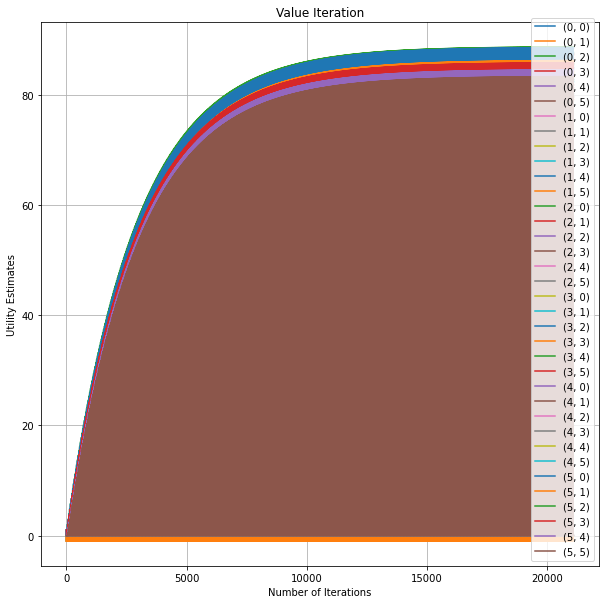

In [68]:
from matplotlib.pyplot import figure
x = [i for i in range(iterations)]

fig, ax = plt.subplots()
ax.plot(x, hist_0_0)
ax.plot(x, hist_0_1)
ax.plot(x, hist_0_2)
ax.plot(x, hist_0_3)
ax.plot(x, hist_0_4)
ax.plot(x, hist_0_5)

ax.plot(x, hist_1_0)
ax.plot(x, hist_1_1)
ax.plot(x, hist_1_2)
ax.plot(x, hist_1_3)
ax.plot(x, hist_1_4)
ax.plot(x, hist_1_5)

ax.plot(x, hist_2_0)
ax.plot(x, hist_2_1)
ax.plot(x, hist_2_2)
ax.plot(x, hist_2_3)
ax.plot(x, hist_2_4)
ax.plot(x, hist_2_5)

ax.plot(x, hist_3_0)
ax.plot(x, hist_3_1)
ax.plot(x, hist_3_2)
ax.plot(x, hist_3_3)
ax.plot(x, hist_3_4)
ax.plot(x, hist_3_5)

ax.plot(x, hist_4_0)
ax.plot(x, hist_4_1)
ax.plot(x, hist_4_2)
ax.plot(x, hist_4_3)
ax.plot(x, hist_4_4)
ax.plot(x, hist_4_5)

ax.plot(x, hist_5_0)
ax.plot(x, hist_5_1)
ax.plot(x, hist_5_2)
ax.plot(x, hist_5_3)
ax.plot(x, hist_5_4)
ax.plot(x, hist_5_5)

plt.legend(list_of_tuples, loc ="lower right")

plt.rcParams["figure.figsize"]=10,10

ax.set(xlabel='Number of Iterations', ylabel='Utility Estimates', title='Value Iteration')
ax.grid()

fig.savefig("test.png")
plt.show()

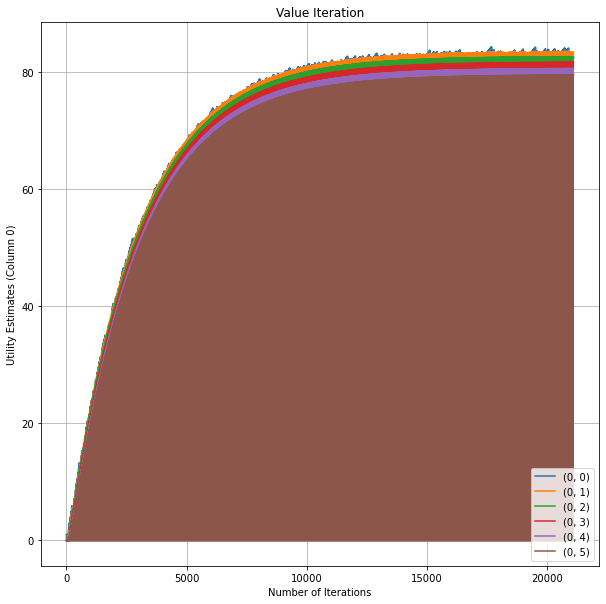

In [62]:
#Column 0

fig, ax = plt.subplots()
ax.plot(x, hist_0_0)
ax.plot(x, hist_0_1)
ax.plot(x, hist_0_2)
ax.plot(x, hist_0_3)
ax.plot(x, hist_0_4)
ax.plot(x, hist_0_5)

plt.legend(list_of_tuples, loc ="lower right")

ax.set(xlabel='Number of Iterations', ylabel='Utility Estimates (Column 0)', title='Value Iteration')
ax.grid()

fig.savefig("test.png")
plt.show()

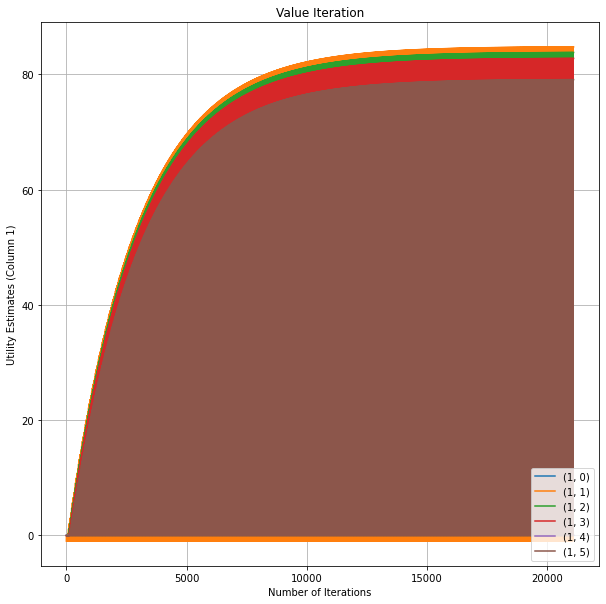

In [63]:
#Column 1

fig, ax = plt.subplots()
ax.plot(x, hist_1_0)
ax.plot(x, hist_1_1)
ax.plot(x, hist_1_2)
ax.plot(x, hist_1_3)
ax.plot(x, hist_1_4)
ax.plot(x, hist_1_5)

plt.legend(list_of_tuples[6:12], loc ="lower right")

ax.set(xlabel='Number of Iterations', ylabel='Utility Estimates (Column 1)', title='Value Iteration')
ax.grid()

fig.savefig("test.png")
plt.show()

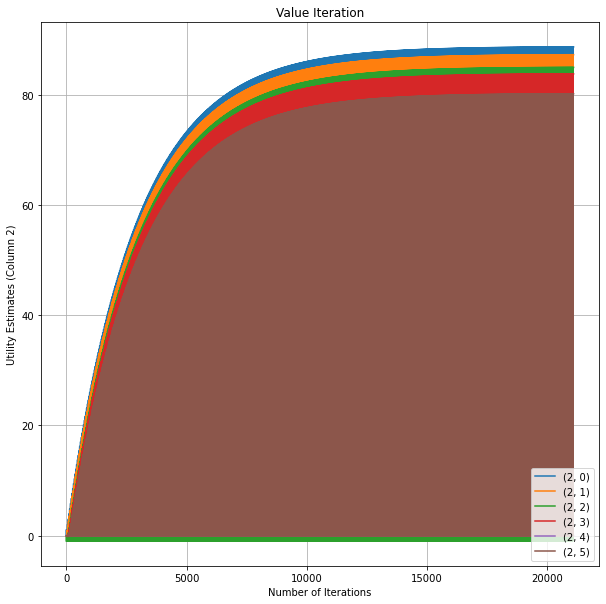

In [64]:
#Column 2

fig, ax = plt.subplots()
ax.plot(x, hist_2_0)
ax.plot(x, hist_2_1)
ax.plot(x, hist_2_2)
ax.plot(x, hist_2_3)
ax.plot(x, hist_2_4)
ax.plot(x, hist_2_5)

plt.legend(list_of_tuples[12:18], loc ="lower right")

ax.set(xlabel='Number of Iterations', ylabel='Utility Estimates (Column 2)', title='Value Iteration')
ax.grid()

fig.savefig("test.png")
plt.show()

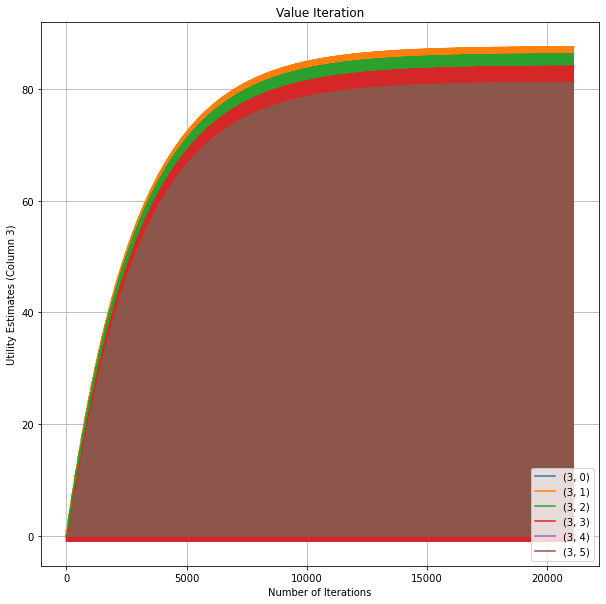

In [65]:
#Column 3

fig, ax = plt.subplots()
ax.plot(x, hist_3_0)
ax.plot(x, hist_3_1)
ax.plot(x, hist_3_2)
ax.plot(x, hist_3_3)
ax.plot(x, hist_3_4)
ax.plot(x, hist_3_5)

plt.legend(list_of_tuples[18:24], loc ="lower right")

ax.set(xlabel='Number of Iterations', ylabel='Utility Estimates (Column 3)', title='Value Iteration')
ax.grid()

fig.savefig("test.png")
plt.show()

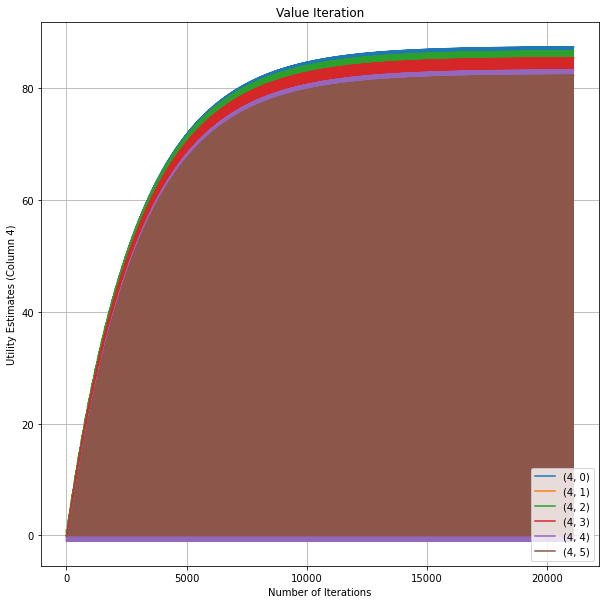

In [66]:
#Column 4

fig, ax = plt.subplots()
ax.plot(x, hist_4_0)
ax.plot(x, hist_4_1)
ax.plot(x, hist_4_2)
ax.plot(x, hist_4_3)
ax.plot(x, hist_4_4)
ax.plot(x, hist_4_5)

plt.legend(list_of_tuples[24:30], loc ="lower right")

ax.set(xlabel='Number of Iterations', ylabel='Utility Estimates (Column 4)', title='Value Iteration')
ax.grid()

fig.savefig("test.png")
plt.show()

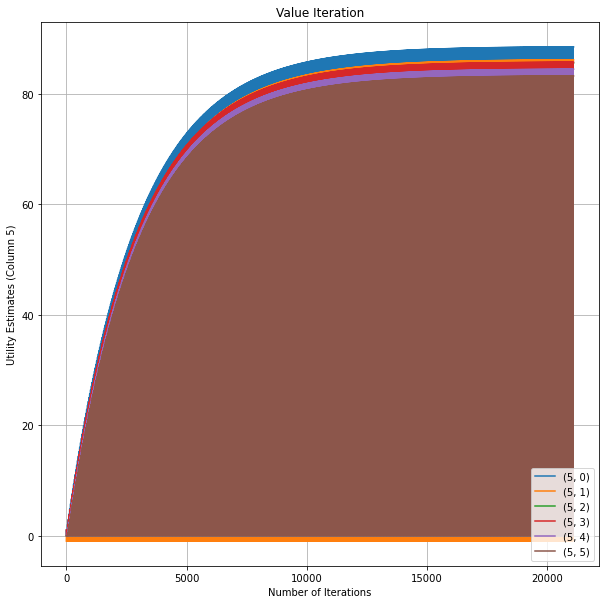

In [67]:
#Column 5

fig, ax = plt.subplots()
ax.plot(x, hist_5_0)
ax.plot(x, hist_5_1)
ax.plot(x, hist_5_2)
ax.plot(x, hist_5_3)
ax.plot(x, hist_5_4)
ax.plot(x, hist_5_5)

plt.legend(list_of_tuples[30:36], loc ="lower right")

ax.set(xlabel='Number of Iterations', ylabel='Utility Estimates (Column 5)', title='Value Iteration')
ax.grid()

fig.savefig("test.png")
plt.show()